In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import glob
import os

In [2]:
path = r'C:\Users\Ravindu Ranaweera\Desktop\datasets\storypoint\IEEE TSE2018\dataset' # use your path
all_files = glob.glob(os.path.join(path, "*.csv"))

In [3]:
li = []

for filename in all_files:
    
    df = pd.read_csv(filename, index_col=None, header=0)
    CSV_name  = filename.split("\\")[-1]
    df['project'] = CSV_name.split('.')[0]
#     print(df)
    li.append(df)

df = pd.concat(li, axis=0, ignore_index=True)

In [4]:
df

,issuekey,title,description,storypoint,project
0,TISTUD-6,Add CA against object literals in function inv...,{html}<div><p>The idea here is that if our met...,1,appceleratorstudio
1,TISTUD-9,Update branding for Appcelerator plugin to App...,"{html}<div><p>At least fix feature icons, asso...",1,appceleratorstudio
2,TISTUD-11,Create new JSON schema for SDK team,{html}<div><p>Create JSON schema containing pr...,1,appceleratorstudio
3,TISTUD-13,Create Project References Property Page,{html}<div><p>Create property page for project...,1,appceleratorstudio
4,TISTUD-16,New Desktop Project Wizard,{html}<div><p>Desktop (need to convert existin...,1,appceleratorstudio
...,...,...,...,...,...
23308,USERGRID-1256,Introduce Datastax Java Driver in effort to mi...,NaN,1,usergrid
23309,USERGRID-1267,Simplify Central SSO: eliminate ext token vali...,Instead of requiring that clients first valida...,3,usergrid
23310,USERGRID-1268,Proof of Concept: use Akka for Unique Value en...,"By using an distributed Actor System, we can e...",8,usergrid
23311,USERGRID-1272,Set a property to turn off usergrid's dependen...,Have a property that can tell Usergrid whether...,5,usergrid


In [5]:
df.count()

issuekey       23313
title          23313
description    21082
storypoint     23313
project        23313
dtype: int64

In [6]:
df.isnull().sum()

issuekey          0
title             0
description    2231
storypoint        0
project           0
dtype: int64

<AxesSubplot:>

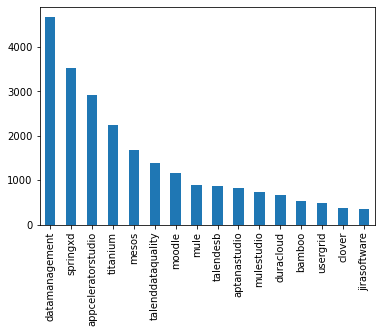

In [7]:
df['project'].value_counts().plot(kind= 'bar')

In [8]:
df = df.dropna()

In [9]:
df.count()

issuekey       21082
title          21082
description    21082
storypoint     21082
project        21082
dtype: int64

In [10]:
df

,issuekey,title,description,storypoint,project
0,TISTUD-6,Add CA against object literals in function inv...,{html}<div><p>The idea here is that if our met...,1,appceleratorstudio
1,TISTUD-9,Update branding for Appcelerator plugin to App...,"{html}<div><p>At least fix feature icons, asso...",1,appceleratorstudio
2,TISTUD-11,Create new JSON schema for SDK team,{html}<div><p>Create JSON schema containing pr...,1,appceleratorstudio
3,TISTUD-13,Create Project References Property Page,{html}<div><p>Create property page for project...,1,appceleratorstudio
4,TISTUD-16,New Desktop Project Wizard,{html}<div><p>Desktop (need to convert existin...,1,appceleratorstudio
...,...,...,...,...,...
23307,USERGRID-1244,Upgrade pushy library to use latest version (H...,Additional system requirements will need to be...,2,usergrid
23309,USERGRID-1267,Simplify Central SSO: eliminate ext token vali...,Instead of requiring that clients first valida...,3,usergrid
23310,USERGRID-1268,Proof of Concept: use Akka for Unique Value en...,"By using an distributed Actor System, we can e...",8,usergrid
23311,USERGRID-1272,Set a property to turn off usergrid's dependen...,Have a property that can tell Usergrid whether...,5,usergrid


In [11]:
from nltk.tokenize import word_tokenize
from bs4 import BeautifulSoup
import re

In [12]:
! pip install contractions

In [13]:
import nltk
nltk.download('stopwords')
import contractions
from nltk import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.stem import LancasterStemmer, WordNetLemmatizer
from bs4 import BeautifulSoup
import re, string, unicodedata

[nltk_data] Downloading package stopwords to C:\Users\Ravindu
[nltk_data]     Ranaweera\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


#### Removing Noise:

In [14]:
def text_lower(data):
    data = data.lower()
#     print(data)
    return data

In [15]:
#Removes HTML data
def remove_html(data):
    data = data.replace('html', '')
    html_tag=re.compile(r'<.*?>')
    data=html_tag.sub(r'',data)
    return data

In [16]:
#Removes URL data
def remove_url(data):
    url_clean= re.compile(r"https://\S+|www\.\S+")
    data=url_clean.sub(r'',data)
    return data

In [17]:
#Removes round_brackets data
def remove_round_brackets(data):
    return re.sub('\(.*?\)','',data)

In [18]:
#Removes Punctuations
def remove_punctuations(data):
    punct_tag=re.compile(r'[^\w\s]')
    data=punct_tag.sub(r'',data)
    return data


In [19]:
def white_space(data):
    return ' '.join(data.split())

In [20]:
#Removes Emojis
def remove_emoji(data):
    emoji_clean= re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    data=emoji_clean.sub(r'',data)
    url_clean= re.compile(r"https://\S+|www\.\S+")
    data=url_clean.sub(r'',data)
    return data

In [21]:
for ind in df.index:
    if(ind < 21082):
        description = df['description'][ind]
#         print(type(description))
        description = text_lower(description)
#         print(type(description))
        description = remove_html(description)
#         print(type(description))
        description = remove_url(description)
#         print(type(description))
        description = remove_round_brackets(description)
#         print(type(description))
        description = remove_punctuations(description)
#         print(type(description))
        description = white_space(description)
#         print(type(description))
        description = remove_emoji(description)
#         print(type(description))
        df['description'][ind] = description
        print(ind)
    else:
        break

C:\Users\Ravindu Ranaweera\AppData\Local\Temp\ipykernel_19336\929258404.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['description'][ind] = description


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
108
109
110
111
112
113
119
120
121
122
124
125
126
127
128
129
130
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
224
226
227
228
229
230
231
232
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295


1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
2081
2082
2083
2084
2085
2086
2087
2088


3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3637
3642
3643
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3692
3693
3694
3695
3696
3697
3698
3699
3700
3701
3702
3703
3704
3705
3706
3707
3708
3709
3710
3711
3712
3713
3714
3715
3716
3717
3719
3720
3721
3722
3723
3724
3725
3726
3727
3728
3729
3730
3731
3732
3733
3734
3735
3736
3737
3738
3739
3740
3741
3742
3743
3744
3745
3746
3747
3748
3750
3751
3752
3753
3755
3756
3757
3758
3760
3761
3764
3765
3766
3767
3768
3769
3770
3771
3772
3773
3774
3775
3776
3777
3778
3779
3780
3781
3782
3783
3784
3787
3788
3798
3799
3800
3801
3802
3803
3804
3805
3806
3808
3810
3811
3813
3816
3834
3839
3845
3851
3856
3857
3858
3859
3860


5501
5502
5503
5504
5505
5506
5507
5508
5509
5510
5511
5513
5515
5516
5518
5519
5520
5521
5522
5523
5524
5525
5526
5527
5528
5529
5530
5531
5532
5533
5534
5535
5536
5537
5538
5539
5540
5541
5542
5546
5547
5548
5549
5550
5551
5552
5553
5554
5555
5561
5562
5563
5564
5565
5566
5567
5568
5569
5570
5571
5572
5573
5574
5577
5578
5579
5580
5581
5582
5583
5584
5585
5588
5589
5590
5591
5592
5593
5599
5601
5603
5605
5606
5609
5610
5611
5612
5613
5614
5615
5616
5617
5618
5619
5620
5621
5623
5624
5625
5626
5627
5628
5629
5630
5631
5632
5633
5634
5635
5636
5637
5638
5639
5640
5641
5642
5643
5644
5645
5648
5649
5650
5652
5653
5654
5658
5659
5669
5670
5671
5672
5673
5674
5675
5676
5678
5679
5681
5682
5683
5684
5685
5686
5687
5688
5689
5690
5691
5692
5693
5694
5695
5696
5697
5698
5699
5700
5701
5702
5703
5704
5705
5706
5707
5708
5709
5710
5711
5712
5713
5714
5715
5716
5717
5718
5719
5720
5721
5722
5723
5724
5725
5726
5728
5729
5730
5731
5732
5733
5734
5735
5736
5737
5738
5740
5741
5743
5744
5745
5746


7402
7403
7404
7405
7406
7407
7408
7409
7410
7411
7412
7413
7414
7422
7425
7426
7429
7434
7442
7443
7444
7447
7448
7449
7450
7451
7452
7453
7454
7455
7456
7457
7458
7459
7460
7461
7462
7463
7464
7465
7466
7467
7469
7470
7471
7472
7473
7478
7479
7480
7481
7482
7483
7484
7485
7486
7487
7488
7489
7490
7492
7493
7494
7495
7496
7497
7498
7499
7500
7501
7502
7503
7504
7505
7506
7507
7508
7509
7510
7511
7512
7517
7518
7519
7520
7521
7522
7523
7524
7525
7526
7528
7529
7530
7531
7532
7533
7534
7535
7536
7537
7539
7540
7541
7542
7543
7544
7545
7546
7548
7549
7550
7551
7552
7555
7556
7559
7563
7564
7565
7566
7567
7568
7569
7570
7571
7572
7573
7574
7575
7576
7579
7580
7581
7582
7583
7584
7585
7586
7587
7588
7589
7590
7591
7592
7593
7594
7595
7596
7597
7598
7599
7600
7601
7602
7603
7604
7605
7606
7607
7608
7609
7610
7611
7612
7614
7615
7616
7617
7618
7619
7620
7621
7625
7626
7627
7628
7629
7630
7631
7632
7633
7634
7635
7636
7638
7639
7640
7641
7643
7644
7645
7646
7648
7649
7650
7651
7652
7653
7654


9335
9336
9338
9339
9340
9341
9342
9344
9345
9346
9348
9350
9351
9352
9353
9354
9355
9356
9357
9358
9359
9360
9361
9362
9364
9365
9366
9367
9371
9373
9375
9376
9377
9378
9379
9380
9381
9382
9384
9385
9386
9387
9389
9390
9391
9392
9393
9394
9395
9396
9397
9398
9399
9400
9401
9402
9403
9404
9405
9406
9407
9408
9409
9410
9414
9415
9416
9417
9418
9419
9420
9421
9422
9423
9424
9428
9429
9432
9434
9435
9436
9437
9438
9439
9440
9441
9442
9443
9444
9445
9446
9448
9449
9450
9453
9454
9455
9456
9457
9458
9459
9460
9462
9463
9464
9465
9466
9467
9468
9469
9470
9471
9472
9473
9475
9476
9477
9478
9479
9481
9482
9483
9484
9485
9486
9487
9488
9489
9490
9491
9492
9493
9494
9495
9496
9497
9498
9499
9500
9501
9502
9503
9504
9505
9506
9507
9508
9509
9510
9511
9512
9513
9514
9515
9516
9517
9518
9519
9520
9521
9522
9523
9524
9525
9526
9527
9528
9529
9530
9531
9532
9533
9534
9535
9536
9537
9538
9539
9540
9541
9542
9543
9544
9545
9546
9547
9548
9549
9550
9551
9552
9553
9554
9555
9556
9557
9558
9559
9560
9561


10962
10963
10964
10965
10966
10967
10968
10969
10970
10971
10972
10973
10974
10975
10976
10977
10978
10979
10980
10981
10982
10983
10984
10985
10986
10987
10988
10989
10990
10991
10992
10993
10994
10995
10996
10997
10998
10999
11000
11001
11002
11003
11004
11005
11006
11007
11008
11009
11010
11011
11012
11013
11014
11015
11017
11018
11019
11020
11021
11022
11023
11024
11025
11026
11027
11028
11029
11030
11031
11032
11033
11034
11035
11036
11037
11038
11039
11040
11041
11042
11043
11044
11045
11046
11047
11048
11049
11050
11051
11052
11053
11054
11055
11056
11057
11058
11059
11060
11061
11062
11063
11064
11065
11066
11067
11068
11069
11070
11071
11072
11073
11074
11075
11076
11077
11078
11079
11080
11081
11083
11084
11085
11086
11087
11088
11089
11090
11091
11092
11093
11094
11095
11096
11097
11098
11099
11100
11101
11102
11103
11104
11105
11106
11107
11109
11110
11111
11113
11114
11115
11118
11119
11120
11121
11122
11123
11124
11125
11126
11127
11128
11129
11130
11131
11132
11133
1113

12405
12406
12407
12408
12409
12410
12411
12412
12413
12414
12415
12416
12417
12418
12419
12420
12421
12422
12423
12424
12425
12426
12427
12428
12429
12430
12431
12432
12433
12434
12435
12436
12437
12438
12439
12440
12441
12442
12443
12444
12445
12446
12447
12448
12449
12450
12451
12452
12453
12454
12455
12456
12457
12458
12459
12460
12461
12462
12463
12464
12465
12466
12467
12468
12469
12470
12471
12472
12473
12474
12475
12476
12477
12478
12479
12480
12481
12482
12483
12484
12485
12486
12487
12488
12489
12490
12491
12492
12493
12494
12495
12496
12497
12498
12499
12500
12501
12502
12503
12504
12505
12506
12507
12508
12509
12510
12511
12512
12513
12514
12515
12516
12517
12518
12519
12520
12521
12522
12523
12524
12525
12526
12527
12528
12529
12530
12531
12532
12533
12534
12535
12536
12537
12538
12539
12540
12541
12542
12543
12544
12545
12546
12547
12548
12549
12550
12551
12552
12553
12554
12555
12556
12557
12558
12559
12560
12561
12562
12563
12564
12565
12566
12567
12568
12569
12570
1257

13772
13773
13774
13775
13776
13777
13778
13779
13780
13781
13782
13783
13784
13785
13786
13787
13788
13789
13790
13791
13792
13793
13794
13795
13796
13797
13798
13799
13800
13801
13802
13803
13804
13805
13806
13807
13808
13809
13810
13811
13812
13813
13814
13815
13816
13817
13818
13819
13820
13821
13822
13823
13824
13825
13826
13827
13828
13829
13830
13831
13832
13833
13834
13835
13836
13837
13838
13839
13840
13841
13842
13843
13844
13845
13846
13847
13848
13849
13850
13851
13852
13853
13854
13855
13856
13857
13858
13859
13860
13861
13862
13863
13864
13865
13866
13867
13868
13869
13870
13871
13872
13873
13874
13875
13876
13877
13878
13879
13880
13881
13882
13883
13884
13885
13886
13887
13888
13889
13890
13891
13892
13893
13894
13895
13896
13897
13898
13899
13900
13901
13902
13903
13904
13905
13906
13907
13908
13909
13910
13911
13912
13913
13914
13915
13916
13917
13918
13919
13920
13921
13922
13923
13924
13925
13926
13927
13928
13929
13930
13931
13932
13933
13934
13935
13936
13937
1393

15261
15262
15266
15268
15269
15270
15271
15272
15273
15274
15275
15277
15279
15285
15287
15288
15289
15290
15291
15292
15293
15295
15296
15298
15300
15304
15305
15307
15308
15311
15313
15314
15315
15316
15317
15320
15321
15322
15323
15324
15325
15326
15327
15328
15329
15330
15332
15334
15335
15336
15339
15340
15341
15342
15343
15344
15345
15346
15349
15350
15351
15352
15353
15355
15356
15358
15359
15360
15361
15362
15363
15364
15365
15366
15367
15368
15369
15370
15371
15372
15373
15374
15375
15376
15377
15378
15379
15380
15381
15382
15383
15384
15385
15388
15389
15391
15392
15393
15394
15395
15396
15397
15398
15399
15401
15402
15403
15405
15406
15407
15408
15409
15410
15411
15412
15413
15414
15415
15418
15419
15420
15421
15422
15423
15424
15425
15426
15427
15428
15429
15431
15432
15433
15434
15435
15436
15437
15438
15439
15440
15441
15442
15443
15444
15445
15446
15447
15448
15449
15450
15451
15452
15453
15454
15455
15456
15457
15458
15459
15460
15461
15463
15464
15465
15466
15467
1546

16892
16893
16894
16895
16896
16897
16898
16899
16900
16901
16902
16903
16904
16906
16907
16908
16909
16910
16911
16912
16913
16914
16915
16916
16917
16918
16919
16920
16921
16922
16923
16924
16925
16926
16927
16928
16929
16930
16931
16932
16933
16934
16935
16936
16937
16938
16939
16940
16941
16942
16944
16945
16946
16948
16949
16950
16951
16952
16953
16954
16955
16956
16957
16958
16959
16960
16961
16962
16963
16964
16965
16967
16968
16969
16970
16971
16972
16973
16974
16975
16976
16977
16978
16979
16980
16981
16982
16984
16985
16986
16987
16988
16989
16990
16991
16992
16993
16994
16995
16996
16997
16998
16999
17000
17001
17002
17003
17004
17005
17006
17007
17008
17009
17010
17011
17012
17013
17014
17015
17016
17017
17018
17019
17020
17021
17022
17025
17026
17027
17028
17029
17030
17031
17032
17033
17034
17035
17036
17037
17038
17039
17040
17041
17042
17044
17045
17046
17047
17048
17049
17050
17051
17052
17053
17054
17056
17057
17058
17059
17060
17061
17062
17063
17066
17067
17068
1706

18358
18359
18360
18361
18362
18363
18364
18365
18366
18367
18368
18369
18370
18371
18372
18373
18374
18375
18376
18377
18378
18379
18380
18381
18382
18383
18384
18385
18387
18388
18389
18390
18391
18392
18393
18394
18395
18396
18397
18398
18399
18400
18401
18402
18403
18404
18405
18406
18407
18408
18409
18410
18411
18412
18414
18415
18416
18417
18418
18419
18420
18421
18422
18423
18424
18425
18426
18427
18428
18429
18430
18431
18432
18433
18434
18436
18437
18438
18439
18440
18441
18442
18443
18445
18446
18447
18448
18449
18450
18451
18452
18453
18454
18455
18456
18457
18458
18459
18460
18461
18462
18463
18465
18466
18467
18468
18469
18470
18471
18472
18473
18474
18475
18477
18478
18479
18480
18481
18482
18483
18484
18485
18486
18487
18488
18489
18490
18491
18492
18493
18494
18495
18496
18498
18499
18500
18502
18504
18505
18506
18507
18508
18509
18510
18512
18513
18514
18515
18516
18517
18518
18519
18520
18524
18525
18526
18527
18528
18529
18530
18531
18532
18533
18534
18535
18536
1853

20021
20022
20023
20024
20026
20027
20028
20029
20030
20031
20032
20033
20034
20035
20036
20037
20038
20039
20040
20043
20044
20045
20046
20047
20048
20049
20050
20051
20052
20053
20054
20055
20056
20057
20058
20059
20060
20061
20062
20063
20064
20065
20066
20067
20068
20069
20070
20071
20072
20073
20074
20075
20076
20077
20078
20080
20081
20082
20083
20084
20085
20086
20087
20088
20089
20090
20091
20092
20093
20095
20096
20097
20098
20099
20100
20101
20102
20103
20104
20105
20106
20107
20108
20109
20110
20111
20112
20113
20114
20116
20117
20118
20119
20120
20121
20122
20123
20124
20125
20126
20127
20128
20129
20130
20131
20132
20133
20134
20135
20136
20137
20138
20139
20140
20141
20142
20143
20144
20145
20146
20147
20148
20149
20150
20151
20152
20153
20154
20155
20156
20157
20158
20161
20162
20164
20165
20169
20170
20171
20172
20173
20174
20175
20176
20177
20178
20179
20180
20181
20182
20183
20185
20186
20187
20188
20189
20190
20191
20193
20194
20195
20196
20199
20200
20201
20202
2020

In [22]:
for ind in df.index:
    if(ind < 21082):
        title = df['title'][ind]
        title = text_lower(title)
        title = remove_html(title)
        title = remove_url(title)
        title = remove_round_brackets(title)
        title = remove_punctuations(title)
        title = white_space(title)
        title = remove_emoji(title)
        df['title'][ind] = title
        print(ind)
    else:
        break

0
1
2
3


C:\Users\Ravindu Ranaweera\AppData\Local\Temp\ipykernel_19336\2192214994.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['title'][ind] = title


4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
108
109
110
111
112
113
119
120
121
122
124
125
126
127
128
129
130
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
224
226
227
228
229
230
231
232
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297


1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
2081
2082
2083
2084
2085
2086
2087
2088
2089
2090
2091
2092


3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3637
3642
3643
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3692
3693
3694
3695
3696
3697
3698
3699
3700
3701
3702
3703
3704
3705
3706
3707
3708
3709
3710
3711
3712
3713
3714
3715
3716
3717
3719
3720
3721
3722
3723
3724
3725
3726
3727
3728
3729
3730
3731
3732
3733
3734
3735
3736
3737
3738
3739
3740
3741
3742
3743
3744
3745
3746
3747
3748
3750
3751
3752
3753
3755
3756
3757
3758
3760
3761
3764
3765
3766
3767
3768
3769
3770
3771
3772
3773
3774
3775
3776
3777
3778
3779
3780
3781
3782
3783
3784
3787
3788
3798
3799
3800
3801
3802
3803
3804
3805
3806
3808
3810
3811
3813
3816
3834
3839
3845
3851
3856
3857
3858
3859
3860
3862
3864
3865


5505
5506
5507
5508
5509
5510
5511
5513
5515
5516
5518
5519
5520
5521
5522
5523
5524
5525
5526
5527
5528
5529
5530
5531
5532
5533
5534
5535
5536
5537
5538
5539
5540
5541
5542
5546
5547
5548
5549
5550
5551
5552
5553
5554
5555
5561
5562
5563
5564
5565
5566
5567
5568
5569
5570
5571
5572
5573
5574
5577
5578
5579
5580
5581
5582
5583
5584
5585
5588
5589
5590
5591
5592
5593
5599
5601
5603
5605
5606
5609
5610
5611
5612
5613
5614
5615
5616
5617
5618
5619
5620
5621
5623
5624
5625
5626
5627
5628
5629
5630
5631
5632
5633
5634
5635
5636
5637
5638
5639
5640
5641
5642
5643
5644
5645
5648
5649
5650
5652
5653
5654
5658
5659
5669
5670
5671
5672
5673
5674
5675
5676
5678
5679
5681
5682
5683
5684
5685
5686
5687
5688
5689
5690
5691
5692
5693
5694
5695
5696
5697
5698
5699
5700
5701
5702
5703
5704
5705
5706
5707
5708
5709
5710
5711
5712
5713
5714
5715
5716
5717
5718
5719
5720
5721
5722
5723
5724
5725
5726
5728
5729
5730
5731
5732
5733
5734
5735
5736
5737
5738
5740
5741
5743
5744
5745
5746
5747
5748
5749
5750


7411
7412
7413
7414
7422
7425
7426
7429
7434
7442
7443
7444
7447
7448
7449
7450
7451
7452
7453
7454
7455
7456
7457
7458
7459
7460
7461
7462
7463
7464
7465
7466
7467
7469
7470
7471
7472
7473
7478
7479
7480
7481
7482
7483
7484
7485
7486
7487
7488
7489
7490
7492
7493
7494
7495
7496
7497
7498
7499
7500
7501
7502
7503
7504
7505
7506
7507
7508
7509
7510
7511
7512
7517
7518
7519
7520
7521
7522
7523
7524
7525
7526
7528
7529
7530
7531
7532
7533
7534
7535
7536
7537
7539
7540
7541
7542
7543
7544
7545
7546
7548
7549
7550
7551
7552
7555
7556
7559
7563
7564
7565
7566
7567
7568
7569
7570
7571
7572
7573
7574
7575
7576
7579
7580
7581
7582
7583
7584
7585
7586
7587
7588
7589
7590
7591
7592
7593
7594
7595
7596
7597
7598
7599
7600
7601
7602
7603
7604
7605
7606
7607
7608
7609
7610
7611
7612
7614
7615
7616
7617
7618
7619
7620
7621
7625
7626
7627
7628
7629
7630
7631
7632
7633
7634
7635
7636
7638
7639
7640
7641
7643
7644
7645
7646
7648
7649
7650
7651
7652
7653
7654
7655
7656
7657
7658
7659
7660
7661
7662
7663


9350
9351
9352
9353
9354
9355
9356
9357
9358
9359
9360
9361
9362
9364
9365
9366
9367
9371
9373
9375
9376
9377
9378
9379
9380
9381
9382
9384
9385
9386
9387
9389
9390
9391
9392
9393
9394
9395
9396
9397
9398
9399
9400
9401
9402
9403
9404
9405
9406
9407
9408
9409
9410
9414
9415
9416
9417
9418
9419
9420
9421
9422
9423
9424
9428
9429
9432
9434
9435
9436
9437
9438
9439
9440
9441
9442
9443
9444
9445
9446
9448
9449
9450
9453
9454
9455
9456
9457
9458
9459
9460
9462
9463
9464
9465
9466
9467
9468
9469
9470
9471
9472
9473
9475
9476
9477
9478
9479
9481
9482
9483
9484
9485
9486
9487
9488
9489
9490
9491
9492
9493
9494
9495
9496
9497
9498
9499
9500
9501
9502
9503
9504
9505
9506
9507
9508
9509
9510
9511
9512
9513
9514
9515
9516
9517
9518
9519
9520
9521
9522
9523
9524
9525
9526
9527
9528
9529
9530
9531
9532
9533
9534
9535
9536
9537
9538
9539
9540
9541
9542
9543
9544
9545
9546
9547
9548
9549
9550
9551
9552
9553
9554
9555
9556
9557
9558
9559
9560
9561
9562
9563
9564
9565
9566
9567
9568
9569
9570
9571
9572


10973
10974
10975
10976
10977
10978
10979
10980
10981
10982
10983
10984
10985
10986
10987
10988
10989
10990
10991
10992
10993
10994
10995
10996
10997
10998
10999
11000
11001
11002
11003
11004
11005
11006
11007
11008
11009
11010
11011
11012
11013
11014
11015
11017
11018
11019
11020
11021
11022
11023
11024
11025
11026
11027
11028
11029
11030
11031
11032
11033
11034
11035
11036
11037
11038
11039
11040
11041
11042
11043
11044
11045
11046
11047
11048
11049
11050
11051
11052
11053
11054
11055
11056
11057
11058
11059
11060
11061
11062
11063
11064
11065
11066
11067
11068
11069
11070
11071
11072
11073
11074
11075
11076
11077
11078
11079
11080
11081
11083
11084
11085
11086
11087
11088
11089
11090
11091
11092
11093
11094
11095
11096
11097
11098
11099
11100
11101
11102
11103
11104
11105
11106
11107
11109
11110
11111
11113
11114
11115
11118
11119
11120
11121
11122
11123
11124
11125
11126
11127
11128
11129
11130
11131
11132
11133
11134
11135
11136
11137
11138
11139
11140
11141
11142
11143
11144
1114

12424
12425
12426
12427
12428
12429
12430
12431
12432
12433
12434
12435
12436
12437
12438
12439
12440
12441
12442
12443
12444
12445
12446
12447
12448
12449
12450
12451
12452
12453
12454
12455
12456
12457
12458
12459
12460
12461
12462
12463
12464
12465
12466
12467
12468
12469
12470
12471
12472
12473
12474
12475
12476
12477
12478
12479
12480
12481
12482
12483
12484
12485
12486
12487
12488
12489
12490
12491
12492
12493
12494
12495
12496
12497
12498
12499
12500
12501
12502
12503
12504
12505
12506
12507
12508
12509
12510
12511
12512
12513
12514
12515
12516
12517
12518
12519
12520
12521
12522
12523
12524
12525
12526
12527
12528
12529
12530
12531
12532
12533
12534
12535
12536
12537
12538
12539
12540
12541
12542
12543
12544
12545
12546
12547
12548
12549
12550
12551
12552
12553
12554
12555
12556
12557
12558
12559
12560
12561
12562
12563
12564
12565
12566
12567
12568
12569
12570
12571
12572
12573
12574
12575
12576
12577
12578
12579
12580
12581
12582
12583
12584
12585
12586
12587
12588
12589
1259

13798
13799
13800
13801
13802
13803
13804
13805
13806
13807
13808
13809
13810
13811
13812
13813
13814
13815
13816
13817
13818
13819
13820
13821
13822
13823
13824
13825
13826
13827
13828
13829
13830
13831
13832
13833
13834
13835
13836
13837
13838
13839
13840
13841
13842
13843
13844
13845
13846
13847
13848
13849
13850
13851
13852
13853
13854
13855
13856
13857
13858
13859
13860
13861
13862
13863
13864
13865
13866
13867
13868
13869
13870
13871
13872
13873
13874
13875
13876
13877
13878
13879
13880
13881
13882
13883
13884
13885
13886
13887
13888
13889
13890
13891
13892
13893
13894
13895
13896
13897
13898
13899
13900
13901
13902
13903
13904
13905
13906
13907
13908
13909
13910
13911
13912
13913
13914
13915
13916
13917
13918
13919
13920
13921
13922
13923
13924
13925
13926
13927
13928
13929
13930
13931
13932
13933
13934
13935
13936
13937
13938
13939
13940
13941
13942
13943
13944
13945
13946
13947
13948
13949
13950
13951
13952
13953
13954
13955
13956
13957
13958
13959
13960
13961
13962
13963
1396

15296
15298
15300
15304
15305
15307
15308
15311
15313
15314
15315
15316
15317
15320
15321
15322
15323
15324
15325
15326
15327
15328
15329
15330
15332
15334
15335
15336
15339
15340
15341
15342
15343
15344
15345
15346
15349
15350
15351
15352
15353
15355
15356
15358
15359
15360
15361
15362
15363
15364
15365
15366
15367
15368
15369
15370
15371
15372
15373
15374
15375
15376
15377
15378
15379
15380
15381
15382
15383
15384
15385
15388
15389
15391
15392
15393
15394
15395
15396
15397
15398
15399
15401
15402
15403
15405
15406
15407
15408
15409
15410
15411
15412
15413
15414
15415
15418
15419
15420
15421
15422
15423
15424
15425
15426
15427
15428
15429
15431
15432
15433
15434
15435
15436
15437
15438
15439
15440
15441
15442
15443
15444
15445
15446
15447
15448
15449
15450
15451
15452
15453
15454
15455
15456
15457
15458
15459
15460
15461
15463
15464
15465
15466
15467
15468
15469
15470
15471
15472
15473
15474
15475
15476
15477
15478
15479
15480
15481
15482
15487
15488
15489
15490
15491
15492
15493
1549

16910
16911
16912
16913
16914
16915
16916
16917
16918
16919
16920
16921
16922
16923
16924
16925
16926
16927
16928
16929
16930
16931
16932
16933
16934
16935
16936
16937
16938
16939
16940
16941
16942
16944
16945
16946
16948
16949
16950
16951
16952
16953
16954
16955
16956
16957
16958
16959
16960
16961
16962
16963
16964
16965
16967
16968
16969
16970
16971
16972
16973
16974
16975
16976
16977
16978
16979
16980
16981
16982
16984
16985
16986
16987
16988
16989
16990
16991
16992
16993
16994
16995
16996
16997
16998
16999
17000
17001
17002
17003
17004
17005
17006
17007
17008
17009
17010
17011
17012
17013
17014
17015
17016
17017
17018
17019
17020
17021
17022
17025
17026
17027
17028
17029
17030
17031
17032
17033
17034
17035
17036
17037
17038
17039
17040
17041
17042
17044
17045
17046
17047
17048
17049
17050
17051
17052
17053
17054
17056
17057
17058
17059
17060
17061
17062
17063
17066
17067
17068
17069
17070
17071
17072
17073
17074
17075
17076
17077
17078
17079
17080
17081
17082
17083
17084
17085
1708

18374
18375
18376
18377
18378
18379
18380
18381
18382
18383
18384
18385
18387
18388
18389
18390
18391
18392
18393
18394
18395
18396
18397
18398
18399
18400
18401
18402
18403
18404
18405
18406
18407
18408
18409
18410
18411
18412
18414
18415
18416
18417
18418
18419
18420
18421
18422
18423
18424
18425
18426
18427
18428
18429
18430
18431
18432
18433
18434
18436
18437
18438
18439
18440
18441
18442
18443
18445
18446
18447
18448
18449
18450
18451
18452
18453
18454
18455
18456
18457
18458
18459
18460
18461
18462
18463
18465
18466
18467
18468
18469
18470
18471
18472
18473
18474
18475
18477
18478
18479
18480
18481
18482
18483
18484
18485
18486
18487
18488
18489
18490
18491
18492
18493
18494
18495
18496
18498
18499
18500
18502
18504
18505
18506
18507
18508
18509
18510
18512
18513
18514
18515
18516
18517
18518
18519
18520
18524
18525
18526
18527
18528
18529
18530
18531
18532
18533
18534
18535
18536
18537
18538
18539
18540
18541
18542
18543
18544
18545
18546
18547
18548
18549
18550
18551
18552
1855

20030
20031
20032
20033
20034
20035
20036
20037
20038
20039
20040
20043
20044
20045
20046
20047
20048
20049
20050
20051
20052
20053
20054
20055
20056
20057
20058
20059
20060
20061
20062
20063
20064
20065
20066
20067
20068
20069
20070
20071
20072
20073
20074
20075
20076
20077
20078
20080
20081
20082
20083
20084
20085
20086
20087
20088
20089
20090
20091
20092
20093
20095
20096
20097
20098
20099
20100
20101
20102
20103
20104
20105
20106
20107
20108
20109
20110
20111
20112
20113
20114
20116
20117
20118
20119
20120
20121
20122
20123
20124
20125
20126
20127
20128
20129
20130
20131
20132
20133
20134
20135
20136
20137
20138
20139
20140
20141
20142
20143
20144
20145
20146
20147
20148
20149
20150
20151
20152
20153
20154
20155
20156
20157
20158
20161
20162
20164
20165
20169
20170
20171
20172
20173
20174
20175
20176
20177
20178
20179
20180
20181
20182
20183
20185
20186
20187
20188
20189
20190
20191
20193
20194
20195
20196
20199
20200
20201
20202
20203
20204
20205
20206
20207
20208
20210
20211
2021

In [23]:
df.head(500)

,issuekey,title,description,storypoint,project
0,TISTUD-6,add ca against object literals in function inv...,the idea here is that if our metadata captures...,1,appceleratorstudio
1,TISTUD-9,update branding for appcelerator plugin to app...,at least fix feature icons associated natures ...,1,appceleratorstudio
2,TISTUD-11,create new json schema for sdk team,create json schema containing properties requi...,1,appceleratorstudio
3,TISTUD-13,create project references property page,create property page for project which allows ...,1,appceleratorstudio
4,TISTUD-16,new desktop project wizard,desktop some items here others here,1,appceleratorstudio
...,...,...,...,...,...
516,TISTUD-1702,titanium studio code selection highlighting ar...,in some themes when the cursor is pressed to h...,8,appceleratorstudio
517,TISTUD-1703,titanium studio alpha highlight fails for some...,when a block of code is highlighted and the th...,8,appceleratorstudio
518,TISTUD-1704,titanium studio app explorer local filesystem ...,on linux the project explorer local filesystem...,5,appceleratorstudio
519,TISTUD-1705,titanium studio top menu bar receives events o...,top menu bar receives events on linux when oth...,8,appceleratorstudio


#### Normalizing text: 

In [24]:
def contraction_replace(data):
    data = contractions.fix(data)
    print(data)
    return data

In [25]:
pip install inflect

Note: you may need to restart the kernel to use updated packages.


In [26]:
import inflect

In [27]:
def number_to_text(data):
    temp_str = data.split()
    string = []
    for i in temp_str:
        # if the word is digit, converted to 
        # word else the sequence continues
        if i.isdigit():
            temp = inflect.engine().number_to_words(i)
            string.append(temp)
        else:
            string.append(i)
#     print(data)
    return temp_str

In [28]:
def stopword(data):
    clean = []
    for i in data:
        if i not in stopwords.words('english'):
            clean.append(i)
    data = ' '.join(clean)
    return data

In [29]:
def stemming(data):
    stemmer = LancasterStemmer()
    stemmed = []
    for i in data:
        stem = stemmer.stem(i)
        stemmed.append(stem)
    return stemmed

In [30]:
def lemmatization(data):
    nltk.download('wordnet')
    lemma = WordNetLemmatizer()
    lemmas = []
    for i in data:
        lem = lemma.lemmatize(i, pos='v')
        lemmas.append(lem)
    return lemmas 

In [31]:
df.head(15)

,issuekey,title,description,storypoint,project
0,TISTUD-6,add ca against object literals in function inv...,the idea here is that if our metadata captures...,1,appceleratorstudio
1,TISTUD-9,update branding for appcelerator plugin to app...,at least fix feature icons associated natures ...,1,appceleratorstudio
2,TISTUD-11,create new json schema for sdk team,create json schema containing properties requi...,1,appceleratorstudio
3,TISTUD-13,create project references property page,create property page for project which allows ...,1,appceleratorstudio
4,TISTUD-16,new desktop project wizard,desktop some items here others here,1,appceleratorstudio
5,TISTUD-21,launch application on blackberry emulator,note that some emulators are platformspecific ...,1,appceleratorstudio
6,TISTUD-22,launch application on ios device,replicate experience from tidev 1 creating a l...,1,appceleratorstudio
7,TISTUD-23,launch application on android device,check for items below as part of launch config...,1,appceleratorstudio
8,TISTUD-24,create packager for desktop project,desktop send zip file to web service to packag...,1,appceleratorstudio
9,TISTUD-25,create packager for mobileios project,follow existing screensworkflow as appropriate...,1,appceleratorstudio


In [32]:
for ind in df.index:
    if(ind < 21082):
        description = df['description'][ind]
        print(type(description))
        print(description)
        description = contraction_replace(description)
    #     description = number_to_text(description)
    #         description = remove_abb(description)
        description = word_tokenize(description)
        print(type(description))
        description = stopword(description)
        print(type(description))
#         print('description*********************', description)
    #         description = stemming(description)
    #         description = lemmatization(description)
        print('description*********************', description)
        df['description'][ind] = description
        print('index number', ind)
    else:
        break

<class 'str'>
the idea here is that if our metadata captures a type as function arg we should be able to create an instance of that type as an object literal as an arg to a function invocation for example tiuicreatelabel
the idea here is that if our metadata captures a type as function arg we should be able to create an instance of that type as an object literal as an arg to a function invocation for example tiuicreatelabel
<class 'list'>
<class 'str'>
description********************* idea metadata captures type function arg able create instance type object literal arg function invocation example tiuicreatelabel
index number 0
<class 'str'>
at least fix feature icons associated natures perhaps other screens as well
at least fix feature icons associated natures perhaps other screens as well
<class 'list'>
<class 'str'>
description********************* least fix feature icons associated natures perhaps screens well
index number 1
<class 'str'>
create json schema containing properties req

C:\Users\Ravindu Ranaweera\AppData\Local\Temp\ipykernel_19336\727118128.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['description'][ind] = description


<class 'str'>
description********************* desktop items others
index number 4
<class 'str'>
note that some emulators are platformspecific so we need to restrict usage as appropriate create launch configuration to run the application on the appropriate device emulator copy options from tidev 1 as appropriate
note that some emulators are platformspecific so we need to restrict usage as appropriate create launch configuration to run the application on the appropriate device emulator copy options from tidev 1 as appropriate
<class 'list'>
<class 'str'>
description********************* note emulators platformspecific need restrict usage appropriate create launch configuration run application appropriate device emulator copy options tidev 1 appropriate
index number 5
<class 'str'>
replicate experience from tidev 1 creating a launch configuration as appropriate
replicate experience from tidev 1 creating a launch configuration as appropriate
<class 'list'>
<class 'str'>
description*******

<class 'str'>
description********************* jsca schema schema defined need create code read schemas following format reader require schema schema modified support event handlers types properties etc consumed reader
index number 27
<class 'str'>
we want to store the events in a database in case the user is offline
we want to store the events in a database in case the user is offline
<class 'list'>
<class 'str'>
description********************* want store events database case user offline
index number 28
<class 'str'>
this is showing up particularly when using object literals inside method invocations it looks like the popup itself needs to follow the row of the current offset whereas right now it basically places itself one line below the function invocation start
this is showing up particularly when using object literals inside method invocations it looks like the popup itself needs to follow the row of the current offset whereas right now it basically places itself one line below 

<class 'str'>
description********************* first start ti studio brings login screen entered credentials hit return nothing invoke login button
index number 42
<class 'str'>
the username label is misleading i believe were always looking for the users email address they used to register with
the username label is misleading i believe were always looking for the users email address they used to register with
<class 'list'>
<class 'str'>
description********************* username label misleading believe always looking users email address used register
index number 43
<class 'str'>
could be done through a link suggestion is to allow the user to pass in a specific id ie comappceleratortitaniumuiimportwizard
could be done through a link suggestion is to allow the user to pass in a specific id ie comappceleratortitaniumuiimportwizard
<class 'list'>
<class 'str'>
description********************* could done link suggestion allow user pass specific id ie comappceleratortitaniumuiimportwizard

<class 'str'>
description********************* currently deploy targets resources created project created scripting support updating resources directory new set targets avoid user confusion probably hide targets gray info problem
index number 63
<class 'str'>
when the user opens a debugging session and switches to the debug perspective only the eclipse debug button is left for relaunching the application while still in the debug perspective this makes the user experience somewhat inconsistent because they will be launching from the debug button inside the app explorer if we have the app explorer itself exist in both perspectives it should give the same interface for launching to the user
when the user opens a debugging session and switches to the debug perspective only the eclipse debug button is left for relaunching the application while still in the debug perspective this makes the user experience somewhat inconsistent because they will be launching from the debug button inside the a

index number 73
<class 'str'>
instead let the user pick a default workspace on first launch
instead let the user pick a default workspace on first launch
<class 'list'>
<class 'str'>
description********************* instead let user pick default workspace first launch
index number 75
<class 'str'>
ordinarily we shouldnt allow the user to get this far in the process but if they somehow manage to get here we should alert the user to the error
ordinarily we should not allow the user to get this far in the process but if they somehow manage to get here we should alert the user to the error
<class 'list'>
<class 'str'>
description********************* ordinarily allow user get far process somehow manage get alert user error
index number 76
<class 'str'>
i tried creating a mobile project through developer with a colon in the name and got the following in the console just create a project with a colon in the name to reproduce we should instead replace the colon with an underscore panel info c

<class 'str'>
description********************* tried creating mobile project developer colon name got following console create project colon name reproduce instead replace colon underscore panel info compiling javascriptone moment info simulator exiting info javascript errors detected debug executing command usrbinkillall iphone simulator info one moment building debug copy resources userskevinname literesources userskevinname litebuildiphonetmp debug copying userskevinname literesourcesabout userskevinname litebuildiphonetmpabout debug copying userskevinname literesourcesindexcss userskevinname litebuildiphonetmpindexcss debug copying userskevinname literesourcesindex userskevinname litebuildiphonetmpindex debug copying userskevinname literesourcesindexjs userskevinname litebuildiphonetmpindexjs debug copying userskevinname literesourcesabout userskevinname litebuildiphonetmpabout debug copying userskevinname literesourcesindexcss userskevinname litebuildiphonetmpindexcss debug copyin

<class 'str'>
description********************* id like able run project without import project would especially useful learning training environment working many different projects would helpful users try code github etc seems like tiappxml would give info need
index number 82
<class 'str'>
confirm that the blackberry tooling here can be installed on top of titanium studio httpnablackberrycomengdevelopersjavaappdevjavapluginjsp if it cannot we need to figure out what packaging changes to make to titanium studio in order for it to be able to work if it turns out that it requires a whole bunch of things like the java editor then we may want to consider requiring those who wish to do blackberry development to install eclipse and use tistudio as a plugin
confirm that the blackberry tooling here can be installed on top of titanium studio httpnablackberrycomengdevelopersjavaappdevjavapluginjsp if it cannot we need to figure out what packaging changes to make to titanium studio in order for i

index number 90
<class 'str'>
similar to android a little icon to display in the various menus that indicates rundeploypackaging
similar to android a little icon to display in the various menus that indicates rundeploypackaging
<class 'list'>
<class 'str'>
description********************* similar android little icon display various menus indicates rundeploypackaging
index number 91
<class 'str'>
similar to android support add the option to launch a debugger on the emulated device see run on emulator for relevant device configuration options ticket is for integrating the rundebug configurations into studio actual debugger work would be handled by blackberry team
similar to android support add the option to launch a debugger on the emulated device see run on emulator for relevant device configuration options ticket is for integrating the rundebug configurations into studio actual debugger work would be handled by blackberry team
<class 'list'>
<class 'str'>
description*******************

index number 106
<class 'str'>
note discussed with ingo today by email currently tistudio shows the users email address in the bottom right hand corner of the ide this may not be good for users wishing to publish public demo or training videos as it reveals their email address to everyone consider either replacing this with their devcenter display name or replacing it with a logged in or logged out messageindicator
note discussed with ingo today by email currently tistudio shows the users email address in the bottom right hand corner of the ide this may not be good for users wishing to publish public demo or training videos as it reveals their email address to everyone consider either replacing this with their devcenter display name or replacing it with a logged in or logged out messageindicator
<class 'list'>
<class 'str'>
description********************* note discussed ingo today email currently tistudio shows users email address bottom right hand corner ide may good users wishing pu

<class 'str'>
description********************* details attached wiki page httpwikiappceleratororgdisplaytoolsupdatestudioversions
index number 124
<class 'str'>
we have the following issues open for ios and android to add debugging support for device enhancement request add support for debugging on device httpjiraappceleratororgbrowsetimob4626 httpjiraappceleratororgbrowsetimob4625 once these are addressed studio would need to add ui to support the features this ticket is only for the android side of the equation the task here is to agree on a discovery mechanism with platform it might be that we pass the ip address studio is listening on to the device or we might have the device broadcast and studio would listen after that the rest of the process is identical to the current mechanism additional adb info httpdeveloperandroidcomtoolshelpadb
we have the following issues open for ios and android to add debugging support for device enhancement request add support for debugging on device ht

<class 'str'>
description********************* 1 launch installer 2 press cancel results prompt appears quit setup quit titanium studio installed want continue 3 press yes expected installer quits actual installation proceeds choose file associations page notes pressing next lead installation incomplete page pressing cancel yes second time go installation incomplete page
index number 136
<class 'str'>
1 copy uatest2 to you titanium studio workspace 2 import project into tistudio results a problem occurred error message appears
1 copy uatest2 to you titanium studio workspace 2 import project into tistudio results a problem occurred error message appears
<class 'list'>
<class 'str'>
description********************* 1 copy uatest2 titanium studio workspace 2 import project tistudio results problem occurred error message appears
index number 137
<class 'str'>
description when creating a new studio mobile project the tiappxml editor is shown on this pane the default app icon field contains 

<class 'str'>
description********************* inspired motorolas motodev let us add set snippets dragdrop code studio could add snippets common functions tony g suggested could evolution kitchen sink wed rip api demo code make snippet could dropped project see httpdevelopermotorolacomdocstoolsmotodevstudioimagesfeature_snippets_lgjpg ui use similar categorized arrangement snippets one based common use cases within apis prof support dev relations training could collaborate create snippets added
index number 145
<class 'str'>
we should be opening the timobilexml file after we generate a mobile module project as a means of getting users started more easily
we should be opening the timobilexml file after we generate a mobile module project as a means of getting users started more easily
<class 'list'>
<class 'str'>
description********************* opening timobilexml file generate mobile module project means getting users started easily
index number 146
<class 'str'>
if the tistudio insta

index number 155
<class 'str'>
create a section in the tiapp editor for manipulating the modules in the tiappxml for a mobile project
create a section in the tiapp editor for manipulating the modules in the tiappxml for a mobile project
<class 'list'>
<class 'str'>
description********************* create section tiapp editor manipulating modules tiappxml mobile project
index number 156
<class 'str'>
apologies for the last minute note on this but it appears we need a new feature for the dashboard implementation basically we need to be able to preselect a template on popping up the new project wizard the rationale is that we will have a number of buttons to invoke new from template in the dashboard but our current project wizard does not support this suggest having a short description or preview of the selected template at the bottom to indicate which one was selected if you choose finish it uses that template otherwise you could choose a different template if you went to the next screen

<class 'str'>
description********************* description first launch studio attempt expand disclosure triangle last project project explorer nothing happens triangle rotates project content displayed project name scroll bar adjust new content since mac possible pull project explorer window content enough see indeed nothing please see attached image window pulled show lack content occur 1068 steps reproduce 1 quit studio open 2 relaunch studio 3 open project explorer already 4 scroll last project list 5 click disclosure triangle result triangle rotates content displayed expected result triangle rotates project content displayed scrollbar adjusted match new window size
index number 166
<class 'str'>
1 create a new project 2 create a new js file in the project 3 place the following content into the js file code param string a this is the first parameter param object b the second parameter param number c last one function testing code 4 type testing to testing 7 place the cursor between

index number 177
<class 'str'>
h2 problem titanium studio doesnt convert to utf8 correctly in case of unicode code points starting at u10000 when i copyandpaste a symbol located in the smp from safarichrome into titanium studio and try to save the file the output is not utf8 but cesu8 h2 steps to reproduce code code point u1d6fb unichar consisting of three bytes that are encoded according to utf8 however expected output is one fourbyte sequence
h2 problem titanium studio does not convert to utf8 correctly in case of unicode code points starting at u10000 when i copyandpaste a symbol located in the smp from safarichrome into titanium studio and try to save the file the output is not utf8 but cesu8 h2 steps to reproduce code code point u1d6fb unichar consisting of three bytes that are encoded according to utf8 however expected output is one fourbyte sequence
<class 'list'>
<class 'str'>
description********************* h2 problem titanium studio convert utf8 correctly case unicode code p

<class 'str'>
description********************* need restrict modules selection tiapp ui apilevel enforced module platform team adds apilevel value modules manifest add modulesapilevel versiontxt file titanium sdk well need read find api level match whatever needs done ui order allow selecting valid modules display warnings incompatible modules exist tiapp test create new titanium mobile project open tiappxml add module project using modules panel note module appears active edit module manifest file raise apiversion something like 3 save tappxml restart studio note module appears still available appear greyed note change relevant android ios care apiversions
index number 189
<class 'str'>
send an evaluation request to call tiapiterminate this will cause the application to terminate immediately
send an evaluation request to call tiapiterminate this will cause the application to terminate immediately
<class 'list'>
<class 'str'>
description********************* send evaluation request cal

<class 'str'>
description********************* open testphp file titanium studio crash reproduced typing url line 11 testphp altoptionesc get titanium included crash log codetitlecrash log datetime 20111214 105459 0800 os version 1068 architecture x86_64 report version 7 command titaniumstudio path applicationstitanium studiotitaniumstudioappcontentsmacostitaniumstudio version 30 parent launchd 226 pid 20845 event hang duration 584s steps 18 pageins 0 pageouts 0 process titaniumstudio 20845 path applicationstitanium studiotitaniumstudioappcontentsmacostitaniumstudio uid 501 thread 91d3 dispatchqueue 100 user stack 18 start 41 0x2781 18 _start 209 0x2853 18 main 1518 0x37e5 18 original_main 1782 0x30f8 18 run 4687 0x75956 18 startjavavm 120 0x77492 18 startjavajni 1991 0x7878d 18 jvm_getclassinterfaces 7118 0x126443c6 18 jvm_monitorwait 9994 0x12603267 18 jvm_lseek 162116 0x125f4547 18 jvm_lseek 162160 0x125f4573 18 jvm_lseek 162812 0x125f47ff 18 0x14001374 18 0x14003e31 18 0x14003e31 1

<class 'str'>
description********************* developing android module either need set android_ndk environment variable set androidndk buildproperties module marshall suggested instead packaging call ant directly pass dandroidndk scripts get preference tistud952 test create new android modules set ndk location package module succeeds test successful incorrect packaging would result build failing prompting user specify ndk path manually
index number 197
<class 'str'>
the following attributes were added to a snippet element description description of the snippet category category for the snippet icon_path path to icon file tags tags for the snippet
the following attributes were added to a snippet element description description of the snippet category category for the snippet icon_path path to icon file tags tags for the snippet
<class 'list'>
<class 'str'>
description********************* following attributes added snippet element description description snippet category category snip

<class 'str'>
description********************* description attempted import sample got error turned already ks installed deleted remove workspace folder deleted hard disk import completes expected steps reproduce 1 install launch studio 108 2 import ks sample 3 delete ks sample check remove hard disk option 4 attempt import ks sample result sample import fail attached dialog expected prompt stating sample option overcome situation without use finder remove old sample
index number 210
<class 'str'>
description the sample kitchen sink ipad is available but unusable on windows and linux systems steps to reproduce 1 install titanium studio build 108201201101928 on a linux or windows system 2 navigate to the samples result kitchen sink ipad is available but unusable expected only usable templates available on linux or windows
description the sample kitchen sink ipad is available but unusable on windows and linux systems steps to reproduce 1 install titanium studio build 108201201101928 on a

<class 'str'>
description********************* user today working laptop day ti studio open several projects several applications open last working mail note walked away laptop 5 min came back message indicating needed shut computer instructions several languages unable access anything keyboard key combinations seemed anything message modal desktop slightly transparent look could see apps behind slightly access might call slightly nicer display os crash full bsod windows machine shutdown restarted computer system notified crash report core failure titanium studio thread attached crash report read panic log httpdeveloperapplecomlibrarymactechnotestn2063_index code interval since last panic report 11603879 sec panics since last report 1 anonymous uuid 6f53aedadeab42c9b86b75756346052c sat jan 14 223845 2012 panic kernel trap 0x006ab22a type 14page fault registers cr0 0x8001003b cr2 0x10004003 cr3 0x00100000 cr4 0x00000660 eax 0x10004003 ebx 0x006ab22a ecx 0x01000000 edx 0x0bc660a8 cr2 0x1

<class 'str'>
description********************* related tistud1000 currently domain information needed login makes sense add domain field already account radio default gray text something like specify domain desired login fails domain satisfied domain field required
index number 219
<class 'str'>
follows the steps in and ssh directory doesnt exist yet an error status would show when the domain is being created the log shows the following code entry comappceleratortitaniumdeployopenshift 4 0 20120117 175451092 message could not create new rsa key stack 0 comopenshiftexpressclientopenshiftexception could not create new rsa key comopenshiftexpressclientsshkeypaircreate comappceleratortitaniumdeployopenshiftopenshiftusermanagerloadsshkey comappceleratortitaniumdeployopenshiftopenshiftusermanagercreatedomain comappceleratortitaniumdeployopenshiftuiwizardredhatsignupwizardpage8run orgeclipsejfaceoperationmodalcontextmodalcontextthreadrun caused by javaiofilenotfoundexception usersmxiasshlibra

<class 'str'>
description********************* involves taking current built participant infrastructure reviewing test plans unit tests performing tests current wiki suggested approach review test plan list test cases incomplete worry fleshing fully instead take chriss feedback thomass feedback create set test scenarios top file run leave creation exhaustive test cases later qa resources review unit tests see exercise functionality run emma check code coverage run test scenarios file bugs found test checkout participant branch studio3 studio3ruby studio3php thomass feedback tests marked full point test plan break functionality smoke acceptance full levels test tester figure coverage levels need work dev figure resource requirements filled way knowing plan os tested targeted actual description build participant functionality would helpful test plan going run anyone author seems multiple features test cases risks assumptions filled often missing set steps php ruby specific test cases set

<class 'str'>
description********************* studio creates new project runs python script called projectpy arguments may contain iphone android mobileweb call like code usrbinpython libraryapplication supporttitaniummobilesdkosx190projectpy myproject comappceleratormyproject workspace iphone android mobileweb androidsdkmac_x86 code pass iphone android mobileweb order need make sure mobileweb added call mobile web checkbox checked side effects specifying argument today mobileweb resources folder get copied projects resources folder appicon favicon apple touch icons apple startup images displayed app undoubtedly logic performed project creation future need argument added
index number 230
<class 'str'>
please see capture at http the json outline does not clear if you replace all current content by pasting in syntactically erroneous content steps to replicate 1 open aptana studio 2 open json file 3 add content that will register in the outline 4 select the entire file and paste in synta

index number 240
<class 'str'>
description to determine if the android sdk is properly configured studio relies on a script in the latest titanium sdk in the titanium sdk folder this is problematic in some circumstances including when a developer installs a development titanium sdk studio will automatically defer to this new version for verification of the correct configuration of the android sdk if there is an issue with the script or some other problem with the folder structure of the development titanium sdk it will disable the ability of studio to use android projects since it is not possible for qe to verify every development release has the correct structure and that the andpy script is present and functional this is a potential risk area steps to reproduce 1 configure studio to have 1801 ga as the latest sdk 2 install an sdk from master branch 3 navigate to the folder for the 190 sdk and remove sdk folderandroidavdpy 4 in studio select the titanium preference pane or click confi

<class 'str'>
description********************* json editor writes warnings log upon deleting backspacing contents file steps replicate 1 open titanium studio 2 open saved empty json file add content noformat firstname john lastname smith age 25 address streetaddress 21 2nd street city new york state ny postalcode 10021 phonenumber type home number 212 5551234 type fax number 646 5554567 noformat 3 erase approximately first half file delete key 4 place caret end file erase rest backspace key actual results studio write log entry comaptanaeditorcommon 2 0 20120125 204157730 message warning unable add folding position start 253 end 206 entry comaptanaeditorcommon 2 0 20120125 204157730 message warning unable add folding position start 264 end 206 entry comaptanaeditorcommon 2 0 20120125 204157730 message warning unable add folding position start 350 end 206 expected results keys expected function errors warnings
index number 244
<class 'str'>
please see capture at http upon invoking the c

<class 'str'>
description********************* currently project creation import wizards always create new project description using iworkspacenewprojectdescription set nature ids builders possibility directory creating project importing already project file correct way would 1 check project file exists specified directory 2 load project description project file using iworkspaceloadprojectdescription 3 check project description already contains natures builders need add missing ones 4 project description modified already includes natures builders need need call iprojectsetdescription otherwise call method update project file able capture steps utility method
index number 249
<class 'str'>
once we have a xsd for tiappxml we need to validate against it doing so requires xsd build participant to wrap calling the xsd
once we have a xsd for tiappxml we need to validate against it doing so requires xsd build participant to wrap calling the xsd
<class 'list'>
<class 'str'>
description********

index number 262
<class 'str'>
steps to reproduce 1 create a default titanium project and be sure to have mobile web selected as a target 2 run the project as a preview in the browser 3 in ti studio select project clean actual result the contents of the build folder persist expected result the contents of the build folder are removed
steps to reproduce 1 create a default titanium project and be sure to have mobile web selected as a target 2 run the project as a preview in the browser 3 in ti studio select project clean actual result the contents of the build folder persist expected result the contents of the build folder are removed
<class 'list'>
<class 'str'>
description********************* steps reproduce 1 create default titanium project sure mobile web selected target 2 run project preview browser 3 ti studio select project clean actual result contents build folder persist expected result contents build folder removed
index number 263
<class 'str'>
when a user wishes to learn mor

index number 273
<class 'str'>
if there are multiple product updates we should pop up a single yellow toast and a release notes dialog that allows you to switch between the currently active product release notes suggestion is we do something similar to applewe have a set of checkboxes at the top for all products being updated and then clicking on a product shows the release notes below
if there are multiple product updates we should pop up a single yellow toast and a release notes dialog that allows you to switch between the currently active product release notes suggestion is we do something similar to applewe have a set of checkboxes at the top for all products being updated and then clicking on a product shows the release notes below
<class 'list'>
<class 'str'>
description********************* multiple product updates pop single yellow toast release notes dialog allows switch currently active product release notes suggestion something similar applewe set checkboxes top products upd

<class 'str'>
description********************* creating new project cloud enablement upgrading existing one need add id cloud module tiappxml module id ticloud
index number 284
<class 'str'>
a test plan needs to be created for testflight integration
a test plan needs to be created for testflight integration
<class 'list'>
<class 'str'>
description********************* test plan needs created testflight integration
index number 285
<class 'str'>
1 create new titanium mobile project 2 choose an sdk but _not_ the latest one 3 see 181 selected in the tiappxml but rightclick on the project build path and notice the latest jsca file is selected
1 create new titanium mobile project 2 choose an sdk but _not_ the latest one 3 see 181 selected in the tiappxml but rightclick on the project build path and notice the latest jsca file is selected
<class 'list'>
<class 'str'>
description********************* 1 create new titanium mobile project 2 choose sdk _not_ latest one 3 see 181 selected tiappxm

<class 'str'>
description********************* currently color scheme snippets view windows consistent studio views see attached screenshots background colors need updating disabled tag buttons painted properly hover tag buttons outline snippet popup toolbar bg color incorrect border colors
index number 295
<class 'str'>
steps to reproduce 1 import a project from a github repository folder 2 delete project from studio do not select delete project contents on disk 3 copy project from github repository folder into workspace folder 4 import project from workspace actual get a invalid project description error see attachment expected should be able to import copied projects note no logs were generated
steps to reproduce 1 import a project from a github repository folder 2 delete project from studio do not select delete project contents on disk 3 copy project from github repository folder into workspace folder 4 import project from workspace actual get a invalid project description error se

<class 'str'>
description********************* description testing xcode 43 existing studio install could longer detect ios sdk workaround changed workspace new empty workspace fixed problem please note check xcodeselect printpath showed correct location tried anyhow quit studio relaunched selecting blank folder new workspace ios sdk recognized steps reproduce 1 install xcode 43 system xcode install existing studio installation 2 ensure projects exist studio workspace 3 launch studio check dashboard ensure reports setup incorrect 4 use xcodeselect switch set location xcode install applicationsxcodeappcontentsdeveloper fix installation 5 check dashboard reports ios configured correctly 6 try create new project ios targets result ios selected dashboard shows ios sdk correctly configured must restart studio ability create ios projects expected dashboard studio able verify configuration correct without restart
index number 305
<class 'str'>
description the qe team like the new tiapp editor

<class 'str'>
description********************* issues referenced tidev115 specify app id simply single word opposed reverse domain format get error building android code error error generating rjava manifest code cryptic error really hard track type app id illegal android user needs notified titanium studio case also case user manually changes app id runs error would lot useful error message actually indicated app id problem near impossible figure app id issue error message alone
index number 315
<class 'str'>
there are approximately 22 links inside studio that need to be redirectable since the exact endpoint is not known at this time instead lets create a php page off of studioappceleratorcom to redirect to the current location and then we can change it as necessary
there are approximately 22 links inside studio that need to be redirectable since the exact endpoint is not known at this time instead let us create a php page off of studioappceleratorcom to redirect to the current locati

<class 'str'>
description********************* commonjs modules make use module object exports property also exports global used similarly moduleexports rules two items influence one another covered http whenever include ca required module need grab properties moduleexportsexports type instead grabbing items global scope
index number 326
<class 'str'>
steps to reproduce 1 package default titanium project for mobile web 2 select create a new project for the mobile web app 3 open newly created mobile web project actual index does not appear in the packaged mobile web see attachment for log expected the packaged mobile web should contain the index in order to preview the app note if ticloud module exists in the tiapp editor remove it from the project
steps to reproduce 1 package default titanium project for mobile web 2 select create a new project for the mobile web app 3 open newly created mobile web project actual index does not appear in the packaged mobile web see attachment for log e

index number 335
<class 'str'>
currently we warn users about _not_ installing xcode 43 once that support is in well need to remove that warning code note xcode 43 is not yet supported by titanium studio or the mobile sdk lion and snow leopard visit developerapplecomdownloads search for xcode 42 download and install xcode 42 for your os version once finished return here code new text code lion click the install button or open the mac app store application search for xcode download and install xcode 42 snow leopard visit developerapplecomdownloads search for xcode 42 download and install xcode 42 once finished return here code we also need to update the sdk_info links for the xcode download to httpitunesapplecomusappxcodeid497799835ls1mt12
currently we warn users about _not_ installing xcode 43 once that support is in well need to remove that warning code note xcode 43 is not yet supported by titanium studio or the mobile sdk lion and snow leopard visit developerapplecomdownloads search 

<class 'str'>
description********************* titantium studio needs support creating compiling mobile web modules creating new mobile web module identical iphone android except specify platformmobileweb need specific androidsdk code python libraryapplication supporttitaniummobilesdkosx200titaniumpy create platformmobileweb typemodule dir namemymodule idmymodule code inside generated module directory buildpy simply run generate mymodulemobileweb01zip file compilation create build directory directory nuked clean mobile web module configuration set timodulexml still nailing various settings available timodulexml
index number 347
<class 'str'>
description while testing the new feature that provides users with a view of the release notes i clicked a link which opened jira in the same view there was no option to return to the release notes so i was forced to close the view steps to reproduce 1 install the latest studio 20 version 2 remove sdk version 182 if you have it installed from your 

<class 'str'>
description********************* description one newer installations studio android sdk properly configured support 180 sdks dashboard configuration page shows incorrectly configured android sdk comparing listed text actual configuration code android configuration details one pieces missing android sdk may android sdk already installed titanium studio locate directory may additional components need installed items required android sdk missing titanium requires android platforms 21 22 addons google apis 7 google apis 8 code missing 21 sdk result imported samples could run expected emulator project could deployment target set creation afterward tooltip text lists similar requirements see attached image steps reproduce 1 configure system supported sdk 180 android sdk 2 launch studio add android sdk path studio preferences 3 dashboard check configuration utilitys report usability android sdk result 21 22 sdks configuration determined incorrect expected 22 installed default
in

index number 355
<class 'str'>
the wizard banners should be consistent with the action icons run on ios device wizard ios distribution wizard android distribution wizard mobile web packaging wizard see attached request document
the wizard banners should be consistent with the action icons run on ios device wizard ios distribution wizard android distribution wizard mobile web packaging wizard see attached request document
<class 'list'>
<class 'str'>
description********************* wizard banners consistent action icons run ios device wizard ios distribution wizard android distribution wizard mobile web packaging wizard see attached request document
index number 356
<class 'str'>
while testing apstud3553 i went to edit an file that i had opened from the ftp server when i tried to add a second line the machine hung and gave me a by zero error and told me to check the log attached is the photo of the error and below is the event from the log noformat entry orgeclipseui 4 4 20120314 13153

<class 'str'>
description********************* getting thousands repeated calls apptrack titanium studion 20 aptana 31 started today happening sporadically maybe newly introduced bug looking logs looks like repeated calls portalsamplesgetsamples one mid made call 6000 times last hour grep e5254afaf674ea48e1c769b86c6a62be des grep getsamples wc l 6831 eventportalsamplesgetsamplestypeportalsid69d66b6f3be7ca8bde1f1567ed63f4368e67846cguid9f5c585eb9e640b48ae9c9d75cf32884mide5254afaf674ea48e1c769b86c6a62beapp_idcomappceleratortitanium_developer_2app_nametitanium studioapp_version2001327441212mac_addr002332de0fa8platformosxversion110osmac os xostype32bitosver1073osarchi386oscpu2ungw2001jpgmailcomver2tz540ip10013id17ef49c652eaf56a4248603fae0ad370server_ts20120319t1021340700server_mide5254afaf674ea48e1c769b86c6a62be eventportalsamplesgetsamplestypeportalsid69d66b6f3be7ca8bde1f1567ed63f4368e67846cguid9f5c585eb9e640b48ae9c9d75cf32884mide5254afaf674ea48e1c769b86c6a62beapp_idcomappceleratortitanium

index number 364
<class 'str'>
description while testing we tried to clean a project using the single project clean option nothing happened both the android and iphone folder contents were untouched nothing was logged even when i included the debug single component setting only when i previewed in browser for mobile web and then cleaned did the project actually clean steps to reproduce 1 create a project with studio using all deployment targets 2 build the project for ios and android to get some content in the build folders 3 choose project clean and select only the project you created 4 check the contents of the build folders result the contents of the build folders remain no clean occurred expected the project build folders are emptied note i was able to clean only after launching a mobile web preview in browser then the clean functioned as expected
description while testing we tried to clean a project using the single project clean option nothing happened both the android and iphone

index number 368
<class 'str'>
the modules table in the tiapp editor should not display two platforms for iphone and ipad it should only display one column for ios
the modules table in the tiapp editor should not display two platforms for iphone and ipad it should only display one column for ios
<class 'list'>
<class 'str'>
description********************* modules table tiapp editor display two platforms iphone ipad display one column ios
index number 369
<class 'str'>
when rss reader or geocoder are installed from the dashboardsamples pane deleted and reimported into studio the projects import with a different project name samplemapping and samplerss instead of geocoder and rss reader if the user attempts to reinstall the sample from the dashboardsamples pane there will be a fatal git dialog box and the project will disappear from the filesystem steps to reproduce 1 install rss reader or geocoder from the samples pane or dashboard links 2 delete project from workspace without removing

index number 372
<class 'str'>
description while testing natalie noticed that her changes to tiapp were not being reflected and subsequent builds were still using the previous sdk setting we investigated and noted that manipulating the popup for the sdk version would warn that the file had changed on the file systemand did she want to sync with shalom running us through some tests we determined a few things most disconcerting is the fact that the tiapp xml view had a different sdk listed than showed in the overview this explained the issue with building with the wrong sdk we still are investigating why the tiappxml is showing as out of sync from the file system perspective steps to reproduce 1 install and run studio 2 create a project and build for device 3 open tiappxml editor and change sdk then save 4 continue to change sdk and save until you get warned about file system sync result after a few moments you should see the sync warning you may also notice if you examine the xml that t

index number 377
<class 'str'>
create a new project click on the publish button and select the option for package mobile web in the pop up window select the third option for create a new project for the new mobile web app put in a project name with a space i used test 4 and click on publish it appears to work but ultimately fails as shown in attached screenshot see this in details view code creation problems invalid project description ok usersingodocumentstitanium studio workspace 3test overlaps the location of another project test code
create a new project click on the publish button and select the option for package mobile web in the pop up window select the third option for create a new project for the new mobile web app put in a project name with a space i used test 4 and click on publish it appears to work but ultimately fails as shown in attached screenshot see this in details view code creation problems invalid project description ok usersingodocumentstitanium studio workspace 

index number 384
<class 'str'>
when a module that supports only a single platform is added to a project using the new modules table the module element is added to tiappxml but it is missing the platform tag steps to reproduce 1 create a new mobile application project use defaults of all application target types 2 click on the button to add a new module 3 select a module that is only available on one platform 4 save the project 5 attempt to run the application in the iphone simulator 6 build should fail with an error indicating that the tipush module is missing without the platform tag on the module entry the build script will attempt to locate the module for all application targets the module element needs to include the platform tag so that the module is only searched for when building for that target for example platformandroid also without the platform tag the module displays in the modules table with its version number available on all platforms which is incorrect since it is only 

index number 391
<class 'str'>
once the release notes are in the new location we may need to update the code that parses them and modify the redirect off of studioappceleratorcom see titaniumsdkreleasenotesdialog
once the release notes are in the new location we may need to update the code that parses them and modify the redirect off of studioappceleratorcom see titaniumsdkreleasenotesdialog
<class 'list'>
<class 'str'>
description********************* release notes new location may need update code parses modify redirect studioappceleratorcom see titaniumsdkreleasenotesdialog
index number 392
<class 'str'>
create a new android mobile module project it should create the project but have the warning unbound classpath container default system library in project testandroid attempting to fix that it seems you should edit your installed jres preference page however the standalone version of studio doesnt have it unlike the version of eclipse attempting to install the jdt tools via the note

<class 'str'>
description********************* h2 problem desktop sdk installed titanium studio menu item preferences titanium studio titanium check window errors noformat error detected sdks configuration reason titanium sdk home could locate titanium desktop sdk given path noformat note ti desktop longer officially supported validation removed result warning rather error results user shown error put desktop pasture might cause unnecessary alarm user h2 workaround install desktop sdk continuous builds site
index number 399
<class 'str'>
description after a debugger session launch i noted that the log contained an entry repeated many times that was unexpected this occurs when the debugger launch is working as expected and in cases where the debugger fails to connect the log from a good debugger launch codetitlelog entry comaptanajsdebugcore 1 0 20120326 135551772 message extension version 3001329178773 protocol v1 entry comaptanajsdebugcore 4 4 20120326 135554394 message read timed out

<class 'str'>
description********************* description debugger session launch noted log contained entry repeated many times unexpected occurs debugger launch working expected cases debugger fails connect log good debugger launch codetitlelog entry comaptanajsdebugcore 1 0 20120326 135551772 message extension version 3001329178773 protocol v1 entry comaptanajsdebugcore 4 4 20120326 135554394 message read timed stack 0 javanetsockettimeoutexception read timed javanetsocketinputstreamsocketread0 javanetsocketinputstreamread sunniocsstreamdecoderreadbytes sunniocsstreamdecoderimplread sunniocsstreamdecoderread sunniocsstreamdecoderread0 sunniocsstreamdecoderread javaioinputstreamreaderread comaptanajsdebugcoreinternalmodeldebugconnectionreadmessage comaptanajsdebugcoreinternalmodeldebugconnection1run entry comaptanajsdebugcore 4 4 20120326 135555395 message read timed stack 0 javanetsockettimeoutexception read timed javanetsocketinputstreamsocketread0 javanetsocketinputstreamread sunn

<class 'str'>
description********************* android mobilemodule project created unless jdt plugins installed right created project environment without jdt usable
index number 404
<class 'str'>
failed test case bp1009 javascript new class methods do not appear in content assist before saving steps to reproduce 1 define a class 2 add a method to the class definition 3 create a new instance of the variable 4 on a new line type the name of the instance identifier with the member selection operator expected result the declared class method will appear in the content assist list actual result the new method does not show up in content assist
failed test case bp1009 javascript new class methods do not appear in content assist before saving steps to reproduce 1 define a class 2 add a method to the class definition 3 create a new instance of the variable 4 on a new line type the name of the instance identifier with the member selection operator expected result the declared class method will

index number 411
<class 'str'>
created a new android mobile module project attempt to package the project run into this error code caused by javalangnullpointerexception comappceleratortitaniummobilemodulelaunchingandroidmodulepackagelaunchconfigurationdelegatelaunch orgeclipsedebuginternalcorelaunchconfigurationlaunch orgeclipsedebuginternalcorelaunchconfigurationlaunch orgeclipsedebuginternaluidebuguipluginbuildandlaunch orgeclipsedebuginternaluidebuguiplugin7run orgeclipsejfaceoperationmodalcontextmodalcontextthreadrun root exception javalangnullpointerexception comappceleratortitaniummobilemodulelaunchingandroidmodulepackagelaunchconfigurationdelegatelaunch orgeclipsedebuginternalcorelaunchconfigurationlaunch orgeclipsedebuginternalcorelaunchconfigurationlaunch orgeclipsedebuginternaluidebuguipluginbuildandlaunch orgeclipsedebuginternaluidebuguiplugin7run orgeclipsejfaceoperationmodalcontextmodalcontextthreadrun code snippet of code final process osprocess processutilrun projectget

index number 420
<class 'str'>
found in my log file to replicate 1 start up studio 2 open the progress view 3 restart studio 4 when studio is started take note of the items in the progress view 5 when there are items running int he progress view close studio i repeated this 4 times with different tasks in the progress view running and saw the npe twice message errors running builder studio unified builder on project testme stack 0 javalangnullpointerexception comaptanacorebuildunifiedbuildergetindexmanager comaptanacorebuildunifiedbuilderfilterfiles comaptanacorebuildunifiedbuilderbuildfiles comaptanacorebuildunifiedbuilderfullbuild comaptanacorebuildunifiedbuilderbuild orgeclipsecoreinternaleventsbuildmanager2run
found in my log file to replicate 1 start up studio 2 open the progress view 3 restart studio 4 when studio is started take note of the items in the progress view 5 when there are items running int he progress view close studio i repeated this 4 times with different tasks in 

<class 'str'>
description********************* attached log tistud1506 revealed problem code entry orgeclipsejface 4 2 20120410 125528904 message problems occurred invoking code plugin orgeclipsejface stack 0 javalangnullpointerexception comappceleratortitaniumdesktopdesktopsdkentitysetmodules comappceleratortitaniumdesktopdesktopsdkentity comappceleratortitaniumdesktoptitaniumdesktopsdklocatorinitialize comappceleratortitaniumdesktoptitaniumdesktopsdklocator comappceleratortitaniumuipreferencestitaniumsdkdirectoryfieldeditordocheckstate orgeclipsejfacepreferencestringfieldeditorcheckstate orgeclipsejfacepreferencestringfieldeditorrefreshvalidstate orgeclipsejfacepreferencefieldeditorload orgeclipsejfacepreferencefieldeditorpreferencepageinitialize orgeclipsejfacepreferencefieldeditorpreferencepagecreatecontents orgeclipsejfacepreferencepreferencepagecreatecontrol orgeclipsejfacepreferencepreferencedialogcreatepagecontrol orgeclipsejfacepreferencepreferencedialog14run orgeclipsecorerun

index number 436
<class 'str'>
running from a dev workspace with latest code in the release branch 1 created a titanium mobile project with mobile web selected as one of the deployment targets 2 run publish package mobile web and select to create a new project for the mobile web app 3 open the index file from the packaged mobile web project actual result the following exception is generated in the console code exception in thread comaptanaeditorcommontextreconcilercommonreconciler javalangclasscastexception comaptanaeditorjsparsingastjsassignmentnode cannot be cast to comaptanaeditorparsingastelementnode comaptanaeditorvalidatortidyvalidatorhandlenode comaptanaeditorvalidatortidyvalidatoraccess0 comaptanaeditorvalidatortidyvalidator1include comaptanaeditorvalidatortidyvalidator1include comaptanaparsingutilparseutiltreeapply comaptanaparsingutilparseutiltreeapply comaptanaeditorvalidatortidyvalidatorvalidateast comaptanaeditorvalidatortidyvalidatorbuildfile comaptanacoreinternalbuildlaz

index number 441
<class 'str'>
environment firefox chrome and safari steps to reproduce 1 go to httppreviewappceleratorcomstudio actual notice the studio builds are skewed to the right see attachment expected the studio builds should be properly aligned
environment firefox chrome and safari steps to reproduce 1 go to httppreviewappceleratorcomstudio actual notice the studio builds are skewed to the right see attachment expected the studio builds should be properly aligned
<class 'list'>
<class 'str'>
description********************* environment firefox chrome safari steps reproduce 1 go httppreviewappceleratorcomstudio actual notice studio builds skewed right see attachment expected studio builds properly aligned
index number 442
<class 'str'>
using the dashboard search bar or the top ad link launches in a generic browser with no controls providing difficult navigation to address this well need to switch the code that launches the browser in this case to be the same as the other cases 

index number 452
<class 'str'>
the link to the software licence agreement does not open the licence agreement when clicked this did not happen in the 200 installer not regression as this functionality is new steps to reproduce 1 download and run the installer 2 when prompted for the licence agreement click the link expected results the licence agreement will open in another window for reading actual results nothing happens
the link to the software licence agreement does not open the licence agreement when clicked this did not happen in the 200 installer not regression as this functionality is new steps to reproduce 1 download and run the installer 2 when prompted for the licence agreement click the link expected results the licence agreement will open in another window for reading actual results nothing happens
<class 'list'>
<class 'str'>
description********************* link software licence agreement open licence agreement clicked happen 200 installer regression functionality new st

<class 'str'>
description********************* javascript comment autocompleted line contains end another autocompleted comment new completion fail complete comment screenshots attached steps reproduce 1 enter javascript code editor code function code 2 insert cursor beginning line type press enter example code function code 3 insert cursor end line type press enter example code function code expected result autocompletion succeed example code function code actual result autocomplete fails example code function code
index number 460
<class 'str'>
in titanium studio the top menu window toggle full screen exists but is greyed out and nonselectable full screen is not supported on snow leopard only on lion steps to reproduce 1 open titanium studio 2 in the top menu navigate to the window dropdown menu expected result window toggle full screen should not exist in the menu on snow leopard actual result window toggle full screen exists and is greynot selectable full screen is not supported on

index number 467
<class 'str'>
similar to other platforms support the creation of blackberry modules we dont yet know exactly the steps involved
similar to other platforms support the creation of blackberry modules we do not yet know exactly the steps involved
<class 'list'>
<class 'str'>
description********************* similar platforms support creation blackberry modules yet know exactly steps involved
index number 469
<class 'str'>
1 open preferences studio formatter 2 select javascript on the left of the pref page 3 click the pencil icon to edit the profile 4 select the spaces tab the preview block of code doesnt seem to have any examples of the other parentheses code since changing those values dont seem to have any effect
1 open preferences studio formatter 2 select javascript on the left of the pref page 3 click the pencil icon to edit the profile 4 select the spaces tab the preview block of code does not seem to have any examples of the other parentheses code since changing th

<class 'str'>
description********************* user submits ticket using submit ticket jira wizard first line steps reproduce passed jira steps reproduce 1 submit ticket multiple lines steps reproduce field expected results lines appear jira ticket web site actual results first line passed jira
index number 478
<class 'str'>
right now studio has hard coded apicloudappceleratorcom in order to test in staging environment we need to be able to change it to point to apistagingcloudappceleratorcom instead
right now studio has hard coded apicloudappceleratorcom in order to test in staging environment we need to be able to change it to point to apistagingcloudappceleratorcom instead
<class 'list'>
<class 'str'>
description********************* right studio hard coded apicloudappceleratorcom order test staging environment need able change point apistagingcloudappceleratorcom instead
index number 479
<class 'str'>
with support for javascript modules being added we now need the ability to displa

<class 'str'>
description********************* preferences titanium studio titanium default android sdk changed user clicks android sdk home text field clicks different text field default android sdk change undone previously saved usability issue users edits automatically undone steps reproduce 1 go preferences titanium studio titanium 2 default android sdk dropmenu change sdk different version 3 click android sdk home text field 4 click android ndk home text field expected result changes made default android sdk remain actual result old default android sdk automatically selected
index number 489
<class 'str'>
same problem on ti studio the problem is that when i git commit with comments in japanese i get unreadable by git log on terminal by the way one repository that was make another machine and it has commit message in utf8 i pull to titanium studio the history is unreadable
same problem on ti studio the problem is that when i git commit with comments in japanese i get unreadable by 

<class 'str'>
description********************* titanium preferences menu opened user navigate different menu popup invalid values error screenshot attached also individual titanium preferences edited changes applied way leave menu press cancel close entire preferences window screenshot attached log entries occur 201 believe occurred yesterdays build steps reproduce 1 open studio navigate titanium preferences menu 2 attempt navigate different menu expected result menu change actual result popup error indicating invalid values menu change 3 change android sdk version 4 apply changes expected result changes saved actual result apply selectable note titanium preferences menu exited pressing cancel closing entire preferences menu
index number 498
<class 'str'>
when the multiline search box is up and the enter new line keyboard shortcuts are used the characters are entered in the active js file instead of the search field screenshot attached no log files not testable in studio 201 command en

<class 'str'>
description********************* h2 problem nonutf8 character found titanium editor window tistudio mark file containing error gutter mouse error reveals following error message codelangnone file needs utf8 encoding android decoding failed near byte 0 code unfortunately nonutf8 character near byte 0 actually byte 1193 shown android error log attempting ignore tistudios error run application anyway codelangnone error exception occured building android project error traceback error file userstlukasavagelibraryapplication supporttitaniummobilesdkosx201ga2androidbuilderpy line 2125 error sbuild_and_run error file userstlukasavagelibraryapplication supporttitaniummobilesdkosx201ga2androidbuilderpy line 1867 build_and_run error true project_dir selftop_dir include_all_ti_modulesinclude_all_ti_modules error file userstlukasavagelibraryapplication supporttitaniummobilesdkosx201ga2androidandroidpy line 301 create error selfbuild_modules_info error file userstlukasavagelibraryappli

index number 510
<class 'str'>
project open and project close command availability are not updated in real time for projects in the project explorer the old project options are still available reclicking the project in the explorer will update the project menu options this is not a regression there is no log info fail cases 1 project explorer cannot open a newly closed project 2 project explorer cannot close a newly opened project note project explorer cannot close a freshly created project this is an invalid case as tiappxml has focus steps to reproduce 1 click a project in project explorer to manually refresh project menu options 2 click project close to close project 3 click project expected result project open should be available actual result open is not available if the project is reclicked it will become available 4 reclick project in project explorer to manually refresh project menu options 5 click project open to open project 6 click project expected result project close shoul

search search and search file bring up the same menu alternately pydev is missing from the search drop down titanium behavior in the search dropdown there are two options search search brings up the search menu search file brings up the search menu with identical settings there is a second tab in the search menu for pydev that is not selectable from the command dropdown list eclipse behavior in eclipse there are three search options search search brings up the search menu with the javascript tab selected search file brings up the search menu with the file tab selected search javascript brings up the search menu with the javascript tab selected there is a third java tab that exists in the menu but is not accesible from a dropdown command the issue is titanium should either remove search file because it brings up a duplicate menu or add search pydev to access the pydev tab in the search menu this is not a regression there is no log info steps to reproduce 1 open studio 2 go to the search

<class 'str'>
description********************* themes cursor pressed highlight selection dragged code dragged back highlight artifacts code editor display screenshot attached log info regression tested themes ae themes affected aptana studio 2x hallows eve eclipse expresso libre steps reproduce 1 open studio 2 change theme affected theme preferences titanium studio themes 3 create new project 4 open appjs 5 click hold cursormouse button middle code file drag expected result highlight artifacts lower code actual result highlighting artifacts lower code see screenshot
index number 516
<class 'str'>
when a block of code is highlighted and the theme preference is changed to certain themes the highlighting intermittently fails until file reload this is not a regression this is only known to affect windows 7 and ubuntu 1204 but not os x this is known to affect the following themes idlefingers ilife 05 steps to reproduce 1 create a new project open appjs 2 highlight an arbitrary block of code

index number 523
<class 'str'>
the following code was used in testing and should throw a warning out on the anchor tags line steps to reproduce 1 create a file that contains the following code google code expected result a warning should appear on the anchor tags line actual result the anchor tags line does not generate any warning
the following code was used in testing and should throw a warning out on the anchor tags line steps to reproduce 1 create a file that contains the following code google code expected result a warning should appear on the anchor tags line actual result the anchor tags line does not generate any warning
<class 'list'>
<class 'str'>
description********************* following code used testing throw warning anchor tags line steps reproduce 1 create file contains following code google code expected result warning appear anchor tags line actual result anchor tags line generate warning
index number 524
<class 'str'>
the titanium studio dashboard shows two dollar si

index number 532
<class 'str'>
steps 1 bring up titanium studioaccount preferences 2 enter a value for username keep password empty expected results login button is disabled actual results login button is enabled the login button should be disabled until values are entered for username and password this applies to jira and nodejitsu logins
steps 1 bring up titanium studioaccount preferences 2 enter a value for username keep password empty expected results login button is disabled actual results login button is enabled the login button should be disabled until values are entered for username and password this applies to jira and nodejitsu logins
<class 'list'>
<class 'str'>
description********************* steps 1 bring titanium studioaccount preferences 2 enter value username keep password empty expected results login button disabled actual results login button enabled login button disabled values entered username password applies jira nodejitsu logins
index number 533
<class 'str'>
wh

<class 'str'>
description********************* starting titanium studio windows 7 given following webpage error line 1 error h undefined created log time may related noformat entry comappceleratortitaniumcore 4 0 20120604 082222053 message error comappceleratortitaniumcoredebug null stack 0 javalangnullpointerexception comappceleratortitaniumcorejvminfohasjavac comappceleratortitaniumcorejvminfohasjavac6432 comappceleratortitaniumcorejvminfoparsejavaversion comappceleratortitaniumcorejvminfoload comappceleratortitaniumcorejvminfo comappceleratortitaniumcorejvminfogetinstance comappceleratortitaniummobileportalprocessormobilesdkconfigurationhelpergetversioninfo comappceleratortitaniummobileuiportalprocessormobilesdkconfigurationprocessorcomputestatus comaptanaconfigurationsprocessorabstractconfigurationprocessorgetstatus comappceleratortitaniummobileuiportalactioncontrollermobilesdkactioncontroller1run orgeclipsecoreinternaljobsworkerrun noformat regression bug occur earlier builds dash

<class 'str'>
description********************* help install sdk url menu invoked skd text field focus focus 202 usability issue regression steps reproduce 1 open studio 2 go help install specific titanium sdk expected result menu pop sdk text field focus selected actual result text field focus selected user manually select field paste url
index number 548
<class 'str'>
as part of continued quality control measures the build and packaging procedure for titanium releases will now include a bom verification this bom will be generated from the development environment and will be verified by qe via a fully releasable packaged installation this procedure was implemented for the 202 release of sdk package
as part of continued quality control measures the build and packaging procedure for titanium releases will now include a bom verification this bom will be generated from the development environment and will be verified by qe via a fully releasable packaged installation this procedure was imp

<class 'str'>
description********************* python option visible new template list generating new file new file python option visible commands right click inside generated python file step reproduce 1 click inside project explorer 2 select new template actual result python option visible expected result python option visible step reproduce 1right click inside file 2 select commands option actual result python option visible expected result python option visible
index number 558
<class 'str'>
related to tistud1414 as discussed we need to include the version of the browser in question as part of the browser name ideally this value would be dynamic but that appears to be impossible given the current ui in the case where the user upgrades the browser later the suggestion is that when the user reruns the configuration step to autosearch we replace the version s of the existing browsers with the newer version
related to tistud1414 as discussed we need to include the version of the browse

index number 568
<class 'str'>
we need to remove the titanium desktop project wizard from the file new menu or being promoted in any other areas
we need to remove the titanium desktop project wizard from the file new menu or being promoted in any other areas
<class 'list'>
<class 'str'>
description********************* need remove titanium desktop project wizard file new menu promoted areas
index number 569
<class 'str'>
perspective studio window after selecting the filenew displays only project file folder untitled text file and other options step to reproduce 1 open tistudio 2 select menu bar file 3 select new 4 check the actual result 5 select windows from menu bar 6 select open perspective 7 select studio 8 select new 9 check the expected result expecte result after selecting the new menu bar a list of titanium project options to be user friendly experience actual result only options are appearing in new menu bar is project
perspective studio window after selecting the filenew disp

<class 'str'>
description********************* download latest beta release previewappceleratorcom run studio logging crash following log code entry orgeclipseosgi 4 0 20120622 065225288 message error occurred automatically activating bundle comappceleratortitaniumui stack 0 orgosgiframeworkbundleexception activator comappceleratortitaniumuititaniumuiplugin bundle comappceleratortitaniumui invalid orgeclipseosgiframeworkinternalcoreabstractbundleloadbundleactivator orgeclipseosgiframeworkinternalcorebundlecontextimplstart orgeclipseosgiframeworkinternalcorebundlehoststartworker orgeclipseosgiframeworkinternalcoreabstractbundlestart orgeclipseosgiframeworkutilsecureactionstart orgeclipseosgiinternalloaderbundleloadersetlazytrigger orgeclipsecoreruntimeinternaladaptoreclipselazystarterpostfindlocalclass orgeclipseosgibaseadaptorloaderclasspathmanagerfindlocalclass orgeclipseosgiinternalbaseadaptordefaultclassloaderfindlocalclass orgeclipseosgiinternalloaderbundleloaderfindlocalclass orge

<class 'str'>
description********************* install titanium module browse window open module packaging operation completes studio freeze possible get stack trace studio condition studio must forceclosed activity monitor new fail case install module menu new could recreate similar freeze studio 202 note able reproduce every time os x could reproduce windows 7 steps reproduce 1 open studio 2 create new android module 3 package module directory 4 module still packaging go help install titanium module install url browse actual result packaging complete studio freezes jstack work studio logtxt attached expected result studio freeze user able continue using
index number 578
<class 'str'>
if a module is installed to project using help install titanium module the module is not added to the tiappxml if a module is packaged to project it is included in the tiappxml there is no log info steps to reproduce 1 create a new titanium mobile project 2 create a new titanium module project 3 package 

<class 'str'>
description********************* preferences titanium studio titanium android sdk home fresh android install loaded path preferences saved note fresh android install downloaded httpdeveloperandroidcomsdkindex unzipped android sdks installed log info regression steps reproduce 1 download android sdk httpdeveloperandroidcomsdkindex 2 open titanium studio 3 go preferences titanium studio titanium 4 android sdk home enter path new android install actual result save changes preferences menu expected result save changes preferences menu dashboard config utility able use path continue android sdk installation
index number 588
<class 'str'>
when using file new titanium mobile module project to create an android module project i see the following in the log code entry orgeclipsecoreresources 4 4 20120702 152240110 message exception occurred while saving project preferences tistud1648settingscomaptanaeditorcommonprefs stack 1 orgeclipsecoreinternalresourcesresourceexception a resou

<class 'str'>
description********************* alert please save desktop document links folders file create sample folder test bug regression creating titanium mobile project desktop document folder deleting desktop clean folders files step reproduce 1 create timobile project 2 change default location desktop 3 see timobile project get created project explorer 4 delete project select delete project form disk actual result pressing delete disk delete contents desktop expected result user presented warning restricted deleting project directory project way situation like deleting desktop documents directory occur
index number 592
<class 'str'>
1 open preferences in titanium studio 2 select titanium stduioformatter 3 select javascript and preview 4 error is seen 5 after this step preferences cannot be opened screenshot is attached
1 open preferences in titanium studio 2 select titanium stduioformatter 3 select javascript and preview 4 error is seen 5 after this step preferences cannot be o

<class 'str'>
description********************* creating new blank alloy project follows run regular titanium mobile project creations run alloy new pathtoproject run alloy generators add alloy project nature default new titanium project alloy project note alloy template likely would already generated files need script executions
index number 602
<class 'str'>
by default a new titanium project is an alloy project select the blank new alloy template as the default in the titanium mobile project wizard this creates an alloy project without any template
by default a new titanium project is an alloy project select the blank new alloy template as the default in the titanium mobile project wizard this creates an alloy project without any template
<class 'list'>
<class 'str'>
description********************* default new titanium project alloy project select blank new alloy template default titanium mobile project wizard creates alloy project without template
index number 603
<class 'str'>
hide

index number 620
<class 'str'>
add an extension for the cli command that updates the project with new deploy targets v1 code sdkversionprojectpy name id projectdir platform u code as it looks like v2 does not require the u command and its suppose to autodetect the targets in the tiappxml and build the required resources
add an extension for the cli command that updates the project with new deploy targets v1 code sdkversionprojectpy name id projectdir platform you code as it looks like v2 does not require the you command and its suppose to autodetect the targets in the tiappxml and build the required resources
<class 'list'>
<class 'str'>
description********************* add extension cli command updates project new deploy targets v1 code sdkversionprojectpy name id projectdir platform code looks like v2 require command suppose autodetect targets tiappxml build required resources
index number 621
<class 'str'>
studio needs to be able to support manually selecting a keychain to choose a 

<class 'str'>
description********************* add support packaging command via cli extension v1 code projectdirbuildpy working directory projectdir code v2 code titanium build package projectdir code
index number 632
<class 'str'>
the v2 cli requires login before execution the implementation should probably login once per session with the credentials the user already provided for the studio well need to make sure we logout in case the user clicked the logout the studio support a limited time of offline work and we need to make sure that the platforms supports it as well
the v2 cli requires login before execution the implementation should probably login once per session with the credentials the user already provided for the studio well need to make sure we logout in case the user clicked the logout the studio support a limited time of offline work and we need to make sure that the platforms supports it as well
<class 'list'>
<class 'str'>
description********************* v2 cli requir

index number 642
<class 'str'>
when viewing the submit a ticket window in windows 7 the username and log out button seem to be squished with little or no white space between them this does not happen on mac os this is not a regression steps to reproduce 1 open the ticket submission form expected result the username portion should be correctly spaced out and be pleasing to look at actual result on windows it looks cramped seeming to be missing the white space found on the mac version
when viewing the submit a ticket window in windows 7 the username and log out button seem to be squished with little or no white space between them this does not happen on mac os this is not a regression steps to reproduce 1 open the ticket submission form expected result the username portion should be correctly spaced out and be pleasing to look at actual result on windows it looks cramped seeming to be missing the white space found on the mac version
<class 'list'>
<class 'str'>
description***************

index number 651
<class 'str'>
while testing build acceptance timob7472a android only i attempted to build a default titanium mobile app and i encounter the following problem noformat debug homeqatestertitaniummobilesdklinux210gaandroidtitanium_preplinux64 comshastaqafresh1 homeqatestertitanium_studio_workspacefresh1buildandroidbinassetsresources uicommonapplicationtabgroupjs uihandheldapplicationwindowjs appjs uitabletapplicationwindowjs error program launch failed unable to locate java vm please set java_home environment variable error unabled to prepare javascript for packaging error code 4 noformat i check and the java_home is set but was not available to the python script studio should check for the java_home before beginning a build check if it is correctly set and if it is missing or incorrect pass in a correct version into the build this issue is a not a regression since the bug is due to a user misconfiguration of java_home steps used to reproduce 1 ensure that the java_home g

index number 654
<class 'str'>
when choosing from viewing selected developer certificate the developers name and a cryptic code are displayed it would be far more helpful to also include the organization that the certificate is for so i dont have to stop and open up the certificate to see which one is which whenever i need to choose a different certificate it would also be helpful to have this list be sortable and filterable the organization becomes increasingly relevant when this list grows to include many developer certificates
when choosing from viewing selected developer certificate the developers name and a cryptic code are displayed it would be far more helpful to also include the organization that the certificate is for so i do not have to stop and open up the certificate to see which one is which whenever i need to choose a different certificate it would also be helpful to have this list be sortable and filterable the organization becomes increasingly relevant when this list gr

index number 664
<class 'str'>
currently the hyperlinks are active but appear as colored text add a hover to the items so the cursor changes to a hand to highlight the link nature see main bug tistud1948 for screenshots we decided against underlines as they look busy in context
currently the hyperlinks are active but appear as colored text add a hover to the items so the cursor changes to a hand to highlight the link nature see main bug tistud1948 for screenshots we decided against underlines as they look busy in context
<class 'list'>
<class 'str'>
description********************* currently hyperlinks active appear colored text add hover items cursor changes hand highlight link nature see main bug tistud1948 screenshots decided underlines look busy context
index number 665
<class 'str'>
the new kitchen sink version is designed to replace the 3 existing versions remove the kitchen sink ipad version and if possible also remove the kitchen sink nook version you will need to confirm with 

index number 674
<class 'str'>
building native mobile apps page 4 and video 8 integrating contacts social media have different title and linked to different video or might be just need to updated the hyperlink text this is not a regression step to reproduce 1 open dashboard 2 go to learn and building native mobile app 3 browse to last page with scrolling link on right 4 check the title of the video8 5 open the link and compare the hyperlinked title and the video title expected result hyperlinked title text integrating contacts social media should matched with linked video title appcelerator cloud services actual result hyperlinked title and linked page title are not same as other videos do
building native mobile apps page 4 and video 8 integrating contacts social media have different title and linked to different video or might be just need to updated the hyperlink text this is not a regression step to reproduce 1 open dashboard 2 go to learn and building native mobile app 3 browse to 

<class 'str'>
description********************* publishing dirty project prompting error message publishing project successfully step reproduce 1 create timobile project 2 edit appjs 3 publish timobile project expected result user prompted error message save appjs file actual result project published successfully
index number 683
<class 'str'>
there needs to be some way to retrieve the authenticated list of modules
there needs to be some way to retrieve the authenticated list of modules
<class 'list'>
<class 'str'>
description********************* needs way retrieve authenticated list modules
index number 684
<class 'str'>
when installing modules cancelling the installation should not result in a corrupt module steps 1 use help install titanium module 2 specify a module url 3 select output location titanium sdk 4 during the extaction phase cancel the job expected results the operation is canceled and does not corrupt modulessdk actual results the module is partway installed to accomplis

<class 'str'>
description********************* links clicked browser opened external browser links opened using eclipse preference following tasks required add portal action opens url prefered browser openurl update portal corejs use new action
index number 696
<class 'str'>
open up the login screen press i have an account press cancel note the following in the log file code exception in thread thread2 orgeclipseswtswtexception invalid thread access orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtwidgetswidgeterror orgeclipseswtwidgetswidgetdispose orgeclipseswtwidgetsshellclosewidget orgeclipseswtwidgetsshellwindowwillclose orgeclipseswtwidgetsdisplaywindowproc orgeclipseequinoxlauncherjnibridge_takedown_splash orgeclipseequinoxlauncherjnibridgetakedownsplash orgeclipseequinoxlaunchermaintakedownsplash orgeclipseequinoxlaunchermainsplashhandlerrun code
open up the login screen press i have an account press cancel note the following in the log file code e

index number 709
<class 'str'>
ensure code fits our conventions and standards
ensure code fits our conventions and standards
<class 'list'>
<class 'str'>
description********************* ensure code fits conventions standards
index number 710
<class 'str'>
the menu options for debugging should be disabled in sdk 22 there may be other locations we need to check as well like validating the launch configuration
the menu options for debugging should be disabled in sdk 22 there may be other locations we need to check as well like validating the launch configuration
<class 'list'>
<class 'str'>
description********************* menu options debugging disabled sdk 22 may locations need check well like validating launch configuration
index number 711
<class 'str'>
debugging on device is a multistep process and we should guide the user through the steps once the user presses the debug on device command pop up a dialog that shows the four steps build application sync to device launch app on devic

<class 'str'>
description********************* launching ios debug device couple two new launch configurations added dropdown list list growing every launch way remove items even launch configuration dialog expected behavior previous launch added list new one project also one item added named ios device xxx clicking item launch debug device like clicking projectexplorer ios device debug action
index number 722
<class 'str'>
when creating projects with nodeacs enabled we need to validate the name so far i know that are not valid for nodeacs projects so for titanium mobile we need to check the only if nodeacs is enabled for a standalone nodeacs project we need to add a check for valid strings an alternative would be to format the project name so its valid for an nettle new command im not sure what the implications are note there may be other strings that are not valid h3 suggestions for new projects validate that does not appear in the name for existing projects if a appears in the name 

<class 'str'>
description********************* trying build distribution distribute window never opens user distribute app error ops nullpointer exception provisioning profile info wwdr true iphone_dist_name sdks iphone_dev_name iphone_dist_message null wwdr_message null itunes_message null itunes true iphone_dev_message null iphone_dev true iphone_dist true ipad false itunes_version 100 error log entry orgeclipsejface 4 2 20120823 143553615 message problems occurred invoking code plugin orgeclipsejface stack 0 javalangnullpointerexception comappceleratortitaniummobileiphoneiosconfigurationhelperloadlocalprovisioningprofile comappceleratortitaniummobileiphoneiosconfigurationhelperloadlocalprovisioningprofiles comappceleratortitaniummobileiphoneiosconfigurationloadlocalprovisioningprofiles comappceleratortitaniummobileuiiphonewizardsimpleiphonepackagingcomponentrefreshprofiles comappceleratortitaniummobileuiiphonewizardsimpleiphonepackagingcomponentcreatepagecontents comappceleratortita

index number 728
<class 'str'>
the tab header text needs to be adjusted to appear more desirable
the tab header text needs to be adjusted to appear more desirable
<class 'list'>
<class 'str'>
description********************* tab header text needs adjusted appear desirable
index number 729
<class 'str'>
new titanium mobile module project install jdt link should point to latest docs steps to reproduce 1 on a system on which jdt is not installed choose to create a new titanium mobile module through titanium studio a wizard to create new titanium mobile module project is shown 2 click on the install jdt link below the deployment target field actual links to 20 documentation expected should point to latest and get redirected to 211 docs
new titanium mobile module project install jdt link should point to latest docs steps to reproduce 1 on a system on which jdt is not installed choose to create a new titanium mobile module through titanium studio a wizard to create new titanium mobile module

<class 'str'>
description********************* related tistud1414 discussed need include version browser question part browser name ideally value would dynamic appears impossible given current ui case user upgrades browser later suggestion user reruns configuration step autosearch replace version existing browsers newer version chrome applicationsgoogle chromeappcontentsinfoplist safari applicationssafariappcontentsversionplist firefox firefox v
index number 745
<class 'str'>
once apstud7352 is implemented add a column to the left displaying a list of all the tags assigned to templates a template might appear in one or more tagged areas left column is separated by template tag for titanium mobile projects we might see alloy titanium mobile other project types might just see ruby mobile web etc suggest having an all tag at the bottom that shows all templates if youd like to browse the complete list
once apstud7352 is implemented add a column to the left displaying a list of all the tags

<class 'str'>
description********************* looking httpusejsdocorghowtocommonjsmodules httprequirejsorgdocsapidefine define method takes 3 arguments last argument function object object assigned modules moduleexports property first optional argument string defining module id second optional argument array strings representing dependencies
index number 754
<class 'str'>
when we bind a accs service to a titanium mobile project the local port number for the accs service might change we need to listen for these port event changes and update the references in the local project
when we bind a accs service to a titanium mobile project the local port number for the accs service might change we need to listen for these port event changes and update the references in the local project
<class 'list'>
<class 'str'>
description********************* bind accs service titanium mobile project local port number accs service might change need listen port event changes update references local project

<class 'str'>
description********************* code entry orgeclipseequinoxsecurity 4 0 20120830 104401037 message secure storage unable retrieve master password os keyring make sure application access os keyring error persists password recovery feature could used secure storage deleted recreated stack 0 javalangsecurityexception could obtain password result 67061 orgeclipseequinoxinternalsecurityosxosxprovidergetpassword orgeclipseequinoxinternalsecurityosxosxprovidergetpassword orgeclipseequinoxinternalsecuritystoragepasswordprovidermoduleextgetpassword orgeclipseequinoxinternalsecuritystoragesecurepreferencesrootgetmodulepassword orgeclipseequinoxinternalsecuritystoragesecurepreferencesrootgetpassword orgeclipseequinoxinternalsecuritystoragesecurepreferencesget orgeclipseequinoxinternalsecuritystoragesecurepreferenceswrapperget orgeclipseequinoxinternalsecuritystoragefriendsreencrypterdecrypt orgeclipseequinoxinternalsecuritystoragefriendsreencrypterdecrypt orgeclipseequinoxinternal

<class 'str'>
description********************* creating new android mobile web moduleif project name field contains capital letter giving error messagescreenshot message studio logs attached bug steps reproduce 1 create new titanium mobile module project select android deployment target 2 give project name myandroidmodule module id timymodule click next finish expected result 2 android module get created actual result 2 creates module many files missing gives error message snapshot attached
index number 764
<class 'str'>
when commands validate syntax is run on an file the resulting webpage loads in the internal browser opposed to the browser in the settings here is the local url that was opened when command is run code filevarfolders6fwxjmlj0n7kl5w8kmq5hrrbch0000gptcomaptanaeditorcommon1730299112518326424 code steps to reproduce 1 create a new project 2 add an file 3 open the file in editor 4 run commands validate syntax actual result local syntax validation webpage opens in internal b

<class 'str'>
description********************* error occurred running debug ios device error javalangnullpointerexception steps reproduce 1 create default mobile application 2 debug ios device actual result error expected result app installed device run debug perspective
index number 773
<class 'str'>
the debugger arrow pointer does not indicate any breakpoints in appjs steps to reproduce 1 create default project 2 run debug on the device 3 press step over in debug window actual result no arrow pointer hits the breakpoints in appjs expected result arrow pointer hits the breakpoints
the debugger arrow pointer does not indicate any breakpoints in appjs steps to reproduce 1 create default project 2 run debug on the device 3 press step over in debug window actual result no arrow pointer hits the breakpoints in appjs expected result arrow pointer hits the breakpoints
<class 'list'>
<class 'str'>
description********************* debugger arrow pointer indicate breakpoints appjs steps reprodu

<class 'str'>
description********************* titanium preferences xcode path long way view full path text field locked way knowing xcode used blocks testing see screenshot steps reproduce 1 open preferences titanium studio titanium xcode path actual result path long visually truncated without ability reveal full path expected result mechanism view full path
index number 784
<class 'str'>
based on the new image attached to timob10886 update the default image for samples and templates marking this for 300 as well need a new studio build to get this into users hands
based on the new image attached to timob10886 update the default image for samples and templates marking this for 300 as well need a new studio build to get this into users hands
<class 'list'>
<class 'str'>
description********************* based new image attached timob10886 update default image samples templates marking 300 well need new studio build get users hands
index number 785
<class 'str'>
left and right arrow keys 

index number 792
<class 'str'>
description debug as ios device is not working after relaunch tistud log is attached debug_testzip is attached steps to reproduce import debug_test relaunch studio debug as ios actual result debug is failed expected result debugger should work
description debug as ios device is not working after relaunch tistud log is attached debug_testzip is attached steps to reproduce import debug_test relaunch studio debug as ios actual result debug is failed expected result debugger should work
<class 'list'>
<class 'str'>
description********************* description debug ios device working relaunch tistud log attached debug_testzip attached steps reproduce import debug_test relaunch studio debug ios actual result debug failed expected result debugger work
index number 793
<class 'str'>
preference looks are different if they get open from different links first location 1 click preference from menu bar 2 select titanium studio 3 select titanium 4 click on titanium no

<class 'str'>
description********************* investigating issues discovered xcode 45 became clear seeing bug sdk scripts ignoring set ios sdk studio build device packaging actually studio displaying list simulator versions option show either actual list sdk versions result setting something available sdk setting ignored since list emulators happens nearly every build regression occurs many previous versions steps reproduce 1 ensure xcodeselect path studio preference sync 2 run terminal command xcodebuild showsdks later comparison 3 create new project studio attempt build device 4 note pulldown options result pulldown contains list simulators check xcodebuild results something like code os x sdks mac os x 107 sdk macosx107 os x 108 sdk macosx108 ios sdks ios 60 sdk iphoneos60 ios simulator sdks simulator ios 50 sdk iphonesimulator50 simulator ios 51 sdk iphonesimulator51 simulator ios 60 sdk iphonesimulator60 code expected list sdks
index number 803
<class 'str'>
cannot copypaste fil

<class 'str'>
description********************* log messages ios device debugging get filtered properly steps 1 set log level debug 2 run device debugging outputs trace debug messages expected results debug messages displayed actual results trace debug message displayed
index number 813
<class 'str'>
restrict the icon to standard app store guidelines
restrict the icon to standard app store guidelines
<class 'list'>
<class 'str'>
description********************* restrict icon standard app store guidelines
index number 814
<class 'str'>
web browser editor shows eclipse icon on top right corner should be replaced by appcelerator icon and on click it should open the appcelerator web site steps to reproduce 1 open titanium studio 2 click on window menu bar and select show view 3 click web browser editor actual result the web browser editor opens with an eclipse icon on top right corner on click its opens the eclipse web site expected result appcelerator icon on click opens appcelerator web s

<class 'str'>
description********************* add checkbox ios debug device wizard run background upon finish launch configuration behave similar performing ios debug device launch shortcut
index number 825
<class 'str'>
debugging on device is a multistep process and we should guide the user through the steps once the user presses the debug on device command pop up a dialog that shows the four steps build application installing on device launch app on device suggest having a wizard page that appears when launching the page will describe the four steps and can help to resolve any setup issues
debugging on device is a multistep process and we should guide the user through the steps once the user presses the debug on device command pop up a dialog that shows the four steps build application installing on device launch app on device suggest having a wizard page that appears when launching the page will describe the four steps and can help to resolve any setup issues
<class 'list'>
<class 

steps to reproduce 1 upgrade titanium studio to 300201210021936 release 2 create any default project 3 connect to android device using usb 4 run app on device in debug mode actual error appears while running in debug mode refer log file app installer does not start expected no error must appear app must get installed on device
steps to reproduce 1 upgrade titanium studio to 300201210021936 release 2 create any default project 3 connect to android device using usb 4 run app on device in debug mode actual error appears while running in debug mode refer log file app installer does not start expected no error must appear app must get installed on device
<class 'list'>
<class 'str'>
description********************* steps reproduce 1 upgrade titanium studio 300201210021936 release 2 create default project 3 connect android device using usb 4 run app device debug mode actual error appears running debug mode refer log file app installer start expected error must appear app must get installed d

index number 843
<class 'str'>
this is not a regression bug precondition connect an android device steps to reproduce 1open titanium studio 2opencreate a titanium mobile project android device 3click on debug icon android device 4observe that a new window launches actual result on debug on android device page debug titanium application on an ios device is displayed expected result android debugging page shouldnt display anything related to ios device
this is not a regression bug precondition connect an android device steps to reproduce 1open titanium studio 2opencreate a titanium mobile project android device 3click on debug icon android device 4observe that a new window launches actual result on debug on android device page debug titanium application on an ios device is displayed expected result android debugging page should not display anything related to ios device
<class 'list'>
<class 'str'>
description********************* regression bug precondition connect android device steps 

index number 853
<class 'str'>
this is not a regression bug i have recreated this bug with titanium 212 and 213 also steps to reproduce 1open titanium studio 2help install specific titanium sdk install from url 3without entering anything in the textbox press finish tab actual result your titanium sdks have been updated pop up window is appearing expected result titanium studio should display right message
this is not a regression bug i have recreated this bug with titanium 212 and 213 also steps to reproduce 1open titanium studio 2help install specific titanium sdk install from url 3without entering anything in the textbox press finish tab actual result your titanium sdks have been updated pop up window is appearing expected result titanium studio should display right message
<class 'list'>
<class 'str'>
description********************* regression bug recreated bug titanium 212 213 also steps reproduce 1open titanium studio 2help install specific titanium sdk install url 3without enter

index number 863
<class 'str'>
when performing the debug on ios device the wizard displays the status of the debug operation if the build fails the wizard seems to continue to wait for the build to finish the wizard should display an error if the build fails
when performing the debug on ios device the wizard displays the status of the debug operation if the build fails the wizard seems to continue to wait for the build to finish the wizard should display an error if the build fails
<class 'list'>
<class 'str'>
description********************* performing debug ios device wizard displays status debug operation build fails wizard seems continue wait build finish wizard display error build fails
index number 864
<class 'str'>
i started studio and it tried to install acs with an error in the terminal see screenshot it seems the path needs to be in quotes since the default install directory for studio is applicationstitanium studio
i started studio and it tried to install acs with an error i

<class 'str'>
description********************* trying update cli 302 windows 7 titanium studio build 310201210102007 installing titanium updates window gets line codenpm http 304 code hanging progress regression previous update installed without issue steps reproduce 1 start titanium studio windows 7 2 run automatic update cli 302 expected result cli update correctly install actual result updater pauses line manual install outside studio worked
index number 876
<class 'str'>
previewappceleratorcom linux installer downloads have broken links httppreviewappceleratorcomappceleratorstudiostandaloneinstallrctitaniumlinuxgtkx86zip not found the requested url appceleratorstudiostandaloneinstallrctitaniumlinuxgtkx86zip was not found on this server httppreviewappceleratorcomappceleratorstudiostandaloneinstallrctitaniumlinuxgtkx86_64zip not found the requested url appceleratorstudiostandaloneinstallrctitaniumlinuxgtkx86_64zip was not found on this server
previewappceleratorcom linux installer do

description********************* dashboard explore modules section click install module wait install success dialog steps reproduce 1 load dashboard studio 2 click explore modules install jira module actual result success dialog expected result success dialog
index number 886
<class 'str'>
in the dashboard explore my modules section if you click installed on a module that is already installed it installs again steps to reproduce 1 load dashboard in studio 2 click explore my modules and click installed on a module that is already installed actual result installs again expected result it shouldnt install again
in the dashboard explore my modules section if you click installed on a module that is already installed it installs again steps to reproduce 1 load dashboard in studio 2 click explore my modules and click installed on a module that is already installed actual result installs again expected result it should not install again
<class 'list'>
<class 'str'>
description*****************

<class 'str'>
description********************* include standard documentation nodeacs release notes sdk see screenshots steps reproduce 1 uninstall nodeacs old version alloy 2 check titanium updates actual result documentation minimal expected result nodeacs release notes quality sdk release notes
index number 895
<class 'str'>
when a project is run in iphone simulator no simulator version is passed in so the process terminates and the simulator fails to launch simulator runs correctly in sdk 213ga when the same command is run from the command line there is a missing version error studio command code usrlocalbintitanium nobanner nocolors noprompt build platform iphone sdk 300v20121013142429 loglevel trace target simulator iosversion 60 simversion code cli error code dhydembp dhyde usrlocalbintitanium nobanner nocolors noprompt build platform iphone sdk 300v20121013142429 loglevel trace target simulator iosversion 60 simversion 0 1 e 2 r 3 r 4 o 5 r 6 7 8 i 9 n 10 v 11 a 12 l 13 i 14 d 

index number 897
<class 'str'>
using the latest titanium cli and the latest titanium sdk the launch for debug on ios device fails
using the latest titanium cli and the latest titanium sdk the launch for debug on ios device fails
<class 'list'>
<class 'str'>
description********************* using latest titanium cli latest titanium sdk launch debug ios device fails
index number 898
<class 'str'>
if the user updates cli alloy and acs none of the updates are recognized as being installed and the user is still prompted for updates even after studio restart steps to reproduce 1 help check for titanium updates and take all updates 2 select all the updates and press install actual result unable to install updates error prompt is coming screenshots and logs are attached expected result user should be able to install updates
if the user updates cli alloy and acs none of the updates are recognized as being installed and the user is still prompted for updates even after studio restart steps to re

<class 'str'>
description********************* user takes cli alloy nodeacs update cancels process using cancel button entering system password prompt update successful failure message success message sdk see screenshots steps reproduce 1 update either cli nodeacs alloy studio 2 entering user password install prompt cancel install using cancel button process dialog actual result fail message fail dialog fail messages log expected result installation successful ideal want halfinstalled software success toast lowerright corner sdk downloads cancelled late extraction process
index number 904
<class 'str'>
when creating a new titanium project i received an error that i could not reproduce on further attempts error code entry orgeclipsecoreresources 4 1 20121016 092100473 message problems occurred while refreshing local changes subentry 1 orgeclipsecoreresources 4 1 20121016 092100473 message problems occurred while refreshing local changes stack 1 orgeclipsecoreinternalresourcesresourceexc

<class 'str'>
description********************* studio first starts npm prompted install installed prevent alloy cli acs installing note typical use case npm assumed installed along nodejs improvement would make studio bit robust studio error log code entry comappceleratortitaniumupdate 4 0 20121016 141027465 message error npm installed stack 1 orgeclipsecoreruntimecoreexception npm installed comappceleratortitaniumnodejsinternalcorenodepackagemanagergetinstalledversion comappceleratortitaniumupdatetitaniumsdkupdatergetpackagelatestversion comappceleratortitaniumupdatetitaniumsdkupdatergetcliupdates comappceleratortitaniumupdatetitaniumsdkupdaterhascliupdates comappceleratortitaniumupdatetitaniumsdkupdaterhasupdates comappceleratortitaniumupdatehandlertitaniumupdatehandlerexecute orgeclipseuiinternalhandlershandlerproxyexecute orgeclipsecorecommandscommandexecutewithchecks orgeclipsecorecommandsparameterizedcommandexecutewithchecks orgeclipseuiinternalhandlershandlerserviceexecutecomman

<class 'str'>
description********************* debug process thread terminated console log process terminated entire session process terminated steps reproduce 1 debug android device 2 breakpoint hit thread selected debug view press terminate actual result console log process still active session process still active expected result associated session processes terminated console log process session terminated
index number 910
<class 'str'>
details if you create the default titanium app with acs enabled from studio the guid in the tiappxml does not match with the guid in myappceleratorcom if you create the default titanium app without acs enabled then the guid in the tiappxml will match with the guid in myappceleratorcom steps to reproduce 1 create default titanium app with acs enabled 2 go to myappceleratorcom and find your app 3 click on app details link actual the guid in the tiappxml does not match with the guid in myappceleratorcom and if you go to myappceleratorcomapp the my apps

index number 918
<class 'str'>
after installing alloy get log exception code entry comaptanacore 1 0 20121018 090649822 message info comaptanacoredebugshell running process process usrlocalbinnpm p list alloy g working directory null environment android_ndkusersdhydedesktopandroidandroidndkr8b android_sdkusersdhydedesktopandroidandroidsdkmacosx aptana_version3001346448223 apple_pubsub_socket_rendertmplauncheekgalrender apple_ubiquity_messagetmplaunchsw45ktapple_ubiquity_message command_modeunix2003 com_google_chrome_framework_service_processusersdhydelibraryapplication_supportgooglechrome_sockettmplaunch9czqfnserviceprocesssocket homeusersdhyde langen_usutf8 lognamedhyde num_cpus4 pathusrbinbinusrsbinsbinusrlocalbinusersdhydedesktopandroidandroidsdkmacosxtoolsusersdhydedesktopandroidandroidsdkmacosxplatformtools pwdusersdhydedesktoptistudrctitanium studiotitaniumstudioappcontentsmacos shellbinbash shlvl1 ssh_auth_socktmplaunch0sljqplisteners ti_debug0 tmpdirvarfolders6fwxjmlj0n7kl5w8km

<class 'str'>
description********************* entering user password studio launch installs titanium updates regardless user wishes prompt going install everything message user nmp installer log code dhydembpworkspace dhyde read password dhydembpworkspace dhyde echo password sudo usrlocalbinnpm g install acs 21 tee installlog npm http get echo password sudo usrlocalbinnpm g install alloy 21 tee installlog echo password sudo usrlocalbinnpm g install titanium 21 tee installlog read password npm http 304 npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http 304 npm http 304 npm http 304 npm warn packagejson connect235 readmemd file found npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm warn packagejson connectmongo019 readmemd file found npm ht

<class 'str'>
description********************* steps reproduce 1 uninstall alloy 2 start studio allow install alloy 3 open file new titanium project expected result alloy templates appear actual result alloy templates appear workaround restarting studio repeat step 3 would see alloy templates
index number 924
<class 'str'>
httppreviewappceleratorcomstudio full installers for mac and windows are dead httppreviewappceleratorcomappceleratorstudiostandaloneinstallrctitanium_studioexe code not found the requested url appceleratorstudiostandaloneinstallrctitanium_studioexe was not found on this server code httppreviewappceleratorcomappceleratorstudiostandaloneinstallrctitanium_studiodmg code not found the requested url appceleratorstudiostandaloneinstallrctitanium_studiodmg was not found on this server code steps to reproduce 1 go to httppreviewappceleratorcomstudio 2 download the full installers for windows 7 and osx actual result dead links expected result alive links
httppreviewappcelerat

<class 'str'>
description********************* simple studio perspective clicking progress indicator status bar opens progress view right editor area instead editor area like extended studio perspective set placeholder views simple perspective
index number 933
<class 'str'>
after updating from studio 212 to the latest 300 rc i saw the following exception in the log after restart code entry orgeclipseosgi 2 0 20121020 183017474 message while loading class comaptanawebservercoreiservermanager thread threadworker135main timed out waiting for thread threadworker105main to finish starting bundle comaptanawebservercore_3001347887896 400 to avoid deadlock thread threadworker135main is proceeding but comaptanawebservercoreiservermanager may not be fully initialized stack 0 orgosgiframeworkbundleexception state change in progress for bundle referencefilepluginscomaptanawebservercore_3001347887896jar by thread worker10 orgeclipseosgiframeworkinternalcoreabstractbundlebeginstatechange orgeclipseo

index number 937
<class 'str'>
the titanium studio update streams have aptana in the header of the page leading to confusion it should be replaced with appcelerator httppreviewappceleratorcomappceleratorstudiostandaloneupdatestable httppreviewappceleratorcomappceleratorstudiostandaloneupdaterc httppreviewappceleratorcomappceleratorstudiostandaloneupdatebeta httppreviewappceleratorcomappceleratorstudiostandaloneupdatenightly
the titanium studio update streams have aptana in the header of the page leading to confusion it should be replaced with appcelerator httppreviewappceleratorcomappceleratorstudiostandaloneupdatestable httppreviewappceleratorcomappceleratorstudiostandaloneupdaterc httppreviewappceleratorcomappceleratorstudiostandaloneupdatebeta httppreviewappceleratorcomappceleratorstudiostandaloneupdatenightly
<class 'list'>
<class 'str'>
description********************* titanium studio update streams aptana header page leading confusion replaced appcelerator httppreviewappcelerator

index number 948
<class 'str'>
steps to reproduce 1 on dashboard on studio 30 navigate to develop tab 2 notice default and default project twotabbed and tabbed application names actual user does not get clear information from names that one is alloy project and another one is titanium project unless he reads the description below expected naming convention or icon corresponding must suggest type of project
steps to reproduce 1 on dashboard on studio 30 navigate to develop tab 2 notice default and default project twotabbed and tabbed application names actual user does not get clear information from names that one is alloy project and another one is titanium project unless he reads the description below expected naming convention or icon corresponding must suggest type of project
<class 'list'>
<class 'str'>
description********************* steps reproduce 1 dashboard studio 30 navigate develop tab 2 notice default default project twotabbed tabbed application names actual user get clear 

<class 'str'>
description********************* creating nodeacs project fails error code errors occurred build errors running builder studio unified builder project nodeacs project 1044 javalangillegalargumentexception code log code entry comaptanacore 1 0 20121023 104430526 message info comaptanacoredebugshell running process process usrlocalbinacs new nodeacs project 1044 nobanner nocolors working directory usersdhydedesktoptistudrcworkspace environment android_ndkusersdhydedesktopandroidandroidndkr8b android_sdkusersdhydedesktopandroidandroidsdkmacosx aptana_version3001346448223 apple_pubsub_socket_rendertmplauncheekgalrender apple_ubiquity_messagetmplaunchsw45ktapple_ubiquity_message command_modeunix2003 com_google_chrome_framework_service_processusersdhydelibraryapplication_supportgooglechrome_sockettmplaunch9czqfnserviceprocesssocket homeusersdhyde langen_usutf8 lognamedhyde num_cpus4 pathusrbinbinusrsbinsbinusrlocalbinusersdhydedesktopandroidandroidsdkmacosxtoolsusersdhydedeskto

<class 'str'>
description********************* testing dev preview linux prompted permission install acs cli alloy window window transparent background see images attached steps reproduce 1 install dev preview studio version 2 prompted click check titanium updates result window appears permission request transparent background expected beautiful dialogs
index number 958
<class 'str'>
while testing the dev preview during the npm installs the dialog displays many odd things that seem to correlate to the console output you would see when running from the commandline during one of the installs as the attached image shows some odd characters are displayed steps to reproduce 1 install studio dev preview version 2 check for titanium updates 3 grant permission for install 4 watch progress result odd characters shown expected no odd characters
while testing the dev preview during the npm installs the dialog displays many odd things that seem to correlate to the console output you would see when

<class 'str'>
description********************* nodejs node module commands empty usrbin folders falsely detected studio manifests null pointer exception creating alloy project etc note npm usually installed usrlocalbin log code entry comaptanacore 1 0 20121024 173012917 message info comaptanacoredebugshell running process process usrbinalloy new usersgtavridisdocumentstitanium studio workspacetestapp5 default working directory null environment analytics_sourcestudio aptana_version3001346448223 apple_pubsub_socket_rendertmplaunchpwidrdrender apple_ubiquity_messagetmplaunchipvdauapple_ubiquity_message command_modeunix2003 developer_dirapplicationsxcodeappcontentsdeveloper displaytmplaunchkdr69aorgx0 homeusersgtavridis java_homesystemlibraryjavajavavirtualmachines160jdkcontentshome langen_usutf8 lognamegtavridis pathsystemlibraryjavajavavirtualmachines160jdkcontentshomebinsystemlibraryjavajavavirtualmachines160jdkcontentshomebinoptlocalbinoptlocalsbinusrbinbinusrsbinsbinusrlocalbinusrx11b

<class 'str'>
description********************* jdk bin path android build scripts fail studio needs pass variable python scripts user set path build console code info logfile cuserstesterdesktoptistudrcworkspaceprojectbuildlog info building project android one moment error jdk version javac recognized internal external command operable program batch file detected least 160 required error application installer abnormal process termination process exit value 1 code steps reproduce 1 remove jdkbin path 2 launch titanium studio 3 run titanium sdk android project actual result javac error expected result project builds launches correctly
index number 968
<class 'str'>
the titanium studio 300201210271747 installer shows the old splash screen before loading the new installer steps to reproduce 1 install titanium studio on windows 7 expected results the install should flash the new splash screen actual results the installer flashes the old splash screen
the titanium studio 300201210271747 inst

<class 'str'>
description********************* currently diagnostic log needs core set fields top used bug environments suggested top fields code host os mac os x host os version mountain lion 1082 different format wnew info android sdk version r2003 new android ndk version r8b new xcode version 451 new titanium studio version 300201210271747 different formatlocation latest titanium sdk 300v20121026170116 new titanium cli version 3011 titanium cli enabled false new alloy version 030 nodeacs version 0924 code current diagnostic log code host os mac os x os arch x86 jre version 160_37 jre vendor apple inc jre home systemlibraryjavajavavirtualmachines160jdkcontentshome install directory fileusersdhydedesktoptistudrctitanium studio version 300201210271747 vm arguments dtitaniumdashboardurlhttppreviewappceleratorcomdashboardindexphp dtitaniumsdkrequirementsurlhttppreviewappceleratorcomdashboardsdk_infojson xms40m xmx1024m declipsep2unsignedpolicyallow declipselogsizemax10000 declipselogback

index number 975
<class 'str'>
we want to utilize more information from the appdirect call module url publish date developer name description overview
we want to utilize more information from the appdirect call module url publish date developer name description overview
<class 'list'>
<class 'str'>
description********************* want utilize information appdirect call module url publish date developer name description overview
index number 976
<class 'str'>
we want to utilize the formatted version information from the appdirect call the new format would be multiple versions nameadmob moduleproducttypemodulestatusactiveurl imageurlversion ios 13android 201 single version for all platforms nameadmob moduleproducttypemodulestatusactiveurl imageurlversion13
we want to utilize the formatted version information from the appdirect call the new format would be multiple versions nameadmob moduleproducttypemodulestatusactiveurl imageurlversion ios 13android 201 single version for all platforms

<class 'str'>
description********************* testing tistud2625 windows ran hit error code errors occurred build errors running builder studio unified builder project rss reader uri absolute errors running builder studio unified builder project sdk213 uri absolute errors running builder studio unified builder project sdk214 uri absolute errors running builder studio unified builder project todo list uri absolute errors running builder studio unified builder project win8noacs uri absolute errors running builder studio unified builder project win8_212 uri absolute errors running builder studio unified builder project 5 uri absolute errors running builder studio unified builder project masterdetail uri absolute errors running builder studio unified builder project win8test uri absolute code output log code entry orgeclipsecoreresources 4 2 20121106 091025458 message problems occurred invoking code plugin orgeclipsecoreresources stack 0 javalangillegalargumentexception uri absolute javai

index number 993
<class 'str'>
after removing an acs node project that has been published from the workspace titanium studio can not import the project the import project wizard does not have an acs project choice and trying to promote the folder to a project throws the following error code entry orgeclipseui 4 0 20121108 085055974 message unhandled event loop exception stack 0 javalangnullpointerexception comaptanauiwizardswizardfolderimportpagevalidate comaptanauiwizardswizardfolderimportpageinputmodifylistenermodifytext orgeclipseswtwidgetstypedlistenerhandleevent orgeclipseswtwidgetseventtablesendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetstextwmcommandchild orgeclipseswtwidgetscontrolwm_command orgeclipseswtwidgetscontrolwindowproc orgeclipseswtwidgetsdisplaywindowproc orgeclipseswtinternalwin32oscallwindowprocw orgeclipseswtinternalwin32oscallwindowproc orgeclipseswtwidgetstextcallwindowproc

<class 'str'>
description********************* nodeacs project service publish deployment options lack icons see screenshots exception nodeacs service icon parity issue titanium deployment options icons steps reproduce 1 create nodeacs project service 2 select publish actual result none deployment options nodeacs icon left expected result deployment options associated icon
index number 997
<class 'str'>
when an ios debug on device session fails due to a fatal check dependencies error we display a generic message that tells the user to look at the console in order to understand what went wrong once timob11710 is done well be able to easily grab the error reason from the launch errorstream and display that to the user
when an ios debug on device session fails due to a fatal check dependencies error we display a generic message that tells the user to look at the console in order to understand what went wrong once timob11710 is done well be able to easily grab the error reason from the lau

index number 1006
<class 'str'>
windows 8 npm isnt recognized as installed until restart see log attached there is a gui error steps to reproduce 1 clean install titanium studio 2 take all titanium updates actual result npm error node modules not installed restart allows modules to install expected result npm installs correctly node modules install correctly studio does not require restart
windows 8 npm is not recognized as installed until restart see log attached there is a gui error steps to reproduce 1 clean install titanium studio 2 take all titanium updates actual result npm error node modules not installed restart allows modules to install expected result npm installs correctly node modules install correctly studio does not require restart
<class 'list'>
<class 'str'>
description********************* windows 8 npm recognized installed restart see log attached gui error steps reproduce 1 clean install titanium studio 2 take titanium updates actual result npm error node modules ins

<class 'str'>
description********************* tss grammar lexer need create tss editor associate tss files remove old association json tss
index number 1018
<class 'str'>
once we have a tss editor well need to hook up coloring this involves setting up partitions a partition scanner and token scanners for the partitions we can look to jsonsourceconfiguration as the example to copy and slightly modify we can likely reuse the lexergrammar that the tss parser uses
once we have a tss editor well need to hook up coloring this involves setting up partitions a partition scanner and token scanners for the partitions we can look to jsonsourceconfiguration as the example to copy and slightly modify we can likely reuse the lexergrammar that the tss parser uses
<class 'list'>
<class 'str'>
description********************* tss editor well need hook coloring involves setting partitions partition scanner token scanners partitions look jsonsourceconfiguration example copy slightly modify likely reuse 

<class 'str'>
description********************* extracting module sdk titanium directory generates errors studio see large number errors looks like code entry orgeclipseui 4 4 20121119 110451055 message internal error occurred stack 0 javalangillegalstateexception need underlying widget able set input orgeclipsejfaceviewersstructuredviewersetinput comappceleratortitaniumuiidetiappeditortiappsdksectionupdatecontrolsdata comappceleratortitaniumuiidetiappeditortiappsdksection11runinuithread orgeclipseuiprogressuijob1run orgeclipseswtwidgetsrunnablelockrun orgeclipseswtwidgetssynchronizerrunasyncmessages orgeclipseswtwidgetsdisplayrunasyncmessages orgeclipseswtwidgetsdisplayreadanddispatch orgeclipseuiinternalworkbenchruneventloop orgeclipseuiinternalworkbenchrunui orgeclipseuiinternalworkbenchaccess4 orgeclipseuiinternalworkbench7run orgeclipsecoredatabindingobservablerealmrunwithdefault orgeclipseuiinternalworkbenchcreateandrunworkbench orgeclipseuiplatformuicreateandrunworkbench comappce

index number 1031
<class 'str'>
when trying to publish an acs project on windows 8 i get the success window with the error no protocol unable to parse url for publish i get the following error in my log file code entry comaptanaui 4 0 20121121 075921018 message error no protocol unable to parse url for publish stack 0 javanetmalformedurlexception no protocol unable to parse url for publish javaneturl javaneturl javaneturl comaptanauiutilworkbenchbrowserutillaunchexternalbrowser comaptanauidialogshyperlinkmessagedialogopenlink comaptanauidialogshyperlinkmessagedialog1widgetselected orgeclipseswtwidgetstypedlistenerhandleevent orgeclipseswtwidgetseventtablesendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetswidgetsendselectionevent orgeclipseswtwidgetslinkwmnotifychild orgeclipseswtwidgetscontrolwmnotify orgeclipseswtwidgetscompositewmnotify orgeclipseswtwidgetscontrolwm_notify orgeclipseswtwidgetscontrolwindowproc orgeclipseswtwidgetscan

<class 'str'>
description********************* titanium project dirty appjs file project context click nodeacs bind nodeacs service called appjs file selected default steps reproduce 1 create titanium project 2 create nodeacs project 3 edit titanium project appjs save 4 titanium project context click nodeacs bind nodeacs service proceed save menu actual result appjs selected process quit expected result appjs selected default save prompts
index number 1035
<class 'str'>
test steps 1 open titanium studio 2create default titanium studio project expected results project should be created actual result error is thrownplease see logs and screenshot attached
test steps 1 open titanium studio 2create default titanium studio project expected results project should be created actual result error is thrownplease see logs and screenshot attached
<class 'list'>
<class 'str'>
description********************* test steps 1 open titanium studio 2create default titanium studio project expected results 

index number 1046
<class 'str'>
nodejss core modules are defined in js files under the lib subdir of the node source package this is not installed when the binary is if the user has a source package on their system we should allow them to point to it so we can look up those core modules this would involve setting up a preference constant to use as the key to store the path as well as the ui fields to setedit it in the node preference page
nodejss core modules are defined in js files under the lib subdir of the node source package this is not installed when the binary is if the user has a source package on their system we should allow them to point to it so we can look up those core modules this would involve setting up a preference constant to use as the key to store the path as well as the ui fields to setedit it in the node preference page
<class 'list'>
<class 'str'>
description********************* nodejss core modules defined js files lib subdir node source package installed binar

<class 'str'>
description********************* trying import titanium mobile project folder apostrophe folder name shows exception logs though project imports successfully also installed emulatorsimulator successfully issue also occurs studio 212 steps reproduce 1 create titanium mobile project folder outside workspace apostrophe name 2 remove project project explorer import 3 check studio logs actual error shown studio logs expected error shown importing project
index number 1057
<class 'str'>
the error can be seen in the attached error1jpg basically its unknown command nobanner then unexpected character at position 0 this appears to be very similar to tistud778 the only error in the log is this httppastieorg5454102 i think i have fairly aggressive logging turned on yet i cannot even see what command is being executed that is resulting in this error i confirmed the following i can successfully run android list targets from a command prompt i have no android_sdk environment variable se

<class 'str'>
description********************* test steps 1 create new project 2 create new js file resources folder 3 place following content js file samplejs param string first parameter param object b second parameter param number c last one function testing 4 js file type test followed ctrlspace expected result step 4 make sure testing highlighted popup make sure info popup shows three parameters function arguments string object number actual result info popup testing function show three parameters
index number 1066
<class 'str'>
this is not a regression bug test steps install latest studio and set path for android sdk dashboard configure android update the android and after update process finishes close that window observe that android updater prompt which appears at the bottom right hand side of titanium studio contais ok which is unnecessaryplease refer attached screenshot
this is not a regression bug test steps install latest studio and set path for android sdk dashboard config

<class 'str'>
description********************* ingo saw following log code entry orgeclipsecorejobs 4 2 20121130 162247527 message internal error occurred start ruble bundle manager stack 0 javalangnullpointerexception javalangstringstartswith javalangstringstartswith comaptanascriptingmodelbundlemanagergetbundleprecedence comaptanascriptingmodelbundlemanagergetbundleprecedence comaptanascriptingmodelbundlemanagerisuserbundledirectory comaptanascriptingmodelbundlemanagerloadprojectbundles comaptanascriptingmodelbundlemanagerloadbundles comaptanascriptingscriptingactivator1run orgeclipsecoreinternaljobsworkerrun code able reproduce though
index number 1074
<class 'str'>
when creating a new alloy project im seeing an error about a variable being readonly this is important as we warn people before running an application if it has errors in it create a new alloy project note the error on alloyjs i appear to only have our js syntax validator turned on
when creating a new alloy project i am 

index number 1077
<class 'str'>
this is not a regression bug i have recreated this bug with titanium 212 steps to reproduce 1open titanium studio 2help install specific titanium sdk install from url 3without entering anything in the textbox press finish tab 4observe that if you check the radio button install from update stream then finish tab for install specific titanium sdk install from url will be disabled actual result your titanium sdks have been updated pop up window is appearingalso logs shws error null logs and screenshot attached expected result finish tab should be disabled if url textbox is empty
this is not a regression bug i have recreated this bug with titanium 212 steps to reproduce 1open titanium studio 2help install specific titanium sdk install from url 3without entering anything in the textbox press finish tab 4observe that if you check the radio button install from update stream then finish tab for install specific titanium sdk install from url will be disabled actu

index number 1086
<class 'str'>
the xml editor lacks a lot of the refinements of the in terms of ca specifically the lengthlocation of replacement strings tabstop locations what proposals to show when pointer is in specific locations code attribute names should be proposed or element element names should be proposed attribute names code
the xml editor lacks a lot of the refinements of the in terms of ca specifically the lengthlocation of replacement strings tabstop locations what proposals to show when pointer is in specific locations code attribute names should be proposed or element element names should be proposed attribute names code
<class 'list'>
<class 'str'>
description********************* xml editor lacks lot refinements terms ca specifically lengthlocation replacement strings tabstop locations proposals show pointer specific locations code attribute names proposed element element names proposed attribute names code
index number 1087
<class 'str'>
in if you type we autopop ca

<class 'str'>
description********************* checking diagnostic print titanium studio build 310201212031735 shows new cli used see titanium cli enabled true windows ubuntu titanium cli enabled false mac default flag settings functionality exist titanium studio 300 301 steps reproduce 1 mac os start titanium studio 2 run diagnostic test 3 windows start titanium studio 4 run diagnostic test 5 compare results expected result results cli usage default flag settings match actual result windows reads titanium cli enabled true mac os reads titanium cli enabled false
index number 1096
<class 'str'>
currently studio only allows packaging of single module projects for crossplatform modules and multiversion modules there is no easy way to package other than packaging each module individually and then manually combining them into one zip manually combining projects does not validate best practices for module creation we should module package wizard has an option for package for multiple platfor

<class 'str'>
description********************* ios adhocenterprise distribution studio needs support output type archive enables users archive app perform additional utilities xcode additional entry added select format combo named archive operation finishes state toast popup archive xcode
index number 1105
<class 'str'>
studio added logic that runs titanium select before any cli operation that specifies an sdk to work around an issue with the cli that issue has now been resolved in timob11883
studio added logic that runs titanium select before any cli operation that specifies an sdk to work around an issue with the cli that issue has now been resolved in timob11883
<class 'list'>
<class 'str'>
description********************* studio added logic runs titanium select cli operation specifies sdk work around issue cli issue resolved timob11883
index number 1106
<class 'str'>
httppreviewappceleratorcomstudio needs nodeacs stream info for testing
httppreviewappceleratorcomstudio needs nodeac

index number 1114
<class 'str'>
tiapp editor sdk intermittently fails to save in the xml tag based on sdk value in overview steps to reproduce 1 open tiapp editor 2 open tiappxml and edit titanium sdk to invalid value and save 3 open tiapp editor overview and save 4 open tiappxml and view titanium sdk tag actual result the sdk value is the same invalid it was before the save this happens intermittently
tiapp editor sdk intermittently fails to save in the xml tag based on sdk value in overview steps to reproduce 1 open tiapp editor 2 open tiappxml and edit titanium sdk to invalid value and save 3 open tiapp editor overview and save 4 open tiappxml and view titanium sdk tag actual result the sdk value is the same invalid it was before the save this happens intermittently
<class 'list'>
<class 'str'>
description********************* tiapp editor sdk intermittently fails save xml tag based sdk value overview steps reproduce 1 open tiapp editor 2 open tiappxml edit titanium sdk invalid valu

index number 1123
<class 'str'>
json uses text rule based scanners for parsing partitioning and colorization this is a performance issue for larger files json is very simple to lexscan and using a jflex based scanner for parsing at the least should be relatively straightforward
json uses text rule based scanners for parsing partitioning and colorization this is a performance issue for larger files json is very simple to lexscan and using a jflex based scanner for parsing at the least should be relatively straightforward
<class 'list'>
<class 'str'>
description********************* json uses text rule based scanners parsing partitioning colorization performance issue larger files json simple lexscan using jflex based scanner parsing least relatively straightforward
index number 1124
<class 'str'>
this is a regression does not occur in studio 212 dragging titanium sdk from os gui to studio preferences results in path error clicking on details makes error go away note that manually typing

index number 1128
<class 'str'>
when i was trying to run on ios device a problem has occurred and there was no information in the dialog however the console logs information about the error the user expects the error diagnostic information to be available in the error dialog please refer to screenshot for further details
when i was trying to run on ios device a problem has occurred and there was no information in the dialog however the console logs information about the error the user expects the error diagnostic information to be available in the error dialog please refer to screenshot for further details
<class 'list'>
<class 'str'>
description********************* trying run ios device problem occurred information dialog however console logs information error user expects error diagnostic information available error dialog please refer screenshot details
index number 1129
<class 'str'>
details nodeacs plugin does not download and install the nodeacs cli for you steps to reproduce 1 

<class 'str'>
description********************* regression steps reproduce 1 select help titanium studio submit ticket 2 enter jira credential log 3 click log expected result user successfully log jira actual result unknown error error dialog pops
index number 1138
<class 'str'>
after the discussion with tony max and shalom we decided the first action item is to define the source map api contract for connecting the original alloy source with the generated code in the wiki page we should spell out the specific calls studio will make to alloy and the expected return values there should be code samples for each call and if the returned value is a json string the expected syntax of the string should be clearly stated this will allow us to decouple the work on studio and alloy sides and we will return to modify the page if additional contract is needed or existing ones should be amended
after the discussion with tony max and shalom we decided the first action item is to define the source map

<class 'str'>
description********************* currently titanium project wizard defines checkboxes deployment targets mobileweb plugin contribute following attributes extension point tistud3066 1 display name 2 string platform type used cli necessary operations 3 mean check requirement platform support met ie titanium sdk contains platform platform sdk installed os supports platform project wizard could enabledisable checkbox appropriate return status could display warning error message needed 4 potentially postproject creation hook perform mobile web specific task needed 5 optional priority attribute control order platforms tiappxml currently sorting alphabetical order might case future like flexibility
index number 1143
<class 'str'>
we should be able to reuse the attributes defined from tistud3053 for the deployment targets section of tiappxml as the idea here is to also have mobileweb plugin contribute the name platform type and if its supported on the current system
we should be 

<class 'str'>
description********************* blackberry packaging done via launchconfiguration however since missing tabgroup implementation displayed run configurations user go packaging wizard every time
index number 1155
<class 'str'>
after upgrading to the current nightly i get the following error on start up in windows 8 code entry orgeclipsecorejobs 4 2 20121220 080409152 message an internal error occurred during initializing mobile ui plugin stack 0 javalangnullpointerexception comaptanauibrowsermanager comaptanauibrowsermanagergetinstance comappceleratortitaniummobileuimobileuiplugin1run orgeclipsecoreinternaljobsworkerrun code and in mac os code entry orgeclipsecorejobs 4 2 20121220 080532315 message an internal error occurred during initializing mobile ui plugin stack 0 javalangnullpointerexception orgeclipsejfaceresourcejfaceresourcesgetresources orgeclipsejfaceresourceimageregistry orgeclipsejfaceresourceimageregistry orgeclipseuiinternalworkbenchimagesinitializeimageregi

<class 'str'>
description********************* investigating ios provisioning issue customers seeing 300 kept running exception logs entry comappceleratortitaniumui 1 0 20121218 110201359 message info failed properly color output stack 0 orgeclipsejfacetextbadlocationexception orgeclipsejfacetexttreelinetrackerfail orgeclipsejfacetexttreelinetrackergetlineinformationofoffset orgeclipsejfacetextabstractlinetrackergetlineinformationofoffset orgeclipsejfacetextabstractdocumentgetlineinformationofoffset orgeclipseuiinternalconsoleconsoledocumentgetlineinformationofoffset comappceleratortitaniumuiinternalconsolepageparticipantloglinestylelistenercalculatestyles comappceleratortitaniumuiinternalconsolepageparticipantloglinestylelistenerlinegetstyle orgeclipseswtcustomstyledtextlistenerhandleevent orgeclipseswtwidgetseventtablesendevent orgeclipseswtwidgetsdisplaysendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswt

index number 1165
<class 'str'>
updating the studio code to support blackberry when checking for the supported platforms this includes the work to update the sdk_infojson file with links to the blackberry ndk download and simulator downloads
updating the studio code to support blackberry when checking for the supported platforms this includes the work to update the sdk_infojson file with links to the blackberry ndk download and simulator downloads
<class 'list'>
<class 'str'>
description********************* updating studio code support blackberry checking supported platforms includes work update sdk_infojson file links blackberry ndk download simulator downloads
index number 1166
<class 'str'>
update the dashboard side to call the sdkinfo command with a blackberry key then parse the result and display any info the blackberry section in dashboard will look similar to what android one shows
update the dashboard side to call the sdkinfo command with a blackberry key then parse the result

index number 1170
<class 'str'>
build path entries are returned as a set from the buildpathmanager so order is not guaranteed however order is important because it determines the order we query the indices for entries this order should be retained when we persist the entries load them iterate through them this would also involve updating the build path entry ui to use an ordered list allowing users to move entries up and down in the list
build path entries are returned as a set from the buildpathmanager so order is not guaranteed however order is important because it determines the order we query the indices for entries this order should be retained when we persist the entries load them iterate through them this would also involve updating the build path entry ui to use an ordered list allowing users to move entries up and down in the list
<class 'list'>
<class 'str'>
description********************* build path entries returned set buildpathmanager order guaranteed however order import

<class 'str'>
description********************* packaging mobileweb fails error message displayed indicating failure mention view failure error logs however log file also contain information failure running command manually command line get output command line info finding required modules cached info finding precached modules info finding precached images info titanium modules required continuing info finding distinct cached modules info found 112 dependencies 1 package 114 modules info assembling titaniumjs info processing splash screen info assembling titaniumcss error failed create icons error unable locate executable systemlibraryframeworksjavavmframeworkversions160binjava seems packager connect stderr get error info
index number 1180
<class 'str'>
for the platform specific launch configurations when the browse button is selected in the project section all titanium projects are displayed this should be limited to the projects that have the corresponding platform as a deploy type th

<class 'str'>
description********************* see orgeclipsejdtcoreclasspathvariableinitializers orgeclipsecoreresourcesvariableresolvers need able register variables used build paths classes resolve variable path
index number 1191
<class 'str'>
this involves registering a variable to represent the base path for npm modules and resolving it
this involves registering a variable to represent the base path for npm modules and resolving it
<class 'list'>
<class 'str'>
description********************* involves registering variable represent base path npm modules resolving
index number 1192
<class 'str'>
this involves registering a variable to represent the source install path for npm modules and resolving it
this involves registering a variable to represent the source install path for npm modules and resolving it
<class 'list'>
<class 'str'>
description********************* involves registering variable represent source install path npm modules resolving
index number 1193
<class 'str'>
thi

<class 'str'>
description********************* test steps 1 close titanium studio already opened 2 terminal used following commands testing sudo npm uninstall acs g sudo npm uninstall alloy g sudo npm uninstall titanium g sudo npm uninstall npm g also removed nodejs forcefully 3 launch titanium studio 4check titanium updates observation acs prompt available node alloy cli prompts available
index number 1203
<class 'str'>
h3 issue cannot select or add provisioning profiles in studio this issue is related to the customer has the latest stable version but is still having the same issue we have already tried the following 1 revert studio to old version and then upgraded also tried the nightly build 2 reinstall studio 3 downloaded new profile 4 also checked for openssl modules as per this blog httpdeveloperappceleratorcomblog201212titaniumstudio301 will attach the log file soon
h3 issue cannot select or add provisioning profiles in studio this issue is related to the customer has the latest

<class 'str'>
description********************* try call build cleaned projects build automatically checked platform support incremental builds call probably happen cleanbuild performed code titanium build platformivi package device emulator production development verbose 05 projectdir code
index number 1213
<class 'str'>
add support for the packaging command via the cli extension code titanium build package platformplatform projectdir code
add support for the packaging command via the cli extension code titanium build package platformplatform projectdir code
<class 'list'>
<class 'str'>
description********************* add support packaging command via cli extension code titanium build package platformplatform projectdir code
index number 1214
<class 'str'>
codetitlev2borderstylesolid titanium build platformplatform emulatoremulatorname projectdir titanium run platformplatform emulatoremulatorname projectdir code
codetitlev2borderstylesolid titanium build platformplatform emulatoremula

<class 'str'>
description********************* add support packaging command via cli extension code titanium build package platformplatform projectdir code see doc downloading running tizenenabled cli
index number 1226
<class 'str'>
the launch configuration tab for now could contain just a project field and the distribution location we will add more if more fields are required see the screenshot for an example of our android packagings main tab
the launch configuration tab for now could contain just a project field and the distribution location we will add more if more fields are required see the screenshot for an example of our android packagings main tab
<class 'list'>
<class 'str'>
description********************* launch configuration tab could contain project field distribution location add fields required see screenshot example android packagings main tab
index number 1227
<class 'str'>
the action will create the launch shortcut for the corresponding launch config from tistud3257 

<class 'list'>
<class 'str'>
description********************* regression bugthis existing 301 precondition ftp connection added test steps 1create titanium project 2in project explorer double click connections node project 3click remove icon add icon expected result error occur actual result javalangstring cast comaptanaidecoreioiconnectionpoint error appearinglogs screenshot attached
index number 1237
<class 'str'>
errors in tiappxml should be surfaced to tiapp editor overview ui see screenshots steps to reproduce 1 open titanium project 2 enter invalid value in tiappxml 3 open tiapp editor overview actual result no indication of xml errors expected result tiapp overview should indicate if the xml contains errors or warnings the details of the errors or warnings are irrelevant
errors in tiappxml should be surfaced to tiapp editor overview ui see screenshots steps to reproduce 1 open titanium project 2 enter invalid value in tiappxml 3 open tiapp editor overview actual result no indica

<class 'str'>
description********************* dashboard update ios installation info include current os support see attached installed info need remove snow leopard add mountain lion generic instruction lion steps reproduce 1 move xcode filesystem 2 open titanium studio 3 open dashboard 4 get started configure ios 5 hover install update ios sdk button actual result snow leopard lion appear expected result snow leopard yes mountain lion lion andor lion
index number 1248
<class 'str'>
add an extension that contributes the minify checkbox the checkbox is associated with an attribute that the build will utilize to determine whether minification will happen checkbox enablement should only occur if the sdk is 302
add an extension that contributes the minify checkbox the checkbox is associated with an attribute that the build will utilize to determine whether minification will happen checkbox enablement should only occur if the sdk is 302
<class 'list'>
<class 'str'>
description*************

<class 'str'>
description********************* ios console log level filter update realtime steps reproduce 1 create titanium project 2 edit appjs code var win tiuicreatewindow var button tiuicreatebutton buttonaddeventlistener tiapierror tiapilog tiapiwarn tiapilog tiapiinfo tiapilog tiapidebug tiapilog tiapitrace tiapilog tiapilog winadd winopen code 3 run project iphone simulator 4 click button app 5 change log level console ui using dropdown list 6 click button app actual result log filter updated realtime expected result different log filter updated realtime works android emulator
index number 1256
<class 'str'>
h5 problem tiappxml overview detects an error for publisher url if creating a new project using cli and then importing it in studio h5 steps to reproduce 1 create a new project with cli 2 once created import it in studio 3 open tiappxml overview result an error is detected referring to publisher url set to not specified in this case 4 buildrun result project buildrun as ex

index number 1265
<class 'str'>
we should provide the git commit sha that makes up each featurerepo in some form i was trying to determine if a particular commit had landed in a built version of studio and the dates matched but time of day was different and i wasnt sure if both were in gmtutc itd be useful to try and insert the commit sha into the versionaboutlog text to get an idea what weve built possibly we could even insert jenkins build id like eclipse does i think the sha would need to get inserted on a featureproduct basis we currently provide a copyright message that can be drilled into in the about box on the branding plugins
we should provide the git commit sha that makes up each featurerepo in some form i was trying to determine if a particular commit had landed in a built version of studio and the dates matched but time of day was different and i was not sure if both were in gmtutc it would be useful to try and insert the commit sha into the versionaboutlog text to get an i

<class 'str'>
description********************* need connect code debug launch configuration node debugger plugin understand breakpoints set js editor
index number 1275
<class 'str'>
description 1open studio 2go to preferences 3click run as 4clicked run configurations actual results 1notice that there is no blackberry application installer expected results 1we should have a blackberry application installer note this will be particularly useful with the 101 beta out which is mainly targeted for the q10 device is different than the z10 simulator
description 1open studio 2go to preferences 3click run as 4clicked run configurations actual results 1notice that there is no blackberry application installer expected results 1we should have a blackberry application installer note this will be particularly useful with the 101 beta out which is mainly targeted for the q10 device is different than the z10 simulator
<class 'list'>
<class 'str'>
description********************* description 1open stud

<class 'str'>
description********************* getting message changing module version error occurred see error log details index 1 size 0 able repo consistently steps usually happen h4 steps repro 1 create app 2 add module app via tiappxml overview tab 3 view studio open extract module name newer version number modules folder 4 back tiappxml overview tab edit module select new version 5 click ok 6 see error alert dialog error log 7 notice module version number change 8 look actual tiappxml change module version number 9 go back overview work correctly code entry orgeclipsejface 4 2 20130207 143012900 message problems occurred invoking code plugin orgeclipsejface stack 0 javalangindexoutofboundsexception index 1 size 0 javautilarraylistaddall comappceleratortitaniumuiidetiappeditormodulestableeditmodule comappceleratortitaniumuiidetiappeditormodulestable2doubleclick orgeclipsejfaceviewersstructuredviewer1run orgeclipsecoreruntimesaferunnerrun orgeclipseuiinternaljfaceutil1run orgeclips

<class 'str'>
description********************* publishing happen oracle apis see httpdocsoraclecomcde22663_01doc11100e22677synchtmi1007512 use resource manager apis create publication package application publish mobile server see oraclemobileadminmobileresourcemanager oracle database mobile server javadoc located oracle_homemobiledocindexhtm page reference doc
index number 1295
<class 'str'>
when republishing an oracle module integrated app the developer should be alerted that an overwrite of a previously published application is going to occur reference the doc at
when republishing an oracle module integrated app the developer should be alerted that an overwrite of a previously published application is going to occur reference the doc at
<class 'list'>
<class 'str'>
description********************* republishing oracle module integrated app developer alerted overwrite previously published application going occur reference doc
index number 1296
<class 'str'>
we want to ship the integrat

<class 'str'>
description********************* jeff saw following exception trying create project offline code entry orgeclipseui 4 0 20130217 221011389 message unhandled event loop exception stack 0 orgeclipseswtswtexception unsupported unrecognized format orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtinternalimagefileformatload orgeclipseswtgraphicsimageloaderload orgeclipseswtgraphicsimagedataloaderload orgeclipseswtgraphicsimagedata orgeclipsejfaceresourceurlimagedescriptorgetimagedata orgeclipsejfaceresourceimagedescriptorcreateimage orgeclipsejfaceresourceurlimagedescriptorcreateimage orgeclipsejfaceresourceimagedescriptorcreateimage comaptanaprojectswizardsprojecttemplateselectionpagegetimage comaptanaprojectswizardsprojecttemplateselectionpagesetselectedtag comaptanaprojectswizardsprojecttemplateselectionpagesetselectedtemplate comaptanaprojectswizardsprojecttemplateselectionpagecreatecontrol orgeclipsejfacewizardwizarddialogupdateforpage orgecl

index number 1306
<class 'str'>
during the startup of studio it appears to hang for a few seconds while it is trying to loadshow dashboard i think dashboard needs to reworked to improve the performance of its startup so it does not hang the studio ui
during the startup of studio it appears to hang for a few seconds while it is trying to loadshow dashboard i think dashboard needs to reworked to improve the performance of its startup so it does not hang the studio ui
<class 'list'>
<class 'str'>
description********************* startup studio appears hang seconds trying loadshow dashboard think dashboard needs reworked improve performance startup hang studio ui
index number 1307
<class 'str'>
this has happened to me 45 times as of now description 1start the version of studio mentioned in the environment 2build run some apps 3notice the performance of studio actual result 1the studio becomes sluggish we get the out of memory error we get the following errors in the log code entry orgeclip

<class 'str'>
description********************* update dashboard side call sdkinfo command tizen key parse result display info tizen section dashboard look similar blackberry one shows
index number 1312
<class 'str'>
description 1click on create new titanium app 2select the desired template 3click next 4look in the deployment targets options actual result 1you see 2 target options for tizen mobileweb note you will see the duplicate targets in the tiappxml for the older apps created on previous versions of studio expected result 1you should see only one target option for tizen mobileweb respectively
description 1click on create new titanium app 2select the desired template 3click next 4look in the deployment targets options actual result 1you see 2 target options for tizen mobileweb note you will see the duplicate targets in the tiappxml for the older apps created on previous versions of studio expected result 1you should see only one target option for tizen mobileweb respectively
<class

<class 'str'>
description********************* dashboard update android sdk 211 staging
index number 1323
<class 'str'>
when there is a failure in packaging tizen project the launch configuration error dialog is displayed indicating about the error however the packaging success dialog appears along with launch configuration error dialog this problem happened when a tizen project is packaged using the titanium sdk that posted in httppreviewappceleratorcomstudiotizen
when there is a failure in packaging tizen project the launch configuration error dialog is displayed indicating about the error however the packaging success dialog appears along with launch configuration error dialog this problem happened when a tizen project is packaged using the titanium sdk that posted in httppreviewappceleratorcomstudiotizen
<class 'list'>
<class 'str'>
description********************* failure packaging tizen project launch configuration error dialog displayed indicating error however packaging success

<class 'str'>
description********************* involves moving commandhandlermenulaunchconfig definitions related classes contributing publish package itunes action ios plugins
index number 1334
<class 'str'>
once all the subtasks of refactoring the mobileweb code into its own plugin is completed all the references of ios from the titaniumcore and mobileui has to be either removed or moved to ios uicore plugins all the constants resources and utility methods corresponding to ios should only be available in ios plugins
once all the subtasks of refactoring the mobileweb code into its own plugin is completed all the references of ios from the titaniumcore and mobileui has to be either removed or moved to ios uicore plugins all the constants resources and utility methods corresponding to ios should only be available in ios plugins
<class 'list'>
<class 'str'>
description********************* subtasks refactoring mobileweb code plugin completed references ios titaniumcore mobileui either re

<class 'str'>
description********************* kind funny tried submit ticket special character handling passwords encountered error message creating know text used maybe like oeukguov48i m5w adding steps reproduce create error
index number 1339
<class 'str'>
i get the error on creating a new project if i use a complex password like login failed error invalid username or password if you have forgotten your password please visit try oeukguov48i m5w an alphanumeric password fixes the issue
i get the error on creating a new project if i use a complex password like login failed error invalid username or password if you have forgotten your password please visit try oeukguov48i m5w an alphanumeric password fixes the issue
<class 'list'>
<class 'str'>
description********************* get error creating new project use complex password like login failed error invalid username password forgotten password please visit try oeukguov48i m5w alphanumeric password fixes issue
index number 1340
<class

<class 'str'>
description********************* run configuration new configuration window content build tab visible properly though field displayed properly clicked please refer attached screen shot clarification
index number 1350
<class 'str'>
steps to reproduce 1 create a project with tizen platform enabled 2 in project explorer run run tizen on device the text in the console should say launching tizen app on device
steps to reproduce 1 create a project with tizen platform enabled 2 in project explorer run run tizen on device the text in the console should say launching tizen app on device
<class 'list'>
<class 'str'>
description********************* steps reproduce 1 create project tizen platform enabled 2 project explorer run run tizen device text console say launching tizen app device
index number 1351
<class 'str'>
the denso platform called ivi will be mobile web based this ticket is to support the additional ivi option for the platforms flag in titanium create platformsiphoneipa

<class 'str'>
description********************* matter simulator chose studio launch non retina iphone test steps 1 run app iphone simulator 2 go ios simulator hardware device chose simulator 3 repeat step 1 actual result non retina iphone launches expected result chosen iphone simulator type launch regression
index number 1362
<class 'str'>
when users upgrade to titanium studio 302 they then receive an error message that their account is inactive after having checked their accounts they are already activated error message received inactive account suggested improvement email verification required please click link in activation email
when users upgrade to titanium studio 302 they then receive an error message that their account is inactive after having checked their accounts they are already activated error message received inactive account suggested improvement email verification required please click link in activation email
<class 'list'>
<class 'str'>
description*******************

<class 'str'>
description********************* android keystore preferences missing tiapp overview configure link see screenshots keystore preference erroneously filtered tiapp editor overview deployment targets configure
index number 1373
<class 'str'>
troubleshooting the installation of titanium sdk reveals that a process is invoked for every unzipped entry of sdk to grant permission kicking off process for every unzipped entry degrades the performance of titanium sdk installation to improve the performance one viable option is to set the permission only on the parent folder and set it to inherit the permission to all child files
troubleshooting the installation of titanium sdk reveals that a process is invoked for every unzipped entry of sdk to grant permission kicking off process for every unzipped entry degrades the performance of titanium sdk installation to improve the performance one viable option is to set the permission only on the parent folder and set it to inherit the perm

<class 'str'>
description********************* machine install titanium studio repeatedly testing seems like result open menu getting ridiculously overpopulated adding entry repeatedly
index number 1382
<class 'str'>
studio fails to launch tizen app on the emulatordevice for the first time the machine is started when sdb devices command is invoked for first time it starts the daemon server and it outputs additional lines before listing the running emulatordevice instances
studio fails to launch tizen app on the emulatordevice for the first time the machine is started when sdb devices command is invoked for first time it starts the daemon server and it outputs additional lines before listing the running emulatordevice instances
<class 'list'>
<class 'str'>
description********************* studio fails launch tizen app emulatordevice first time machine started sdb devices command invoked first time starts daemon server outputs additional lines listing running emulatordevice instances
ind

<class 'str'>
description********************* category intended contain project templates category defined addition ones categories suggestion modify others contains list project templates without category
index number 1394
<class 'str'>
under file new from template menu if file type has no template contribution and contains only blank file we should use the file type menu trigger the creation of blank file instead of having a submenu
under file new from template menu if file type has no template contribution and contains only blank file we should use the file type menu trigger the creation of blank file instead of having a submenu
<class 'list'>
<class 'str'>
description********************* file new template menu file type template contribution contains blank file use file type menu trigger creation blank file instead submenu
index number 1395
<class 'str'>
the current alloy blank file doesnt really make sense if we keep the alloy menu the options should be for creating controllermo

<class 'str'>
description********************* nodejs update nodejs 0822 npm 1214 due timob13178 nodejs docs httpnodejsorg httpnodejsorgdist httpnodejsorgdistv0822 httpnodejsorgdistv0822docs able install node packages run titanium sdk 302 31x using nodejs 0822 npm 1214 titanium code last login thu mar 28 100856 ttys000 dhydembp dhyde npm v 1214 dhydembp dhyde sudo npm install g titanium3025alpha npm http get npm http 304 npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http get npm http 304 npm http 304 npm http 304 npm http 304 npm

index number 1403
<class 'str'>
module packaging launch all modules show mobileweb launch shortcuts see screenshots test steps 1 create module projects for every supported platform 2 select package ui test results all module types show mobileweb as a packaging option expected results mobileweb packaging is specific to mobileweb modules
module packaging launch all modules show mobileweb launch shortcuts see screenshots test steps 1 create module projects for every supported platform 2 select package ui test results all module types show mobileweb as a packaging option expected results mobileweb packaging is specific to mobileweb modules
<class 'list'>
<class 'str'>
description********************* module packaging launch modules show mobileweb launch shortcuts see screenshots test steps 1 create module projects every supported platform 2 select package ui test results module types show mobileweb packaging option expected results mobileweb packaging specific mobileweb modules
index numbe

<class 'str'>
description********************* clicking titanium updates plugins release notes results error messages log visible affect ui installation process log code entry comappceleratortitaniumnodejscore 4 0 20130328 175822472 message error could instantiate release notes provider stack 1 orgeclipsecoreruntimecoreexception plugin comappceleratortitaniummobileui unable instantiate class comappceleratortitaniummobileinternaluiclireleasenotesprovider orgeclipsecoreinternalregistryosgiregistrystrategyosgithrowexception orgeclipsecoreinternalregistryosgiregistrystrategyosgicreateexecutableextension orgeclipsecoreinternalregistryextensionregistrycreateexecutableextension orgeclipsecoreinternalregistryconfigurationelementcreateexecutableextension orgeclipsecoreinternalregistryconfigurationelementhandlecreateexecutableextension comappceleratortitaniumnodejscorenpmconfigurationcomponentgetreleasenotesprovider comappceleratortitaniumupdateinternaltitaniumnpmreleasegetreleasenotesprovider c

<class 'str'>
description********************* projects deleting mobile project nodeacs service results updating client npe test steps 1 create titanium project 2 enable new nodeacs service 3 delete project test result error
index number 1412
<class 'str'>
ios packaging development provisioning profiles listed in distribution run configuration the certificates are filtered properly but the profiles are not test steps 1 open ios packaging run configuration 2 view certificates list and profiles list actual result certs are only distribution certs profiles are all types expected result certs and profiles are only distribution and adhoc no development profiles or certs
ios packaging development provisioning profiles listed in distribution run configuration the certificates are filtered properly but the profiles are not test steps 1 open ios packaging run configuration 2 view certificates list and profiles list actual result certs are only distribution certs profiles are all types expected 

index number 1423
<class 'str'>
dashboard titanium samples icons should match quality of templates icons when tistud2628 is done this issue will address the parity issue created
dashboard titanium samples icons should match quality of templates icons when tistud2628 is done this issue will address the parity issue created
<class 'list'>
<class 'str'>
description********************* dashboard titanium samples icons match quality templates icons tistud2628 done issue address parity issue created
index number 1424
<class 'str'>
add a new section above alloy templates call it alloy samples
add a new section above alloy templates call it alloy samples
<class 'list'>
<class 'str'>
description********************* add new section alloy templates call alloy samples
index number 1425
<class 'str'>
suggest run diagnostics no universally accessible way to verify environment
suggest run diagnostics no universally accessible way to verify environment
<class 'list'>
<class 'str'>
description*******

<class 'str'>
description********************* android device run configuration enable javascript minification preference static default run value enable javascript minification false android run configurations enable javascript minification preference see screenshots android run configurations default enable javascript minification true test steps 1 run configurations android device test results enable javascript minification preference see screenshot scripts build skipjsminify flag constant default code entry comaptanacore 1 0 20130402 185432534 message info comaptanacoredebugshell running process process usrlocalbintitanium build platform android sdk 310v20130402092426 loglevel trace target device androidsdk usersdhydedesktopandroidandroidsdk avdid 2 skipjsminify nocolors noprompt working directory usersdhydedesktoptitaniumstudioappcelerator_studioworkspacemobileproject environment analytics_sourcestudio android_ndkusersdhydedesktopandroidandroidndkr8e android_sdkusersdhydedesktopan

<class 'str'>
description********************* studio enable logging input configuration file code processor every time project analyzed however code processor fails generate output diagnostic file required investigate problem studio enabled troubleshooting logging section input configuration file enabled trace debug output analyze code processor failure results
index number 1438
<class 'str'>
on a completely clean installation if python is not in the system path on windows nodeacs will fail to install the workaround is to set the python path to the installation directory located inside titanium studio python system variable code cusersasusappdatalocaltitanium studiopluginscomappceleratortitaniumpythonwin32_1001338515509python code nodeacs can be installed from the command line but there is a python path warning adding python to the path makes the warning go away titanium studio can only install nodeacs with the python path set titanium studio has its own python installation on windows

index number 1446
<class 'str'>
this applies to runonsimulator and runondevice russ provided the following commands ti build platform blackberry t simulator a 192168137159 ti build platform blackberry t device a 1921680157
this applies to runonsimulator and runondevice russ provided the following commands ti build platform blackberry t simulator a 192168137159 ti build platform blackberry t device a 1921680157
<class 'list'>
<class 'str'>
description********************* applies runonsimulator runondevice russ provided following commands ti build platform blackberry simulator 192168137159 ti build platform blackberry device 1921680157
index number 1447
<class 'str'>
h5 problem description when launching the debugger on device the message given to the user is to eventually manually run the app in order to start debugging current behavior is that the app should automatically starts once built and installed
h5 problem description when launching the debugger on device the message given to 

<class 'str'>
description********************* refactor titanium module project wizard android plugin contribute entry
index number 1456
<class 'str'>
currently the mobile project wizard defines all the checkboxes for deployment targets we should have the blackberry plugins contribute the following attributes through the extension point from tistud3066 1 a display name 2 a string for platform type that will be used by cli and other necessary operations 3 a mean to check if the requirement for platform support is met ie if the titanium sdk contains the platform if the platform sdk is installed and if the os supports the platform so the project wizard could enabledisable the checkbox as appropriate it should return a status so we could display a warning or error message if needed 4 potentially a postproject creation hook to perform any blackberry specific task needed 5 an optional priority attribute to control the order of the platforms both here and in tiappxml currently we are sorting 

we should keep alloy css javascript json text and xml while removing others for titanium studio
we should keep alloy css javascript json text and xml while removing others for titanium studio
<class 'list'>
<class 'str'>
description********************* keep alloy css javascript json text xml removing others titanium studio
index number 1465
<class 'str'>
h3 steps to reproduce 1 open appcelerator studio h3 actual result update home control job process never selfterminates h3 expected result all selflaunching processes selfterminate
h3 steps to reproduce 1 open appcelerator studio h3 actual result update home control job process never selfterminates h3 expected result all selflaunching processes selfterminate
<class 'list'>
<class 'str'>
description********************* h3 steps reproduce 1 open appcelerator studio h3 actual result update home control job process never selfterminates h3 expected result selflaunching processes selfterminate
index number 1466
<class 'str'>
the following r

index number 1474
<class 'str'>
h5 problem description when launching the debugger on device the debug configuration popup window always appears and the settingsandroid sdk version drop down menu is not displaying a default sdk h5 steps to reproduce 1 create a default project 2 run the debugger on android device result the debug configuration popup window always appears and the settingsandroid sdk version drop down menu is not displaying a default sdk the user can then select an android sdk version from the menu and start the debugger the configuration is saved as a new one and next time the debugger is launched the user is prompted again with the debug configuration window and no sdk is selected by default see screenshots
h5 problem description when launching the debugger on device the debug configuration popup window always appears and the settingsandroid sdk version drop down menu is not displaying a default sdk h5 steps to reproduce 1 create a default project 2 run the debugger on 

<class 'str'>
description********************* order importance mobile project wizard appear mobile module project
index number 1484
<class 'str'>
details if you try to run nodeacs project locally the port does not appear in the console view steps to reproduce 1 rightclick in project explorer 2 go to new nodeacs project 3 specify a project name and click finish 4 next rightclick on the project 5 go to run as local nodeacs server actual port number does not appear in the console view expected port number should appear in the console view note 1 if you repeat step 5 again then the port number will appear again 2 cannot reproduce just using the nodeacs cli
details if you try to run nodeacs project locally the port does not appear in the console view steps to reproduce 1 rightclick in project explorer 2 go to new nodeacs project 3 specify a project name and click finish 4 next rightclick on the project 5 go to run as local nodeacs server actual port number does not appear in the console vi

<class 'str'>
description********************* adapt googles chromedevtools standalone v8 vm launch configuration needs rename debug local nodeacs server make sure launch configuration delegate creates local nodeacs server debugger flag runs inject servers port newly created launch configuration continue google code launch usual connect local server
index number 1493
<class 'str'>
console android alloy build console includes backspace characters the alloy android build to device console contains backspace characters the backspace characters are abruptly and correctly ignored just as the build script ends see screenshot and log output below this is an edgecase code info alloy compiler completed successfully info running build process python cusersasusappdataroamingtitaniummobilesdkwin32310gaandroidbuilderpy install alloyproject cusersasusappdatalocalandroid sdk cusersasusdocumentstitanium_studio_workspace_rcalloyproject comalloyproject 2 info logfile cusersasusdocumentstitanium_studio_w

index number 1502
<class 'str'>
studio runs the titanium npm checks twice doubling the amount of time needed to display available updates and increases the amount of network interactions see the log
studio runs the titanium npm checks twice doubling the amount of time needed to display available updates and increases the amount of network interactions see the log
<class 'list'>
<class 'str'>
description********************* studio runs titanium npm checks twice doubling amount time needed display available updates increases amount network interactions see log
index number 1503
<class 'str'>
dashboard mobile web configuration not getting configured steps followed 1 dashboard mobile web configuration click here to open browser preferences 2 preferences studio platforms mobile web web browser apply ok expected result the mobile web configuration get configured so as to change the red cross icon to green tick icon actual result mobile web configuration not getting configured and its icon r

<class 'str'>
description********************* nodeacs project deleting project results problems encountered deleting resources code entry orgeclipseltkuirefactoring 4 10000 20130418 144828568 message internal error stack 1 orgeclipsecoreinternalresourcesresourceexception problems encountered deleting resources orgeclipsecoreinternalresourcesresourcedelete orgeclipsecoreinternalresourcesprojectdelete orgeclipseltkcorerefactoringresourcedeleteresourcechangeperform orgeclipseltkcorerefactoringcompositechangeperform orgeclipseltkcorerefactoringcompositechangeperform orgeclipseltkcorerefactoringperformchangeoperation1run orgeclipsecoreinternalresourcesworkspacerun orgeclipseltkcorerefactoringperformchangeoperationexecutechange orgeclipseltkinternaluirefactoringuiperformchangeoperationexecutechange orgeclipseltkcorerefactoringperformchangeoperationrun orgeclipsecoreinternalresourcesworkspacerun orgeclipseltkinternaluirefactoringworkbenchrunnableadapterrun orgeclipsejfaceoperationmodalcontex

index number 1512
<class 'str'>
i reuse a lot of alloy widgets and hold these in a shared folder i normally use ln s to link these folders into projects and that works great titanium studio however also has an option for link to alternate location when creating a new folder i thought i might try but discovered it does not work the alloy compiler exits with an error saying it cannot find the files code error widget nlfokkezbloading view widget does not exist error the following paths were inspected error userszandbergendocumentstitaniumverhaaltjesappappwidgetsnlfokkezbloadingviewsioswidget error userszandbergendocumentstitaniumverhaaltjesappappwidgetsnlfokkezbloadingviewswidget error usrlocallibnode_modulesalloywidgetsnlfokkezbloadingviewsioswidget error usrlocallibnode_modulesalloywidgetsnlfokkezbloadingviewswidget macbookverhaaltjesapp zandbergen code
i reuse a lot of alloy widgets and hold these in a shared folder i normally use ln s to link these folders into projects and that works

index number 1533
<class 'str'>
add extension for orgeclipsedebuguilaunchconfigurationtypeimages refers to launch config type id and icon path
add extension for orgeclipsedebuguilaunchconfigurationtypeimages refers to launch config type id and icon path
<class 'list'>
<class 'str'>
description********************* add extension orgeclipsedebuguilaunchconfigurationtypeimages refers launch config type id icon path
index number 1534
<class 'str'>
add extension for orgeclipsedebuguilaunchconfigurationtypeimages refers to launch config type id and icon path
add extension for orgeclipsedebuguilaunchconfigurationtypeimages refers to launch config type id and icon path
<class 'list'>
<class 'str'>
description********************* add extension orgeclipsedebuguilaunchconfigurationtypeimages refers launch config type id icon path
index number 1535
<class 'str'>
add extension for orgeclipsedebuguilaunchconfigurationtypeimages refers to launch config type id and icon path
add extension for orgecli

<class 'str'>
description********************* involves moving launch shortcut related classes contributing run blackberry device action blackberrys plugins
index number 1546
<class 'str'>
this one got discovered after investigating an issue reported by a user at httpdeveloperappceleratorcomquestion151251alloydebuggingfilesinlibandwidgetsproblems seems like the studio does not map to the right file in some specific cases
this one got discovered after investigating an issue reported by a user at httpdeveloperappceleratorcomquestion151251alloydebuggingfilesinlibandwidgetsproblems seems like the studio does not map to the right file in some specific cases
<class 'list'>
<class 'str'>
description********************* one got discovered investigating issue reported user httpdeveloperappceleratorcomquestion151251alloydebuggingfilesinlibandwidgetsproblems seems like studio map right file specific cases
index number 1547
<class 'str'>
create a new mobile module project select the ios option hi

index number 1551
<class 'str'>
alloy project windows adb process prevents project from being deleted test steps 1 create alloy project 2 run on android emulator 3 restart studio 4 delete project from disk result project fails to delete the project directory remains must call adb killserver manually first
alloy project windows adb process prevents project from being deleted test steps 1 create alloy project 2 run on android emulator 3 restart studio 4 delete project from disk result project fails to delete the project directory remains must call adb killserver manually first
<class 'list'>
<class 'str'>
description********************* alloy project windows adb process prevents project deleted test steps 1 create alloy project 2 run android emulator 3 restart studio 4 delete project disk result project fails delete project directory remains must call adb killserver manually first
index number 1552
<class 'str'>
titanium updates cli version not available on clean install see screenshot 

<class 'str'>
description********************* blackberry device run config password token field edits revert see screenshot test steps 1 run configurations blackberry device 2 edit password token fields 3 press revert actual result nothing happens
index number 1562
<class 'str'>
blackberry run configuration revert not activated by project name field edit test steps 1 run configurations blackberry packager 2 edit run config project name expected result revert button becomes activated clicking revert reverts changes to project name actual result revert button does not become activated revert does not work
blackberry run configuration revert not activated by project name field edit test steps 1 run configurations blackberry packager 2 edit run config project name expected result revert button becomes activated clicking revert reverts changes to project name actual result revert button does not become activated revert does not work
<class 'list'>
<class 'str'>
description*****************

<class 'str'>
description********************* stumble issue removing previously installed titanium sdks adding new sdk version tried open tiappxml project used sdk longer available tiapp editor failed load exception code javalangnullpointerexception comappceleratortitaniumcoreinternalmobilemobileplatformsregistrylazymobileplatformissdksupporting comappceleratortitaniumuiidetiappeditortiappdeploytargetssectionupdatecontrolsenablement comappceleratortitaniumuiidetiappeditorabstracttiappsectioninitialize comappceleratortitaniumuiidetiappeditortiappdeploytargetssectioninitialize comappceleratortitaniumuiidetiappeditorabstracttiappsection comappceleratortitaniumuiidetiappeditortiappdeploytargetssection comappceleratortitaniumuiidetiappeditortiappformpagecreateformcontent orgeclipseuiformseditorformpage1run orgeclipseswtcustombusyindicatorshowwhile orgeclipseuiformseditorformpagecreatepartcontrol orgeclipseuiformseditorformeditorpagechange orgeclipseuipartmultipageeditorpartsetactivepage or

index number 1577
<class 'str'>
added an image of xamarin installer and a screenshot from osx installer wiki page for a couple of examples of installer lookandfeel on mac the bullet points for us would include something similar license prerequisites destination installation and summary
added an image of xamarin installer and a screenshot from osx installer wiki page for a couple of examples of installer lookandfeel on mac the bullet points for us would include something similar license prerequisites destination installation and summary
<class 'list'>
<class 'str'>
description********************* added image xamarin installer screenshot osx installer wiki page couple examples installer lookandfeel mac bullet points us would include something similar license prerequisites destination installation summary
index number 1578
<class 'str'>
description 1 download titanium studio from the bb preview page httpec2501619245compute1amazonawscomstudiobb 2 install the studio setup the bb platform i

<class 'str'>
description********************* assuming user imports sample app like field service one want retain commit history hook local git repo grabbing shallow clone remove history make faster download also likely want wipe git directory clone automatically hooked git repo
index number 1589
<class 'str'>
the blackberry ndk uses an installer and defaults to specific locations on various oses on mac this is applicationsbbndk we should provide a default value or check the default location to try and configure the preference location for the user silently if they use the default location from the installer wed likely have to hook a job on plugin startup that checked the location and set the pref
the blackberry ndk uses an installer and defaults to specific locations on various oses on mac this is applicationsbbndk we should provide a default value or check the default location to try and configure the preference location for the user silently if they use the default location from th

index number 1600
<class 'str'>
nodeacs binding import binding dialog allow user to continue if nothing selected see screenshot test steps 1 create mobile project 2 right click and import nodeacs binding result menu appears and user can press ok though nothing is selected and the action will have no result whatsoever
nodeacs binding import binding dialog allow user to continue if nothing selected see screenshot test steps 1 create mobile project 2 right click and import nodeacs binding result menu appears and user can press ok though nothing is selected and the action will have no result whatsoever
<class 'list'>
<class 'str'>
description********************* nodeacs binding import binding dialog allow user continue nothing selected see screenshot test steps 1 create mobile project 2 right click import nodeacs binding result menu appears user press ok though nothing selected action result whatsoever
index number 1601
<class 'str'>
alloy editor new model wizard allow multiple entries wi

<class 'str'>
description********************* problem using windows 7 32bit run titanium administrator check titanium updates install nodeacs ver102 error message appears like codeerror encountered update failed install acs please see studio log informationcode log code entry comaptanajscore 4 0 20130520 091640195 message error failed install acs npm http get npm http 304 npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http get npm http 304 npm warn packagejson connectmongo019 readmemd file found npm http 304 npm http 304 npm http 304 npm warn packagejson connect235 readmemd file found npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http 304 npm http

<class 'str'>
description********************* 1 create blackberry project 2 run publish distribute blackberry 3 open publish configurations dialog 4 select created titanium blackberry packager launch configuration selected expected result run button enabled run launch config without change since error actual result run button disabled behavior observed device launch configuration well
index number 1610
<class 'str'>
h5 description while setting up for testing i noticed that the code processor mention it has edited my ti config here is the output code usrlocalbintitaniumcodeprocessor usrlocallibnode_modulestitaniumcodeprocessorbincodeprocessor titaniumcodeprocessor101alpha install usrlocallibnode_modulestitaniumcodeprocessor bininstall notice modifying your titanium mobile configuration to include commands and hooks for the titanium code processor run titanium config for more information titaniumcodeprocessor101alpha usrlocallibnode_modulestitaniumcodeprocessor code although it seemed 

<class 'str'>
description********************* project wizard unsupported targets automatically deselected see screenshot test steps 1 invoke new mobile project wizard 2 select sdk supports new targets select target 3 select sdk support new targets result blackberry target greyedout correctly still selected expected result blackberry target become deselected unsupported sdk selected appcelerator services
index number 1614
<class 'str'>
when making changes in tiappxml and saving it the tiappxml is being updated however the error message is showing save failed i have not seen this issue before
when making changes in tiappxml and saving it the tiappxml is being updated however the error message is showing save failed i have not seen this issue before
<class 'list'>
<class 'str'>
description********************* making changes tiappxml saving tiappxml updated however error message showing save failed seen issue
index number 1615
<class 'str'>
when manually terminating a nodeacs debug sessi

index number 1618
<class 'str'>
every time studio is loaded these errors appear in the log code entry comappceleratortitaniummobile 4 0 20130523 114243130 message error comappceleratortitaniummobiledebugdashboard unknown sdk tizen entry comappceleratortitaniummobile 4 0 20130523 114243134 message error comappceleratortitaniummobiledebugdashboard unknown sdk mobileweb code
every time studio is loaded these errors appear in the log code entry comappceleratortitaniummobile 4 0 20130523 114243130 message error comappceleratortitaniummobiledebugdashboard unknown sdk tizen entry comappceleratortitaniummobile 4 0 20130523 114243134 message error comappceleratortitaniummobiledebugdashboard unknown sdk mobileweb code
<class 'list'>
<class 'str'>
description********************* every time studio loaded errors appear log code entry comappceleratortitaniummobile 4 0 20130523 114243130 message error comappceleratortitaniummobiledebugdashboard unknown sdk tizen entry comappceleratortitaniummobile 4

<class 'str'>
description********************* create two nodeacs projects set breakpoint line 3 appjs project set breakpoint line 2 controllersapplicationjs project b launch nodeacs debug session project b expected result breakpoint hit actual application stops appjs need make sure send relevant project breakpoints everything possible hook area hacked tistud4669 skip breaks associate actively debugged project
index number 1629
<class 'str'>
in tizen 21 there are some changes that may require additional titanium studio support in 21 there is a new requirement to generate and use a security certificate before one can build and deploy web apps previously a default developer certificate was used automatically in order to reference the certificate new cli flags were added in tizen 21 build script codetitanium build platformtizen deviceemulator26100 keystorehomeaodtizensdktoolscertificategeneratortestmep12 password1234 keystorecahomeaodtizensdktoolscertificategeneratorcertificatesdevelopert

<class 'str'>
description********************* android sdk 22 launching invalid config fails launch android sdk installer occurs new minimum android sdk installed test steps 1 launch android emulator google apis 22 using studio 311 2 agree update current supported android sdk minimum version result operation fails launch error expected result android installation utility run
index number 1639
<class 'str'>
update default dashboard config android sdk to android sdk r2201 test steps 1 dashboard configure android expected result android sdk r2201 is downloaded
update default dashboard config android sdk to android sdk r2201 test steps 1 dashboard configure android expected result android sdk r2201 is downloaded
<class 'list'>
<class 'str'>
description********************* update default dashboard config android sdk android sdk r2201 test steps 1 dashboard configure android expected result android sdk r2201 downloaded
index number 1640
<class 'str'>
steps 1 enable all logging in the consol

index number 1643
<class 'str'>
h5 description when installing the plugin for liveview via the rc instructions no license text is presented h5 steps to reproduce 1 navigate to httppreviewappceleratorcomappcstudio 2 install the rc plugin via the help install new software option 3 click the more link in the lower right on the second install screen 4 navigate to the license section h5 result no license text h5 expected result license text
h5 description when installing the plugin for liveview via the rc instructions no license text is presented h5 steps to reproduce 1 navigate to httppreviewappceleratorcomappcstudio 2 install the rc plugin via the help install new software option 3 click the more link in the lower right on the second install screen 4 navigate to the license section h5 result no license text h5 expected result license text
<class 'list'>
<class 'str'>
description********************* h5 description installing plugin liveview via rc instructions license text presented h5 st

<class 'str'>
description********************* nodeacs debugger intermittent fail connect premature end file occurs 16 times could related tistud4747 seem intertwined test steps 1 create default nodeacs project 2 debug multiple times row breakpoint appjs line 3 result error ui log code entry orgeclipsedebugcore 4 5012 20130606 114549869 message orgxmlsaxsaxparseexception premature end file occurred reading launch configuration file applicationsappceleratorappcelerator_studio_311workspacemetadatapluginsorgeclipsedebugcorelauncheslocal nodeacs server nodeacsprojectlaunch stack 0 orgxmlsaxsaxparseexception premature end file comsunorgapachexercesinternalutilerrorhandlerwrappercreatesaxparseexception comsunorgapachexercesinternalutilerrorhandlerwrapperfatalerror comsunorgapachexercesinternalimplxmlerrorreporterreporterror comsunorgapachexercesinternalimplxmlscannerreportfatalerror comsunorgapachexercesinternalimplxmldocumentscannerimplprologdrivernext comsunorgapachexercesinternalimplxmldo

<class 'str'>
description********************* sample pane within studio possible rightclick folder either field service appcelerator sample folders get contextual menu single option import sample project choosing fail anything notify user failure success test steps 1 samples explorer right click folder see import sample project 2click import sample project actual result 2 nothing happens expected 2notification success failure
index number 1656
<class 'str'>
can not terminate ios simulator process step 1 in studio debug any app as ios simulator it starts the ios simulator as it should step 2 click terminate step 3 notice the process will look like it has been terminated in studio but the simulator will not terminate looks like only switching consoles and terminating the process will work note it is happening with android emulator as well
can not terminate ios simulator process step 1 in studio debug any app as ios simulator it starts the ios simulator as it should step 2 click terminat

<class 'list'>
<class 'str'>
description********************* set valid path blackberry sdk preferences refreshopen dashboard recognize valid blackberry sdk path preferences
index number 1666
<class 'str'>
when manually creating a launch configuration for profiling on ios device i saw the provisioning profiles combo box is empty and the same applies to running on ios device as well the ios preference page does show the list correctly
when manually creating a launch configuration for profiling on ios device i saw the provisioning profiles combo box is empty and the same applies to running on ios device as well the ios preference page does show the list correctly
<class 'list'>
<class 'str'>
description********************* manually creating launch configuration profiling ios device saw provisioning profiles combo box empty applies running ios device well ios preference page show list correctly
index number 1667
<class 'str'>
mobileweb packaging recent launch fails to appear in list afte

<class 'str'>
description********************* oauth key oauth secret dev prod need listed dashboardacs studiotiappxml studio tiappxml link show cloud keys displays one key dev one key prod developing node services connect acs need oauth key oauth secret dev prod acsinit method go xml go dashboard get info would nice appear press show keys tiappxml
index number 1676
<class 'str'>
currently they are spelled blackberry and mobile web the convention is to spell them blackberry and mobileweb test steps 1 invoke code processor context menu result spelling errors see screenshots
currently they are spelled blackberry and mobile web the convention is to spell them blackberry and mobileweb test steps 1 invoke code processor context menu result spelling errors see screenshots
<class 'list'>
<class 'str'>
description********************* currently spelled blackberry mobile web convention spell blackberry mobileweb test steps 1 invoke code processor context menu result spelling errors see screensh

index number 1682
<class 'str'>
its nice that we are now providing additional info on why a platform is disabled in new mobile project wizard however the position of the error mark is misleading for example in the screenshot attached its easy to think android and mobile web are having configuration errors not blackberry and tizen the error mark probably should be after the platform name and hovering over the disabled text should also show the reason
its nice that we are now providing additional info on why a platform is disabled in new mobile project wizard however the position of the error mark is misleading for example in the screenshot attached its easy to think android and mobile web are having configuration errors not blackberry and tizen the error mark probably should be after the platform name and hovering over the disabled text should also show the reason
<class 'list'>
<class 'str'>
description********************* nice providing additional info platform disabled new mobile pr

<class 'str'>
description********************* currently user break workflow going browser generate pull request would nice could add command user current branch exist origin push origin executes api call request pull upstream httpdevelopergithubcomv3pullscreateapullrequest head base title pull request body string prepopulate commit messages branch
index number 1693
<class 'str'>
we dont easily support a common github workflow of creating a fork of a repo and then cloning it we may want to add a command or import wizard that allows a user to specify a repository to fork then we call the github api to fork to their account then clone the fork and automatically add the original as upstream remote
we do not easily support a common github workflow of creating a fork of a repo and then cloning it we may want to add a command or import wizard that allows a user to specify a repository to fork then we call the github api to fork to their account then clone the fork and automatically add the o

<class 'str'>
description********************* every time added new mode platform generated new launch config types need instead able simply add new launch delegate shortcut config tab new mode typically device simulator launch config type platform using across modes run debug profile test rather defining new launch config type mode ticket remove android profile device launch config type update delegate shortcut tab group point standard android device launch config type id also involve removing launch config type image registered profile launch config type
index number 1697
<class 'str'>
every time we added a new mode for a platform we generated new launch config types we shouldnt need to do this and should instead be able to simply add a new launch delegate shortcut config tab for the new mode we typically have a device and simulator launch config type for each platform we should be using that across all the modes of run debug profile and test rather than defining a new launch config 

<class 'str'>
description********************* every time added new mode platform generated new launch config types need instead able simply add new launch delegate shortcut config tab new mode typically device simulator launch config type platform using across modes run debug profile test rather defining new launch config type mode ticket remove ios profile simulator launch config type update delegate shortcut tab group point standard android device launch config type id also involve removing launch config type image registered profile launch config type
index number 1704
<class 'str'>
every time we added a new mode for a platform we generated new launch config types we shouldnt need to do this and should instead be able to simply add a new launch delegate shortcut config tab for the new mode we typically have a device and simulator launch config type for each platform we should be using that across all the modes of run debug profile and test rather than defining a new launch config t

<class 'str'>
description********************* generate pull requests studio would nice see list open prs given repo select merge pr httpdevelopergithubcomv3pullsmergeapullrequestmergebuttontrade need hook menu extension show listing open prs merge pr selected
index number 1713
<class 'str'>
when a xml file in alloy project is selected in the project explorer we should provide rightclick menu items to open the corresponding js and tss files the same menu should also be available when rightclicking in the xml editor if its from an alloy project
when a xml file in alloy project is selected in the project explorer we should provide rightclick menu items to open the corresponding js and tss files the same menu should also be available when rightclicking in the xml editor if its from an alloy project
<class 'list'>
<class 'str'>
description********************* xml file alloy project selected project explorer provide rightclick menu items open corresponding js tss files menu also available 

<class 'str'>
description********************* launched installed studio first time windows 7 vm got exception right start code entry orgeclipsecorejobs 4 2 20130715 180652401 message internal error occurred computing sdk info stack 0 javalangnullpointerexception comappceleratortitaniumcoreinternalmobilesdkinfomanagergetsdkinfo comappceleratortitaniumuiportalprocessormobilesdkconfigurationhelpergetversioninfo comappceleratortitaniumuiportalprocessormobilesdkconfigurationprocessorcomputestatus comaptanaconfigurationsprocessorabstractconfigurationprocessorgetstatus comappceleratortitaniumuiportalactioncontrollermobilesdkactioncontroller1run orgeclipsecoreinternaljobsworkerrun code
index number 1718
<class 'str'>
create nodeacs project named np deploy app activate tail logs delete project the project is deleted however the tail log console remains open and an error appear every few seconds code error server returned error no app found code
create nodeacs project named np deploy app activa

index number 1727
<class 'str'>
i was closing editors and saw error dialogs popped up here is the exception in the log code entry orgeclipseui 4 4 20130725 153020018 message an internal error has occurred stack 0 orgeclipseswtswtexception widget is disposed orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtwidgetswidgeterror orgeclipseswtwidgetswidgetcheckwidget orgeclipseswtwidgetscontrolgetbounds orgeclipseuiinternalformsmessagemanagerupdate orgeclipseuiinternalformsmessagemanagerupdateform orgeclipseuiinternalformsmessagemanagerremovemessage comappceleratortitaniumuiidetiappeditortiappdeploytargetssectionvalidatesection comappceleratortitaniumuiidetiappeditortiappsdksectionupdatedependentsections comappceleratortitaniumuiidetiappeditortiappsdksectionaccess0 comappceleratortitaniumuiidetiappeditortiappsdksection5runinuithread orgeclipseuiprogressuijob1run orgeclipseswtwidgetsrunnablelockrun orgeclipseswtwidgetssynchronizerrunasyncmessages orgeclipseswtwid

h5 problem description after hard restarting the system appcelerator studio was not starting anymore after launching it and choosing an existing workspace the login screen did not appear only the red studio splashscreen was being displayed here is the console details code fcasalimbpmacos fcasali appceleratorstudio session 20130726 143839771 eclipsebuildidunknown javaversion160_51 javavendorapple inc bootloader constants osmacosx archx86 wscocoa nlen_us framework arguments keyring usersfcasalieclipse_keyring showlocation commandline arguments os macosx ws cocoa arch x86 keyring usersfcasalieclipse_keyring consolelog showlocation entry orgeclipsecoreresources 2 10035 20130726 143927612 message the workspace exited with unsaved changes in the previous session refreshing workspace to recover changes entry orgeclipsecorenet 1 0 20130726 143939868 message system property httpnonproxyhosts has been set to locallocal1692541616925416 by an external source this value will be overwritten using th

index number 1741
<class 'str'>
h5 description when launching a liveview enabled simulator session it works as expected when you attempt to rebuild the project again the simulator fails to launch and this error presented code info finished building the application in 1s 97ms liveview closing fileevent server process id 34204 info running application in ios simulator liveview version 0132 liveview file server started on port 8324 liveview event server started on port 8323 info launching application in ios simulator info focusing the ios simulator error failed to focus the iphone simulator window error usersemerrimanlibraryapplication supporttitaniummobilesdkosx312v20130807171139iphoneiphone_sim_activatescpt execution error iphone simulator got an error connection is invalid info application has exited from ios simulator info project built successfully in 3s 58ms code this occurs with both the ipad and iphone simulators the order of the console output may vary slightly also note that the

<class 'str'>
description********************* repro steps 1 create new nodeacs proj 2 publish nodeacs cloud 3 create new timob project 4 import nodeacs bindings 5 select project created step 1 6 replace value following property timob project httplocalhost64075 localhost64075 actual published url 7 save tiappxml 8 build timob project iphone simulator 9 iphone simulator comes 10 open tiappxml see value property changed back localhost64075
index number 1744
<class 'str'>
1 open preferences studio updates page 2 switch from stable release to release candidate build 3 hit apply 4 switch to preferences installupdate available software sites expected result the new list of update sites are generated and the rc one is selected actual result no change occurs to the list of update sites the update sites do get updated correctly after ok is clicked
1 open preferences studio updates page 2 switch from stable release to release candidate build 3 hit apply 4 switch to preferences installupdate avai

<class 'str'>
description********************* user adds new remote perform action would actually fetch hit remote git grab list branches remote user adds remote studio pass flag forces immediate fetch help alleviate
index number 1753
<class 'str'>
this is an extension of tistud5241 when the wizard is opened we should autodetect if xcode is already installed in the default location or if the ios preference page already has the path if so we should display the corresponding version eg xcode 50 next to the platform checkbox instead of not configured
this is an extension of tistud5241 when the wizard is opened we should autodetect if xcode is already installed in the default location or if the ios preference page already has the path if so we should display the corresponding version eg xcode 50 next to the platform checkbox instead of not configured
<class 'list'>
<class 'str'>
description********************* extension tistud5241 wizard opened autodetect xcode already installed default l

index number 1764
<class 'str'>
the preferences page for the jslint validator used to have an open text field for setting options using json it no longer does users can still set options using jslint comment directives in their code
the preferences page for the jslint validator used to have an open text field for setting options using json it no longer does users can still set options using jslint comment directives in their code
<class 'list'>
<class 'str'>
description********************* preferences page jslint validator used open text field setting options using json longer users still set options using jslint comment directives code
index number 1765
<class 'str'>
launch an ios debug session on a simulator see that the session is up and running in the debug view without terminating the previous session launch another debug session result both sessions the old and the new get terminated expected the old session terminated and the new one is launched
launch an ios debug session on a

<class 'str'>
description********************* user npm installation issues either without prefix configured might easy judge problem users machine especially npm prefix configuration instead asking user time run series commands machine figure underlying problem add commands diagnostic tests let us give fair idea going users machine diagnostic test logs npm updates invoked either startup user 1 verifies whether package installed machine using npm g ls command 11 command fails reason invokes npm p ls g 2 package available machine figures installed version latest available version using npm view version command also since prefix one dark areas need add prefix configuration diagnostic logs 1 environment variable get system property npm_config_prefix 2 get prefix key npm configuration npm config get prefix 3 environment variable set local prefix config value differs global one lead discrepancies installation npm packages get output sudo npm config get prefix however since hold users passwo

<class 'str'>
description********************* currently configure link bottom listing opens pref pages platforms remove link instead small wrench icon next configured platform clicked open preference page particular platform may need next titanium sdk drop open titanium sdk pref page
index number 1786
<class 'str'>
we currently disable unconfigured platforms in the listing we should enable them but not preselect them the severity of all warningserrors about their not being configured should be reduced to info icons
we currently disable unconfigured platforms in the listing we should enable them but not preselect them the severity of all warningserrors about their not being configured should be reduced to info icons
<class 'list'>
<class 'str'>
description********************* currently disable unconfigured platforms listing enable preselect severity warningserrors configured reduced info icons
index number 1787
<class 'str'>
we find the link to be an extreme edge case most users wont 

index number 1802
<class 'str'>
the ios sdk configurationinstallation status does not show any progress and the sdk installation status message installing may not be applicable for ios 1 show indefinite progress for the ios sdk installation 2 show the sdk status message indicating that we are waiting for user to install xcode
the ios sdk configurationinstallation status does not show any progress and the sdk installation status message installing may not be applicable for ios 1 show indefinite progress for the ios sdk installation 2 show the sdk status message indicating that we are waiting for user to install xcode
<class 'list'>
<class 'str'>
description********************* ios sdk configurationinstallation status show progress sdk installation status message installing may applicable ios 1 show indefinite progress ios sdk installation 2 show sdk status message indicating waiting user install xcode
index number 1803
<class 'str'>
related to tistud5326 for ios currently there is no a

<class 'str'>
description********************* android location pointing one existing versions installed switch brand new location state checkboxes get updated accordingly would expect get enabled minimum version probably popular version selected
index number 1813
<class 'str'>
h5 description trying to build for ios device with cli 320 and sdk 320 results in failure to open studio dialog requesting info on developer cert and sdk info looking in the log you can see that there is a null pointer exception looking at the ti info t ios o json output you can see with 312 cli its ioscerts with 320 cli its certs h5 steps to reproduce 1 install cli 320 2 acquire a 320 sdk 3 in studio try to build a project for ios device h5 result failure with npe in studio log h5 expected result device build succeeds
h5 description trying to build for ios device with cli 320 and sdk 320 results in failure to open studio dialog requesting info on developer cert and sdk info looking in the log you can see that t

index number 1821
<class 'str'>
as shown in the screenshot a image has to be added prior to platform checkbox button the chopped 1st half of the image should appear in the platform section and the other half in the advance section so when the advance section is expanded the complete platform image should appear
as shown in the screenshot a image has to be added prior to platform checkbox button the chopped 1st half of the image should appear in the platform section and the other half in the advance section so when the advance section is expanded the complete platform image should appear
<class 'list'>
<class 'str'>
description********************* shown screenshot image added prior platform checkbox button chopped 1st half image appear platform section half advance section advance section expanded complete platform image appear
index number 1822
<class 'str'>
make the advanced settings text and arrow rightaligned move the arrow to the right of the text modify the text to say settings w

<class 'str'>
description********************* currently include jdk6 studio installer since confirmed studio sdk work jdk7 update version
index number 1836
<class 'str'>
we currently prompt for some required installsupdates but not in some cases an example is that if the user has no titanium sdk installed we will silently install one for them but we prompt the user to install titanium sdk updates npm packages nodejs if a given component is required we should not allow the user to dismiss the install thus helping to avoid invalid setups because users didnt accept obviously this will still force sudo prompts on maclinux for some of the installs right now from aditya quote i cant count the number of times over the past several weeks where we have worked with every developer tester partner etc and they only complete half the setup because they dont read the docs eg oh i need xcodeandroid sdk or oh i ignored that failure message on setting up nodejs or oh i need to accept and install all t

<class 'str'>
description********************* notice exception playing around tiapp file sdk locations entry orgeclipseequinoxpreferences 4 2 20130920 134835238 message problems occurred invoking code plugin orgeclipseequinoxpreferences stack 0 orgeclipseswtswtexception invalid thread access orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtwidgetswidgeterror orgeclipseswtwidgetswidgetcheckwidget orgeclipseswtwidgetscombogetselectionindex orgeclipsejfaceviewerscomboviewerlistgetselectionindices orgeclipsejfaceviewersabstractlistviewergetselectionfromwidget orgeclipsejfaceviewersstructuredviewergetselection comappceleratortitaniumuiidetiappeditortiappsdksectiongetsupportedplatformsdks comappceleratortitaniumuiidetiappeditortiappdeploytargetssectionupdatecontrolsenablement comappceleratortitaniumuiidetiappeditortiappdeploytargetssection1preferencechange orgeclipsecoreinternalpreferenceseclipsepreferences3run orgeclipsecoreruntimesaferunnerrun orgeclipsecorei

<class 'str'>
description********************* h5 description since json payload within 320 cli changed structure studio longer determine android sdk configured correctly may take restart studio time clear cached data order witness issue generally manifests first dialog show attachment firstdialogpng prevents studio users able build android h5 steps reproduce 1 use titanium studio 313 2 install cli 320 using sudo npm install g gitgithubcomappceleratortitaniumgit 3 install sdk 320 4 set cli selected sdk 320 ti sdk select 5 restart studio additional note use command ti info json android see difference structure payload regarding android sdk h5 result may see computing sdk info error first android sdk longer configured correctly studio prompt user specify android sdk install location trying build android studio dashboard shows android sdk configured h5 expected result android sdk still working user able build android
index number 1851
<class 'str'>
the build workspace job is constantly in

<class 'str'>
description********************* currently two separate update popupschecks one eclipse p2 update check update studio second check updates npm packages sdk modulescomponents results inconsistent ui ideally update studio update check job ui wiki pages devoted alter p2 behavior httpwikieclipseorgequinoxp2adding_selfupdate_to_an_rcp_applicationreassembling_the_ui basic gist may want copy fork p2uisdkscheduler plugin rather include includes standard automatic updates check popup make version checks present ui another alternative write p2 repository related code allow loading sdk metadataartifacts npm package metadataartifacts converting p2 model would make check update job check wed still need custom ui override
index number 1859
<class 'str'>
the current default preferences for alloy and nodeacs projects user agent refers to the browsers such as chrome firefox and ie for titanium and appcelerator studio the default user agent should refer to mobile platforms
the current defa

<class 'str'>
description********************* chris presented themeskin got raves everyone add studio make default receive additional feedback could tweak default needed
index number 1870
<class 'str'>
see screenshot there is a dark line under the global toolbar that we should try to remove or retheme as part of tistud5477
see screenshot there is a dark line under the global toolbar that we should try to remove or retheme as part of tistud5477
<class 'list'>
<class 'str'>
description********************* see screenshot dark line global toolbar try remove retheme part tistud5477
index number 1871
<class 'str'>
we should run a profile session on opening tiapp editor and locate the bottleneck once located we should move those operations to be run off the ui thread and have some indication to say the tiapp is loading
we should run a profile session on opening tiapp editor and locate the bottleneck once located we should move those operations to be run off the ui thread and have some indic

index number 1881
<class 'str'>
h5description upon opening titanium and going into the learn tab of the dashboard a second window is placed inside the first window displaying all components on top of each other in the top left corner happens inconsistently h5steps to reproduce 1 open studio and wait for dashboard to load 2 select learn h5result window is displayed within the tab and the layout is a mess h5expected result tab should open and display all components in the correct place
h5description upon opening titanium and going into the learn tab of the dashboard a second window is placed inside the first window displaying all components on top of each other in the top left corner happens inconsistently h5steps to reproduce 1 open studio and wait for dashboard to load 2 select learn h5result window is displayed within the tab and the layout is a mess h5expected result tab should open and display all components in the correct place
<class 'list'>
<class 'str'>
description**************

details the spinners to the left of the deployment targets in the tiapp editor do not spin after creating an app steps to reproduce 1 create a new app from studio 2 wait for the tiapp editor to open actual the spinners to the left of the deployment targets do not spin expected the spinners should spin and show the expected icons note the expected icons appear if you switch to a different tab and back to the tiapp editor tab reopening the tiapp editor does not fix the issue
details the spinners to the left of the deployment targets in the tiapp editor do not spin after creating an app steps to reproduce 1 create a new app from studio 2 wait for the tiapp editor to open actual the spinners to the left of the deployment targets do not spin expected the spinners should spin and show the expected icons note the expected icons appear if you switch to a different tab and back to the tiapp editor tab reopening the tiapp editor does not fix the issue
<class 'list'>
<class 'str'>
description****

<class 'str'>
description********************* see following exception starting appcelerator studio 320201310181700 code entry comappceleratortitaniumupdatecore 4 0 20131021 142037200 message error find templatesrelease_notes stack 0 javaioioexception find templatesrelease_notes orgeclipsecoreinternalruntimefindsupportopenstream orgeclipsecoreruntimefilelocatoropenstream comappceleratortitaniumupdatecoredefaultreleasenotesprovidergettemplate comappceleratortitaniumupdatecoredefaultreleasenotesproviderapplytemplate comappceleratortitaniumupdatecoregithubreleasenotesprovidergetreleasenotes comappceleratortitaniumupdatecoretitaniumreleasegetreleasenotestext comappceleratortitaniumupdateuiinternaltitaniumupdatepageupdatedetails comappceleratortitaniumupdateuiinternaltitaniumupdatepagecreatecontrol orgeclipsejfacewizardwizardcreatepagecontrols orgeclipsejfacewizardwizarddialogcreatepagecontrols orgeclipsejfacewizardwizarddialogcreatecontents orgeclipsejfacewindowwindowcreate orgeclipsejface

index number 1907
<class 'str'>
i was trying to update studio by following the below steps when i faced this issue 1 from the help menu select install new software to open an install popup window 2 in the work with text box of the install window type the url httpec2501619245compute1amazonawscomappceleratorappcstudiostandaloneupdatenightly for the update site and hit the enter key close the install window 3 from the help menu select check for updates 4 after successful update studio prompts for restart 5 restart 6 observe the attached screen shot for the null pointer exception i encountered on studio restart also i faced the same issue when i run a mobile project using ios simulator and restarted my studio please refer the attached log file and screen shot for further reference
i was trying to update studio by following the below steps when i faced this issue 1 from the help menu select install new software to open an install popup window 2 in the work with text box of the install windo

index number 1909
<class 'str'>
steps followed 1 create a mobile app project 2 try to profile it by project context menu profile as ios actual results it fails prompting an error message on the screen pleaser refer the attached log file and screen shot for further reference
steps followed 1 create a mobile app project 2 try to profile it by project context menu profile as ios actual results it fails prompting an error message on the screen pleaser refer the attached log file and screen shot for further reference
<class 'list'>
<class 'str'>
description********************* steps followed 1 create mobile app project 2 try profile project context menu profile ios actual results fails prompting error message screen pleaser refer attached log file screen shot reference
index number 1910
<class 'str'>
steps followed 1 create a mobile app project 2 try to run code analysis using any of the options available in the project context menu code analysis iosor multiple or android actual results it

index number 1920
<class 'str'>
i upgraded my studio from 320201310181700 to 320201310220323 the update was successful but the restart prompt was missing and the success prompt still displayed the previous version i also observed that the studio version displayed in the available updates window was correct and showing the appcelerator studio build 320201310220323 to be updated steps followed 1 update studio to a new nightly build actual result 1 the update process gets completed and a success prompt is shown in the lower right hand corner which displays the previous version of studio which was before updating it 2 the restart message which is prompted after completion of update was not displayed pleaser refer the attached screen shot for further details
i upgraded my studio from 320201310181700 to 320201310220323 the update was successful but the restart prompt was missing and the success prompt still displayed the previous version i also observed that the studio version displayed in t

<class 'str'>
description********************* unable build app android device using sdk build320v20131027201356 app running fine android emulator steps reproduce 1 create default titanium project 2 select sdk 320v20131027201356 tiappxml expected app build deployed device actual build error occurs error invalid deviceid value titanium_7_hvga error application installer abnormal process termination process exit value 1
index number 1931
<class 'str'>
details cannot build app for ios 703 simulator device or packaging using xcode 501 steps to reproduce 1 make sure to have your xcodeselect pointing to xcode 501 2 in studio create a default alloy or classic app 3 rightclick on the project 4 go to run as iphone or run as ios device or publish distribute ad hocenterprise actual studio console view will return invalid ios version expected should be able to build app for ios simulator device or packaging
details cannot build app for ios 703 simulator device or packaging using xcode 501 steps to

index number 1940
<class 'str'>
with the new capability of launching directly on ios device provided by cli we will need to update the launch configuration dialog to include the list of devices to select from
with the new capability of launching directly on ios device provided by cli we will need to update the launch configuration dialog to include the list of devices to select from
<class 'list'>
<class 'str'>
description********************* new capability launching directly ios device provided cli need update launch configuration dialog include list devices select
index number 1941
<class 'str'>
on the third screen of the publish to testflight wizard there is a combobox for select sdk version mine defaults to 70 but i also have the 61 sdk on my machine if i select 61 and click next i get a javalangnullpointerexception when i click publish the process proceeds but the console shows building using ios sdk 70 i have found no way to get it to use the 61 ios sdk i have attached the resul

<class 'str'>
description********************* internal error occurred checking new titanium updates h5to reproduce titanium studiohelpcheck titanium updates h5 actual result error message
index number 1950
<class 'str'>
in the global toolbar select profile or test mode then click on the second dropdown and select ios simulator the expected result is to see a list of the new device profiles we introduced in 320 instead only the generic shortcuts are displayed
in the global toolbar select profile or test mode then click on the second dropdown and select ios simulator the expected result is to see a list of the new device profiles we introduced in 320 instead only the generic shortcuts are displayed
<class 'list'>
<class 'str'>
description********************* global toolbar select profile test mode click second dropdown select ios simulator expected result see list new device profiles introduced 320 instead generic shortcuts displayed
index number 1951
<class 'str'>
for the controller c

<class 'str'>
description********************* h5descriptiom 1create breakpoint app appropriate location code launch app debug mode 2observe results h5actual result 1the app launches stays appcelerator splash screen 2the debug android device dialog stays screen progress indicator spinning next device connectedperforming precompilation tasks note refer attached screen shot reference expected result 1the app launch halt code breakpoint rather appc splash 2 able step step etc breakpoint 2 debug android device dialog complete steps close
index number 1961
<class 'str'>
we should have a configurations option in the global device profile dropdown for when package mode is selected as we had under publish icon in the local toolbar of project explorer there should be a separator between it and the shortcuts and it will launch the run configuration dialog instead of select it as an entry
we should have a configurations option in the global device profile dropdown for when package mode is selecte

<class 'str'>
description********************* details ipad appears ios simulator configuration running iphone simulator seems like regression bug occur live stack steps reproduce 1 create default titanium app 2 select app 3 debug run ios simulator iphone 4 simulator launched go debug debug configurations run run configurations actual ipad appears configuration expected ipad appear simulator configuration running iphone simulator
index number 1972
<class 'str'>
when only ipad is selected in tiapp clicking on the dropdown for launch shortcuts does not show ios simulator as an entry it works fine when only iphone is selected
when only ipad is selected in tiapp clicking on the dropdown for launch shortcuts does not show ios simulator as an entry it works fine when only iphone is selected
<class 'list'>
<class 'str'>
description********************* ipad selected tiapp clicking dropdown launch shortcuts show ios simulator entry works fine iphone selected
index number 1973
<class 'str'>
h5d

h4 problem description cant import new provisioning profiles within ti studio h4 steps to reproduce 1 titanium studio preferences plataforms ios provisioning profile browse 2 add a provisioning profile 3 refresh h3 actual result the imported provisioning profile doesnt appear in the provisioning profile list h3 expected result properly import and display the new provisioning profile
h4 problem description cannot import new provisioning profiles within ti studio h4 steps to reproduce 1 titanium studio preferences plataforms ios provisioning profile browse 2 add a provisioning profile 3 refresh h3 actual result the imported provisioning profile does not appear in the provisioning profile list h3 expected result properly import and display the new provisioning profile
<class 'list'>
<class 'str'>
description********************* h4 problem description import new provisioning profiles within ti studio h4 steps reproduce 1 titanium studio preferences plataforms ios provisioning profile brow

index number 1988
<class 'str'>
environment appcelerator studio build 320201311121653 mac os x 1084 reproduction try to select an alloy or titanium project in the project explorer view results appcelerator studio hangs
environment appcelerator studio build 320201311121653 mac os x 1084 reproduction try to select an alloy or titanium project in the project explorer view results appcelerator studio hangs
<class 'list'>
<class 'str'>
description********************* environment appcelerator studio build 320201311121653 mac os x 1084 reproduction try select alloy titanium project project explorer view results appcelerator studio hangs
index number 1989
<class 'str'>
regression after fix tistud5527 h5 to reproduce 1 create a project and run mobile web preview in browser h5 actual result 1 splash screen after first launch reloading the page will open the app h5expected result successful mobile web preview in browser
regression after fix tistud5527 h5 to reproduce 1 create a project and run m

<class 'str'>
description********************* h5 description still possible enable app explorer pane within studio done selected project associated global toolbar run settings example iosonly project selected project explorer open androidonly project app explorer global toolbar run settings reflect options iosonly project run selected iosonly app built regardless project selected app explorer h5 steps reproduce 1 create two projects one iosonly one androidonly 2 project explorer select ios project configure run settings global toolbar 3 open app explorer windowshow viewotherstudioapp explorer 4 select androidonly project app explorer 5 press run button global toolbar h5 result iosonly project built h5 expected result androidonly project built
index number 1999
<class 'str'>
steps 1 run platform configuration wizard 2 select tizen and click configure and start downloading the sdk results the progress dialog displays the label computing prerequisite plan for the entire download expected

index number 2003
<class 'str'>
1 in studio select run run configurations 2 open an existing run config or create a new one 3 reduce the the dialogs windows width by 13 or 12 results the dialogs buttons arent visible see attached expected layout better conforms to dialog window size
1 in studio select run run configurations 2 open an existing run config or create a new one 3 reduce the the dialogs windows width by 13 or 12 results the dialogs buttons are not visible see attached expected layout better conforms to dialog window size
<class 'list'>
<class 'str'>
description********************* 1 studio select run run configurations 2 open existing run config create new one 3 reduce dialogs windows width 13 12 results dialogs buttons visible see attached expected layout better conforms dialog window size
index number 2004
<class 'str'>
steps followed 1 clean installed studio and observed the log file actual result log file contains error message for unknown ios sdk please refer the attac

<class 'str'>
description********************* details studio recognize xcode 51 dp steps reproduce 0 download xcode 51 dp 1 rightclick project explorer go new mobile app project 2 pick either alloy classic project click next actual ipad iphone check boxes selected 3 fill required fields select ipad iphone check boxes 4 click next actual studio window says ios configured yet expected studio able recognize xcode 51 dp note 1 pass platform configuration screen able create titanium project 2 see warning error ti info ios ios issues xcode 51 new may may work titanium sdk 320 maximum supported xcode version titanium sdk 320 xcode 50
index number 2008
<class 'str'>
h5description 1import a project not created in the studio you are using from any where in the filesystem or put it in the workspace then import it 2in studio go to project clean h5actual result 1we do not see the app in the app list to be cleaned 2as a double confirmation build the app so that it has a build folder now try to clea

<class 'str'>
description********************* module project packaging test steps 1 create use existing mobileweb module project 2 package module using three available option actual result though packaging successful display toast message observed unhandled loop exception log file please refer attached log file reference
index number 2013
<class 'str'>
module project packaging test steps 1 create an ios module project 2 package module using all the three available option actual result no alert is displayed studio logs attached nothing displayed on console code message unhandled event loop exception during blocked modal context stack 0 orgeclipseswtswtexception failed to execute runnable orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtwidgetssynchronizerrunasyncmessages orgeclipseswtwidgetsdisplayrunasyncmessages orgeclipseswtwidgetsdisplayreadanddispatch orgeclipsejfaceoperationmodalcontextmodalcontextthreadblock orgeclipsejfaceoperationmodalcontextrun orgeclipsejfacedialogsp

<class 'str'>
description********************* clean machine cli configured valid android sdk path case android sdk path configured studio sync back valid location value cli cli set androidsdkpath steps reproduce 1 configure valid android sdk location studio 2 remove androidsdkpath hook titanium configuration 3 restart studio run code analysis android platform actual titanium command fails due missing androidsdkpath hook titanium configuration expected studio set sync valid android sdk path cli startup valid value set
index number 2018
<class 'str'>
h5description studio will constantly check for updates in the ios info this check will run through and then sleep staying in the progress tab also it will sometimes check the ios info twice
h5description studio will constantly check for updates in the ios info this check will run through and then sleep staying in the progress tab also it will sometimes check the ios info twice
<class 'list'>
<class 'str'>
description********************* h5

<class 'str'>
description********************* spacing issues global launch toolbar windows spacing properly layouted launch icon mode shortcut due layout issue user might differentiate launch icon launch mode separate actions improve layout global launch toolbar windows similar mac
index number 2028
<class 'str'>
im seeing lots of these exceptions in my log for every launch shortcut type we have code entry orgeclipsedebugui 4 0 20131122 140257767 message launch shortcut comappceleratortitaniummobileuiandroiddevicelaunchshortcut enablement expression caused exception shortcut was removed stack 1 orgeclipsecoreruntimecoreexception no property tester contributes a property orgeclipsecoreresourcesprojectnature to type class orgeclipseuiidefilestoreeditorinput orgeclipsecoreinternalexpressionstypeextensionmanagergetproperty orgeclipsecoreinternalexpressionstestexpressionevaluate orgeclipsecoreinternalexpressionscompositeexpressionevaluateand orgeclipsecoreinternalexpressionsiterateexpressi

<class 'str'>
description********************* intermittent issue updating appcelerator studio build please refer screenshot qe could reproduce another machine h5 steps appcelerator help check updates h5 actual result restart studio dialog appears appcelerator updates window appcelerator studio build offer pops dismiss uncheck box force quit check appcelerator updates appcelerator studio build offered since changes already took effect
index number 2033
<class 'str'>
install only android sdk 4 version try to create a project and notice that the android sdk is still shown as invalid after i create a project for only android platform the global run toolbar is disabled as the android platform is treated as invalid expected with 320 sdk doesnt have dependency to have 233 installed it just requires at least one sdk 233
install only android sdk 4 version try to create a project and notice that the android sdk is still shown as invalid after i create a project for only android platform the glo

index number 2044
<class 'str'>
tried all three preview links to install the update to 32 and cannot get past the following error during the software update code an error occurred while collecting items to be installed session context was problems downloading artifact osgibundlecomappceleratortitaniumbranding3301384563768 error reading signed contentvarfolders83bgbv34ld7f7cd349nrp3mvtc0000grtsignaturefile6574483185919399456jar an error occurred while processing the signatures for the file varfolders83bgbv34ld7f7cd349nrp3mvtc0000grtsignaturefile6574483185919399456jar problems downloading artifact osgibundlecomappceleratortitaniumcore3121385585178 error reading signed contentvarfolders83bgbv34ld7f7cd349nrp3mvtc0000grtsignaturefile7245106961147142599jar an error occurred while processing the signatures for the file varfolders83bgbv34ld7f7cd349nrp3mvtc0000grtsignaturefile7245106961147142599jar problems downloading artifact osgibundlecomappceleratortitaniumrcp330201311272028 error reading s

index number 2047
<class 'str'>
precondition i have added dtitaniumsdkrequirementsurlhttppreviewappceleratorcomdashboardsdk_infojson after vmargs to the ini file test steps 1 launch appcelerator studio on a clean machine 2 configure android sdk with default 44 version from dashboard 3preferences studio platforms android verify that android sdk is accepted in preferences and no error should be thrown actual result studio dashboard is not detecting android sdkone possible reason is android 233 version is not installed
precondition i have added dtitaniumsdkrequirementsurlhttppreviewappceleratorcomdashboardsdk_infojson after vmargs to the ini file test steps 1 launch appcelerator studio on a clean machine 2 configure android sdk with default 44 version from dashboard 3preferences studio platforms android verify that android sdk is accepted in preferences and no error should be thrown actual result studio dashboard is not detecting android sdkone possible reason is android 233 version is no

<class 'str'>
description********************* updating appcelerator studio 314 320 toolbar remained hidden big problem rundebugprofile options moved view global toolbar workaround use window show toolbar obvious many people
index number 2057
<class 'str'>
steps 1 run windows installer on system without jdk installed 2 once you start the jdk part of the installation click stop to return to the confirm installation screen 3 click install agagin result error dialog
steps 1 run windows installer on system without jdk installed 2 once you start the jdk part of the installation click stop to return to the confirm installation screen 3 click install agagin result error dialog
<class 'list'>
<class 'str'>
description********************* steps 1 run windows installer system without jdk installed 2 start jdk part installation click stop return confirm installation screen 3 click install agagin result error dialog
index number 2058
<class 'str'>
when opening the latest rc of titanium studio and

<class 'str'>
description********************* details running debugging packaging app able automatically paste app id field tiapp editor regression occur ga stack steps reproduce 1 create default app leave tiapp editor open 2 run debug package app device simulator 3 wait studio finish process ie installing simulator wait simulator launch packaging wait studio finish packaging app 4 click fields tiapp editor actual app id automatically copied fields see expected app id automatically copied tiapp editor fields
index number 2066
<class 'str'>
h5description 1 create an alloy app set a breakpoint in the indexjs file in the app 2 run debug on device emulator h5actual result 1 the app gets installed the debug session starts successfully but the breakpoint is not hit the app does not halt at the breakpoint h5expected result 1 the breakpoint should be hit the app should halt at the breakpoint note i used the default alloy app from studio template for testing
h5description 1 create an alloy app

<class 'str'>
description********************* h6issue description opening appcelerator studio ide 9 times 10 open studio window shows appcelerator studio main menu task bar without rest menu items developer force quit studio try reopening takes least 10 tries fully opens studio another developer also issue appcelerator studio running osx mavericks h6work around move default workspace documentsappcelerator_studio_workspace another location reimport projects previous workspace new one relaunch studio likely due corrupted workspace
index number 2075
<class 'str'>
h5description if i create a new project and dont have a platform installed and select it then deselect the platform i can no longer finish the project creation clicking finish will do nothing h5steps to reproduce 1 open the create project wizard 2 select all platforms making sure one of them is not installedset up 3 deselect the platform that isnt set up 3 click finish h5expected result create the project with the desired platfo

index number 2079
<class 'str'>
for the xml markup content assist does not suggest collection model or widget for tags formfactor platform for attributes see the tables at the end of the introduction section httpdocsappceleratorcomtitaniumlatestguidealloy_xml_markup there is also datacollection datafilter and datatransform attributes for ti proxies that support data binding such as tableview and view tony introduced some other ones for alloy 110 for the controller code content assist does not suggest any of the elements in the alloy namespace such as alloyglobals alloycreatecontroller etc see httpdocsappceleratorcomtitaniumlatestapialloy
for the xml markup content assist does not suggest collection model or widget for tags formfactor platform for attributes see the tables at the end of the introduction section httpdocsappceleratorcomtitaniumlatestguidealloy_xml_markup there is also datacollection datafilter and datatransform attributes for ti proxies that support data binding such as t

index number 2089
<class 'str'>
since it is a new feature to make updates uncheckable i will skip the label regression when appcelerator updates are available and are required it is possible to deselect them there is no other steps to proceed but to select them again or restart studio h5 to reproduce in my case i reverted nodejs to the older version and got the update request following appcelerator studio help check for appcelerator updates
since it is a new feature to make updates uncheckable i will skip the label regression when appcelerator updates are available and are required it is possible to deselect them there is no other steps to proceed but to select them again or restart studio h5 to reproduce in my case i reverted nodejs to the older version and got the update request following appcelerator studio help check for appcelerator updates
<class 'list'>
<class 'str'>
description********************* since new feature make updates uncheckable skip label regression appcelerator up

index number 2099
<class 'str'>
h4 problem description when installing the latest titaniumappcelerator studio from the developerappceleratorcom the dmg includes a low resolution icon looking pixelated in mac osx running in a macbook pro retina
h4 problem description when installing the latest titaniumappcelerator studio from the developerappceleratorcom the dmg includes a low resolution icon looking pixelated in mac osx running in a macbook pro retina
<class 'list'>
<class 'str'>
description********************* h4 problem description installing latest titaniumappcelerator studio developerappceleratorcom dmg includes low resolution icon looking pixelated mac osx running macbook pro retina
index number 2100
<class 'str'>
used to be able to use the following to create an in the app title ios oneamptwo android oneampamptwo now using either combination on android or blackberry causes the application to say it is installed but does not appear on the device or launch from the studio info ins

index number 2110
<class 'str'>
creating an app from an alloy template is failing code session 20140103 172855256 eclipsebuildidunknown javaversion170_40 javavendororacle corporation bootloader constants oswin32 archx86 wswin32 nlen_us commandline arguments os win32 ws win32 arch x86 entry orgeclipseui 2 0 20140103 173028870 message warnings while parsing the images from the orgeclipseuicommandimages extension point subentry 1 orgeclipseui 2 0 20140103 173028870 message cannot bind to an undefined command plugincomappceleratortitaniumandroidui idcomappceleratortitaniummobilecommandrun_on_deviceandroid subentry 1 orgeclipseui 2 0 20140103 173028870 message cannot bind to an undefined command plugincomappceleratortitaniumandroidui idcomappceleratortitaniummobilecommanddebug_on_deviceandroid entry comaptanascripting 4 0 20140103 173031012 message error failed to load bundle cusersmattappdatalocalappcelerator studiopluginscomappceleratortitaniumcore_3121387411434bundlestitanium_mobileruble

<class 'str'>
description********************* allen saw issue switching studio debug perspectives debug perspective would go completely blank views one instance studio beachballed although running jstack showed blocking thread studio log contains following repeated exceptions code entry orgeclipseui 4 0 20140106 142320056 message unhandled event loop exception stack 0 orgeclipseswtswtexception widget disposed orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtwidgetswidgeterror orgeclipseswtwidgetswidgetcheckwidget orgeclipseswtwidgetscontrolgetbounds comappceleratortitaniumuiidetiappeditortiappdeploytargetssection5getdecorationrectangle orgeclipsejfacefieldassistcontroldecoration5paintcontrol orgeclipseswtwidgetstypedlistenerhandleevent orgeclipseswtwidgetseventtablesendevent orgeclipseswtwidgetsdisplaysendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetscontroldrawwidget 

<class 'str'>
description********************* h5 reproduce 1 create mobile app project android platform 2 open tiappxml set code true code 3switch immediately tiapp editor verify whether iphone target newly set h5 actual result platform checkbox accepts newly set device platform fraction second immediately target selection gone however ios shown platform shortcuts global toolbar please refer screenshot
index number 2116
<class 'str'>
h5 to reproduce 1 first uninstall titanium and alloy npm packages 2 restart studio and it will prompt to install both the npm packages 3 after installation try to create a new mobile app without restarting studio h5 actual result platform android is not checked on project creation although android platform is configured in studio preferences restart studio and this problem is solved
h5 to reproduce 1 first uninstall titanium and alloy npm packages 2 restart studio and it will prompt to install both the npm packages 3 after installation try to create a new

index number 2125
<class 'str'>
h5description 1 install the android sdk manually or from studio 2 go to run android emulators check if you se any emulators 3 also open avd manager check if studio has auto created the default emulator h5actual result 1 we do not see any default emulatoravd created by studio h5expected result 1 we should see at least one default emulatoravd created by studio
h5description 1 install the android sdk manually or from studio 2 go to run android emulators check if you se any emulators 3 also open avd manager check if studio has auto created the default emulator h5actual result 1 we do not see any default emulatoravd created by studio h5expected result 1 we should see at least one default emulatoravd created by studio
<class 'list'>
<class 'str'>
description********************* h5description 1 install android sdk manually studio 2 go run android emulators check se emulators 3 also open avd manager check studio auto created default emulator h5actual result 1 s

<class 'str'>
description********************* encountering error sdk configuration process unable cancel studio process installingupdating mobile sdk even waiting 5 minutes cancel needed studio restart resolve spoke mxia issue reason need cancel studio process update error sdk tool occurs option hide previously button would configure attached studio diagnostic logs let know need clarify code entry comappceleratortitaniumupdatecore 4 2 20140115 143051435 message problems occurred invoking code plugin comappceleratortitaniumupdatecore stack 0 javautilconcurrentmodificationexception javautillinkedhashmaplinkedhashiteratorremove comappceleratortitaniumupdatecoretitaniumsdkupdaterfireupdatecompletedevent comappceleratortitaniumupdatecoretitaniumsdkupdateraccess1 comappceleratortitaniumupdatecoretitaniumsdkupdater5done orgeclipsecoreinternaljobsjoblisteners3notify orgeclipsecoreinternaljobsjoblistenersdonotify orgeclipsecoreinternaljobsjoblistenersdone orgeclipsecoreinternaljobsjobmanageren

<class 'str'>
description********************* workaround logout restart enter proxy settingslogin user enters proxy settings logs splash screen work try log automatically background restart report offline proxy settings get applied properly failed login restart see following logs code entry orgeclipsecorenet 1 0 20140122 170017141 message system property httpnonproxyhosts set locallocal1692541616925416 external source value overwritten using values preferences entry orgeclipsecorenet 1 0 20140122 170017141 message system property httpproxyhost set webproxywlb2namnsrootnet entry orgeclipsecorenet 1 0 20140122 170017150 message system property httpproxyport set 8080 entry orgeclipsecorenet 1 0 20140122 170017151 message system property httpsproxyport set 0 entry orgeclipsecorenet 1 0 20140122 170017153 message system property httpsproxyport set 0 code shows preferences contain valid values system properties
index number 2135
<class 'str'>
i am on titanium studio build 320201312191547 i 

index number 2139
<class 'str'>
the view files in alloy can contain event handlers such as onclick onfocus events the functions referenced as the event handlers are mostly defined in the corresponding controller code since studio has knowledge of the controller code it should allow to navigate the event handler functions to the controller code
the view files in alloy can contain event handlers such as onclick onfocus events the functions referenced as the event handlers are mostly defined in the corresponding controller code since studio has knowledge of the controller code it should allow to navigate the event handler functions to the controller code
<class 'list'>
<class 'str'>
description********************* view files alloy contain event handlers onclick onfocus events functions referenced event handlers mostly defined corresponding controller code since studio knowledge controller code allow navigate event handler functions controller code
index number 2140
<class 'str'>
the view

<class 'str'>
description********************* h5 problem description explained httpdocsappceleratorcomtitaniumlatestguidealloy_sync_adapters_and_migrationssection36739597_alloysyncadaptersandmigrationsreadymadesyncadapters creating new alloy model also properties adapter supported creating studio sql localstorage options displayed regression also present studio 320ga running code alloy info adapters code terminal returns correct output code properties description local persistence adapter uses tiappproperties storage platforms android ios mobileweb tizen blackberry sql description local persistence adapter uses sqlite storage platforms android ios blackberry localstorage description local persistence adapter uses 5 localstorage api platforms mobileweb tizen code h5 additional notes localstorage adapter probably deprecated favor properties see
index number 2150
<class 'str'>
h5 description when changes are made to the fsa in the active development git repo these changes are immediately

<class 'str'>
description********************* want format tss file got error unable format see error log details see log entry comappceleratortitaniumeditortss 4 0 20140213 125732822 message error formatter error startoffset endoffset stack 0 javalangillegalargumentexception formatter error startoffset endoffset
index number 2159
<class 'str'>
apart from guppy and shark all other environments need these two properties setup in tiappxml code code we need to consolidate these in single setting in tiappxml and have that stored in dashboard config
apart from guppy and shark all other environments need these two properties setup in tiappxml code code we need to consolidate these in single setting in tiappxml and have that stored in dashboard config
<class 'list'>
<class 'str'>
description********************* apart guppy shark environments need two properties setup tiappxml code code need consolidate single setting tiappxml stored dashboard config
index number 2160
<class 'str'>
steps 1 op

<class 'str'>
description********************* working project syntax hightlight autocompletion stops working code entry comaptanaeditorjsformatter 4 0 20140226 152335838 message error comaptanaformatterepldebug recover syntax error stack 0 beaverparserexception recover syntax error beaverparserrecoverfromerror comaptanajscoreparsingjsparserrecoverfromerror beaverparserparse beaverparserparse comaptanajscoreparsingjsparserparse comaptanajscoreparsingjsparserparse comaptanaparsingparsingenginenocacheparse comaptanaparsingparsingengineparse comaptanaparsingparserpoolfactoryparse comaptanaparsingparserpoolfactoryparse comaptanaparsingparserpoolfactoryparse comaptanaeditorjsformatterjsformatterformat comaptanaformatterscriptformattingstrategydoformat comaptanaformatterscriptformattingstrategy1run orgeclipseswtcustombusyindicatorshowwhile comaptanaformatterscriptformattingstrategyformat orgeclipsejfacetextformattermultipasscontentformatterformatmaster orgeclipsejfacetextformattermultipassco

index number 2173
<class 'str'>
if a user includes event handler for the a ui element in the view file currently there is no indication that the event handler is a valid method the user will only get to know about undefined handler while launching the app on devicesimulator since we already have the indexed methods from the javascript files of the project we should be able to figure out the referenced method is valid and then show a warning if it not defined
if a user includes event handler for the a ui element in the view file currently there is no indication that the event handler is a valid method the user will only get to know about undefined handler while launching the app on devicesimulator since we already have the indexed methods from the javascript files of the project we should be able to figure out the referenced method is valid and then show a warning if it not defined
<class 'list'>
<class 'str'>
description********************* user includes event handler ui element view 

index number 2182
<class 'str'>
ive already succeeded in making both compilebuild and unit test run in one job with the studio3 pr builder we should do the same for the normal studio3 job that way we can eliminate one job reduce disk usage speed up the combined time avoid having to use the hack postbuild script to force build status on the core build from the test build only wrinkle is dealing with retaining artifacts i think we can just specify to retain only the last builds artifacts to save on disk space and still get the timetest result trends
i have already succeeded in making both compilebuild and unit test run in one job with the studio3 pr builder we should do the same for the normal studio3 job that way we can eliminate one job reduce disk usage speed up the combined time avoid having to use the hack postbuild script to force build status on the core build from the test build only wrinkle is dealing with retaining artifacts i think we can just specify to retain only the last b

<class 'str'>
description********************* h5to reproduce 1 set xcode path using terminal code sudo xcodeselect switch applicationsxcodeapp code 2 finder move xcode another location 3 import kitchen sink studio samples h5actual result error cloning git repo h5 expected result error importing project
index number 2197
<class 'str'>
h3 issue while debugging into the new issues reported by the user i have run into an issue with studio that it incorrectly use the obsolete cache to detect ios simulators and sdks due to this studio always displays simulator version such as 703 even though 71 or 61 are available on the machine h3 workaround to workaround the issue delete the files under metadatapluginscomappceleratortitaniumcore and then restart studio it should refresh the ios info and show all the valid simulators
h3 issue while debugging into the new issues reported by the user i have run into an issue with studio that it incorrectly use the obsolete cache to detect ios simulators and 

index number 2204
<class 'str'>
on mac the npm executable should coexist in the node executable folder for studio to find npm executable if they are installed through any other means that would cause node and npm executables under different directories then studio fails to recognize npm executable though it is accessible on terminal
on mac the npm executable should coexist in the node executable folder for studio to find npm executable if they are installed through any other means that would cause node and npm executables under different directories then studio fails to recognize npm executable though it is accessible on terminal
<class 'list'>
<class 'str'>
description********************* mac npm executable coexist node executable folder studio find npm executable installed means would cause node npm executables different directories studio fails recognize npm executable though accessible terminal
index number 2205
<class 'str'>
h2 description of the problem when the developer certif

index number 2214
<class 'str'>
h3 issue when customer is trying to package the app trough studio and after including the keystore file password and alias they receive an error in console regarding and n reference not being recognized as a command during a webex call we try using different sdk throwing the same error when building from cli the package build process runs without any problems h3 console log code n is not recognized as an internal or external command code h3 attached files we are including the studio log and the studio diagnostics
h3 issue when customer is trying to package the app trough studio and after including the keystore file password and alias they receive an error in console regarding and n reference not being recognized as a command during a webex call we try using different sdk throwing the same error when building from cli the package build process runs without any problems h3 console log code n is not recognized as an internal or external command code h3 atta

<class 'str'>
description********************* multiple quick fixes available category bunch ui elements user able select similar problems apply quick fix grouping together
index number 2226
<class 'str'>
if there is a space between the selector and colon then the tss file does not recognize it as a selector and incorrectly considers it as a string constant it has trim the space between the selector id and colon and always shows the selector syntax color
if there is a space between the selector and colon then the tss file does not recognize it as a selector and incorrectly considers it as a string constant it has trim the space between the selector id and colon and always shows the selector syntax color
<class 'list'>
<class 'str'>
description********************* space selector colon tss file recognize selector incorrectly considers string constant trim space selector id colon always shows selector syntax color
index number 2227
<class 'str'>
chris barber is planning on rewriting the 

index number 2235
<class 'str'>
h5description 1 update your current 323 studio to the latest 323 studio ie 323201404031900 2 run appcelerator studio 3 use it for sometime h5actual result 1 appcelerator studio is sluggish consumes lot of cpu very frustrating to use with lot of freezes delays h5expected results 1 appcelerator studio should not be sluggish run smoothly
h5description 1 update your current 323 studio to the latest 323 studio ie 323201404031900 2 run appcelerator studio 3 use it for sometime h5actual result 1 appcelerator studio is sluggish consumes lot of cpu very frustrating to use with lot of freezes delays h5expected results 1 appcelerator studio should not be sluggish run smoothly
<class 'list'>
<class 'str'>
description********************* h5description 1 update current 323 studio latest 323 studio ie 323201404031900 2 run appcelerator studio 3 use sometime h5actual result 1 appcelerator studio sluggish consumes lot cpu frustrating use lot freezes delays h5expected re

<class 'str'>
description********************* h3description auto complete work appcelerator studio 321 brand new project brand new workspace h3reproduction download latest version studio install create new workspace create new project open xml tss file try get mobile code complete suggestions result suggestions nontitanium suggestions made workaround project clean clean projects
index number 2239
<class 'str'>
we have been operating with an exploded copy of an old version of the client library weve since made changes to the code and havent pushed a pr upstream we need to submit a pr to push that upstream then update our copy of the client
we have been operating with an exploded copy of an old version of the client library we have since made changes to the code and have not pushed a pr upstream we need to submit a pr to push that upstream then update our copy of the client
<class 'list'>
<class 'str'>
description********************* operating exploded copy old version client library s

<class 'str'>
description********************* regression test steps 1 uninstall xcode move xcode directory cli pick 2 launch studio new workspace 3 wait untill studio loads actual result npe occurs code entry orgeclipsee4uicsscore 4 0 20140416 101306457 message css property maximizevisible deprecated renamed swtmaximizevisible entry orgeclipsee4uicsscore 4 0 20140416 101306458 message css property minimizevisible deprecated renamed swtminimizevisible entry orgeclipseui 4 4 20140416 101333613 message internal error occurred stack 0 javalangnullpointerexception comappceleratortitaniumiosuiconfigurationiossdkconfigureriosconfigurationcompositedefaultsdkpath comappceleratortitaniumiosuiconfigurationiossdkconfigureriosconfigurationcompositecreateadvancedsettingscomposite comappceleratortitaniumuimobilebaseplatformconfigurationcomposite comappceleratortitaniumiosuiconfigurationiossdkconfigureriosconfigurationcomposite comappceleratortitaniumiosuiconfigurationiossdkconfigureriosconfiguration

index number 2251
<class 'str'>
although tizen platform is not indicated as a deployment target it set to false in tiappxml code false code and the studio log returns code message error comappceleratortitaniumcoredebugdashboard unknown sdk tizen code note the command ran from studio code process usrlocalbintitanium nocolors noprogressbars noprompt nobanner create platforms androidblackberrymobilewebios type app id kdf sdk 330v20140418162516 workspacedir usersoromerodocumentsappcelerator_workspace3 name jdkf verbose force working directory code
although tizen platform is not indicated as a deployment target it set to false in tiappxml code false code and the studio log returns code message error comappceleratortitaniumcoredebugdashboard unknown sdk tizen code note the command ran from studio code process usrlocalbintitanium nocolors noprogressbars noprompt nobanner create platforms androidblackberrymobilewebios type app id kdf sdk 330v20140418162516 workspacedir usersoromerodocumentsapp

index number 2255
<class 'str'>
we have an advanced installer project file for each of aptana studio titaniumstudio and appcelerator studio we need to copy each of those and then modify them in advanced installer to set them up to create a thin installer that separates the msi from the exe this will also involve modifying the ant build script to add a target to build the thin installer version
we have an advanced installer project file for each of aptana studio titaniumstudio and appcelerator studio we need to copy each of those and then modify them in advanced installer to set them up to create a thin installer that separates the msi from the exe this will also involve modifying the ant build script to add a target to build the thin installer version
<class 'list'>
<class 'str'>
description********************* advanced installer project file aptana studio titaniumstudio appcelerator studio need copy modify advanced installer set create thin installer separates msi exe also involve mo

<class 'str'>
description********************* titanium studio appcelerator studio file import general existing folder new project throws javalangnullpointerexception dialog selecting appceleratortitanium existing mobile project display incorrect dialog user able complete import close import dialog select appceleratortitanium existing mobile project correct dialog displayed
index number 2266
<class 'str'>
we allow adding a node acs service underneath an existing project when we do this we have a command handler which eventually call acs new in 360 we need to override the handler and prompt user for orgenv and pass that down to acs new call
we allow adding a node acs service underneath an existing project when we do this we have a command handler which eventually call acs new in 360 we need to override the handler and prompt user for orgenv and pass that down to acs new call
<class 'list'>
<class 'str'>
description********************* allow adding node acs service underneath existing p

<class 'str'>
description********************* enable tracking code coverage pr builders
index number 2277
<class 'str'>
once the mainline builds and pr builders are recording code coverage results we should enforce that the pr doesnt pass unless it builds passes all the tests and doesnt drop coverage from the current level on the target merge branch
once the mainline builds and pr builders are recording code coverage results we should enforce that the pr does not pass unless it builds passes all the tests and does not drop coverage from the current level on the target merge branch
<class 'list'>
<class 'str'>
description********************* mainline builds pr builders recording code coverage results enforce pr pass unless builds passes tests drop coverage current level target merge branch
index number 2278
<class 'str'>
findbugs defaults to using priority for sorting issues into highnormallow the reality is that priority was defined as closer to confidence level in the way its used w

<class 'str'>
description********************* titanium studio creates deep structured nonsense folder see attachment titanium studio updated sdk 323 always checks receives update notification sdk 323 nodeacs 1014 alloy 131
index number 2289
<class 'str'>
we currently have the openshift code in the titanium core repo it has no dependencies on titanium at all right now and its highly inactive in terms of development we also dont ship it as part of titanium studio we should just move it out to its own repo so it doesnt constantly rebuild when we do checkins related to titanium
we currently have the openshift code in the titanium core repo it has no dependencies on titanium at all right now and its highly inactive in terms of development we also do not ship it as part of titanium studio we should just move it out to its own repo so it does not constantly rebuild when we do checkins related to titanium
<class 'list'>
<class 'str'>
description********************* currently openshift code t

<class 'str'>
description********************* h5 problem description alloy command new menu displayed incorrectly h5 steps reproduce go project rightclick file project go new result list possible options displayed alloy commands displayed incorrectly see attached screenshot
index number 2298
<class 'str'>
h5 problem description alloy command in the new menu are displayed incorrectly h5 steps to reproduce go into a project and rightclick on any file in the project go to new result list of possible options is displayed alloy commands are displayed incorrectly see attached screenshot
h5 problem description alloy command in the new menu are displayed incorrectly h5 steps to reproduce go into a project and rightclick on any file in the project go to new result list of possible options is displayed alloy commands are displayed incorrectly see attached screenshot
<class 'list'>
<class 'str'>
description********************* h5 problem description alloy command new menu displayed incorrectly 

<class 'str'>
description********************* regression issue happen 323 release precondition add android ndk studio preferences path install gperf make sure path platform 10 platform 19 google api intalled test steps 1 create android module 2 package mobile project actual result error occurs screenshot logs attached code message error within debug ui stack 0 javalangreflectinvocationtargetexception orgeclipsejfaceoperationmodalcontextrun orgeclipsejfacedialogsprogressmonitordialogrun orgeclipseuiinternalprogressprogressmonitorjobsdialogrun orgeclipseuiinternalprogressprogressmanager3run orgeclipseswtcustombusyindicatorshowwhile orgeclipseuiinternalprogressprogressmanagerbusycursorwhile orgeclipseuiinternalprogressprogressmanagerbusycursorwhile orgeclipsedebuginternaluidebuguipluginlaunchinforeground orgeclipsedebuguidebuguitoolslaunch comappceleratortitaniumuimoduleabstractmodulepackagingwizardperformfinish orgeclipsejfacewizardwizarddialogfinishpressed orgeclipsejfacewizardwizarddi

<class 'str'>
description********************* noticed formatter used within studio application number issues causing team lot difficulties working different tools attempting maintain high level code quality 1 studio reformats functions var declarations within functions incorrectly say incorrect cause jshint errors afterwards also existing formatting applied say developer gets reformatted studio developer b edits documents example small function example formatted sublime text 2 passes jshint also style wish use also recommended many books regarding code quality javascript codetitleformattingcorrectjsborderstylesolid test file appcelerator studio formatting bug author ketan majmudar example function maintains space function parantheses braces variable declaration within indented readibility also allows git merges easily reviewed use strict used internally another issue studio foramtter used throws errors using jslint respect certain code style guide conventions function examplefunction 

index number 2314
<class 'str'>
steps 1 launch studio 2 create a default classic project 3 observed the modules section on tiapp editor overview screen actual result no modules are showing under the modules section see the attached screen shot and log file note close the tiappxml file and reopen again now default modules are showing under modules section on tiapp editor overview screen expected result should show the default modules under modules section on tiapp editor overview screen
steps 1 launch studio 2 create a default classic project 3 observed the modules section on tiapp editor overview screen actual result no modules are showing under the modules section see the attached screen shot and log file note close the tiappxml file and reopen again now default modules are showing under modules section on tiapp editor overview screen expected result should show the default modules under modules section on tiapp editor overview screen
<class 'list'>
<class 'str'>
description**********

<class 'str'>
description********************* regression issue steps reproduce 1 package default titanium project mobile web 2 select create new project mobile web app 3 open newly created web project actual index appear web project created packaging connection appears folder hierarchy packaged web project see attached screen shot log file clarification expected packaged mobile web contain index order preview app
index number 2326
<class 'str'>
h5description studio displays version 30 for all installers of titanium studio and appcelerator studio tested back to studio 212 and that also showed version 30 h5steps to reproduce 1 download the installer for studio 2 click on the studio executable h5expected result should show the correct version number h5actual result shows version 30 extra information checking the executable information shows the copyright information in the version field and the actual version is not shown anywhere attached screenshots of the studio executable version and

index number 2334
<class 'str'>
h5description as you are installing studio using the 330 studio offline installer the progress bar starts to increase but drops back down to 0 the overall progress of the installer is actually increasing as indicated by the icon on the desktop taskbar but the studio installer display isnt increasing h5steps to reproduce 1 download the 330 studio offline installer 2 install the software 3 watch the progress bar h5expected result progress bar should increase until it hits 100 h5actual result progress bar drops back to 0
h5description as you are installing studio using the 330 studio offline installer the progress bar starts to increase but drops back down to 0 the overall progress of the installer is actually increasing as indicated by the icon on the desktop taskbar but the studio installer display is not increasing h5steps to reproduce 1 download the 330 studio offline installer 2 install the software 3 watch the progress bar h5expected result progress b

<class 'str'>
description********************* git already manually installed system studio recognize installed git tries install git still fails happens manual installation git option simple context menu chosen instead advanced context menu also issue installation git183 higher manually installed git either git182 lower installed using gitcheetah option installer find installed git hence try install git overall install studio also successful steps reproduce 1 clean machine 2 install git version 183 installation process select option simple context menu 3 git installed start installing appcelerator studio titanium studio actual result despite git already installed installer download install git installation git installer throws error related issues git installation quits refer attached screenshots
index number 2346
<class 'str'>
specific to titanium studio two folders with same name as of project is created for nodeacs project this is regression as the folder structure didnt had anothe

<class 'str'>
description********************* regression issue steps followed 1 connect one iosandroid device try launch app run configuration window 2 go project project context menu run run configuration select desired iosandroid device let us say device 1 run project 3 project project launch run configuration making changes choosing different configuration say device 2 itunes actual result next launch reflect changes made run configuration window launching project launches project previous configuration scenario observed ios android device run configuration note run shortcut menu global toolbar works fine respects launch config selected user
index number 2358
<class 'str'>
if git jdk and node are not installed in the machine before running the studio installer it fails with an error message the error message is x mandatory prerequisite was not correctly installed where x could be jdk nodejs or git please refer the attachments for more info h5 steps to reproduce unistall all the pre

index number 2367
<class 'str'>
h5description 1 download the appc studio installer mentioned above 2 start the installation 3 notice the name on the installer h5actual result 1 the name shows appcelerator not appcelerator studio please refer the attached screenshot for reference h5expected result 1 the name should show appcelerator studio
h5description 1 download the appc studio installer mentioned above 2 start the installation 3 notice the name on the installer h5actual result 1 the name shows appcelerator not appcelerator studio please refer the attached screenshot for reference h5expected result 1 the name should show appcelerator studio
<class 'list'>
<class 'str'>
description********************* h5description 1 download appc studio installer mentioned 2 start installation 3 notice name installer h5actual result 1 name shows appcelerator appcelerator studio please refer attached screenshot reference h5expected result 1 name show appcelerator studio
index number 2368
<class 'str'>

<class 'str'>
description********************* incorrect message appears progress bar enabling services steps reproduce 1 create application appcelerator studio without enabling services 2 check enable appcelerator platform services box 3 notice progress bar shows updating 360 services instead appcelerator services note happens uncheck enabling appcelerator platform services box later check please see attached screenshot environment information appcelerator studio build 330201406111952 osx 1085
index number 2378
<class 'str'>
eclipse 44 ga is out we should be building on top of it
eclipse 44 ga is out we should be building on top of it
<class 'list'>
<class 'str'>
description********************* eclipse 44 ga building top
index number 2379
<class 'str'>
h5description if special characters are used in the keytool wizard then the keystore will fail to generate and an error popup will appear showing a warning in the wizard if any special characters are used might prevent users from seein

index number 2387
<class 'str'>
h5 problem description appcelerator studio doesnt display errors correctly when running an alloy project on windows h5 steps to reproduce 1 create a new alloy project 2 use the following code for indexxml code code 3 buildrun result build fails as expected but the errors are displayed incorrectly and there is no information regarding the file name or line number code debug classname test2 34m __ __ _____ ____ _____ __ _ ___ ____ ____________ ____ 39m 90merror 39m31merror parsing xml file39m error alloy compiler failed error application installer abnormal process termination process exit value was 1 code 4 buildrun from cli result errors are displayed correctly code trace copying src_diralloysyncsqljs resourcesandroidalloysyncsqljs trace copying src_diralloysyncpropertiesjs resourcesandroidalloysyncpropertiesjs trace copying src_diralloysynclocalstoragejs resourcesandroidalloysynclocalstoragejs trace copying src_diralloycontrollersbasecontrollerjs resourc

index number 2390
<class 'str'>
while the api name is androidview alloy expects child views of alertdialog to be created with the view tag it throws an error that tiuicreateandroidview is not a valid method name if you use androidview while its okay to support view as a shorthand we should also support androidview as a tag reference httpdeveloperappceleratorcomquestion163125cannotgetsettextfieldvalueinalloyanswer275881 test case attached with commentedout working code that uses view
while the api name is androidview alloy expects child views of alertdialog to be created with the view tag it throws an error that tiuicreateandroidview is not a valid method name if you use androidview while its okay to support view as a shorthand we should also support androidview as a tag reference httpdeveloperappceleratorcomquestion163125cannotgetsettextfieldvalueinalloyanswer275881 test case attached with commentedout working code that uses view
<class 'list'>
<class 'str'>
description****************

<class 'str'>
description********************* number issues module installation whereby development process change contents module hold version ideal come proper solution least need overwrite module contents make sure users get latest version
index number 2403
<class 'str'>
since titanium or appcelerator studio does not have explicit dependency on coffeescript plugins they need to be pulled out from the rcp applications and a new update site should be made available to install the coffeescript plugins on top of rcp
since titanium or appcelerator studio does not have explicit dependency on coffeescript plugins they need to be pulled out from the rcp applications and a new update site should be made available to install the coffeescript plugins on top of rcp
<class 'list'>
<class 'str'>
description********************* since titanium appcelerator studio explicit dependency coffeescript plugins need pulled rcp applications new update site made available install coffeescript plugins top r

<class 'str'>
description********************* breakpoints hit mac os x first hit used remove breakpoints option added new breakpoints around moment debugger stop breakpoint tried restarting aptana studio ios simulator whole system
index number 2414
<class 'str'>
we now can pass in auth for a given url to our download manager we need to break apart the utility method for installing modules to download and install separately and allow for passing in the auth in the download portion so for mobware we can pass along auth to download the sdk zips
we now can pass in auth for a given url to our download manager we need to break apart the utility method for installing modules to download and install separately and allow for passing in the auth in the download portion so for mobware we can pass along auth to download the sdk zips
<class 'list'>
<class 'str'>
description********************* pass auth given url download manager need break apart utility method installing modules download install

index number 2423
<class 'str'>
many of our customers would like to make it much easier to create and share content in particular base templates to make starting projects much easier for example i could create a project that has our standard login widget and corporate theme additionally it may have specific connection widgetsmodules to my backend data sources this would act as my standard template whenever i want to start a new project we should provide a way to save an existing project as an alloy or ticlassic template which would then be added as part of a new ruble bundle or added to an existing bundle additionally i should be able to create a new grouping for my templates so when i open the new mobile app dialog the template would show up as part of one or more categories when saving the template we should do the following provide an interface to give the template a name select an existing category or create a new category add to existing bundle or create a new bundle option to add

<class 'str'>
description********************* h2 problem install nodejs module globally via studio updates changes permissions npm folder longer npm installs kind without sudo essentially folder files contained within get chowned root detailed post difference situation link still occurs even already npm folder h2 reproduce open appc studio request appcelerator updates making sure include titanium cli install titanium cli update attempt npm install commander cli get error like following code npm err error eacces mkdir userstlukasavagenpmcommander230 npm err error eacces mkdir userstlukasavagenpmcommander230 npm err errno 3 npm err code eacces npm err path userstlukasavagenpmcommander230 npm err npm err please try running command rootadministrator npm err system darwin 1330 npm err command node usrlocalbinnpm install commander npm err cwd userstlukasavage npm err node v v01029 npm err npm v 1414 npm err path userstlukasavagenpmcommander230 npm err code eacces npm err errno 3 npm err sta

<class 'list'>
<class 'str'>
description********************* moved 64bit builds installer ability upgrade 32bit builds 64bit builds remove generating 32bit builds mac entirely
index number 2442
<class 'str'>
add a command with f3 binding to jump to referencesusage of translation keys in other files in a titanium mobile project this is simply a matter of defining a command with binding and handler and then reusing some of the same implementation we have for the hyperlink detector
add a command with f3 binding to jump to referencesusage of translation keys in other files in a titanium mobile project this is simply a matter of defining a command with binding and handler and then reusing some of the same implementation we have for the hyperlink detector
<class 'list'>
<class 'str'>
description********************* add command f3 binding jump referencesusage translation keys files titanium mobile project simply matter defining command binding handler reusing implementation hyperlink detect

index number 2453
<class 'str'>
resource not found exception is logged in error log when creating project in appcelerator studio but project is created without any explicit error message and it works as usual h5steps to reproduce launch the studio create a classic project open the error log h5expected result project should be created without any issues or error logs
resource not found exception is logged in error log when creating project in appcelerator studio but project is created without any explicit error message and it works as usual h5steps to reproduce launch the studio create a classic project open the error log h5expected result project should be created without any issues or error logs
<class 'list'>
<class 'str'>
description********************* resource found exception logged error log creating project appcelerator studio project created without explicit error message works usual h5steps reproduce launch studio create classic project open error log h5expected result projec

description********************* new mobile app project created vpc environment selected hence cloud service enabled displaying red cross beside appcelerator platform service section tiappxml however error message displayed top tiapp overview page reopened steps reproduce 1create sample mobile app project observe tiapp overview page 2 close tiappxml reopen 3 select vpc environment save 4 close reopen tiappxml actual result 1 total error displayed top tiapp overview page red cross near vpc environment 2 1 error detected top tiapp overview page red cross beside vpc environment appear 3 cloud service enabled 1 error detected top tiapp overview page red cross beside vpc environment still shown 4 error message displayed expected result 1 error detected top tiapp overview page red cross beside vpc environment appear step 1 2 3 cloud service enabled error message displayed tiapp overview page 4 error message displayed
index number 2457
<class 'str'>
exceptions are logged when we clean the pro

<class 'str'>
description********************* h5 problem description appcelerator studio throws javalangnullpointerexception using run configuration create new simulator configuration h5 steps reproduce 1 create new project 2 click run configuration 3 double click appcelerator ios simulator create new configuration ios simulator result javalangnullpointerexception error displayed attaching screenshot log
index number 2464
<class 'str'>
breakpoints are not hitting on android device for classic apps this is a regression h5 steps to reproduce 1 create a mobile app project 2 insert a breakpoint at a valid location in appjs file 3 call debug h5 expected results project debugs without error
breakpoints are not hitting on android device for classic apps this is a regression h5 steps to reproduce 1 create a mobile app project 2 insert a breakpoint at a valid location in appjs file 3 call debug h5 expected results project debugs without error
<class 'list'>
<class 'str'>
description***********

<class 'str'>
description********************* studio shows empty preferences window error message pervious load intermittent behavior always reproduce machine 340 rc studio could reproduce studio 330 ga machine anyhow observed scenario another machine 330 ga studio h5 steps reproduce 1 open studio 2 go preferences studio platforms ios 3 delete xcode machine 4 press refresh button studio preferences window show error message 5 press ok button preferences window 6 open preferences window h5 actual result empty preferences window opened please see attachments screen shot 20140905 10408 pmpng screen shot 20140905 10428 pmpng h5 expected result studio open empty preferences window could open window like error_msgpng h5 workaround open preferences window using shortcut step 6
index number 2471
<class 'str'>
when selecting the search selection from the settings in the multiline search bar it does not enable the feature in the search bar this seems to also happen in appcelerator studio 330 st

<class 'str'>
description********************* console log order code appjs file app launched ios simulators regression since console log expected order titanium 330 ga release h5 steps reproduce 1 create project using following code appjs file code titaniumuisetbackgroundcolor var win1 titaniumuicreatewindow alert tiapierror tiapierror tiapilog tiapiwarn tiapilog tiapiinfo tiapilog tiapidebug tiapilog tiapitrace tiapilog tiapilog win1open code 2 run project ios simulator 3 observe console log h5 actual result console logs order code error session id aa0178adce1546bc8561f1b76fd7b6e9 error error tiapierror warn warn tiapiwarn error error tiapilog debug debug tiapidebug debug debug tiapilog warn warn tiapilog info info tiapiinfo info info tiapilog trace trace tiapitrace trace trace tiapilog trace freeform freeform tiapilog code h5 expected result console log order write appjs file note galaxy s5 android emulator iphone 5s console logs order
index number 2479
<class 'str'>
dashboard shows

<class 'str'>
description********************* platform configuration shows wrong android version finishing android sdk installation regression since issue studio 330 well h5 steps reproduce 1 remove android sdk machine 2 open studio dashboard android sdk link 3 click install update android sdk button 4 click settings select android sdk version 5 configure android h5 actual result reports wrong version android installed please see attachment info h5 expected result say correct version android sdk installed note whatever version android installed says message another machine says latest version installed 233
index number 2488
<class 'str'>
code entry orgeclipsecorejobs 4 2 20140910 183243477 message an internal error occurred during sending analytics ping stack 0 javalangnullpointerexception comaptanausageinternaldefaultanalyticseventhandlergetanalyticslogger comaptanausageinternaldefaultanalyticseventhandlersendeventsync comaptanausageinternaldefaultanalyticseventhandler1run orgeclipse

<class 'str'>
description********************* code entry orgeclipsecorejobs 4 2 20140910 183243477 message internal error occurred sending analytics ping stack 0 javalangnullpointerexception comaptanausageinternaldefaultanalyticseventhandlergetanalyticslogger comaptanausageinternaldefaultanalyticseventhandlersendeventsync comaptanausageinternaldefaultanalyticseventhandler1run orgeclipsecoreinternaljobsworkerrun session 20140910 183251866 eclipsebuildidunknown javaversion160_65 javavendorapple inc bootloader constants osmacosx archx86 wscocoa nlen_us framework arguments keyring usersmarekeclipse_keyring showlocation commandline arguments os macosx ws cocoa arch x86 keyring usersmarekeclipse_keyring consolelog showlocation entry orgeclipsecorenet 1 0 20140910 183255118 message system property httpnonproxyhosts set locallocal1692541616925416 external source value overwritten using values preferences entry orgeclipseui 2 0 20140910 183255345 message warnings parsing images orgeclipseuicom

<class 'str'>
description********************* trying debug 80 simulator selecting one global toolbar try launch gives code titanium commandline interface cli version 340rc2 titanium sdk version 340v20140829184521 copyright 20122014 appcelerator inc rights reserved please report bugs httpjiraappceleratororg accepted values error invalid iosversion value 71 80 help run titanium help build code passed 71 cli simulator 80 explicitly offending code iosnodejscommandshelperbuild grab ios version sim version launch config think use values simulatordevice later code grab device id get simulatordevice object use objects stored version either value
index number 2493
<class 'str'>
studio doesnt install all components in one attempt if it needs to install node we need to check for appcelerator updates 2nd time to install remaining components same behavior is observed in 330 ga as well i found some npes in studio log please refer attachment studio_log340txt for more info h5 steps to reproduce 1 uni

<class 'str'>
description********************* content assist js file missing lot options like display create method tiui tiapi show content assist regression issue occur studio 330 steps reproduce 1 create sample project open js file 2 type tiui 3 add type c actual result content assist shows clipboard refer attached screenshot expected result content assist show methods properties
index number 2502
<class 'str'>
selecting the copy project into workspace while importing projects every second time would not copy the project into the workspaceevery second time while importing the project the checkbox for copy project into workspace is already enabled this is not a regression as it can also be found in appcelerator studio 330 steps to reproduce 1 launch studio 2 go to file import 3 choose appcelerator existing mobile project 4 browse for any existing mobile app project and ensure copy project into workspace is enabled 5 click finish 6 import another project by following steps 25 actual r

<class 'str'>
description********************* h5description thought secure storage corrupted user multiple studios try access file result file becoming corrupted services attempted enabled studio believes file corrupted keys show tiappxml user easily alerted reason unless check logs see error error attached h5steps reproduce 1 corrupt file eclipse folder 2 attempt enable app services h5actual result studio says app enabled services keys user told issue h5expected result app enabled services user alerted problem studio let user know needs done
index number 2510
<class 'str'>
description the test machine is having the installation as mentioned in the environment running the ios application with iphone retina simulator by setting ti sdk to 330ga in tiappxml gives an error invalid device id value this is a regressionthis simulator works with app studio 330 and titanium sdk 330ga with cli340rc4 and ti sdk 330ga the project built successfully and shows the simulator iphone retina with black

<class 'str'>
description********************* apple beginning november 1 2014 apps submitted mac app store must signed signatures created os x mavericks 109 later apps without v2 signatures automatically rejected upload build code older version os x use os x mavericks 109 later sign app create v2 signatures using codesign tool structure bundle according signature evaluation requirements os x mavericks 109 later considerations include signed code placed directories system expects find signed code resources located directories system expects find signed code resourcerules flag resourcerulesplist supported make sure current upcoming releases work properly testing os x mavericks 1095 os x yosemite 1010 developer preview 5 later apps signed v2 signatures work older versions os x details read code signing changes os x mavericks changes os x 1095 yosemite developer preview 5 os x see also related bugs eclipse
index number 2513
<class 'str'>
h5description in studio the marketing banner is not

<class 'str'>
description********************* appcelerator studio launched without user signed sign link appears status bar opens sign dialog user input login credentials let us user login set user name home control however try create projects organizations logged user loaded refreshing help signing using home control sign dialog login api server 360 dashboard
index number 2523
<class 'str'>
as every user doesnt use nodeacs projects there is no need to install nodeacs cli until the users are actually working with nodeacs projects so if nodeacs cli is not installed and the user attempts to create a nodeacs project then we should prompt and install acs cli before we create the project
as every user does not use nodeacs projects there is no need to install nodeacs cli until the users are actually working with nodeacs projects so if nodeacs cli is not installed and the user attempts to create a nodeacs project then we should prompt and install acs cli before we create the project
<class '

<class 'str'>
description********************* h5description 1 android l sdk installed 2 make sure android emulators avd manager 3 launch appcelerator studio 4 goto avd manager check default emulator created h5actual result 1 android l x86_64 bit emulator created default avoided emulator issues getting stuck black screen need setting tweaks make work also dependence haxm 2 studio logs see studio runs command create avd code userslokeshchoudharydesktopandroidsdkmacosxtoolsandroid create avd n titanium_1_wvga800 9 wvga800 abi x86_64 f c userslokeshchoudharytitaniumtitanium_1_wvga800sdcard c 128m code h5 expected result 1 arm x86 emulator dependencies issues created
index number 2534
<class 'str'>
when acs is installed through the studio update wizard its not listed in update components list please refer the attached screenshots to see the difference between osx1010 and 1095 1010png screenshot from osx 1010 with 340 ga livestack 1095png screenshot from osx 1095 with same 340 livestack h5 

<class 'str'>
description********************* details appcstudio rcnightly stream continually update appcstudio rcnightly stream uninstaller remove files note one workaround manually remove files cusersappdataroamingappcelerator steps reproduce 1 download install appcstudio make sure pointing rc nightly stream 2 update appcstudio rc nightly stream 3 next uninstall current version appcstudio via control panel programs features 4 install appcstudio version ga wild 5 next update appcstudio either rc stream stable stream actual able update appcstudio see attachments expected uninstalling appcstudio windows remove files
index number 2543
<class 'str'>
an edit button was added to the guides pages on the docs website since studio is overriding the style sheet from the docs website need to add the following lines to hide the edit button when studio displays the studio release notes page code editbutton display none code
an edit button was added to the guides pages on the docs website since st

<class 'list'>
<class 'str'>
description********************* h5 description currently link get new button preferencesstudioplatformsios points dead link updated link h5 steps reproduce 1 studio go preferencesstudioplatformsios 2 click get new h5 actual result web browser loads shown access denied h5 expected result taken apple website create new cert link
index number 2552
<class 'str'>
h5description an example of the command used by studio is as follows code usrlocalbintitanium nocolors noprogressbars noprompt build platform iphone loglevel trace sdk 360v20141201145716 projectdir userseharrisdocumentsappcelerator_studio_workspacetimob17350 target device iosversion 82 devicefamily universal developername qe department deviceid f8052c8714f0b9585a8f89274f447bbd4eda1601 ppuuid f0a562250b094694aecd630953506ca6 skipjsminify skipjsminify code as we now show the users in studio the command used this should be improved to remove any unnecessary flags and use the correct values for example the

index number 2559
<class 'str'>
we already know the location of the studio payload but we need to pass in the payload location to the packager build command to include before it is build find out the command required for building the packer integrate the command into jenkins to build the mac native installer
we already know the location of the studio payload but we need to pass in the payload location to the packager build command to include before it is build find out the command required for building the packer integrate the command into jenkins to build the mac native installer
<class 'list'>
<class 'str'>
description********************* already know location studio payload need pass payload location packager build command include build find command required building packer integrate command jenkins build mac native installer
index number 2560
<class 'str'>
the packager has to be included with the resourcesimages required to display the installer ui the jenkins job has to make sure

index number 2571
<class 'str'>
we have noticed a couple of problems with the mac native installer and need to address them 1 files downloaded to temp folder should be cleaned up after installation completes 2 download should use a buffer and flush mechanism
we have noticed a couple of problems with the mac native installer and need to address them 1 files downloaded to temp folder should be cleaned up after installation completes 2 download should use a buffer and flush mechanism
<class 'list'>
<class 'str'>
description********************* noticed couple problems mac native installer need address 1 files downloaded temp folder cleaned installation completes 2 download use buffer flush mechanism
index number 2572
<class 'str'>
js content assist does not show dotted properties in newstatements technically this is not a regression since 341 ga also shows the same behavior but 340 ga release works as expected h5 steps to reproduce 1 create a classic default app 2 paste the following code

index number 2580
<class 'str'>
h5description when creating a project in studio on mac the option is given to create a windows project as with ios applications on windows this option should not be given the option is greyed out so it cant be selected if you hover over it then a dialog appears saying that titanium sdk does not support the windows platform there are also windows related ui elements in the tiappxml both the modules table and the deployment targets contain windows as well as preferencesstudioplatformswindows h5steps to reproduce 1 in studio 351 create a new alloy or titanium project 2 click next to get to the screen where you enter information h5actual result the option for windows will be present but not able to be selected h5expected result the option for windows should not be present
h5description when creating a project in studio on mac the option is given to create a windows project as with ios applications on windows this option should not be given the option is grey

<class 'str'>
description********************* prerequisites java 17 nodejs installed computer installer several steps comes prerequisites prompts node java17 installed click continue display progress download fine however instead go back forth steps installer words progress download node java overlaps shown attachment steps reproduce 1download studio installer os x 2 open appcelerator studio package install studio 3 click continue hit prerequisites step 4 click back button prerequisites step 5 click continue go prerequisites page 6 click continue actual results 2 installer ui opens 3 prerequisites page shown java node installed 4 installation type shown 5 prerequisites page shown java node installed 6 installation starts however display progress overlapped words shown attachment expected results 6 words progress bar node java overlapped note go back forth overlap words progress bar happen
index number 2585
<class 'str'>
once the download of the prerequisites or studio starts there is 

<class 'str'>
description********************* h5 problem description appcelerator studio platform configuration tab appeared installing appcelerator studio scratch eventually breaking android sdk setup issue encountered currently able reproduce might intermittent issue h5 steps performed 1 download performed new installation appcelerator studio 400201502111458 2 launched studio performed login choosed workspace used previous installed versions result appcelerator studio platform configuration tab appeared even ios android platforms correctly installed android sdk location correctly detected also showing attached screenshot android sdk location detected however android sdks found specified sdk location text appears also android sdks installed versions detected 3 clicked configure result next screen appeared showing correct versions installed clicked finish however android sdk longer recognized found specified sdk location 4 cli ti info result error relative android sdk displayed code f

<class 'str'>
description********************* tistud7184 ability import existing projects drag drop onto explorer however need address case user wants import noneclipse project using drag drop since need create project file convert eclipse project give option user whether would like link project copy
index number 2593
<class 'str'>
reproduction download and launch the latest beta installer from the preview site actual results the installer dialog displays the silent_installer folder and pkg file see attached screen shot expected results should only display the pkg file
reproduction download and launch the latest beta installer from the preview site actual results the installer dialog displays the silent_installer folder and pkg file see attached screen shot expected results should only display the pkg file
<class 'list'>
<class 'str'>
description********************* reproduction download launch latest beta installer preview site actual results installer dialog displays silent_install

index number 2600
<class 'str'>
h5 description when a user updates using the studio streams license text is displayed that is in all caps with strange language that refers to the customer as it code appcelerator studio software license agreement please read this software license agreement before installing or using the product by installing or using the product customer signifies its assent to this agreement if you are acting on behalf of an entity then you represent that you have the authority to enter into this agreement on behalf of that entity if customer does not accept the terms of this agreement then it must not use the product to read the complete software license agreement please visit http code h5 steps to reproduce 1 install using the nightly version of the 41 appcelerator studio mac installer 2 set the update stream to nightly 3 check for updates 4 when the appcelerator studio update option is available click on the line item to display the license text h5 result the licens

<class 'str'>
description********************* dashboard loads error shown console code unable set property sdkinfo undefined null referencehttp2b213d4307b7a1bb059a7858fe0671be12201b13cloudappenterprisepreprodappctestcomuidnullid5e5ce16d2f8c438295995826fa6ee372v400201503191548subscription1ts1426883535165fg000000pobgffffffchf0f0f0nlen_us196 code steps reproduce issue 1 open studio windows 2 open dashboard load 3 notice error console expected results error message shown notes issue could causing samples background images load see related ticket
index number 2609
<class 'str'>
if nodejs is not installed and the user downloads the zip file for appcelerator studio then upon launching it gets stuck on the splash screen while trying to perform configuration steps to reproduce 1 remove nodejs from the system 2 download the 64bit zip for appcelerator studio 3 unzip it and launch the appcelerator studio actual result the splash screen of appcelerator studio shows with configuration process on it

<class 'str'>
description********************* installer able install appc cli prerequisite shows error 1 run studio 64bit installer 2 prerequisite screen shows installation appc cli click continue 3 provide system password password prompt actual result error shown regarding failure install refer attached screenshot expected result installer successfully install appc cli prerequisite
index number 2619
<class 'str'>
the error message shown for different error conditions for studio login should be based on the error conditions currently the same message is shown this is a regression as in earlier versions of studio the messages were different for different scenarios steps to reproduce 1 install and launch studio 2 on the login screen enter invalid credentials and click on login or 2 with no network connection enter credentials and click on login actual result the error message is always the same refer to attached screenshots for the message shown in 40 release and also the screenshot for

<class 'str'>
description********************* delete project finder files open studio file failed create parts controls message steps reproduce issue 1 create project studio 2 open several files project 3 close studio 4 delete project finder 5 open studio actual results files still open message details expected results file longer open studio longer exists code orgeclipsecoreruntimeassertionfailedexception assertion failed orgeclipsecoreruntimeassertistrue orgeclipsecoreruntimeassertistrue orgeclipseuipartmultipageeditorpartsetactivepage orgeclipseuiformseditorformeditorsetactivepage orgeclipseuipartmultipageeditorpartcreatepartcontrol orgeclipseuiinternale4compatibilitycompatibilitypartcreatepartcontrol orgeclipseuiinternale4compatibilitycompatibilityeditorcreatepartcontrol orgeclipseuiinternale4compatibilitycompatibilitypartcreate sunreflectnativemethodaccessorimplinvoke0 sunreflectnativemethodaccessorimplinvoke sunreflectdelegatingmethodaccessorimplinvoke javalangreflectmethodinvok

index number 2633
<class 'str'>
details if you import a titanium project with acs enabled you will be prompted to change or leave the existing keys but the choice is not clear steps to reproduce create a titanium project with acs enabled need to use titanium stack note the acs keys in the tiappxml eg code gy7miwoheizokcbamgon0pjn5qm4n36d nodomy5osvwsliqiibxgkyqshl8ttmxi code next in appc studio open studio dashboard import an existing project and select existing mobile project you will be prompted to replace keys but the dialog is confusing
details if you import a titanium project with acs enabled you will be prompted to change or leave the existing keys but the choice is not clear steps to reproduce create a titanium project with acs enabled need to use titanium stack note the acs keys in the tiappxml eg code gy7miwoheizokcbamgon0pjn5qm4n36d nodomy5osvwsliqiibxgkyqshl8ttmxi code next in appc studio open studio dashboard import an existing project and select existing mobile project you

<class 'str'>
description********************* h5description studio creates module builds project currently using appc ti commands move use appc commands appc new appc run use appc ti necessary code usrlocalbinappcelerator ti create platforms iphone type module id comappctestmodule sdk 400beta3 workspacedir userseharrisdocumentsappcelerator_studio_workspace name testmoduleblah verbose force nocolors noprogressbars noprompt nobanner prompttype socketbundle promptport 49629 code code usrlocalbinappcelerator ti build platform ipad loglevel trace sdk 400beta2 projectdir userseharrisdocumentsappcelerator_studio_workspaceprodenterpriseapp target simulator iosversion 82 devicefamily universal deploytype development simtype ipad simversion 82 deviceid 9ef4205fe35047679cefb168c11a52c1 skipjsminify nocolors noprogressbars noprompt prompttype socketbundle promptport 49629 code h5steps reproduce 1 create module project using studio 2 build project using studio h5actual result 1 check studio logs a

index number 2652
<class 'str'>
details currently if you log into appc studio and select an org appc studio does not remember the last org you were logged into by default appc studio will select the first org in your list expected when you log into appc studio appc studio should remember the last org you were logged into similar to how appc cli remembers which org you were last logged into user flow log out of appc studio launch and log into appc studio select an org actual appc studio does not remember the last org you were logged into see attachment
details currently if you log into appc studio and select an org appc studio does not remember the last org you were logged into by default appc studio will select the first org in your list expected when you log into appc studio appc studio should remember the last org you were logged into similar to how appc cli remembers which org you were last logged into user flow log out of appc studio launch and log into appc studio select an org ac

<class 'str'>
description********************* running module package using global toolbar module project project explorer either shown selected shows grey background selection opens package module page finish button working steps reproduce 1 create module project 2 shown selected project explorer either click empty area project explorer working area 3 click run button global toolbar 4 package ios module page opens radio button selection click finish button actual result finish button click work
index number 2662
<class 'str'>
h5 description when using the dashboard in studio the appcelerator studio prerequisites section indicates that mobileweb can be updated clicking this opens android update wizard canceling shows this in the console codeunable to set property sdkinfo of undefined or null reference h5 steps to reproduce 1 launch studio and open dashboard on a windows system 2 note the button state on the mobileweb prerequisite h5 result the button indicates an upgrade is available b

index number 2671
<class 'str'>
when i try to install latest via new installer i get the error attached
when i try to install latest via new installer i get the error attached
<class 'list'>
<class 'str'>
description********************* try install latest via new installer get error attached
index number 2672
<class 'str'>
h5description when running a diagnostic report in studio it does not contain the appc cli registry version number this should be included to help when debugging issues with customers it contains references to the appc cli npm package as it is a node module but not the registry package h5steps to reproduce 1 in studio select helpstudiorun diagnostic test h5actual result no reference to the appc cli registry package is included h5expected result the version number of the appc cli registry package should be included
h5description when running a diagnostic report in studio it does not contain the appc cli registry version number this should be included to help when debu

index number 2680
<class 'str'>
reproduction 1 create a new arrow application 2 publish the arrow application 3 unpublish the arrow application results when the toast notification appears the app name is prefixed with p expected results app name should appear without the p
reproduction 1 create a new arrow application 2 publish the arrow application 3 unpublish the arrow application results when the toast notification appears the app name is prefixed with p expected results app name should appear without the p
<class 'list'>
<class 'str'>
description********************* reproduction 1 create new arrow application 2 publish arrow application 3 unpublish arrow application results toast notification appears app name prefixed p expected results app name appear without p
index number 2681
<class 'str'>
h5 description after installing studio i was prompted to configure android i could not build to android in this situation and my list of sdks did not match what was installed see screenshots

index number 2684
<class 'str'>
h5 description somehow my setting for genymotionexecutablesvboxmanage got set to appcelerator login required to continue i am unsure how or when this happened but am certain i did not manually set it as such it looks like a process was running to set this when a prompt to login came up and the process took that as its result and set it codeemerrimanmbp eric appc ti config appcelerator commandline interface version 02285 copyright 20142015 appcelerator inc all rights reserved androidemulatorstarttimeout 180000 androidndkpath usersericandroidndkr8d androidsdkpath usersericandroid_sdk appworkspace clicolors true clicompletion false clifailonwrongsdk false clihttpproxyserver cliignoredirs cliignorefiles cliloglevel trace cliprogressbars true cliprompt true clirejectunauthorized true cliwidth 100 genymotionexecutablesvboxmanage appcelerator login required to continue pathscommands pathshooks applicationsappcelerator_studiopluginscomappceleratortitaniumlivevie

<class 'str'>
description********************* appc studio show update appc core package 400 400rc already installed machine
index number 2694
<class 'str'>
h5description when writing the following consolelog and then you follow it up with studio will hang following up with logs in a minute h5steps to reproduce 1 write consolelog 2 then follow javascript best practices and end your line with h5actual result studio will hang h5expected result studio should not crash with special characters
h5description when writing the following consolelog and then you follow it up with studio will hang following up with logs in a minute h5steps to reproduce 1 write consolelog 2 then follow javascript best practices and end your line with h5actual result studio will hang h5expected result studio should not crash with special characters
<class 'list'>
<class 'str'>
description********************* h5description writing following consolelog follow studio hang following logs minute h5steps reproduce 1 wri

<class 'str'>
description********************* h5steps reproduce 1 logging studio enter wrong credentials 2 see login dialog come 3 click cancel button dialog box h5actual results 1 login dialog studio close dialog keeps popping 2 way exit studio situation right click dock close h5expected results 1 studio close clicking cancel
index number 2704
<class 'str'>
h5reproduce step code format select the section of code and right click source format h5error error log attached
h5reproduce step code format select the section of code and right click source format h5error error log attached
<class 'list'>
<class 'str'>
description********************* h5reproduce step code format select section code right click source format h5error error log attached
index number 2705
<class 'str'>
studio should show a watchkit section in tiapp editor if the app has sdk 410 and is targeted for iphone platform the section should allow users to add new ios extension it should essentially let them point to xcode p

index number 2714
<class 'str'>
h5description when saving a tiappxml in studio if there is a nonnumeric android version present on the system for example the l preview or the mnc preview then the save will fail with the below if the version is l if the version is mnc then it will have mnc instead of l code save failed for input string l code full stack trace is attached as savefailuretxt h5steps to reproduce 1 ensure you have android l or android mnc installed on your system 2 in studio make a change in a tiappxml and save it h5actual result the save will fail with the above error h5expected result the save should not fail
h5description when saving a tiappxml in studio if there is a nonnumeric android version present on the system for example the l preview or the mnc preview then the save will fail with the below if the version is l if the version is mnc then it will have mnc instead of l code save failed for input string l code full stack trace is attached as savefailuretxt h5steps to

<class 'str'>
description********************* run project windows emulator open run configurations dialog selecting run configurations option launch target dropdown global toolbar results two error messages appear dialogs run configuartions dialog opens blank windows configuration information get studio log file noformat entry comaptanacore 1 0 20150622 160513558 message info comaptanacoredebugshell running process process cusersqetesterappdataroamingnpmappceleratorcmd ti info json androidgenymotion nocolors noprogressbars noprompt nobanner prompttype socketbundle promptport 59138 username bhatfieldappceleratorcom password working directory null environment allusersprofilecprogramdata analytics_sourcestudio appc_envpreproduction appdatacusersqetesterappdataroaming computernametester comspeccwindowssystem32cmdexe commonprogramfilescprogram files common files commonprogramfilescprogram files common files commonprogramw6432cprogram filescommon files fp_no_host_checkno homedrivec homepath

index number 2725
<class 'str'>
h3 description i created an application and i tried to enable the services it failed with no error just analytics got enabled h3 steps to reproduce create a new alloy application enable services analytics got enabled no other services are enabled log doesnt show anything and matt log has no info h3 notes this seems to occur when studio does not ask for login information on startup and prompting breaks
h3 description i created an application and i tried to enable the services it failed with no error just analytics got enabled h3 steps to reproduce create a new alloy application enable services analytics got enabled no other services are enabled log does not show anything and matt log has no info h3 notes this seems to occur when studio does not ask for login information on startup and prompting breaks
<class 'list'>
<class 'str'>
description********************* h3 description created application tried enable services failed error analytics got enabled h3

<class 'str'>
description********************* h5description workflow building windows platform local machine changed user generate pfx file provide existing one used sign app order build process follows 1 user begins build 2 user prompted pfx file used prompt left blank new one generated believe using makecert 3 user prompted enter passwords cert using gui makecert process 4 user prompted import key gui windows process 5 build continues moment studio build windows local machine fails error missing required option wscert studio passing noprompt skips prompting h5steps reproduce 1 build windows local machine studio 2 build windows local machine cli h5actual result 1 build fail 2 taken process outlined h5expected result build fail process similar cli process
index number 2730
<class 'str'>
when the studio does not find the base folder for windows sdk the dashboard shows an option to download the windows sdk click on download button opens up the platform configuration window which does no

<class 'str'>
description********************* encountered crash 3 times 3 hours working studio seems occur saving changes project file steps reproduce issue 1 create project studio 2 work studio creating app build cli expected results studio crash actual results studio occasionally crashes notes using el capitan beta 3 crash code process appceleratorstudio 28422 path applicationsappcelerator studioappceleratorstudioappcontentsmacosappceleratorstudio identifier comappceleratorappceleratorstudio version 410 code type x8664 parent process 1 responsible appceleratorstudio 28422 user id 502 datetime 20150710 120512584 0700 os version mac os x 1011 report version 11 anonymous uuid c4a8a04044b1cef798440caa936f85e5 sleepwake uuid 0aa9dc9301734e46b7589e8c56a04847 time awake since boot 45000 seconds time since wake 15000 seconds crashed thread 0 dispatch queue comapplemainthread exception type exc_bad_access exception codes kern_invalid_address 0x0000000000000008 exception note exc_corpse_notif

index number 2741
<class 'str'>
h6reproduce step 1 open appcelerator studio normally 2 close dashboard tab in studio h6expect result the studio should work well h6actual result studio crashes note here is the crash log
h6reproduce step 1 open appcelerator studio normally 2 close dashboard tab in studio h6expect result the studio should work well h6actual result studio crashes note here is the crash log
<class 'list'>
<class 'str'>
description********************* h6reproduce step 1 open appcelerator studio normally 2 close dashboard tab studio h6expect result studio work well h6actual result studio crashes note crash log
index number 2742
<class 'str'>
studio login should have option to remember username some enterprise email addresses are very long and we have had this request from a recent prospect
studio login should have option to remember username some enterprise email addresses are very long and we have had this request from a recent prospect
<class 'list'>
<class 'str'>
descript

<class 'str'>
description********************* creating new apple watch os2 project associated titanium project studio option provide name watch app available steps reproduce 1 studio create new titanium project 2 go tiappxml section apple watchos2 app click button create new actual result watch extensions created prompt watch app name currently watch app get name follows watchapp expected result prompt name watch app
index number 2752
<class 'str'>
when a titanium project with associated apple watch app is created in cli and imported in studio the create new button for watch app is still shown in tiappxml steps to reproduce 1 using cli create a titanium project 2 cd into the project and create a watch app project in it 3 now in appc studio import the above created project 4 open the tiappxml actual result the create new button under apple watchos 2 app section is shown even though the project already has one
when a titanium project with associated apple watch app is created in cli and

<class 'str'>
description********************* ideally would set environment variable commands going cli invocation check cli called studio preferable command flag since think publicly exposed would suggest set environment variable appc_studio 1 calling cli command use cli806
index number 2760
<class 'str'>
when using icloud account to logon on to osx it is not possible to update appcelerator studio when prompted for password password is not accepted tried changing my user profile to use separate password now everything works as expected
when using icloud account to logon on to osx it is not possible to update appcelerator studio when prompted for password password is not accepted tried changing my user profile to use separate password now everything works as expected
<class 'list'>
<class 'str'>
description********************* using icloud account logon osx possible update appcelerator studio prompted password password accepted tried changing user profile use separate password everyt

<class 'str'>
description********************* since update studio simulator option appears launch pad area amount reinstalling helping confirm indeed simulator resident applicationsxcodeappcontentsdeveloper showing package contents platformsiphonesimulatorplatformdevelopersdks shows per 2nd graphic attached appc ti info also reports simulators code ios simulators 84 ipad 2 udid 671b1d197f804a54beaa90f56faae183 supports watch apps ipad retina udid 7611d08036e84b729ed2af5c307f0c50 supports watch apps ipad air udid a834365b4833459dbceb016c9a017886 supports watch apps iphone 4s udid 34aad76c958141a78b66be0f4c96fcdf supports watch apps iphone 5 udid 35f3fb4ad5e54ff38030ee3d20cae928 supports watch apps yes iphone 5s udid 58d46170cae04cc7ae025ef8405a19c0 supports watch apps yes iphone 6 plus udid 500acfb8e0d44e2e9c7cfbbd2cf63ce3 supports watch apps yes iphone 6 udid 1ac19eee8e2e4e96add86307e324a6fe supports watch apps yes 90 ipad 2 udid 58f9b368e0054e25b9d846f9c8641746 supports watch apps ip

index number 2778
<class 'str'>
h6reproduce customer facing this problem 1 create a new mobile module project targeting android 2 attempt to package the module h6expect result should build well h6actual result 1 not able to build the module attached the screen shot 2 there is a red x error indicator next to the project but nowhere else within the project tree see the attached screenshots h6note only happened to customer i cant reproduce it in my own env attached ti info output and appc log file as well
h6reproduce customer facing this problem 1 create a new mobile module project targeting android 2 attempt to package the module h6expect result should build well h6actual result 1 not able to build the module attached the screen shot 2 there is a red x error indicator next to the project but nowhere else within the project tree see the attached screenshots h6note only happened to customer i cannot reproduce it in my own env attached ti info output and appc log file as well
<class 'list'>

index number 2788
<class 'str'>
during the studio update check verify whether system is having minimum required nodejs version to 0127 if the minimum required version is not found then show the update site wizard with node 410 as a prerequisite
during the studio update check verify whether system is having minimum required nodejs version to 0127 if the minimum required version is not found then show the update site wizard with node 410 as a prerequisite
<class 'list'>
<class 'str'>
description********************* studio update check verify whether system minimum required nodejs version 0127 minimum required version found show update site wizard node 410 prerequisite
index number 2789
<class 'str'>
i have cli core 502 and 501 both installed but 501 active studio will prompt me to install cli core 502 see screenshot studio should look if the latest version is installed and let it up to me which version i have active
i have cli core 502 and 501 both installed but 501 active studio will p

index number 2799
<class 'str'>
details when you create a new mobile project in studio the url field is before the app id field this is a regression from studio 431 steps to reproduce in studio create a new mobile app project select either the default alloy project or default titanium project then click next in the wizard actual the url field is before the app id field see attachments expected the app id field should be before the url field
details when you create a new mobile project in studio the url field is before the app id field this is a regression from studio 431 steps to reproduce in studio create a new mobile app project select either the default alloy project or default titanium project then click next in the wizard actual the url field is before the app id field see attachments expected the app id field should be before the url field
<class 'list'>
<class 'str'>
description********************* details create new mobile project studio url field app id field regression studi

<class 'str'>
description********************* ios app debuggingprofiling getting failed mac os el captain error thrown code error error connecting profiler error domainnsposixerrordomain code2 file directory code steps 1 create alloyclassic app 2 run profile debug ios simulator actual app unable run either debugger profiler mode app getting launched simulator please find console log code appcelerator commandline interface version 503 copyright 20142015 appcelerator inc rights reserved trace __command__ search paths userskondalkolipakaappceleratorinstall503package userskondalkolipakaappceleratorinstall503packagenode_modules userskondalkolipakadevelopmenteclipseeclipseappcontentsmacosnode_modules userskondalkolipakadevelopmenteclipseeclipseappcontentsnode_modules userskondalkolipakadevelopmenteclipseeclipseappnode_modules userskondalkolipakadevelopmenteclipsenode_modules userskondalkolipakadevelopmentnode_modules userskondalkolipakanode_modules usersnode_modules node_modules userskondal

index number 2806
<class 'str'>
after performing a clean install of studio i am unable to open it the launch is stuck after entering login credentials on an installing node message node was installed with the installer package so studio should not need to install it again steps to reproduce issue 1 clean your system of any appceleratornode components 2 install studio via the installer 3 launch studio actual results launching studio gets stuck on an installing node message expected results studio is able to launch successfully
after performing a clean install of studio i am unable to open it the launch is stuck after entering login credentials on an installing node message node was installed with the installer package so studio should not need to install it again steps to reproduce issue 1 clean your system of any appceleratornode components 2 install studio via the installer 3 launch studio actual results launching studio gets stuck on an installing node message expected results studio

<class 'str'>
description********************* details update studio admin dialog enter admin password appears steps reproduce make sure latest studio version point studio stream eg rc streamhttppreviewappceleratorcomappceleratorappcstudiostandaloneupdaterc next go help check appcelerator updates update dialog appears click next click check box accept license agreement click install actual admin dialog enter admin password appears see attachment expected admin dialog enter admin password appear install updates
index number 2817
<class 'str'>
studio 433 prompted me to update studio 440 cli 422 core 510 but not sdk 510 also after updating studio and restarting it still didnt im logged in to production i have these sdks installed 411ga 501ga 502ga 510rc 510beta 510v20151116164430 520 appc setup does find sdk 510 im subscribed to stream httppreviewappceleratorcomappceleratorappcstudiostandaloneupdatestable
studio 433 prompted me to update studio 440 cli 422 core 510 but not sdk 510 also af

<class 'str'>
description********************* h2 description user new project wizard appcelerator updates available message pops user dismiss updates dialog click cancel wizard updates message top see attached screenshot
index number 2825
<class 'str'>
watch app xcode path should be xcode path
watch app xcode path should be xcode path
<class 'list'>
<class 'str'>
description********************* watch app xcode path xcode path
index number 2826
<class 'str'>
subtask from tistud7697 the wizard suggests that you select the targets here but deselecting doesnt affect the actual listed targets in the tiappxml it just determines the choices given in the next step so the wizard should either remove the unselected targets or it might as well skip this step and show the next step right away for all targets it completely make sense and keep everything in one page as we hardly have 2 targets
subtask from tistud7697 the wizard suggests that you select the targets here but deselecting does not aff

<class 'str'>
description********************* studio startup tries pull sdk_infojson file appcstudioappceleratorcom order validate sdk platform versions latency fetch json file studio performance degrades validating platform versions studio keep cache copy file fetched use cache copy startup tries update copy
index number 2834
<class 'str'>
if a customer wants to run an arrow service on a specific port they have to run the project from the cli after defining he port in confdefaultjs running the project from studio always chooses a random port running from cli code grep port confdefaultjs port 8181 appc run grep port info server started on port 8181 code console output running the same project from studio code info access the arrow admin at http12700156503arrow this will only be available on your dev environment to enable in production set enableadmininproduction in your config info access the arrow api doc at http12700156503apidoc info started info server started on port 56503 code cu

<class 'str'>
description********************* creating new app project alloy option appear colorredregression colorfrom 510 core steps reproduce studio home selected file new mobile app project actual popup appears display option create alloy app expected popup appears withe option alloy app
index number 2838
<class 'str'>
i think it would be best to leave out the template option so that you let the cli pick the default for the type but the problem is that currently that default is still watchos1 with 52 it will become watchos2swift but we wont drop the objc watchos2 until 60 so i think we should check the sdk version of the project and if its 52 leave out the option
i think it would be best to leave out the template option so that you let the cli pick the default for the type but the problem is that currently that default is still watchos1 with 52 it will become watchos2swift but we will not drop the objc watchos2 until 60 so i think we should check the sdk version of the project and

<class 'str'>
description********************* h5description studio validate value places publisher id field studioplatformswindows currently seems value validation seen windowspublisherid found placed field studio reference regex used cli value found workaround set windowspublisherid value cli default appc ti config windowspublisherid 00000000000010008000000000000000 h5steps reproduce 1 ensure value ti config windowspublisherid appc ti config r windowspublisherid 2 open studio check preferencesstudioplatformswindows h5actual result value windowspublisherid found placed field attempting build cause build fail h5expected result publisher id field accept valid input
index number 2846
<class 'str'>
h5description when using content assist windows platform does not show up in the platforms shown in the dialog and tiwindows components are not shown i checked inside the apijsca and it seems to be showing items listed as being valid for windows but does not contain windows specific items h5ste

<class 'str'>
description********************* 512ga 520rc 600 nightly installed studio update says _latest titanium sdk already installed_ install 520ga renaming 600 folder 600ci original 600v20160110233608 fix removing folder traced back really tell thinks 520ga already installed looking code getsdkstableinstalledversion sdkreleasegafilter find 512ga latest sdk something must wrong ishigherthanga uses descendingstreamawareversioncomparator logs help debug current issue code entry comappceleratortitaniumupdatecore 1 0 20160223 090113106 message info comappceleratortitaniumupdatecoredebugsdk_update retrieving list titanium mobilesdk url entry comappceleratortitaniumupdatecore 1 0 20160223 090116610 message info comappceleratortitaniumupdatecoredebugsdk_update available titanium mobilesdk success true releases build_type 64bit_i386 name mobilesdk guid c5a13520e0914ceabfc3ae453d23238d version 520ga os linux url httpbuildsappceleratorcommobilereleases520mobilesdk520galinuxzip checksum db9

<class 'str'>
description********************* installr app integration looking add flag adhoc build distribution flows uploading installr app users able flag build uploaded installr selected able add description build additional options available cli plugin emailing existing users app adding emails also form cli plugin located
index number 2855
<class 'str'>
with 512ga 520rc and 600 nightly installed studio update says _latest titanium sdk already installed_ and does not install 520ga renaming the 600 folder to 600ci or the original 600v20160110233608 does not fix it removing the folder does i traced it back here but cant really tell why it thinks 520ga is already installed looking at the code for getsdkstableinstalledversion and sdkreleasegafilter it should find 512ga as my latest sdk so then something must be wrong with ishigherthanga which uses descendingstreamawareversioncomparator wherever the bug exactly is i think we can simplify and make this a lot more stable dont duplicate t

<class 'str'>
description********************* 512ga 520rc 600 nightly installed studio update says _latest titanium sdk already installed_ install 520ga renaming 600 folder 600ci original 600v20160110233608 fix removing folder traced back really tell thinks 520ga already installed looking code getsdkstableinstalledversion sdkreleasegafilter find 512ga latest sdk something must wrong ishigherthanga uses descendingstreamawareversioncomparator wherever bug exactly think simplify make lot stable duplicate logic cli studio let studio rely cli find updates one point failure rely sdk release version name folder name determine available installed use checksum timestamp logic fail people rename sdk folders compare latest available release newer latest one installed simply check latest available release installed removes points failure stuff like descendingstreamawareversioncomparator logs help debug current issue code entry comappceleratortitaniumupdatecore 1 0 20160223 090113106 message info 

<class 'str'>
description********************* h6 issue description app seems run fine simulator debugger jumps breakpoints approximately five minutes app startup user get popup says ios debugger simulator encountered problem debugger failed connect accept timed error popup code entry comaptanajsdebugcore 1 0 20160224 231021776 message extension version 410 protocol v2 entry comappceleratortitaniumioscore 4 0 20160224 231521780 message debugger failed connect stack 0 javanetsockettimeoutexception accept timed javanetplainsocketimplsocketaccept javanetabstractplainsocketimplaccept javanetserversocketimplaccept javanetserversocketaccept comappceleratortitaniumioscorelaunchingiosnodejscommandshelperconnect comappceleratortitaniumioscorelaunchingiosnodejscommandshelperaccess1 comappceleratortitaniumioscorelaunchingiosnodejscommandshelper3run orgeclipsecoreinternaljobsworkerrun code times application started full timeout log application starting log attached h6 steps replicate create new ap

<class 'str'>
description********************* h5description building windows 10 mobile emulator using following command appc run p windows wpemulator c 1006 currently error timob20571 done cli use 81 sdks default code error invalid deviceid value 1006 help run titaniumjs help build code building windows 10 mobile emulator studio also add wpsdk 100 otherwise build fail h5steps reproduce 1 build windows 10 emulator using studio h5actual result build fail code error invalid deviceid value 1006 help run titaniumjs help build code h5expected result build fail
index number 2867
<class 'str'>
app designer repository and plugins app designer plugin is built and published automatically to a certain location appcelerator studio master pulls in a specified version as part of the packaging step appcelerator studio adds any additional hooks as necessary
app designer repository and plugins app designer plugin is built and published automatically to a certain location appcelerator studio master pull

<class 'list'>
<class 'str'>
description********************* bunch stack traces session morning code stack 0 unexpected character position 0 orgjsonsimpleparseryylexyylex orgjsonsimpleparserjsonparsernexttoken orgjsonsimpleparserjsonparserparse orgjsonsimpleparserjsonparserparse orgjsonsimpleparserjsonparserparse comappceleratortitaniumandroidcoreandroidsdklocatorloadtiinfo comappceleratortitaniumandroidcoreandroidsdklocatorupdatetiinfo comappceleratortitaniumandroidcoreandroidsdklocatoraccess0 comappceleratortitaniumandroidcoreandroidsdklocator1run orgeclipsecoreinternaljobsworkerrun entry orgeclipsecorejobs 4 2 20160411 100643547 message internal error occurred configuring sdk stack 0 javalangnullpointerexception comappceleratortitaniumiosuiconfigurationiossdkconfigurerdoconfigure comappceleratortitaniumuimobilebasemobileplatformconfigurerconfigure comappceleratortitaniumuimobileplatformsinstallmanager3run orgeclipsecoreinternaljobsworkerrun entry orgeclipsecorejobs 2 2 20160411 100

<class 'str'>
description********************* launching studio sending analytics ping error appears steps reproduce use environment launch studio actual see image expected error appears
index number 2879
<class 'str'>
h1 description in an alloy mobile project xml view files can now only be opened in web format which cant be edited the right click popup menu is also completely unresponsive it was found when trying to open with this issue does not occur with js files within the same project this issue is confirmed with two systems h1 steps to reproduce 1 use appc studio 460201604081249 2 create an alloy project 3 navigate to app views indexxml 4 doubleclick file to open 5 right click hover over any expandable items in the popup menu h1 expected result file should open in correct format in studio popup menu should show expandable items h1 actual result file is opened in webpage format outside of studio popup menu does not show expandable items
h1 description in an alloy mobile project xm

index number 2886
<class 'str'>
i am unable to select the ndk folder within studio which means i cannot create a module steps to reproduce download the r11c ndk in studio navigate to window preferences studio platforms android select the path for the ndk actual an error is returned expected no error is returned and i can create an android module from studio
i am unable to select the ndk folder within studio which means i cannot create a module steps to reproduce download the r11c ndk in studio navigate to window preferences studio platforms android select the path for the ndk actual an error is returned expected no error is returned and i can create an android module from studio
<class 'list'>
<class 'str'>
description********************* unable select ndk folder within studio means create module steps reproduce download r11c ndk studio navigate window preferences studio platforms android select path ndk actual error returned expected error returned create android module studio
index 

index number 2895
<class 'str'>
similar to enable test services we need another option to enable hyperloop see related ticket for more information
similar to enable test services we need another option to enable hyperloop see related ticket for more information
<class 'list'>
<class 'str'>
description********************* similar enable test services need another option enable hyperloop see related ticket information
index number 2896
<class 'str'>
h5 description there is a spelling error in the ios adhoc packaging wizard it says upload app to app preivew it should say upload app to app preview h5 steps to reproduce 1 launch studio 2 open iosenabled project 3 set to package and ios adhocenterprise 4 click the go button 5 examine the wizard contents h5 result spelling error h5 expected result no spelling error
h5 description there is a spelling error in the ios adhoc packaging wizard it says upload app to app preivew it should say upload app to app preview h5 steps to reproduce 1 launch

<class 'str'>
description********************* steps launch appcelerator studio open dashboard page actual studio error reporting service prompt notification dialog report error unable retrieve icon null sample apple watchos2 expected get error notification dialog status pluginid comaptanasamples pluginversion 300qualifier code 0 severity 4 message error unable retrieve icon null sample apple watchos2 fingerprint 543e547c stacktrace codejava exceptionorgeclipseeppinternalloggingaeriuilogstandinstacktraceproviderstandinexception standin stacktrace supplied eclipse error reporting comaptanacoreloggingideloglog comaptanacoreloggingideloglog comaptanacoreloggingideloglogerror comaptanacoreloggingideloglogerror comaptanacoreloggingideloglogerror comaptanasamplesuiportalactioncontrollersamplesactioncontrolleraddsample sunreflectnativemethodaccessorimplinvoke0 sunreflectnativemethodaccessorimplinvoke sunreflectdelegatingmethodaccessorimplinvoke javalangreflectmethodinvoke comaptanaportaluidis

index number 2904
<class 'str'>
reproducible steps configure android ndk androidndkr11c or higher run studio diagnostic log test verify android ndk version in the generated log actual result android ndk version unknownuninstalled no android ndk info is shown due to releasetxt file is replaced with the sourceproperties in the latest android ndk 11 and higher expected result diagnostic log should show android ndk info here is the studio log codejava javaiofilenotfoundexception userskondalkolipakadownloadsandroidndkr11creleasetxt javaiofileinputstreamopen javaiofileinputstream comappceleratortitaniumandroidinternalcoreandroiddiagnosticloggetandroidndkversion comappceleratortitaniumandroidinternalcoreandroiddiagnosticloggetlog comaptanacoreinternaldiagnosticdiagnosticmanagerlazydiagnosticloggetlog comaptanauicommandsdiagnostichandlergetlogcontent comaptanauicommandsdiagnostichandler1run orgeclipsecoreinternaljobsworkerrun code
reproducible steps configure android ndk androidndkr11c or high

index number 2915
<class 'str'>
to reproduce keep node version 017 launch appcelerator studio during the startup studio will try to install node and ask for the system root password since there is no network connection studio will unable to verify system root password and after 3 failure attempts studio will show an empty error message dialog as shown below installationerror_networkissuepngthumbnail expected studio shouldnt show the empty error dialog show some error message why it was unable to install it
to reproduce keep node version 017 launch appcelerator studio during the startup studio will try to install node and ask for the system root password since there is no network connection studio will unable to verify system root password and after 3 failure attempts studio will show an empty error message dialog as shown below installationerror_networkissuepngthumbnail expected studio should not show the empty error dialog show some error message why it was unable to install it
<class

index number 2925
<class 'str'>
this may actually be an issue with my vm but im posted this in case its indicative of some other issue open a js editor type for type a tab allow enough time to pass so that the popup appears next to the two for snippets that are available type 2 at this point the two popups go away but i see trash further down the screen that trash moves as i addremove lines
this may actually be an issue with my vm but i am posted this in case its indicative of some other issue open a js editor type for type a tab allow enough time to pass so that the popup appears next to the two for snippets that are available type 2 at this point the two popups go away but i see trash further down the screen that trash moves as i addremove lines
<class 'list'>
<class 'str'>
description********************* may actually issue vm posted case indicative issue open js editor type type tab allow enough time pass popup appears next two snippets available type 2 point two popups go away see

index number 2936
<class 'str'>
from the log file code entry orgeclipsecorefilesystem 4 566 20110208 220100387 message no file system is defined for scheme reference code
from the log file code entry orgeclipsecorefilesystem 4 566 20110208 220100387 message no file system is defined for scheme reference code
<class 'list'>
<class 'str'>
description********************* log file code entry orgeclipsecorefilesystem 4 566 20110208 220100387 message file system defined scheme reference code
index number 2937
<class 'str'>
i have the latest aptana 3 installed i have the preference selected to open projects with double click it doesnt work i switched it to single click same result didnt work let me know if you need more information thanks jason
i have the latest aptana 3 installed i have the preference selected to open projects with double click it does not work i switched it to single click same result did not work let me know if you need more information thanks jason
<class 'list'>
<class 

<class 'str'>
description********************* currently open find bar ctrlf places cursor beginning input think automatically select contents input start typing immediately replace whatever last search
index number 2948
<class 'str'>
we should support syntax highlightingcoloring for coffeescript files httpjashkenasgithubcomcoffeescript
we should support syntax highlightingcoloring for coffeescript files httpjashkenasgithubcomcoffeescript
<class 'list'>
<class 'str'>
description********************* support syntax highlightingcoloring coffeescript files httpjashkenasgithubcomcoffeescript
index number 2949
<class 'str'>
to reproduce class eggs def spam from string import template return template digits press ctrl1 on this line hold down ctrl while selecting from string for stringdigits result class eggs def spam from string import template from string import digits return template digits expected class eggs def spam from string import template digits return template digits
to reproduce 

<class 'str'>
description********************* support watch expressions ruby looks like port rdt impl easily single class couple nested classes gets registered via debugcore extension point
index number 2961
<class 'str'>
two different related scenarios here 1 steps to reproduce enter in an edit window actual result errors window shows video is not recognized expected result errors window shows something like selfclosing syntax used on a nonvoid element 2 steps to reproduce enter in an edit window actual result no result expected result errors window shows something like selfclosing syntax used on a nonvoid element
two different related scenarios here 1 steps to reproduce enter in an edit window actual result errors window shows video is not recognized expected result errors window shows something like selfclosing syntax used on a nonvoid element 2 steps to reproduce enter in an edit window actual result no result expected result errors window shows something like selfclosing syntax u

<class 'str'>
description********************* currently file new template menu creates new projectbased file new file filesystem depending active selection project explorer many users want ability create new untitled file possible user would preselect type file order achieve studio 2 selection wizards activated deactivated based current selection worked clumsy solution different proposal default make new template menu adopt following behavior file new template creates new untitled file specified type rightclick project project explorer view creates new projectbased file rightclick file system node project explorer creates new file file system links another ticket make easier save file project file depending users preference
index number 2973
<class 'str'>
then saving a new untitled file the default mechanism is to bring up the save to file system dialog allowing them to save a file somewhere on their drive this becomes confusing if instead they want to save it into a project unfortuna

<class 'str'>
description********************* current implementation matching require roughly n2 comparisons worst case wondering could convert selector regex perform regex match instead using nested loops would lot faster example selector could look like following regex whitespace ignored code b b code
index number 2984
<class 'str'>
steps to reproduce check out a project from git switch to using app explorer expand templates folder edit 1_1x save note order of filesfolders reshuffles this will repeat with each new file edited see beforeafter screen shorts below
steps to reproduce check out a project from git switch to using app explorer expand templates folder edit 1_1x save note order of filesfolders reshuffles this will repeat with each new file edited see beforeafter screen shorts below
<class 'list'>
<class 'str'>
description********************* steps reproduce check project git switch using app explorer expand templates folder edit 1_1x save note order filesfolders reshuffles 

<class 'str'>
description********************* ran issue path holding cygwin paths windows breaking git clones added method convert two need make sure convert anywhere executing inside terminalbash
index number 2997
<class 'str'>
this comes from trying to close apstud46 which must have been a studio 2x ticket we should support ctrlclicking to go to definition for javascript functions variables properties
this comes from trying to close apstud46 which must have been a studio 2x ticket we should support ctrlclicking to go to definition for javascript functions variables properties
<class 'list'>
<class 'str'>
description********************* comes trying close apstud46 must studio 2x ticket support ctrlclicking go definition javascript functions variables properties
index number 2998
<class 'str'>
it should be simple to create a project by dragging an existing folder from the finderfilesystem explorer either into the project explorer root or onto eg the dock icon of studio this is such a

<class 'str'>
description********************* aptana studio uses wrong paths causing errors initial start started aptana studio presents error periodic workspace save encountered problem path given error wrong somehow aptana studio thinks 1 main profile located drive 2 documents folder located drive 3 documents folder named documents 4 drive lot space store stuff items 1 2 3 easily queried windows item 4 would nonissue aptana used correct paths due bug drive full mysterious files created aptana far tell either c drives addition installation portablegit fails probably due attempting install incorrect path
index number 3001
<class 'str'>
code assist support for requires and imported modules autoattaching of documentation sources for an example of possible workflow
code assist support for requires and imported modules autoattaching of documentation sources for an example of possible workflow
<class 'list'>
<class 'str'>
description********************* code assist support requires import

<class 'str'>
description********************* end user invokes command convert haml without appropriate ruby gem installed aptana returns error via scripting console steps replicate 1 open aptana studio 2 open saved haml file 3 invoke command commands haml convert haml actual results editor returns message scripting console noformat 20110908 154722 error occurred processing invoke block command convert haml homeqatesterdesktopnewestconfigurationorgeclipseosgibundles3571cpbundleshamlrublecommandsconvert__to_hamlrb broken pipe orgjrubyexceptionsraiseexception broken pipe orgjrubyrubyiowrite orgjrubyrubyiodefine_command orgjrubyrubyiopopen define_command orgjrubyrubyproccall orgjrubyrubyproccall noformat expected result editor could return concise error message suggested approach add function called running ruby command check existence specified gem gem missing alert user ideally directions install gem would need update existing commands appropriate
index number 3014
<class 'str'>
a cust

index number 3023
<class 'str'>
if you have methods with long parameter descriptions sometimes the auto complete popup it very hard to read as shown in the attached screenshot the content should wrap according to the width of the popup
if you have methods with long parameter descriptions sometimes the auto complete popup it very hard to read as shown in the attached screenshot the content should wrap according to the width of the popup
<class 'list'>
<class 'str'>
description********************* methods long parameter descriptions sometimes auto complete popup hard read shown attached screenshot content wrap according width popup
index number 3024
<class 'str'>
the jquery ca menu does not propose deferred steps to replicate 1 open aptana studio 2 open a javascript file in a web project verify project context menu properties project build path has jquery 162 enabled and the jquery ruble is installed 3 enter the code noformat ready jquery noformat 4 invoke ca at the pipe actual results 

index number 3034
<class 'str'>
ive just noticed a strange behaviour of aptana if i try to set the tab size for any of the editors when i close the ide all my preferences get overridden with the default ones additionally the preferences for the yaml editor are lost right after closing the settings window this is very weird
i have just noticed a strange behaviour of aptana if i try to set the tab size for any of the editors when i close the ide all my preferences get overridden with the default ones additionally the preferences for the yaml editor are lost right after closing the settings window this is very weird
<class 'list'>
<class 'str'>
description********************* noticed strange behaviour aptana try set tab size editors close ide preferences get overridden default ones additionally preferences yaml editor lost right closing settings window weird
index number 3035
<class 'str'>
related fix for apstud3390needs a set of unit tests
related fix for apstud3390needs a set of unit t

index number 3039
<class 'str'>
the javascript editor will not autocomplete common or jsdoc comments if any nonwhitespace character precedes the opening token on its line steps to replicate 1 open aptana studio 2 open a saved javascript file 3 place either opening token or on a line after any nonwhitespace character eg noformat function fun85 noformat 4 type enter actual results the editor will not autocomplete the comment ie noformat function fun85 noformat expected results the editor should autocomplete the comment ie noformat function fun85 noformat
the javascript editor will not autocomplete common or jsdoc comments if any nonwhitespace character precedes the opening token on its line steps to replicate 1 open aptana studio 2 open a saved javascript file 3 place either opening token or on a line after any nonwhitespace character eg noformat function fun85 noformat 4 type enter actual results the editor will not autocomplete the comment ie noformat function fun85 noformat expected r

<class 'str'>
description********************* hi friends related report httpjiraappceleratororgbrowseapstud3691 git functions working linux systems realized first time upgrading new ubuntu version based gnome3 example try commit somethink got following error message quote unhandled event loop exception handles unknown mozilla path quote topic michael xia sayed aptana need xulrunner think still dependency left without working asked developer irc channels one problem error aptana log file quote entry orgeclipseui 4 0 20111024 184755569 message unhandled event loop exception stack 0 orgeclipseswtswterror handles unknown mozilla path orgeclipseswtswterror orgeclipseswtbrowsermozillainitmozilla orgeclipseswtbrowsermozillacreate orgeclipseswtbrowserbrowser comaptanagituiinternalactionscommitdialogcreatediffarea comaptanagituiinternalactionscommitdialogcreatedialogarea orgeclipsejfacedialogsdialogcreatecontents orgeclipsejfacewindowwindowcreate orgeclipsejfacedialogsdialogcreate orgeclipsejf

index number 3053
<class 'str'>
would be great to allow to manually change content assist delay to 0 its very annoying to for example type b then wait for ca to apear then type o to get to border and when typing bo quickly ca will not appear at all see this thread
would be great to allow to manually change content assist delay to 0 its very annoying to for example type b then wait for ca to apear then type o to get to border and when typing bo quickly ca will not appear at all see this thread
<class 'list'>
<class 'str'>
description********************* would great allow manually change content assist delay 0 annoying example type b wait ca apear type get border typing bo quickly ca appear see thread
index number 3054
<class 'str'>
this item manifested after pasting the set of all tags from the website http into the editor and arranging them in a valid order steps to replicate 1 open aptana studio 2 open saved file 3 paste above list of tags into editor and begin to arrange in valid or

index number 3057
<class 'str'>
the javascript code formatter is nice but its missing a few key options for me to use it specifically there are only two options for spaces parentheses however parentheses are used for multiple reasons if function declarations function calls etc my desired spacing for parentheses doesnt apply to all of these for example if i set before 1 and after 0 i get code var a function bad dont want the space before function arguments here alert bad dont want the space before invokation arguments here var c a 10 20 var bb a 1 b 2 c 3 for good this space is good alert bad dont want the space before invokation arguments here if good this space is good code if i set before 0 and after 0 i get code var a function good alert good var c a 10 20 var bb a 1 b 2 c 3 for bad i want a space here alert good if bad i want a space here code if there were separate parentheses rules for function arguments function invocation and forifetc clauses itd be much nicer
the javascript co

<class 'str'>
description********************* need able explicitly push tags remote
index number 3067
<class 'str'>
1 create a new empty web project 2 add the attached files 3 open the files in editors 4 view outline for each file it is expected that the outline will have lots of content but only a few items appear
1 create a new empty web project 2 add the attached files 3 open the files in editors 4 view outline for each file it is expected that the outline will have lots of content but only a few items appear
<class 'list'>
<class 'str'>
description********************* 1 create new empty web project 2 add attached files 3 open files editors 4 view outline file expected outline lots content items appear
index number 3068
<class 'str'>
when creating a wizard we manually composite a foreground image onto a background image but this is an intensive process instead create a utility class that autocomposites a supplied top image against a standard background image on demand thus if a pe

index number 3077
<class 'str'>
when the multiple editors are visible the find bar in all editors does not operate correctly for example when you open the find bar on the leftmost editor the cursor will jump to the right editors find bar and will copy the text from the other editors search into the nowselected editors search searching in one bar will also copy that search into the other editor
when the multiple editors are visible the find bar in all editors does not operate correctly for example when you open the find bar on the leftmost editor the cursor will jump to the right editors find bar and will copy the text from the other editors search into the nowselected editors search searching in one bar will also copy that search into the other editor
<class 'list'>
<class 'str'>
description********************* multiple editors visible find bar editors operate correctly example open find bar leftmost editor cursor jump right editors find bar copy text editors search nowselected editor

<class 'str'>
description********************* working php file editor documentation done variables functions classes appear items content entry case single line multi line comments expecting actual issue since javascript editor picks new documentation changes existing documentation without requiring save steps reproduce 1 php editor define class php file noformat class bird function fly echo flying noformat 2 check content assist class notice documentation present 3 add comment class use multiline documentation style noformat class representing birds class bird function fly echo flying noformat 4 check content assist class note whether documentation present 5 save file 6 check content assist class note whether documentation present actual results documentation present step 4 documentation present step 6 expected results documentation present step 4 also occurs variables functions possibly related note creating todo comment todo icon appear next line numbers saving working php like iss

index number 3085
<class 'str'>
when pep8 is enabled ctrl1 comment fixes do not follow the e261 pep8 rule steps to reproduce in any python file put the same import twice to create a warning on the line that has a warning press ctrl1 and select reimport theres only one space before the generated comment and a pep8 e261 warning appears
when pep8 is enabled ctrl1 comment fixes do not follow the e261 pep8 rule steps to reproduce in any python file put the same import twice to create a warning on the line that has a warning press ctrl1 and select reimport there is only one space before the generated comment and a pep8 e261 warning appears
<class 'list'>
<class 'str'>
description********************* pep8 enabled ctrl1 comment fixes follow e261 pep8 rule steps reproduce python file put import twice create warning line warning press ctrl1 select reimport one space generated comment pep8 e261 warning appears
index number 3086
<class 'str'>
when a line ending with a comma is followed by an inli

<class 'str'>
description********************* working build participation feature php noticed syntax errors appear ruler created saving file cause errors displayed problems pane well ruler steps reproduce 1 php file define function concatenates several strings together noformat size small color red function flight echo size color bird fly noformat 2 remove one concatenation operators noformat noformat 3 note syntax error identified application 4 save file actual results syntax error displayed ruler save expected results syntax error displayed ruler prior save
index number 3094
<class 'str'>
the problem is that when i git commit with comments in japanese i get an unreadable return by git log on terminal also one repository that was make another machine and it has commit message in utf8 i pull to aptana studio and the history is unreadable steps to reproduce 1 create a project that is initialized for git 2 create a file and commit it 3 add a commit message in japanese ex git 4 in the pr

<class 'str'>
description********************* length list though exists api httpapijquerycomlength may similar items missing
index number 3104
<class 'str'>
the javascript editor will show a syntax error contingent upon the order of the typed characters steps to replciate 1 open aptana studio 2 open a javascript file 3 enter 4 note the syntax error to the left 5 delete the addition from step 3 and enter a then prepend this with actual results studio reports a syntax error after step 3 however not after step 5 expected results entering the same content should cause the same validation results
the javascript editor will show a syntax error contingent upon the order of the typed characters steps to replciate 1 open aptana studio 2 open a javascript file 3 enter 4 note the syntax error to the left 5 delete the addition from step 3 and enter a then prepend this with actual results studio reports a syntax error after step 3 however not after step 5 expected results entering the same content

index number 3113
<class 'str'>
upgraded studio this morning and now i cant access any of my rse projects i use a mac osx desktop however all my projects are on a linux vm i use the eclipse rse plugin to allow me to connect to my projects via ssh when i first launch titanium all the rse projects are closed once i open any of the projects it opens then instantly closes again ive checked the workspace metadatalog but no errors are being generated titanium development on halt for me at the moment
upgraded studio this morning and now i cannot access any of my rse projects i use a mac osx desktop however all my projects are on a linux vm i use the eclipse rse plugin to allow me to connect to my projects via ssh when i first launch titanium all the rse projects are closed once i open any of the projects it opens then instantly closes again i have checked the workspace metadatalog but no errors are being generated titanium development on halt for me at the moment
<class 'list'>
<class 'str'>


index number 3123
<class 'str'>
hi formatting css turns this code codenone h4 font bold 12px15 tahoma code into codenone h4 font bold 12px 15 tahoma code which breaks the property in some browsers and it doesnt stop there every time i format the same code it adds an extra space there for instance this is the output after 10 times formatting the code codenone h4 font bold 12px 15 tahoma code
hi formatting css turns this code codenone h4 font bold 12px15 tahoma code into codenone h4 font bold 12px 15 tahoma code which breaks the property in some browsers and it does not stop there every time i format the same code it adds an extra space there for instance this is the output after 10 times formatting the code codenone h4 font bold 12px 15 tahoma code
<class 'list'>
<class 'str'>
description********************* hi formatting css turns code codenone h4 font bold 12px15 tahoma code codenone h4 font bold 12px 15 tahoma code breaks property browsers stop every time format code adds extra spac

<class 'str'>
description********************* paneltitleproperties name typeofproperty description supported platforms browserplatform browserversion panel paneltitlefunctions name returntypeoffunction description supported platforms browserplatform browserversion panel
index number 3134
<class 'str'>
css content is indexed in web projects the information store there should be included in the index view under a separate toplevel css node
css content is indexed in web projects the information store there should be included in the index view under a separate toplevel css node
<class 'list'>
<class 'str'>
description********************* css content indexed web projects information store included index view separate toplevel css node
index number 3166
<class 'str'>
content is indexed in web projects the information store there should be included in the index view under a separate toplevel node show classes and ids under the toplevel node content provider and label provider for use conten

<class 'str'>
description********************* reproduce following steps connect ftp server work remotely select sub folder use go function wait little bit let ftp connection timeout something againsave file refresh filter aptana tries enter every file directory even double click file selecting file tree makes aptana try enter file folder quote 421 timeout try typing little faster next time reconnecting ftp xxxxxxxxxxxxxxxxxxxx 220 welcome pureftpd privsep tls 220you user number 3 60 allowed 220local time 1434 server port 21 220this private system anonymous login 220ipv6 connections also welcome server 220 disconnected 15 minutes inactivity ftp user xxxxxx 331 user xxxxxx ok password required ftp pass 230user web49u1 group access web49 230 ok current restricted directory ftp pwd 257 current location ftp cwd htdocs 250 ok current directory htdocs ftp type 200 type 8bit binary ftp noop 200 zzz ftp type 200 type 8bit binary ftp cwd htdocssystemfunctionsphp 550 change directory htdocssyste

<class 'str'>
description********************* log ticket apstud4265 shows separate npe issue handler show ftp deployment settings code entry orgeclipseui 4 0 20120124 143354330 message unhandled event loop exception stack 0 javalangnullpointerexception comaptanadeployftpinternalhandlersdeploysettingshandlerexecute orgeclipseuiinternalhandlershandlerproxyexecute orgeclipsecorecommandscommandexecutewithchecks orgeclipsecorecommandsparameterizedcommandexecutewithchecks orgeclipseuiinternalhandlershandlerserviceexecutecommand orgeclipseuiinternalhandlersslavehandlerserviceexecutecommand orgeclipseuiinternalhandlersslavehandlerserviceexecutecommand orgeclipseuimenuscommandcontributionitemhandlewidgetselection orgeclipseuimenuscommandcontributionitemaccess19 orgeclipseuimenuscommandcontributionitem5handleevent orgeclipseswtwidgetseventtablesendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetsdisplayrundeferredevents orgeclipseswtwidgetsdisplayreadanddispatch orgeclipseuiinterna

<class 'str'>
description********************* profiling done already identified large number stringschar held onto indexing think safe assume related js inferencing need confirmed verified need look happening huge number disk writes occurring js inferencing confirmed reindexing referenced project js indexing know issue coming js inferencing due fact index designed support reads lots writes need determine avoid minimize reading index inferencing
index number 3180
<class 'str'>
while gathering stats on how js indexing info is stored i noticed that some properties and functions were quite large in the index looking at a few of these i see that there is a large amount of user agent added to some of the entries and many of these are duplicates so we will need to switch over to using a set to contain user agent elements and user agent elements themselves will need equals and hashcode implementations
while gathering stats on how js indexing info is stored i noticed that some properties and f

<class 'str'>
description********************* inside embedded php tags using double quote curly brace closing double quote parser register closing double quote eg causes problem causes problem parses ok reg exp explaining problem
index number 3189
<class 'str'>
i installed aptana studio 308 on a clean mac with coffeescript installed copied a simple helloworldcoffee file into my new workspace folder opened it in aptana studio and chose commands coffeescript run compile and display js and got this error 20120201 091151 an error occurred while processing the invoke block for the command compile and display js in applicationsaptana studio 3configurationorgeclipseosgibundles871cpbundlescoffeescriptrublecommandscompile_and_display_jsrb undefined method refreshlocal for nilnilclass orgjrubyexceptionsraiseexception undefined method refreshlocal for nilnilclass define_command orgjrubyrubyproccall orgjrubyrubyproccall it appears the js file is successfully updated but im not sure what i need to

index number 3199
<class 'str'>
the goal a single directory in my project containing files for the root of the site i am developing a local project copy which automatically syncs with the development server via an sftp connection an additional ftp connection to the production server to which i can deploy src at will the setup created two connections linking src to dev and src to prod configured deployment settings with settings for dev configured propertiesfile transferconnection to refer to dev with use the connection as default checked the problem 1 change a file and save it 1r the choose connection dialog appears with local prod prod automatically selected and remember my decision unchecked 2 select local dev dev 3 check remember my decision 4 click ok 4r the synchronization takes place 6 repeat step 1 on the same file 6r steps 1r 2 3 and 4 should now be skipped but they are not additional details primary project nature web additional project nature php project contains a single dir

<class 'str'>
description********************* given following codetitlemymodulejs exportssayhello function tiapiinfo exportsversion 14 code code var mymodule require mymodulesayhello ca prompts sayhello contextinfo name parameter code present content assist functions properties defined module file would require changing index show individual files require filtering content assist
index number 3208
<class 'str'>
with the following snippet code code place the cursor at the character and force content assist to appear you will be presented with no proposals but this should show all proposals for the math object
with the following snippet code code place the cursor at the character and force content assist to appear you will be presented with no proposals but this should show all proposals for the math object
<class 'list'>
<class 'str'>
description********************* following snippet code code place cursor character force content assist appear presented proposals show proposals math o

<class 'str'>
description********************* shut aptana titanium studio still trying load warns jobs properly shut correct instances listed code error error occurred executing scriptloaded event listener javalangillegalstateexception job manager shut orgeclipsecoreinternaljobsjobmanagerschedule orgeclipsecoreinternaljobsinternaljobschedule orgeclipsecoreruntimejobsjobschedule comaptanascriptingkeybindingsinternalkeybindingsmanagerreloadbindings comaptanascriptingkeybindingsinternalkeybindingsmanagerscriptloaded comaptanascriptingmodelbundlemanagerfirescriptloadedevent comaptanascriptingmodelbundlemanagerloadscript comaptanascriptingmodelbundlemanagerbundleloadjobrun orgeclipsecoreinternaljobsworkerrun error error occurred executing scriptloaded event listener javalangillegalstateexception job manager shut entry orgeclipsecorejobs 2 2 20120214 065256879 message job found still running platform shutdown jobs canceled plugin scheduled shutdown comaptanascriptingmodelbundlemanagerbundle

index number 3225
<class 'str'>
if the end user selects everything in the editor and invokes insert color then studio returns a color code value without the hash steps to replicate 1 open titanium studio 2 open a css file 3 select all 4 select commands css insert color select a color and click ok actual results the editor inserts a color code with no hash expected results the editor is supposed to insert a color code with a hash
if the end user selects everything in the editor and invokes insert color then studio returns a color code value without the hash steps to replicate 1 open titanium studio 2 open a css file 3 select all 4 select commands css insert color select a color and click ok actual results the editor inserts a color code with no hash expected results the editor is supposed to insert a color code with a hash
<class 'list'>
<class 'str'>
description********************* end user selects everything editor invokes insert color studio returns color code value without hash ste

<class 'str'>
description********************* need sure performance tests pass stable typical junit assertions generate good baseline also assert performance data
index number 3236
<class 'str'>
once we have a baseline set of data make sure the performance job is then configured to assert against that data for performance regressions this involves setting a property on the job of extraperfargsdeclipseperfassertagainstbuild where is the studio version string we used to generate the baseline
once we have a baseline set of data make sure the performance job is then configured to assert against that data for performance regressions this involves setting a property on the job of extraperfargsdeclipseperfassertagainstbuild where is the studio version string we used to generate the baseline
<class 'list'>
<class 'str'>
description********************* baseline set data make sure performance job configured assert data performance regressions involves setting property job extraperfargsdeclipse

<class 'str'>
description********************* log file code entry orgeclipsecorejobs 4 2 20120222 094208537 message internal error occurred indexing filesystemlibraryframeworksrubyframeworkversions18usrlibruby18 stack 0 javalangnullpointerexception comaptanaindexcoreindexcomputeindexlocation comaptanaindexcoreindex comaptanaindexcoreindexmanagergetindex comaptanaindexcoreindexrequestjobgetindex comaptanaindexcoreindexcontainerjobrun orgeclipsecoreinternaljobsworkerrun code
index number 3245
<class 'str'>
in my log file code error error loading the builtin php api for javalangnullpointerexception comaptanaeditorphpinternalindexerlanguagephpbuiltinsgetbuiltinsurls comaptanaeditorphpinternalindexerlanguagephpbuiltinsinitphp53builtins comaptanaeditorphpinternalindexerlanguagephpbuiltinsinitbuiltins comaptanaeditorphpinternalindexerlanguagephpbuiltinsclean comaptanaeditorphpinternalindexerlanguagephpbuiltins1run orgeclipsecoreinternaljobsworkerrun code
in my log file code error error loadi

<class 'str'>
description********************* open new js file type var x new array place cursor var type enter get extra line code var x new array code
index number 3249
<class 'str'>
hover over a variety of items many will have an extra blank line code create and return an instance of supported platforms mobileweb iphone ipad android code it appears that might be for an empty examples section
hover over a variety of items many will have an extra blank line code create and return an instance of supported platforms mobileweb iphone ipad android code it appears that might be for an empty examples section
<class 'list'>
<class 'str'>
description********************* hover variety items many extra blank line code create return instance supported platforms mobileweb iphone ipad android code appears might empty examples section
index number 3250
<class 'str'>
typically i would expect the following formatting in javascript code var label1 titaniumuicreatelabel code however our default forma

index number 3261
<class 'str'>
we have the ability to add remotes and push the current branch to a particular remote we should be able to also remove remotes
we have the ability to add remotes and push the current branch to a particular remote we should be able to also remove remotes
<class 'list'>
<class 'str'>
description********************* ability add remotes push current branch particular remote able also remove remotes
index number 3262
<class 'str'>
if a user edits the filters on a participant or modifies enablement we need to force a clean rebuild of projects for the changes to take effect like jdt we should warn the user of needing to rebuild all projects also we dont need to do this if only changing reconcile options
if a user edits the filters on a participant or modifies enablement we need to force a clean rebuild of projects for the changes to take effect like jdt we should warn the user of needing to rebuild all projects also we do not need to do this if only changing r

index number 3268
<class 'str'>
the mozillajs validator simply runs the source through the rhino parser it appears to be giving us no extra benefit that we dont already get from our own parser if that is the case we can remove some deadweight code and possible performance issue
the mozillajs validator simply runs the source through the rhino parser it appears to be giving us no extra benefit that we do not already get from our own parser if that is the case we can remove some deadweight code and possible performance issue
<class 'list'>
<class 'str'>
description********************* mozillajs validator simply runs source rhino parser appears giving us extra benefit already get parser case remove deadweight code possible performance issue
index number 3269
<class 'str'>
in order to make it easier to determine which validators and generating the content in the problems view we need to make a pass over the validator names and marker names to make sure they are consistent with one another 

<class 'str'>
description********************* review changes core php plugins changes required php debugger support
index number 3276
<class 'str'>
code review the gpl plugin for the php debugger support
code review the gpl plugin for the php debugger support
<class 'list'>
<class 'str'>
description********************* code review gpl plugin php debugger support
index number 3277
<class 'str'>
review the epl plugin for the php debugger support
review the epl plugin for the php debugger support
<class 'list'>
<class 'str'>
description********************* review epl plugin php debugger support
index number 3278
<class 'str'>
if the user chooses to apply our theme to all editors then theres currently a bug where the selection color doesnt get applied to the compare editors properly we programmatically enforce selection colors through invasivethemehijacker around line 1260 we arent properly grabbing the two editor panes text widgets and setting it on those
if the user chooses to apply o

<class 'str'>
description********************* syntax errors typing takes class outline syntax issue resolved collapses node root steps reproduce 1 open php file 2 enter code code class bird public function fly echo flying public function dive echo watch code 3 enter public function peck inside class bird finish line actual results class bird pulled outline syntax errors errors removed bird added outline collapsed expected results class bird stay outline functions written
index number 3284
<class 'str'>
see comments for code code entry comaptanaformatterepl 4 0 20120311 180221807 message error comaptanaformatterepldebug error while formatting the code in your editor please submit a bug report through studios support and include the relevant code which triggered this error entry comaptanaformatterepl 4 0 20120311 180229884 message error comaptanaformatterepldebug error while formatting the code in your editor please submit a bug report through studios support and include the relevant co

<class 'str'>
description********************* started seeing error logs formatting simple php scripts seems like errors originated formatter parseresult passed example simple script trigger error code php echo 1 code see actual iparseresult place breakpoint formatternodebuilder build method noticed case example get two child nodes overlap startend offsets code parserootnode textnode contenttypecomaptanacontenttype parsenode contenttypecomaptanacontenttypephp code
index number 3293
<class 'str'>
my log file contains a number of the following messages code entry comaptanagitcore 4 0 20120313 214346911 message error comaptanagitcoredebug failed to acquire read lock to read config file entry comaptanagitcore 4 0 20120313 214346912 message error comaptanagitcoredebug failed to acquire read lock to read config file entry comaptanagitcore 4 0 20120313 214346912 message error comaptanagitcoredebug failed to acquire read lock to read config file entry comaptanagitcore 4 0 20120313 214346913 me

<class 'str'>
description********************* testing release branch able hang studio running dev environment workspace cleared run soon studio following closed app explorer closed dashboard created new web project added new js file web project point studio hanging noticed building workspace status bar 0 remained performing stack dump see three threads deadlock
index number 3297
<class 'str'>
im running from release from a dev environment my run configuration is setup to clear my workspace when starting studio as soon as the workspace is visible i close app explorer that results in a dialog saying that an internal error occurred during restoring state heres a the log code session 20120315 150423175 eclipsebuildidunknown javaversion160_29 javavendorapple inc bootloader constants osmacosx archx86_64 wscocoa nlen_us framework arguments product comappceleratortitaniumrcpproduct commandline arguments product comappceleratortitaniumrcpproduct data usersklindseydocumentsworkspacesdeletemepro

<class 'str'>
description********************* behaviour code assist colons seems changed broken code php switch case foo code none suggested options relevant case statement also picks first option soon hit enter usually case statement provide code block next line imagine anyone would want default behaviour think may bug
index number 3301
<class 'str'>
if you start aptana under ubuntu 1204 or debian sid you get the folowing message code an internal error has occurred no more handlesnative code library failed to load code greetings leo ps the last part of the error message means could not open the shared object file file or directory not found
if you start aptana under ubuntu 1204 or debian sid you get the folowing message code an internal error has occurred no more handlesnative code library failed to load code greetings leo ps the last part of the error message means could not open the shared object file file or directory not found
<class 'list'>
<class 'str'>
description*************

index number 3310
<class 'str'>
i noticed that even if i had no php projects or files in my workspace the php plugin is loading and generating builtins diving deeper its because of the way i implemented the unifiedbuilder and build participants we instantiate every single one then filter them down by enablement and then on a perfile basis we filter based on content types if possible we should only instantiate the actual classes when theyre used and filter based on prefsextension attributes
i noticed that even if i had no php projects or files in my workspace the php plugin is loading and generating builtins diving deeper its because of the way i implemented the unifiedbuilder and build participants we instantiate every single one then filter them down by enablement and then on a perfile basis we filter based on content types if possible we should only instantiate the actual classes when they are used and filter based on prefsextension attributes
<class 'list'>
<class 'str'>
description

index number 3319
<class 'str'>
today its impossible to use bundle in stable version of studio3 because bundle was not keep in stable version inside github repository for the next version thats may be useful to create a mechanism to keep the state of bundle in stable version or changing the way to get bundle many user need to have a stable version of studio switching to nightly build was not a solution run git bisect to find the last good version too thanks
today its impossible to use bundle in stable version of studio3 because bundle was not keep in stable version inside github repository for the next version that is may be useful to create a mechanism to keep the state of bundle in stable version or changing the way to get bundle many user need to have a stable version of studio switching to nightly build was not a solution run git bisect to find the last good version too thanks
<class 'list'>
<class 'str'>
description********************* today impossible use bundle stable version s

index number 3329
<class 'str'>
found in erics log file unfortunately no repo case code entry comaptanabuildpathcore 4 0 20120330 113649219 message error usersericdocumentsafterdebuggerspacemetadatapluginscomaptanaindexcore2949039762index stack 0 javaiofilenotfoundexception usersericdocumentsafterdebuggerspacemetadatapluginscomaptanaindexcore2949039762index at javaiofileinputstreamopen at javaiofileinputstream at comaptanainternalindexcorediskindexreadcategorytable at comaptanainternalindexcorediskindexmergecategory at comaptanainternalindexcorediskindexmergecategories at comaptanainternalindexcorediskindexmergewith at comaptanaindexcoreindexsave at comaptanaindexcoreindexsave at comaptanacoreinternalbuildindexbuildparticipantbuildending at comaptanaeditorcommontextreconcilercommonreconcilingstrategyrunparticipants at comaptanaeditorcommontextreconcilercommonreconcilingstrategyreconcile at comaptanaeditorcommontextreconcilercommonreconcilingstrategyreconcile at comaptanaeditorcommontex

<class 'str'>
description********************* long line enable word wraping feature copy complete line get content displayed line wrapped part reproduce 1 write long line 2 enable word wraping 3 select line pressing shift arrow 4 copy line 5 paste code someware
index number 3334
<class 'str'>
we dont currently offer useful hovers for elements used as css selectors the implementation would likely mirror the hovers offered over element names in tags but would be triggered from hovering over the name in css
we do not currently offer useful hovers for elements used as css selectors the implementation would likely mirror the hovers offered over element names in tags but would be triggered from hovering over the name in css
<class 'list'>
<class 'str'>
description********************* currently offer useful hovers elements used css selectors implementation would likely mirror hovers offered element names tags would triggered hovering name css
index number 3335
<class 'str'>
we dont currentl

<class 'str'>
description********************* scopeparser collect error recovery syntax error messages parsing items emitted log errors may want consider warnings parser able recover example currently get messaging parsing console likely last dropped parsed console least get warning case
index number 3354
<class 'str'>
code entry comaptanaeditor 2 0 20120412 121122376 message warning unable to convert element with name to enum value entry comaptanaeditor 2 0 20120412 121122384 message warning unable to convert element with name elements to enum value entry comaptanaeditor 2 0 20120412 121122435 message warning unable to convert element with name attributerefs to enum value entry comaptanaeditor 2 0 20120412 121122435 message warning unable to convert element with name attributerefs to enum value entry comaptanaeditor 2 0 20120412 121122436 message warning unable to convert element with name browsers to enum value entry comaptanaeditor 2 0 20120412 121122437 message warning unable to c

<class 'str'>
description********************* appears samples loaded twice rubles whole samples list deleted turn relevant troubleshooting items restart studio see following log messages code entry comaptanasamples 1 0 20120414 050842008 message info comaptanasamplesdebugmanager added sample id comappceleratortitaniummobilesampleskitchensinkipad name kitchen sink ipad entry comaptanasamples 1 0 20120414 050842010 message info comaptanasamplesdebugmanager added sample id comappceleratortitaniummobilesampleskitchensink name kitchen sink entry comaptanasamples 1 0 20120414 050842010 message info comaptanasamplesdebugmanager added sample id comappceleratortitaniummobilesampleskitchensinknook name kitchen sink nook entry comaptanasamples 1 0 20120414 050842011 message info comaptanasamplesdebugmanager added sample id comappceleratortitaniummobilesamplesrss name rss reader entry comaptanasamples 1 0 20120414 050842011 message info comaptanasamplesdebugmanager added sample id comappcelerator

<class 'str'>
description********************* deleted file stagedcommitted deletion see commit dialog choose revert deletion disappear fromt commit dialog actually get restored likely need handle reverting deleted files specially run git checkout
index number 3371
<class 'str'>
it appears that each time a file is saved its added to the unstaged list even if its already there this can lead to very long and repetitive list of files in the git commit dialogue it can also cause changes not to be displayed correctly this behaviour appears to have arrived with version 311
it appears that each time a file is saved its added to the unstaged list even if its already there this can lead to very long and repetitive list of files in the git commit dialogue it can also because changes not to be displayed correctly this behaviour appears to have arrived with version 311
<class 'list'>
<class 'str'>
description********************* appears time file saved added unstaged list even already lead long r

<class 'str'>
description********************* already tried start aptana administrator reload update site check update luck quote complete install conflicting dependency software installed aptana studio 3 rcp 3122012041715237n7hfdfffadpxvlmwklxyz0uiwid software currently installed aptana webkit browser integration 10013335658997a7qdvixvtm0 one following installed webkit browser swt 1001334007647 webkit browser swt 1001295409059 satisfy dependency aptana studio 3 core 3121334698020bg7h8kbr7iei6avgf8jc34exlsxo comaptanawebkitbrowserfeaturefeaturegroup 10013340076477a7qhhqhig6rf satisfy dependency aptana studio 3 rcp 3122012041715237n7hfdfffadpxvlmwklxyz0uiwid comaptanafeaturestudiofeaturegroup 3122012041715037e7e57icglfylnfpetjrbbymp44x satisfy dependency aptana studio 3 plugin 3122012041715037e7e57icglfylnfpetjrbbymp44x comaptanafeaturefeaturegroup 3121334698020bg7h8kbr7iei6avgf8jc34exlsxo satisfy dependency aptana webkit browser integration 10013340076477a7qhhqhig6rf comaptanaswtwebki

index number 3378
<class 'str'>
this ticket involves the investigation of the complexity in replacing jslint with our own validation framework http what rules do we need to encapsulate for ease in migration for existing users it us suggested we accept the current commentbased options that jslint allows
this ticket involves the investigation of the complexity in replacing jslint with our own validation framework http what rules do we need to encapsulate for ease in migration for existing users it us suggested we accept the current commentbased options that jslint allows
<class 'list'>
<class 'str'>
description********************* ticket involves investigation complexity replacing jslint validation framework http rules need encapsulate ease migration existing users us suggested accept current commentbased options jslint allows
index number 3379
<class 'str'>
this ticket involves the investigation of the complexity in replacing jshint with our own validation framework http what rules do 

index number 3389
<class 'str'>
everytime a editor windowtab with a cssfile gets the focus the following error shows javautilregexpattern4 entry orgeclipseuiworkbench 4 2 20120423 092522174 message problems occurred when invoking code from plugin orgeclipseuiworkbench stack 0 javalangnoclassdeffounderror javautilregexpattern4 javautilregexpatterncaseinsensitiverangefor javautilregexpatternrange javautilregexpatternclazz javautilregexpatternsequence javautilregexpatternexpr javautilregexpatterngroup0 javautilregexpatternsequence javautilregexpatternexpr javautilregexpatterncompile javautilregexpattern javautilregexpatterncompile comaptanaeditorcssparsingcsstokenscanner2wordok comaptanaeditorcommontextrulesextendedwordruleevaluate orgeclipsejfacetextrulesrulebasedscannernexttoken comaptanaeditorcssparsingcsstokenscannernexttoken comaptanaeditorcssparsingcssscannernexttoken beaverparsertokenstreamreadtoken beaverparsertokenstreamnexttoken beaverparserparse beaverparserparse comaptanaedito

index number 3393
<class 'str'>
when inserting a scriptdoc comment block the autocompleted comment block contains an additional space after the character on the 2nd line but the caret is positioned directly after the character as a comparison aptanas css and php editors both position the caret _after_ the additional space on the 2nd line of the scriptdoc block note see attached image for more information
when inserting a scriptdoc comment block the autocompleted comment block contains an additional space after the character on the 2nd line but the caret is positioned directly after the character as a comparison aptanas css and php editors both position the caret _after_ the additional space on the 2nd line of the scriptdoc block note see attached image for more information
<class 'list'>
<class 'str'>
description********************* inserting scriptdoc comment block autocompleted comment block contains additional space character 2nd line caret positioned directly character comparison 

index number 3398
<class 'str'>
once our jsparser can run standalone we need to replace our current implementation ideally the standalone code can be contained within an eclipse project with an ant script that also builds the code for standalone use
once our jsparser can run standalone we need to replace our current implementation ideally the standalone code can be contained within an eclipse project with an ant script that also builds the code for standalone use
<class 'list'>
<class 'str'>
description********************* jsparser run standalone need replace current implementation ideally standalone code contained within eclipse project ant script also builds code standalone use
index number 3399
<class 'str'>
currently for the following code in code code each line will show a validation warning on trimming empty the empty script tag but in these cases the tag should not be considered empty since the src attribute is taking the place of inline code and removing the lines would cause 

<class 'str'>
description********************* unfortunately repo case markermanager also needs unit tests code entry comaptanaeditorphp 4 0 20120420 153900026 message error php parser error stack 0 javalangnullpointerexception comaptanacoreinternalresourcesmarkermanagerremovemarker comaptanacoreinternalresourcesuniformresourcemarkerdelete comaptanacoreresourcesmarkerutilsdeletemarkers comaptanaeditorphpinternalcorebuilderbuildproblemreporterupdatemarkers comaptanaeditorphpinternalcorebuilderbuildproblemreporteraccess0 comaptanaeditorphpinternalcorebuilderbuildproblemreporter1run orgeclipsecoreinternalresourcesworkspacerun comaptanaeditorphpinternalcorebuilderbuildproblemreporterflush org2eclipsephpinternalcoreastnodesastflusherrors comaptanaeditorphpinternalparserphpparserparse comaptanaparsingparserpoolfactorydoparse comaptanaparsingparserpoolfactoryparse comaptanaeditorphpinternaluieditorphpsourceeditorgetast comaptanaeditorcommonabstractthemeableeditor3run orgeclipseswtwidgetsrunna

index number 3408
<class 'str'>
create a new empty css file and add the following content code mozdocument urlprefix gsection overflow hidden code format the file this results in code mozdocument urlprefix gsection overflow hidden code mozdocument is a new node type the formatter will need to support these nodes types as well
create a new empty css file and add the following content code mozdocument urlprefix gsection overflow hidden code format the file this results in code mozdocument urlprefix gsection overflow hidden code mozdocument is a new node type the formatter will need to support these nodes types as well
<class 'list'>
<class 'str'>
description********************* create new empty css file add following content code mozdocument urlprefix gsection overflow hidden code format file results code mozdocument urlprefix gsection overflow hidden code mozdocument new node type formatter need support nodes types well
index number 3409
<class 'str'>
it looks like our current task det

<class 'str'>
description********************* update find toolbar ui include multiline text boxes update text box insert new line characters ctrlenter entered
index number 3418
<class 'str'>
when performing the search convert new lines and spaces into an appropriate regular expression and perform the search
when performing the search convert new lines and spaces into an appropriate regular expression and perform the search
<class 'list'>
<class 'str'>
description********************* performing search convert new lines spaces appropriate regular expression perform search
index number 3419
<class 'str'>
after the changes from apstud4684 there are sometimes leftover single character squiggly artifacts from old errorswarnings i was unable to reproduce under a debugger and this only happens intermittently for me it appears to possibly be a timing issue
after the changes from apstud4684 there are sometimes leftover single character squiggly artifacts from old errorswarnings i was unable to

<class 'str'>
description********************* working existing app large framework _incredibly_ useful able easily browseexplore available methods properties current class access able navigate quickly hierarchy working something like magento anything based zfcakekohana etc means almost never create classes scratch always extending someone elses class inherited methodsproperties visible autocomplete show outline view finding available large unknown project nightmare contrast aptana 15 showed inherited methodsproperties outline view see attached screen shot example using magento project still use aptana 15 everyday ide php outline view fantastic job displaying filtering deep object hierarchies tried every php ide find get modern release beat nothing really killer feature netbeans phpstorm good job letting search class usage etc neither aid exploring hierarchy well aptana outline view used please bring back upgrade studio 3 given autocomplete already parses hierarchy outline view already

<class 'str'>
when shutting down studio i noticed that it appears that the aptana studio process kept running and needed to be terminated manually
when shutting down studio i noticed that it appears that the aptana studio process kept running and needed to be terminated manually
<class 'list'>
<class 'str'>
description********************* shutting studio noticed appears aptana studio process kept running needed terminated manually
index number 3439
<class 'str'>
changing theme in aptana studio 3 via round colorcolour wheel with drop down button makes selection color colour opaque ie looses transparency selected codetext can not be read seen quitting out of aptana studio 3 and then reloading fixed problem see attachment from head of a python script after changing theme
changing theme in aptana studio 3 via round colorcolour wheel with drop down button makes selection color colour opaque ie looses transparency selected codetext can not be read seen quitting out of aptana studio 3 and th

index number 3448
<class 'str'>
discuss the recovery strategy interface used by jsparser note that these types of recoveries have been exposed in such a way as to make them available to all languages that use beaver show examples of how discovery strategies are defined discuss rules based on the last good token discuss rules based on the current failed token suggest how the parser can stand alone and be integrated into the ide the current stand alone version of jsparser was a quickanddirty extraction from eclipse purely to allow bryan to start working with it to see if it will work for his needs
discuss the recovery strategy interface used by jsparser note that these types of recoveries have been exposed in such a way as to make them available to all languages that use beaver show examples of how discovery strategies are defined discuss rules based on the last good token discuss rules based on the current failed token suggest how the parser can stand alone and be integrated into the id

<class 'str'>
description********************* trying resolve apstud190 copied original block description php file tried invoke content assist parent get error dialog complaining npe stack trace log code entry orgeclipseui 4 4 20120508 153342293 message content assist complete normally please see log information entry orgeclipseui 4 0 20120508 153342294 message javalangnullpointerexception stack 0 javalangnullpointerexception comaptanaeditorphpinternalindexerunpackedelementindexgetentries comaptanaeditorphpinternalindexermodulesubstitutionindexgetentries comaptanaeditorphpinternalcontentassistphpcontentassistprocessorgetclassentries comaptanaeditorphpinternalcontentassistphpcontentassistprocessorcomputestaticdereferenceleftentries comaptanaeditorphpinternalcontentassistphpcontentassistprocessorcomputestaticdereferenceentries comaptanaeditorphpinternalcontentassistphpcontentassistprocessordereferencingstaticcompletion comaptanaeditorphpinternalcontentassistphpcontentassistprocessorcompu

<class 'str'>
description********************* periodically number successful ftp transfers host server ftp connection fail following error message failed upload file establishing ftp connection failed read timed read timed every attempt fail next 20 minutes happens every server point happens aptana connect using filezilla dreamweaver successfully ftp file problem fix automatically 20 minutes possibly ftp connection automatically timed server restarting aptana fix problem time resume ftp normally much time lost waiting ftp errors subside problem happens least two three times every day throughout day happens even handling lot remote files restarting computer seems work happens frequently afford restart computer every time happens
index number 3457
<class 'str'>
after closing a project and opening it up again later git marks seemingly random files as being changed and then wants to commit them i am 100 positive i did not change these files it happens on multiple projects in the example i

index number 3468
<class 'str'>
see attached image note that one gpl license has a 2011 copyright date and another has a 2012 copyright date move all dates to 2012
see attached image note that one gpl license has a 2011 copyright date and another has a 2012 copyright date move all dates to 2012
<class 'list'>
<class 'str'>
description********************* see attached image note one gpl license 2011 copyright date another 2012 copyright date move dates 2012
index number 3469
<class 'str'>
as seen in the inferencing for instantiating predefined classes seems to be broken when using new here are two examples from that page that show as broken codejavascript var constructedarray new array var constructedfunction new function code
as seen in the inferencing for instantiating predefined classes seems to be broken when using new here are two examples from that page that show as broken codejavascript var constructedarray new array var constructedfunction new function code
<class 'list'>
<clas

<class 'str'>
description********************* clone bug apstud 4661 made following comment guess bug deemed fixed comment went unnoticed included previous bug description new additional problem description previous bug correctly fixed following describes remaining rather peculiar issue upgraded aptana studio 3 build 312201205041324 tested following mageia 1x ubuntu 1204 turn refresh checkbox save view remains close aptana restart checkbox remains close aptana log log back restart aptana view remains true close aptana logging however reboot machine log restart aptana back words setting seem survive reboot would guess hints value somehow kept memory linux reassigning portion memory aptana restarts aptana even log log know possible imagine misbehaving reboot otherwise steps reproduce log either mageia 1x ubuntu 1204 possibly variants linux oses b start aptana turn refresh button c reboot machine log start aptana view value things going well back would thought one checkbox could mysteriou

<class 'str'>
description********************* iddescriptiondetailsjslint optionjshint option a_labela statement label looks references label identifiers code a_not_alloweda allowed colorredappears unusedcolor a_not_defined defined colorredappears unusedcolor colorgreena_scopecolor used scope colorredunable trigger even example httpstackoverflowcomquestions2485171jslintoutofscopeerrorcolor funscope colorgreenalready_definedcolor already defined looks variables defined multiple times shadow subexpression wrapped parens looks inside expression warning assign_exception assign exception parameter looks assignment errors catch blocks warning colorgreenassignment_function_expressioncolor expected assignment function call instead saw expression looks statements without assignment function call indicates unused code expr colorgreenavoid_acolor avoid looks calls argumentscallee argumentscaller warning noarg bad_assignment bad assignment checks assignments nonidentifiers arguments arrayobject wa

<class 'list'>
<class 'str'>
description********************* following lexingparsing warnings generated jslint iddescriptiondetailsjslint optionjshint option colorgreenexpected_a_bcolor expected instead saw b see relating braces around forwhile loops eqeq semicolons eqeqes5 curlyeqeqeqasi expected_a_b_from_c_d expected match b line c instead saw identifier_function expected identifier assignment instead saw function invocation missing_property missing property name looks missing property defining es5 getters colorgreenmissing_acolor missing newcap newcap missing_a_after_b missing b statement_block expected see statement instead saw block looks braces statement context unclosed unclosed string checks unclosed strings unclosed_comment unclosed comment checks unclosed comments unclosed_regexp unclosed regular expression checks unclosed regexps unexpected_comment unexpected comment looks comments jslint directive sections check see items covered current parser write unit test cover case e

index number 3486
<class 'str'>
when typing code into a text window and using php syntax highlighting text entry is around 1 character every 500 milliseconds issue started 2 nights ago is there a way to roll back to a few days before
when typing code into a text window and using php syntax highlighting text entry is around 1 character every 500 milliseconds issue started 2 nights ago is there a way to roll back to a few days before
<class 'list'>
<class 'str'>
description********************* typing code text window using php syntax highlighting text entry around 1 character every 500 milliseconds issue started 2 nights ago way roll back days
index number 3487
<class 'str'>
js type inferencing will infer self here to be of type window because we defined a windowself global property in our metadata when the type inferencing looks up the type of a property it looks in the globals in the index and if none are found then tries to infer the symbol the logic likely should be reversed in this

<class 'str'>
description********************* h3 steps reproduce upgraded studio 313 get ton jslint errors code could put settings jslint comments make work want would require adding settings 300 javascript files site unacceptable need place able specify jslints settings global level use jslint reconcile mode seeing errors makes tool downright useless actual errors need catch h3 actual result h3 suggested solution remove filter box validator main page pencil icon open new window see screenshots jslint would keep filter text box well another text box user specify whatever jslint commands would like issue assuming would form string options would injected comments file parsing
index number 3496
<class 'str'>
h3 steps to reproduce ubuntu 1204 rvm ruby 193 eclipse 372 ive setup a clean install of eclipse on ubuntu 1204 i installed all of the prerequisites using aptget then installed the rvm and installed ruby 193 and set it as default in my bashrc i have the following lines s homervmscript

<class 'str'>
description********************* notebook computer also running aptana 3 issue desktop verified issue two different computers windows 7 x64 followed instructions email attached theme reset defaults annotations set defaults theme see attached stillbuggypng issue remains order fix need go preferences aptana studio themes press reset defaults without changing anything every time start need go reset defaults think theme something buggy happens aptana initializes changes something settings go settings undo lame change happened latest upgrade please get someone fix latest upgrade highlighted text color opaque changing theme colors work reliably themes show behavior like attached screenshot highlighted text foreground background color changing selected foreground colors work expected selecting darkcolored selection background results lightcolored background selecting theme override pydevoccurrenceindication seems fix issue current session shut aptana restart highlight broken eve

index number 3505
<class 'str'>
on php editor the syntax highlighting disappears after some characters making all text white bug happens with any themes bug happens with without wordwrap
on php editor the syntax highlighting disappears after some characters making all text white bug happens with any themes bug happens with without wordwrap
<class 'list'>
<class 'str'>
description********************* php editor syntax highlighting disappears characters making text white bug happens themes bug happens without wordwrap
index number 3506
<class 'str'>
php parse error when working on the attached file code javalangillegalargumentexception illegal parameter start positions i15aa2b5 at comaptanaeditorphpinternalindexerfunctionphpentryvalue at comaptanaeditorphpinternalindexerpdtphpmoduleindexerphpastvisitorvisit at org2eclipsephpinternalcoreastnodesmethoddeclarationaccept0 at org2eclipsephpinternalcoreastnodesastnodeaccept at org2eclipsephpinternalcoreastnodesblockchildrenaccept at org2eclip

i am using custom tag lets call it i added rules in options aptana studio validation tidy validator to test create a new document with in it add new validation filter lowastspecialtaglowast to the tidy validator see specialtag is not recognized in the problems view the editor still shows warning message and underscores the content of the
i am using custom tag let us call it i added rules in options aptana studio validation tidy validator to test create a new document with in it add new validation filter lowastspecialtaglowast to the tidy validator see specialtag is not recognized in the problems view the editor still shows warning message and underscores the content of the
<class 'list'>
<class 'str'>
description********************* using custom tag let us call added rules options aptana studio validation tidy validator test create new document add new validation filter lowastspecialtaglowast tidy validator see specialtag recognized problems view editor still shows warning message und

<class 'str'>
description********************* 0 create new coffee script file 1 create class new variable scale_3d_effect 2 variable colorization bad 3
index number 3515
<class 'str'>
code entry comaptanaeditorjs 2 0 20120618 091602002 message warning unable to convert element with name browsers to enum value entry comaptanaeditorjs 2 0 20120618 091602209 message warning unable to convert element with name browsers to enum value entry comaptanaeditorjs 2 0 20120618 091602424 message warning unable to convert element with name parameters to enum value entry comaptanaeditorjs 2 0 20120618 091602424 message warning unable to convert element with name parameters to enum value entry comaptanaeditorjs 2 0 20120618 091602481 message warning unable to convert element with name exceptions to enum value entry comaptanaeditorjs 2 0 20120618 091602482 message warning unable to convert element with name exceptions to enum value entry comaptanaeditorjs 2 0 20120618 091602482 message warning unable 

<class 'str'>
description********************* aptanaeditors selecting editor set default tabs behaviour use global settings default set spaces pretty pointless default use global settings change need differently improvement get default use global settings
index number 3517
<class 'str'>
the find bar should interpret tabs as move to next tab stop instead of inserting t tabs we can change inserting of tabs to be similar to how we add newlines tab will move to the next control shifttab will move to a previous control tab will enter t tabs in the text boxes the tab order has changed we skip the history toolbars during tab traversal because of this swt bug the history is accessible using the mouse or the implemented shortcut mod1 updown arrow replaces the search box with the previous or next history item
the find bar should interpret tabs as move to next tab stop instead of inserting t tabs we can change inserting of tabs to be similar to how we add newlines tab will move to the next contr

index number 3527
<class 'str'>
when trying to submit a ticket through the helpaptanasubmit ticket interface im unable to add newlines this is inconvenient for the steps to reproduce field as i cannot format the information into steps just a single line second pressing enter tries to submit the ticket
when trying to submit a ticket through the helpaptanasubmit ticket interface i am unable to add newlines this is inconvenient for the steps to reproduce field as i cannot format the information into steps just a single line second pressing enter tries to submit the ticket
<class 'list'>
<class 'str'>
description********************* trying submit ticket helpaptanasubmit ticket interface unable add newlines inconvenient steps reproduce field format information steps single line second pressing enter tries submit ticket
index number 3528
<class 'str'>
trying to submit a ticket through the helpaptanasubmit ticket interface results in remote error version aptana studio 330 is not valid for pr

index number 3538
<class 'str'>
i added zend framework to the php libraries but autocomplete does not seem to be working for any of the zend framework
i added zend framework to the php libraries but autocomplete does not seem to be working for any of the zend framework
<class 'list'>
<class 'str'>
description********************* added zend framework php libraries autocomplete seem working zend framework
index number 3539
<class 'str'>
from code 20120621 170255 an error occurred while processing the invoke block for the command compile and display js in homelesslessdocumentsaptana rublescoffeescriptrublecommandscompile_and_display_jsrb undefined method refreshlocal for nilnilclass orgjrubyexceptionsraiseexception undefined method refreshlocal for nilnilclass at define_command at orgjrubyrubyproccall at orgjrubyrubyproccall code
from code 20120621 170255 an error occurred while processing the invoke block for the command compile and display js in homelesslessdocumentsaptana rublescoffee

<class 'str'>
description********************* example added ftp connection tab remote clicking little icon add new ftp site type ftp clicked new ftp connection displayed right button select transfer files transfer window displayed correctly content distant ftp folder console code ftp mydomainnet 220 proftpd 131rc2 server ready ftp user u_test 331 password required u_test ftp pass 230 bienvenue u_test ftp pwd 257 current directory ftp cwd wwwdevv1 250 cwd command successful ftp type 200 type set ftp feat 211features lang en mdtm utf8 rest stream size 211 end ftp site help 214the following site commands recognized following site extensions recognized ratio show ratios effect help chgrp chmod 214 direct comments rootmydomainnet ftp syst 215 unix type l8 ftp stat 211status drwxx 5 u_test users 4096 dec 17 2010 drwxx 5 u_test users 4096 dec 17 2010 rwxrx 1 u_test users 127 dec 17 2010 bash_logout rwxrx 1 u_test users 193 dec 17 2010 bash_profile rwxrx 1 u_test users 551 dec 17 2010 bashrc 

<class 'str'>
description********************* right clicking file package explorer selecting team show resource history produces following error noformat entry orgeclipsejface 4 2 20120703 102436959 message problems occurred invoking code plugin orgeclipsejface stack 0 javalangclasscastexception comaptanagituiinternalhistorycommitgraphtable cast orgeclipseuipartpagebookviewselectionprovider orgeclipseuipartpagebookviewpostselectionchanged orgeclipseuipartpagebookviewaccess3 orgeclipseuipartpagebookview3selectionchanged orgeclipsejfaceviewersstructuredviewer3run orgeclipsecoreruntimesaferunnerrun orgeclipseuiinternaljfaceutil1run orgeclipsejfaceutilsaferunnablerun orgeclipsejfaceviewersstructuredviewerfirepostselectionchanged orgeclipsejfaceviewersstructuredviewersetselection orgeclipsejfaceviewerstableviewersetselection orgeclipsejfaceviewersviewersetselection comaptanagituiinternalhistorycommitgraphtablesetcommits comaptanagituiinternalhistorygithistorypage11run orgeclipseswtwidgetsr

index number 3557
<class 'str'>
when scanning log files its very difficult to tell the current version of aptana or titanium being used unless its an error we catch and log ourselves the startup of a studio instance looks like code entry orgeclipsecorenet 1 0 20120703 091319437 message system property httpnonproxyhosts has been set to locallocal1692541616925416 by an external source this value will be overwritten using the values from the preferences session 20120703 091618256 eclipsebuildidunknown javaversion160_33 javavendorapple inc bootloader constants osmacosx archx86 wscocoa nlen_us framework arguments keyring userstp1eclipse_keyring showlocation commandline arguments os macosx ws cocoa arch x86 keyring userstp1eclipse_keyring consolelog showlocation code somewhere in there we should log an entry that shows the current version if there is a way we can instead fill in the eclipsebuildid thats fine too
when scanning log files its very difficult to tell the current version of aptana

<class 'str'>
description********************* h3 steps reproduce try right click publish function click publish button work h3 actual result publish button work aptana plug eclipse h3 expected result publish button upload download deployment settings
index number 3561
<class 'str'>
found in my log file file is attached code entry comaptanaeditorjs 4 0 20120704 084956502 message error failed to parse fileusersingodocumentsaptana20studio20320workspacenewaptanacompublicjavascriptsjquerytracejs with jslint stack 0 javalangstringindexoutofboundsexception string index out of range 41 javalangstringcharat comaptanaeditorjsvalidatorjslintvalidatorjslint1run orgmozillajavascriptcontextcall orgmozillajavascriptcontextfactorycall comaptanaeditorjsvalidatorjslintvalidatorjslintgetproblems comaptanaeditorjsvalidatorjslintvalidatorparsewithlint comaptanaeditorjsvalidatorjslintvalidatorbuildfile comaptanacoreinternalbuildlazybuildparticipantbuildfile comaptanacorebuildunifiedbuilderbuildfile comapta

<class 'str'>
description********************* must say could reliably reproduce effect changing dependencies project pythonpath used sometimes use proper configuration able debug session production environment saw completion cache related calculating dependencies project properly flushed properly inspecting code found case possible calling naturestartrequests natureendrequests method properly called also fix also take account happens reason logged
index number 3572
<class 'str'>
this one was posted at httpstackoverflowcomquestions10909359aptanaopendeclaration quote open declaration works if the method is in the same file otherwise it fails across multiple files in the same project that concludes the answer portion rest is just my angry rant what is even worse that with hover on the function call it actually shows the location where the function is located that is it shows exact directory and file name yet f3 or open declaration does nothing as op said this means that there has to be s

<class 'str'>
description********************* brackets page quick edit one goals brackets make easy make quick edits different bits code without jump around files currently brackets early implementation file put cursor inside class id attribute tag name hit ctrlcmde brackets search css files file tree relevant rules open inline editor embedded file let us make quick tweaks one rules right side inline editor brackets shows list rules might relevant selected tagclassid switch rules clicking list using altupdown arrow make changes inline editor save close editor hitting cmde edits make inline editor properly applied live development mode things note feature brackets take cascade tag context etc account brackets check see css files linked current fileit searches files file tree eventually brackets could leverage inline editing lots kinds thingsin addition showing relevant js code could imagine adding inline visual tools like gradient shadow editors selected css rule
index number 3576
<cla

<class 'str'>
description********************* noticed shut restart studio appears reindexing number files even though changed nontrivial list files enough add additional indexing example message info comaptanacoredebugbuilder finished unified build javascript style took 1103952 ms message info comaptanacoredebugbuilder finished unified build javascript style took 1081843 ms commenting indexing files encoding changes message info comaptanacoredebugbuilder finished unified build javascript style took 239482 ms similarly message info comaptanacoredebugbuilder finished unified build debug_android201 took 2152666 ms message info comaptanacoredebugbuilder finished unified build debug_android201 took 1731863 ms afterwards message info comaptanacoredebugbuilder finished unified build debug_android201 took 191405 ms list files encoding changes resource changed encodingnewaptanacombasil notestxt resource changed encodingnewaptanacomdocreadme_for_app resource changed encodingnewaptanacomfeatures

index number 3587
<class 'str'>
all added php interpreters are gone after restarting aptana you have to add them every time you restart aptana and want to use the debugger
all added php interpreters are gone after restarting aptana you have to add them every time you restart aptana and want to use the debugger
<class 'list'>
<class 'str'>
description********************* added php interpreters gone restarting aptana add every time restart aptana want use debugger
index number 3588
<class 'str'>
if you add an php interpreter and add the default phpini file you get the error message that aptana cant save the file etcphp5cliphpini this is true because if you install php via the the repositories the normal aptana user never has write access to that file this save check should be optional
if you add an php interpreter and add the default phpini file you get the error message that aptana cannot save the file etcphp5cliphpini this is true because if you install php via the the repositories th

<class 'str'>
description********************* launching studio fresh linux install dashboard fails load studio prompts close screenshots attached log attached regression steps reproduce 1 clean install ubuntu 2 install jdk using linux install manager 3 install titanium studio 4 launch titanium studio actual result dashboard fails load error popup second error prompting user close studio code internal error occurred handlesnative code library failed load code expected result errors dashboard load
index number 3598
<class 'str'>
at the moment we only have a few dom reference elements for css in the studios internal help pages we need css help docs that provides better explanations and samples tasks convert existing xsl from studio 2x to work against new css metadata format likely requires some but not a huge amount of tweaks see add css document generation to build process similar to js docs see
at the moment we only have a few dom reference elements for css in the studios internal help

<class 'str'>
description********************* h3 steps reproduce open aptana 3 submit bug report click returned link h3 actual result safari opens h3 expected result default browser opens
index number 3606
<class 'str'>
just updated to rc for the javascript duplicate function fix and now the outline doesnt update properly when i add new code it will display a new function in the outline but if i doubleclick any function below that it takes me to the line where that function used to be generally the function i want is a few lines below where it highlights this is miles better than before but i figured i should point it out ive attached a project file to demonstrate the issue add some code where you see the comment block then try doubleclicking any function below that in the outline
just updated to rc for the javascript duplicate function fix and now the outline does not update properly when i add new code it will display a new function in the outline but if i doubleclick any function b

<class 'str'>
description********************* h3 steps reproduce spelling service seems missing recent update spelling tab getting service installed installed running prior update h3 actual result spelling service h3 expected result
index number 3614
<class 'str'>
steps to replicate 1 create project file with latin characters in name alémtxt or cançãomp3 2 sync or upload file via aptana ftp client latin characters on remote are substituted with character thus destroying project paths using flashfxp i can create files with these names properly but when browsing via the aptana remote panel a strange character appears and ftp stops browsing further in that directory gives error when trying to delete it saying directory doesnt exist
steps to replicate 1 create project file with latin characters in name alémtxt or cançãomp3 2 sync or upload file via aptana ftp client latin characters on remote are substituted with character thus destroying project paths using flashfxp i can create files wi

<class 'str'>
description********************* currently using eclipse irules partitioning experience js parsing infrastructure found get good performance improvement switching jflexbased scanner consider moving languages irules jflex reason
index number 3624
<class 'str'>
were currently using eclipse irules for partitioning from experience with the js parsing infrastructure we have found that we can get a good performance improvement by switching over to a jflexbased scanner we should consider moving all languages from irules over to jflex for this reason
were currently using eclipse irules for partitioning from experience with the js parsing infrastructure we have found that we can get a good performance improvement by switching over to a jflexbased scanner we should consider moving all languages from irules over to jflex for this reason
<class 'list'>
<class 'str'>
description********************* currently using eclipse irules partitioning experience js parsing infrastructure found

<class 'str'>
description********************* switch branches git support ide check see projects exist destination branch autoclose exist destination switching avoid errors popping leaving orphaned project files around user switches branches outside ide handle similar way error dialog pop detect branch change get error state result may need catch handle exceptions possibly even sort autoclosing projects otherwise get error dialog log see things like code entry orgeclipsecorefilesystem 4 271 20120807 092304739 message file found userscwilliamsrepostitaniumtestscomappceleratortitaniumacscoretestsbuildproperties stack 0 javaiofilenotfoundexception userscwilliamsrepostitaniumtestscomappceleratortitaniumacscoretestsbuildproperties javaiofileinputstreamopen javaiofileinputstream orgeclipsecoreinternalfilesystemlocallocalfileopeninputstream orgeclipsecoreinternallocalstorefilesystemresourcemanagerread orgeclipsecoreinternalresourcesfilegetcontents orgeclipsepdeinternalcorebuildworkspacebuild

<class 'str'>
description********************* initially main issue found caching really work well multiparsing strategy parse large document done say 30 css 10 js partitions end requesting new parse parse cache lru size 3 cache never used situation good side get caches place properly parsing large document may lots subpartitions already cached make parsing faster reparsing full ideas approaches 1 simple approach simply making cache larger maybe 2 different caches one outer calls another internal calls inside parsing structure memory may problem 2 maybe single cache lru desired max size items prunned accessed time 3 softhashmap may reasonable replacement 4 making proper use lrucache implementation implements virtual memory paging scheme selected approach lrucache virtual memory paging scheme softhashmap pruned entries
index number 3643
<class 'str'>
before adopting a newer version of cef we need to test whether it will fix the current issues this can be done independent of studio the f

<class 'str'>
description********************* currently parses among different languages use compositepartitionscanner scanner seems tied subparsers return rules parser able work without requisite
index number 3656
<class 'str'>
identical to snippets we add the concept of tags to templates add the field to iprojecttemplate modify the scripting models to read and set these values during serialization update the wiki documentation to reference the new functionality
identical to snippets we add the concept of tags to templates add the field to iprojecttemplate modify the scripting models to read and set these values during serialization update the wiki documentation to reference the new functionality
<class 'list'>
<class 'str'>
description********************* identical snippets add concept tags templates add field iprojecttemplate modify scripting models read set values serialization update wiki documentation reference new functionality
index number 3657
<class 'str'>
in the attached s

<class 'str'>
description********************* although system preferences choose switch perspectives php debugging session terminated seem bug already looked could find issue similar steps reproduce 1 edit php debugging preferences 2 run php debugging session expected result end debugging session studio honor debugging preferences actual result preferences currently trigger changes
index number 3668
<class 'str'>
even though i click remember password for this session every time the prompt comes up git continues to ask for my password every time i hit push im guessing this is a bug where it is not storing my password the first time
even though i click remember password for this session every time the prompt comes up git continues to ask for my password every time i hit push i am guessing this is a bug where it is not storing my password the first time
<class 'list'>
<class 'str'>
description********************* even though click remember password session every time prompt comes git co

index number 3677
<class 'str'>
hey in the git context menu the diff and revert option are close to each other if you want to see the diff and missclick you can revert all your changes that can suck very hard because sometimes you cant revert them with control z so it would be very useful if you could add a confirm dialog to the revert menu so you have to confirm the refert and you cant loose a lot of changes with a simple missclick thanks and greetings leo
hey in the git context menu the different and revert option are close to each other if you want to see the different and missclick you can revert all your changes that can suck very hard because sometimes you cannot revert them with control z so it would be very useful if you could add a confirm dialog to the revert menu so you have to confirm the refert and you cannot loose a lot of changes with a simple missclick thanks and greetings leo
<class 'list'>
<class 'str'>
description********************* hey git context menu different r

<class 'str'>
description********************* decided make use index format jdt expected also retain similar usage js usage index falls pretty far outside effectively serializing propertiesfunctionseventsevent properties using json lead large keys make nearly impossible easy queries using patterns particular attributes currently store type function property event require first four simply declarations last specific instance recording references require functionmethod jdt typically stores declarations details also stores references typesfieldsmethods records references supertypesinterfaces separate type declaration additionally declaration keys typically simple compact jdt code type decl typename packagename enclosingtypename modifiers super ref supersimplename superqualification simplename enclosingtypename typeparameters pkgname superclassorinterface classorinterface modifiers field ref decl fieldname method name arity code studio code property name description since useragents ownin

<class 'str'>
description********************* update aptana 322201208201020 33 rc trying upload file always get error click synchronize everything works fine aptana log looks like code entry comaptanasyncingui 4 0 20121015 142023796 message failed upload file stack 0 javalangillegalargumentexception file 0 contained inside 1 comaptanaidesyncingcoreoldsynchronizergetcanonicalpath comaptanaidesyncingcoreoldsynchronizercreatesyncitems comaptanaidesyncinguiactionsuploadaction1run orgeclipsecoreinternaljobsworkerrun code ftp server log looks like code 20121015 095012 xxx 230 logged 20121015 095012 xxx pwd 20121015 095012 xxx 257 current directory 20121015 095012 xxx cwd folder_name 20121015 095012 xxx 250 cwd successful folder_name current directory 20121015 095012 xxx type 20121015 095012 xxx 200 type set 20121015 095012 xxx feat 20121015 095012 xxx 211features 20121015 095012 xxx mdtm 20121015 095012 xxx rest stream 20121015 095012 xxx size 20121015 095012 xxx mlst typesizemodify 2012101

<class 'str'>
description********************* h3 steps reproduce write ticket length good effort make mistake inserts return needing escaped think error submit ticket aptana says bad needing backslash way blows away work nothing left write everything try submit guessing caused problem absolutely wrong approach h3 actual result ticket submitted writeup lost h3 expected result returned writeup explanation fix guess think maybe allow enter newlines tickets using give numbered list steps reproduce format result fields easily read notice using enter newlines time underlying problem big bug yes frustrated go write original bug enter newlines see problem sure
index number 3695
<class 'str'>
not quite sure how to label this because this is my first time using this ticketing system but im working with aptana 3 trying to redo a couple of elements on a cakephp website i have my website working on my local server with everything linking properly i created the initial web project in aptana the mai

the php syntax highlighting used to work before the last update inside of double quotes the name used to get fully highlighted now it only highlights the this can make it a lot more difficult to review the code and see when a variable is being used vs normal string chars edit i am using version 331201212171919
<class 'list'>
<class 'str'>
description********************* php syntax highlighting used work last update inside double quotes name used get fully highlighted highlights make lot difficult review code see variable used vs normal string chars edit using version 331201212171919
index number 3708
<class 'str'>
h3 steps to reproduce 1 update to aptana 331 2 open page 3 press button show preview editor h3 actual result new tab header is created error record is appended to log file javalangnoclassdeffounderror could not initialize class cefcefjni h3 expected result preview should be opened exactly as in previous versions of aptana preview worked without errors in aptana 32x before up

<class 'str'>
description********************* exception occasionally happens performing code assist js file code exception thread aptana contentassistantassist_delay_timer_name orgeclipseswtswtexception failed execute runnable orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtwidgetssynchronizersyncexec orgeclipseuiinternaluisynchronizersyncexec orgeclipseswtwidgetsdisplaysyncexec comaptanaeditorcommoncontentassistcontentassistantautoassistlistenershowassist comaptanaeditorcommoncontentassistcontentassistantautoassistlistenerrun javalangthreadrun caused javalangnullpointerexception comaptanacoreinternaluseragentmanagergetuseragentbyid comaptanaeditorcommoncontentassistuseragentmanagergetuseragentbyid comaptanaeditorcommoncontentassistuseragentmanagergetuseragentsbyid comaptanaeditorcommoncontentassistuseragentmanagergetactiveuseragents comaptanaeditorcommoncontentassistuseragentmanagergetuseragentimages comaptanaeditorjscontentassistjscontentassistprocessoraddproposal comaptana

<class 'str'>
description********************* hi tried install radrails plugin option eclipse http message comes along eclipse installer missing component aptana studio message really explain version plugin dependency missing tried installing radrails aptana studio3 really satisfactory since want use date version eclipse tools radrails still going concern really ought display prominently version dependencies required install plugin studio id recommend show version eclipse aptana corresponds case wanted add new feature market place
index number 3724
<class 'str'>
crashes resangle works resangle resangle
crashes resangle works resangle resangle
<class 'list'>
<class 'str'>
description********************* crashes resangle works resangle resangle
index number 3725
<class 'str'>
h3 steps to reproduce updated aptana studio 3 to new version note trying to install pydev using the instructions here httpdownloadappceleratorcomaptanastudio3pydevupdatestable gives the message that pydev is alrea

<class 'str'>
description********************* installed update aptana studio would longer open would crash loading splash screen updated java version reinstalled aptana studio still problem mac os x 1094 suggested ran terminal output code tgmac applicationsaptana studio 3aptanastudio3appcontentsmacosaptanastudio3 session 20140801 132132345 eclipsebuildidunknown javaversion160_65 javavendorapple inc bootloader constants osmacosx archx86 wscocoa nlen_us framework arguments keyring usersthangroveeclipse_keyring showlocation commandline arguments os macosx ws cocoa arch x86 keyring usersthangroveeclipse_keyring consolelog showlocation entry orgeclipsecoreresources 2 10035 20140801 132143412 message workspace exited unsaved changes previous session refreshing workspace recover changes entry orgeclipsecorenet 1 0 20140801 132202129 message system property httpnonproxyhosts set locallocal1692541616925416 external source value overwritten using values preferences entry orgeclipseuiworkbench 4

<class 'str'>
description********************* downloaded installed aptana studio 36 launch aptana studio 36 code thing install aptana studio 342 upgrade version problem happen think jdk support aptana version reproduce 100 system
index number 3741
<class 'str'>
the internal preview button is not available see screenshots of 1 gui and 2 perspective customization dialogue
the internal preview button is not available see screenshots of 1 gui and 2 perspective customization dialogue
<class 'list'>
<class 'str'>
description********************* internal preview button available see screenshots 1 gui 2 perspective customization dialogue
index number 3742
<class 'str'>
from centos 66 terminal when an ruby on rails application is launched and any file is opened for editing editor gets closedkilled below error is logged on command lineterminal java cairomiscc380 _cairo_operator_bounded_by_source assertion not_reached failed
from centos 66 terminal when an ruby on rails application is launched 

index number 3750
<class 'str'>
when an elastic instanceagent is configured to mount a ebs volume containing a snapshot during startup the progresssuccessfail should be fed back to bamboo server for display the log in tmpsetupebssnapshotlog could be used to process progress and results
when an elastic instanceagent is configured to mount a ebs volume containing a snapshot during startup the progresssuccessfail should be fed back to bamboo server for display the log in tmpsetupebssnapshotlog could be used to process progress and results
<class 'list'>
<class 'str'>
description********************* elastic instanceagent configured mount ebs volume containing snapshot startup progresssuccessfail fed back bamboo server display log tmpsetupebssnapshotlog could used process progress results
index number 3751
<class 'str'>
should respect the subworking directory only look for poms under the subworking directory only read top level pom for modules pom is read only when building this is only re

<class 'str'>
description********************* interactions links back server edwin get ui teams give mock ups
index number 3774
<class 'str'>
just the display rest should provide info need mockup for this story assume that mockup is there already
just the display rest should provide info need mockup for this story assume that mockup is there already
<class 'list'>
<class 'str'>
description********************* display rest provide info need mockup story assume mockup already
index number 3775
<class 'str'>
selection based on read permissions of the authenticated user can pick between individual plans or their favourite plans whilst selecting the favourited should still be indicated storage of configuraiton on the gadge consumer
selection based on read permissions of the authenticated user can pick between individual plans or their favourite plans whilst selecting the favourited should still be indicated storage of configuraiton on the gadge consumer
<class 'list'>
<class 'str'>
descri

<class 'str'>
description********************* current default ami many updates pending wise instance startup see noformat rootdomu1231390375b2 bambooebs yum update loading fastestmirror plugin loading mirror speeds cached hostfile fedora archivefedoraprojectorg updates archivefedoraprojectorg setting update process resolving dependencies running transaction check package fedorareleasenoarch 086transition set updated finished dependency resolution dependencies resolved package arch version repository size updating fedorarelease noarch 86transition updates 31 k transaction summary install 0 package update 1 package remove 0 package total download size 31 k ok yn downloading packages fedorarelease86 100 31 kb 0000 running rpm_check_debug running transaction test finished transaction test transaction test succeeded running transaction updating fedorarelease 12 cleanup fedorarelease 22 updated fedorareleasenoarch 086transition complete rootdomu1231390375b2 bambooebs yum update loading fast

<class 'str'>
description********************* see parents see children
index number 3783
<class 'str'>
takes away the need to manually input usernamepassword
takes away the need to manually input usernamepassword
<class 'list'>
<class 'str'>
description********************* takes away need manually input usernamepassword
index number 3784
<class 'str'>
similar to a build hung notification but for builds in the queue
similar to a build hung notification but for builds in the queue
<class 'list'>
<class 'str'>
description********************* similar build hung notification builds queue
index number 3787
<class 'str'>
h3 case a consider a series of builds build1 test x passed build2 test x failed build3 build failure no test results build4 test x failed build5 test x failed in the results of build4 and build5 bamboo reports that test x has been failing since build4 from this developers incorrectly infer that the test passed in build3 and the change that caused this failure was introduce

index number 3805
<class 'str'>
if startup of ebs volume fails for an instance the agent should start as disabled
if startup of ebs volume fails for an instance the agent should start as disabled
<class 'list'>
<class 'str'>
description********************* startup ebs volume fails instance agent start disabled
index number 3806
<class 'str'>
on the build config screen if a global license exists then we display a message indicating that a license is already configured on the build config screen if a global license exists and the license is valid then we display a message indicating that a license is valid on the build config screen if a global license exists and the license is invalid then we display a message indicating that a license is not valid on the build config screen if no global license exists then a text entry field should be available and a message indicating that a license is required should be displayed a text entry field should be available on the build config screen to a

index number 3857
<class 'str'>
json data which is returned from the builds rest api service is incorrect please see screenshots example
json data which is returned from the builds rest api service is incorrect please see screenshots example
<class 'list'>
<class 'str'>
description********************* json data returned builds rest api service incorrect please see screenshots example
index number 3858
<class 'str'>
an update in a plans builder spec is not reflected in the plans requirements for example after changing the jdk from 15 to 16 in the builder spec the requirements tab will still show jdk 15
an update in a plans builder spec is not reflected in the plans requirements for example after changing the jdk from 15 to 16 in the builder spec the requirements tab will still show jdk 15
<class 'list'>
<class 'str'>
description********************* update plans builder spec reflected plans requirements example changing jdk 15 16 builder spec requirements tab still show jdk 15
index nu

<class 'str'>
description********************* dbambooenableunsupporteddbtrue something like affects ui setup wizard need add upgrade guide people import export
index number 3865
<class 'str'>
should not build immediately redirect to builder config section in edit mode q re how to set tab from param should be a param that sets the cookied the selectedtab
should not build immediately redirect to builder config section in edit mode q re how to set tab from param should be a param that sets the cookied the selectedtab
<class 'list'>
<class 'str'>
description********************* build immediately redirect builder config section edit mode q set tab param param sets cookied selectedtab
index number 3866
<class 'str'>
see under ie7 the buttons pane will overrun the size of the dialog need to test in all supported browsers inline jdk builder mail im ping anton for vm
see under ie7 the buttons pane will overrun the size of the dialog need to test in all supported browsers inline jdk builder ma

<class 'str'>
description********************* using cvs ampersand modules tagbranch bamboo checks _initial_ working copy fine subsequent builds bamboo deletes files working copy updating
index number 3885
<class 'str'>
bamboo agent upload of artifacts fails to set contentlength causes problems when using a proxy that implements strict http11 our preferred reverse proxy solution is lighttpd however use of lighttpd resulted in failure of bamboo agents to upload artifacts to the bamboo server upon investigation we discovered the following error in the lighttpd error logs 20100108 135026 postrequest but contentlength missing 411 http11 http section 44 for compatibility with http10 applications http11 requests containing a messagebody must include a valid contentlength header field unless the server is known to be http11 compliant if a request contains a messagebody and a contentlength is not given the server should respond with 400 if it cannot determine the length of the message or with 

<class 'str'>
description********************* reproduce make sure maven 2 builder elastic agent builder list therefore bamboo detected local remote maven installation trying create plan pom detecting repository providing projectname projectkey following stacktrace displayed version 25 build 1711 build date 29 dec 2009 systemerrorrequestinformation request url httplocalhost8085adminimportmavenplancreateplanaction scheme http server localhost port 8085 uri adminimportmavenplancreateplanaction context path servlet path adminimportmavenplancreateplanaction path info query string stack trace comatlassianbamboobuildplancreationexception maven 2 builder found occur comatlassianbambooww2actionsadminimportmavenplancreateplanactioncreatebuilder comatlassianbambooww2actionsadminimportmavenplancreateplanactiondoexecute comatlassianbambooww2bambooactionsupportexecute sunreflectnativemethodaccessorimplinvoke0 sunreflectnativemethodaccessorimplinvoke sunreflectdelegatingmethodaccessorimplinvoke java

<class 'str'>
description********************* assigning repository alias external user throws npe 20100114 144136093 error 4844447qtp66595110 fiveohoh 500 exception thrown javalangnullpointerexception javautilabstractcollectionaddall comatlassianbambooww2actionsadminuserconfigureuserexecute comatlassianbambooww2actionsadminuserconfigureuserdoupdateexternaluser sunreflectnativemethodaccessorimplinvoke0 sunreflectnativemethodaccessorimplinvoke sunreflectdelegatingmethodaccessorimplinvoke javalangreflectmethodinvoke
index number 3892
<class 'str'>
when a user has to downsize bamboo instance the use is directed to a delete plans screen the link points to the bamboo server the last export was made from plans on the _previous_ server are deleted _not_ on the current the previous server may still be active and eligible to run unlimited plans on that screen a neon warning should be displayed and the base url should be questioned
when a user has to downsize bamboo instance the use is directed 

<class 'str'>
description********************* 20100204 134032839 error main defaultpluginmanager error loading descriptor view ncover result plugin comatlassianbamboopluginbuildernant disabling javalangnoclassdeffounderror comatlassianbambooww2awarepermissionsbuildreadsecurityaware javalangclassloaderdefineclass1 javalangclassloaderdefineclass javasecuritysecureclassloaderdefineclass orgapachecatalinaloaderwebappclassloaderfindclassinternal orgapachecatalinaloaderwebappclassloaderfindclass orgapachecatalinaloaderwebappclassloaderloadclass orgapachecatalinaloaderwebappclassloaderloadclass comopensymphonyutilclassloaderutilloadclass comopensymphonyxworkobjectfactorygetclassinstance comopensymphonyxworkspringspringobjectfactorygetclassinstance comopensymphonyxworkspringspringobjectfactorybuildbean comopensymphonyxworkobjectfactorybuildaction comatlassianbamboopluginxworkpluginawareobjectfactorybuildaction comatlassianbamboopluginxworkxworkmoduledescriptoraddaction comatlassianbambooplugi

index number 3903
<class 'str'>
from chai is there any reason why we wouldnt simply store the calculated values one of the things was that size was not calculated for directories in fear that it was going to be too expensive thoughts krystian if we decide to persist the url then we shall remember to update it once the buildkey will get changed which in my opinion adds complexity we can however store a path with some kind of token to be replaced by plankey while property is being read if you want to persist artifact size as well then we might calculate directory size chai yeah for url we could just store the calculated suffix and leave out the prefix we should store the full size for the directory though itd be good to do some testing to see if how much more time it adds
from chai is there any reason why we would not simply store the calculated values one of the things was that size was not calculated for directories in fear that it was going to be too expensive thoughts krystian if we 

index number 3907
<class 'str'>
it would be excellent to have ec2 images with ie7 and ie8 for selenium testing a few concerns build system changes security on the windows hosts need some way to rdp to the host without the ec2 images having the same userpass windows 2003 server security needs to be tuned to windows xp level windows software updates should we install firefox 23 and google chrome
it would be excellent to have ec2 images with ie7 and ie8 for selenium testing a few concerns build system changes security on the windows hosts need some way to rdp to the host without the ec2 images having the same userpass windows 2003 server security needs to be tuned to windows xp level windows software updates should we install firefox 23 and google chrome
<class 'list'>
<class 'str'>
description********************* would excellent ec2 images ie7 ie8 selenium testing concerns build system changes security windows hosts need way rdp host without ec2 images userpass windows 2003 server secur

index number 3921
<class 'str'>
from
from
<class 'list'>
<class 'str'>
description********************* 
index number 3922
<class 'str'>
after a remote agent is stopped the state shown in the page cycles between disabled and will be disabled when the build finishes
after a remote agent is stopped the state shown in the page cycles between disabled and will be disabled when the build finishes
<class 'list'>
<class 'str'>
description********************* remote agent stopped state shown page cycles disabled disabled build finishes
index number 3923
<class 'str'>
confluence supports mssql unicodehttpconfluenceatlassiancomdisplaydocknownissuesforsqlserverknownissuesforsqlserverunicodecharactersnotsupportedbydefault bamboo should do as well include netsfhibernatedialectsqlserverintldialectjava i have verified that it works
confluence supports mssql unicodehttpconfluenceatlassiancomdisplaydocknownissuesforsqlserverknownissuesforsqlserverunicodecharactersnotsupportedbydefault bamboo should do

<class 'str'>
description********************* 20100610 110845082 error 304703545qtp4667581910 lazyinitializer exception initializing proxy netsfhibernatehibernateexception could initialize proxy owning session closed netsfhibernateproxylazyinitializerinitialize netsfhibernateproxylazyinitializerinitializewrapexceptions netsfhibernateproxylazyinitializergetimplementation netsfhibernateproxycgliblazyinitializerintercept comatlassianbambooprojectdefaultprojectenhancerbycglibed17e412getkey comatlassianbambooprojectprojectstatushelperimpl comatlassianbamboowebworkstarteractiongetprojectstatushelper sunreflectgeneratedmethodaccessor358invoke sunreflectdelegatingmethodaccessorimplinvoke javalangreflectmethodinvoke ognlognlruntimeinvokemethod ognlognlruntimegetmethodvalue ognlobjectpropertyaccessorgetpossibleproperty ognlobjectpropertyaccessorgetproperty comopensymphonyxworkutilognlvaluestackobjectaccessorgetproperty ognlognlruntimegetproperty comopensymphonyxworkutilcompoundrootaccessorgetpr

<class 'str'>
description********************* reproduce enable quiet period plan trigger build via commit manual
index number 3934
<class 'str'>
i installed babmoo 261 it found phpunit and added phpunit builder correctly without any user action however when i created and started a plan using the phpunit builder it fails with following error code failed to execute build cannot run program cprogram files phpphpunit createprocess error193 1 is not a valid win32 application code the solution was to explicitly configure phpunit builder to point at phpunitbat instead of phpunit
i installed babmoo 261 it found phpunit and added phpunit builder correctly without any user action however when i created and started a plan using the phpunit builder it fails with following error code failed to execute build cannot run program cprogram files phpphpunit createprocess error193 1 is not a valid win32 application code the solution was to explicitly configure phpunit builder to point at phpunitbat inste

<class 'str'>
description********************* try import maven pom cvs repository get error connect cvs root wrong password however password specified exactly one specify another plan retrieve files cvs case connect succesfully cvs server furthermore error generates following stacktrace bamboolog info jvm 1 20100709 151311 20100709 151311079 info 1619340qtp61619227 accesslogfilter system httpvbsbuiltinivbvictorbuckcom8085adminimportmavenplanexecutepomcheckoutaction 136127kb info jvm 1 20100709 151311 20100709 151311094 info 1619340qtp61619227 planawareinterceptor adminimportmavenplanexecutepomcheckoutaction info jvm 1 20100709 151311 20100709 151311735 error 1619340qtp61619227 runtime expression repositoryp4executable undefined line 4 column 26 templatespluginsrepositoryp4repositorymavenpomcheckoutaccesseditftl info jvm 1 20100709 151311 info jvm 1 20100709 151311 expression repositoryp4executable undefined line 4 column 26 templatespluginsrepositoryp4repositorymavenpomcheckoutaccesse

<class 'str'>
description********************* causes page devoid useful content
index number 3946
<class 'str'>
the version of svnkit we bundle with bamboo doesnt have sasl support noformatamyerserdingersvnkit jar tf svnkit1305847jar grep sasl amyerserdingersvnkit noformat if i download it from the website it does noformat amyerserdingersvnkit1326267 jar tf svnkitjar grep sasl orgtmatesoftsvncoreinternaliosvnsaslsvnsaslauthenticatorsvncallbackhandlerclass orgtmatesoftsvncoreinternaliosvnsaslsvnsaslauthenticatorclass orgtmatesoftsvncoreinternaliosvnsaslsaslinputstreamclass orgtmatesoftsvncoreinternaliosvnsaslsasloutputstreamclass amyerserdingersvnkit1326267 noformat is there any technical reason we dont bundle the support for sasl authentication
the version of svnkit we bundle with bamboo does not have sasl support noformatamyerserdingersvnkit jar tf svnkit1305847jar grep sasl amyerserdingersvnkit noformat if i download it from the website it does noformat amyerserdingersvnkit1326267 j

index number 3957
<class 'str'>
we differentiate between system administrators and administrators in studio system administrators are atlassian and contegix administrators may be customers i was told that these groups roughly map to the notion of administrators and restricted administrators in bamboo the customer is allowed to perform certain administration tasks in studios bamboo amongst them fe to configure the build expiry these actions define no interceptor ref and thus use the defaultstack the defaultstack contains as far as i can see only one interceptor for authorisation that is the permissioncheck interceptor which delegates to an extension of acegis orgacegisecurityinterceptabstractsecurityinterceptor comatlassianbamboosecurityacegiinterceptwebwebworksecurityinterceptor the abstractsecurityinterceptor is configured to check amongst other things if principals trying to access comatlassianbambooww2awarepermissionsglobaladminsecurityaware instances possess one of these authoritie

index number 3960
<class 'str'>
this error occurs when importing a tardigrade export export_tardigradeserver_2014_20100824zip caused by orgspringframeworkormhibernatehibernatesystemexception notnull property references a null or transient value comatlassianbamboouserlogininformationimplusername nested exception is netsfhibernatepropertyvalueexception notnull property references a null or transient value comatlassianbamboouserlogininformationimplusername orgspringframeworkormhibernatesessionfactoryutilsconverthibernateaccessexception orgspringframeworkormhibernatehibernateaccessorconverthibernateaccessexception orgspringframeworkormhibernatehibernatetemplateexecute orgspringframeworkormhibernatehibernatetemplatesaveorupdate comatlassianhibernatehibernateobjectdaosaveraw comatlassianhibernatehibernateobjectdaosave comatlassianbamboouserlogininformationhibernatedaosave comatlassianbamboouserlogininformationmanagerimplinjectlogininformation sunreflectnativemethodaccessorimplinvoke0 sunrefl

index number 3964
<class 'str'>
not sure if it was intentional but it just feel strange
not sure if it was intentional but it just feel strange
<class 'list'>
<class 'str'>
description********************* sure intentional feel strange
index number 3965
<class 'str'>
httpskitchcombrydiemccoydsaqeconfigurenewplandetailsatlassianbambooooo currently it lists all subplans on this page which is kind of stupid the reason i havent just fixed it is the interfaces on the defaultproject object are outdated and need review i dont want to add to the mess
httpskitchcombrydiemccoydsaqeconfigurenewplandetailsatlassianbambooooo currently it lists all subplans on this page which is kind of stupid the reason i have not just fixed it is the interfaces on the defaultproject object are outdated and need review i do not want to add to the mess
<class 'list'>
<class 'str'>
description********************* httpskitchcombrydiemccoydsaqeconfigurenewplandetailsatlassianbambooooo currently lists subplans page kin

<class 'str'>
description********************* currently bamboo allows box import pomxml cvsperforcesubversion mercurial support place mercurial added list repositories available plan import
index number 3976
<class 'str'>
we had one of our builds hang at a point where it was running a functional test against bamboo it looks like there might be a deadlock within bamboo but its not totally obvious to me whats going on im attaching the log with a thread dump at the end
we had one of our builds hang at a point where it was running a functional test against bamboo it looks like there might be a deadlock within bamboo but its not totally obvious to me what is going on i am attaching the log with a thread dump at the end
<class 'list'>
<class 'str'>
description********************* one builds hang point running functional test bamboo looks like might deadlock within bamboo totally obvious going attaching log thread dump end
index number 3977
<class 'str'>
issue reported in
issue reported in


<class 'str'>
description********************* giles gaskell quote way interest docs configuring common repository configuration options existing plan job able select option mercurial web repository web repository field plan however option available configuring equivalent field job reason bug anyone answer mercurial web repository option available configuring job aha see issue configuring plan web repository field appear validating selected repository mercurial web repository option appears matter repository type select quote chai quote ah okay sounds like bug quote giles quote yeah thought fyi job configuration page appears working okay regard quote worth investigating maybe mercurial web repository issue maybe
index number 3990
<class 'str'>
i have a builder argument that uses systemallusersprofile but now it is not being replaced by the allusersprofile environment variable i also add extra paths to the default path environment variable using the following noformat pathsystempathtool

index number 3993
<class 'str'>
if i use mercurial repository and choose delay changeste detection option then i will have unknown changes listed under changes tab however after complete build those placeholder changes should be swapped with real changesets this is not occuring colorrededit remove this functionality from mercurial repository see comments belowcolor
if i use mercurial repository and choose delay changeste detection option then i will have unknown changes listed under changes tab however after complete build those placeholder changes should be swapped with real changesets this is not occuring colorrededit remove this functionality from mercurial repository see comments belowcolor
<class 'list'>
<class 'str'>
description********************* use mercurial repository choose delay changeste detection option unknown changes listed changes tab however complete build placeholder changes swapped real changesets occuring colorrededit remove functionality mercurial repository see

index number 4004
<class 'str'>
like in other repositories if something fail during code checkoutfetch then git repository should try to recover in worst case remove working directory and clone remote repository from scratch ps watch out for lock files in git directory teamcity had problem with that too afaik
like in other repositories if something fail during code checkoutfetch then git repository should try to recover in worst case remove working directory and clone remote repository from scratch ps watch out for lock files in git directory teamcity had problem with that too afaik
<class 'list'>
<class 'str'>
description********************* like repositories something fail code checkoutfetch git repository try recover worst case remove working directory clone remote repository scratch ps watch lock files git directory teamcity problem afaik
index number 4005
<class 'str'>
ensure it does remote agent elastic one
ensure it does remote agent elastic one
<class 'list'>
<class 'str'>
des

<class 'str'>
description********************* krystian history bamboo several versions required used upgrade newer version ie upgrade bamboo 10 bamboo 21 need execute upgrades 112 12 20 latest milestoneupgrade versions 20 propose drop upgrade tasks introduced pre20 versions main benefit would dropping last usages old usually deprecated apis according means pre 801 upgrade tasks przemek make impossible use new bamboo version upgrade build number pre20x version check included 20x anyway marek 1 upgrade tasks sources long historical stuff got subversion anton yes bamboo must lockup upon starting detects brought version 20 also stop user importing xml backups pre 20 versions cases user given clear error message data changed ask bring caused simplify work need 30 long work stopping pre 20 upgradeimport take krystian adding protection upgradeimport pre20 version rather simple would require 4h work bringing last week przemek spotted small bug caused internal use deprecated api thought releas

index number 4032
<class 'str'>
like in summary if concurrent builds are on then each local agent will grab its own copy of cache during code retrieval and hopefully it doesnt need to instead it should use bamboo servers cache like in no concurrent build mode
like in summary if concurrent builds are on then each local agent will grab its own copy of cache during code retrieval and hopefully it does not need to instead it should use bamboo servers cache like in no concurrent build mode
<class 'list'>
<class 'str'>
description********************* like summary concurrent builds local agent grab copy cache code retrieval hopefully need instead use bamboo servers cache like concurrent build mode
index number 4033
<class 'str'>
as it mislead user thinking userpass may impact ssh connection ideally there should be combobox authenticationtype with options nonehttp authsshkeyfile which would display exclusively either userpass either sshpassphrase or nothing
as it mislead user thinking userpas

index number 4040
<class 'str'>
see bam7665 for background information git needs the username to be in the url for ssh by implementing bam7665 we error out whenever a git ssh url is entered without a username i think it would be better if we provided a separate ui textfield for the username and embeded the username into the ssh url in this case if the user enters a username into the url we should error out and ask the user to enter the username into a separate ui field
see bam7665 for background information git needs the username to be in the url for ssh by implementing bam7665 we error out whenever a git ssh url is entered without a username i think it would be better if we provided a separate ui textfield for the username and embeded the username into the ssh url in this case if the user enters a username into the url we should error out and ask the user to enter the username into a separate ui field
<class 'list'>
<class 'str'>
description********************* see bam7665 background

<class 'list'>
<class 'str'>
description********************* jobs build actually failed repository exceptions however error propagated bamboo depending builder use plan may may fail exception particular failure httpjiraatlassiancombrowsebam7921 build logs shown ant code 03feb2011 170521 build cruchgchainint865 started building agent bambooagent78privateatlassiancom 03feb2011 170521 build always requires clean checkout 03feb2011 170521 cleaning build directory optbambooagentxmldatabuilddircruchgchainint 03feb2011 170521 updating source code revision 7557776da2a4bd7b6ef8194f7b2f57e69bcb0e8d 03feb2011 170547 error occurred executing build cruchgchainint865 null 03feb2011 170547 build failed since text build success found last 250 lines output 03feb2011 170547 running post build plugin server jmeter aggregator build processor server 03feb2011 170547 running post build plugin server clover delta calculator 03feb2011 170547 running post build plugin server build hanging detection configurat

index number 4071
<class 'str'>
to get up to date with the february common upgrade pack we need to upgrade to gadgets 304 should be easy as the fixes are minor and we are on gadgets 302
to get up to date with the february common upgrade pack we need to upgrade to gadgets 304 should be easy as the fixes are minor and we are on gadgets 302
<class 'list'>
<class 'str'>
description********************* get date february common upgrade pack need upgrade gadgets 304 easy fixes minor gadgets 302
index number 4072
<class 'str'>
to get up to date with the february common upgrade pack we need to upgrade to xwork 112
to get up to date with the february common upgrade pack we need to upgrade to xwork 112
<class 'list'>
<class 'str'>
description********************* get date february common upgrade pack need upgrade xwork 112
index number 4073
<class 'str'>
in our task code on validation failure we recopy everything that can in on the request back on to the stack for rerendering the problem is that

index number 4086
<class 'str'>
while checking out checkout to revision 67fc88bf41aa2ddea0e50159868764c82bed5bad has failed due to missing object 3a450411d6868221ae290bc0c17695de2990d5d8 note this might happen if the repository contains submodules as bamboo does not currently support git submodules is it a bug how can i find out if the repo contains submodules
while checking out checkout to revision 67fc88bf41aa2ddea0e50159868764c82bed5bad has failed due to missing object 3a450411d6868221ae290bc0c17695de2990d5d8 note this might happen if the repository contains submodules as bamboo does not currently support git submodules is it a bug how can i find out if the repo contains submodules
<class 'list'>
<class 'str'>
description********************* checking checkout revision 67fc88bf41aa2ddea0e50159868764c82bed5bad failed due missing object 3a450411d6868221ae290bc0c17695de2990d5d8 note might happen repository contains submodules bamboo currently support git submodules bug find repo contai

<class 'str'>
description********************* run parameterized build dialog new tab ui jira side rest api parameters allow run stage name manual stage automatically run including automatically run previous manual stages well url parameters accepted action rest api
index number 4101
<class 'str'>
only if latest executed plan stopped on manual stage only marker no direct action available to continue
only if latest executed plan stopped on manual stage only marker no direct action available to continue
<class 'list'>
<class 'str'>
description********************* latest executed plan stopped manual stage marker direct action available continue
index number 4102
<class 'str'>
plan should be validated against stored result error should be presented to the user when if stage or job meant to be executed has been removed from plan if plan structure has been changed
plan should be validated against stored result error should be presented to the user when if stage or job meant to be executed h

index number 4117
<class 'str'>
if a bamboo 311 instance is shutdown and then a 262 is run pointing to the 311 homedir the 262 will change the bamboocfgxml to an old build number the build number should be checked and if it is clear that it is higher than the one for the installation bamboo should not even start this can avoid potential changes that version 262 would make to the 311 database and avoid data corruption
if a bamboo 311 instance is shutdown and then a 262 is run pointing to the 311 homedir the 262 will change the bamboocfgxml to an old build number the build number should be checked and if it is clear that it is higher than the one for the installation bamboo should not even start this can avoid potential changes that version 262 would make to the 311 database and avoid data corruption
<class 'list'>
<class 'str'>
description********************* bamboo 311 instance shutdown 262 run pointing 311 homedir 262 change bamboocfgxml old build number build number checked clear hi

index number 4128
<class 'str'>
when removing agent that is building currently
when removing agent that is building currently
<class 'list'>
<class 'str'>
description********************* removing agent building currently
index number 4130
<class 'str'>
looks like a doublepost of a create plan form resulted in duplicate plan key creation noformat bamboo select build_id buildkey from build build_id buildkey 393217 trunk 1507329 jstmvn 1507330 jstmvn 393218 job1 noformat excerpt from the bamboo logs at that time noformat 400000004e166cf406b6c1f4 20110707 213522112 info tpprocessor15 accesslogfilter sysadmin post 103093kb 400000004e166d0d0c95cb4c 20110707 213547211 info tpprocessor17 accesslogfilter sysadmin post 114482kb 400000004e166d1429151cdc 20110707 213554685 info tpprocessor15 plancreationtemplate creating plan with key jstdevjstmvn 400000004e166d14301380b4 20110707 213554803 info tpprocessor15 plancreationtemplate new build created with key jstdevjstmvn 400000004e166d1432779bec 20

<class 'str'>
description********************* bamboo embeds maven 210 read project metadata automatic dependency task version maven problems reading pom metadata files built maven 30x change back ported 32x changing maven version certain risks attached mitigated full release bamboo running teams quality control process
index number 4134
<class 'str'>
firefox works fine but when i try to install a plugin using chrome the installer popup appears and then never finishes jbac is currently using atlassian bamboo version 32 build 2600 20 jul 11
firefox works fine but when i try to install a plugin using chrome the installer popup appears and then never finishes jbac is currently using atlassian bamboo version 32 build 2600 20 jul 11
<class 'list'>
<class 'str'>
description********************* firefox works fine try install plugin using chrome installer popup appears never finishes jbac currently using atlassian bamboo version 32 build 2600 20 jul 11
index number 4136
<class 'str'>
bamboo 3

<class 'str'>
description********************* captcha depends sun packages noformat 20110801 110601314 info main brokerservice activemq jms message broker stopped 20110801 110601316 info main configurablelocalsessionfactorybean closing hibernate sessionfactory 20110801 110601320 error main contextloader context initialization failed orgspringframeworkbeansfactorybeancreationexception error creating bean name imagecaptchaservice defined class path resource applicationcontextcaptchaxml resolve reference bean captchaengine setting constructor argument nested exception orgspringframeworkbeansfactorybeancreationexception error creating bean name captchaengine defined class path resource applicationcontextcaptchaxml instantiation bean failed nested exception orgspringframeworkbeansbeaninstantiationexception could instantiate bean class comatlassianbamboocaptchaatlassiangimpyengine constructor threw exception nested exception javalangnoclassdeffounderror comsunimagecodecjpegimageformatexcept

index number 4143
<class 'str'>
httptardigradesydneyatlassiancom8085bamboobrowsebamext4049 on bamboohg repository lastvcsrevisionkey 1c969a8270b7b6b70ff7f855a31fde22d3abae0c currentrevisionkey 06998bc525a291de042309b8972e5d743d491d8b between those two revisions bamboo has found 106 code changes due to hard limit the mercurial repository falsely filters out the notrelevant changesets to current branch bq the mercurial plugin might incorrectly report the changesets triggering the build if there was more than 100 changes between the last build the mercurial plugin will just have not enough information to traverse the changeset graph properly and will in defense report all changesets between even those nonrelated to the built branch code responsible is near here hgcommandprocessorfilteroutunreachablechangesets im raising this issue so we can have a look at in in better detail
httptardigradesydneyatlassiancom8085bamboobrowsebamext4049 on bamboohg repository lastvcsrevisionkey 1c969a8270b7b6

index number 4148
<class 'str'>
we have a bamboo plan for our release which runs the mavenreleaseplugin to actually release our software we define the plan with two plan variables thisversion and nextversion steps to reproduce go to a jira version for the project we want to release go to the release tab and click to release this jira version using the bamboo release plugin select release with new build and choose the correct bamboo plan click the link to type a value for the variable thisversion and enter a value of 110 click the link to type a value for the variable nextversion and enter a value of 120m1snapshot click release the plan will fire if the plan fails then it is displayed as failing in jira and there is a button to retry click retry and the same release plugin popup will be displayed with the previously selected values already filled out except for these problems while there are two rows for each of the two plan variables we previously input the variable name in the dropdow

<class 'str'>
description********************* currently bamboo integrated ldap using atlassianuserxml ldap repository cache set false example shown code code cache turn user click oauth access token plugin manage option throw following exception user direct login page code 20110902 180456842 error qtp3351312717 ldapusermanagerreadonly error retrieving user zed2 ldap comatlassianuserimplrepositoryexception javaxnamingnoinitialcontextexception instantiate class comsunjndildapldapctxfactory root exception javalangclassnotfoundexception comsunjndildapldapctxfactory found bundle comatlassianoauthatlassianoauthserviceproviderplugin comatlassianuserimplldaprepositorydefaultldapcontextfactorygetldapcontext comatlassianuserimplldapsearchdefaultldapuseradaptorsearch comatlassianuserimplldapsearchdefaultldapuseradaptorsearch comatlassianuserimplldapldapusermanagerreadonlygetuser comatlassianuserimpldelegationdelegatinglistusermanagergetuser sunreflectgeneratedmethodaccessor177invoke sunreflectde

<class 'str'>
description********************* need add server pause button upm decorator warning pause server upgrade plugin builds may fail
index number 4154
<class 'str'>
it links build only to the latest user commit theres a bug in getresultsummariesbychangesetid method query that returns result summaries only if the changeset is the latest changeset
it links build only to the latest user commit there is a bug in getresultsummariesbychangesetid method query that returns result summaries only if the changeset is the latest changeset
<class 'list'>
<class 'str'>
description********************* links build latest user commit bug getresultsummariesbychangesetid method query returns result summaries changeset latest changeset
index number 4155
<class 'str'>
steps to reproduce 1 grab colorredjira 42color 2 grab bamboo 322 3 set up an application link from bamboo to jira use outgoing basic access 4 set up a test project with a test issue on jira instance 5 set up a test project with a te

<class 'str'>
description********************* noformattitlebeac server log jms summary snipppet 20111009 183429222 error brokerservicebamboo task queue failed page queue messages javalangruntimeexception javalangruntimeexception javaioioexception could locate data file optj2eedomainsbambooatlassiancomconfluencewebappsatlassianbamboodatacurrentjmsstorebambookahadbdb1782log orgapacheactivemqbrokerregioncursorsabstractstorecursorreset orgapacheactivemqbrokerregioncursorsstorequeuecursorreset orgapacheactivemqbrokerregionqueuedopagein orgapacheactivemqbrokerregionqueuepageinmessages orgapacheactivemqbrokerregionqueueiterate orgapacheactivemqthreadpooledtaskrunnerruntask orgapacheactivemqthreadpooledtaskrunner1run javautilconcurrentthreadpoolexecutorworkerruntask javautilconcurrentthreadpoolexecutorworkerrun javalangthreadrun caused javalangruntimeexception javaioioexception could locate data file optj2eedomainsbambooatlassiancomconfluencewebappsatlassianbamboodatacurrentjmsstorebambookaha

index number 4179
<class 'str'>
during bam10121 i noticed helppathresolvertesthelppathresolveracceptsnullkey fails with an npe to reproduce in ctkintegrationtest remove excludes execute it when this issue is resolved you need to remove the exclusion from the ctk test
during bam10121 i noticed helppathresolvertesthelppathresolveracceptsnullkey fails with an npe to reproduce in ctkintegrationtest remove excludes execute it when this issue is resolved you need to remove the exclusion from the ctk test
<class 'list'>
<class 'str'>
description********************* bam10121 noticed helppathresolvertesthelppathresolveracceptsnullkey fails npe reproduce ctkintegrationtest remove excludes execute issue resolved need remove exclusion ctk test
index number 4184
<class 'str'>
we should show the build errors iff only one job failed like the ui at the moment one has to click through to determine why the build failed
we should show the build errors iff only one job failed like the ui at the moment on

<class 'str'>
description********************* new commits done quite period bamboo run one try however even code committed bamboo always waiting maximum number tries code 20120119 195429054 info qtp1761506447530 accesslogfilter 127001 get httpnastroazzuro8085updateandbuildactionbuildkeymsfaadminmax 88578kb 20120119 195429180 info atlassianevent0bameventspool1thread2 svnrepository collecting changes projmax path version 169163 169163 20120119 195429191 info atlassianevent0bameventspool1thread2 defaultchangedetectionmanager found one change plan projmax waiting 30 seconds see 20120119 195459218 info atlassianevent0bameventspool1thread2 svnrepository collecting changes projmax path version 169163 169163 20120119 195459231 info atlassianevent0bameventspool1thread2 defaultchangedetectionmanager found one change plan projmax waiting 30 seconds see 20120119 195529259 info atlassianevent0bameventspool1thread2 svnrepository collecting changes projmax path version 169163 169163 20120119 1955292

index number 4215
<class 'str'>
currently user is unable to startup bamboo server with jettyxml due to the default setting being ship with bamboo installation code code where the above tag should be code code it will be great if we could change the above tag in the installation distribution before distribute to user lastly it would be great if the default jettyxml comes with ssl configuration as mentioned in the following documentation httpconfluenceatlassiancomdisplaybamboorunningbamboooverhttps
currently user is unable to startup bamboo server with jettyxml due to the default setting being ship with bamboo installation code code where the above tag should be code code it will be great if we could change the above tag in the installation distribution before distribute to user lastly it would be great if the default jettyxml comes with ssl configuration as mentioned in the following documentation httpconfluenceatlassiancomdisplaybamboorunningbamboooverhttps
<class 'list'>
<class 'str'>

<class 'str'>
description********************* httptardigradesydneyatlassiancom8085bamboobrowsebdtmysql578artifactjob1bamboologoutputlog could related beac jbacv sees occasionaly well code 20120506 153919181 info atlassianevent0bameventspool2thread13 chainexecutionmanagerimpl plan ran119295352main11929535203 random project119295352 plan119295352 branch_no_1 finished executing 20120506 153919221 info 11bamtest agent 1agentpool18thread1 cvsrepositorymanager getting list commits tue jan 31 153907 utc 2012 20120506 153919296 info http9087processor18 cvsrepositorymanager getting list commits sun nov 27 153902 utc 2011 20120506 153919468 warn atlassianevent0bameventspool2thread13 jdbcexceptionreporter sql error 1213 sqlstate 40001 20120506 153919468 error atlassianevent0bameventspool2thread13 jdbcexceptionreporter deadlock found trying get lock try restarting transaction 20120506 153919483 warn atlassianevent0bameventspool2thread13 jdbcexceptionreporter sql error 1213 sqlstate 40001 20120506

<class 'str'>
description********************* add actions menu create issue group create link issue together remove ability set type
index number 4250
<class 'str'>
add to actions menu under create issue group create and link issue together remove the ability to set a type
add to actions menu under create issue group create and link issue together remove the ability to set a type
<class 'list'>
<class 'str'>
description********************* add actions menu create issue group create link issue together remove ability set type
index number 4251
<class 'str'>
pressing c then i on a result summary should show the create issue for build dialog
pressing c then i on a result summary should show the create issue for build dialog
<class 'list'>
<class 'str'>
description********************* pressing c result summary show create issue build dialog
index number 4252
<class 'str'>
and possibly make it more extensible in general so we dont have to edit the plugin for every notification type ie co

index number 4255
<class 'str'>
seen on tardigrade code error in action comatlassianbamboobrokenbuildtrackeruiviewresponsibilitiesforuser20674f89 expression fnhasplanpermission is undefined on line 89 column 10 in fragmentsplandisplaybuildplanslistftl the problematic instruction if fnhasplanpermission on line 89 column 5 in fragmentsplandisplaybuildplanslistftl in userdirective displayplanlistoperations on line 77 column 13 in fragmentsplandisplaybuildplanslistftl in userdirective planlistdisplaybuildplanslist on line 4 column 5 in panelsmyresponsibilitiesftl java backtrace for programmers freemarkercoreinvalidreferenceexception expression fnhasplanpermission is undefined on line 89 column 10 in fragmentsplandisplaybuildplanslistftl at freemarkercoretemplateobjectassertnonnull at freemarkercoreexpressionistrue at freemarkercoreconditionalblockaccept at freemarkercoreenvironmentvisit at freemarkercoremixedcontentaccept at freemarkercoreenvironmentvisit at freemarkercoremacrocontextrunma

<class 'str'>
description********************* user may want rerun single plan without triggering dependant builds click rerun build dialog popup checkbox disable dependencies disable building dependencies
index number 4266
<class 'str'>


<class 'list'>
<class 'str'>
description********************* 
index number 4267
<class 'str'>
the ms test command line utility is very useful for running microsoft framework unit test by utilizing the ms test agent installer you do not have to fully install visual studio on the elastic image this can allow folks to utilize ms test on the elastic images without having to customize and ami ms test agent 2010http ms test agent 2012http notes and comments from the support team are located here
the ms test command line utility is very useful for running microsoft framework unit test by utilizing the ms test agent installer you do not have to fully install visual studio on the elastic image this can allow folks to utilize ms test on the elastic images wit

<class 'str'>
description********************* two different applications symptom test cases work properly executed without clover run clover fail classes resource files missing classpath running builds clover test cases executed multiple times last time run fail checking maven debug output found last time test cases run jar file missing classpath applications jar file maven module depend jar testjar types module example following pomxml file parentgroupid serverdataaccess version testjar test parentgroupid serverdataaccess version reason test cases executed last time following second dependency included list jars classpath attached pomxml files module test cases fail pomxml files parents pomxml file module generates jar testjar log file get running maven x option classpath test cases fail build 20nov2008 084757 debug optbamboobambooxmldatabuilddirmonitoringnightlymonitoringserverserverwebtargettestclasses build 20nov2008 084757 debug optbamboobambooxmldatabuilddirmonitoringnightlymoni

<class 'str'>
description********************* cloverforgrails generates exception using cloverview option grails command line according nicks assessment far windowsspecific problem see output noformat cgrails121samplespetclinicgrails testapp cloveron cloverview welcome grails 121 httpgrailsorg licensed apache standard license 20 grails home set cgrails121 base directory cgrails121samplespetclinic resolving dependencies dependencies resolved 2641ms running script cgrails121scriptstestappgroovy environment set test clover using config ontrue viewtrue using clover license path cdocuments settingsgiles gaskellgrails121projectspetclinicpluginsclover02grailsappconfclovercloverevaluation license cloverenv loading cloverxml jarfilecdocuments20and20settingsgiles20gaskellivy2cachecomcenquaclovercloverjarsclover300m3jarcloverx ml using default cloversetup configuration clover directories srcjava srcgroovy test grailsapp includes groovy java excludes conf plugins cloversetup clover version 300m3 

<class 'str'>
description********************* using grails 122 hudson clover time time hudson fails following console output without changes next build fine licensed apache standard license 20 grails home set dappsgrails122 base directory dappspubhudson_homejobslifepointsworkspacelifepoints warning dependencies resolved plugin clover302 due error null resolving dependencies dependencies resolved 1422ms running script dappsgrails122scriptstestappgroovy environment set test clover using config ontrue using clover license path dappspubhudson_homejobslifepointsworkspacelifepointscloverlicense taskdef could load definitions resource cloverlibxml could found error executing script testapp problem failed create task type cloverenv name undefined action check spelling action check custom taskstypes declared action check declarations taken place problem failed create task type cloverenv name undefined action check spelling action check custom taskstypes declared action check declarations taken

<class 'str'>
description********************* recently upgraded maven builds use maven surefire plugin version 29 builds run clover2optimized say 0 tests run run tests anyway upshot optimized test runs taking hour versus 15 20 minutes tests correctly optimized away section log file shows problem noformat cd dba mvn ppersonalunittestscloveroptimize djavaawtheadlesstrue offline dforkmodeonce dmavendownloadmetersilent dskipassembly dmaventestfailureignoretrue dmaventestredirecttestoutputtofilefalse dmavencloverlicenselocationprodinfolocalbamboohomecloverlicense dcloverpluginversion310 dcloverversion310 install clover2aggregate clover2clover info note maven executing offline mode artifacts already local repository inaccessible info scanning projects warning profile id personal activated warning profile id unittests activated info info building dba info tasksegment install info info clover2setup execution clover info clover instrumentation done source files usersmhusbyworkareadbasrcmainjav

index number 4293
<class 'str'>
on idea 11 the tree view and cloud report tabs have missing icons see attached screenshot
on idea 11 the tree view and cloud report tabs have missing icons see attached screenshot
<class 'list'>
<class 'str'>
description********************* idea 11 tree view cloud report tabs missing icons see attached screenshot
index number 4294
<class 'str'>
in particular numclients1 should be set in the config that the test runner jvm should not have dcloverdistributedcoverageon set as this will override the numclients setting that a context listener that starts on webapp start needs to be registered in webxml so that the webapp clover runtime connects back to the test runner jvm so that tests proceed
in particular numclients1 should be set in the config that the test runner jvm should not have dcloverdistributedcoverageon set as this will override the numclients setting that a context listener that starts on webapp start needs to be registered in webxml so that the

<class 'str'>
description********************* define certain methods filteredout eclipse marked executed instead taken consideration interesting report generated eclipse use filters correctly metrics eclipse says 4 methods 4 statements metrics says 3 methods 3 statements see attached screenshots
index number 4303
<class 'str'>
the maven clover2 plugin creates a custom lifecycle when the unit tests are run in that lifecycle the build will not fail if there are test failures this is because the lifecyclexml file forces the surefire plugins testfailureignore configuration property to false this is especially problematic in jenkins builds where unit tests should fail the build please remove this configuration or replace it with a mechanism that can be set in the pom the file in question is srcmainresourcesmetainfmavenlifecyclexml see the related answers discussion
the maven clover2 plugin creates a custom lifecycle when the unit tests are run in that lifecycle the build will not fail if t

<class 'str'>
description********************* mavenclover2plugin creates grooverjar file javaiotmpdir directory jar next dynamically added build dependency artifact must available till end build unfortunately maven nothing like postbuildcleanup phase need workaround example 1 create new clover goal like clover2postbuildcleanup remove file 2 alternatively find way add clover groovy runtime classes classpath creation jar file would needed anymore soon bug fixed corresponding update bamboo clover plugin necessary see linked issue solution implemented instead playing postbuild cleanup two new options available taks clover2setup clover2instrument goals skipgroverjar set true extract artifact groverjar target location groverjar file
index number 4312
<class 'str'>
in cloverforant we have an upgradexml ant script which can repackage cloverjar and install new version of jfreechart library into it we shall extend this script to support replacement of all third party libraries used in clover su

<class 'str'>
description********************* building groovy project maven trying get clover code coverage reports source files java srcmainjava clover works fine however source files groovy srcmaingroovy clover instrument files everything find saying clover versions 313 support maven groovy eclipse compiler see ticket another support ticket found seems cover issue however access link partial output log included try come small test project upload help would appreciated
index number 4321
<class 'str'>
problem it seems that ibm jre implementation differs from oracle jre in such way that objecthashcode can return a negative value as a consequence file name suffix generated for coverage snapshot and test slice snapshot may be composed not only of 09az_ characters but also have minus sign in it as a result such file name does not match regular expression used for searching of coverage files and coverage is not read workaround rename coverage snapshot file and remove character
problem it s

<class 'str'>
description********************* method context maxcomplexity maxstatements attributes allow reduce scope context filter methods metrics lower defined level example codexml code however customer reported problem excludes methods containing inline classes instance codejava getlistener method one statement return use whole code block filteredout including actionperformed method actionlistener getlistener return new actionlistener public void actionperformed systemoutprintln systemoutprintln code case actionlistener inner class metrics fact context filters cumulative whole getlistener method filteredout including inner class solution change existing metrics change way blocks excluded create new metrics called cumulativecomplexity cumulativestatements would work follows every interface class enum method find inner classes interfaces enums methods checked matching occupied code regions instrumentation calculate cumulativecomplexity cumulativestatements adding cumulative value 

index number 4335
<class 'str'>
ant has extra maxcomplexity and maxstatements attributes available which are not supported in maven plugin for example codexml code in maven we have _name_ and _regexp_ attributes only codexml public az09 code possible solution create which would accept entries like codexml simple_method public az09 10 10 20 20 more code alternatively extend parsing of existing tag so whenever it finds the entry it will not treat it as name of new context but as a structure from sample above see also clov1162
ant has extra maxcomplexity and maxstatements attributes available which are not supported in maven plugin for example codexml code in maven we have _name_ and _regexp_ attributes only codexml public az09 code possible solution create which would accept entries like codexml simple_method public az09 10 10 20 20 more code alternatively extend parsing of existing tag so whenever it finds the entry it will not treat it as name of new context but as a structure from sam

index number 4340
<class 'str'>
if given method was not executed at all the report shows red highlighting only for method header its not a bug in code our velocity templates are just written this way we should highlight the whole method body in red in the same way as eclipseintellij does see screenshot
if given method was not executed at all the report shows red highlighting only for method header its not a bug in code our velocity templates are just written this way we should highlight the whole method body in red in the same way as eclipseintellij does see screenshot
<class 'list'>
<class 'str'>
description********************* given method executed report shows red highlighting method header bug code velocity templates written way highlight whole method body red way eclipseintellij see screenshot
index number 4341
<class 'str'>
quickly click run button in order to execute multiple sets of unit tests in parallel idea runs them in parallel as a consequence weve got duplicated test cas

<class 'str'>
description********************* implementation clov1162 found anonymous inline classes classinfo object crated instead methods inline class added enclosing class instance following code codejava public class aggregatedmetrics inner class case method inline anonymous class statements 3 aggregatedstatements 5 class c method statements 2 aggregatedstatements 4 iterator methodthree int 4 inline class statements aggregatedstatements 2 return new instrumentationsessionimpltestsample2 statements aggregatedstatements 1 public boolean hasnext return false statements aggregatedstatements 1 public object next return null statements aggregatedstatements 0 public void remove statements aggregatedstatements 1 void methodfour int e 5 code stored clover database way codexml code means reports aggregatedmetricsc class presented 5 methods 2 actually bug design decision present anonymous classes report possible improvement create classinfo objects anonymous classes add option reporting whe

<class 'str'>
description********************* site studiopluginsatlassiancom deprecated new projects shall migrated bitbucketorg eventually ecosystematlassiannet deadline final deadline 5032013 recommended finish 5022013 scope 1 migrate svn repositories mercurial bitbucket 2 migrate bamboo builds note clmvnone builds configured new bamboo location 3 need migrate wiki pages code reviews 4 migrate jira issues feasible set component maven 1 plugin maven plugin respectively alternatively create new issue trackers bitbucket ecosystem copy issues set projects readonly message issue tracking shall done jac clov project 5 update build scripts handle new repository type new way deployment binaries update also beac builds
index number 4355
<class 'str'>
currently we have two executions of mavencompilerplugin one with sourcetarget13 for srcmain one with sourcetarget15 for srctest use sourcetarget15 for the whole module
currently we have two executions of mavencompilerplugin one with sourcetarget

<class 'str'>
description********************* extend cloverbitset add method shall check index vs size call growtoinclude make threadsafe check antlrcollectionsimplbitsetgrowtoinclude implemented
index number 4369
<class 'str'>
clovergetrecorder read cloverprofile system property and if securityexcetion or null then fallback to default if list of profiles is empty or given profile name was not found fallback to fixed coverage recorder should read coveragerecorder value and instantiate proper recorder type should fetch from cache using one of recorderkey initstring dbversion cfgbits recorderkey initstring add debug log messages for actions taken prepare necessary tests for java and groovy
clovergetrecorder read cloverprofile system property and if securityexcetion or null then fallback to default if list of profiles is empty or given profile name was not found fallback to fixed coverage recorder should read coveragerecorder value and instantiate proper recorder type should fetch from c

<class 'str'>
description********************* 1 use class dependency analyzer check classes loaded via reflections _class dependency analyzer also used strip third party libraries unused classes_ 2 move runtime classes cloverruntime module 3 rename packages comatlassiancloverruntime keep core classes com_atlassian_clover reason cloverforant still single cloverjar probably use fileinputstream dynamically extract classes form archive must able distinguish _cancelled many changes referenced classes runtime still borrows classes core_ 4 enhance build script publish comatlassianclovercloverruntime artefact atlassian central maven central note backward compatibility clovercore shall still contain runtime classes name change add dependency cloverruntime pomxml however keep programmers informed change _dependency added clovercore already bundles cloverruntime_ 5 update documentation cac inform new small artifact available since version 40x _done_ 6 update uml clovermavenmodulestructuregraphml

<class 'str'>
description********************* introduction got five pertest recording strategies diffing cloverpertestcoveragediff null cloverpertestcoverageoff singlethreaded cloverpertestcoverage cloverpertestcoveragethreading default policy synchronized cloverpertestcoverage cloverpertestcoveragethreadingsynchronized volatile cloverpertestcoverage cloverpertestcoveragethreadingvolatile current status 1 singlethreaded work multithreaded apps course designed single thread least correct value coverage test case current thread expected number hit counts noformat hits hits noformat currently actualhits hits due fact cloverbitsetset threadsafe 2 volatile strategy similar problem cloverbitsetset thread safe startingending test slices works fine 3 synchronized correct got cloverbitsetset wrapped synchronized block startingending test slices works fine 4 diffing needs tests possible fix cloverbitset could two variants compact store hits bit mask long array set threadsafe used report generat

<class 'str'>
description********************* make clover evaluation easier simplifying tutorial buildxml shall contain full clover setup typing ant shall produce reports swap buildxml build_completedxml fix test target name add defaultcloverall etc futhermore ant maven configuration tutorial shall unified use target directory get rid clutter like clover clover build directories update tutorial page cac consider adding groovyall170jar lib directory user need define groovy_home path
index number 4392
<class 'str'>
in cloverforeclipse and cloverforidea about dialogs the utilsjs link does not open the library home page
in cloverforeclipse and cloverforidea about dialogs the utilsjs link does not open the library home page
<class 'list'>
<class 'str'>
description********************* cloverforeclipse cloverforidea dialogs utilsjs link open library home page
index number 4393
<class 'str'>
eclipse install cloverforeclipse open tutorial project select run new report pdf report select includ

<class 'str'>
description********************* prepare integration tests external build feature test scenario parallel compilation external build disabled check helper test classes available idea code based
index number 4403
<class 'str'>
exploratory tests in user interface
exploratory tests in user interface
<class 'list'>
<class 'str'>
description********************* exploratory tests user interface
index number 4404
<class 'str'>
currently any usage of the groovy safe operator requires that that reference be tested with a null and nonnull value this adds significant overhead in the case where multiple calls are chained together with the safe operator it would be more useful as a coverage measurement if the chain was treated as one call look at the following line as an example def value agetbgetcgetdgete this line of code should require a test that sets value to null and a test that sets value to something nonnull it should not however require a test where b is null a test where c i

index number 4406
<class 'str'>
i just recently upgraded from intellij idea 1054 to 1211 and now 1212 i think my last update to clover was before i updated idea versions
i just recently upgraded from intellij idea 1054 to 1211 and now 1212 i think my last update to clover was before i updated idea versions
<class 'list'>
<class 'str'>
description********************* recently upgraded intellij idea 1054 1211 1212 think last update clover updated idea versions
index number 4407
<class 'str'>
see a message clover registry file does not exist is too general and does not help developer to understand what the exact problem is find a more meaningful message
see a message clover registry file does not exist is too general and does not help developer to understand what the exact problem is find a more meaningful message
<class 'list'>
<class 'str'>
description********************* see message clover registry file exist general help developer understand exact problem find meaningful message
ind

<class 'str'>
description********************* possible bug investigate values identical moneybags tutorial unique_and_contributed_coveragepng
index number 4419
<class 'str'>
see httpyoutrackjetbrainscomissueidea108852
see httpyoutrackjetbrainscomissueidea108852
<class 'list'>
<class 'str'>
description********************* see httpyoutrackjetbrainscomissueidea108852
index number 4420
<class 'str'>
the generate report dialog has max 4 threads report_generation_threadspng in age of multicore multithreaded processors we shall have it up to 16 at least
the generate report dialog has max 4 threads report_generation_threadspng in age of multicore multithreaded processors we shall have it up to 16 at least
<class 'list'>
<class 'str'>
description********************* generate report dialog max 4 threads report_generation_threadspng age multicore multithreaded processors shall 16 least
index number 4421
<class 'str'>
this toggle include_line_infopng works exactly opposite when selected the xml

<class 'str'>
description********************* problem declare custom test detector instance codexml code test detector match constructors consequence class like codejava public class someexception extends exception public someexception super code treated application test code background reason codejava public boolean ismethodmatch final methodsignature signature methodcontextgetsignature return methodmatches methodannotationmatches methodreturnpatternmatches methodtagmatches public boolean methodreturnpatternmatches return methodreturntype null matches code methodreturntypenull constructors thus constructor match pattern solution could rewrite check like codejava return methodreturntypepattern null matches code however would require entirely new handling code instrumentation constructors reason code would currently rewritten like codejava public someexception __clr3_1_12_100hjv4vvu6rglobalslicestartgetname 0 int clv_p 0 javalangthrowable clv_t null try __clr3_1_12_162c4pt0 original co

index number 4440
<class 'str'>
problem currently clover database keeps list of instrumentation sessions plus information about classes which is a sum of all previous instrumentation sessions in such way that for given class only the latest class version is stored there are two limitations of current design 1 test optimization might not work correctly for some test frameworks for groovy language this is due to nature of the groovy language itself where compiler allows to compile code which does not have all symbols resolved as a consequence if a dependent application class is changed this does not to have trigger recompilation of the test class see comment for more details 2 syntax highlighting in report is always based on the latest class version so if someone has older source file it can be rendered incorrectly theres a warning for this in report but we could fetch the actual linechar indexes from the older class version solution 1 enhance updateableregfile and keep all versions of c

<class 'str'>
description********************* current signatures example codejava list getmethods code works fine clovers internal data structures usable developers using api possible assignment like codejava list methodmetrics classinfogetmethods code fix change note may need expose additional methods interface could throw exception return nulls
index number 4449
<class 'str'>
problem database entities are already in cacapiregistry package however in order to load the database you have to call an inner class for example codejava import comatlassianclovercloverdatabase xxx internal class import comatlassianclovercoveragedataspec xxx internal class import comatlassiancloverapiregistryprojectinfo cloverdatabase db cloverdatabaseloadwithcoverage projectinfo projectinfo dbgetregistrygetproject code fix create proper interfaces and a factory hiding the coveragedataspec and cloverdatabase
problem database entities are already in cacapiregistry package however in order to load the database y

<class 'str'>
description********************* noformatunrollnoformat annotation causes test name unrolled every combination test data means multiple tests different name fact related exactly test method ran different input arguments examples codejava sequence index end unroll def maximum two numbers maximum two numbers0 passed maximum two numbers1 failed variable substitution unroll def maximum b c maximum 3 5 5 passed maximum 7 0 7 failed code problem clover know neither number tests names compilation would deferred runtime add inner class test class would monitoring test name somehow pass pertest coverage recorder
index number 4459
<class 'str'>
for a declaration like this codejava public t getfeaturevalue if code the instrumented line gets instrumented like codejava _clr3_1_113f23f2hnz3nmqerincif 0true0false code which leads to compilation error noformat error bad operand types for binary operator noformat reason javac performs autoboxing of the if condition however it cannot deal 

<class 'str'>
description********************* compatiblity issues cloverforidea latest idea13 1 attempt load license key file fails error noformat comintellijopenapifilechooserfilechooserchoosefileslcomintellijopenapivfsvirtualfile comintellijopenapifilechooserfilechooserchoosefileslcomintellijopenapivfsvirtualfile javalangnosuchmethoderror comintellijopenapifilechooserfilechooserchoosefileslcomintellijopenapivfsvirtualfile comcenquacloverideaconfiglicenseconfigpanelloadlicensefile comcenquacloverideaconfiglicenseconfigpanelactionperformed javaxswingabstractbuttonfireactionperformed javaxswingabstractbuttonhandleractionperformed javaxswingdefaultbuttonmodelfireactionperformed javaxswingdefaultbuttonmodelsetpressed javaxswingplafbasicbasicbuttonlistenermousereleased javaawtcomponentprocessmouseevent javaxswingjcomponentprocessmouseevent javaawtcomponentprocessevent javaawtcontainerprocessevent javaawtcomponentdispatcheventimpl javaawtcontainerdispatcheventimpl javaawtcomponentdispatche

<class 'str'>
description********************* following test stub codejava public final class teststub teststub throw new illegalargumentexception public static void gethandler new hashmapcomputeifabsent code following test codejava public class footest test public void test0 teststubgethandler code using maven runs fine using clean install however using clover get following exception noformat javalangreflectundeclaredthrowableexception comsunproxyproxy12apply javautilhashmapcomputeifabsent orgcakeframeworkinternalcontainerteststubgethandler orgcakeframeworkinternalcontainerfootesttest0 sunreflectnativemethodaccessorimplinvoke0 sunreflectnativemethodaccessorimplinvoke sunreflectdelegatingmethodaccessorimplinvoke javalangreflectmethodinvoke orgjunitrunnersmodelframeworkmethod1runreflectivecall orgjunitinternalrunnersmodelreflectivecallablerun orgjunitrunnersmodelframeworkmethodinvokeexplosively orgjunitinternalrunnersstatementsinvokemethodevaluate orgjunitinternalrunnersstatementsexpec

<class 'str'>
description********************* project settings clover view date labels cropped project_settings_cloverpng
index number 4471
<class 'str'>
noformat javaneturisyntaxexception illegal character in path at index 37 fileusersgrantlibraryapplication supportintellijidea13cloveridea321jar javaneturisyntaxexception illegal character in path at index 37 fileusersgrantlibraryapplication supportintellijidea13cloveridea321jar javalangruntimeexception javaneturisyntaxexception illegal character in path at index 37 fileusersgrantlibraryapplication supportintellijidea13cloveridea321jar comcenquacloveridealibrarysupportgetcloverclassbase comcenquacloverideabuildclovercompilerrefreshclovergloballibrarytaskexecute comintellijcompilerimplcompiledrivera comintellijcompilerimplcompiledriveraccess900 comintellijcompilerimplcompiledriver8run comintellijcompilerprogresscompilertaskrun comintellijopenapiprogressimplprogressmanagerimpltaskrunnablerun comintellijopenapiprogressimplprogressmanager

<class 'str'>
description********************* scope ant maven grails plugins new toggle default adg pass reporter
index number 4475
<class 'str'>
optional add radio button in reports wizards alternatively use the default one
optional add radio button in reports wizards alternatively use the default one
<class 'list'>
<class 'str'>
description********************* optional add radio button reports wizards alternatively use default one
index number 4476
<class 'str'>
replace existing colours by those recommended by adg scope tree map cloud view coverage bars test results bars coverage markers on the page margin class coverage distribution class complexity diagrams colours of hyperlinks
replace existing colours by those recommended by adg scope tree map cloud view coverage bars test results bars coverage markers on the page margin class coverage distribution class complexity diagrams colours of hyperlinks
<class 'list'>
<class 'str'>
description********************* replace existing colo

index number 4484
<class 'str'>
this page_footerpng should look like this
this page_footerpng should look like this
<class 'list'>
<class 'str'>
description********************* page_footerpng look like
index number 4485
<class 'str'>
the package risks and quick wins tabs cloud_tabspng should have an adg tabs look
the package risks and quick wins tabs cloud_tabspng should have an adg tabs look
<class 'list'>
<class 'str'>
description********************* package risks quick wins tabs cloud_tabspng adg tabs look
index number 4486
<class 'str'>
change this classes_tests_resultspng scope add a title use tabs use sortable table
change this classes_tests_resultspng scope add a title use tabs use sortable table
<class 'list'>
<class 'str'>
description********************* change classes_tests_resultspng scope add title use tabs use sortable table
index number 4487
<class 'str'>
pass fail error test statuses shall be changed to subtle lozenges
pass fail error test statuses shall be changed to

index number 4494
<class 'str'>
steps to reproduce import grailsbased project into intellij idea add clover grails plugin to the project run forked tests from idea build fails with an error like noformat error error running forked testapp no such property testnames for class _events error forked grails vm exited with error noformat workaround disable forked test execution in idea probable cause idea does not call grails testapp but executes the grailsscriptrunner eg noformat java cp orgcodehausgroovygrailsclisupportgrailsstarter main orgcodehausgroovygrailscligrailsscriptrunner noformat the most probably this runner does not import the _grailstestgroovy which contains a definition of the testnames property
steps to reproduce import grailsbased project into intellij idea add clover grails plugin to the project run forked tests from idea build fails with an error like noformat error error running forked testapp no such property testnames for class _events error forked grails vm exited wi

index number 4504
<class 'str'>
see here for a travis build exhibiting this problem 19 tests there fail because of this problem the culprit seems to be this line
see here for a travis build exhibiting this problem 19 tests there fail because of this problem the culprit seems to be this line
<class 'list'>
<class 'str'>
description********************* see travis build exhibiting problem 19 tests fail problem culprit seems line
index number 4505
<class 'str'>
rename all references to cenqua to atlassian it affects java packages comcenqua and com_cenqua_clover cloverforeclipse plugins and features comcenquacloverclover artifact optional rename also cloverformaven plugin from mavenclover2plugin to clovermavenplugin the maven plugin will not be renamed reason typing mvn cloversetup in a project where clovermavenplugin is not explicitly defined in pomxml causes that maven resolves the cloversetup as comatlassianmavenpluginsmavencloverpluginmavenplugin37 which is wrong so it will be very con

<class 'str'>
description********************* developer id like small report size order reduce disk space consumption especially case builds ci server possible ways reduce report size 1 extract list packages separate json file load dynamically using js function done 2 use compression utility performance compressor unacceptable 3 remove whitespace frequent loops velocity templates done
index number 4515
<class 'str'>
http
http
<class 'list'>
<class 'str'>
description********************* http
index number 4516
<class 'str'>
we can navigate vertically and horizontally but on a file level weve got a break noformat project dashboard app test results clouds treemap v package app test results clouds v v file classes contr tests methods test class v test noformat fix it so that we can jump from test file to test results for a file fix it so that we have one source tab for a file put classes and methods and contributing tests into expandable tables dialogs etc
we can navigate vertically and h

<class 'str'>
description********************* adg report clover 4 uses new colour set tag clouds cloverforeclipse theme cloud_view_eclipsepng cloverforidea still uses old colour set cloud_view_ideapng
index number 4528
<class 'str'>
class comatlassiancloverciantintegrator puts values of the following properties dcloverhistorydir and dcloverlicensecert dcloverlicensepath in double quotes on windows platform it causes problems when a value contains space character parameters are being split see bam10740 add a check if os is windows and dont add double quotes in such case
class comatlassiancloverciantintegrator puts values of the following properties dcloverhistorydir and dcloverlicensecert dcloverlicensepath in double quotes on windows platform it causes problems when a value contains space character parameters are being split see bam10740 add a check if os is windows and do not add double quotes in such case
<class 'list'>
<class 'str'>
description********************* class comatlassi

<class 'str'>
description********************* api changed atlassian extras 3x vs 25 licensemanagerfactorygetlicensemanager compose license manager decoder using version1licensedecoder version2licensedecoder delegatinglicensedecoder cloverproductlicensefactory defaultlicensemanager however problems decoding clover desktop license cloverlicensetesttestdesktoplicense fails investigate maybe clover desktop license format changed maybe overlooked atlassianextras developers
index number 4545
<class 'str'>
replace current itext 201 library by a commercial version of itext 5x or a pdfbox or other tool based on a good opensource license
replace current itext 201 library by a commercial version of itext 5x or a pdfbox or other tool based on a good opensource license
<class 'list'>
<class 'str'>
description********************* replace current itext 201 library commercial version itext 5x pdfbox tool based good opensource license
index number 4546
<class 'str'>
bitbucket dan bennett investigate 

<class 'list'>
<class 'str'>
description********************* add clover2setup clean goals jaxb2generate clover2setup wsdl2java clover2setup
index number 4560
<class 'str'>
what to do in case when install or deploy phase is declared deploying instrumented jars shall be avoided in general write help for automatically integrate clover radio button write warning in ui if such goals are found write warning in a build log if such goals are found
what to do in case when install or deploy phase is declared deploying instrumented jars shall be avoided in general write help for automatically integrate clover radio button write warning in ui if such goals are found write warning in a build log if such goals are found
<class 'list'>
<class 'str'>
description********************* case install deploy phase declared deploying instrumented jars shall avoided general write help automatically integrate clover radio button write warning ui goals found write warning build log goals found
index number 456

index number 4570
<class 'str'>
customers reported that using a single red color gradient in a coverage tree map and in tag clouds has two drawbacks its harder to find which code areas require improvement seeing always a red color is discouraging
customers reported that using a single red color gradient in a coverage tree map and in tag clouds has two drawbacks its harder to find which code areas require improvement seeing always a red color is discouraging
<class 'list'>
<class 'str'>
description********************* customers reported using single red color gradient coverage tree map tag clouds two drawbacks harder find code areas require improvement seeing always red color discouraging
index number 4571
<class 'str'>
it works with spock v07groovy20 but it doesnt work with spock v10groovy20snapshot the root cause is that the iglobalextension interface changed and it now has start and stop methods which the v07 version did not have and so an abstractmethoderror null is thrown code jav

<class 'str'>
description********************* closing cloud editor eclipse causes sometimes exception thrown reported error log noformat error disposing widget orgeclipsee4uimodelapplicationuibasicimplpartimpl clover coverage cloud report javalangnullpointerexception orgeclipseswtcustomctabfolderlayoutcomputesize orgeclipseswtwidgetscompositecomputesize orgeclipseswtlayoutgriddatacomputesize orgeclipseswtlayoutgridlayoutlayout orgeclipseswtlayoutgridlayoutlayout orgeclipseswtwidgetscompositeupdatelayout orgeclipseswtwidgetscompositeupdatelayout orgeclipseswtwidgetscompositeupdatelayout orgeclipseswtwidgetscompositeupdatelayout orgeclipseswtwidgetscompositeupdatelayout orgeclipseswtwidgetscompositelayout orgeclipseswtcustomctabfolderrunupdate orgeclipseswtcustomctabitemgetbounds orgeclipseswtcustomctabfolderonpaint orgeclipseswtcustomctabfolder1handleevent orgeclipseswtwidgetseventtablesendevent orgeclipseswtwidgetsdisplaysendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidge

<class 'str'>
description********************* currently annotations available classes methods classinfogetmodifiersgetannotations methodinfogetsignaturegetannotations nothing like packageinfogetannotations reason _packageinfojava_ files may contain annotations adds value clover instrumentation could useful plugin developers would like read clover database directly instance information could used filter classes based information stored package level see
index number 4580
<class 'str'>
clover fails to integrate with groovyc task and throws npe noformat clover failed to integrate with javalangnullpointerexception at comatlassiancloverantgroovygroovycsupportbuildtestdetector at comatlassiancloverantgroovygroovycsupporttaskstarted at orgapachetoolsantprojectfiretaskstarted at orgapachetoolsanttaskperform at orgapachetoolsanttargetexecute at orgapachetoolsanttargetperformtasks at orgapachetoolsantprojectexecutesortedtargets noformat cause npe is thrown when clover cannot find its antinstrum

<class 'str'>
description********************* sure reintroduced something else wrong since clovkb claims case see eg targetclovermagnoliamodulediff17snapshotclovertestsjar gets copied magnoliamodulediff17snapshottestsjar seems happen artifacts except main jar case situation saved real install plugin gets executed later overwrites wrong artifacts however use installatend feature maveninstallplugin happen end instrumented jars place noninstrumented ones tons ugly consequences see snippetcodexml orgapachemavenplugins maveninstallplugin false code clover installing anything anyway _attach_ instrumented jars build let maven rest noformat info mavenclover2plugin402check magnoliamodulediff info info maveninstallplugin252install magnoliamodulediff info installing usersgjosephdevmagnoliagitenterprisedifftargetclovermagnoliamodulediff17snapshotcloverjar usersgjosephm2repositoryinfomagnoliamagnoliamodulediff17snapshotmagnoliamodulediff17snapshotcloverjar info installing usersgjosephdevmagnoliagi

<class 'str'>
description********************* problem probably bug maven needs investigation running clean clover2instrument simple project repository pollution protection enabled causes build failure noformat mavenclover2pluginhgsrcitpollutionprotectionmvn clean clover2instrument dmavencloverrepositorypollutionprotectiontrue info scanning projects info snapshot comatlassianmavenpluginsmavenclover2plugin404snapshot checking updates atlassianinternal info info building unnamed comatlassianmavenpluginssamplecloverpollutionprotectionjar10snapshot info tasksegment clean clover2instrument info info cleanclean execution defaultclean info deleting directory fworkmavenclover2pluginhgsrcitpollutionprotectiontarget info preparing clover2instrument info snapshot comatlassiancloverclover404snapshot checking updates atlassianinternal info clover2instrumentinternal execution defaultinstrumentinternal info error build error info info clovers repository pollution protection enabled build produces art

<class 'str'>
description********************* paneltitledecisiontitlebgcolor205081bgcolor59afe1 currently working renaming maven clover2 plugin according naming convention recommended apache maven project due fact major breaking change forcing customers modify poms ci build plans etc done nearest major clover release appropriate migration guides prepared new plugin name clovermavenplugin panel problem reported according mavens plugin naming convention clovers plugin artifactid violates apache maven trademark artifactid clover2mavenplugin would even suggest removing 2 artifactid plugin naming convention apache maven trademark scope change _before release_ investigate use clovermavenplugin must use cloverxmavenplugin _will renamed clovermavenplugin_ decide major clover release numbered 410 500 prepare migration message mavenclover2plugin pomxml versions 40x similarly done clover core _message added pom 406_ rename mavenclover2plugin artifactid 410 500 update integration tests prepare mi

index number 4608
<class 'str'>
interface to manipulate test optimization to reorganize optimized test sets to manipulate content the test optimization snapshot file
interface to manipulate test optimization to reorganize optimized test sets to manipulate content the test optimization snapshot file
<class 'list'>
<class 'str'>
description********************* interface manipulate test optimization reorganize optimized test sets manipulate content test optimization snapshot file
index number 4609
<class 'str'>
allow better modelling of filelevel statements and methods so that we can better support languages like ruby which support toplevel scripting constructs example codejava sessionenterfile sessionentermethod toplevelmethod not inside a class some statements sessionexitmethod sessionaddstatement toplevelstatement not inside a class or a method sessionexitfile code some preparation have been already done for java 8 things to be checked how our code calculates the startend linecol rang

<class 'str'>
description********************* walk ast tree handle fileinfo classinfo elements register clover database print reports shall handle scalas class object trait types
index number 4620
<class 'str'>
walk ast and register methods and functions in a database print them in reports to be considered naming convention
walk ast and register methods and functions in a database print them in reports to be considered naming convention
<class 'list'>
<class 'str'>
description********************* walk ast register methods functions database print reports considered naming convention
index number 4621
<class 'str'>
eclipse mars1 was released on 0110 make sure clover is compatible by smoke testing adding new version to eclipse versions matrix
eclipse mars1 was released on 0110 make sure clover is compatible by smoke testing adding new version to eclipse versions matrix
<class 'list'>
<class 'str'>
description********************* eclipse mars1 released 0110 make sure clover compatible 

<class 'str'>
description********************* jdk 6 implements unicode 40 version unicode zerowidth whitespace character treated whitespace jdk 7 implements unicode 60 version unicode zerowidth whitespace reclassified format character group thus java compiler jdk 6 allows use 0x200b normal whitespace character eg separating symbols java compiler since jdk 7 silently ignores 0x200b means used separate symbols anymore however put character virtually place eg codejava void thisismymethod code clover fails parsing 200b character noformat xyzjava28790unexpected char 0x200b comatlassiancloverinstrjavainstrumenterinstrument comatlassianclovercloverinstrexecute comatlassianclovercloverinstrmainimpl noformat planned fix ignore 200b characters java 7 treat 200b character space java 6 question shall based source level setting jdk detected question control characters needs ignored clover question whitespace characters shall recognized clover parser workaround remove 200b character occurrences sou

<class 'str'>
description********************* make cloverforeclipse compatible eclipse neon problems found far 1 running optimised tests throws exception codejava eclipsebuildid460i201605252000 javaversion180_51 javavendororacle corporation bootloader constants osmacosx archx86_64 wscocoa nlen_us framework arguments product orgeclipseepppackagejavaproduct product orgeclipseepppackagejavaproduct product orgeclipseepppackagejavaproduct commandline arguments os macosx ws cocoa arch x86_64 product orgeclipseepppackagejavaproduct product orgeclipseepppackagejavaproduct data fileusersmparfianowiczeclipse46workspace product orgeclipseepppackagejavaproduct orgeclipseui error tue jun 14 155117 cest 2016 unhandled event loop exception orgeclipseswtswtexception failed execute runnable orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtwidgetssynchronizerrunasyncmessages orgeclipseswtwidgetsdisplayrunasyncmessages orgeclipseswtwidgetsdisplayreadanddispatch orgeclipsee4uiinternalworkbenchswt

index number 4654
<class 'str'>
we all benefit from making lsst software development as open as possible and conducive to outside volunteer contributions one way to increase community involvement is to open up our development mailing lists to the public analogous to the way other open source projects do for example we could have softwaredevellsstcorporg the development mailing list equivalent to current lsstdata softwareuserslsstcorporg the users mailing list equivalent to current lsstdmstackusers mailing list lsstdmlsstcorporg internal dmstaff only mailing list for the rare discussionsnotices that should go out to staff only though we dont rely on them for meeting the project specs
we all benefit from making lsst software development as open as possible and conducive to outside volunteer contributions one way to increase community involvement is to open up our development mailing lists to the public analogous to the way other open source projects do for example we could have softwared

index number 4672
<class 'str'>
create a gitolite hook that will save a branch when a forced push is detected eg if we have a ticket ticketsdmaaaa and someone rebases it and pushes with force before applying the update then the hook will branch off the old state into backupsticketsdmaaaannnn where nnnn is a monotonically increasing number
create a gitolite hook that will save a branch when a forced push is detected eg if we have a ticket ticketsdmaaaa and someone rebases it and pushes with force before applying the update then the hook will branch off the old state into backupsticketsdmaaaannnn where nnnn is a monotonically increasing number
<class 'list'>
<class 'str'>
description********************* create gitolite hook save branch forced push detected eg ticket ticketsdmaaaa someone rebases pushes force applying update hook branch old state backupsticketsdmaaaannnn nnnn monotonically increasing number
index number 4673
<class 'str'>
if one does from __future__ import division the d

<class 'str'>
description********************* continuation dmtf1657016 initial work done branch ubchickprotolog v2 include comments sent kt issues discussed qserv meeting march 13 free functions vs log object need discussed particular metadata keyvalue pairs need attached object might make sense avoiding getlogger call logging needed significant security breach use vsprintf userprovided arguments use vsnprintf instead check overflow prototype used combination set static log4cxxlevelptr variables isenabledfor set cpp macros avoid switch return value getlogger need cast play hierarchical names execute code formatting debug level use shorter threadid experiment defining special python handler intercept redirect log4cxxbased logging
index number 4684
<class 'str'>
afw has a special functor positionfunctor that acts like an xytransform unless positionfunctor does not need to be invertible it makes sense to merge these likely by replacing positionfunctor with the transform from afwimagexytr

<class 'str'>
description********************* qserv worker scheduler code bit ugly actual composable scheduler classes might pretty clean interactions rest may harder understand small amount lowhanging fruit code clean make things sensible understandable may require new abstractions shuffling logic newdifferent classes since issue opened refactoring work done part new xrdssi port organization may somewhat cleaner still worth take fresh look evaluate designinteractions see much canshould reorganized
index number 4701
<class 'str'>


<class 'list'>
<class 'str'>
description********************* 
index number 4702
<class 'str'>
we should switch qserv to the mariadb foundation based mysql
we should switch qserv to the mariadb foundation based mysql
<class 'list'>
<class 'str'>
description********************* switch qserv mariadb foundation based mysql
index number 4704
<class 'str'>
setup whole qserv environment including installing data set and validate it by running some simple queries

index number 4711
<class 'str'>
describes the design process for implementation of a class to model the effects of dcr includes design itself and the design review process
describes the design process for implementation of a class to model the effects of dcr includes design itself and the design review process
<class 'list'>
<class 'str'>
description********************* describes design process implementation class model effects dcr includes design design review process
index number 4712
<class 'str'>
core implementation of the class that represents the effects of dcr this only includes the initial implementation we should realistically expect that this class will evolve as it encounters more use cases no matter how thorough the design process is
core implementation of the class that represents the effects of dcr this only includes the initial implementation we should realistically expect that this class will evolve as it encounters more use cases no matter how thorough the design pro

<class 'str'>
description********************* dm software development board propose change ready merge review complete per kt quote thought review complete would work done fixups needed merging rereview necessary quote remove ready review instead developer drag issue review assign reviewer ifwhen reinstate review master may reintroduce ready review
index number 4715
<class 'str'>
setup the buildbot 088 testbed for the dm environment this includes setting up slaves on the set of common os on which the dm stack runs creating a new continuous integration slave using the new eupspkgbased build and distribution support definition of done every git change of master should trigger a build of master if a build failed an email will be sent to lsstdata failures due to internal buildbot issues should go to the buildbot owner allow usertriggered builds via web page with a common user its understood that locking may not be fully implementedfleshed out in this story it should be possible for a user

<class 'str'>
description********************* currently xrootd happily start even connect mysql print message code configration invalid unable connect mysql config code easily overlooked plus fatal error xrootd initialization aborted working propose also improve validatemysql moment connects mysql database one call connection fine database exist fail without telling user failed confusing would better connect mysql without connecting database select_db fails inform user database exist
index number 4725
<class 'str'>
this was suggested by the code review for ticket 1945
this was suggested by the code review for ticket 1945
<class 'list'>
<class 'str'>
description********************* suggested code review ticket 1945
index number 4726
<class 'str'>
qserv should have a way of checking for the existence of spatial udfs loaded in the worker mysql instances obviously the worker must perform the physical check however the worker has no knowledge that spatial udfs even exist since the master 

<class 'str'>
description********************* clean way modules imported qserv master use relative import appropriate instead lsstqservmaster
index number 4736
<class 'str'>
a report from darko jevremovic quote hi mario i managed to build stack v8 on opensuse131 there were standard problems with liblib64 namely system builds libraries in prefixlib64 and some programs are hard wired for prefixlib if you could change the last line of mysqlclient51653upseupspkgcfgsh from to or something along that line also if you could add in the same manner to upseupspkgcfgsh for the following packages minuit2 gsl cfitsio wcslib quote
a report from darko jevremovic quote hi mario i managed to build stack v8 on opensuse131 there were standard problems with liblib64 namely system builds libraries in prefixlib64 and some programs are hard wired for prefixlib if you could change the last line of mysqlclient51653upseupspkgcfgsh from to or something along that line also if you could add in the same manner to

index number 4752
<class 'str'>
heres andy salnikov remark during 3100 review
here is andy salnikov remark during 3100 review
<class 'list'>
<class 'str'>
description********************* andy salnikov remark 3100 review
index number 4753
<class 'str'>
facadecc it seems worthwhile to think about how to tweak the implementation to reduce redundant calls eg getchunkedtables calls _cssiexists for the database for each contained table it also calls exists for each table which it just retrieved in reality it only needs to call exists once for the db so we are doing 13t reads rather than 1t
facadecc it seems worthwhile to think about how to tweak the implementation to reduce redundant calls eg getchunkedtables calls _cssiexists for the database for each contained table it also calls exists for each table which it just retrieved in reality it only needs to call exists once for the db so we are doing 13t reads rather than 1t
<class 'list'>
<class 'str'>
description********************* facadec

index number 4762
<class 'str'>
simulate the ocs and ccs sending message to the base dmcs write a library to send commands via method calls which will be used by commandable entities and by the base dmcs the method calls in this library will be used to simulate sending commands from the ocs this will initially be developed using dm messages and later switched to use dds write a command line tool to send these messages commands with no arguments init enable disable release stop abort reset commands with arguments configure arguments are set of computers software and versions to be executed parameters used to control that software events with arguments startintegration nextvisit definition of done a library that has method calls to each of these commandsevents each method call sends one message to the given topic command line tool that can send any of these commandsevents to a commandable entity subscribed to a topic unit tests for each of the commandsevents
simulate the ocs and ccs send

<class 'str'>
description********************* replicator boot establishes connection single preconfigured distributor checks connection network outage buffer base raw image cache tape archive success replicator registers orchestration manager fullyoperational pool kt note check eventually dependent specified configuration way tape library could still run using network outage buffer raw image cache redundancy source operation receives job visit id exposure sequence number within visit raft id queries base efd replica information needed process image subscribes camera data system startreadout event ocs telemetry topics waits startreadout event request crosstalk corrected exposure raft using cds client interface block available receipt crosstalkcorrected image verify integrity image send image telemetry distributor compressing configuration says time image written network outage buffer raw image cache using data access client framework retrying successful configured number tries images w

<class 'str'>
description********************* slot mechanism afwtable currently uses compound fields save 3 slot types flux centroid shape since new measurement framework uses flattened representation sourcetable types saved multiple scalar fields slot mechanism need altered handle new table type 1 alternative keytuple storing keys required slot 2 fixup get sourcerecord use correct keys 3 fixup single value getters use correct keys 4 persist slot info fits correctly based table version
index number 4780
<class 'str'>
at the end of calibratetask well want to compute the psf and aperture fluxes of the psf stars and send those to the psf model to be stored and interpolated well also need to run any other flux measurement algorithms that need to be tied to the psf fluxes on these same stars because these can be somewhat slow we probably want to limit these measurements to only the psf stars rather than requiring all these algorithms to be run as part of calibratemeasurement the relationsh

<class 'str'>
description********************* original message subject getting hipchat licenses date wed 09 apr 2014 085146 0700 mario juric organization large synoptic survey telescope inc jeffrey kantor iain goodenow stefan dimmick jeff et al id like start process acquire hipchat licenses right 26 users first total would 52month expecting eventually grow 50 users terms account charge really considered projectwide tool going cause unnecessary delays id propose charge dm sign infinite kindness good hipchat wants simply bill credit card get necessary approvals iain add admin use corporate one ok
index number 4784
<class 'str'>
do a trial run of a small area of sky first create a source catalog using the old measurementpy then run the same test with the measurement task in sfmpy compare the results if the code has been ported correctly they should match
do a trial run of a small area of sky first create a source catalog using the old measurementpy then run the same test with the measure

<class 'str'>
description********************* config item old measurement task measurementalgorithms changed measurementplugins meas_base creates backward compatibility issue code refers class member jims suggested fix alias plugins algorithms new measurement task
index number 4798
<class 'str'>
rework exceptions in csskwinterfacepy split into keyvalue related exceptions possibly moving the rest that deals with dbtables into client this came up in the css review see dm225 cssexception feels a bit out of place
rework exceptions in csskwinterfacepy split into keyvalue related exceptions possibly moving the rest that deals with dbtables into client this came up in the css review see dm225 cssexception feels a bit out of place
<class 'list'>
<class 'str'>
description********************* rework exceptions csskwinterfacepy split keyvalue related exceptions possibly moving rest deals dbtables client came css review see dm225 cssexception feels bit place
index number 4799
<class 'str'>
creat

<class 'str'>
description********************* base dmcs catchup archiver catchup archiver receives commands ocs performs following actions init move offline mode idle state configure 1 verify format accept command 2 change disable mode disable command received 3 install configuration 4 return success ocs failure command error failure reason sent ocs prerequisite configure command sufficient catchupdedicated replicatordistributor pairs available note configure archiver remains disabled enable 1 allows catchup archiver scan unarchived images handled 2 enables orchestration manager schedule image archive jobs disable 1 stop scanning unarchived images 2 tell orchestration manager stop scheduling new image archive jobs release unsubscribe startintegration event go offline state abort received configure command causes component go error state configuration received time system transitions error state nothing stops already progress reset unsubscribe startintegration event go idle state confi

<class 'str'>
description********************* generating kvmap file pasting string inside test program
index number 4810
<class 'str'>
rename database_partitioning to partitioning rename databases to dbs
rename database_partitioning to partitioning rename databases to dbs
<class 'list'>
<class 'str'>
description********************* rename database_partitioning partitioning rename databases dbs
index number 4811
<class 'str'>
it is meant to be used to indicate l1 l2 l3 at qserv design week we decided to rename it
it is meant to be used to indicate l1 l2 l3 at qserv design week we decided to rename it
<class 'list'>
<class 'str'>
description********************* meant used indicate l1 l2 l3 qserv design week decided rename
index number 4812
<class 'str'>
there seem to be confusion about driving table and secondary index at the moment in zookeeper structure we have code databasesobjidindex databasestablespartitioningsecindexcolname databasestablespartitioningdrivingtable databasestables

<class 'str'>
description********************* _fetchoptionsfromconfigfile clientqserv_adminpy going use configparser library please use safeconfigparser anyway sure ini file format right one use forces use sections parameter files make much sense found wishing admin client syntax various options rather relying less undocumented parameter files
index number 4821
<class 'str'>
once fabrice has migrated the integrated tests towards using the new partitioner and duplicator we should delete the old partitionerduplicator
once fabrice has migrated the integrated tests towards using the new partitioner and duplicator we should delete the old partitionerduplicator
<class 'list'>
<class 'str'>
description********************* fabrice migrated integrated tests towards using new partitioner duplicator delete old partitionerduplicator
index number 4822
<class 'str'>
a query that references non existing column for nonpartitioned table results in a confusing message read failed for chunk 1234567890 

<class 'str'>
description********************* running tests preloaded data observed many test fail reason column names dumped query results different mysql qserv example query reqult returned mysql code mysql select scefiltername scefield scecamcol scerun science_ccd_exposure sce scefiltername g scefield 670 scecamcol 2 scerun 7202 filtername field camcol run g 670 2 7202 code query processed qserv code mysql select scefiltername scefield scecamcol scerun science_ccd_exposure sce scefiltername g scefield 670 scecamcol 2 scerun 7202 qs1_pass qs2_pass qs3_pass qs4_pass g 670 2 7202 code discussed already daniel yesterday qserv meeting today want collect know far return later daniel explained result new parser assigning aliases columns define aliases helps tracking query proceeding processing pipeline daniels observation different database engines may assign different names result columns standard respect point trying follow one particular implementation additionally issues conflicting c

index number 4830
<class 'str'>
im seeing something strange when i run scons from current master running scons install after scons build recompiles several c files even though nothing has changed between these two runs codebash scons build scons reading sconscript files scons building targets scons build is up to date scons done building targets scons install scons reading sconscript files scons building targets swig o buildczarmasterlib_wrapcc ibuild iusrincludepython26 python c iinclude buildczarmasterlibi g o buildczarmasterlib_wrapos c g fpic d_file_offset_bits64 fpic iu2salnikovstackstacklinux64protobuf241include iu2salnikovstackstacklinux64xrootdqs5includexrootd iu2salnikovstackstacklinux64mysql5165include ibuild iusrincludepython26 buildczarmasterlib_wrapcc g o buildcontrolasyncquerymanageros c g fpic d_file_offset_bits64 fpic iu2salnikovstackstacklinux64protobuf241include iu2salnikovstackstacklinux64xrootdqs5includexrootd iu2salnikovstackstacklinux64mysql5165include ibuild iusr

description********************* according coding standard 415 using boost quite places code grep include boost wc 146 314 7916 code
index number 4834
<class 'str'>
change places like codeinclude cssexceptionhcode to codeinclude csscssexceptionhcode
change places like codeinclude cssexceptionhcode to codeinclude csscssexceptionhcode
<class 'list'>
<class 'str'>
description********************* change places like codeinclude cssexceptionhcode codeinclude csscssexceptionhcode
index number 4835
<class 'str'>
add distributor to the simulator demonstrate replicator node associated with to distributor node replicator jobs send job info to distributor node replicator jobs copy data to distributor node
add distributor to the simulator demonstrate replicator node associated with to distributor node replicator jobs send job info to distributor node replicator jobs copy data to distributor node
<class 'list'>
<class 'str'>
description********************* add distributor simulator demonstrate rep

<class 'str'>
description********************* lsstcorporglegalnoticeslsstlicensestatementtxt lsstsourcecopyrightnoticetxt need updated reference auralsst referenced list lsst partner institutions needs either resurrected reference deleted git repository devenvtemplates needs copyright templates updated lsstlicensestatementtxt needs updated include recent additions 3rd party tools licenses dm stack qserv 3rd party tools licenses copyright banner software needs updated reflect new reality auralsst place lsst corporation files copyright banner need add update may occur next time code file updated needs broadcast developers copyright templates website versions updated
index number 4845
<class 'str'>
it would be very useful to be able to run multiple installations of qserv on the same machine i guess we are almost there we just need to know how to configure all ports so that we are not colliding can you test it tweak whatever is necessary and document what is involved in changing defaults 

index number 4858
<class 'str'>
try running code find core css admin client tests site_scons xargs grep i qms code there is a lot of old unused qms related code
try running code find core css admin client tests site_scons xargs grep i qms code there is a lot of old unused qms related code
<class 'list'>
<class 'str'>
description********************* try running code find core css admin client tests site_scons xargs grep qms code lot old unused qms related code
index number 4859
<class 'str'>
im running automated tests with recent master after merging dm605 and observe some differences between mysql and qserv here im going to document all differences
i am running automated tests with recent master after merging dm605 and observe some differences between mysql and qserv here i am going to document all differences
<class 'list'>
<class 'str'>
description********************* running automated tests recent master merging dm605 observe differences mysql qserv going document differences
inde

<class 'str'>
description********************* running automated test noticed query nonpartitioned table returns multiple copies row one copy per chunk example code mysql select offset mjdref drift leapseconds offset 10 offset mjdref drift 10 41317 0 10 41317 0 10 41317 0 10 41317 0 10 41317 0 10 41317 0 10 41317 0 10 41317 0 10 41317 0 10 41317 0 10 41317 0 10 41317 0 10 41317 0 13 rows set code czar log file shows correctly finds table nonchunked sends query chunk anyway code 20140502 162208745081 0x3172430 inf kvinterfaceimplzooexist key databaseslssttablesleapsecondspartitioning 20140502 162208745735 0x3172430 inf lsstleapseconds chunked 20140502 162208745762 0x3172430 inf kvinterfaceimplzooget2 key databaseslssttablesleapsecondspartitioningsubchunks 20140502 162208746393 0x3172430 inf lsstleapseconds subchunked 20140502 162208746409 0x3172430 inf getchunklevel returns 0 20140502 162208757832 0x3172430 inf using 85 stripes 12 substripes 20140502 162208775586 0x3172430 inf using usr

<class 'str'>
description********************* need permanent location howtorunqserv currently keep code repo need decide format need expose qserv tracconfluence pages
index number 4880
<class 'str'>
need to migrate qserv trac pages to confluence
need to migrate qserv trac pages to confluence
<class 'list'>
<class 'str'>
description********************* need migrate qserv trac pages confluence
index number 4881
<class 'str'>
run initial htcondor classads scenarios to verify that the implementation for utilizing rank to place jobs near data is operating as anticipated the main test of the baseline scenarios is to verify that eg a job for a ccd that has calibrations advertised for a particular slotnode will consistency be executed within that location for appropriate rank expression this is to occur even when other open slots are always available
run initial htcondor classads scenarios to verify that the implementation for utilizing rank to place jobs near data is operating as anticipate

<class 'str'>
description********************* fabrice getting range value run qservtestdata seeing 20140509 181155975 usrlocalhomebeclaqserv1qservbuilddistlibpythonlsstqservadmincommonspy134 info stderr usrlocalhomebeclaqserv1qservbuilddistbinloaderpy99 warning range value column calib_detected row 1 selfcursorexecute usrlocalhomebeclaqserv1qservbuilddistbinloaderpy99 warning range value column calib_psf_candidate row 1 selfcursorexecute usrlocalhomebeclaqserv1qservbuilddistbinloaderpy99 warning range value column calib_psf_used row 1 selfcursorexecute usrlocalhomebeclaqserv1qservbuilddistbinloaderpy99 warning range value column flags_negative row 1 selfcursorexecute usrlocalhomebeclaqserv1qservbuilddistbinloaderpy99 warning range value column flags_badcentroid row 1 selfcursorexecute usrlocalhomebeclaqserv1qservbuilddistbinloaderpy99 warning range value column centroid_sdss_flags row 1 selfcursorexecute usrlocalhomebeclaqserv1qservbuilddistbinloaderpy99 warning range value column fla

<class 'str'>
description********************* htcondor team updating howto managing slot based classadsdynamic classads set cron startd process currently technique dynamic slot based values iinefficient negotiation perspective want update optimal approach htcondor team plans provide
index number 4891
<class 'str'>
to understand the effectiveness with which we are mapping jobs to data it is vital to monitorrecord what data has been processed on a given node or within a given slot on a node under this issue we examine htcondor monitoring standards like startd_history as well as more custom implementation of blackboard type records via job update hooks to be executed on the execute node
to understand the effectiveness with which we are mapping jobs to data it is vital to monitorrecord what data has been processed on a given node or within a given slot on a node under this issue we examine htcondor monitoring standards like startd_history as well as more custom implementation of blackboar

<class 'str'>
description********************* russell writes quote think system getting code reviewed using jira needs improvements seems people always know assigned review ticket also even know assigned review ticket find hard find jira concretely would like see improvements much clearer notification one assigned reviewer presently email quite generic easy miss fact find jira notifications rather hard read always easy see changed thus care signal noise ratio poor default user see issues assigned reviewer log jira one way fix course reassig ticket putting review good reasons avoid russell quote added quote fact know ticket passed review unless scroll way bottom comment comment associated change status long scroll way may know assigned review trac important information top email quote
index number 4904
<class 'str'>
ive seen a lot of sentiment to try and combine keys in css current design has one key for each tablechunk and smallgrain keys like nstripes nsubstripes and overlap in parti

description********************* note lsst hsc versions external packages slightly sync propose uprevving lsst packages match hsc tested versions quote cfitsio 3360 hsc cfitsio 33102 sims winter2014 current b5 b6 b3 doxygen 1822 sims winter2014 current b5 b6 b3 doxygen 185 hsc eigen 3112 winter2014 current b5 b6 b3 eigen 32 hsc fftw 3322 winter2014 current b5 b6 b3 fftw 333 hsc gsl 1152 winter2014 current b5 b6 b3 gsl 116 hsc minuit2 522002 winter2014 current b5 b6 b3 minuit2 52800 hsc mysqlclient 51653 winter2014 current b5 b6 b3 mysqlclient 5173 hsc pyfits 3122 sims winter2014 current b5 b6 b3 pyfits 32 hsc scons 2107 sims winter2014 current b5 b6 b3 scons 230 hsc sqlite 37142 winter2014 current b5 b6 b3 sqlite 382 hsc wcslib 414 wcslib 4143 winter2014 current b5 b6 b3 xpa 21142 winter2014 current b5 b6 b3 xpa 2115 hsc quote
index number 4911
<class 'str'>
wed like to rewrite the indexing system so that it doesnt depend on a narrow innodb table wed also like to fold in the emptychunk

index number 4919
<class 'str'>
the obs_decam package worked on by paul and andy b needs to be updated to reflect changes in the camera geometry
the obs_decam package worked on by paul and andy b needs to be updated to reflect changes in the camera geometry
<class 'list'>
<class 'str'>
description********************* obs_decam package worked paul andy b needs updated reflect changes camera geometry
index number 4920
<class 'str'>
i have renamed this epic to better capture the current planned scope per discussions i am pulling this epic into 02c0102 my wbs the intent for it is to cover the science and scientific programming portion activities associated with setting up a daily automated qaintegration run the infrastructure activities to enable this are covered by other epics it is a stretch because it will be primarily worked on by the tucson scientist still to be identified icw tucson scientific programmer still to be identified jk in pmcs this would be new hire ls6
i have renamed thi

index number 4931
<class 'str'>
the run of a mini production will produce an output repository its likely that we will not want to save all output data a script to clean up and potentially save parts of the repo is needed
the run of a mini production will produce an output repository its likely that we will not want to save all output data a script to clean up and potentially save parts of the repo is needed
<class 'list'>
<class 'str'>
description********************* run mini production produce output repository likely want save output data script clean potentially save parts repo needed
index number 4932
<class 'str'>
fabrice can you package log4cxx i should have asked you earlier sorry i waited so long not it becoming urgent bill is almost done with his logging prototype and will be turning it into a real package and we need to have log4cxx packages many thanks log4cxx version 0100 which was released in 432008 but is still undergoing incubation at apache
fabrice can you package log

<class 'str'>
description********************* noticed running queries leaving system returning hours later running queries result code zoo_errorhandle_socket_error_msg1723 socket 12700112181 zk retcode4 errno112 failed receiving server response code needs investigated
index number 4951
<class 'str'>
coadds have a psf class that returns the proper sum of input psfs at a point we need the same functionality for the calib object associated with the coadd exposure this will require making a calib a baseclass
coadds have a psf class that returns the proper sum of input psfs at a point we need the same functionality for the calib object associated with the coadd exposure this will require making a calib a baseclass
<class 'list'>
<class 'str'>
description********************* coadds psf class returns proper sum input psfs point need functionality calib object associated coadd exposure require making calib baseclass
index number 4952
<class 'str'>
the photocaltask returns numpy arrays of the

<class 'str'>
description********************* trying eliminate need compound fields afwtable arrays present problems could use functorkeys way plan use compound fields need guarantee perelement keys contiguous also able support views also need determine naming scheme finally need make sure work aliases slots
index number 4964
<class 'str'>
weve never figured out how to handle wrapping multipleaperture photometry algorithms they cant use the existing result objects at least not out of the box we should try to write a new multipleaperture photometry algorithm from the ground up using the old ones on the hsc branch as a guide but not trying to transfer the old code over the new one should have the option of using elliptical apertures or circular apertures have a transition radius at which we switch from the sinc photometry algorithm to the naive algorithm
we have never figured out how to handle wrapping multipleaperture photometry algorithms they cannot use the existing result objects at

<class 'str'>
description********************* code uses imageorigin argument change code use explicit imageorigin parent words update code match changes dm840 dm841 affects 40ish modules many packages concerned testing modified code missing unit tests many tasks data processing check results want help
index number 4975
<class 'str'>
for all code that uses the imageorigin argument eliminate the use of that argument in other words update all code to match the changes in dm844 and dm845 this affects all the code affected by dm848 plus any code that was already using imageoriginparent but is a simpler change
for all code that uses the imageorigin argument eliminate the use of that argument in other words update all code to match the changes in dm844 and dm845 this affects all the code affected by dm848 plus any code that was already using imageoriginparent but is a simpler change
<class 'list'>
<class 'str'>
description********************* code uses imageorigin argument eliminate use arg

index number 4987
<class 'str'>
stringtemplate and string interpolation are quite weak some additional feature would be welcomed interpolation interprets wrongly d in template files as template stringtemplate doesnt manage correctly non referenced template parameters present in template files
stringtemplate and string interpolation are quite weak some additional feature would be welcomed interpolation interprets wrongly d in template files as template stringtemplate does not manage correctly non referenced template parameters present in template files
<class 'list'>
<class 'str'>
description********************* stringtemplate string interpolation quite weak additional feature would welcomed interpolation interprets wrongly template files template stringtemplate manage correctly non referenced template parameters present template files
index number 4988
<class 'str'>
heres what should be added to qservconfigurepy edit qserv_run_diradminqservconf and change qserv instance dir to current

<class 'str'>
description********************* scisql install sometime fails next message codebash 12 mysqlscript scriptsinstallmysql 22 mysqlscript scriptsdemomysql running testhtm ok running testselect ok running testangseppy ok running testmedianpy ok running testpercentilepy ok running tests2cpolypy ok running tests2ptinboxpy ok running tests2ptincirclepy ok running tests2ptinellipsepy ok running docspy fail see usrlocalhomesalnikovqservrunufjammesdm622g86a30ec72atmpscisql032buildtoolsdocslog 9 tests passed 1 failed 0 failed run one scisql unit tests failed make install error 1 critical error code returned command r l c l h e l n k v q e r v r n f j e 6 2 2 g 8 6 3 0 e c 7 2 p c n f g r e c q l h cat usrlocalhomesalnikovqservrunufjammesdm622g86a30ec72atmpscisql032buildtoolsdocslog rm remove tmpscisql_demo_ccdstsv operation permitted failed run documentation example rm f tmpscisql_demo_ccdstsv error 1086 line 4 file tmpscisql_demo_ccdstsv already exists code looks like test uses non

index number 5018
<class 'str'>
create a special stab package that checks and reports missing dependencies
create a special stab package that checks and reports missing dependencies
<class 'list'>
<class 'str'>
description********************* create special stab package checks reports missing dependencies
index number 5019
<class 'str'>
frequentlyused measurement fields such as classification and pixel flags should have shortened aliases that can be used instead of their full packagequalified versions in some cases these may serve as a sort of slot in this issue we should audit all current measurement algorithm fields that dont already have a slot that works for them and consider whether there should be a standard alias we also need to work out a system for defining these aliases probably in the config for singleframemeasurementtask
frequentlyused measurement fields such as classification and pixel flags should have shortened aliases that can be used instead of their full packagequali

index number 5030
<class 'str'>
we need to add a query to the qserv_testdata that involve blobs blobs are interesting because they might break some parts of the qserv if we failed to escape things properly etc
we need to add a query to the qserv_testdata that involve blobs blobs are interesting because they might break some parts of the qserv if we failed to escape things properly etc
<class 'list'>
<class 'str'>
description********************* need add query qserv_testdata involve blobs blobs interesting might break parts qserv failed escape things properly etc
index number 5031
<class 'str'>
currently when i try to run qservbenchmark but qserv_testdata was not setup i am getting code critical unable to find tests datasets for eups users please run eups distrib install qserv_testdata setup qserv_testdata for noneups users please fill testdata_dir value in lsstqservconf with the path of the directory containing tests datasets or use testdatadir option code it is important to note in t

index number 5049
<class 'str'>
this came up during migrating qserv to the new logging system and it can be reproduced by taking log4cxx see dm983 essentially code eups distrib install c log4cxx 0100lsst1 r httplsstwebncsaillinoisedubecladistrib r httpswlsstcorporgeupspkg code cloning log package building it and installing in your stack and finally taking the branch ujbecladm207 of qserv and building it the warnings looks like codeusrbinld warning libutilsso needed by usrlocalhomebeclaqservdevlinux64log100libliblogso not found usrbinld warning libpex_exceptionsso needed by usrlocalhomebeclaqservdevlinux64log100libliblogso not found usrbinld warning libbaseso needed by usrlocalhomebeclaqservdevlinux64log100libliblogso not found code and they show up when i build qserv package and are triggered by the liblog i suspect sconsutils deal with that sort of issues but since we have our own scons system for qserv it is not handled fabrice can you try to find a reasonable solution for that thank

index number 5059
<class 'str'>
improvements to the existing data loader to simplify data loading into qserv that includes integration with information in the css this version will include nonparallel singlenode loader relevant document jk refer to loading spreadsheet for pmcs assignments
improvements to the existing data loader to simplify data loading into qserv that includes integration with information in the css this version will include nonparallel singlenode loader relevant document jk refer to loading spreadsheet for pmcs assignments
<class 'list'>
<class 'str'>
description********************* improvements existing data loader simplify data loading qserv includes integration information css version include nonparallel singlenode loader relevant document jk refer loading spreadsheet pmcs assignments
index number 5060
<class 'str'>
initial version of system for managing queries run through qserv this includes capturing information about queries running in qserv note we are not d

index number 5071
<class 'str'>
tweaks improvements fixes to bugs discovered over the course of w15 to improve qserv stability jk refer to loading spreadsheet for pmcs assignments
tweaks improvements fixes to bugs discovered over the course of w15 to improve qserv stability jk refer to loading spreadsheet for pmcs assignments
<class 'list'>
<class 'str'>
description********************* tweaks improvements fixes bugs discovered course w15 improve qserv stability jk refer loading spreadsheet pmcs assignments
index number 5072
<class 'str'>
we should move the code in the algorithms subdirectory into the cc files that correspond to individual algorithms they should generally go into anonymous namespaces there after doing so we should do one more test to compare the meas_base and meas_algorithms implementations
we should move the code in the algorithms subdirectory into the cc files that correspond to individual algorithms they should generally go into anonymous namespaces there after doin

index number 5083
<class 'str'>
this example fails with an exception codepy import lsstafwtable as afwtable schema afwtablesourcetablemakeminimalschema st afwtablesourcetablemake cat afwtablesourcecatalog tmp afwtablesourcecatalog catextend code expected behavior is that the last line is equivalent to catextend
this example fails with an exception codepy import lsstafwtable as afwtable schema afwtablesourcetablemakeminimalschema st afwtablesourcetablemake cat afwtablesourcecatalog tmp afwtablesourcecatalog catextend code expected behavior is that the last line is equivalent to catextend
<class 'list'>
<class 'str'>
description********************* example fails exception codepy import lsstafwtable afwtable schema afwtablesourcetablemakeminimalschema st afwtablesourcetablemake cat afwtablesourcecatalog tmp afwtablesourcecatalog catextend code expected behavior last line equivalent catextend
index number 5084
<class 'str'>
the dms and astro glossaries in confluence define a set of techni

<class 'str'>
description********************* new unit test data package available convert tests currently use afwdata obs_test use new package instead remove obs_test afwdata subtasks reestimate effort auditing much done
index number 5096
<class 'str'>
this epic contains several improvements to the footprint class including api refactoring performancerelated reimplementations and some new features jk in pmcs this would be bosch j and swinbank j
this epic contains several improvements to the footprint class including api refactoring performancerelated reimplementations and some new features jk in pmcs this would be bosch j and swinbank j
<class 'list'>
<class 'str'>
description********************* epic contains several improvements footprint class including api refactoring performancerelated reimplementations new features jk pmcs would bosch j swinbank j
index number 5097
<class 'str'>
nb some of the below stories will actually be lauren not perry breakdown pgee 58 jbosch 21 krughoff

<class 'str'>
description********************* dm70 merged code documentation completely ready effort leave large amount code unmerged ticket exists second half dm70 clean documentation
index number 5108
<class 'str'>
adjust simulator parameters mechanisms and implementation to minimize time to recover and unprocessedunarchived data resulting from a machine or network failure for w15 pietrowicz s 100 start oct 2014 finish nov 2014 for s15 rollover pietrowicz s 12 start march 2015 finish april 2015
adjust simulator parameters mechanisms and implementation to minimize time to recover and unprocessedunarchived data resulting from a machine or network failure for w15 pietrowicz s 100 start oct 2014 finish nov 2014 for s15 rollover pietrowicz s 12 start march 2015 finish april 2015
<class 'list'>
<class 'str'>
description********************* adjust simulator parameters mechanisms implementation minimize time recover unprocessedunarchived data resulting machine network failure w15 pietrowic

<class 'str'>
description********************* using one prototypes dm828 refactor c algorithm code meas_base packages
index number 5119
<class 'str'>
to determine the number and order of shapelet expansions needed to approximate the lsst psf we need simulations of lsst psfs presumably generated using phosim i think we want something like 50100 extremely highsnr stars drawn from realistic distributions of anything that would affect the psf including position on the focal plane and center position within a pixel i only care about getting these out as postage stamps so ill leave the question of how best to run phosim to get these up to someone else while this is part of a mostlyprinceton epic im assigning this issue to simon as hed be able to do it much faster than i could ill also let him review and update the story points estimate
to determine the number and order of shapelet expansions needed to approximate the lsst psf we need simulations of lsst psfs presumably generated using phosi

index number 5129
<class 'str'>
evaluate whether we wish to continue buildbot development or use a different continuous intergration system this is part of a continuous occasional process of evaluating whether our current toolchain choices are still meeting our needs fe at 75 jh at 75
evaluate whether we wish to continue buildbot development or use a different continuous intergration system this is part of a continuous occasional process of evaluating whether our current toolchain choices are still meeting our needs fe at 75 jh at 75
<class 'list'>
<class 'str'>
description********************* evaluate whether wish continue buildbot development use different continuous intergration system part continuous occasional process evaluating whether current toolchain choices still meeting needs fe 75 jh 75
index number 5130
<class 'str'>
the intent here is to create two seperate automated deployment environments one based on a nightly build one one aslower cadence this will allow us to do int

index number 5140
<class 'str'>
sui team want to use this time to study the dm system and all the other design documents to come up with preliminary design of the sui infrastructure with some prototyping along the way to help the proof of concept 40 wu 30 rector roby ly 10 zhang goldina 80 ciardi 90 surace 60 groom
sui team want to use this time to study the dm system and all the other design documents to come up with preliminary design of the sui infrastructure with some prototyping along the way to help the proof of concept 40 wu 30 rector roby ly 10 zhang goldina 80 ciardi 90 surace 60 groom
<class 'list'>
<class 'str'>
description********************* sui team want use time study dm system design documents come preliminary design sui infrastructure prototyping along way help proof concept 40 wu 30 rector roby ly 10 zhang goldina 80 ciardi 90 surace 60 groom
index number 5141
<class 'str'>
working closely with database group to define the interface needs between sui and qserv protot

<class 'str'>
description********************* current subchunk management worker simple query fragment selected execution builds exactly subchunks needs performs queries destroys subchunks presents problem concurrent queries need subchunks thus earlier query destroy subchunks later queries fail suggested approach follows query instead building subchunks delegates responsibility subchunk creationdeletion another class query requests subchunks releases subchunks using lockunlock mechanism wrapped interface like boostlock_guard wraps boostmutex acquisition deletion handled scoping subchunkmanager blocks calls lock created necessary subchunks modified records note subchunks needed one additional query subsequent unlock call client indicates scm decrement counter destroy appropriate subchunks think data structure manage straightforward code creationdeletion subchunks already exists might obvious route plumbing queries requestrelease appropriately instance owned object somewhere else please

<class 'str'>
description********************* xrdssi api performs impedancematching buffering transfers current code leverage flow model based older mysqldumpbased results passing dump files know size fragments expected passing buffers bytes building text blob ingest rowbased protocol sizes specified hence receiver specify exactly sizes bytes needed implementation ticket simplify reduce code overall
index number 5166
<class 'str'>
the version of anaconda distributed with the stack is too outdated to be used with pip the issue is an unsafe version of ssh a workaround is to issue this command while anaconda is setup code conda update conda code warning it is unwise to try to update anaconda itself because that will revert some of the changes and may result in an unusable anaconda i think what is required is an obvious change to upseupspkgcfgsh the current version of anaconda is 201 based on httprepocontinuumioarchive note there is no component for anaconda i will submit another ticket
t

<class 'str'>
description********************* bring summer 2014 work lse69 ccb approval ideally 20 october time part cd2 document package
index number 5177
<class 'str'>
remaining work is to proofread the sysmlization by brian selvy of the lse72 draft do any required cleanup in conjunction with the ocs team and advocate for lcr202 at the ccb
remaining work is to proofread the sysmlization by brian selvy of the lse72 draft do any required cleanup in conjunction with the ocs team and advocate for lcr202 at the ccb
<class 'list'>
<class 'str'>
description********************* remaining work proofread sysmlization brian selvy lse72 draft required cleanup conjunction ocs team advocate lcr202 ccb
index number 5178
<class 'str'>
refine the requirements and use cases for the three branches of level 3 capabilities exposed to users level 3 programming toolkit level 3 compute cycle delivery level 3 data product storage deliverables refinement if necessary to level 3 requirements in dmsr floweddo

<class 'str'>
description********************* scisql plugin currently deployed eups stack configuration step nevertheless eups stack immutable configuration step mysql plugindir option may allow deploy scisql plugin outside eups stack
index number 5190
<class 'str'>
we should give measurement plugins an opportunity to do some work whenever we start processing a new exposure this give them a good time to throw exceptions when theres something obviously wrong with the exposure it also gives them an opportunity to do work that could be used to speed up persource processing one specific case i have in mind is in shapelet psf approximation for galaxy fitting where it could be very valuable to use an initial fit to an average psf to initialize the first to persource psfs one question here is how to to allow information to be passed from the perexposure method to the persource methods we should not do that via plugin instance attributes which means we probably want to have the perexposure me

<class 'str'>
description********************* deliverable completed governance security plan review petravick 10
index number 5206
<class 'str'>
deliverable security plan ephibian 10
deliverable security plan ephibian 10
<class 'list'>
<class 'str'>
description********************* deliverable security plan ephibian 10
index number 5207
<class 'str'>
deliverable addition of procurement of physical goods to contract petravick d 5 gelman m 10
deliverable addition of procurement of physical goods to contract petravick d 5 gelman m 10
<class 'list'>
<class 'str'>
description********************* deliverable addition procurement physical goods contract petravick 5 gelman 10
index number 5208
<class 'str'>
deliverable insertion of wide area simulator into test stand freemon m 100
deliverable insertion of wide area simulator into test stand freemon m 100
<class 'list'>
<class 'str'>
description********************* deliverable insertion wide area simulator test stand freemon 100
index number

index number 5229
<class 'str'>
inplace build is available and documented
inplace build is available and documented
<class 'list'>
<class 'str'>
description********************* inplace build available documented
index number 5230
<class 'str'>
to test processccd we need to identify a set of data to process this implies that there will also need to be a minimal camera to go with the minimal data this task is to identify the minimal data and find a location for it
to test processccd we need to identify a set of data to process this implies that there will also need to be a minimal camera to go with the minimal data this task is to identify the minimal data and find a location for it
<class 'list'>
<class 'str'>
description********************* test processccd need identify set data process implies also need minimal camera go minimal data task identify minimal data find location
index number 5231
<class 'str'>
implement the designed tests with the installed data
implement the designed te

<class 'str'>
description********************* building master pugsleyncsaillinoisedu shapelet builds successfully two tests fail code pugsleylsstsw mjuric cat buildshapeletteststestsfailed teststestmatrixbuilderpy f fail testconvolvedcompoundmatrixbuilder traceback file teststestmatrixbuilderpy line 310 testconvolvedcompoundmatrixbuilder selfassertclose checkvector rtol1e14 file usersmjurictestlsstswstackdarwinx86utils928pythonlsstutilstestspy line 328 assertclose testcaseassertfalse assertionerror 150 elements differ rtol1e14 atol222044604925e16 0175869366369 0175869366369 ran 7 tests 0323s failed teststestmultishapeletpy f fail testconvolvegaussians traceback file teststestmultishapeletpy line 88 testconvolvegaussians selfcomparemultishapeletfunctions file usersmjurictestlsstswbuildshapeletpythonlsstshapelettestspy line 107 comparemultishapeletfunctions selfcompareshapeletfunctions file usersmjurictestlsstswbuildshapeletpythonlsstshapelettestspy line 86 compareshapeletfunctions rtol

<class 'str'>
description********************* new vm compute nodes arrive hardware needs installed esxi installed networked use vsphere
index number 5254
<class 'str'>
in instances where the files the worker expected to get never arrive there should be a way of the worker to recognize this and exit
in instances where the files the worker expected to get never arrive there should be a way of the worker to recognize this and exit
<class 'list'>
<class 'str'>
description********************* instances files worker expected get never arrive way worker recognize exit
index number 5255
<class 'str'>
this would be configuring to work vsphere setting up permissions and groups adding datastores and testing the use of the new setup
this would be configuring to work vsphere setting up permissions and groups adding datastores and testing the use of the new setup
<class 'list'>
<class 'str'>
description********************* would configuring work vsphere setting permissions groups adding datastore

<class 'str'>
description********************* consult freemon sizing model given generic description computing needed tier3 tier2 support make pass underlying data center standards doc things competent designer know example wall plugs separate circuits form computer circuits add document call meeting working group review late oct
index number 5266
<class 'str'>
get a draft project office detail plan consistent with the level of devleopment of the master plan draft a data classification plan refer to plan and classes of data in drat materials obtain some central place in lsst documentation framework to hold materials being drafted recieve feedback based on portion of plan submitted to lsst project office incorporate feedback replan
get a draft project office detail plan consistent with the level of devleopment of the master plan draft a data classification plan refer to plan and classes of data in drat materials obtain some central place in lsst documentation framework to hold material

<class 'str'>
description********************* tests package predate unit test framework package use update tests uses unit test framework get rid duplicate obsolete tests
index number 5277
<class 'str'>
the marshaling code for nonstandard components of messages is custom and not standard change this to use json
the marshaling code for nonstandard components of messages is custom and not standard change this to use json
<class 'list'>
<class 'str'>
description********************* marshaling code nonstandard components messages custom standard change use json
index number 5278
<class 'str'>
there are some obsolete classes and code in the ctrl_events package that needs to be removed andor updated pipelinelogevent for example that not only is no longer used but it is applications specific and should have been part of another package in the first place subclassed from this package
there are some obsolete classes and code in the ctrl_events package that needs to be removed andor updated pi

<class 'str'>
description********************* sdsscentroid bad data flag actually convey information went wrong replaced one flags provide information
index number 5288
<class 'str'>
there is a failing unit test when healpy is supplied the problem is that the method boundary is not defined in the version of healpy we supply for the sims however boundaries does exist if i replace boundary with boundaries the test passes
there is a failing unit test when healpy is supplied the problem is that the method boundary is not defined in the version of healpy we supply for the sims however boundaries does exist if i replace boundary with boundaries the test passes
<class 'list'>
<class 'str'>
description********************* failing unit test healpy supplied problem method boundary defined version healpy supply sims however boundaries exist replace boundary boundaries test passes
index number 5289
<class 'str'>
make a dockerfile for systematic generation of docker images using a centos65 base i

<class 'str'>
description********************* eups v 154 requires new source eupsbinsetupssh requires buildbot scripts runmanifestdemosh create_xlinkdocssh updated individually task add demo2012 bindemosh
index number 5300
<class 'str'>
the v1 implementation transitions the zk access from the c layer into python with code that understands how to unpack jsonencoded data this can coexist with the existing qserv_admin zk schema v2 applies packingunpacking logic in the creationmanipulation code in qserv_admin v2 scope will be defined further once dm1249 enters review update phase 2 includes removal of c zk code and unification of qserv css modules into a single place
the v1 implementation transitions the zk access from the c layer into python with code that understands how to unpack jsonencoded data this can coexist with the existing qserv_admin zk schema v2 applies packingunpacking logic in the creationmanipulation code in qserv_admin v2 scope will be defined further once dm1249 enters r

<class 'str'>
description********************* need qserv test db ipac development test locally access data qserv apis
index number 5313
<class 'str'>
install qserv and test db in local hosts enable sui team members to access the catalogs
install qserv and test db in local hosts enable sui team members to access the catalogs
<class 'list'>
<class 'str'>
description********************* install qserv test db local hosts enable sui team members access catalogs
index number 5314
<class 'str'>
build a state diagram showing job progress throughout a run
build a state diagram showing job progress throughout a run
<class 'list'>
<class 'str'>
description********************* build state diagram showing job progress throughout run
index number 5315
<class 'str'>
the afw package uses a file named testfits in multiple testers if the user sets up the build to use multiple cpu then there is the risk that the shared filename will be affected by more than one tester at a time in the case which provo

index number 5324
<class 'str'>
there is some code in the exampleutils in ip_isr_direxamples that could be of wider use specifically there is code to generate mock darks flats and raw data from a mock camera there is also code to generate a mock dataref it could be used more widely if moved someplace else russell suggested afwcamerageomutils
there is some code in the exampleutils in ip_isr_direxamples that could be of wider use specifically there is code to generate mock darks flats and raw data from a mock camera there is also code to generate a mock dataref it could be used more widely if moved someplace else russell suggested afwcamerageomutils
<class 'list'>
<class 'str'>
description********************* code exampleutils ip_isr_direxamples could wider use specifically code generate mock darks flats raw data mock camera also code generate mock dataref could used widely moved someplace else russell suggested afwcamerageomutils
index number 5325
<class 'str'>
the standards now sugges

<class 'str'>
description********************* firefly uses clientsidegchart xy plot package updated since 2010 need find plotting packages consider need switch candidates 1 flot plotting library jquery http 2 highcharts js http
index number 5344
<class 'str'>
finetune the design outlined in dm1251
finetune the design outlined in dm1251
<class 'list'>
<class 'str'>
description********************* finetune design outlined dm1251
index number 5345
<class 'str'>
modify czar code it should interact with the query metadata
modify czar code it should interact with the query metadata
<class 'list'>
<class 'str'>
description********************* modify czar code interact query metadata
index number 5346
<class 'str'>
design and implement system that will estimate query cost in particular we will need to know if the query is interactive or should be scheduled on shared scan which shared scan etc estimating cost will likely involve looking at number of chunks involved number of joins and comple

<class 'str'>
description********************* jim bosch reviewed section 3 c standard noted change felt warranted sat clarification 39 confusing conflation two entirely different concepts seems discourage global variables regardless whether namespace discourage free functions namespace reading correct think sensible recommendations need clarified probably split reading free functions discouraged would terrible rule violate place reading global variables discouraged namespace needs clarified refer rule 39 current rule states 39 global variables functions avoided used must always referred using operator _________________________________________ mainwindowopen applicationcontextgetname erf __________________________________________ general use global variables avoided consider using singleton objects instead use required see rule 57 global functions root namespace defined standard libraries often avoided using c versions include files since c include files place functions std namespace u

index number 5364
<class 'str'>
andrew becker reports on dmusers quote we have been using the lsst stack to reduce cfht data at uw and have come across a potential bug in the dm software i dont see how this could be something intrinsic to the data instead it seems like it could be a bug in the software triggered by its application to new data i have a how to reproduce at ncsa at lssthomebeckercfht follow commands in the setup file to get an uptodate version of the stack and a modified version of ip_isr and a private branch of obs_cfht if you run the commands in source_me it will run the processccd on a single ccd in 2 modes yielding 2 output directories the second call merely sets the bin sizes to be the same amongst all the various background subtractions but is sufficient to trigger the bug a basic script included in the directory differences the 2 output calexps and ds9 is used to view the diff if you pan to eg 1845546 youll see a feature like attached in the difference this can be 

index number 5367
<class 'str'>
identify potential kvm hardware that would meet our needs eg a current version of the avocent or dell kvms used at ncsa
identify potential kvm hardware that would meet our needs eg a current version of the avocent or dell kvms used at ncsa
<class 'list'>
<class 'str'>
description********************* identify potential kvm hardware would meet needs eg current version avocent dell kvms used ncsa
index number 5368
<class 'str'>
a heterogeneous collection of docker images have been accumulating within the public docker repository daueslsstdistrib such a heterogeneous collection prevents the assignment of a latest tag to allow users to easily obtain the most recent image for a particular item thus we should break out the single repository into multiple repositories where are latest tag will be effective we also make github repositories of matching names to hold the dockerfiles which produced images
a heterogeneous collection of docker images have been accumu

<class 'str'>
currently we are using a generic 2d binning algorithm that is finding minimum and maximum values of the two columns to be visualized and bins the values into 2d grid with the specified number of grid cells this algorithm distorts data in the pole regions and whenever data are on both sides of ra0 more smart binning based on a spatial index is necessary when reducing the number of entries intended for visualization
currently we are using a generic 2d binning algorithm that is finding minimum and maximum values of the two columns to be visualized and bins the values into 2d grid with the specified number of grid cells this algorithm distorts data in the pole regions and whenever data are on both sides of ra0 more smart binning based on a spatial index is necessary when reducing the number of entries intended for visualization
<class 'list'>
<class 'str'>
description********************* currently using generic 2d binning algorithm finding minimum maximum values two columns 

begin looking into js frameworks start to look into angularjs try to write some sample code attempt to understand the main concepts gat an overview of the others out there
begin looking into js frameworks start to look into angularjs try to write some sample code attempt to understand the main concepts gat an overview of the others out there
<class 'list'>
<class 'str'>
description********************* begin looking js frameworks start look angularjs try write sample code attempt understand main concepts gat overview others
index number 5390
<class 'str'>
we are starting to gel around some ideas
we are starting to gel around some ideas
<class 'list'>
<class 'str'>
description********************* starting gel around ideas
index number 5391
<class 'str'>
currently data set description is hardcoded in pythonlsstqservtestsdatareaderpy this could be improve
currently data set description is hardcoded in pythonlsstqservtestsdatareaderpy this could be improve
<class 'list'>
<class 'str'>
des

index number 5408
<class 'str'>
the sql grammar treats qserv spatial restrictor names case insensitively but qanaqservrestrictorplugincc does not which means that one must use eg qserv_areaspec_box rather than qserv_areaspec_box we are loose with case in a lot of our wiki pages so we really should fix this to avoid confusing users also case insensitivity is consistent with mysql behavior for udf names
the sql grammar treats qserv spatial restrictor names case insensitively but qanaqservrestrictorplugincc does not which means that one must use eg qserv_areaspec_box rather than qserv_areaspec_box we are loose with case in a lot of our wiki pages so we really should fix this to avoid confusing users also case insensitivity is consistent with mysql behavior for udf names
<class 'list'>
<class 'str'>
description********************* sql grammar treats qserv spatial restrictor names case insensitively qanaqservrestrictorplugincc means one must use eg qserv_areaspec_box rather qserv_areaspec_

<class 'list'>
<class 'str'>
description********************* think saw issue past sure actually fixed back reintroduced one time crash xrootd regular etcinitdxrootd start fails start code salnikovlsstdbdev2 dm621 qservrundm621etcinitdxrootd status xrootd dead pid file exists failed see usrlocalhomesalnikovqservrundm621varrunworkerxrootdpid salnikovlsstdbdev2 dm621 qservrundm621etcinitdxrootd start starting xrootd ok salnikovlsstdbdev2 dm621 qservrundm621etcinitdxrootd status xrootd dead pid file exists failed see usrlocalhomesalnikovqservrundm621varrunworkerxrootdpid code start restart think start detect xrootd dead start service correctly issue may exist services check
index number 5420
<class 'str'>
produce a confluence page describing the approach to be taken to solve dm1074 ensure that all the relevant folks have reviewed that page and are happy break down dm1074 into stories appropriate to that design
produce a confluence page describing the approach to be taken to solve dm1074 e

<class 'str'>
description********************* placeholder story break smaller stories
index number 5431
<class 'str'>
mysql client 41 and higher is stripping out comments before sending them to server so the fixes done in dm1539 are not sufficient
mysql client 41 and higher is stripping out comments before sending them to server so the fixes done in dm1539 are not sufficient
<class 'list'>
<class 'str'>
description********************* mysql client 41 higher stripping comments sending server fixes done dm1539 sufficient
index number 5432
<class 'str'>
for management of the distributed databasestables we need info in css about all workers and tables the info will be created by data loader and updated by replicator which do not exist yet for this issue we need to provide python api which can fill the same information in css so that we can build and test other pieces needed for this epic
for management of the distributed databasestables we need info in css about all workers and tables th

<class 'str'>
description********************* title says please open ticket next release closing one tasks publish last buildbot build temporary eupstag test works fine create gittags qserv dependencies publish release eupstags qserv yyyy_mm generate publish doc release yyyy_mm update release number qserv code set yyyy_mm1 release dev yyyy_mm stable release generate publish doc release yyyy_mm1 look doc commit adminbinqservversionsh docsourceconfpy docsourcetoplevelrst current ticket number procedure validated documented
index number 5447
<class 'str'>
update build and deploy related scripts to reflects the changes affected by open sourcing of firefly
update build and deploy related scripts to reflects the changes affected by open sourcing of firefly
<class 'list'>
<class 'str'>
description********************* update build deploy related scripts reflects changes affected open sourcing firefly
index number 5448
<class 'str'>
make sure cors related headers are not sent when the origin 

<class 'str'>
description********************* last change apertureflux make work new c design changed aperturefluxalgorithm instantiatable class however figured make work swig still allowing measure fail defined default apertureflux level issue put things back order
index number 5462
<class 'str'>
i just noticed that the tests for statistics use a constant image we should be testing a gaussian field
i just noticed that the tests for statistics use a constant image we should be testing a gaussian field
<class 'list'>
<class 'str'>
description********************* noticed tests statistics use constant image testing gaussian field
index number 5463
<class 'str'>
under ubuntu 1404 the czar falls over at load time with an unresolved sym for typeinfo for log4cxxhelpersobjectptrbase while loading the css python wrapper shared lib
under ubuntu 1404 the czar falls over at load time with an unresolved sym for typeinfo for log4cxxhelpersobjectptrbase while loading the css python wrapper shared l

<class 'str'>
description********************* pandas well integrated parts scipy numpy matlibpy etc good candidate data analysis especially time series involved however multidimensional columns poor metadata support fits files need use masks instead nan values may may problems 400 page book pandas take time learn value especially astronomical data different situations
index number 5471
<class 'str'>
dependency on swig 20 was introduced into qserv and this broke qserv building on systems relying on swig 13x this ticket introduces basic code to override swig_lib on those systems to allow use of the broken installation
dependency on swig 20 was introduced into qserv and this broke qserv building on systems relying on swig 13x this ticket introduces basic code to override swig_lib on those systems to allow use of the broken installation
<class 'list'>
<class 'str'>
description********************* dependency swig 20 introduced qserv broke qserv building systems relying swig 13x ticket int

<class 'str'>
description********************* ongoing refactoring qserv code cleanup tightening interfaces etc
index number 5491
<class 'str'>
currently qserv supports only a limited subset of queries we need to make sure it supports all queries that users need to run
currently qserv supports only a limited subset of queries we need to make sure it supports all queries that users need to run
<class 'list'>
<class 'str'>
description********************* currently qserv supports limited subset queries need make sure supports queries users need run
index number 5492
<class 'str'>
we need to be able to sort results because we cant always rely on order by so we need a formatting per query in the integration tests the following queries have been disabled because we dont have result sorting so once it is implemented we will need to reenabled them prior to closing this ticket code case02queries0003_selectmetadataforonegalaxy_withusingsql case02queries3001_query_035sql case02queries3008_select

<class 'str'>
description********************* stack fails build gcc 48 test failure meas_base darko reports opensuse 131 failure goes away compiling opt1 instead default opt3 indicating problem overly aggressive optimization fact traceback hscside failure implicates maskedimagegetxy0 leads guess something going wrong alignment eigen data members afwgeompoint theory disproven probably belongs court though id happy let someone steal interested working
index number 5504
<class 'str'>
make github firefly ready but not public add firefly to lsst git clean up any lingering issues from separation break up irsa viewer from firefly viewer
make github firefly ready but not public add firefly to lsst git clean up any lingering issues from separation break up irsa viewer from firefly viewer
<class 'list'>
<class 'str'>
description********************* make github firefly ready public add firefly lsst git clean lingering issues separation break irsa viewer firefly viewer
index number 5505
<class '

<class 'str'>
description********************* next command code qservcheckintegrationpy case01 load qservcheckintegrationpy case02 load code fails time next error logs code qservclrinfoport09srcqserv cat qservrun2014_12varlogqservczarlog grep result_1211906_m 0103 163818576 0x7f23c4ff9700 debug root infilemerger create tablecreate table qservresultresult_1211906_m 0103 163818661 0x7f23c4ff9700 debug root infilemerger sql success create table qservresultresult_1211906_m 0103 163818661 0x7f23c4ff9700 debug root infilemerger table qservresultresult_1211906_m ready 0103 163818686 0x7f23c77fe700 info root merging wcreate table qservresultresult_1211906 select ra ra qservresultresult_1211906_m order ra 0103 163818720 0x7f23c77fe700 debug root infilemerger sql success create table qservresultresult_1211906 select ra ra qservresultresult_1211906_m order ra 0103 163818720 0x7f23c77fe700 info root cleaning qservresultresult_1211906_m 0103 163818721 0x7f23c77fe700 info root merged qservresultres

index number 5518
<class 'str'>
its difficult to load manually data in qserv so a way to do that is to use integration test framework to automatically do this big data file wont be stored in git but the user wil lhave to retrieve them manually and the test case wont be executed by integration tests
its difficult to load manually data in qserv so a way to do that is to use integration test framework to automatically do this big data file will not be stored in git but the user wil lhave to retrieve them manually and the test case will not be executed by integration tests
<class 'list'>
<class 'str'>
description********************* difficult load manually data qserv way use integration test framework automatically big data file stored git user wil lhave retrieve manually test case executed integration tests
index number 5519
<class 'str'>
pipe_tasksexamplesexamplecmdlinetaskpy reads data from a repository the comments in pipe_taskspythonlsstpipetasksexamplecmdlinetaskpy suggest that code

index number 5526
<class 'str'>
ddl information is embedded as comments in the master version of the schema currently we are only using it for schema browser this story involves designing the procedure involving loading ddl information into metaserv we need to be ready to support a variety of scenarios we are getting already preloaded database need to just load metadata about it to metaserv we are starting from scratch need to initialize database and need to load the information to the metaserv we already have the database and metadata in metaserv but we want to change something
ddl information is embedded as comments in the master version of the schema currently we are only using it for schema browser this story involves designing the procedure involving loading ddl information into metaserv we need to be ready to support a variety of scenarios we are getting already preloaded database need to just load metadata about it to metaserv we are starting from scratch need to initialize data

<class 'list'>
<class 'str'>
description********************* qserv errors rendering nested expressions predicates clause unclear whether problem constructing predicate representation rendering representation example code select o1objectid object o1 absscisql_fluxtoabmag scisql_fluxtoabmag 1 code yields code select o1objectid lsstobject_100 o1 absfactor function_spec scisql_fluxtoabmag1 code probably left general implementation oneboth parts query parsinganalysis
index number 5538
<class 'str'>
add rotangle double to every table that has image radecl
add rotangle double to every table that has image radecl
<class 'list'>
<class 'str'>
description********************* add rotangle double every table image radecl
index number 5539
<class 'str'>
qserv should be able to take advantage of multiple disk spindles in practice that means either relying on something like native mysql partitioning or tweaking loader so that it can distribute chunks across multiple disks
qserv should be able to ta

<class 'str'>
description********************* queries used gbsized case04 return empty results queries added codebash fjammeslsstdb2srcqserv_testdata mysql host 127001 port 4040 user qsmaster qservtest_casesui_qserv e select count deepforcedsource sum 33349940 fjammeslsstdb2srcqserv_testdata mysql host 127001 port 4040 user qsmaster qservtest_casesui_qserv e select deepforcedsource limit 1 code even better sui team could provide interesting query qserv team order improve case04 quality
index number 5549
<class 'str'>
the data access webservice apis are relying on flask so we need to package flask according to the lsst standards for my initial testing i just run sudo aptitude install pythonflask
the data access webservice apis are relying on flask so we need to package flask according to the lsst standards for my initial testing i just run sudo aptitude install pythonflask
<class 'list'>
<class 'str'>
description********************* data access webservice apis relying flask need packa

index number 5572
<class 'str'>
work with tcs contacts to define the principal issues
work with tcs contacts to define the principal issues
<class 'list'>
<class 'str'>
description********************* work tcs contacts define principal issues
index number 5573
<class 'str'>
produce a draft of lse75 with the following agreed revisions remove reference to advance notice of pointing now in lse72 add reference to psf reporting
produce a draft of lse75 with the following agreed revisions remove reference to advance notice of pointing now in lse72 add reference to psf reporting
<class 'list'>
<class 'str'>
description********************* produce draft lse75 following agreed revisions remove reference advance notice pointing lse72 add reference psf reporting
index number 5574
<class 'str'>
don petravick and lee leclair
don petravick and lee leclair
<class 'list'>
<class 'str'>
description********************* petravick lee leclair
index number 5577
<class 'str'>
don petravick lee leclair
do

<class 'str'>
description********************* done bar obtaining release notes
index number 5605
<class 'str'>
bucket epic for w15 for improvements with jira hipchat etc
bucket epic for w15 for improvements with jira hipchat etc
<class 'list'>
<class 'str'>
description********************* bucket epic w15 improvements jira hipchat etc
index number 5606
<class 'str'>
review existing requirements in this area find all relevant existing projectcontrolled and other key documents
review existing requirements in this area find all relevant existing projectcontrolled and other key documents
<class 'list'>
<class 'str'>
description********************* review existing requirements area find relevant existing projectcontrolled key documents
index number 5609
<class 'str'>
produce a single jumpingoff point for documentation on all aspects of level 3 on confluence ensure that flowdown for existing level 3 requirements in sysml is modeled describe the highlevel conceptual design
produce a single 

<class 'str'>
description********************* sui team several discussions xiuqin presented results dm ahm slac slides discussion notes
index number 5623
<class 'str'>
webdav could be a candidate for managing the user workspace summarize its capabilities and past experience collect some use cases will help us to make a better decision
webdav could be a candidate for managing the user workspace summarize its capabilities and past experience collect some use cases will help us to make a better decision
<class 'list'>
<class 'str'>
description********************* webdav could candidate managing user workspace summarize capabilities past experience collect use cases help us make better decision
index number 5624
<class 'str'>
this include past experience collection of use cases
this include past experience collection of use cases
<class 'list'>
<class 'str'>
description********************* include past experience collection use cases
index number 5625
<class 'str'>
xiquin loi trey and m

index number 5629
<class 'str'>
research producing cutout from images with overlaps
research producing cutout from images with overlaps
<class 'list'>
<class 'str'>
description********************* research producing cutout images overlaps
index number 5630
<class 'str'>
the team has studied and researched the web ui framework in w15 a new framework will be decided in february 2015 many classes in firefly package need to be refactored to use the the new framework this epic in s15 will be our first attempt for it developers will be involved in this effort trey roby loi ly tatiana goldina lijun zhang xiuqin wu
the team has studied and researched the web ui framework in w15 a new framework will be decided in february 2015 many classes in firefly package need to be refactored to use the the new framework this epic in s15 will be our first attempt for it developers will be involved in this effort trey roby loi ly tatiana goldina lijun zhang xiuqin wu
<class 'list'>
<class 'str'>
description

<class 'str'>
description********************* breakdown lauren 60 price 40 need transfer recent hscside multiband deblender changes lsst side including hsc issues query
index number 5642
<class 'str'>
breakdown swinbank 40 jbosch 30 rhl 30 this is mostly design work but id like the goal to be a new python commandline task that repeats as much of the current processccd as necessary to run full focal plane psf estimation and would serve as a starting point for a futureproof visit processing script some issues include gather requirements from eg desc people as to needed inputs and data flow get details of what cameratelescope systems will provide and figure out how those related to what desc needs design classes for cameratelescope engineering data and wavefront information figure out how theyll be managed on disk discuss parallelization needs with middleware team and determine a way forward that lets us design interfaces using future parallelization schemes that dont exist yet design py

<class 'str'>
description********************* compiler warning derived class hierarchies lacking virtual destructors add least empty implementations base classes hierarchies
index number 5650
<class 'str'>
fix places where compiler is warning about some things we are doing on purpose and which we dont intend to change this helps keep compiler noise down so its easier to notice real warnings
fix places where compiler is warning about some things we are doing on purpose and which we do not intend to change this helps keep compiler noise down so its easier to notice real warnings
<class 'list'>
<class 'str'>
description********************* fix places compiler warning things purpose intend change helps keep compiler noise easier notice real warnings
index number 5652
<class 'str'>
the hsm shape code has undergone many improvements and bug fixes as part of being included in the galsim package and weve recently included those in the hsc fork of meas_extensions_shapehsm we should transfer t

index number 5675
<class 'str'>
this is a transfer of changesets from the follow epics hsc1020 hsc1075 only the afw changes because this is purely an addition to the interface and were planning to redesign that interface in dm1904 i dont think we need an rfc here
this is a transfer of changesets from the follow epics hsc1020 hsc1075 only the afw changes because this is purely an addition to the interface and were planning to redesign that interface in dm1904 i do not think we need an rfc here
<class 'list'>
<class 'str'>
description********************* transfer changesets follow epics hsc1020 hsc1075 afw changes purely addition interface planning redesign interface dm1904 think need rfc
index number 5676
<class 'str'>
add support for query cancellation
add support for query cancellation
<class 'list'>
<class 'str'>
description********************* add support query cancellation
index number 5678
<class 'str'>
add hooks in czar that will let us build unit tests
add hooks in czar that w

<class 'str'>
description********************* create commandline task makes use new psf estimation interface duplicating much processccdtasks functionality necessary provide inputs psf estimation may include workarounds temporary implementations parallelization features yet available create simple psf estimation placeholder simply uses existing singleccd psfdeterminers
index number 5692
<class 'str'>
investigate the performance of the new version of the cmodel code on various test datasets including hsc data sdss and possibly cfht data breakdown lauren 100
investigate the performance of the new version of the cmodel code on various test datasets including hsc data sdss and possibly cfht data breakdown lauren 100
<class 'list'>
<class 'str'>
description********************* investigate performance new version cmodel code various test datasets including hsc data sdss possibly cfht data breakdown lauren 100
index number 5693
<class 'str'>
we can simplify the astrometry solver if we have 

index number 5704
<class 'str'>
70 ro 30 ksk this should also include a minimal implementation this should be done with an eye toward photometric calibration prerequisite get multi epoch catalogs of centroids from some trusted source 1 load all stars that overlap a patch for all epochs 2 associate all stars on each chip 2a implement kd tree 3 fit model for rigid chip system optics atmosphere eigen for sparse model fitter 3a allow for external catalog 3b this could include a class to fit xytransforms 4 turn result into wcs so maybe a down scope for a single cycle epic is to get matches and interfaces for models and solvers
70 ro 30 ksk this should also include a minimal implementation this should be done with an eye toward photometric calibration prerequisite get multi epoch catalogs of centroids from some trusted source 1 load all stars that overlap a patch for all epochs 2 associate all stars on each chip 2a implement kd tree 3 fit model for rigid chip system optics atmosphere eigen f

<class 'str'>
description********************* create detailed rfc implement merge base utils daf_base see also
index number 5719
<class 'str'>
remove dependency on base from pex_exceptions and rename to just exceptions see also
remove dependency on base from pex_exceptions and rename to just exceptions see also
<class 'list'>
<class 'str'>
description********************* remove dependency base pex_exceptions rename exceptions see also
index number 5720
<class 'str'>
create rfc and implement move of wcs from afwimage to afwcoord see
create rfc and implement move of wcs from afwimage to afwcoord see
<class 'list'>
<class 'str'>
description********************* create rfc implement move wcs afwimage afwcoord see
index number 5721
<class 'str'>
create rfc and remove jarvisshapelet package from meas_algorithms into new legacy sci package see also
create rfc and remove jarvisshapelet package from meas_algorithms into new legacy sci package see also
<class 'list'>
<class 'str'>
description*

<class 'str'>
description********************* existing plan ldm240 mention image related kpis need come road map propose kpis synchronized realistically ncsa cluster deliver given fy
index number 5741
<class 'str'>
need to think through issues related to supporting calibration schema requirements that will require special optimizations
need to think through issues related to supporting calibration schema requirements that will require special optimizations
<class 'list'>
<class 'str'>
description********************* need think issues related supporting calibration schema requirements require special optimizations
index number 5743
<class 'str'>
build a working nonoptimized prototype of the alert production and l1 user databasehttpldm135readthedocsorgenmasteralertproductionanduptodatecatalog deliverable working nonoptimized prototype of alertprod database
build a working nonoptimized prototype of the alert production and l1 user databasehttpldm135readthedocsorgenmasteralertproductiona

<class 'str'>
description********************* currently identified three basic components image visualizer tabular data display 2d xy plot three could share data model provide inter activities components
index number 5756
<class 'str'>
retitled to better capture cycle scope develop and deploy a layer to capture the outputs initially numeric of integration testing afterburners such as sdss_demo hsc_demo and others developed this cycle also capture metainformation such as execution time and memory footprint propose log format to standardise production of such informations investigate notification system based on trending away from expected values investigate data provisioning of integration tests such as storage of test data in githublfs 75 jmp 25 jh
retitled to better capture cycle scope develop and deploy a layer to capture the outputs initially numeric of integration testing afterburners such as sdss_demo hsc_demo and others developed this cycle also capture metainformation such as e

index number 5768
<class 'str'>
need a tool for verifying whether data is in consistent stage the list of things to check include empty chunk file xrootd exported db data tables overlap tables data_0123456789 tables chunkid subchunkid columns existence some of the above can be automatically fixed on the spot when problem is discovered
need a tool for verifying whether data is in consistent stage the list of things to check include empty chunk file xrootd exported db data tables overlap tables data_0123456789 tables chunkid subchunkid columns existence some of the above can be automatically fixed on the spot when problem is discovered
<class 'list'>
<class 'str'>
description********************* need tool verifying whether data consistent stage list things check include empty chunk file xrootd exported db data tables overlap tables data_0123456789 tables chunkid subchunkid columns existence automatically fixed spot problem discovered
index number 5769
<class 'str'>
discussed at db hango

index number 5797
<class 'str'>
revisit the baseline schema
revisit the baseline schema
<class 'list'>
<class 'str'>
description********************* revisit baseline schema
index number 5798
<class 'str'>
implement internal drp database as designed in dm2038
implement internal drp database as designed in dm2038
<class 'list'>
<class 'str'>
description********************* implement internal drp database designed dm2038
index number 5799
<class 'str'>
including multimaster failover
including multimaster failover
<class 'list'>
<class 'str'>
description********************* including multimaster failover
index number 5801
<class 'str'>
we have been always talking about having 20k chunks per table and it was driven primarily by spreadsheetbased analysis we need to look in more details into that and perhaps even change the model if needed eg introduce different partitioning for larger tables like forcedsource
we have been always talking about having 20k chunks per table and it was driven 

<class 'str'>
description********************* log currently failing pass unicode string easy reproduce loginfo fails code file homebecladataarchdevlinux64logmastergfab0203bd33pythonlsstloglogpy line 103 info log file homebecladataarchdevlinux64logmastergfab0203bd33pythonlsstloglogpy line 94 log _getfuncname framef_lineno fmt args file homebecladataarchdevlinux64logmastergfab0203bd33pythonlsstlogloglibpy line 648 forcedlog_iface return _loglibforcedlog_iface typeerror method forcedlog_iface argument 6 type stdstring const code
index number 5828
<class 'str'>
vaikunth just mentioned to me that the is a crash in data loader when it tries to load uncompressed data noformat root critical exception occured local variable outfile referenced before assignment traceback file homevaikunthsrcqservbinqservdataloaderpy line 312 in sysexit file homevaikunthsrcqservbinqservdataloaderpy line 248 in run selfloaderload file homevaikunthsrcqservlibpythonlsstqservadmindataloaderpy line 168 in load return

<class 'str'>
description********************* work jeffs proposal reached university contract officer january meeting clarify purchasing rules internal discussion property management general work within contract modification process
index number 5838
<class 'str'>
implement json results for metadata service as defined in dm1868
implement json results for metadata service as defined in dm1868
<class 'list'>
<class 'str'>
description********************* implement json results metadata service defined dm1868
index number 5839
<class 'str'>
teststestdblocalpy can easily fail if required mysql authorization file is not found in user home dir skip the test instead of failing in such case
teststestdblocalpy can easily fail if required mysql authorization file is not found in user home dir skip the test instead of failing in such case
<class 'list'>
<class 'str'>
description********************* teststestdblocalpy easily fail required mysql authorization file found user home dir skip test in

<class 'str'>
description********************* often want compare two wcs approximate equality afwimagetestutils similar functions compare images masks would like add one wcs ended expanded adding functions many afw classes
index number 5854
<class 'str'>
there may be some discrepancy between the pixel units being passed to distestcc compared to what it is expecting this needs to be investigated further and remedied in such a way that all other representations are consistent with the other obs_xxx representations
there may be some discrepancy between the pixel units being passed to distestcc compared to what it is expecting this needs to be investigated further and remedied in such a way that all other representations are consistent with the other obs_xxx representations
<class 'list'>
<class 'str'>
description********************* may discrepancy pixel units passed distestcc compared expecting needs investigated remedied way representations consistent obs_xxx representations
index num

index number 5869
<class 'str'>
start march 2015 finish september 2015 freemon m 100 glick b 25 daues g 40 elliot m 25
start march 2015 finish september 2015 freemon m 100 glick b 25 daues g 40 elliot m 25
<class 'list'>
<class 'str'>
description********************* start march 2015 finish september 2015 freemon 100 glick b 25 daues g 40 elliot 25
index number 5870
<class 'str'>
start march 2015 finish september 2015 daues g 40 freemon m 100
start march 2015 finish september 2015 daues g 40 freemon m 100
<class 'list'>
<class 'str'>
description********************* start march 2015 finish september 2015 daues g 40 freemon 100
index number 5871
<class 'str'>
start may 2015 finish june 2015 petravick d 50 tbd from set group
start may 2015 finish june 2015 petravick d 50 tbd from set group
<class 'list'>
<class 'str'>
description********************* start may 2015 finish june 2015 petravick 50 tbd set group
index number 5872
<class 'str'>
start march 2015 finish september 2015 alt j 50 

<class 'str'>
description********************* provide wrappers let us run erin sheldons ngmix part dm pipeline issues far cover getting singleframe version code running ngmix also simultaneous fitting multiple exposures yet clear well want handle io interacts future multifit plugin framework
index number 5897
<class 'str'>
the new sextractor stargalaxy classifier spread_model is popular with everyone who has tried it and should be simple to implement by building on code in meas_modelfit see definition and discussion here httparxivorgabs13064446
the new sextractor stargalaxy classifier spread_model is popular with everyone who has tried it and should be simple to implement by building on code in meas_modelfit see definition and discussion here httparxivorgabs13064446
<class 'list'>
<class 'str'>
description********************* new sextractor stargalaxy classifier spread_model popular everyone tried simple implement building code meas_modelfit see definition discussion httparxivorgabs1

<class 'str'>
description********************* anticipate able move vms currently use using docker require coordination greg daues see htcondor configured
index number 5912
<class 'str'>
add vvv option remove default value for configuration file in logger provide it at each script level if it exists provide configuration file option explicitly to all called submodules which uses it see adminpythonlsstqservadminloggerpy codepython 14 def get_default_log_conf 15 default_log_conf 0lsstlogginginiformat 16 return default_log_conf 17 18 def add_logfile_opt 19 20 add option to command line interface in order to set path to standar 21 configuration file for python logger 22 23 24 parseradd_argument 26 helpabsolute path to yaml file containing python 27 logger standard configuration file 28 return parser 29 30 31 def setup_logging 33 34 setup logging configuration from yaml file 35 if the yaml file doesnt exists 36 return false 37 configure logging to default_level 38 39 if ospathexists 40 with

<class 'str'>
description********************* participate guide sui design process generate charts documents appropriate
index number 5919
<class 'str'>
work though recruiting for software effort investigated and filled the kenton recruiting pattern at ncsa began discussion to break down hires for 2nd floor work to be in the lsst group vs support groups ads and dougs group
work though recruiting for software effort investigated and filled the kenton recruiting pattern at ncsa began discussion to break down hires for 2nd floor work to be in the lsst group vs support groups ads and dougs group
<class 'list'>
<class 'str'>
description********************* work though recruiting software effort investigated filled kenton recruiting pattern ncsa began discussion break hires 2nd floor work lsst group vs support groups ads dougs group
index number 5922
<class 'str'>
arrage for presentations next week wrt commercial object store the vendor in question is know to ncsa and has claims to have pr

<class 'str'>
description********************* provide calibration transforms algorithms measuring shapes
index number 5934
<class 'str'>
the quickstart documentation for developers still points to the old git repositories the rst document needs to be updated to the github repos
the quickstart documentation for developers still points to the old git repositories the rst document needs to be updated to the github repos
<class 'list'>
<class 'str'>
description********************* quickstart documentation developers still points old git repositories rst document needs updated github repos
index number 5935
<class 'str'>
obs_tests table file is somewhat out of date problems include afw is required but missing meas_algorithms and skypix are used by bingeninputregistrypy which is only used to create the input repo so these can be optional daf_persistence is not used daf_base is only used by bingeninputregistrypy so it can be optional
obs_tests table file is somewhat out of date problems inc

<class 'str'>
description********************* described summary note attached also looked use product doe labs would consumers lsst data discovered investigated use hep years earlier adopted time hardware software coupled
index number 5945
<class 'str'>
finalize job descriptions meet with kantor additional hour of orientation for the iso group meeting misc
finalize job descriptions meet with kantor additional hour of orientation for the iso group meeting misc
<class 'list'>
<class 'str'>
description********************* finalize job descriptions meet kantor additional hour orientation iso group meeting misc
index number 5946
<class 'str'>
the qserv code is still using the old ssi scheme for the cmsd this needs to be rewritten for details see
the qserv code is still using the old ssi scheme for the cmsd this needs to be rewritten for details see
<class 'list'>
<class 'str'>
description********************* qserv code still using old ssi scheme cmsd needs rewritten details see
index num

index number 5967
<class 'str'>
we should quickly revisit if flask is the right choice for us related reportedly our simple flaskbased webserver is using more cpu in an idle state than expected it might be useful to profile things and look into that
we should quickly revisit if flask is the right choice for us related reportedly our simple flaskbased webserver is using more cpu in an idle state than expected it might be useful to profile things and look into that
<class 'list'>
<class 'str'>
description********************* quickly revisit flask right choice us related reportedly simple flaskbased webserver using cpu idle state expected might useful profile things look
index number 5968
<class 'str'>
the driver script lsstswbuildsh used by the buildbot slave on lsstdev to initiate a ci run has a number of environment assumptions this prevents it from easily being invoked on any other host as lsstswbuildsh builds a number of packages that are not in the lsst_distrib product the os level

<class 'str'>
description********************* hsc data becomes public 18 months taken data taken commissioning available would like use data testing lsst pipeline needs downloaded japan
index number 5976
<class 'str'>
a user recently got confused when calling parseandrun didnt call the tasks run method it turns out there was no data matching the specified data id make sure this generates a loud and clear warning
a user recently got confused when calling parseandrun did not call the tasks run method it turns out there was no data matching the specified data id make sure this generates a loud and clear warning
<class 'list'>
<class 'str'>
description********************* user recently got confused calling parseandrun call tasks run method turns data matching specified data id make sure generates loud clear warning
index number 5977
<class 'str'>
there is a growing list of known package dependencies in the sandboxstackbuild repo and a need to use this information for independent environm

<class 'str'>
description********************* new worker management service exposes api interface restful web service many methods wrapped sort python api would still useful document every web service methods independently basic documentation design document needs extended detailed description methods kind data accept return story involves selecting right tool
index number 5997
<class 'str'>
it seems we have two tools to manage python modules site_sconspytargetpy and site_sconssite_toolspymodpy used by admin tools we could unify this isnt it
it seems we have two tools to manage python modules site_sconspytargetpy and site_sconssite_toolspymodpy used by admin tools we could unify this is not it
<class 'list'>
<class 'str'>
description********************* seems two tools manage python modules site_sconspytargetpy site_sconssite_toolspymodpy used admin tools could unify
index number 5998
<class 'str'>
dominique points out that the zero point calibration uses errors not inverse errors to

index number 6005
<class 'str'>
get the great3 simulation code running with lsstprovided thirdparty packages of python galsim etc and figure out where were going to put our modified scripts on github do we just put things in a fork of the great3 repo or do we have other repos layered on top of a fork of the great3 repo where in github space do we put them this is one of several issues that together will replace dm1132
get the great3 simulation code running with lsstprovided thirdparty packages of python galsim etc and figure out where were going to put our modified scripts on github do we just put things in a fork of the great3 repo or do we have other repos layered on top of a fork of the great3 repo where in github space do we put them this is one of several issues that together will replace dm1132
<class 'list'>
<class 'str'>
description********************* get great3 simulation code running lsstprovided thirdparty packages python galsim etc figure going put modified scripts github

<class 'str'>
description********************* read current irods usage development track
index number 6016
<class 'str'>
codec class checkaggregation public checkaggregation hasagg inline void operator if code return is missing here get is not needed shared_ptr is like regular pointer which is convertible to bool so whole thing should probably be if return we should have a unit test to show us we have problem here
codec class checkaggregation public checkaggregation hasagg inline void operator if code return is missing here get is not needed shared_ptr is like regular pointer which is convertible to bool so whole thing should probably be if return we should have a unit test to show us we have problem here
<class 'list'>
<class 'str'>
description********************* codec class checkaggregation public checkaggregation hasagg inline void operator code return missing get needed shared_ptr like regular pointer convertible bool whole thing probably return unit test show us problem
index n

<class 'str'>
description********************* sdssshapealgorithmcomputefixedmomentsflux used implement gaussianflux throws exception moments given singular affected behavior gaussianflux contains earlier check detected bad input shapes seem case see exception thrown propagating caught logged measurement framework resulting noisy logs need investigate going wrong objects fix may sdssshape safeshapeextractor gaussianflux uses sanitize inputs
index number 6025
<class 'str'>
most work here was with designing firefly tools api related details
most work here was with designing firefly tools api related details
<class 'list'>
<class 'str'>
description********************* work designing firefly tools api related details
index number 6026
<class 'str'>
candidate is v10_1_rc2 based on eups tag b949
candidate is v10_1_rc2 based on eups tag b949
<class 'list'>
<class 'str'>
description********************* candidate v10_1_rc2 based eups tag b949
index number 6033
<class 'str'>
i cloned lsstsw in

description********************* met iso looking ways actively engage idea focus scada enclave need engage german etc
index number 6047
<class 'str'>
jacek brian van klaveren have sent along some initial overviewdescription of their work on datacat we start examining this in the context of our studies of managing data collections at ncsa
jacek brian van klaveren have sent along some initial overviewdescription of their work on datacat we start examining this in the context of our studies of managing data collections at ncsa
<class 'list'>
<class 'str'>
description********************* jacek brian van klaveren sent along initial overviewdescription work datacat start examining context studies managing data collections ncsa
index number 6049
<class 'str'>
when testsprofilespy tests fail they attempt to create live plots without checking for any variables that indicate that the display should be used these plots should be disabled as they obscure the real error when the display is not ava

<class 'str'>
description********************* meas_astrom astrometrytask returns match list distance 0 elements neither matcher wcs fitter setting field ought
index number 6063
<class 'str'>
we need to integrate data access web services with authentication mechanisms used by ncsa
we need to integrate data access web services with authentication mechanisms used by ncsa
<class 'list'>
<class 'str'>
description********************* need integrate data access web services authentication mechanisms used ncsa
index number 6064
<class 'str'>
improvements to db wrapper
improvements to db wrapper
<class 'list'>
<class 'str'>
description********************* improvements db wrapper
index number 6065
<class 'str'>
migrate to the new wbs structure for 02c06 work include revisiting wbs assignment for all epics updating s15 planning 4 db team updating ldm240 spreadsheet updating associated budget accounts tweaking buildldm240py
migrate to the new wbs structure for 02c06 work include revisiting wbs 

index number 6068
<class 'str'>
configuration tool has to check for qserv processes before removing configuration directory
configuration tool has to check for qserv processes before removing configuration directory
<class 'list'>
<class 'str'>
description********************* configuration tool check qserv processes removing configuration directory
index number 6069
<class 'str'>
the pipeline needs to visualize the images using firefly we want to provide a few python apis for proof of concept that we could do this in python and ipython notebook
the pipeline needs to visualize the images using firefly we want to provide a few python apis for proof of concept that we could do this in python and ipython notebook
<class 'list'>
<class 'str'>
description********************* pipeline needs visualize images using firefly want provide python apis proof concept could python ipython notebook
index number 6070
<class 'str'>
the reposyaml file needs to be updated with correct repository location

<class 'str'>
description********************* rename fields match new slot measurement naming conventions
index number 6082
<class 'str'>
there are cases when an empty result might have different errors than the top error and it would be good to unwrap the context in which the error occured example get metav0dbl3joe_mydbtablesobject the result might be empty because the database does not exist or the v0 is not a supported version etc
there are cases when an empty result might have different errors than the top error and it would be good to unwrap the context in which the error occured example get metav0dbl3joe_mydbtablesobject the result might be empty because the database does not exist or the v0 is not a supported version etc
<class 'list'>
<class 'str'>
description********************* cases empty result might different errors top error would good unwrap context error occured example get metav0dbl3joe_mydbtablesobject result might empty database exist v0 supported version etc
index

index number 6095
<class 'str'>
vectorize _transformsinglesys and _finddetectors in afwcamerageom so that the sims_coordutils method findchipname runs faster
vectorize _transformsinglesys and _finddetectors in afwcamerageom so that the sims_coordutils method findchipname runs faster
<class 'list'>
<class 'str'>
description********************* vectorize _transformsinglesys _finddetectors afwcamerageom sims_coordutils method findchipname runs faster
index number 6097
<class 'str'>
migrate code to the new implementation of sqlalchemybased db module including removal of dbpool
migrate code to the new implementation of sqlalchemybased db module including removal of dbpool
<class 'list'>
<class 'str'>
description********************* migrate code new implementation sqlalchemybased db module including removal dbpool
index number 6098
<class 'str'>
in this issue we examine how file corruption would be detected and repaired with irods tools and rulesmicroservices
in this issue we examine how f

index number 6115
<class 'str'>
the next set of simulations stash repository migrations is laid out in sim1121
the next set of simulations stash repository migrations is laid out in sim1121
<class 'list'>
<class 'str'>
description********************* next set simulations stash repository migrations laid sim1121
index number 6116
<class 'str'>
we decided to introduce symlinks in order to protect data this is in particular useful when we need to reinstall qserv but we have valuable large data set that we want to preserve this story introduces symlinks to data when qserv is reinstalled only the symlink is destroyed and the data stay untouched
we decided to introduce symlinks in order to protect data this is in particular useful when we need to reinstall qserv but we have valuable large data set that we want to preserve this story introduces symlinks to data when qserv is reinstalled only the symlink is destroyed and the data stay untouched
<class 'list'>
<class 'str'>
description********

<class 'str'>
description********************* backport issue capture subsequent hscside work features already backported afw includes following hsc issues hsc1135 hsc1129 hsc1215
index number 6125
<class 'str'>
refactoring of qserv as found necessary in w16
refactoring of qserv as found necessary in w16
<class 'list'>
<class 'str'>
description********************* refactoring qserv found necessary w16
index number 6126
<class 'str'>
weekly dmlt phone meetings weekly security meetings weekly local group meetings tcam training meeting 1 week w travel attended leadership meetings about ncsauiuc receiving and inventory policies and procedures and grant management for project managers prepared slides for amcl updated ldm240 milestones for fy16 created invoice breakdown prepared march technical progress report prepared travel expense report for tcam meeting attempted to update s15 staff plan in pmcs reviewed risk registry with don met with julie robinson aura to work ondiscuss procurement c

<class 'str'>
description********************* design watcher including interactions components near term watcher handle deleting tables databases
index number 6138
<class 'str'>
implement drop table using the watcher designed in dm2623
implement drop table using the watcher designed in dm2623
<class 'list'>
<class 'str'>
description********************* implement drop table using watcher designed dm2623
index number 6139
<class 'str'>
we need to be able to startstop the watcher implemented through dm2624 this story involves extending our scripts for starting various qserv services to manage watcher
we need to be able to startstop the watcher implemented through dm2624 this story involves extending our scripts for starting various qserv services to manage watcher
<class 'list'>
<class 'str'>
description********************* need able startstop watcher implemented dm2624 story involves extending scripts starting various qserv services manage watcher
index number 6140
<class 'str'>
the m

<class 'str'>
description********************* need include two new stretch algorithms asinh power law gamma algorithm follow asinh input zp zero point data mp maximum point data dr dynamic range scaling factor data ranges 1100000 bp black point image display wp white point image display calculate rescaled data value rd dr mp calculate normalized stretch data value nsd asinhasinh calculate display pixel value dpix 255 wp note bp wp values specify far outside scale data one wants image display default setting bp0 wpdr power law gamma input br zp zero point data mp maximum point data gamma gamma value exponent calculate rescaled data value rd xpix zp calculate normalized stretch data value nsd rd calculate display pixel data value dpix 255 nsd
index number 6148
<class 'str'>
as per rfc44 we want a simple function in utils that returns the path to a package given a package name this has the same api as eupsgetproductdir but hides our dependence on eups as per the rfc
as per rfc44 we want 

index number 6165
<class 'str'>
michael schneider has suggested that he can do a better job of creating realistic psfs from psf models which he is working on and which he intends to integrate into galsim these are intriguing but depend on work which hasnt been done yet when these models are fully available in galsim and supported through the yaml configuration interface we should work with them but this is currently an as time permits issue
michael schneider has suggested that he can do a better job of creating realistic psfs from psf models which he is working on and which he intends to integrate into galsim these are intriguing but depend on work which has not been done yet when these models are fully available in galsim and supported through the yaml configuration interface we should work with them but this is currently an as time permits issue
<class 'list'>
<class 'str'>
description********************* michael schneider suggested better job creating realistic psfs psf models work

<class 'str'>
description********************* see recipe
index number 6175
<class 'str'>
see for recipe
see for recipe
<class 'list'>
<class 'str'>
description********************* see recipe
index number 6176
<class 'str'>
we have an old bitrotted version of meas_mosaic on the lsst side created in a failed attempt to get it running on lsst phosim data now that were making a serious effort to get hsc data running through the lsst pipeline well need to get it running with the lsst pipeline at least on hsc data which will probably involve just merging everything from the hsc side over and then fixing it until it builds and runs for this issue well assume that were going to use the eigen backend for the matrix solver rather than the mkl one we use on the hsc side that will make it much slower but hopefully still usable
we have an old bitrotted version of meas_mosaic on the lsst side created in a failed attempt to get it running on lsst phosim data now that were making a serious effort to

<class 'str'>
description********************* met withers first cut read scada plan contact session aura explain gross contract changes accepted principle
index number 6188
<class 'str'>
maintaining extra copiesreplicas on separate resources is an important tenet in irods with this practice considered key for prevention of data loss the automatic replication of files upon ingest can be encoded via a system rule so that data is preserved as a inherent part of storing in irods
maintaining extra copiesreplicas on separate resources is an important tenet in irods with this practice considered key for prevention of data loss the automatic replication of files upon ingest can be encoded via a system rule so that data is preserved as a inherent part of storing in irods
<class 'list'>
<class 'str'>
description********************* maintaining extra copiesreplicas separate resources important tenet irods practice considered key prevention data loss automatic replication files upon ingest encod

index number 6201
<class 'str'>
we are mixing boost and std threading libraries this should be cleaned up use stdthread consistently everywhere
we are mixing boost and std threading libraries this should be cleaned up use stdthread consistently everywhere
<class 'list'>
<class 'str'>
description********************* mixing boost std threading libraries cleaned use stdthread consistently everywhere
index number 6202
<class 'str'>
we are mixing boost and std shared_ptrs this should be cleaned up use stdshared_ptr consistently everywhere in a few places we have other types of pointers migrate these too
we are mixing boost and std shared_ptrs this should be cleaned up use stdshared_ptr consistently everywhere in a few places we have other types of pointers migrate these too
<class 'list'>
<class 'str'>
description********************* mixing boost std shared_ptrs cleaned use stdshared_ptr consistently everywhere places types pointers migrate
index number 6203
<class 'str'>
fix connection l

<class 'str'>
description********************* daniel started thinking simplifying facade unfinished code code unfinished planned rethinking facade collapses genericity simplifies things using assumption running snapshot class facadesnapshot public facade public stringmap _map path key facadesnapshot virtual bool containsdb const logf_debug throw nosuchdb string p _prefix dbs dbname bool ret _mapend logf_debug 2 dbname ret return ret virtual bool containstable const throw nosuchdb logf_debug throw nosuchtable string p _prefix dbs dbname tables tablename bool ret _mapend logf_debug return ret virtual bool tableischunked const throw nosuchtable string p _prefix dbs dbname tables tablename partitioning bool ret _mapend logf_debug return ret virtual bool tableissubchunked const string p _prefix dbs dbname tables tablename partitioning subchunks stringmapconst_iterator _mapfind bool ret logf_debug return ret virtual bool ismatchtable const logf_debug dbname tablename throw nosuchtable strin

<class 'str'>
description********************* integration test fails without printing clear message end query broken 0011_selectdeepcoaddtxt printed end tet output
index number 6227
<class 'str'>
it seems configpathtotablecfg param can be duplicated futthermore there is an enclosing pb and it can be solved for this query by passing correct cfg table but then next query fails it seems some cfg parameters of tablecfg arent managed correctly by the loader in plain mysql mode this need further investigations
it seems configpathtotablecfg param can be duplicated futthermore there is an enclosing pb and it can be solved for this query by passing correct cfg table but then next query fails it seems some cfg parameters of tablecfg are not managed correctly by the loader in plain mysql mode this need further investigations
<class 'list'>
<class 'str'>
description********************* seems configpathtotablecfg param duplicated futthermore enclosing pb solved query passing correct cfg table nex

<class 'str'>
description********************* meetings reporting
index number 6234
<class 'str'>
efforts in helping new employee humberto come up to speed in his role as lead on perfsonar deployments
efforts in helping new employee humberto come up to speed in his role as lead on perfsonar deployments
<class 'list'>
<class 'str'>
description********************* efforts helping new employee humberto come speed role lead perfsonar deployments
index number 6236
<class 'str'>
mysqlmysqlconnectioncc contains the following comment code dangerous to use mysql_thread_end because caller may belong to a different thread other than the one that called mysql_init suggest using threadlocalstorage to track users of mysql_init and to call mysql_thread_end appropriately not an easy thing to do right now and shouldnt be a big deal because we threadpool anyway code the comment is not really correct with regards to thread pooling instead each rprocinfilemerger has an rprocinfilemergermgr which contains

<class 'str'>
description********************* discussion data management clear sconsutils hard requirement eups tests installation decided rfc44 tests depend eups however id argue sconsutils also depend eups package uses sconsutils build run tests without presence eups current situation complete stack hard dependency eups attempting build sconutils without presence eups tests fail attempting import eups module code sconsutils_dir scons q unable import eups guessing flavor cc gcc version 483 checking c11 support c11 supported stdc11 unable import eups guessing flavor doxygen setup skipping documentation build importerror module named eups file homevagrantsconsutilssconstruct line 9 scriptsbasicsconstructinitialize file pythonlsstsconsutilsscriptspy line 106 sconsscriptsconscript file usrlibsconssconsscriptsconscriptpy line 609 return method file usrlibsconssconsscriptsconscriptpy line 546 return _sconscript file usrlibsconssconsscriptsconscriptpy line 260 exec _file_ call_stack1globals

<class 'str'>
description********************* dm1128 implemented spanbased dilation footprints brief test synthetic data indicated performance win previous version code may 2015 code merged hsc applied significant quantities real data first time major performance regression identified quote may9 0026 paul price processccd crazy slow may9 0029 paul price profiling may9 0040 paul price thinking footprint grow code may9 0044 paul price winner footprint construction may9 0044 paul price 2 0000 0000 702280 351140 homeastrohscproductslinux64meas_algorithmshsc380pythonlsstmeasalgorithmsdetectionpy191 2 0005 0002 702274 351137 homeastrohscproductslinux64meas_algorithmshsc380pythonlsstmeasalgorithmsdetectionpy228 15 0001 0000 698597 46573 homeppricehscafwpythonlsstafwdetectiondetectionlibpy3448 15 698596 46573 698596 46573 _detectionlibnew_footprintset may9 0053 paul price revert hsc1243 performance regression goes away jbosch jds may interested quote source regression must identified resolved

<class 'str'>
description********************* write document explaining wide area network evolving ncsa
index number 6266
<class 'str'>
implement table and database deletion
implement table and database deletion
<class 'list'>
<class 'str'>
description********************* implement table database deletion
index number 6267
<class 'str'>
the multinode integration tests have to be updated to work with the latest changes to qserv in particular the loader which broke already working tests lately
the multinode integration tests have to be updated to work with the latest changes to qserv in particular the loader which broke already working tests lately
<class 'list'>
<class 'str'>
description********************* multinode integration tests updated work latest changes qserv particular loader broke already working tests lately
index number 6268
<class 'str'>
skeleton implementation of the query metadata including the apis and core functionality
skeleton implementation of the query metadata 

index number 6289
<class 'str'>
implement restful interfaces for database this covers post type requests only get will be handled separately
implement restful interfaces for database this covers post type requests only get will be handled separately
<class 'list'>
<class 'str'>
description********************* implement restful interfaces database covers post type requests get handled separately
index number 6290
<class 'str'>
the archive dmcs can experience orphaned threads if a connection is made from external processes waiting for data to arrive if the external process goes away the thread that was created to handle that connection will be waiting on a data structure to be updated if the data doesnt arrive the thread remains alive when it should be checking to see if the connection that created it is still viable and die if it isnt viable
the archive dmcs can experience orphaned threads if a connection is made from external processes waiting for data to arrive if the external proces

<class 'str'>
description********************* build recent version 101 stack release centos 66 docker container also gather strace logs candidate packages analysis within effort create load simulators file system testingprofiling another product effort make docker image latest release installed centos 66 push docker hub
index number 6307
<class 'str'>
i put together a few slides for the ncsain2p3 meeting describing previous scaling middleware and processing efforts of lsst dm
i put together a few slides for the ncsain2p3 meeting describing previous scaling middleware and processing efforts of lsst dm
<class 'list'>
<class 'str'>
description********************* put together slides ncsain2p3 meeting describing previous scaling middleware processing efforts lsst dm
index number 6309
<class 'str'>
the worker ssisession implementation calls releaserequestbuffer after handing the bound request to the foreman for processing it therefore becomes possible for request processing to finish befo

index number 6320
<class 'str'>
transferring knowledge from kt to the db team
transferring knowledge from kt to the db team
<class 'list'>
<class 'str'>
description********************* transferring knowledge kt db team
index number 6321
<class 'str'>
transferring knowledge from kt to the db team
transferring knowledge from kt to the db team
<class 'list'>
<class 'str'>
description********************* transferring knowledge kt db team
index number 6322
<class 'str'>
transferring knowledge from kt to the db team
transferring knowledge from kt to the db team
<class 'list'>
<class 'str'>
description********************* transferring knowledge kt db team
index number 6323
<class 'str'>
transferring knowledge from kt to the db team
transferring knowledge from kt to the db team
<class 'list'>
<class 'str'>
description********************* transferring knowledge kt db team
index number 6324
<class 'str'>
clean up and release prototype implementation of butler v2
clean up and release prototyp

<class 'str'>
description********************* selecting column exist results confusing error example code select badcolumnname qservtest_case01_qservobject objectid386942193651348 code error 4120 error execution 1 ref1 resource 20150605162342 error result data 1 similarly code select whatever qservtest_case01_qservobject code prints error 4120 error execution 1 ref1 resource 20150605162352 error result data 1 ref2 resource 20150605162352 error merging result 1990 cancellation requested ref3 resource
index number 6334
<class 'str'>
in is broken it only uses the first element from the list here is the proof code select count as n from qservtest_case01_qservsource where objectid386950783579546 n 56 1 row in set mysql select count as n from qservtest_case01_qservsource where objectid386942193651348 n 39 1 row in set mysql select count as n from qservtest_case01_qservsource where objectid in n 39 1 row in set mysql select count as n from qservtest_case01_qservsource where objectid in n 56 

<class 'str'>
description********************* code deprecatedpy sconsutils used anything anywhere jbosch indicated file simply removed
index number 6347
<class 'str'>
obs_cfhts camera mapper is missing the new packagename class variable so it is not compatible with the current stack i suggest fixing obs_sdss and obs_subaru as well if they need it
obs_cfhts camera mapper is missing the new packagename class variable so it is not compatible with the current stack i suggest fixing obs_sdss and obs_subaru as well if they need it
<class 'list'>
<class 'str'>
description********************* obs_cfhts camera mapper missing new packagename class variable compatible current stack suggest fixing obs_sdss obs_subaru well need
index number 6348
<class 'str'>
see for recipe
see for recipe
<class 'list'>
<class 'str'>
description********************* see recipe
index number 6349
<class 'str'>
port content from hsc1144 hsc1236 hsc1223 hsc1219 hsc1203 hsc1153
port content from hsc1144 hsc1236 hsc122

<class 'str'>
description********************* implemented dm2797 made errors pipe_tasks photocaltask miscalls two methods colorterm providing filtername needed colortermlibrarygetcolorterm mishandles glob expressions also need unit test applying colorterms require enough work made separate ticket dm2918 meanwhile tested changes running dominiques cfht demo proves colorterm code runs prove terms correctly applied
index number 6354
<class 'str'>
the intention is to eventually set useapproxtrue as the default for background estimation however in looking into the relevant code in afwmath while working on dm2778 there is some cleanup and restructuring that needs to be done before resetting the defaults this issue is to clean up the code and make sure it all operates coherently a seperate ticket will be to actually reset the defaults and make any other config default changes required in particular the config setting of approxorderxbinsize are not being assessed properly nor is the behavior 

<class 'str'>
description********************* running coveragepy afw test suite indicated two test classes testswcs1py disabled wcstestcasecfht added rhl 2007 disabled merge long time ago jbosch 2010 indication wcsrotateflip appeared 2012 appear suite list end execute similarly testschemapy two tests run xtestschema testjoin assume xtestschema deliberately disabled could least comment test explaining feeling either run tests removed gives impression something useful less importantly warpexposurepy support code comparing masked images written 2009 rowen used anywhere test
index number 6362
<class 'str'>
i noticed some strange behavior if i run codeqservcheckintegrationpy case01code then restart mysqld codeetcinitdmysqld restartcode then the query codemysql host127001 port4040 userqsmaster qservtest_case01_qserv e select count as obj_count from object where qserv_areaspec_boxcode consistently fails every single time to fix it it is enough to restart xrootd
i noticed some strange behavio

index number 6370
<class 'str'>
vaikunth discovered that wmgr returns 404 for all operations it looks like wmgr can serve requests coming from 127001 interface but returns 404 for queries from nonlocal interface
vaikunth discovered that wmgr returns 404 for all operations it looks like wmgr can serve requests coming from 127001 interface but returns 404 for queries from nonlocal interface
<class 'list'>
<class 'str'>
description********************* vaikunth discovered wmgr returns 404 operations looks like wmgr serve requests coming 127001 interface returns 404 queries nonlocal interface
index number 6371
<class 'str'>
the buildbot scripts have an explicit dependency on the datarel package which wed like to remove from the stack it uses datarel as the toplevel product when building the crosslinked documentation lsstdoxygens makedocs script takes a single package and generates the list of packages to include in the doxygen build by finding all dependencies of that package so to remove 

index number 6382
<class 'str'>
irods can support access to a tape archive with the use of a tiered resource where one resource has the role of the cache and a second has the role of archive use of such a tiered resource construct could be valuable to data management because a irods plugin for hpss is readily available we examine the set up and use of the tiered resource testing against nersc hpss
irods can support access to a tape archive with the use of a tiered resource where one resource has the role of the cache and a second has the role of archive use of such a tiered resource construct could be valuable to data management because a irods plugin for hpss is readily available we examine the set up and use of the tiered resource testing against nersc hpss
<class 'list'>
<class 'str'>
description********************* irods support access tape archive use tiered resource one resource role cache second role archive use tiered resource construct could valuable data management irods plu

<class 'str'>
description********************* qservadminpy attempting update node status active inactive following error produced code update node worker2 stateinactive traceback file usrlocalhomevaikunthsrcqservbinqservadminpy line 650 main file usrlocalhomevaikunthsrcqservbinqservadminpy line 645 main parserreceivecommands file usrlocalhomevaikunthsrcqservbinqservadminpy line 163 receivecommands selfparse file usrl ocalhomevaikunthsrcqservbinqservadminpy line 180 parse self_funcmapt file usrlocalhomevaikunthsrcqservbinqservadminpy line 380 _parseupdate self_parseupdatenode file usrlocalhomevaikunthsrcqservbinqservadminpy line 405 _parseupdatenode self_implsetnodestate file usrlocalhomevaikunthsrcqservlibpythonlsstqservadminqservadminpy line 660 setnodestate self_kviset file usrlocalhomevaikunthsrcqservlibpythonlsstqservcsskvinterfacepy line 415 set self_zkset file usrlocalhomevaikunthqservlinux64kazoo20b11libpythonkazoo20b1py27eggkazooclientpy line 1170 set return selfset_asyncget f

<class 'str'>
description********************* working drafting whitepaper abstract scada security challenges faced lsst
index number 6410
<class 'str'>
presentation giving overview of iso work esp wrt aup and master security plan
presentation giving overview of iso work esp wrt aup and master security plan
<class 'list'>
<class 'str'>
description********************* presentation giving overview iso work esp wrt aup master security plan
index number 6411
<class 'str'>
extend the process execution framework to accomodate changes needed by sui and others by changing the task and configuration classes covers effort from july 1st august 31st at 025 fte
extend the process execution framework to accomodate changes needed by sui and others by changing the task and configuration classes covers effort from july 1st august 31st at 025 fte
<class 'list'>
<class 'str'>
description********************* extend process execution framework accomodate changes needed sui others changing task configurat

<class 'str'>
lsst documentation standards is different from the previous standards used by qserv we should convert everything to lsst documentation standards
lsst documentation standards is different from the previous standards used by qserv we should convert everything to lsst documentation standards
<class 'list'>
<class 'str'>
description********************* lsst documentation standards different previous standards used qserv convert everything lsst documentation standards
index number 6434
<class 'str'>
lsstlog api looks stable now so removing the wrapper would simplify the code
lsstlog api looks stable now so removing the wrapper would simplify the code
<class 'list'>
<class 'str'>
description********************* lsstlog api looks stable removing wrapper would simplify code
index number 6435
<class 'str'>
some test that shows that transactions are properly committedaborted would be nice to have
some test that shows that transactions are properly committedaborted would be nice t

<class 'str'>
description********************* present integration test enable aperture correction enabled results sanitychecked separate ticket rather dm436 jim boschs suggestion avoid ticket bloat requires two separate changes update obs_sdsss sdsscalibratetask measure apply aperture correction update expected results integration test lsst_dm_stack_demo
index number 6456
<class 'str'>
creating a graphical representation of execution framework
creating a graphical representation of execution framework
<class 'list'>
<class 'str'>
description********************* creating graphical representation execution framework
index number 6460
<class 'str'>
this last weekend the build slaves el62 and el72 ran out of disk space and were causing stackosmatrix build failures we should have an active monitoring system that sends notifications via at least one of hipchatemailpagerduty there is disk utilitization information present in jenkins itself aws cloudwatch and ganglia however it may make be m

<class 'str'>
description********************* astrometrynet solver runs default meas_astrom 101 verbose example running hsc data sdss reference catalog code processccdpy tigresshschsc output tigressppricelsst id visit904020 ccd49 clobberconfig loading config overrride file homeppricelsstobssubaruconfigprocessccdpy warning unable use psfex module named extensionspsfexpsfexpsfdeterminer hscastrom setup using lssts meas_astrom instead import lsstmeasmultifit disabling cmodel measurements import lsstmeasextensionsphotometrykron disabling kron measurements enable shapehsm disabling hsm shape measurements import lsstmeasextensionsphotometrykron disabling kron measurements enable shapehsm disabling hsm shape measurements loading config overrride file homeppricelsstobssubaruconfighscprocessccdpy inputtigresshschsc calibnone outputtigressppricelsst cameramapper loading registry registry tigressppricelsst_parentregistrysqlite3 cameramapper loading calibregistry registry tigresshschsccalibcalibr

<class 'str'>
description********************* cisco xenpack extra long distance 10gbs
index number 6474
<class 'str'>
buy switches to deploy mpls over the fibers
buy switches to deploy mpls over the fibers
<class 'list'>
<class 'str'>
description********************* buy switches deploy mpls fibers
index number 6475
<class 'str'>
switch configuration for use by individual tenants of aura
switch configuration for use by individual tenants of aura
<class 'list'>
<class 'str'>
description********************* switch configuration use individual tenants aura
index number 6476
<class 'str'>
having some sort of automatic lint check of the reposyaml file is desirable due to the length of time required to do a full up test of lsstsw it should be possible to cobble a sanity checker together that can be run from travisci
having some sort of automatic lint check of the reposyaml file is desirable due to the length of time required to do a full up test of lsstsw it should be possible to cobble a 

index number 6491
<class 'str'>
calibratetask instantiates measureapcorr applyapcorr and photocal subtasks using the initial schema schema1 instead of the final schema normally this would not matter since most of the fields are shared but aperture correction wants aperture flux at a larger radius than the narrowest option and schema1 may only provide the narrowest option in any case it is safer to instantiate those three subtasks using the final schema since they are only ever run on the final schema
calibratetask instantiates measureapcorr applyapcorr and photocal subtasks using the initial schema schema1 instead of the final schema normally this would not matter since most of the fields are shared but aperture correction wants aperture flux at a larger radius than the narrowest option and schema1 may only provide the narrowest option in any case it is safer to instantiate those three subtasks using the final schema since they are only ever run on the final schema
<class 'list'>
<clas

<class 'str'>
description********************* current watcher implementation based direct watching zookeeper updates via kazoo reimplement css based mysql watcher needs updated support mysql watch mechanism done via polling using mechanism synchronous notifications needed
index number 6507
<class 'str'>
document in the wiki how the test and development systems are connected and configured
document in the wiki how the test and development systems are connected and configured
<class 'list'>
<class 'str'>
description********************* document wiki test development systems connected configured
index number 6508
<class 'str'>
document howto update cluster from qserv release see http
document howto update cluster from qserv release see http
<class 'list'>
<class 'str'>
description********************* document howto update cluster qserv release see http
index number 6509
<class 'str'>
in 100 processccddecampy could process decam images to completion now it fails on makewcs and i suspect

index number 6510
<class 'str'>
shmux could be used for parallel ssh look at serf and consul improve doc http run multiple instancesversions of qserv using different run dirports and the same data
shmux could be used for parallel ssh look at serf and consul improve doc http run multiple instancesversions of qserv using different run dirports and the same data
<class 'list'>
<class 'str'>
description********************* shmux could used parallel ssh look serf consul improve doc http run multiple instancesversions qserv using different run dirports data
index number 6511
<class 'str'>
photocal task currently ignores the uncertainties on reference sources which can lead to problems when the reference and measured catalogs have relatively little overlap or otherwise disagree on how trustworthy a source is
photocal task currently ignores the uncertainties on reference sources which can lead to problems when the reference and measured catalogs have relatively little overlap or otherwise dis

<class 'str'>
description********************* similar observed dm3226 referral endspoint returned codejava code fqdns fundamentally breaks attempt use api one step past authenticating keystone example http response codejava http11 200 ok date mon 27 jul 2015 231102 gmt server apache2410 vary xauthtoken xdistribution ubuntu xopenstackrequestid reqac7bb61386ef43aba66375c2ed3fb124 contentlength 1656 contenttype applicationjson access token issued_at 20150727t231102342216 expires 20150728t001102z id 99b843d4baf94569a0d34ca4fecb470c tenant description null enabled true id d1f16653856540d386224fb057b5b00c name lsst audit_ids fap8851vtqi1n5pymnoijw servicecatalog endpoints adminurl httpnebula9292 region regionone internalurl httpnebula9292 id 49365a8e8fe743af9d517e84a98e3ee9 publicurl httpnebula9292 endpoints_links type image name glance endpoints adminurl httpnebula8774v2d1f16653856540d386224fb057b5b00c region regionone internalurl httpnebula8774v2d1f16653856540d386224fb057b5b00c id c1e31df

index number 6542
<class 'str'>
swig the c mysqlbased kvinterface implementation
swig the c mysqlbased kvinterface implementation
<class 'list'>
<class 'str'>
description********************* swig c mysqlbased kvinterface implementation
index number 6543
<class 'str'>
need a tool for verifying if all the services are up and running including things like whether udfs are loaded
need a tool for verifying if all the services are up and running including things like whether udfs are loaded
<class 'list'>
<class 'str'>
description********************* need tool verifying services running including things like whether udfs loaded
index number 6544
<class 'str'>
prepare and implement rfp
prepare and implement rfp
<class 'list'>
<class 'str'>
description********************* prepare implement rfp
index number 6545
<class 'str'>
discussion on fiber path
discussion on fiber path
<class 'list'>
<class 'str'>
description********************* discussion fiber path
index number 6546
<class 'str'>
hs

<class 'str'>
description********************* tasks calibrate measurement outputs include transferring aliases original measurement catalog include transferring slots may involve renaming original slots names refer explicitly raw measurements
index number 6559
<class 'str'>
in dm3243 we ported from hsc the ability to take account of the associated validpolygon when checking whether a point falls within an exposure this functionality was not accompanied by an adequate unit test
in dm3243 we ported from hsc the ability to take account of the associated validpolygon when checking whether a point falls within an exposure this functionality was not accompanied by an adequate unit test
<class 'list'>
<class 'str'>
description********************* dm3243 ported hsc ability take account associated validpolygon checking whether point falls within exposure functionality accompanied adequate unit test
index number 6560
<class 'str'>
learning the stack and development worlflow by reproducing erro

index number 6577
<class 'str'>
port the hsc mpi driver of multiband coadd processing multibandpy from hscpipe to a new lsst package
port the hsc mpi driver of multiband coadd processing multibandpy from hscpipe to a new lsst package
<class 'list'>
<class 'str'>
description********************* port hsc mpi driver multiband coadd processing multibandpy hscpipe new lsst package
index number 6578
<class 'str'>
port the hsc sides rerun option for specifying processing inputs and outputs this work should be preceded by an rfc weve proposed implementing this option on the lsst side in the past and it was met with some resistance as it isnt strictly necessary weve since found it extremely convenience on the hsc side and i think its very much worth porting
port the hsc sides rerun option for specifying processing inputs and outputs this work should be preceded by an rfc we have proposed implementing this option on the lsst side in the past and it was met with some resistance as it is not stri

index number 6591
<class 'str'>
when building a coaddpsf we have the ability to take account of the number of pixels contributed by the inputs however the coaddpsf constructor fails to use this information it should copy this field when copying the provided exposurecatalog so that computeaverageposition can use it
when building a coaddpsf we have the ability to take account of the number of pixels contributed by the inputs however the coaddpsf constructor fails to use this information it should copy this field when copying the provided exposurecatalog so that computeaverageposition can use it
<class 'list'>
<class 'str'>
description********************* building coaddpsf ability take account number pixels contributed inputs however coaddpsf constructor fails use information copy field copying provided exposurecatalog computeaverageposition use
index number 6594
<class 'str'>
sources were incorrectly duplicated need to be redone
sources were incorrectly duplicated need to be redone
<cla

index number 6605
<class 'str'>
the current guard against cycles is lazy and incomplete as it seemed unlikely wed ever have them thats already been disproven so it seems prudent to fix the guard code now
the current guard against cycles is lazy and incomplete as it seemed unlikely wed ever have them that is already been disproven so it seems prudent to fix the guard code now
<class 'list'>
<class 'str'>
description********************* current guard cycles lazy incomplete seemed unlikely wed ever already disproven seems prudent fix guard code
index number 6606
<class 'str'>
ingestimagespy provides a cameraagnostic manner of creating a data repository the hsc fork contains multiple improvements not present on the lsst side we need these in order to ingest the hsc data
ingestimagespy provides a cameraagnostic manner of creating a data repository the hsc fork contains multiple improvements not present on the lsst side we need these in order to ingest the hsc data
<class 'list'>
<class 'st

<class 'str'>
description********************* run 4 simultaneous large queries 3 object scans 1 source scan xrootd silently died 2 machines pasted tail log files ccqserv108 0808 002233824 0x7fb739583700 warn foreman queryaction overriding dbname lsst 0808 002233824 0x7fb74a00e700 info root returning buffer 0808 002233826 0x7fb74a00e700 info root returning buffer 0808 002233826 0x7fb74a00e700 info root requestfinished typeisstream 0808 002234468 0x7fb739583700 info root _fillrows size8 0808 002234469 0x7fb739583700 debug root _transmit last1 0808 002234469 0x7fb739583700 debug root _transmitheader 0808 002234469 0x7fb739583700 info root msgbuf size256 040 113 22 30 40 25148 25248 25348 25448 25548 0808 002234469 0x7fb739583700 info root sendstream checking stream 0 len256 last0 ccqserv124 0808 002225329 0x7f25a67bf700 debug scansched chunkdisk registering 2044 select min qs1_minmax qs2_maxmin qs3_minmax qs4_max lsstobject_2044 qst_1_ p0x7f257003d0b8 0808 002225329 0x7f25a67bf700 info f

<class 'str'>
description********************* code processccdpy lsst3hscdata output raidpricetest id visit904400 ccd50 processccdcalibrateastrometrysolverloadan loading reference objects using center pix fk5coord sky radius 0111920792477 deg processccd fatal failed dataidtaiobs 20131103 pointing 672 visit 904400 dateobs 20131103 filter hscy field stripe82l ccd 50 exptime 300 could find flux field y_camflux y_flux traceback file homelsstswstacklinux64pipe_base1014g6ba0cc715pythonlsstpipebasecmdlinetaskpy line 320 __call__ result taskrun file homelsstswstacklinux64pipe_base1014g6ba0cc715pythonlsstpipebasetimerpy line 118 wrapper res func file homelsstswstacklinux64pipe_tasks10128gf9582e42pythonlsstpipetasksprocessccdpy line 85 run result selfprocess file homelsstswstacklinux64pipe_base1014g6ba0cc715pythonlsstpipebasetimerpy line 118 wrapper res func file homelsstswstacklinux64pipe_tasks10128gf9582e42pythonlsstpipetasksprocessimagepy line 160 process calib selfcalibraterun file homelssts

<class 'str'>
description********************* processimagetaskmatchsources fails using anetastrometrytask following error code processccdcalibrateastrometry applying distortion correction processccd fatal failed dataidtaiobs 20131103 pointing 672 visit 904400 dateobs 20131103 filter hscy field stripe82l ccd 50 exptime 300 file srctableschemacc line 239 lsstafwtableschemaitem lsstafwtabledetailschemaimplfind const double stdstring stdbasic_string field subfield withname astrom_distorted_x found type 0 lsstpexexceptionsnotfounderror field subfield withname astrom_distorted_x found type traceback file ssdrowenlsstswstacklinux64pipe_base1014g6ba0cc73pythonlsstpipebasecmdlinetaskpy line 320 __call__ result taskrun file ssdrowenlsstswstacklinux64pipe_base1014g6ba0cc73pythonlsstpipebasetimerpy line 118 wrapper res func file ssdrowenlsstswstacklinux64pipe_tasksticketsdm3453g086c9ddd0apythonlsstpipetasksprocessccdpy line 85 run result selfprocess file ssdrowenlsstswstacklinux64pipe_base1014g6b

<class 'str'>
description********************* commands like code ds9dot ds9dot code silently fail problem commands like code xpaset p ds9 regions command text 100 100 textxxxx colorred fonttimes 12 code fail need say fonttimes 12 normal
index number 6652
<class 'str'>
for s15 dm will try to have an endtoend system in place and work out all the issues during the process sui will try to a web application to access some of dada access apis on a system at ncsa sui will have a simple firefly release to the community
for s15 dm will try to have an endtoend system in place and work out all the issues during the process sui will try to a web application to access some of dada access apis on a system at ncsa sui will have a simple firefly release to the community
<class 'list'>
<class 'str'>
description********************* s15 dm try endtoend system place work issues process sui try web application access dada access apis system ncsa sui simple firefly release community
index number 6653
<cla

index number 6665
<class 'str'>
query returning 2 billion rows causes problems for czar czar is using nearly 16 gb or memory need to understand why ram usage in czar is correlated with result size
query returning 2 billion rows causes problems for czar czar is using nearly 16 gb or memory need to understand why ram usage in czar is correlated with result size
<class 'list'>
<class 'str'>
description********************* query returning 2 billion rows causes problems czar czar using nearly 16 gb memory need understand ram usage czar correlated result size
index number 6666
<class 'str'>
dm3483 adds a nice context manager for handling the behavior of calib objects when encountering negative fluxes this could be even nicer if we moved it into afw and integrated it with calib itself replacing the existing static methods this will be an api change and will require an rfc
dm3483 adds a nice context manager for handling the behavior of calib objects when encountering negative fluxes this coul

<class 'str'>
description********************* czar currently caching css information snapshot taken czar starts start dealing dynamic system databases tables come go anytime system metadata css would need refreshed per query stay date
index number 6680
<class 'str'>
czar needs to support dynamic css metadata this epic involves reworking facade and related code so that czar can have up to date css metadata instead of relying on static snapshots
czar needs to support dynamic css metadata this epic involves reworking facade and related code so that czar can have up to date css metadata instead of relying on static snapshots
<class 'list'>
<class 'str'>
description********************* czar needs support dynamic css metadata epic involves reworking facade related code czar date css metadata instead relying static snapshots
index number 6681
<class 'str'>
we need to expose via restful apis information about columns such as units ucds column description etc it will require querying informat

<class 'str'>
description********************* running mix queries 75 low volume 10 high volume include near neighbor failed point quote terminate called throwing instance lsstqservbug chunkresource chunkentryrelease error releasing unacquired resource quote stack trace quote 0 0x00007fb6b0cce5e9 raise lib64libcso6 missing separate debuginfos use debuginfoinstall expat2108el7x86_64 glibc21778el7x86_64 keyutilslibs1583el7x86_64 krb5libs112214el7x86_64 libcom_err14297el7x86_64 libgcc4839el7x86_64 libicu501211el7x86_64 libselinux2226el7x86_64 libstdc4839el7x86_64 nsssoftoknfreebl316239el7x86_64 openssllibs101e42el7_19x86_64 pcre83214el7x86_64 xzlibs5129alphael7x86_64 zlib12713el7x86_64 0 0x00007fb6b0cce5e9 raise lib64libcso6 1 0x00007fb6b0ccfcf8 abort lib64libcso6 2 0x00007fb6b15d29b5 __gnu_cxx__verbose_terminate_handler lib64libstdcso6 3 0x00007fb6b15d0926 lib64libstdcso6 4 0x00007fb6b15cf8e9 lib64libstdcso6 5 0x00007fb6b15d0554 __gxx_personality_v0 lib64libstdcso6 6 0x00007fb6b1069913 l

<class 'str'>
description********************* wdbtestchunkresourcecc unit test appears exercise chunk resource management code seem actually test refactor classes chunkresource header implementation files make sanity implementation checkable particular think backend chunkresourcecc public interface unit test implement chunkresourcemgr concrete class implemented terms user specifiable backend way unit test inject dependency wants pollute actual implementation classes fake flags alternate code paths fake objects make unit test actually perform validity tests first cut include check problem described dm3522
index number 6706
<class 'str'>
epic to capture work that is not easy to categorize in other wbss
epic to capture work that is not easy to categorize in other wbss
<class 'list'>
<class 'str'>
description********************* epic capture work easy categorize wbss
index number 6707
<class 'str'>
the astrometry improvements are working but some cleanup would be good to remove dependenc

index number 6717
<class 'str'>
we need to be able to upload catalogs in binary fits table format well do it by converting the first table in the provided fits into an ipac table our upload should be handling the conversion later we should figure out how to handle multiple tables in one fits
we need to be able to upload catalogs in binary fits table format well do it by converting the first table in the provided fits into an ipac table our upload should be handling the conversion later we should figure out how to handle multiple tables in one fits
<class 'list'>
<class 'str'>
description********************* need able upload catalogs binary fits table format well converting first table provided fits ipac table upload handling conversion later figure handle multiple tables one fits
index number 6718
<class 'str'>
looks like one of the queries we registered in webserv is cursorexecute and that is bound to confuse qserv need to suppress it at mysql proxy level
looks like one of the querie

<class 'str'>
description********************* catch epic emergent work 02c0401 w16
index number 6743
<class 'str'>
this epic will capture the necessary changes of firefly infrastructure to support new functions needed it does not include the changes caused by the the conversion from gwt infrastructure to pure javascript based system using react and flux platform
this epic will capture the necessary changes of firefly infrastructure to support new functions needed it does not include the changes caused by the the conversion from gwt infrastructure to pure javascript based system using react and flux platform
<class 'list'>
<class 'str'>
description********************* epic capture necessary changes firefly infrastructure support new functions needed include changes caused conversion gwt infrastructure pure javascript based system using react flux platform
index number 6744
<class 'str'>
this epic will capture all the refactoring work related to java code we are converting portions of 

<class 'str'>
description********************* collect changes submit change request lse68 midphase3 update document covering clarifications guider data image identification among others includes preliminary work prepare change request
index number 6760
<class 'str'>
lcr357 was an outline of work to be done based on discussions with the camera daq staff this task is to generate an actual proposed document change for the ccb
lcr357 was an outline of work to be done based on discussions with the camera daq staff this task is to generate an actual proposed document change for the ccb
<class 'list'>
<class 'str'>
description********************* lcr357 outline work done based discussions camera daq staff task generate actual proposed document change ccb
index number 6761
<class 'str'>
suit needs certain specific information through dax meta service when searching for meta data for example what kind of table it is does it have spatial index to search by position which set of columns is the 

index number 6783
<class 'str'>
hiring make offer to candidate and also review candidates and strategy review proposal for fy 2015 spend management meetings openstack meeting
hiring make offer to candidate and also review candidates and strategy review proposal for fy 2015 spend management meetings openstack meeting
<class 'list'>
<class 'str'>
description********************* hiring make offer candidate also review candidates strategy review proposal fy 2015 spend management meetings openstack meeting
index number 6784
<class 'str'>
spend about one hour per day to read up on javascript and react framework get ready to work on some of the javascript programming in firefly
spend about one hour per day to read up on javascript and react framework get ready to work on some of the javascript programming in firefly
<class 'list'>
<class 'str'>
description********************* spend one hour per day read javascript react framework get ready work javascript programming firefly
index number 67

<class 'str'>
description********************* working loi design firefly core system based react flux frameowrk
index number 6797
<class 'str'>
working with loi on the design of firefly core system based react and flux frameowork
working with loi on the design of firefly core system based react and flux frameowork
<class 'list'>
<class 'str'>
description********************* working loi design firefly core system based react flux frameowork
index number 6798
<class 'str'>
work associated with workshop iv in the series held at ncsa july 810 2015
work associated with workshop iv in the series held at ncsa july 810 2015
<class 'list'>
<class 'str'>
description********************* work associated workshop iv series held ncsa july 810 2015
index number 6799
<class 'str'>
working with the suitwg to produce a preliminary design of suit
working with the suitwg to produce a preliminary design of suit
<class 'list'>
<class 'str'>
description********************* working suitwg produce prelimin

<class 'list'>
<class 'str'>
description********************* nlust notes writeparameters readparameters methods ellipse classes confusingly named especially compared similar methods measmodelfitmodel
index number 6815
<class 'str'>
the cmodel has a large number of failure modes largely dealing with different kinds of problems in the inputs and a correspondingly large number of flags it also has some fairly complex logic determining which flags can be set simultaneously all of these combinations need to be tested dm1574 may be useful in capturing these conditions from runs on real data
the cmodel has a large number of failure modes largely dealing with different kinds of problems in the inputs and a correspondingly large number of flags it also has some fairly complex logic determining which flags can be set simultaneously all of these combinations need to be tested dm1574 may be useful in capturing these conditions from runs on real data
<class 'list'>
<class 'str'>
description*******

<class 'str'>
description********************* butler get camera unless map_camera std_camera defined correctly cases camera built map_camera method case obs_test camera built constructor mapper std_camera return camera attribute
index number 6819
<class 'str'>
implement unit testing across the webserv components use either a sqlite backend or mock objects and mock results to emulate database interaction
implement unit testing across the webserv components use either a sqlite backend or mock objects and mock results to emulate database interaction
<class 'list'>
<class 'str'>
description********************* implement unit testing across webserv components use either sqlite backend mock objects mock results emulate database interaction
index number 6820
<class 'str'>
identify candidate verification sets identify people within the project with effort expertise and interest available to contribute to this effort
identify candidate verification sets identify people within the project with

<class 'str'>
description********************* setup system forward new post notifications httpcommunitylsstorg categories appropriate legacy mailman email list counterparts discourse source categorymailmain forward list dm teamdmstaff announcementsdmannounce dm notificationsdmdevel implemented send notice communications replies occur discourse also send notice dmusers deprecated
index number 6835
<class 'str'>
the cfhtspecific calibratetask tries to apply aperture correction once just after measuring it and again later at the right time the error probably has no effect on the final results but it is confusing and needlessly divergent from the standard calibratetask the required changes are small i plan to test by running boutignys cfht demo
the cfhtspecific calibratetask tries to apply aperture correction once just after measuring it and again later at the right time the error probably has no effect on the final results but it is confusing and needlessly divergent from the standard ca

<class 'str'>
description********************* people happy current scons setup copies source files source directories variant_dir makes harder trace errors using tools like eclipse debug code would nice get rid extra copy still want separate build directory simple enough think need testing course
index number 6849
<class 'str'>
the scons build system is unaware of extra flags which may be set in sconsflags environment variable which are used from scons utils this will cause the build to fail the package needs to behave properly and build in the presence of these flags
the scons build system is unaware of extra flags which may be set in sconsflags environment variable which are used from scons utils this will cause the build to fail the package needs to behave properly and build in the presence of these flags
<class 'list'>
<class 'str'>
description********************* scons build system unaware extra flags may set sconsflags environment variable used scons utils cause build fail pack

index number 6862
<class 'str'>
butler reading information out of an input datasets file representation in order to provide rendezvous with calibration data in another repository today that read is handled by geninputregistrypy so that the butler doesnt need to look into the dataset itself if theres no registry such a read will be necessary the ultimate test is to run processccdpy on a repository that contains raw frames that require more than one set of calibrations and have it pick up the correct ones that would have to be condensed down into a unit test
butler reading information out of an input datasets file representation in order to provide rendezvous with calibration data in another repository today that read is handled by geninputregistrypy so that the butler does not need to look into the dataset itself if there is no registry such a read will be necessary the ultimate test is to run processccdpy on a repository that contains raw frames that require more than one set of calibr

<class 'str'>
description********************* problem default ref reposyaml support implemented dm3679 discovered last friday shortly deploying feature production ci systems default ref xrootd changedoverridden reposyaml legacymaster worked expected setting xrootd sole lsstswbuildsh product running rebuild hand however building package pulled xrootd recursive dependency master branch used
index number 6871
<class 'str'>
this is a port of the following hsc updates to how tracts and patches are found and listed given a set of coordinates these are all standalone commits add findtract and findtractpatchlist in ringsskymap move ringsskymapfindtractpatchlist to baseskymapfindclosesttractpatchlist small bug fix for ringsskymapfindtract add fast findtractpatchlist in ringsskymap fixed the problems regarding poles and ra wrap add spaces around and to match lsst standard coding style
this is a port of the following hsc updates to how tracts and patches are found and listed given a set of coord

<class 'str'>
description********************* activities associated implementation moa establishing ccin2p3 satellite processing center operations includes preparation execution monthly jcc meetings well facetoface meeting intense coordination scheduled early november assignees petravick margaret gelman jason alt robert gruendl duration september 2015 february 2016
index number 6880
<class 'str'>
bucket epic for bug fixes and minor work that falls outside planned epics assignees steve pietrowicz greg daues matias carrasco kind hsinfang chiang james parsons duration september 2015 february 2016
bucket epic for bug fixes and minor work that falls outside planned epics assignees steve pietrowicz greg daues matias carrasco kind hsinfang chiang james parsons duration september 2015 february 2016
<class 'list'>
<class 'str'>
description********************* bucket epic bug fixes minor work falls outside planned epics assignees steve pietrowicz greg daues matias carrasco kind hsinfang chiang

<class 'str'>
description********************* teststestprocessccdpy runs processccd visit 1 obs_tests data repository result macos surprisingly different linux least one case psfshapegetixx computes 271 macos x 265 linux iyy ixy likely different worth checking computed values well differences likely indicate something wrong eg obs_test processccd way test runs processccd showed part fixing dm3792 clear changes dm3792 actually caused increased difference macos linux difference always large masked intentionally generous tolerance unit test
index number 6891
<class 'str'>
as of dm3792 the gains in obs_tests cameras amplifier table were set to the values reported in the headers of the lsstsim raw data used to generate obs_tests raw data however rhl reports that these gains are incorrect he measured the following gains by scaling the nominal gains by the median values in the biassubtracted data code amp meas curr name gain gain 00 17741 17741 01 18998 165881 10 18130 174151 11 18903 167073

<class 'str'>
description********************* qserv triggers numerous warnings clang os x full details attached ticket summarize distinct warnings classes h5 protobuf code userstimjworklsstswstackdarwinx86protobuf261fbf04ba888includegoogleprotobufunknown_field_seth21413 warning anonymous types declared anonymous union extension wnestedanontypes mutable union code h5 qserv code file included coremodulessqlstatementcc32 coremodulessqlschemah741 warning schema defined struct previously declared class wmismatchedtags struct schema coremodulessqlstatementh351 note mean struct class schema forward struct code code coremodulesprotoworkerresponseh341 warning workerresponse defined struct previously declared class wmismatchedtags struct workerresponse coremodulesccontrolmergingrequesterh383 note mean struct class workerresponse struct code code file included coremodulesqanaquerymappingcc46 coremodulesqprocchunkspech511 warning chunkspec defined struct previously declared class wmismatchedtags 

index number 6898
<class 'str'>
we are seeing frequent intermittent failures on a variety of platforms when installing the v11 candidate with eups distrib install repeating the command works it doesnt seem to be evenly distributed between packages cfitsio meas_astrom meas_algorithms and obs_lsstsim have been seen multiple times its been seen in the release verification ci and in individual user manual builds on lsstdev test build key buildbot build eups tag refs comment b1688 t20150914b1688 ticketsdm3829 v11_0_rc2 b1689 t20150914b1689 ticketsdm3829 ticketsdm3815intermittentbuildfailure v11_0_rc2 b1690 t20150914b1690 ticketsdm3829 v11_0_rc2 master modifications to ticketsdm3829 b1692 t20150915b1692 ticketsdm3829 ticketdm2752eggerror v11_0_rc2
we are seeing frequent intermittent failures on a variety of platforms when installing the v11 candidate with eups distrib install repeating the command works it does not seem to be evenly distributed between packages cfitsio meas_astrom meas_algor

<class 'str'>
description********************* email german l1 stuff clarified l1 system derive provided telescopes site lastly attitude towc
index number 6912
<class 'str'>
deal with hiring james parsons and interfacing with the new ncsa organizations that will support lsst at ncsa general group management issues
deal with hiring james parsons and interfacing with the new ncsa organizations that will support lsst at ncsa general group management issues
<class 'list'>
<class 'str'>
description********************* deal hiring james parsons interfacing new ncsa organizations support lsst ncsa general group management issues
index number 6913
<class 'str'>
install and deploy a prototype production gpfs cluster
install and deploy a prototype production gpfs cluster
<class 'list'>
<class 'str'>
description********************* install deploy prototype production gpfs cluster
index number 6914
<class 'str'>
try to run processccdpy with raw decam data and see what are yet to be solved for it

index number 6929
<class 'str'>
read over lse70 and lse209 for meeting on friday 911
read over lse70 and lse209 for meeting on friday 911
<class 'list'>
<class 'str'>
description********************* read lse70 lse209 meeting friday 911
index number 6930
<class 'str'>
when using the grid overlay in galatic coordinate over an image that is around longitude 0 the overlay doesnt work properly in bolocam on fits image works but not the other one reproducible steps to reproduce go to atlas search and select bolocam galactic plane survey then enter single coordinate search on 0 0 gal to find images taken around that see column fits filename and search for the sharcii instrument images such as imagessharc2l00015000fits bad and imagessharc2l00000000fits good then open it on irsaviewer by clicking on the icon link on the image viewer enable the grid overlay and click on the icon layer on the toolbar change the coordinate system to galactic to see the problem on the overlay for the associated bo

index number 6940
<class 'str'>
this epic covers support of communication tools primarily used by dm andor supported by dm on behalf of other parts of the project jira discourse hipchat etc the source of this work is primarily driven by shortterm user requests and so the outcome is timeboxed rather than planned js 50 fe 50
this epic covers support of communication tools primarily used by dm andor supported by dm on behalf of other parts of the project jira discourse hipchat etc the source of this work is primarily driven by shortterm user requests and so the outcome is timeboxed rather than planned js 50 fe 50
<class 'list'>
<class 'str'>
description********************* epic covers support communication tools primarily used dm andor supported dm behalf parts project jira discourse hipchat etc source work primarily driven shortterm user requests outcome timeboxed rather planned js 50 fe 50
index number 6941
<class 'str'>
design document outlining squash elements and implementation plan

<class 'str'>
description********************* jointcal currently lot builtin features already exist elsewhere stack features removed replaced equivalent stack functionality
index number 6949
<class 'str'>
the simultaneous astrometry framework should be able to be extended to also fit the photometry at the same time this task is to do just that the task to create a pluggable framework should help with this
the simultaneous astrometry framework should be able to be extended to also fit the photometry at the same time this task is to do just that the task to create a pluggable framework should help with this
<class 'list'>
<class 'str'>
description********************* simultaneous astrometry framework able extended also fit photometry time task task create pluggable framework help
index number 6950
<class 'str'>
the wcs classes as they currently exist are not easy to extend and also contains overrides that are a bit ad hoc this task is to clean up the existing classes so that there is a

index number 6964
<class 'str'>
revise the list of early integration milestones with ocs tcs ccs and daq to form a coherent plan coordinate with ncsa and other interested parties in dm
revise the list of early integration milestones with ocs tcs ccs and daq to form a coherent plan coordinate with ncsa and other interested parties in dm
<class 'list'>
<class 'str'>
description********************* revise list early integration milestones ocs tcs ccs daq form coherent plan coordinate ncsa interested parties dm
index number 6965
<class 'str'>
replace if with if to follow standard find coremodules name cc xargs grep ifwc l 852
replace if with if to follow standard find coremodules name cc xargs grep ifwc l 852
<class 'list'>
<class 'str'>
description********************* replace follow standard find coremodules name cc xargs grep ifwc l 852
index number 6967
<class 'str'>
prepare for ccb action on lcr323 ensure that daq integration is included
prepare for ccb action on lcr323 ensure that d

<class 'list'>
<class 'str'>
description********************* seeking developer use cases incoming data sets need determine datasets accessed verification developers qa general determine access methods
index number 6981
<class 'str'>
includes consulting on developing use cases for base site commissioning cluster jason alt paul wefel tom durbin
includes consulting on developing use cases for base site commissioning cluster jason alt paul wefel tom durbin
<class 'list'>
<class 'str'>
description********************* includes consulting developing use cases base site commissioning cluster jason alt paul wefel tom durbin
index number 6982
<class 'str'>
the hardware contract was finalized at the end of july 2015 leaving 2 months of fy15 for spending the fiscal year hardware budget in lieu of an annual acquisition strategy document we draft a oneoff fy15 purchasing plan assignees jason alt bill glick paul wefel duration september 2015
the hardware contract was finalized at the end of july 20

<class 'str'>
description********************* create deploy gitlfss3 server high level requirements server use github authenticate users github user member lsst organization write access means push objects gitlfs server server allow anonymous read access means anyone clone pull fetch etc use s3 compliant api store objects simple well defined method redeploy uses https backs amazon glacier periodically data slow backing approximately day ok
index number 6995
<class 'str'>
workers in multinode setup no longer require granting mysql permissions for test datasets since direct mysql connections are no longer used by the data loader
workers in multinode setup no longer require granting mysql permissions for test datasets since direct mysql connections are no longer used by the data loader
<class 'list'>
<class 'str'>
description********************* workers multinode setup longer require granting mysql permissions test datasets since direct mysql connections longer used data loader
index nu

<class 'str'>
description********************* measurements coadds several errors thrown within measurement plugins code error base_gaussianfluxmeasure record 283467884979 input shape singular code code error base_gaussianfluxmeasure record 283467883979 file srcsdssshapecc line 842 static lsstmeasbasefluxresult lsstmeasbasesdssshapealgorithmcomputefixedmomentsflux imaget lsstafwimagemaskedimage lsstafwgeompoint2d lsstafwgeompoint error calcmom 0 lsstpexexceptionsruntimeerror error calcmom code measurements done tiger command used code measurecoaddsourcespy tigresshschscrerunnateold_clip outputtigresshschscrerunnateold_clip c homenlustoptions_temppy id tract0 patch22 filterhscihscr code data found within rerun directory specified input command data created using commands code assemblecoaddpy legacycoadd tigresshschscrerunnate outputtigresshschscrerunnateold_clip id tract0 patch22 filterhscr selectid visit1208 ccd566472 selectid visit1206 ccd646572737980 selectid visit1212 ccd64657273798

<class 'str'>
description********************* qserv_objectid restrictor replaced restrictor story involves checking performance acceptable use restrictor instead qserv_objectid restictor switch removing qserv_objectid restictor code
index number 7019
<class 'str'>
maybe some cleanup can also be performed in lua code indeed objectid hint and parseobjectid which seems useless indeed miniparserparseit and miniparsersetandneeded seems useless removing this code will ease maintenance of objectid management
maybe some cleanup can also be performed in lua code indeed objectid hint and parseobjectid which seems useless indeed miniparserparseit and miniparsersetandneeded seems useless removing this code will ease maintenance of objectid management
<class 'list'>
<class 'str'>
description********************* maybe cleanup also performed lua code indeed objectid hint parseobjectid seems useless indeed miniparserparseit miniparsersetandneeded seems useless removing code ease maintenance objectid

<class 'str'>
description********************* email based discussion ron lambert network infrastructure proposal base site
index number 7042
<class 'str'>
implement some minor tweaks take came in late through pr comments mostly related to sqlalchemy related migration
implement some minor tweaks take came in late through pr comments mostly related to sqlalchemy related migration
<class 'list'>
<class 'str'>
description********************* implement minor tweaks take came late pr comments mostly related sqlalchemy related migration
index number 7043
<class 'str'>
make fitsread work better for multithreads
make fitsread work better for multithreads
<class 'list'>
<class 'str'>
description********************* make fitsread work better multithreads
index number 7044
<class 'str'>
the stampsize and ninitalradius tests were not conclusive in the september sprint and the error estimates appeared to be overly large the ngrowfootprints test was barely significant this is a continuation of wor

<class 'str'>
description********************* support lsstdev cluster openstack accounts week ending september 26 2015
index number 7059
<class 'str'>
the current scrolling system will not work as well with masking layer it is also suspected to use too much browser memory since is creates a very large div firefly will scroll images manually now
the current scrolling system will not work as well with masking layer it is also suspected to use too much browser memory since is creates a very large div firefly will scroll images manually now
<class 'list'>
<class 'str'>
description********************* current scrolling system work well masking layer also suspected use much browser memory since creates large div firefly scroll images manually
index number 7060
<class 'str'>
write a guide in the prototype lsst stack docs how to write python doc strings coverage of restructuredtext and sphinx as implemented by the lsst stack docs
write a guide in the prototype lsst stack docs how to write py

<class 'str'>
description********************* meeting attended jim basney tim fleury dan thayer alex withers discussed upcoming dm bootcamp focused suit diagram determining questions ask next biweekly meeting first draft recommendations end october
index number 7075
<class 'str'>
meeting with hr at 830am taken around for introductions through 10am remainder of day was proceeding through hr punch list for new hires such as ncsa intranet account setup gain familiarity with ncsa intranet kerberos and enterprise id setup read and signoff on security and ncsa policy outlook mail and calendar setup 2pm dm meeting
meeting with hr at 830am taken around for introductions through 10am remainder of day was proceeding through hr punch list for new hires such as ncsa intranet account setup gain familiarity with ncsa intranet kerberos and enterprise id setup read and signoff on security and ncsa policy outlook mail and calendar setup 2pm dm meeting
<class 'list'>
<class 'str'>
description**********

<class 'str'>
description********************* boostmath contents available standard c please convert code accordingly addition packages listed boostmath used partition package recognize component jira accepts
index number 7086
<class 'str'>
per review comments to dm3690 the configuration should move to yaml with the following goals have a configuration object that can be tested and passed around redesign the configuration to allow for additional types of message handlers such as twitter hipchatslack etc move secret keys entirely into the configuration file provide a configuration template move any sort of hardcoded configuration to the expanded yaml file
per review comments to dm3690 the configuration should move to yaml with the following goals have a configuration object that can be tested and passed around redesign the configuration to allow for additional types of message handlers such as twitter hipchatslack etc move secret keys entirely into the configuration file provide a conf

<class 'str'>
description********************* use qsrestrictorptrvector introduces useless indirection maybe could replace stdvector use move constructor would simplify code ease maintenance
index number 7095
<class 'str'>
verification datasets meetings
verification datasets meetings
<class 'list'>
<class 'str'>
description********************* verification datasets meetings
index number 7099
<class 'str'>
add remaining components power estimates vsphere annual licensing networking pdus login nodes review misc expense fund decommissioned services financial targets
add remaining components power estimates vsphere annual licensing networking pdus login nodes review misc expense fund decommissioned services financial targets
<class 'list'>
<class 'str'>
description********************* add remaining components power estimates vsphere annual licensing networking pdus login nodes review misc expense fund decommissioned services financial targets
index number 7100
<class 'str'>
pan starrs d

index number 7114
<class 'str'>
review and assemble eslint rules which enforce clean javascript and jsx code code cleanup to avoid too many rule violations
review and assemble eslint rules which enforce clean javascript and jsx code code cleanup to avoid too many rule violations
<class 'list'>
<class 'str'>
description********************* review assemble eslint rules enforce clean javascript jsx code code cleanup avoid many rule violations
index number 7116
<class 'str'>
remove es6promise reactmodal other cleanup
remove es6promise reactmodal other cleanup
<class 'list'>
<class 'str'>
description********************* remove es6promise reactmodal cleanup
index number 7117
<class 'str'>
lodash has become a superset of underscore providing more consistent api behavior more features and more thorough documentation wed like to convert our underscore package dependencies to lodash while we have only 20 calls to underscore functions
lodash has become a superset of underscore providing more co

<class 'str'>
description********************* bucket epic capture effort spent educational activities meetings gain indepth reusable background knowledge lsst project
index number 7132
<class 'str'>
the hsc documentation at httphscaipmujppublicscriptsshowvisitskymap includes a useful script for displaying the skymap and ccds from a set of visits it would be convenient if a version of this script was available in the lsst stack
the hsc documentation at httphscaipmujppublicscriptsshowvisitskymap includes a useful script for displaying the skymap and ccds from a set of visits it would be convenient if a version of this script was available in the lsst stack
<class 'list'>
<class 'str'>
description********************* hsc documentation httphscaipmujppublicscriptsshowvisitskymap includes useful script displaying skymap ccds set visits would convenient version script available lsst stack
index number 7133
<class 'str'>
it seems safe to update the discourse trust level of all members of the

<class 'str'>
description********************* seeing failure build due test failures ctrl_events centos7 instance nebula openstack details follow
index number 7148
<class 'str'>
slides and attendance at dm bootcamp
slides and attendance at dm bootcamp
<class 'list'>
<class 'str'>
description********************* slides attendance dm bootcamp
index number 7149
<class 'str'>
travel to princeton and attend dm boot camp
travel to princeton and attend dm boot camp
<class 'list'>
<class 'str'>
description********************* travel princeton attend dm boot camp
index number 7150
<class 'str'>
the self contained example calibratetaskpy in pipe_tasksexamples fails when attempting to set field coord in refcat exact error message code 110419vishlsstpipe_tasks examplescalibratetaskpy ds9 calibrate installinitialpsf fwhm540540540548 pixels size15 pixels calibraterepair identified 7 cosmic rays calibratedetection detected 4 positive sources to 5 sigma calibratedetection resubtracting the backgrou

index number 7158
<class 'str'>
current implementation of jsonpacked keys in css has one complication the name of the container for packed keys is the same as the key itself this complicates handling of the subkeys because these keys need to be filtered out and these names are all different it would be better to have easily identifiable packed key names
current implementation of jsonpacked keys in css has one complication the name of the container for packed keys is the same as the key itself this complicates handling of the subkeys because these keys need to be filtered out and these names are all different it would be better to have easily identifiable packed key names
<class 'list'>
<class 'str'>
description********************* current implementation jsonpacked keys css one complication name container packed keys key complicates handling subkeys keys need filtered names different would better easily identifiable packed key names
index number 7159
<class 'str'>
we need xml output fr

<class 'str'>
description********************* technical report dm4155 dm4156 conclusion recommendation wcs system lsst stack adopt beyond conclusion section report provided rfc includes executive summary mock api links relevant documentation bullet list rationale decision conclusion rfc represents end epic
index number 7173
<class 'str'>
pyflakes 100 reports code pyflakes27 utilspy utilspy232 local variable chi2 is assigned to but never used utilspy481 local variable numcandidates is assigned to but never used utilspy482 local variable numbasisfuncs is assigned to but never used utilspy487 local variable ampgood is assigned to but never used utilspy492 local variable ampbad is assigned to but never used code in the best case those variables are simply unnecessary and they should be removed to simplify the code and avoid wasting time alternatively its possible that they ought to be used elsewhere in the calculation but have been omitted accidentally please establish this for each one t

<class 'str'>
description********************* test whether memcached could used serve objectid chunkid mapping particular performance perspective
index number 7191
<class 'str'>
test whether xrootd could be used to serve objectid chunkid mapping in particular from the performance perspective
test whether xrootd could be used to serve objectid chunkid mapping in particular from the performance perspective
<class 'list'>
<class 'str'>
description********************* test whether xrootd could used serve objectid chunkid mapping particular performance perspective
index number 7192
<class 'str'>
use simple cstyle array or a singlelayer set of arrays to store index compactly and provide minimum overhead for lookups
use simple cstyle array or a singlelayer set of arrays to store index compactly and provide minimum overhead for lookups
<class 'list'>
<class 'str'>
description********************* use simple cstyle array singlelayer set arrays store index compactly provide minimum overhead lo

<class 'str'>
description********************* lsst docs system extending existing jenkins build infrastructure build sphinxbased software documentation eupsbased packages ticket implement ltdmason service runs jenkins buildlsstswsh step compiles software documentation specific outcomes ticket full specification yaml interface ltdmason buildlsstswsh demonstration science pipelines documentation build local lsstsw environment accommodations science pipelines documentation repo documenteer building sphinx packages included tickets scope next steps standing service jenkins testing integration buildlsstswsh uploading s3 involves building integration ltdkeeper
index number 7202
<class 'str'>
this king of query crashes qserv codebash mysql host 127001 port 4040 user qsmaster e select max_allowed_packet code
this king of query crashes qserv codebash mysql host 127001 port 4040 user qsmaster e select max_allowed_packet code
<class 'list'>
<class 'str'>
description********************* king que

<class 'str'>
description********************* dm1135 mostly inconclusive due fact error bars around size differences many tests spite fact ran 6x many sample galaxies great3sims investigate reason see estimate errors accurately
index number 7210
<class 'str'>
as a result of the new error estimation it became apparent that a larger number of sample galaxies were required in dm1135 this is an expansion of that test to a larger number of galaxies since the original great3 tests had about 2 million galaxies we should be able to do these test reasonably well with the 6 million galaxy pool created in dm1135 however the measurements need to be rerun in some cases and the error analysis done again
as a result of the new error estimation it became apparent that a larger number of sample galaxies were required in dm1135 this is an expansion of that test to a larger number of galaxies since the original great3 tests had about 2 million galaxies we should be able to do these test reasonably well 

index number 7218
<class 'str'>
run productionscale tests on different index options collect performance statistics for allocation and for queries
run productionscale tests on different index options collect performance statistics for allocation and for queries
<class 'list'>
<class 'str'>
description********************* run productionscale tests different index options collect performance statistics allocation queries
index number 7219
<class 'str'>
for clientserver technologies develop multihost test jobs to exercise productionscale indices index should be allocated on single master machine with queries generated from one or more separate machines possibly with multiple threadsjobs per machine
for clientserver technologies develop multihost test jobs to exercise productionscale indices index should be allocated on single master machine with queries generated from one or more separate machines possibly with multiple threadsjobs per machine
<class 'list'>
<class 'str'>
description****

<class 'str'>
description********************* back port following two hsc tickets countinputs hsc1276 meas_algorithms jul 1 2015 add measurement algorithm count input images coadd obs_subaru sep 24 2015 config activate countinputs measurecoaddsources variance hsc1259 meas_algorithms jul 2 2015 add measurement algorithm report background variance obs_subaru oct 19 2015 config activate measurement variance coadds
index number 7228
<class 'str'>
when neither output or rerun is specified as an argument to a cmdlinetask any output from that task appears to be written back to the input repository note the use of the term appears from a preliminary inspection of the code and documentation its not clear if this behaviour can be overridden eg by environment variables the hsc stack behaves differently using inputrerunuser as a default output location a brief discussion suggests that this is the preferred behaviour please update the lsst stack to match the hsc behaviour
when neither output or re

index number 7237
<class 'str'>
local cyber security meeting at ncsa with dm group
local cyber security meeting at ncsa with dm group
<class 'list'>
<class 'str'>
description********************* local cyber security meeting ncsa dm group
index number 7238
<class 'str'>
pixel values are defined at integer coordinate locations this means that when an image is rendered in a scaled rotates or otherwise transformed coord system an interpolation algorithm should be used to provide a pixel value at any continuous coordinate currently firefly is using renderinghintskey_interpolation renderinghintsvalue_interpolation_nearest_neighbor which means that when an image is rendered in a transformed coord system the pixel value of the nearest neighboring integer coordinate sample in the image is used as the image is scaled up it will look correspondingly blocky as the image is scaled down the colors for source pixels will be either used unmodified or skipped entirely in the output representation jon 

index number 7250
<class 'str'>
hold an inperson design discussion with members of the square team
hold an inperson design discussion with members of the square team
<class 'list'>
<class 'str'>
description********************* hold inperson design discussion members square team
index number 7251
<class 'str'>
hold a teleconference design discussion with members of the square team
hold a teleconference design discussion with members of the square team
<class 'list'>
<class 'str'>
description********************* hold teleconference design discussion members square team
index number 7252
<class 'str'>
create a design document covering the initial supertask concept and a scheme for how it would lead to solutions to longerterm pipeline construction problems support provenance recording etc
create a design document covering the initial supertask concept and a scheme for how it would lead to solutions to longerterm pipeline construction problems support provenance recording etc
<class 'list

index number 7265
<class 'str'>
moved spare rack to row c documented setup of new lsst vsphere setup debugging networking issues on new lsstesxi1 server testing with newalternate hardware installed 6 new drives for historical log storage on lsst10 mysql server
moved spare rack to row c documented setup of new lsst vsphere setup debugging networking issues on new lsstesxi1 server testing with newalternate hardware installed 6 new drives for historical log storage on lsst10 mysql server
<class 'list'>
<class 'str'>
description********************* moved spare rack row c documented setup new lsst vsphere setup debugging networking issues new lsstesxi1 server testing newalternate hardware installed 6 new drives historical log storage lsst10 mysql server
index number 7266
<class 'str'>
meeting oct 22nd notes on lsst confluence
meeting oct 22nd notes on lsst confluence
<class 'list'>
<class 'str'>
description********************* meeting oct 22nd notes lsst confluence
index number 7267
<clas

<class 'str'>
description********************* pandas added bindeploy script lsstsw support sims development already merged master 4b1d1a0fa ticket ask lsstsw redeployed sims team build branches use pandas
index number 7286
<class 'str'>
add a test task to fireflys common build script this can be used by any subproject to run unit test added unit testing to jenkins continuous integration job to ensure new code does not break unit testing
add a test task to fireflys common build script this can be used by any subproject to run unit test added unit testing to jenkins continuous integration job to ensure new code does not break unit testing
<class 'list'>
<class 'str'>
description********************* add test task fireflys common build script used subproject run unit test added unit testing jenkins continuous integration job ensure new code break unit testing
index number 7287
<class 'str'>
when a file is requested a cache maintained by the service is checked if the file exists in the ca

index number 7302
<class 'str'>
version 580 of the activemq broker which is not part of the regular distribution is quite out of date tjenness is working upgrading the activemqcpp library in dm4330 to the current version and this would be a good time to upgrade the broker to the latest release so we try and stay in sync
version 580 of the activemq broker which is not part of the regular distribution is quite out of date tjenness is working upgrading the activemqcpp library in dm4330 to the current version and this would be a good time to upgrade the broker to the latest release so we try and stay in sync
<class 'list'>
<class 'str'>
description********************* version 580 activemq broker part regular distribution quite date tjenness working upgrading activemqcpp library dm4330 current version would good time upgrade broker latest release try stay sync
index number 7303
<class 'str'>
improve api with ldm144 need to separate spec of czar nodes from spec of worker nodes revisit model

<class 'str'>
description********************* 2015_100 build error current lsstswbindeploy environment current speculation related conda version numpy upgraded 1101
index number 7314
<class 'str'>
with all recent development in css sector we should be able now to get rid of python in czar entirely this is also a good opportunity to move from xmlrpc between proxy and czar with direct inprocess communication daniel said its a good idea
with all recent development in css sector we should be able now to get rid of python in czar entirely this is also a good opportunity to move from xmlrpc between proxy and czar with direct inprocess communication daniel said its a good idea
<class 'list'>
<class 'str'>
description********************* recent development css sector able get rid python czar entirely also good opportunity move xmlrpc proxy czar direct inprocess communication daniel said good idea
index number 7315
<class 'str'>
async command execution causes unpredictable and unreliable resu

<class 'str'>
description********************* discovered sprint plugin giving us faulty values models except singlegaussian fix bug issue obviously better unit test would caught adding doublegaussian unit test plus test default models provide different results also timing test models really enough information performance shapelet approximation
index number 7330
<class 'str'>
this is just a report of the amount of time it takes to run shapeletpsfapprox and cmodel over 10000 galaxies from galsim
this is just a report of the amount of time it takes to run shapeletpsfapprox and cmodel over 10000 galaxies from galsim
<class 'list'>
<class 'str'>
description********************* report amount time takes run shapeletpsfapprox cmodel 10000 galaxies galsim
index number 7331
<class 'str'>
the github lfs backed repo needs to be migrated to gitlfslsstcodes a sanity check for any other live lfs repos under the lsst github org might also be a good idea
the github lfs backed repo needs to be migrate

<class 'str'>
description********************* appears haltedshutoff instances effect resource quota usage eg codejava openstack server list id name status networks 1956c6d08aec4f42a7818a68fd10179d el7jhoblitt shutoff lsstnet172161171 141142208150 nova absolutelimits name used max cores 141 150 floatingips 0 10 imagemeta 128 instances 44 100 keypairs 100 personality 5 personality size 10240 ram 342016 400000 securitygrouprules 20 securitygroups 1 10 server meta 128 servergroupmembers 10 servergroups 0 10 openstack server delete 1956c6d08aec4f42a7818a68fd10179d nova absolutelimits name used max cores 133 150 floatingips 0 10 imagemeta 128 instances 43 100 keypairs 100 personality 5 personality size 10240 ram 325632 400000 securitygrouprules 20 securitygroups 1 10 server meta 128 servergroupmembers 10 servergroups 0 10 code
index number 7339
<class 'str'>
in butler users would like the ability to dump info from a repositorys sqlite registry to text this is already implemented in obs_suba

<class 'str'>
description********************* test ctrl_execute exercises bindagidinfopy test program since rewrite_shebang rewrites happen tests executed test looks bindagidinfopy binary fails since tests execute
index number 7347
<class 'str'>
the default timeout value for aborting a multiprocessing run in commandlinetask is too short currently if no time length is supplied by the user the default value gets set to 9999s however if a processing task is quite large it is possible for the processing pool to take much longer to arrive at the result currently if the processing pool does not complete its run within that time limit python multiprocessing will throw a timeout error the timeout value should be scaled such that the supplied value is assumed to be the timeout length for one processing task and should be scaled by the number of tasks divided by the number of cpus available the command line task documentation should be updated to reflect this change
the default timeout value fo

index number 7356
<class 'str'>
in hsc the default behavior for the detection task is to updated footprints with a footprint which has been grown by the psf this behavior needs to be ported to lsst as some source records have footprints which are too small when making this change the new default needs to be overridden for the calibratetask as it needs the original size the port includes 8e9fb159a3227f848e0db1ecacf7819599f1c03b from meas_algorithms and 8bf0f4a44c924259d9eefbd109aadec7d839e0f2 from pipe_tasks
in hsc the default behavior for the detection task is to updated footprints with a footprint which has been grown by the psf this behavior needs to be ported to lsst as some source records have footprints which are too small when making this change the new default needs to be overridden for the calibratetask as it needs the original size the port includes 8e9fb159a3227f848e0db1ecacf7819599f1c03b from meas_algorithms and 8bf0f4a44c924259d9eefbd109aadec7d839e0f2 from pipe_tasks
<class

<class 'str'>
description********************* dm927 lsstpipebasetasktaskdisplay marked deprecated removed
index number 7373
<class 'str'>
need to revisit connections we maintain from czar to mysql this include revisiting whether we need both sqlsqlconnection and mysqlmysqlconnection classes
need to revisit connections we maintain from czar to mysql this include revisiting whether we need both sqlsqlconnection and mysqlmysqlconnection classes
<class 'list'>
<class 'str'>
description********************* need revisit connections maintain czar mysql include revisiting whether need sqlsqlconnection mysqlmysqlconnection classes
index number 7374
<class 'str'>
setup the method to measure the response time after query has been submitted from client 1 query sent to the data provider from client 2 result returns from data provider 3 result displayed in the client we can measure 1 the time from query submission to been sent to data provider 2 the time from data returned from provider to been di

<class 'str'>
description********************* centered around dmlt meeting design process hiring addition general steering activities ncsa
index number 7389
<class 'str'>
towg attendance note participating in beths group detailed wbs for dm condensed wbs to show high level effort estimates point out problematic thinking in the estimates
towg attendance note participating in beths group detailed wbs for dm condensed wbs to show high level effort estimates point out problematic thinking in the estimates
<class 'list'>
<class 'str'>
description********************* towg attendance note participating beths group detailed wbs dm condensed wbs show high level effort estimates point problematic thinking estimates
index number 7390
<class 'str'>
two day jcc activity at ncsa including extended jcc meeting with hep centers likely to host people exploiting lsst data writeup of extended meeting is here in the jcc section organize coordinate and write up meeting notes
two day jcc activity at ncsa 

<class 'str'>
description********************* support lsstdev cluster openstack accounts week ending november 14 2015
index number 7402
<class 'str'>
support for lsstdev cluster openstack and accounts for week ending november 21 2015
support for lsstdev cluster openstack and accounts for week ending november 21 2015
<class 'list'>
<class 'str'>
description********************* support lsstdev cluster openstack accounts week ending november 21 2015
index number 7403
<class 'str'>
three dell r730s mount in a row racks complete bios updates moved 25 vms over to new lsstvsphere infrastructure setup lsstcondor16 vms setup lsstesxmac1 with networking fixed networking issues on new lsstesx1 server
three dell r730s mount in a row racks complete bios updates moved 25 vms over to new lsstvsphere infrastructure setup lsstcondor16 vms setup lsstesxmac1 with networking fixed networking issues on new lsstesx1 server
<class 'list'>
<class 'str'>
description********************* three dell r730s moun

index number 7425
<class 'str'>
show the fits xy readout so that it update the position in the users selected coordinate system the readout should also show the plot title write the dialog to change the coordinate system readout also show the pixel size and write the dialog that will change it between pixel size and screen pixel size 12816 move this ticket to the next sprint i cannot get it done in this sprint because spent time to work on other two tickets take off from work it takes more time than estimates since i am not familiar with reducer and store etc more study is needed
show the fits xy readout so that it update the position in the users selected coordinate system the readout should also show the plot title write the dialog to change the coordinate system readout also show the pixel size and write the dialog that will change it between pixel size and screen pixel size 12816 move this ticket to the next sprint i cannot get it done in this sprint because spent time to work on o

index number 7453
<class 'str'>
qserv tag should be replace with qserv_latest
qserv tag should be replace with qserv_latest
<class 'list'>
<class 'str'>
description********************* qserv tag replace qserv_latest
index number 7454
<class 'str'>
dmlt princeton weekly dmlt and standups local meetings tpr etc
dmlt princeton weekly dmlt and standups local meetings tpr etc
<class 'list'>
<class 'str'>
description********************* dmlt princeton weekly dmlt standups local meetings tpr etc
index number 7455
<class 'str'>
towg meetings review service catalog as input to lopt review draft of operations wbs with don and athol
towg meetings review service catalog as input to lopt review draft of operations wbs with don and athol
<class 'list'>
<class 'str'>
description********************* towg meetings review service catalog input lopt review draft operations wbs athol
index number 7456
<class 'str'>
with steve jim don and jason detailed design construction and planning for development o

<class 'str'>
description********************* finalized power requirements uofi engineer plan distribute verification compute across multiple racks order reduce perrack power requirements reduce perrack network port counts allows us drop 3x 60a verification cluster 3x 30a racks result cost savings simpler planning future use racks also provided plan lssts footprint npcf 2032 space reserved south side roger north side blue waters space visible room camera believe
index number 7467
<class 'str'>
for get if the mapper returns a url retrieve the url contents into a file return the path to the file this will be optimized in subsequent stories by add read support for various transports to the afw object readers this is a degenerate case that will be used if the object does not have a reader for a given transport protocol need to solve the cleanup problem of when to delete the file that was downloaded for put serialize the object to a temporary file transfer the file to the url
for get if th

<class 'str'>
description********************* initial meeting spec work began gathering architecture ideas base dmcs 4 discussed requirements gathering base site network operations steve p paul 1 began specification draft base site integrated drafts project wiki 4 spec ideas posted dons pages ocs bridge page 4 dmcs planning meetings begin earnest 16 planned dmcs diagrams l1 base site ncsa site group drew support margarets trip dm meeting refactored couple times confluence 8 camera meeting 1
index number 7472
<class 'str'>
bug fix in decammapper policy of fringe dataset improve readme documentation about ingesting and processing raw data bug fix on translating community pipelines bad pixel mask previously in dm4191 i looked up the wrong table for the bpm bit definition flag the potentially problematic edge pixels as suspect add data products for coaddition processing
bug fix in decammapper policy of fringe dataset improve readme documentation about ingesting and processing raw data bug

<class 'str'>
description********************* implement basic scatter plot widget using reacthighcharts library
index number 7490
<class 'str'>
this task is composed of design and implement messaging concept into flux implementation thoughts convert inbound messages into actions convert selected actions into outbound messages add message action reducer with the concept of a message consumer consumer can be a predefined action creator or a function allow consumers to be addedremoved intofrom the system after bootstrap
this task is composed of design and implement messaging concept into flux implementation thoughts convert inbound messages into actions convert selected actions into outbound messages add message action reducer with the concept of a message consumer consumer can be a predefined action creator or a function allow consumers to be addedremoved intofrom the system after bootstrap
<class 'list'>
<class 'str'>
description********************* task composed design implement mess

index number 7506
<class 'str'>
afwmath supports two templated variants of warpexposure and warpimage one that takes a warping control and the other which does not the latter have been deprecated for a long time and are no longer used i think it is time to remove them
afwmath supports two templated variants of warpexposure and warpimage one that takes a warping control and the other which does not the latter have been deprecated for a long time and are no longer used i think it is time to remove them
<class 'list'>
<class 'str'>
description********************* afwmath supports two templated variants warpexposure warpimage one takes warping control latter deprecated long time longer used think time remove
index number 7507
<class 'str'>
create an landing page for all dm documentationdocuments software documentation developer guides requirement and design documentation technotes papers presentations the page will be implemented as a static site the page build will be template driven wit

index number 7520
<class 'str'>
starting with raw decam data perform single frame processing and then try image coaddition with a few visits of images
starting with raw decam data perform single frame processing and then try image coaddition with a few visits of images
<class 'list'>
<class 'str'>
description********************* starting raw decam data perform single frame processing try image coaddition visits images
index number 7521
<class 'str'>
provide requirements and advice as input to the effort to redesign calibratetask
provide requirements and advice as input to the effort to redesign calibratetask
<class 'list'>
<class 'str'>
description********************* provide requirements advice input effort redesign calibratetask
index number 7522
<class 'str'>
for the verification datasets work we need the ability to run a dataset all the way through drp processing that takes advantage of many cores keeps track of successful and failed dataids creates individual log files and creat

<class 'str'>
description********************* contribute l1conops document
index number 7531
<class 'str'>


<class 'list'>
<class 'str'>
description********************* 
index number 7532
<class 'str'>
when one tries to connect to qserv using sqlalchemy there is an exception generated currently noformat python c import sqlalchemy sqlalchemycreate_engineconnect u2salnikovstacklinux64sqlalchemy2015_100libpythonsqlalchemy108py27linuxx86_64eggsqlalchemyenginedefaultpy298 sawarning exception attempting to detect unicode returns interfaceerror detect unicode returns r de traceback file line 1 in file u2salnikovstacklinux64sqlalchemy2015_100libpythonsqlalchemy108py27linuxx86_64eggsqlalchemyenginebasepy line 2018 in connect return self_connection_cls file u2salnikovstacklinux64sqlalchemy2015_100libpythonsqlalchemy108py27linuxx86_64eggsqlalchemyenginebasepy line 72 in __init__ if connection is not none else engineraw_connection file u2salnikovstacklinux64sqlalchemy2015_100libpythonsqlalchemy

<class 'str'>
description********************* update sims_dustmaps use gitlfs
index number 7535
<class 'str'>
we plan to continue the gwt to js conversion in summer 16 the goal is to finish it
we plan to continue the gwt to js conversion in summer 16 the goal is to finish it
<class 'list'>
<class 'str'>
description********************* plan continue gwt js conversion summer 16 goal finish
index number 7536
<class 'str'>
diagnosing build failures and refreshing build slaves
diagnosing build failures and refreshing build slaves
<class 'list'>
<class 'str'>
description********************* diagnosing build failures refreshing build slaves
index number 7537
<class 'str'>
verbatim port of dm coding style guidelines to sphinx doc platform from confluence and contents im unclear whether these pages should be included any temptation to amend and update the style guideline content will be avoided
verbatim port of dm coding style guidelines to sphinx doc platform from confluence and contents i 

index number 7555
<class 'str'>
this epic will capture all the java and js code refactoring in firefly bug fixes js code optimization and performance enhancement
this epic will capture all the java and js code refactoring in firefly bug fixes js code optimization and performance enhancement
<class 'list'>
<class 'str'>
description********************* epic capture java js code refactoring firefly bug fixes js code optimization performance enhancement
index number 7556
<class 'str'>
based on conversation spurred by dm3881 as discussed on clo this ticket will refactor processccdtask to be easier to extend and instrument easier to understand and more modular the main work will be to break up processccdtask into its component modules and and reconfigured to meet the requirements as outlined by the clo discussion
based on conversation spurred by dm3881 as discussed on clo this ticket will refactor processccdtask to be easier to extend and instrument easier to understand and more modular the

<class 'str'>
description********************* fabrice fried build qserv mariadb caused failure one unit test qdisptestqdisp message noformat pure virtual method called terminate called without active exception noformat runnig gdb obvious problem resource lifetime management qdisptestqdispcc problem xrdssisessionmock destroyed sooner objects use one way resolve problem instantiate xrdssisessionmock earlier objects use possibly make global instance big mystery mariadb could trigger interesting behavior see earlier
index number 7570
<class 'str'>
understand rererun and recreate clean version of boutigny s cfht astrometry test for the astrometry rms for two sample cfht observations this test is on the ncsa machines in lsst8boutignyvalid_cfht create a repository for this test with an eye toward it becoming integrated in a validation suite for the stack
understand rererun and recreate clean version of boutigny s cfht astrometry test for the astrometry rms for two sample cfht observations th

index number 7579
<class 'str'>
during the processing of the cosmos data for the verification dataset work i ran many jobs of processccddecampy on the new linux server bambam the performance was very slow 4x longer than running a single job at a time figure out what is going on
during the processing of the cosmos data for the verification dataset work i ran many jobs of processccddecampy on the new linux server bambam the performance was very slow 4x longer than running a single job at a time figure out what is going on
<class 'list'>
<class 'str'>
description********************* processing cosmos data verification dataset work ran many jobs processccddecampy new linux server bambam performance slow 4x longer running single job time figure going
index number 7580
<class 'str'>
verification dataset meetings rfd meetings des chicagoland meeting and preparation
verification dataset meetings rfd meetings des chicagoland meeting and preparation
<class 'list'>
<class 'str'>
description*****

index number 7589
<class 'str'>
the qa analysis script under development calls to hsc hscpipebases matchespy which adds functions to generate unpacked matches in a catalog it will be ported into lsstafwtable the port includes following hsc commits add functions to generate unpacked matches in a catalog adding check to prevent more obscure error some little error handling helps matches add arrayi to list of field types that require a size please also include a unittest
the qa analysis script under development calls to hsc hscpipebases matchespy which adds functions to generate unpacked matches in a catalog it will be ported into lsstafwtable the port includes following hsc commits add functions to generate unpacked matches in a catalog adding check to prevent more obscure error some little error handling helps matches add arrayi to list of field types that require a size please also include a unittest
<class 'list'>
<class 'str'>
description********************* qa analysis script devel

<class 'str'>
description********************* mysqlproxy compliant mariadb client see nevertheless trivial fix proposed seems work codebash mysql host127001 port4040 userqsmaster batch qservtest_case01_qserv error 1043 bad handshake code
index number 7596
<class 'str'>
add mock database for it to work during unit tests or run it apart from unit tests fix testlocalinfile try all coremodulessqltestsql
add mock database for it to work during unit tests or run it apart from unit tests fix testlocalinfile try all coremodulessqltestsql
<class 'list'>
<class 'str'>
description********************* add mock database work unit tests run apart unit tests fix testlocalinfile try coremodulessqltestsql
index number 7597
<class 'str'>
option mysql_options is added to all c sql client instance due to common sql interface but is only required on master is it possible to remove local keyword or to set it in qserv czarmaster configuration or to set it in master mariadb instance only
option mysql_option

<class 'list'>
<class 'str'>
description********************* boutigny reports two problems psf dimension calculations deblender result fatal errors earlier checks bad dimensions intended cause graceful failures incomplete first appears happen psf dimensions highly nonsquare image width smaller 15x fwhm image height 15x fwhm codehidelinenum measurecoaddsources fatal failed dataidfilter tract 1 patch 82 file srcimageimagecc line 92 static typename lsstafwimageimagebase_view_t lsstafw imageimagebase_makesubview pixelt double box2iextent2i fit image 7x15 0 lsstpexexceptionslengtherror box2iextent2i fit image 7x15 traceback file spslsstlibrarylsstswstacklinux64pipe_base2015_1003g24e103apythonlsstpipebasecmdlinetaskpy line 321 __call__ result taskrun file spslsstdevlsstprodclustersmy_packagespipe_taskspythonlsstpipetasksmultibandpy line 552 run selfdeblendrun file spslsstlibrarylsstswstacklinux64pipe_base2015_1003g24e103apythonlsstpipebasetimerpy line 118 wrapper res func file spslsstlibrar

index number 7610
<class 'str'>
we place anonymous namespace in two ways inside lsstqserv namespace or before this story involves cleaning it up move them to before lsstqserv
we place anonymous namespace in two ways inside lsstqserv namespace or before this story involves cleaning it up move them to before lsstqserv
<class 'list'>
<class 'str'>
description********************* place anonymous namespace two ways inside lsstqserv namespace story involves cleaning move lsstqserv
index number 7611
<class 'str'>
we need access to database schema for various reasons
we need access to database schema for various reasons
<class 'list'>
<class 'str'>
description********************* need access database schema various reasons
index number 7612
<class 'str'>
per discussion 162016 itd be nice to have a function that generates userfriendly threadid on linux to simplify debugging
per discussion 162016 it would be nice to have a function that generates userfriendly threadid on linux to simplify debu

index number 7620
<class 'str'>
evaluated first cut of conops document formulated queries for clarifying specific questions regarding ldm230 2
evaluated first cut of conops document formulated queries for clarifying specific questions regarding ldm230 2
<class 'list'>
<class 'str'>
description********************* evaluated first cut conops document formulated queries clarifying specific questions regarding ldm230 2
index number 7621
<class 'str'>
three significant changes were made to cmodel in hsc1339 they were described by jbosch in a post to hsc_softwarehttpjeevesastroprincetonedupipermailhsc_softwareall4568 they include changing the method by which the initial approximation is determined changing the determination of the pixel region to use in fitting a new prior on ellipticity and radius please port these changes to lsst also include the results of fixing the bug described in hsc1384
three significant changes were made to cmodel in hsc1339 they were described by jbosch in a post 

<class 'str'>
description********************* switched mariadb one issue complicates things mysql client mariadb fails connect mysqlproxy error noformat error 1043 bad handshake noformat fabrice find workaround setup use client mysqlclient package instead workaround perfect complicates things would nice make things work transparently mariadb
index number 7634
<class 'str'>
the lsst publication board requests a jira project for managing its workload
the lsst publication board requests a jira project for managing its workload
<class 'list'>
<class 'str'>
description********************* lsst publication board requests jira project managing workload
index number 7635
<class 'str'>
mariadb client isnt compliant with mysqlproxy and eups doesnt allow to override it with regular mysql client so it will be rename so that mysqlclient_dir reference in qserv table file can be removed
mariadb client is not compliant with mysqlproxy and eups does not allow to override it with regular mysql client 

<class 'str'>
description********************* switched qserv mariadb would good switch rest stack story involves trying things still work switch mysqlclient mariadbclient
index number 7650
<class 'str'>
some information should be added to css to indicate if a table should be locked in memory for shared scans and the effect the table is likely to have on the time it takes to complete a query
some information should be added to css to indicate if a table should be locked in memory for shared scans and the effect the table is likely to have on the time it takes to complete a query
<class 'list'>
<class 'str'>
description********************* information added css indicate table locked memory shared scans effect table likely time takes complete query
index number 7651
<class 'str'>
there are some very low level modules that depend on mysqlclient itd be too harsh to make them depend on mariadb so we should package mariadb client
there are some very low level modules that depend on mysqlcli

<class 'str'>
description********************* move python files pythonlsst namespace convention decide validatecfhtpy validatedecampy executables live add package requirements upsvalidate_drptable
index number 7665
<class 'str'>
the shapeletpsfapprox task uses a class called psffitter which is not a simplealgorithm and does not support error handling add error handling to this class and modify the task definition in psfpy to call an errorhandler fail function when the algorithms optimizerrun call fails also add unit tests
the shapeletpsfapprox task uses a class called psffitter which is not a simplealgorithm and does not support error handling add error handling to this class and modify the task definition in psfpy to call an errorhandler fail function when the algorithms optimizerrun call fails also add unit tests
<class 'list'>
<class 'str'>
description********************* shapeletpsfapprox task uses class called psffitter simplealgorithm support error handling add error handling c

<class 'str'>
description********************* hsc1316 shifts calculation blendedness meas_deblender meas_algorithms defines new blendedness metric process please port
index number 7678
<class 'str'>
1 calculate and plot photometric variability across series of n images compare to reported photometric errors designed for n 5 2 calculate and plot delta flux sigma_flux for multiple observations of stars in field this is related to 1 but is focused on n2 to n5 3 fit uncertainty distribution vs magnitude to identify any floor in the photometric uncertainty and to check performance vs photon counts
1 calculate and plot photometric variability across series of n images compare to reported photometric errors designed for n 5 2 calculate and plot delta flux sigma_flux for multiple observations of stars in field this is related to 1 but is focused on n2 to n5 3 fit uncertainty distribution vs magnitude to identify any floor in the photometric uncertainty and to check performance vs photon count

index number 7687
<class 'str'>
click and highlight a point is on when mouse readout lock by click is on however can me turned on externally by adding toolbar context menu options
click and highlight a point is on when mouse readout lock by click is on however can me turned on externally by adding toolbar context menu options
<class 'list'>
<class 'str'>
description********************* click highlight point mouse readout lock click however turned externally adding toolbar context menu options
index number 7688
<class 'str'>
this story involves setting up a webserv in a vm with a small data set images and corresponding database catalog we need to setup vm build the stack for webserv and qserv identify images to load run qserv in the vm run ingest to load the data to mysql and qserv run two webservers one with mysql backend one with qserv backend open the port numbers for the ipac team
this story involves setting up a webserv in a vm with a small data set images and corresponding databa

index number 7704
<class 'str'>
we are testing the bokeh library plot for interactive visualization in the web the python api is atractive and allows rapid prototype which is good for square build up its qa system some examples are available in this repo including a scatter plot with linked histograms in both axis which seems really useful a more complete demonstration of bokeh is available in this webminar
we are testing the bokeh library plot for interactive visualization in the web the python api is atractive and allows rapid prototype which is good for square build up its qa system some examples are available in this repo including a scatter plot with linked histograms in both axis which seems really useful a more complete demonstration of bokeh is available in this webminar
<class 'list'>
<class 'str'>
description********************* testing bokeh library plot interactive visualization web python api atractive allows rapid prototype good square build qa system examples available 

<class 'str'>
description********************* update gitlfs repositories point gitlfs documentation documentation generic point httpdeveloperlsstioenlatesttoolsgit_lfs
index number 7712
<class 'str'>
mfisherlevine and rhl will travel to ctio to observe on the blanco 4m telescope
mfisherlevine and rhl will travel to ctio to observe on the blanco 4m telescope
<class 'list'>
<class 'str'>
description********************* mfisherlevine rhl travel ctio observe blanco 4m telescope
index number 7713
<class 'str'>
mfisherlevine recently figured out how to set up his system to run a remote ipython kernel on lsstdev and interact with it from his laptop including streaming image display from the remote system to a local instance of ds9 he will write all this up so that others in the community can easily do the same
mfisherlevine recently figured out how to set up his system to run a remote ipython kernel on lsstdev and interact with it from his laptop including streaming image display from the r

<class 'str'>
description********************* continuing work cyber sec plan renewal dm moving along po slated next
index number 7725
<class 'str'>
security meetingplanning with lsst dm team at ncsa
security meetingplanning with lsst dm team at ncsa
<class 'list'>
<class 'str'>
description********************* security meetingplanning lsst dm team ncsa
index number 7726
<class 'str'>
meeting between ncsa csd group ncsa lsst dm group and other lsst groups
meeting between ncsa csd group ncsa lsst dm group and other lsst groups
<class 'list'>
<class 'str'>
description********************* meeting ncsa csd group ncsa lsst dm group lsst groups
index number 7728
<class 'str'>
for some object names resolved by ned the position is not right in this situation it would be better to get the position from simbad currently firefly offers two options first ned then simbad first simbad then ned the third option to be added would be the best position according to the object type it should check the o

<class 'str'>
description********************* daf_persistence 1102g56eb0a11 gives unhelpful error message code runtimeerror unable retrieve bias category taiobs 20151222 visit 7292 site dateobs 20151222 filter pfsm field dark spectrograph 2 ccd 5 unique lookup calibdate calibversion category taiobs 20151222 visit 7292 site dateobs 20151222 filter pfsm field dark spectrograph 2 ccd 5 2 matches code user wants know 2 matches user error user needs help printing first options useful think hsc side butler code question actually butlerutilspythonlsstdafbutlerutilsmappingpy postdoc gave wrong package need code len 1 raise runtimeerror unique lookup matches code
index number 7735
<class 'str'>
the meas_base framework includes safecentroidextractor a convenience routine for extracting a centroid from a source record setting a consistent set of flags if thats not possible or if the centroid is in some way compromised this consistent flag handling is made possible by the use of the flaghandler c

index number 7741
<class 'str'>
the line that caused the kernel panic is in modulesmysqlmysqlconnectioncc line 151 currently the line is fine and is stdstring const killsql kill query stdto_string this version of the line will occasionally cause the kernel panic stdstring killsql booststr threadid
the line that caused the kernel panic is in modulesmysqlmysqlconnectioncc line 151 currently the line is fine and is stdstring const killsql kill query stdto_string this version of the line will occasionally because the kernel panic stdstring killsql booststr threadid
<class 'list'>
<class 'str'>
description********************* line caused kernel panic modulesmysqlmysqlconnectioncc line 151 currently line fine stdstring const killsql kill query stdto_string version line occasionally kernel panic stdstring killsql booststr threadid
index number 7742
<class 'str'>
i would like to calculate a correct average and rms for a set of ra dec positions neither jbosch nor price knew of an easy simple f

index number 7752
<class 'str'>
this ticket is to capture preliminary design work we are doing for storage of qa system information which we are working with the database team on as well as prior experience jacek has made us aware of the sdqa tables in the schema and also plan on mining pipeqa for quantities of interest once we have a draft there will be an rfd for soliciting further input
this ticket is to capture preliminary design work we are doing for storage of qa system information which we are working with the database team on as well as prior experience jacek has made us aware of the sdqa tables in the schema and also plan on mining pipeqa for quantities of interest once we have a draft there will be an rfd for soliciting further input
<class 'list'>
<class 'str'>
description********************* ticket capture preliminary design work storage qa system information working database team well prior experience jacek made us aware sdqa tables schema also plan mining pipeqa quantiti

index number 7759
<class 'str'>
the final version of pyfits has just been released this ticket covers updating to that version this will be helpful in determining whether the migration to astropyiofits will be straightforward or complicated
the final version of pyfits has just been released this ticket covers updating to that version this will be helpful in determining whether the migration to astropyiofits will be straightforward or complicated
<class 'list'>
<class 'str'>
description********************* final version pyfits released ticket covers updating version helpful determining whether migration astropyiofits straightforward complicated
index number 7760
<class 'str'>
adapt the srdbased specifications for calculation of astrometric performance follow the examples for am1 am2 as presented at and detailed in dm3057 dm3064
adapt the srdbased specifications for calculation of astrometric performance follow the examples for am1 am2 as presented at and detailed in dm3057 dm3064
<clas

index number 7772
<class 'str'>
activities this month include it sys admin meetings lsst internal project meetings conducting coordinating discussing interviews meeting with candidates ici coordination meeting discussion of worktobedone with onboarded teammates relaying task prioritization to it for lsstrelated activities
activities this month include it sys admin meetings lsst internal project meetings conducting coordinating discussing interviews meeting with candidates ici coordination meeting discussion of worktobedone with onboarded teammates relaying task prioritization to it for lsstrelated activities
<class 'list'>
<class 'str'>
description********************* activities month include sys admin meetings lsst internal project meetings conducting coordinating discussing interviews meeting candidates ici coordination meeting discussion worktobedone onboarded teammates relaying task prioritization lsstrelated activities
index number 7773
<class 'str'>
further discussions about pow

index number 7785
<class 'str'>
extend the api to pass security tokens
extend the api to pass security tokens
<class 'list'>
<class 'str'>
description********************* extend api pass security tokens
index number 7786
<class 'str'>
validate_drp does not work on el capitan due to sip stripping dyld_library_path from shell scripts the simple fix is to add code export dyld_library_pathlsst_library_path code near the top of the scripts
validate_drp does not work on el capitan due to sip stripping dyld_library_path from she will scripts the simple fix is to add code export dyld_library_pathlsst_library_path code near the top of the scripts
<class 'list'>
<class 'str'>
description********************* validate_drp work el capitan due sip stripping dyld_library_path scripts simple fix add code export dyld_library_pathlsst_library_path code near top scripts
index number 7787
<class 'str'>
benchmark dipole measurement compare speed directly to psffit task runtime should be comparable if not

<class 'str'>
description********************* test fails output directory written populated subsequent test executions fail every time output directory deleted reuse_datarepo set false misleading users know hidden feature furthermore reuse_datarepofalse feature broken setting false causes nameerror global name datarepo_root defined would better test cleaned every time really important reuse outputs dir cleaned case failed writes andor corruption
index number 7793
<class 'str'>
a refresh of the storage io model the work involves understanding cost impact and discussing the impact on science
a refresh of the storage io model the work involves understanding cost impact and discussing the impact on science
<class 'list'>
<class 'str'>
description********************* refresh storage io model work involves understanding cost impact discussing impact science
index number 7794
<class 'str'>
a test plan draft was written and some short meetings were held regarding the use of the wan emulator 

<class 'str'>
description********************* hack day sprint convert remaining content restructuredtext content sphinx project published httpdeveloperlsstio top priority sprint port content rest tracked git h2 sprint ground rules sprint clone pip install r requirementstxt python 27 environment locally build docs claim page list putting name put checkmark page merged ticket branch see httpdeveloperlsstioenlatestdocsrst_styleguide guidance writing style restructuredtext pay attention heading hierarchyhttpdeveloperlsstioenlatestdocsrst_styleguidesections labelling internal linkshttpdeveloperlsstioenlatestdocsrst_styleguideinternallinkstolabels use pandoc initial content conversion still need go content linebyline standardize restructuredtext personally recommend copyandpastingandformatting instead using pandoc git commit messages include url original content confluence merge work onto ticketsdm5013 ticket branch rebase personal work branch merging jsick responsible merging ticket branch

<class 'str'>
description********************* eupspackaged sqlalchemy lists mysqlclient required dependency really right sqlalchemy directly depend mysql client stuff instead determines run time python modules needs load depending exact driver client code requesting dependency specific external package declared client side sqlalchemy mysqlclient removed sqlalchemytable
index number 7806
<class 'str'>
os x el capitan introduced system integrity protection which leads to dangerous environment variables being stripped when executing trusted binaries since scons is launched using usrbinenv the tests that run do not get to see dyld_library_path this causes them to fail the same fix that was applied to sconsutils needs to be applied to the test execution code used by qservs private site_scons utility code
os x el capitan introduced system integrity protection which leads to dangerous environment variables being stripped when executing trusted binaries since scons is launched using usrbinenv

<class 'str'>
description********************* significant design issue refactoring piece importance carry design study implement dm4692
index number 7830
<class 'str'>
support for lsstdev cluster openstack and accounts for week ending january 9 2016
support for lsstdev cluster openstack and accounts for week ending january 9 2016
<class 'list'>
<class 'str'>
description********************* support lsstdev cluster openstack accounts week ending january 9 2016
index number 7831
<class 'str'>
support for lsstdev cluster openstack and accounts for week ending january 16 2016
support for lsstdev cluster openstack and accounts for week ending january 16 2016
<class 'list'>
<class 'str'>
description********************* support lsstdev cluster openstack accounts week ending january 16 2016
index number 7832
<class 'str'>
support for lsstdev cluster openstack and accounts for week ending january 23 2016
support for lsstdev cluster openstack and accounts for week ending january 23 2016
<class

<class 'str'>
description********************* bad multiple reasons 1 multiprocessing assertion failure kills single process prevents final join multiple processes job hangs forever 2 failure logged 3 hard assertions like occur break system integrity code ppricetigersumiretigressppricedm4692 eups list afw ticketsdm4692gd8ad35cd961 b1901 setup afwdata 2016_010 b1901 b1902 setup astrometry_net 050lsst25 b1901 b1902 setup astrometry_net_data sdssdr9finkv5b setup base 2016_010 b1901 b1902 setup boost 159lsst5 b1901 b1902 setup cfitsio 3360lsst4 b1901 b1902 setup coadd_chisquared 2016_0106 b1901 setup coadd_utils 2016_0106 b1901 setup daf_base 2016_010 b1901 b1902 setup daf_butlerutils ticketsdm4692g048b33c50e3 b1901 setup daf_persistence 2016_0101gf47bb691 b1901 b1902 setup display_ds9 2015_10043 b1901 setup doxygen 185lsst1 b1901 b1902 setup eigen 325 b1901 b1902 setup fftw 334lsst2 b1901 b1902 setup geom 10050 b1901 b1902 setup gsl 116lsst3 b1901 b1902 setup ip_diffim ticketsdm4692g543ea

<class 'str'>
description********************* aperture corrections coadded enable aperture corrections measurements done coadds
index number 7845
<class 'str'>
add the auto play to expanded mode add the choose which dialog to expanded mode make close button work i am breaking this up the expanded mode ticketa because the task is getting so big and ticket dm5019 involved reducer refactoring also the refactoring needs to get into the dev branch
add the auto play to expanded mode add the choose which dialog to expanded mode make close button work i am breaking this up the expanded mode ticketa because the task is getting so big and ticket dm5019 involved reducer refactoring also the refactoring needs to get into the dev branch
<class 'list'>
<class 'str'>
description********************* add auto play expanded mode add choose dialog expanded mode make close button work breaking expanded mode ticketa task getting big ticket dm5019 involved reducer refactoring also refactoring needs get de

index number 7860
<class 'str'>
per rfc133 we need to support scans on diaobject table possibly diasource tables as well this story involves adding it to the model costing it and adding it to the baseline
per rfc133 we need to support scans on diaobject table possibly diasource tables as well this story involves adding it to the model costing it and adding it to the baseline
<class 'list'>
<class 'str'>
description********************* per rfc133 need support scans diaobject table possibly diasource tables well story involves adding model costing adding baseline
index number 7861
<class 'str'>
continuum releaserebuilt a number of packages last friday to depend on the the intel mkl library there are new feature named versions that continue to use openblas but the mkl versions appear to be installed by default this causes at least multiple meas_base tests to failafter extensive testing i have confirmed that the meas_base tests do not fail with the equivalent nomkl package in addition mkl

index number 7863
<class 'str'>
the defects as defined in obs_subaru are defined in a coordinate system where pixel is the lower left pixel however the lsst stack does not use this interpretation preferring to maintain the coordinate system tied to the electronics as such the defect positions are being misinterpreted for the rotated ccds in hsc see hsc ccd layouthttp this needs to be remedied
the defects as defined in obs_subaru are defined in a coordinate system where pixel is the lower left pixel however the lsst stack does not use this interpretation preferring to maintain the coordinate system tied to the electronics as such the defect positions are being misinterpreted for the rotated ccds in hsc see hsc ccd layouthttp this needs to be remedied
<class 'list'>
<class 'str'>
description********************* defects defined obs_subaru defined coordinate system pixel lower left pixel however lsst stack use interpretation preferring maintain coordinate system tied electronics defect po

<class 'str'>
in the hsc ccd layouthttp approximately half of the hsc ccds are rotated 180 deg with respect to the others two others have 90 deg rotations and another two have 270 deg rotations the hsc camera geometry defined a coordinate system where pixel is always the lowerleft corner however the new camera geometry in the lsst stack does not use this interpretation preferring to maintain the coordinate system tied to the electronics as such accommodations have had to be made for the rotated ccds on obs_subaru see dm4998 and dm5107 in particular for details the need for these accommodations and the accommodations themselves should be removed this entails a reingestion of the hsc calibration data files as well as a redefinition of the defects files in obs_subaru
in the hsc ccd layouthttp approximately half of the hsc ccds are rotated 180 deg with respect to the others two others have 90 deg rotations and another two have 270 deg rotations the hsc camera geometry defined a coordinate 

<class 'str'>
description********************* 1 make sure ci_hsc buildable lsstsw lsst_build 2 add ci_hsc lsstswetcreposyaml one request jenkins builds 3 verify test ci_hsc fails known broken tags passes known successful tags dependencies added lsst_sims lsst_distib meant provide ability request jenkins builds fail something broken later expanded new packages ci_cfht ci_decam ci_sim key goal make sure one broken obs_ packages butler interface processccd additional notes thoughts hipchat discussion ktl sounds good might lsst_ci toplevel metapackage depending jenkins would run regularly goal test obs_ packages first instinct would put obs_ package longer term goal test stack different precursor datasets testing obs_ packages slower cadence builtin tests ok separate package jbosch eventually think need run ci dataset camera run camera generic tests run cameraspecific tests want go far road tests cameraspecific maybe choice better unifying framework certainly putting checks ci_hsc would v

<class 'str'>
description********************* reinterpreted ticket 1 provide alreadyinitialized repositories validation_data_cfht validation_data_decam validation_data_hsc packages alongside raw data goal allow easy quickstart analyses well comparisons output steps processccdpy friends step processing 2 add list files provide easy processing available dataids example data 3 update readme files explain available data original request validation_drp run examplesrunxtestsh find data saved cfht decam lost even carefully renamed dangerous lost lot work due bare minimum please touch directories named input output lower priority requests hope consider input repo entirely contained validation_data_x packages ready use would simplify use packages code would also simplify validate_drp would leave output repo generate runxtestsh accept single argument path output
index number 7898
<class 'str'>
next error happens when starting mariadb on worker codebash 20160213 220236 139632684558144 note innod

index number 7908
<class 'str'>
weve already merged a lot of code from hsc to lsst and are optimistic that weve captured most of the big ticket items however we need to perform a thorough comparison of the codebases to check theres nothing were missing please do that and file tickets in the dm3560 and dm3568 epics to describe outstanding work
we have already merged a lot of code from hsc to lsst and are optimistic that we have captured most of the big ticket items however we need to perform a thorough comparison of the codebases to check there is nothing were missing please do that and file tickets in the dm3560 and dm3568 epics to describe outstanding work
<class 'list'>
<class 'str'>
description********************* already merged lot code hsc lsst optimistic captured big ticket items however need perform thorough comparison codebases check nothing missing please file tickets dm3560 dm3568 epics describe outstanding work
index number 7909
<class 'str'>
each of the visualizers needs t

<class 'str'>
description********************* testing fixes deploy script dm4359 seems part script installing miniconda longer works os x list packages installed derived linux system linux packages os x equivalents needs peros list packages default os x list seems code file may used create environment using conda create name file platform osx64 astropy111np110py27_0 conda3191py27_0 condaenv245py27_0 cycler090py27_0 cython0234py27_1 freetype2550 libpng16170 matplotlib151np110py27_0 nomkl100 numpy1104py27_nomkl_0 openssl102f0 pandas0171np110py27_0 pip802py27_0 pycosat061py27_0 pycrypto261py27_0 pyparsing203py27_0 pyqt4114py27_1 python27110 pythondateutil242py27_0 pytz20157py27_0 pyyaml311py27_1 qt4871 readline622 requests291py27_0 scipy0170np110py27_nomkl_0 setuptools1962py27_0 sip4169py27_0 six1100py27_0 sqlalchemy1011py27_0 sqlite3920 tk85180 wheel0290py27_0 yaml0160 zlib1280 code
index number 7919
<class 'str'>
the miniconda2 eups package attempts to install the relevant conda packag

index number 7934
<class 'str'>
drawing overlay 3 color support
drawing overlay 3 color support
<class 'list'>
<class 'str'>
description********************* drawing overlay 3 color support
index number 7935
<class 'str'>
the kernel dmesg for instance bbfd74586dd64412a8ba8d417c3df56b has started reporting thousands of block io errors and these are starting to trickle up as a filesystem io errors i suspect this is likely a hypervisor io issue code 687301556430 buffer io error on device dm3 logical block 3768490 687301556433 buffer io error on device dm3 logical block 3768491 687301556436 buffer io error on device dm3 logical block 3768492 code code openstack server show bbfd74586dd64412a8ba8d417c3df56b field value osdcfdiskconfig manual osextazavailability_zone nova osextstspower_state 1 osextststask_state none osextstsvm_state active ossrvusglaunched_at 20160211t233625000000 ossrvusgterminated_at none accessipv4 accessipv6 addresses lsstnet172161115 141142209121 config_drive created 20

<class 'str'>
description********************* configuration worker done setting environment variables script lacking flexibility question worth changing form text configuration file code reads configuration could improved either case
index number 7944
<class 'str'>
this aims at preparing integration of this procedure inside jenkins ci
this aims at preparing integration of this procedure inside jenkins ci
<class 'list'>
<class 'str'>
description********************* aims preparing integration procedure inside jenkins ci
index number 7945
<class 'str'>
1 add passfail routine to report successfail against metrics do this for srd configured metrics 2 add passfail reporting to running of validatedrprun
1 add passfail routine to report successfail against metrics do this for srd configured metrics 2 add passfail reporting to running of validatedrprun
<class 'list'>
<class 'str'>
description********************* 1 add passfail routine report successfail metrics srd configured metrics 2 add p

index number 7960
<class 'str'>
obs_subarus policysuprimecammapperpaf contains a number of entries that look wrong or do not apply to lsst and doesnt contain a number of entries that might be expected please ensure that this file is updated to comply with current expectations
obs_subarus policysuprimecammapperpaf contains a number of entries that look wrong or do not apply to lsst and does not contain a number of entries that might be expected please ensure that this file is updated to comply with current expectations
<class 'list'>
<class 'str'>
description********************* obs_subarus policysuprimecammapperpaf contains number entries look wrong apply lsst contain number entries might expected please ensure file updated comply current expectations
index number 7961
<class 'str'>
moving meas_simastrom from lsst_france to lsst also resulted in a name change per rfc123 and a namespace flattening its not derived from meas its a task this is the necessary first step in getting it integ

index number 7970
<class 'str'>
we identified in dm5162 several changesets that still need to be ported from hsc to lsst 1293a31c19c238ba2c2acd8f67ec1be742764b66 binnedwcs 9f392b134502f6e4fbbd8759806b15f89a267e5a detection additional debugging plots for background ad74fe8595ec523d6269e36ec2db051534bf3e9a add initialflagspixelinterpolatedany to objectsizestarselectorconfigbadflags 69f5db0eba69225cff917fa4c96a94dc8b765aa0 4a0d59e191fc40d3091b56b20cf27ede4e0c23ab check for bad psf measurements a54b1ac52678025d3317e8a379c2849d3eb567ba pcapsfdeterminer catch case of no good psf candidates in debugging c4fcab3251e6f41da2248d63fdf28c0bf80e30f8 indent seems to be wrong for debug display 2a889c17d47c879dbb4345bafba6aed9869b5984 f3e42cc03ab8a4f1b28d9e0852619cbdbf3b7018 make idspancompar more deterministic f99eb46f484609673b45290eaaba47688d7b4a24 cr code has to take care of no_data mask 6f6b786bce8ca34bf4c67f75f965130dea027147 handle small numbers of psfcandidates d744e6514feaf67b87068ac502bca677

<class 'str'>
description********************* identified dm5162 changesets still need ported hsc lsst a8cf6c22df14494d6dcf2d7354c695cba9506301 clarify tiny footprint limit 624790aa63a38fb7a328ebc21abfd1b10503aa26 config change default strayfluxrule db7d705de93b43a5f32f771c716b1c5c7368d124 consolidate failed peak logic downgrade warning also identified differences resolved clipstrayfluxfraction defaults 001 lsst 0001 hsc stray file srcbaselineccorig lsst side
index number 7975
<class 'str'>
we identified in dm5162 some changesets that still need to be ported from hsc to lsst f1cee734998f1faf86c02af42ea599b077847eeb isrtask allow fallback to a different filter when loading calibrations 89cd629bb8e1a72a545176311b1ef659358d95af saturationdetection apply to overscan as well as image
we identified in dm5162 some changesets that still need to be ported from hsc to lsst f1cee734998f1faf86c02af42ea599b077847eeb isrtask allow fallback to a different filter when loading calibrations 89cd629bb8e1

<class 'str'>
description********************* document simple simulator produced dm4899 also involve refactoring adding unit tests make usable others group
index number 7985
<class 'str'>
design discussions within the team and with other teams to ensure the plan is complete and properly scoped
design discussions within the team and with other teams to ensure the plan is complete and properly scoped
<class 'list'>
<class 'str'>
description********************* design discussions within team teams ensure plan complete properly scoped
index number 7986
<class 'str'>
following dm2984 we are confident that the isr performed by the lsst and hsc stacks is equivalent extend that work to cover the whole of singleframe processing there are two deliverables for this issue a collections of plots andor comparison scripts that run on the pipeline outputs that can be used to compare their quality in all the ways we think matter this should probably be in a new repo some of these tests should compare

<class 'str'>
description********************* epic captures work resulting systems engineering request document dm verification plan summary document must describe dm deliverables going verified requirements george agrees structuring dm verification plan around already drawn kpms right thing square draft document internal dm circulation eventually leading projectled conceptual design review dm verification plan skeleton plan go kpms list method kpm measured describe requirements method criteria success state measured describe data necessary planned measurements additionally process described verify external dm interfaces correctly met requirement point codr resourceloaded plan leading work expected follow successful codr
index number 7995
<class 'str'>
this is a quick coding foray to try to shake loose unforseen implementation dependencies or speedbumps with tap integration timeboxed at 4 points to fit into a single sprint with brians current resource loading this is intended to be on

index number 8015
<class 'str'>
support for lsstdev cluster openstack and accounts for week ending february 21 2016
support for lsstdev cluster openstack and accounts for week ending february 21 2016
<class 'list'>
<class 'str'>
description********************* support lsstdev cluster openstack accounts week ending february 21 2016
index number 8016
<class 'str'>
support for lsstdev cluster openstack and accounts for week ending february 28 2016
support for lsstdev cluster openstack and accounts for week ending february 28 2016
<class 'list'>
<class 'str'>
description********************* support lsstdev cluster openstack accounts week ending february 28 2016
index number 8017
<class 'str'>
procurement activities to prepare procurement plan activity 1 pdu rack network selection and review refresh quotes for compute storage rack pdu electrical refresh finalize present and review design for fy16 infrastructure draft and review of procurement plan activity 1 document
procurement activitie

index number 8025
<class 'str'>
deliverable together with pingraham identify the changes needed and develop initial content in ea
deliverable together with pingraham identify the changes needed and develop initial content in ea
<class 'list'>
<class 'str'>
description********************* deliverable together pingraham identify changes needed develop initial content ea
index number 8026
<class 'str'>
deliverable change request and document diffs for lse140
deliverable change request and document diffs for lse140
<class 'list'>
<class 'str'>
description********************* deliverable change request document diffs lse140
index number 8027
<class 'str'>
minuit2 53414 came out in 2014 the current version in the stack is 528 from 2010 minuit2 is annotated on the dm third party software page as being approved for 6monthly uprev minuit2 is only used by afw release notes for 53414 several fixes and improvements have been put between this verion and the previous standalone one main new featur

<class 'str'>
description********************* default value measapcorrconfigreffluxname presently base_circularapertureflux_17_0 changed slot_calibflux slot intended slot usually points base_circularapertureflux_17_0 obs_sdss least overrides additional jobs update obs_sdss configprocessccdpy remove override value since longer needed check remove unnecessary overrides obs_ packages
index number 8041
<class 'str'>
in dm4670 the tapness of the packages was declared using a tap_package file the modern fix is to use a tap_package environment variable in the eupspkgcfgsh file this is how pyyaml was implemented
in dm4670 the tapness of the packages was declared using a tap_package file the modern fix is to use a tap_package environment variable in the eupspkgcfgsh file this is how pyyaml was implemented
<class 'list'>
<class 'str'>
description********************* dm4670 tapness packages declared using tap_package file modern fix use tap_package environment variable eupspkgcfgsh file pyyaml 

<class 'str'>
description********************* schema general function whether particular features enabled disabled users confidence looking columns however measurepsftask creates calib_psfreserved column reservefraction 0 causes warnings attempting propagate flags calibration catalogs deep catalogs
index number 8051
<class 'str'>
a dialog to edit all the filters on the data for table and xy plot and or conditions implemented display columns units and descriptions add single column filter with autocorrection add freehand filters field with validation and autocorrection reset clear filters as well column is sticky scrolling leftright will not affect it
a dialog to edit all the filters on the data for table and xy plot and or conditions implemented display columns units and descriptions add single column filter with autocorrection add freehand filters field with validation and autocorrection reset clear filters as well column is sticky scrolling leftright will not affect it
<class 'list'

<class 'str'>
description********************* throughout x16 cycle expect assign effort support ongoing dm replanning process work takes two forms tasks assigned dmlt working groups facetoface discussions parts dm project captured epic
index number 8061
<class 'str'>
throughout s15 and w16 we have worked to merge changes from the hyper suprimecam stack to lsst this work is now broadly complete but requires acceptance testing by hsc in support of that the lsst stack must be brought to a level at which it is capable of reproducing the january 2016 hsc data release this work is a continuation of the effort undertaken in dm3628 it will reach a successful conclusion when the hsc project undertakes future development based on the lsst stack
throughout s15 and w16 we have worked to merge changes from the hyper suprimecam stack to lsst this work is now broadly complete but requires acceptance testing by hsc in support of that the lsst stack must be brought to a level at which it is capable of

<class 'str'>
description********************* epic covers work generating binaries stack releases point persisting plan produce conda binary packages ease use user side though reliable generation far resisted automation conda binaries produced 120 stack release
index number 8076
<class 'str'>
this is a bucket epic for ongoing improvements to the ci system
this is a bucket epic for ongoing improvements to the ci system
<class 'list'>
<class 'str'>
description********************* bucket epic ongoing improvements ci system
index number 8077
<class 'str'>
this epic covers testing and coordination work associated with making engineering and official releases and code to support them
this epic covers testing and coordination work associated with making engineering and official releases and code to support them
<class 'list'>
<class 'str'>
description********************* epic covers testing coordination work associated making engineering official releases code support
index number 8078
<cl

<class 'str'>
description********************* since first week march 2016 ci_hsc fails test requires 95 psf stars identified stars coadd suspect related dm4692 merge sample job fails relevant snippet failure code 20160310t171206667778z validating dataset measurecoaddsources_config filter hscr tract 0 patch 54 20160310t171206697383z cameramapper loading registry registry homebuild0lsstswbuildci_hscdataregistrysqlite3 20160310t171206697615z cameramapper loading calibregistry registry homebuild0lsstswbuildci_hscdatacalibcalibregistrysqlite3 20160310t171207716310z cameramapper loading registry registry homebuild0lsstswbuildci_hscdataregistrysqlite3 20160310t171207716443z cameramapper loading calibregistry registry homebuild0lsstswbuildci_hscdatacalibcalibregistrysqlite3 20160310t171208663566z measurecoaddsources_config exists pass 20160310t171208721051z measurecoaddsources_config readable pass 20160310t171208721077z validating dataset measurecoaddsources_metadata filter hscr tract 0 patch

<class 'str'>
description********************* sometimes need set coord fields source catalog eg fitting new wcs studying icsrc catalog would nice central easily found way right following static method tansipwcstask works fine poor location code def updatesourcecoords update coords collection sources given wcs len 1 return schema sourcelist1schema srccoordkey afwtablecoordkey src sourcelist srcset code direction also useful reference catalogs though practical standpoint user probably meas_astrom even suggest made publicly available way presently static method fittansipwcstask code def updaterefcentroids update centroids collection reference objects given wcs len 1 return schema reflist0schema coordkey afwtablecoordkey centroidkey afwtablepoint2dkey refobj reflist refobjset code hope remain python code admit extra speed c might come handy cases case function central location implement c find need
index number 8084
<class 'str'>
bosch lupton swinbank are members of dmlt working groups du

index number 8092
<class 'str'>
dm5287 introduced a configuration option that allows specifying a fallback filter in the event that getting a specific butler product fails currently there is no test for this functionality one should be created which tests all the logical paths this may involve just adapting or mimicking another test that already exists
dm5287 introduced a configuration option that allows specifying a fallback filter in the event that getting a specific butler product fails currently there is no test for this functionality one should be created which tests all the logical paths this may involve just adapting or mimicking another test that already exists
<class 'list'>
<class 'str'>
description********************* dm5287 introduced configuration option allows specifying fallback filter event getting specific butler product fails currently test functionality one created tests logical paths may involve adapting mimicking another test already exists
index number 8093
<clas

<class 'str'>
description********************* implement rfc164 moment preliminary code ticket branches need redone rfc finished
index number 8110
<class 'str'>
characterizeimagetaskcharacterize presently restores the mask from a deep copy for each iteration of the loop to compute psf this is unnecessary because repair and detection both clear the relevant mask planes before setting new values
characterizeimagetaskcharacterize presently restores the mask from a deep copy for each iteration of the loop to compute psf this is unnecessary because repair and detection both clear the relevant mask planes before setting new values
<class 'list'>
<class 'str'>
description********************* characterizeimagetaskcharacterize presently restores mask deep copy iteration loop compute psf unnecessary repair detection clear relevant mask planes setting new values
index number 8111
<class 'str'>
success criteria flats should be totally flat ie bias jump problem fixed everywhere amplifier levels fi

index number 8118
<class 'str'>
finish technote sqr007 related to dm4970
finish technote sqr007 related to dm4970
<class 'list'>
<class 'str'>
description********************* finish technote sqr007 related dm4970
index number 8119
<class 'str'>
flaghandler is unpolished and a bit dangerous to the unwary it could be improved by leveraging c11 features replacing the default constructor with something that defines the general failure flag and allowing flags to be added individually a potential starting point is here
flaghandler is unpolished and a bit dangerous to the unwary it could be improved by leveraging c11 features replacing the default constructor with something that defines the general failure flag and allowing flags to be added individually a potential starting point is here
<class 'list'>
<class 'str'>
description********************* flaghandler unpolished bit dangerous unwary could improved leveraging c11 features replacing default constructor something defines general failu

<class 'str'>
description********************* work realized following needs done field groups tabs group field group smart wrapper component field group needs reinit id change remove mixin use higherorder components instead support function value function return value promise hidden fields init field group keyvalue object subfield groups study unless easy implement maintain option keep unmount field value available determine initvalue needs passed around passing fieldstate around much find reason react warning every time popup raised look promise code make sure working way think practical remove export default fieldgroupconnector high order component replaces mixin fieldgrouputilsjs field value would function file upload case therefore upload activate validation upload case function would return promise however could return value object value valid status value key field contain promise function primitive function return primitive promise object primitive status fftoolsjs lines 102158

<class 'str'>
description********************* currently metadata associated exposures accessed different ways calib object wcs object metadata object conjunction dm5502 figure metadata needed provide single interface exposure oriented metadata one tricky thing calib object subset metadata well need sanitized form want remember look metadata extend calib object hold sanitized metadata create new metadata object store sanitized metadata remove pieces calib currently
index number 8146
<class 'str'>
this epic covers covers timeboxed investigative activities into processing of precursor datasets with the lsst stack
this epic covers covers timeboxed investigative activities into processing of precursor datasets with the lsst stack
<class 'list'>
<class 'str'>
description********************* epic covers covers timeboxed investigative activities processing precursor datasets lsst stack
index number 8147
<class 'str'>
add memman documentation refresh xrdssi documentation
add memman documentat

index number 8176
<class 'str'>
requirements easy to know what to provide fails fast has a way to be backward compatible with persisted configs existing scripts existing issues to fix currently config creation is verbose difficult to read and difficult to format properly has the butler class hierarchy baked into the format
requirements easy to know what to provide fails fast has a way to be backward compatible with persisted configs existing scripts existing issues to fix currently config creation is verbose difficult to read and difficult to format properly has the butler class hierarchy baked into the format
<class 'list'>
<class 'str'>
description********************* requirements easy know provide fails fast way backward compatible persisted configs existing scripts existing issues fix currently config creation verbose difficult read difficult format properly butler class hierarchy baked format
index number 8182
<class 'str'>
tablepanel and basictable now accept optional renderers 

<class 'str'>
description********************* prepare attend follow ocssubsystems teleconference november 11 2015 story covers work related lse74 lse70 lse209 work also done separate epic
index number 8194
<class 'str'>
prepare for attend and follow up on the ocssubsystems teleconference on december 9 2015 this story covers work related to lse70 and lse209 lse74 work was also done under a separate epic
prepare for attend and follow up on the ocssubsystems teleconference on december 9 2015 this story covers work related to lse70 and lse209 lse74 work was also done under a separate epic
<class 'list'>
<class 'str'>
description********************* prepare attend follow ocssubsystems teleconference december 9 2015 story covers work related lse70 lse209 lse74 work also done separate epic
index number 8195
<class 'str'>
prepare for attend and follow up on the ocssubsystems teleconference on december 9 2015 this story covers work related to lse74 lse70 and lse209 work was also done under a 

index number 8211
<class 'str'>
backwards compatible behavior is that when butler returns a single item it is not in a list a recent change broke this behavior change it back so that if an operation in repository would return a list with a single item it pulls it from the list note this is only related to the case where a repositorys parentjoin field is set to outer and since no one is using this yet then the point is moot
backwards compatible behavior is that when butler returns a single item it is not in a list a recent change broke this behavior change it back so that if an operation in repository would return a list with a single item it pulls it from the list note this is only related to the case where a repositorys parentjoin field is set to outer and since no one is using this yet then the point is moot
<class 'list'>
<class 'str'>
description********************* backwards compatible behavior butler returns single item list recent change broke behavior change back operation rep

<class 'str'>
description********************* launching runqueriespy produces errors codebash fjammesccosvms0070srcqservadmintoolsdockerdeploymentin2p3 runtestqueriessh ra decl 29308806347275485 8630884046118973 real 1m20725s user 0m0004s sys 0m0012s output directory afsin2p3frhomeffjammesrunqueries_out exception thread thread12 traceback file usrlib64python27threadingpy line 811 __bootstrap_inner selfrun file usrlib64python27threadingpy line 764 run self__target file afsin2p3frhomeffjammessrcqservadmintoolsdockerdeploymentin2p3runqueriespy line 185 runqueries dblsst file qservstacklinux64mysqlpython123lsst1libpythonmysql_python123py27linuxx86_64eggmysqldb__init__py line 81 connect return connection file qservstacklinux64mysqlpython123lsst1libpythonmysql_python123py27linuxx86_64eggmysqldbconnectionspy line 187 __init__ super__init__ operationalerror exception thread thread23 traceback file usrlib64python27threadingpy line 811 __bootstrap_inner selfrun file usrlib64python27threadingpy 

<class 'str'>
description********************* functional breakdown bulk batch system including l2 processing calibration processing etc detailed design plan schedule petravick margaret gelman jason alt hsinfang chiang stephen pietrowicz rob kooper paul wefel
index number 8222
<class 'str'>
functional breakdown of data backbone detailed design plan and schedule jason alt don petravick margaret gelman paul wefel
functional breakdown of data backbone detailed design plan and schedule jason alt don petravick margaret gelman paul wefel
<class 'list'>
<class 'str'>
description********************* functional breakdown data backbone detailed design plan schedule jason alt petravick margaret gelman paul wefel
index number 8223
<class 'str'>
defining future middleware package to support science pipeline processing maintaining and adding to current middleware packages prototyping processing sequences with decam data
defining future middleware package to support science pipeline processing maint

index number 8238
<class 'str'>
develop a lsstautopep8 command in sqrecodekit that can run autopep8 in an automated fashion across all of the lsst stack repositories according to the pep 8 exceptions determined in rfc162
develop a lsstautopep8 command in sqrecodekit that can run autopep8 in an automated fashion across all of the lsst stack repositories according to the pep 8 exceptions determined in rfc162
<class 'list'>
<class 'str'>
description********************* develop lsstautopep8 command sqrecodekit run autopep8 automated fashion across lsst stack repositories according pep 8 exceptions determined rfc162
index number 8240
<class 'str'>
at an lsstastropy summit hack session weve put together a functional system for viewing afwtable objects as astropytable objects on branch ujboschastropytables of afw and before merging we should add support for object columns for subclasses to hold eg footprints in sourcecatalog and add some documentation we may also want to add a convenience me

<class 'str'>
description********************* scipy package added table files packages fixed soon possible idea silently depending scipy include afw ip_diffim meas_modelfit mops_daymops pipe_tasks shapelet sims_photutils many setupoptional consider making mandatory setuprequired
index number 8253
<class 'str'>
when several dialogs are up together the most recently click one should be one top when table are in the dialogs such a fits header view the scroll bars will go over other dialogs this needs some though and work another thing when a message dialog is show because of a dialog error it should center on the dialog update i dont think i will do the error centering now i am going to leave that and see if it is a real problem
when several dialogs are up together the most recently click one should be one top when table are in the dialogs such a fits header view the scroll bars will go over other dialogs this needs some though and work another thing when a message dialog is show because

index number 8272
<class 'str'>
table seems to perform poorly on firefox firefox gets into the complete refresh state only when the table is visible with charts only fits view only or fits view and chart it does not happen helpful article httpbenchlingengineeringperformanceengineeringwithreact changelog added react performance tools reactaddonsperf fix some performance issues skip render of selection boxes when not needed skip rendering of xyplot options when not needed skip wasted render called for table cell and headers will do a more in depth investigation in another ticket refactor table code and its state move all table related states into table_space create sub reducers for each data domain rename and move functions to better describe what its doing added title to table show mask while loading
table seems to perform poorly on firefox firefox gets into the complete refresh state only when the table is visible with charts only fits view only or fits view and chart it does not happe

index number 8283
<class 'str'>
currently the image select panel is in a dialog it also needs to be able to work in a dropdown
currently the image select panel is in a dialog it also needs to be able to work in a dropdown
<class 'list'>
<class 'str'>
description********************* currently image select panel dialog also needs able work dropdown
index number 8284
<class 'str'>
to help us evaluate wcs options we need to create a relatively complicated composite model in ast and gwcs using a few models currently available within the existing packages a minimal composite model to test these things would include fits linear transform ccd distortion optical model fits tan wcs the middle steps do not need to be realistic models just something that we can use to compare asts and gwcss respective interfaces and capabilities for creating the composite model and test for differences in their results we can then use this model to evaluate performance when run on different numbers of pixels
to h

index number 8296
<class 'str'>
tatiana will attend the weekly meeting xiuqin and gregory also attends when needed
tatiana will attend the weekly meeting xiuqin and gregory also attends when needed
<class 'list'>
<class 'str'>
description********************* tatiana attend weekly meeting xiuqin gregory also attends needed
index number 8297
<class 'str'>
this ticket captures the steps to create the django project for squash its configuration and the dashboard app httpsqr009lsstioenlatest the planned tasks are implement the dataset visit and ccd tables in the django orm layer as a minimum set of tables for the dashboard app prototype home page and dashboard pages
this ticket captures the steps to create the django project for squash its configuration and the dashboard app httpsqr009lsstioenlatest the planned tasks are implement the dataset visit and ccd tables in the django orm layer as a minimum set of tables for the dashboard app prototype home page and dashboard pages
<class 'list'>


<class 'str'>
description********************* initial database model implemented dm5728 outputs qa analysis code produced work described httpdmtn008lsstioenlatest ticket plan implement api listing creating jobs metrics measurements job qa analysis code register information dashboard app
index number 8308
<class 'str'>
the result of dm4899 was a simulation tool called starfast that can quickly make simulated images with realistic differential chromatic refraction this ticket is to build an equivalent simulator using galsim to check the accuracy of results and benchmark speed and memory usage
the result of dm4899 was a simulation tool called starfast that can quickly make simulated images with realistic differential chromatic refraction this ticket is to build an equivalent simulator using galsim to check the accuracy of results and benchmark speed and memory usage
<class 'list'>
<class 'str'>
description********************* result dm4899 simulation tool called starfast quickly make si

<class 'str'>
description********************* moment display data scatter plot number points exceed decimation limit density plot number points exceed limit scatter plot density plot separate charts reasons user able create density plot number points chart type display might different density plot future scatter plot look change number points exceeds decimation limit scatter plot support errors future
index number 8321
<class 'str'>
theres an outstanding pull request from an external contributor here that makes some minor improvements to sconsutils by cleaning up the imports somebody should review and merge it
there is an outstanding pull request from an external contributor here that makes some minor improvements to sconsutils by cleaning up the imports somebody should review and merge it
<class 'list'>
<class 'str'>
description********************* outstanding pull request external contributor makes minor improvements sconsutils cleaning imports somebody review merge
index number 83

<class 'str'>
description********************* configurable concept fairly important one pex_config guts behind registryfield configurablefield mentioned several times pex_configs documentation seem directly documented
index number 8331
<class 'str'>
assist schandra with an initial implementation of his workflow using luigi
assist schandra with an initial implementation of his workflow using luigi
<class 'list'>
<class 'str'>
description********************* assist schandra initial implementation workflow using luigi
index number 8332
<class 'str'>
part 2 includes 3 color clean up on plot fail clean up image in general better row highlighting other types of data layout artifacts when image is small like zoom it down 116x behavior of selecting an image is not consistent clicking on an edge will select one but will not work on another
part 2 includes 3 color clean up on plot fail clean up image in general better row highlighting other types of data layout artifacts when image is small li

<class 'str'>
description********************* dm2634 asinh stretch algorithm implemented behavior quite right need figure issue make right one possibility understanding relationship zero point black point maximum point white point
index number 8344
<class 'str'>
should convert gwts logic over to tabpanel shrink title as needed show full title on mouse over
should convert gwts logic over to tabpanel shrink title as needed show full title on mouse over
<class 'list'>
<class 'str'>
description********************* convert gwts logic tabpanel shrink title needed show full title mouse
index number 8345
<class 'str'>
when building mariadbclient cmake identifies libz from a separate python installation than the one setup to run the stack i have an anaconda installation on the disk and a miniconda installation set up specifically for the lsst stack during the building process cmake for some reason finds the alternate libz associated with that python installation
when building mariadbclient cm

index number 8355
<class 'str'>
on osx 10114 with apple llvm version 730 afw fails testconvolvepy with the following error when either o0 or o1 is enabled but works fine for o2 and o3 codebash testsconvolvepy ffuserspschelladevelopmentlsstcodeafwpythonlsstafwimagetestutilspy283 runtimewarning invalid value encountered in isnan nan0 npisnan userspschelladevelopmentlsstlsstswminicondalibpython27sitepackagesnumpylibufunclikepy113 runtimewarning invalid value encountered in isinf nxlogical_and nxsignbit y userspschelladevelopmentlsstlsstswminicondalibpython27sitepackagesnumpylibufunclikepy176 runtimewarning invalid value encountered in isinf nxlogical_and nxsignbit y ff fail testspatiallyvaryinganalyticconvolve test inplace convolution with a spatially varying analytickernel traceback file testsconvolvepy line 437 in testspatiallyvaryinganalyticconvolve rtol rtol file testsconvolvepy line 290 in runstdtest selfrunbasicconvolveedgetest file testsconvolvepy line 317 in runbasicconvolveedgete

<class 'str'>
description********************* continue work described dm5301 standard multiband coadd processing workflow performing endtoend comparison stacks possible meas_mosaic fully operational lsst however point reached comparisons still possible either shepherding data meas_mosaic coaddition hsc performing processing measurement using lsst stack omitting meas_mosaic workflow altogether performing endtoend comparisons stacks without mosaicking obviously neither ultimately adequate enable early identification major issues
index number 8359
<class 'str'>
create an outline of the sections of the level 3 conops document
create an outline of the sections of the level 3 conops document
<class 'list'>
<class 'str'>
description********************* create outline sections level 3 conops document
index number 8360
<class 'str'>
document the flowdown of level 3related requirements from srd lsr oss and dmsr
document the flowdown of level 3related requirements from srd lsr oss and dmsr
<cla

<class 'str'>
description********************* class filefluxcmdjson visservercommandjava calling code string res visserveropsgetfileflux code however mouse outside image visserveropsgetfileflux returns code new stringplotstateno_context code fine single band however 2 3 bands loop caused index bound error res array length1 expected res array lengthno bands code jsonobject obj new jsonobject objput objput int cnt0 jsonobject data new jsonobject dataput rescnt dataput code thus rescnt caused array index bound error fix issue loop changed code int cnt0 jsonobject data new jsonobject band bands stategetbands dataput resi dataput jsonarray wrapperary new jsonarray objput wrapperaryadd code mouse outside image res returns new stringplotstateno_context added jsonobject
index number 8377
<class 'str'>
the dipolefitplugin does not correctly handle bad pixels and other masksflags make it so it does so and make tests to ensure it does so
the dipolefitplugin does not correctly handle bad pixels a

<class 'str'>
description********************* zivezic requested description different flavors coadds tradeoffs experimental optimal coadds nonoptimal standard ones ill try presentation dmlt dmtn include bit toymodel simulation work try predict tradeoffs could make discussion quite bit quantitative idea pretty easy
index number 8389
<class 'str'>
write a paragraph or two describing alternatives to the constrained bulgedisk model currently in the dpdd
write a paragraph or two describing alternatives to the constrained bulgedisk model currently in the dpdd
<class 'list'>
<class 'str'>
description********************* write paragraph two describing alternatives constrained bulgedisk model currently dpdd
index number 8390
<class 'str'>
this issue has several components im combining them into a single issue because they need to be done atomically rewrite the base_classificationextendedness singleframepluginforcedplugin as an afterburnerplugin move the applyapcorr subtask out of singleframem

<class 'str'>
description********************* add python psutil package stack python_psutil
index number 8404
<class 'str'>
ltd keeper needs to purge fastly when an edition is rebuilt currently the surrogatekey for the build is also used to cover editions this means that the key needed to purge an edition is the same as that for an build hence purging an edition means that the system needs to purge the surrogate key of the previous build were seeing situations where the surrogate key that keeper is purging is not the one that needs to be purged a more robust configuration would be for each edition to have a stable surrogatekey that can be unambiguously purged this ticket covers the following work diagnose the issue enable alembic migrations for flask add a surrogatekey column to the edition model change the s3 copy rebuild code to change the surrogatekey header change the rebuild code to purge based on the editions surrogatekey
ltd keeper needs to purge fastly when an edition is rebui

<class 'str'>
description********************* whilst running tests pytest new file descriptor leak checker became clear mapper objects freeing resources deleted particular registry objects remained associated sqlite database files opened led pytest running file descriptors large test suites executed problem turns dynamically created map functions created functions attached instance since bound methods instance object passed closure leads self containing reference function contains reference self prevents mapper ever garbage collected short term fix pass mappers closures using weakref eventually would nice consistently make map_ items bound methods rather attaching functions beyond scope ticket
index number 8414
<class 'str'>
add a low priority scanscheduler to the worker to handle very slow scans or scans that do not work well on the other schedulers
add a low priority scanscheduler to the worker to handle very slow scans or scans that do not work well on the other schedulers
<class '

<class 'str'>
description********************* ci_hscs readmerst contains note declaring setting included reference catalogue data believe rendered obsolete dm5135 automatically sets reference catalogue ci_hsc set attempting follow documentation therefore produces confusing warning messages may break things please check understanding correct fix documentation
index number 8424
<class 'str'>
as part of overhauling xytransform we will likely need to replace the way we describe the transformations supported by camera geometry and detector this is likely to include a new way of describing the coordinate frames if we adopt ast then these frames will be ast frames the transforms will be ast mappings and the collection described by camera and detector will be one or more ast framesets an rfc for the redesigned api for camera geometry will be required and this ticket is to implement the resulting design
as part of overhauling xytransform we will likely need to replace the way we describe the t

<class 'str'>
description********************* lupton reinterpretation zogy algorithm realspace essentially postconvolution implements noise whitening image difference make firstpass implementing existing diffim codebase order perform future evaluations real data
index number 8435
<class 'str'>
jointcal has its own custom star selector this should be removed and replaced with a star selector based on meas_algorithmsstarselector a good choice might be meas_algorithmsobjectsizestarselector
jointcal has its own custom star selector this should be removed and replaced with a star selector based on meas_algorithmsstarselector a good choice might be meas_algorithmsobjectsizestarselector
<class 'list'>
<class 'str'>
description********************* jointcal custom star selector removed replaced star selector based meas_algorithmsstarselector good choice might meas_algorithmsobjectsizestarselector
index number 8436
<class 'str'>
once rfc178 is adopted the developer guide has to be updated to i

<class 'str'>
description********************* setting elk system part elasticsearch system bring system private network bisected attempted creating security group case problem help note work around create security groups use firewall use floating ips far ideal think right solution use private network example first section pes1 pes3 pesk codebash vagrantes1 ifconfig ens3 link encapethernet hwaddr fa163e4728a7 inet addr1004230 bcast10042255 mask2552552550 inet6 addr fe80f8163efffe4728a764 scopelink broadcast running multicast mtu1454 metric1 rx packets363265 errors0 dropped0 overruns0 frame0 tx packets304215 errors0 dropped0 overruns0 carrier0 collisions0 txqueuelen1000 rx bytes95396177 tx bytes238466304 lo link encaplocal loopback inet addr127001 mask255000 inet6 addr 1128 scopehost loopback running mtu65536 metric1 rx packets850 errors0 dropped0 overruns0 frame0 tx packets850 errors0 dropped0 overruns0 carrier0 collisions0 txqueuelen1 rx bytes138411 tx bytes138411 vagrantes1 ping 1004

<class 'str'>
description********************* workspace design
index number 8450
<class 'str'>
testing framework setup and more unit test code
testing framework setup and more unit test code
<class 'list'>
<class 'str'>
description********************* testing framework setup unit test code
index number 8451
<class 'str'>
running pyflakes on obs_subaru revels many places where the code is not pep8 compliment actual coding bugs reviled by pyflakes were fixed in dm5474 however many of the formatting issues need to be fixed once dm4740 and dm4668 are done all remaining code should be brought into coding standard compliance
running pyflakes on obs_subaru revels many places where the code is not pep8 compliment actual coding bugs reviled by pyflakes were fixed in dm5474 however many of the formatting issues need to be fixed once dm4740 and dm4668 are done all remaining code should be brought into coding standard compliance
<class 'list'>
<class 'str'>
description********************* runni

<class 'list'>
<class 'str'>
description********************* removal boost smart pointers dm5879 missed meas extensions built part lsst_distrib namely meas_extensions_shapehsm meas_extensions_simpleshape meas_extensions_photometrykron update
index number 8464
<class 'str'>
to isolate development and validation of secondary index loading strategies encapsulate loading of pure secondary index data via qserv_data_loaderpy without using entire datasets
to isolate development and validation of secondary index loading strategies encapsulate loading of pure secondary index data via qserv_data_loaderpy without using entire datasets
<class 'list'>
<class 'str'>
description********************* isolate development validation secondary index loading strategies encapsulate loading pure secondary index data via qserv_data_loaderpy without using entire datasets
index number 8466
<class 'str'>
following completion of dm5968 any modifications to the toplevel data loading procedure for the secondary i

<class 'str'>
description********************* qserv password must encoded ascii qservmetaconf unicode passwords supported
index number 8478
<class 'str'>
replace sideeffects with saga and cleanup chart related controllers
replace sideeffects with saga and cleanup chart related controllers
<class 'list'>
<class 'str'>
description********************* replace sideeffects saga cleanup chart related controllers
index number 8479
<class 'str'>
monocam is being used on a telescope and we want to reduce the data obtained this is made difficult by the fact that the camera and the telescope are not talking to each other so the usual header keywords are in separate files from the data
monocam is being used on a telescope and we want to reduce the data obtained this is made difficult by the fact that the camera and the telescope are not talking to each other so the usual header keywords are in separate files from the data
<class 'list'>
<class 'str'>
description********************* monocam used

<class 'str'>
description********************* era cbps care absolute system throughput thus need accurately know gain amplifiers ccds initially done labbased fe55 characterisation changes relative gains various amplifiers need monitored must done way degenerate optical transmission way theoretically possible use cosmic ray muon tracks tracks radioisotope contamination glassdewar measure relative gains amplifiers early work shown work principle ticket effort see whether method provide necessary accuracy given amount data available remains seen ticket would normally need significantly points builds earlier work least initial results done quite cheaply initial investigation inform work 1st order histogram pixels dark images careful bias subtraction look shape spectrum fit arbitrary function correlate fe55 gain measurements 2rd order separate muon tracks soft electron tracksnuclear recoil events cutting one types improve correlation treating separately improve resolution 3rd order recalcu

index number 8523
<class 'str'>
we would like to include a larger set of hsc data for validation i tested this while in tucson my working dir was tigressppricefrossie the raw and processed data should be stuffed into validation_data_hsc
we would like to include a larger set of hsc data for validation i tested this while in tucson my working dir was tigressppricefrossie the raw and processed data should be stuffed into validation_data_hsc
<class 'list'>
<class 'str'>
description********************* would like include larger set hsc data validation tested tucson working dir tigressppricefrossie raw processed data stuffed validation_data_hsc
index number 8524
<class 'str'>
we need to avoid duplicate requests which result from minor differences in tablerequest parameters which are not used to get data for example loading catalog table which triggers table statistics and then getting an xy plot results in 3 requests returning identical data 1 requestclassserverrequest tbl_idtbl_id1 usertar

<class 'str'>
description********************* qsmaster value changed qservmetaconf must fixed code different git aadmintemplatesinstallationqservmetaconf badmintemplatesinstallationqservmetaconf index 81b6ca9203ebda 100644 aadmintemplatesinstallationqservmetaconf badmintemplatesinstallationqservmetaconf 1037 1037 user_monitor monitor password_monitor changemetoo used access qserv data metadata user_qserv qsmaster user_qserv qservdata code change leads next error integration tests codebash 154 0x7f1beacf9700 error lsstqservsqlsqlconnection null connecttodb failed connect 154 0x7f1beacf9700 error lsstqservsqlsqlconnection null runquery failed connecttodb start transaction 20160510 145509684 root critical exception occured error mysql error connecting mysql confighost127001 port13306 userqsmaster passwordxxxxxx dbqservcssdata socket traceback file homedevsrcqservbinqservdataloaderpy line 274 loader loader file homedevsrcqservbinqservdataloaderpy line 225 __init__ css_inst csscssaccesscre

<class 'str'>
description********************* create registry star selectors use registry instead configurablefield tasks call star selector update config overrides obs_ packages unit tests accordingly
index number 8541
<class 'str'>
psf determiners are already configurables and some benefit from having a log take the logical next step and make them instances of lsstpipebasetask
psf determiners are already configurables and some benefit from having a log take the logical next step and make them instances of lsstpipebasetask
<class 'list'>
<class 'str'>
description********************* psf determiners already configurables benefit log take logical next step make instances lsstpipebasetask
index number 8542
<class 'str'>
since the refactoring of dm4692 runs of processccdpy detail the following in their logs codetitlewith base_psfflux and base_gaussianflux plugins registered processccdcharimagedetectandmeasuremeasureapcorr warning only 0 sources for calculation of aperture correction for

<class 'str'>
description********************* rowen parejkoj good tips setting sublime text jsick suggested add configuration tips developer documentation httpdeveloperlsstioenlatestparttools want include info recommended packages also linter configurations support dm styles paste various helpful parts hipchat software development room discussion verbatim summarized 1 install package control 2 packages git gitgutter sidebarenhancements sublimelinter sublimelinterflake8 sublimelintertidy sumnumbers gist brackethighlighter trailingspaces trimmer omnimarkuppreviewer restructuredtextimproved markdown editing colorsublime 3 themes sunburst color scheme vim users vintageous mac os x configuration defaults write comsublimetext3 applepressandholdenabled bool false holding j moves downward note vintageous complete implementation vim least allows enough basics one go crazy switching back forth link subl command usrlocalbin quick tips optionselect select something cmdd extremely useful modifying

<class 'str'>
description********************* need dedicate effort cycle performance profiling code refactoring needed improve performance
index number 8556
<class 'str'>
more work needs to be done on the triview layout controlling when there is a table with image meta data is loaded the images need to show with the meta data tab selected when any data is pushed then drop downs needs to close when a table a catalog table is loaded and there are no plots then then the triview should be up with the coverage tab selected when there is plots then the coverage tab should not be selected we need a way to remove load a table and then only see the table same with xyplots catalog and image meta data are determined by looking at the data however we might need this logic in a single function when a table is loaded and we cannot determine what type it is then the table and the xyplots only should some up when all data is deleted the default tab should open
more work needs to be done on the trivie

index number 8567
<class 'str'>
ngmix does not have a license which means we shouldnt distribute it work with erin sheldon to see if he is willing to add one
ngmix does not have a license which means we should not distribute it work with erin sheldon to see if he is willing to add one
<class 'list'>
<class 'str'>
description********************* ngmix license means distribute work erin sheldon see willing add one
index number 8568
<class 'str'>
expanded view not doing fitfill consistently sometimes is seems to fitfill and resize it correctly other times it stays at the zoom level it should always fitfill and change zoom level with resize when in expanded mode
expanded view not doing fitfill consistently sometimes is seems to fitfill and resize it correctly other times it stays at the zoom level it should always fitfill and change zoom level with resize when in expanded mode
<class 'list'>
<class 'str'>
description********************* expanded view fitfill consistently sometimes seems 

<class 'str'>
description********************* drawing layers handling sharing mouse quite right also mechanism determine priority mouse needs work well necessary make markers work correctly since every marker individual drawing layer also draw layer utilities plotviewutiljs need moved something closer draw layers
index number 8579
<class 'str'>
add all hard copy support so we can create a png with all the overlays
add all hard copy support so we can create a png with all the overlays
<class 'list'>
<class 'str'>
description********************* add hard copy support create png overlays
index number 8580
<class 'str'>
aws appears to prevent the overwrite of an existing final rds snapshot this scenario may arise when creatingdestroying a dev env multiple times this can be avoided by disabling the final snapshot when destroying an rds instance one way to resolve this would be to add a terraform var to signal this is his is a development env
aws appears to prevent the overwrite of an exis

index number 8594
<class 'str'>
during development of the starfast simulator for dcr correction algorithm testing several addition features were identified that would make it more general and useful these capabilities will enable a wider range of testing of new image differencing algorithms and give greater confidence in the accuracy of the results for dcr simulations
during development of the starfast simulator for dcr correction algorithm testing several addition features were identified that would make it more general and useful these capabilities will enable a wider range of testing of new image differencing algorithms and give greater confidence in the accuracy of the results for dcr simulations
<class 'list'>
<class 'str'>
description********************* development starfast simulator dcr correction algorithm testing several addition features identified would make general useful capabilities enable wider range testing new image differencing algorithms give greater confidence acc

index number 8608
<class 'str'>
support the migration of the dm code to python 3 this includes writing transition documentation integration of a new scons migrating a handful of lowlevel packages and liaising with the teams on their packages the final outcome of this epic is that everything would be in place for the migration at the august all hands meeting
support the migration of the dm code to python 3 this includes writing transition documentation integration of a new scons migrating a handful of lowlevel packages and liaising with the teams on their packages the final outcome of this epic is that everything would be in place for the migration at the august all hands meeting
<class 'list'>
<class 'str'>
description********************* support migration dm code python 3 includes writing transition documentation integration new scons migrating handful lowlevel packages liaising teams packages final outcome epic everything would place migration august hands meeting
index number 8609


index number 8623
<class 'str'>
this epic covers work to deliver the following improvements to the squash prototype stood up in x16 drilldown 1 level multiple testdata options processccd validate_drp pseudoworkflow pseudoprovenance
this epic covers work to deliver the following improvements to the squash prototype stood up in x16 drilldown 1 level multiple testdata options processccd validate_drp pseudoworkflow pseudoprovenance
<class 'list'>
<class 'str'>
description********************* epic covers work deliver following improvements squash prototype stood x16 drilldown 1 level multiple testdata options processccd validate_drp pseudoworkflow pseudoprovenance
index number 8624
<class 'str'>
submit an lcr to update lse76 based on summit rack and power needs obtained from ron lambert
submit an lcr to update lse76 based on summit rack and power needs obtained from ron lambert
<class 'list'>
<class 'str'>
description********************* submit lcr update lse76 based summit rack power nee

index number 8664
<class 'str'>
we now need more fine grain controls over regions from api user can load region file delete region layer add a region entry to a layer delete a region entry from a layer when this ticket is complete region conversion should be completed
we now need more fine grain controls over regions from api user can load region file delete region layer add a region entry to a layer delete a region entry from a layer when this ticket is complete region conversion should be completed
<class 'list'>
<class 'str'>
description********************* need fine grain controls regions api user load region file delete region layer add region entry layer delete region entry layer ticket complete region conversion completed
index number 8665
<class 'str'>
dm5422 provided a test implementation of the real space extension to the al algorithm for a correction kernel motivated by the zogy paper this epic is to take that test algorithm and incorporate it so that it can be used by the 

description********************* original matrix inversion technique competing technique likely different sensitivities comparison algorithms likely based numbers dipoles along performance considerations done 2d images dcr along one axis
index number 8677
<class 'str'>
redo bakeoff in the case of arbitrary rotation in dcr effect
redo bakeoff in the case of arbitrary rotation in dcr effect
<class 'list'>
<class 'str'>
description********************* redo bakeoff case arbitrary rotation dcr effect
index number 8678
<class 'str'>
we want diagrams in ldm151 to have consistent notation and colors and to be produced using the same tool someone needs to look at the diagrams produced so far to gather requirements decide on and document these conventions and select the tool well use to produce them
we want diagrams in ldm151 to have consistent notation and colors and to be produced using the same tool someone needs to look at the diagrams produced so far to gather requirements decide on and do

<class 'str'>
description********************* review different workflows write final comparison report plan look 8 workflows current list workflows pegasus htcondor panda swift review take around 3 days goal review workflows systems longevity long system around funding use cases using scale large workflow used code code open developer community python bindings gui easy way monitor workflow generate workflows programmatically clusters supported ideally also try get running maybe even generate dummy workflow discussion could prototype drp use use case deliverable evaluation report staff rob kooper hsinfang chiang matias carrasco kind mikolaj kowalik steve pietrowicz effort 25 days planned start 612016 planned end 6302016
index number 8693
<class 'str'>
jboschs background is in extragalactic science on highlatitude fields and he frequently forgets to think about how algorithms will perform in crowded stellar fields when the first draft is complete we should have someone experienced in th

<class 'str'>
description********************* need able view multiple charts simultaneously chart area user would like see multiple xyplots data displayed time one example display different colorcolor plots using 4 bands data wise catalog also possible want display histogram data time colorcolor plots
index number 8707
<class 'str'>
id like to do some cleanup which would facilitate further development this includes moving chart related code to a separate package converting components created with reactcreateclass to es6 classes reorganize store and controllers to have all charts related things under charts now we have charts for charts ui xyplot for xyplot charts histogram for histogram charts and tblstats for table statistics fixed bugs missing chart mount action when a chart is removed and then recreated on the same table steps to reproduce load a table create histogram delete scatter create new scatter the last scatter did not produce mount action and the plot was not tracking tabl

<class 'list'>
<class 'str'>
description********************* x16 new functionality exposed python plugins meas_base write complete pedagogical example go beyond current pure python plugins demonstrate use flaghandler safecentroidextractor relevant undocumented functionality added package level documentation meas_base appears extended version
index number 8720
<class 'str'>
while wrapping these packages pay particular attention to exception translation see jims bullet point 3
while wrapping these packages pay particular attention to exception translation see jims bullet point 3
<class 'list'>
<class 'str'>
description********************* wrapping packages pay particular attention exception translation see jims bullet point 3
index number 8721
<class 'str'>
note particularly jims second bullet point at
note particularly jims second bullet point at
<class 'list'>
<class 'str'>
description********************* note particularly jims second bullet point
index number 8722
<class 'str'>
eve

<class 'str'>
description********************* update developer guide indicate python 3 must supported code must run python 27 3 ticket reference tech note delivered part dm6315 writing extensive user documentation future package beyond scope ticket
index number 8735
<class 'str'>
sconsutils has to be modified to ensure it works with python 3 additionally swig calls must be changed to trigger python 3 mode
sconsutils has to be modified to ensure it works with python 3 additionally swig calls must be changed to trigger python 3 mode
<class 'list'>
<class 'str'>
description********************* sconsutils modified ensure works python 3 additionally swig calls must changed trigger python 3 mode
index number 8736
<class 'str'>
ensure that the utils package will work with python 3
ensure that the utils package will work with python 3
<class 'list'>
<class 'str'>
description********************* ensure utils package work python 3
index number 8737
<class 'str'>
ensure that base works with py

<class 'str'>
description********************* camera geometry used defined using paf files deprecated part transition refactored camera geometry scheme scripts introduced convert paf files new camera geometry configuration scheme uses fits files python file describe camera scripts still part obs_ packages people rely making changes camera description hand generated fits files python file also firstclass members obs_ packages means two sources information dangerous obs_lsstsim obs_decam obs_cfht obs_sdss want scripts primary source information means delete generated files create build time also standardise name script used generate
index number 8749
<class 'str'>
we need to flesh out the algorithmic components and narrative sections to the point of having 1 sentence per paragraph in the finished document
we need to flesh out the algorithmic components and narrative sections to the point of having 1 sentence per paragraph in the finished document
<class 'list'>
<class 'str'>
description

<class 'str'>
description********************* create ansible deploy automate conda binary builds target mac os x centos5
index number 8778
<class 'str'>
create centos5 conda binary builds using docker then push them to the s3 static website
create centos5 conda binary builds using docker then push them to the s3 static website
<class 'list'>
<class 'str'>
description********************* create centos5 conda binary builds using docker push s3 static website
index number 8779
<class 'str'>
expand the variability characterization algorithmic section of ldm151
expand the variability characterization algorithmic section of ldm151
<class 'list'>
<class 'str'>
description********************* expand variability characterization algorithmic section ldm151
index number 8780
<class 'str'>
development of concept of operations documents for various dm services including data backbone aa system l3 hosting and batch processing for the commissioning phase deliverable conops documents staff don petr

index number 8793
<class 'str'>
scaffolding to remotely start and stop all l1 prompt processing system entities deliverable initial scripts starting and stopping all entities remotely staff jim parsons 2 students effort 8 days planned start 712016 planned end 7312016
scaffolding to remotely start and stop all l1 prompt processing system entities deliverable initial scripts starting and stopping all entities remotely staff jim parsons 2 students effort 8 days planned start 712016 planned end 7312016
<class 'list'>
<class 'str'>
description********************* scaffolding remotely start stop l1 prompt processing system entities deliverable initial scripts starting stopping entities remotely staff jim parsons 2 students effort 8 days planned start 712016 planned end 7312016
index number 8794
<class 'str'>
message formats and contents between all l1 prompt processing system entities this epic continues work from x16 deliverable enumeration of message formats and contents as needed staff j

<class 'str'>
description********************* migrate existing packages lsst stack support python 3 compatibility work occur allhands meeting deliverable migration existing packages python 3 compatibility staff steve petrowicz jim parsons matias carrascokind mikolaj kowalik hsinfang chiang effort 1 days planned start 812016 planned end 8312016
index number 8807
<class 'str'>
explore overheads and costs of staging model from data backbone into data caches deliverable assessment and characterization of staging component of orchestration staff steve pietrowicz effort 15 days planned start 812016 planned end 8312016
explore overheads and costs of staging model from data backbone into data caches deliverable assessment and characterization of staging component of orchestration staff steve pietrowicz effort 15 days planned start 812016 planned end 8312016
<class 'list'>
<class 'str'>
description********************* explore overheads costs staging model data backbone data caches deliverable

<class 'str'>
description********************* complete ansible implementation started dm6388
index number 8825
<class 'str'>
measure the photometric and astrometric precision for the decam cosmos dataset and determine the sources of extra systematic scatter
measure the photometric and astrometric precision for the decam cosmos dataset and determine the sources of extra systematic scatter
<class 'list'>
<class 'str'>
description********************* measure photometric astrometric precision decam cosmos dataset determine sources extra systematic scatter
index number 8826
<class 'str'>
just capturing fes sps towards this
just capturing fes sps towards this
<class 'list'>
<class 'str'>
description********************* capturing fes sps towards
index number 8828
<class 'str'>
in x16dm5580 we removed boost from a number of packages however we may not have rigorously updated their dependency lists to indicate where boost is no longer required please do so
in x16dm5580 we removed boost from 

<class 'str'>
description********************* apis storage brokers looking similar 11 correspondence write features offered apis see overlap
index number 8839
<class 'str'>
drive the rfc for repo refactor to completion
drive the rfc for repo refactor to completion
<class 'list'>
<class 'str'>
description********************* drive rfc repo refactor completion
index number 8840
<class 'str'>
we need to flesh out the skeleton text to contain full descriptions of the algorithms and pipelines we expect the baseline design to use
we need to flesh out the skeleton text to contain full descriptions of the algorithms and pipelines we expect the baseline design to use
<class 'list'>
<class 'str'>
description********************* need flesh skeleton text contain full descriptions algorithms pipelines expect baseline design use
index number 8841
<class 'str'>
after rfc184 is closed implement unit tests review document submit when this story closes i think rfc184 status is supposed to be changed 

<class 'str'>
description********************* present job templated puppet inject keys plain text converted jenkins stored secrets ifwhen job edited resaved via jenkins ui means credentials may leaked
index number 8851
<class 'str'>
when tjenness attempted to use the conda repository he ran into a problem installing and using the packages because he already had an active eups_dir and eups_path when the eups package is installed and linked it should warn users when these environment variables are set im open to another solution but would prefer it doesnt change the eups package behavior changing behavior goes against the best practices for conda and more generally packaging
when tjenness attempted to use the conda repository he ran into a problem installing and using the packages because he already had an active eups_dir and eups_path when the eups package is installed and linked it should warn users when these environment variables are set i am open to another solution but would prefe

index number 8858
<class 'str'>
dm6490 reports on an offset between the calibration zeropoints between hsc vs lsst processccdpy runs here we report another additional offset seen in certain hsc visits it is not seen in the figures shown in dm6490 for visit 1322 however here attach the same figures for visit 19696 run with identical setupsconfigs for both stacks as in dm6490 where we see an additional offset in the common zp figures a best guess at present is that the calibration frames are different between the hsc and lsst stacks for the timeframe of this visit eg were the inputs ingested exactly the same for both sets did the bug in regards to flagging on the flats noted in dm5124 quote i found a difference in the codes doing the statistics the hsc code uses a hardcoded mask ignore list of detected only while the lsst code uses a configurable mask ignore list that defaults to detectedbad this produces a large difference on ccds with bad amps theres a smaller difference on ccd49 becau

index number 8861
<class 'str'>
bogdan vulpescu in2p3 engineer tried to load dc2013 data sample fabrice help was required to install qserv in multinodes and understand dataloading system some issues have been found and will be reported in future tickets a script to publish loaded data would be useful mysql client might break proxy if option are not provided correctly
bogdan vulpescu in2p3 engineer tried to load dc2013 data sample fabrice help was required to install qserv in multinodes and understand dataloading system some issues have been found and will be reported in future tickets a script to publish loaded data would be useful mysql client might break proxy if option are not provided correctly
<class 'list'>
<class 'str'>
description********************* bogdan vulpescu in2p3 engineer tried load dc2013 data sample fabrice help required install qserv multinodes understand dataloading system issues found reported future tickets script publish loaded data would useful mysql client mi

index number 8873
<class 'str'>
convert the footprint support from the gwt code
convert the footprint support from the gwt code
<class 'list'>
<class 'str'>
description********************* convert footprint support gwt code
index number 8874
<class 'str'>
locking tables in memory with mmap and mlock greatly increases scan query speeds but makes the worker scheduler unresponsive to interactive queries this also tends to have only one scheduler running at a given time
locking tables in memory with mmap and mlock greatly increases scan query speeds but makes the worker scheduler unresponsive to interactive queries this also tends to have only one scheduler running at a given time
<class 'list'>
<class 'str'>
description********************* locking tables memory mmap mlock greatly increases scan query speeds makes worker scheduler unresponsive interactive queries also tends one scheduler running given time
index number 8875
<class 'str'>
the temp local background feature has been broken 

<class 'str'>
description********************* astrometric solution visitccd combinations hsc data failing finding poor solutions typically occurs outermost ccds provide sample output codetitlelsst bad fit visit19696 ccd100 processccdcalibrateastrometryrefobjloader loaded 71 reference objects processccdcalibrateastrometrymatcher filterstars purged 0 reference stars leaving 71 stars processccdcalibrateastrometrymatcher purged 4436 unusable sources leaving 288 usable sources processccdcalibrateastrometrymatcher matched 6 sources processccdcalibrateastrometrymatcher warning number matches smaller request processccdcalibrateastrometry matched fit wcs 1 iterations found 6 matches scatter 0000 0000 arcsec code codetitlehsc fit visit19696 ccd100 20160610t171354 processccdcalibrateastrometry found 80 catalog sources 20160610t171354 processccdcalibrateastrometry matching 119148 good input sources 20160610t171355 processccdcalibrateastrometry matched 20 sources 20160610t171355 processccdcalibrat

index number 8901
<class 'str'>
implement rfc197 to make updatesourcecoords and updaterefcentroids more visible
implement rfc197 to make updatesourcecoords and updaterefcentroids more visible
<class 'list'>
<class 'str'>
description********************* implement rfc197 make updatesourcecoords updaterefcentroids visible
index number 8902
<class 'str'>
read back ground materials on lsst moving object simulations this will be used to prepare for both the sbag meeting and to come up with questions that need clarification in the preparatory telecons
read back ground materials on lsst moving object simulations this will be used to prepare for both the sbag meeting and to come up with questions that need clarification in the preparatory telecons
<class 'list'>
<class 'str'>
description********************* read back ground materials lsst moving object simulations used prepare sbag meeting come questions need clarification preparatory telecons
index number 8903
<class 'str'>
sourcedetectionta

<class 'str'>
description********************* firefly_loaderjs mistakenly uses relative path load dependencies resolve via location loading script tablepanel render content default paging bar style show correctly irsa row height resize icon size old api default row selectable set false old api help button needs added top table panel expand button function expected
index number 8914
<class 'str'>
this will be done as dmtn023 so the results are preserved for posterity this may be somewhat redundant with the work mandeep gill is doing in translating hsc docs but i need it now we can merge later
this will be done as dmtn023 so the results are preserved for posterity this may be somewhat redundant with the work mandeep gill is doing in translating hsc docs but i need it now we can merge later
<class 'list'>
<class 'str'>
description********************* done dmtn023 results preserved posterity may somewhat redundant work mandeep gill translating hsc docs need merge later
index number 8915


<class 'str'>
description********************* one able create loadastrometrynetobjectstask without passing config object one wants default configuration currently raises typeerror code traceback file testjointcalpy line 79 setup refloader loadastrometrynetobjectstask typeerror __init__ takes least 2 arguments code config object really kwarg default none create default config one eg code loadastrometrynetobjectstask code
index number 8928
<class 'str'>
jointcalpy current does things like code for dataref in datarefs if datarefdataidvisit int and datarefdataidccd int code this is not survey generic and is probably not the best way to identify data blocks anyway this and other nongeneric things in jointcalpy should be cleaned up so they work across surveys
jointcalpy current does things like code for dataref in datarefs if datarefdataidvisit int and datarefdataidccd int code this is not survey generic and is probably not the best way to identify data blocks anyway this and other nongener

<class 'str'>
description********************* two bits code spatial matches propagating flags propagatevistflagstask propagates flags individual visit catalogs coadd catalogs depends butler calibratetaskcopyicsourcefields propagates fields icsrc src usable part calibratetask delegate least work new class manages schemas schemamappers crossmatching necessary work new class reusable without butler without constructing higherlevel tasks
index number 8939
<class 'str'>
obs_subaruconfighscisrpy has its config options specified relative to processccdtasks config hierarchy not isrtasks this allows the isr task to be retargeted in this file but it will prevent isrtask from being run as a cmdlinetask directly isr task retargeting should be moved to configprocessccdpy allowing the configisrpy level to be moved to the appropriate level
obs_subaruconfighscisrpy has its config options specified relative to processccdtasks config hierarchy not isrtasks this allows the isr task to be retargeted in t

index number 8951
<class 'str'>
dm5988 introduced a hack in reading the raw files we use a database to cache metadata from the shutter files and update the camera files at read time the camera files have now been sanitised and its time to remove the hack mfisherlevine writes quote data is on lsstdev in nfslsst2photocaldatadatamonocamsanitised91m31m3 raw calibs are in nfslsst2photocaldatadatamonocamsanitised91m3calibs regarding what i want everything to be the same but with a normal ingest ie no splicing just taking everything that is needed from one set of files some points to note should be able to ingest all the raws and calibs files and register their object types to allow processing with these as ids pipe_drivers master calib scripts should still run processccd should run quote
dm5988 introduced a hack in reading the raw files we use a database to cache metadata from the shutter files and update the camera files at read time the camera files have now been sanitised and its time to 

<class 'list'>
<class 'str'>
description********************* based data backbone services conops develop list engineering considerations making boe data backbone planning package
index number 8962
<class 'str'>
write a raw draft of the concept of operations for authentication and authorization services in this iteration the document is developed in google docs following the conops template
write a raw draft of the concept of operations for authentication and authorization services in this iteration the document is developed in google docs following the conops template
<class 'list'>
<class 'str'>
description********************* write raw draft concept operations authentication authorization services iteration document developed google docs following conops template
index number 8963
<class 'str'>
review raw draft of concept of operations for the aa services to work through underdeveloped areas clear up uncertainties and make readable
review raw draft of concept of operations for the 

<class 'str'>
description********************* following list elements consideration estimate planning packages level 1 services wbs element boe derived detailed plan prompt processing archiving services created february engineering judgement based conops documents
index number 8980
<class 'str'>
following list of elements for consideration estimate planning packages for batch production services wbs element boe is derived from engineering judgement based on conops documents
following list of elements for consideration estimate planning packages for batch production services wbs element boe is derived from engineering judgement based on conops documents
<class 'list'>
<class 'str'>
description********************* following list elements consideration estimate planning packages batch production services wbs element boe derived engineering judgement based conops documents
index number 8981
<class 'str'>
following list of elements for consideration estimate planning packages for data bac

<class 'str'>
description********************* camera workshop midjune ocs team members suggested dm pull service abstraction layer software gain familiarity user manual studied compiling software running dm software means simulating planned telescope site processes dm interact work epic conducted august story captures prep work
index number 9001
<class 'str'>
identify startup processes to be monitored for health and to provide notification for startup failure
identify startup processes to be monitored for health and to provide notification for startup failure
<class 'list'>
<class 'str'>
description********************* identify startup processes monitored health provide notification startup failure
index number 9002
<class 'str'>
this story addresses the need to separate the processes that connect to the daq and retrieve the image data from the processes that forward the image data to ncsa requirements for this component and the component that formats the image data into a file which

<class 'str'>
description********************* task define failure cases alarms generate also define action taken event alarm fault taking action
index number 9015
<class 'str'>
convert a cmdlinetask into supertask
convert a cmdlinetask into supertask
<class 'list'>
<class 'str'>
description********************* convert cmdlinetask supertask
index number 9025
<class 'str'>
dividing f16 service management monthly
dividing f16 service management monthly
<class 'list'>
<class 'str'>
description********************* dividing f16 service management monthly
index number 9033
<class 'str'>
dividing f16 service management monthly
dividing f16 service management monthly
<class 'list'>
<class 'str'>
description********************* dividing f16 service management monthly
index number 9034
<class 'str'>
dividing f16 service management monthly
dividing f16 service management monthly
<class 'list'>
<class 'str'>
description********************* dividing f16 service management monthly
index number 9

<class 'str'>
description********************* codebash qservlsstfabricejammesqserv0 docker run nethost e qserv_masterlsstfabricejammesqserv0 qservqservdev_master bash qservlsstfabricejammesqserv0qserv qservrunbinqservstartsh info qserv execution directory qservrun starting mysql fail manager pidfile quit without updating file failed failing xrootd manager pidfile quit without updating file failed failed see startup logfiles qservrunvarlogxrootdconsolelog qservrunvarlogworkerxrootdlog failing cmsd manager pidfile quit without updating file failed failed see startup logfiles qservrunvarlogxrootdconsolelog qservrunvarlogworkercmsdlog ok ing mysqlproxy failing qservwatcher failed see startup logfile qservrunvarlogqservwatcherlog ok ing qservwmgr error log different sometimes qservlsstfabricejammesqserv0qserv cat qservrunvarlogmysqldlog 20160627 235000 140703880873792 note innodb waiting purge start 20160627 235000 140703880873792 note innodb 5627 started log sequence number 1661735 201606

<class 'str'>
description********************* process comparing hsc vs lsst stack singleframe processing runs running brighterfatter correction turned reason begin yet available lsst stack started comparisons also want isolate many features possible order confidently assess individual effects functionality ported dm4837 default dobrighterfatterfalse issue continue singlevisit run comparisons bfc turned stacks particular finding slight differences reference stars selected given ccd result significantly different psf models also noted dm4960 lsst seems select reference stars brighter cutoff hsc given field larger fraction bright stars considered psf modeling conceivable significantly influenced bf effect thus causing large ccdtoccd variations seen eg dm6490
index number 9103
<class 'str'>
split off from dm6302
split off from dm6302
<class 'list'>
<class 'str'>
description********************* split dm6302
index number 9104
<class 'str'>
split off from dm6302
split off from dm6302
<class

description********************* sahand progress storage objects used openstack
index number 9116
<class 'str'>
di progress on learning these web technologies
di progress on learning these web technologies
<class 'list'>
<class 'str'>
description********************* di progress learning web technologies
index number 9117
<class 'str'>
di progress on communication technologies for the web
di progress on communication technologies for the web
<class 'list'>
<class 'str'>
description********************* di progress communication technologies web
index number 9119
<class 'str'>
di progress in getting js9 to work in jupyter notebook
di progress in getting js9 to work in jupyter notebook
<class 'list'>
<class 'str'>
description********************* di progress getting js9 work jupyter notebook
index number 9120
<class 'str'>
di progress in writing a wrapper to interact between js9 within jupyter
di progress in writing a wrapper to interact between js9 within jupyter
<class 'list'>
<class '

<class 'str'>
description********************* turn criteria tabular comparison chart respect test implementation constraints
index number 9145
<class 'str'>
run through process of detailing activities down to story size requested by the lsst evm system do detailed estimation of conops development and a sample of technical areas and extrapolated based on number of epics size of staff and complexity of mission total 100 hours for 3 months of activities for current staff size
run through process of detailing activities down to story size requested by the lsst evm system do detailed estimation of conops development and a sample of technical areas and extrapolated based on number of epics size of staff and complexity of mission total 100 hours for 3 months of activities for current staff size
<class 'list'>
<class 'str'>
description********************* run process detailing activities story size requested lsst evm system detailed estimation conops development sample technical areas extrap

<class 'str'>
description********************* since ci_hsc396 regular ci_hsc build failing code 20160705t235953929169z fatal least 95 sources used build psf classified stars fail 20160705t235953929201z traceback 20160705t235953929238z file homebuild0lsstswbuildci_hscbinvalidatepy line 3 20160705t235953929249z main 20160705t235953929317z file homebuild0lsstswbuildci_hscpythonlsstcihscvalidatepy line 53 main 20160705t235953929334z validatorrun 20160705t235953929375z file homebuild0lsstswbuildci_hscpythonlsstcihscvalidatepy line 163 run 20160705t235953929394z selfvalidatesources 20160705t235953929436z file homebuild0lsstswbuildci_hscpythonlsstcihscvalidatepy line 201 validatesources 20160705t235953929451z 095psfstarssum 20160705t235953929510z file homebuild0lsstswbuildci_hscpythonlsstcihscvalidatepy line 91 assertgreater 20160705t235953929547z selfasserttrue num1 num2 20160705t235953929587z file homebuild0lsstswbuildci_hscpythonlsstcihscvalidatepy line 82 asserttrue 20160705t235953929614

<class 'list'>
<class 'str'>
description********************* per reports hipchat tls certifcate gitlfslsstcodes upgraded new lsstcodes cert codejava john swinbank 952 josh jmatt seeing following think might srps error ideas get x509 certificate expired yet valid followed git lfs failing code
index number 9172
<class 'str'>
when cleaning up jointcal for testing i removed tract from jointcalrun but did not remove it from the return list of jointcalrunnergettargetlist tract isnt actually used anywhere in jointcalrun so we should be able to just remove it from gettargetlists return keeping those two in sync may be a bit tricky without a unittest that compares them
when cleaning up jointcal for testing i removed tract from jointcalrun but did not remove it from the return list of jointcalrunnergettargetlist tract is not actually used anywhere in jointcalrun so we should be able to just remove it from gettargetlists return keeping those two in sync may be a bit tricky without a unittest tha

<class 'str'>
description********************* prototype dac access limited need draft access policy
index number 9183
<class 'str'>
plan base machine needs for startup including those processes that must run together on the same physical host
plan base machine needs for startup including those processes that must run together on the same physical host
<class 'list'>
<class 'str'>
description********************* plan base machine needs startup including processes must run together physical host
index number 9184
<class 'str'>
list all dependencies for specific processes that must be previously up an running establish the settings for time zero on the startup timeline such as purging queues clearing specific data stores arranging file system for startup etc
list all dependencies for specific processes that must be previously up an running establish the settings for time zero on the startup timeline such as purging queues clearing specific data stores arranging file system for startup e

<class 'str'>
description********************* table component couple problems scrambled table values column selection saving table reset mess table saving table reset makes table comes back table display longer redefines column names table based column label eg field size instead s_fov downloaded file valid ipac table filtering table change image overlay plot table saved point filtering works plot symbol changes edit table options unclear reset button resets
index number 9196
<class 'str'>
image viewer has a couple of issues there is no panner for the image no readout value from thumbnail image image does not have toolbar or layers control probably api options to be used or missing move to dm7001 markers dont show up in png download moved to dm6980 the top bar readout doesnt include units for the pixel flux clicking on the expand icon deletes the image clicking on the expand icon diabled the expand mode of table and xy plot image button ask you for a position and displays that wiping 

<class 'str'>
description********************* add new ack message types existing dictionary documentation
index number 9202
<class 'str'>
consider creating a dictionary of code objects to represent messages currently message bodys are built on the fly evaluate pros and cons of switching to a message factory pattern message types are not a very extensive list but switching to object implementation could increase maintainability of code
consider creating a dictionary of code objects to represent messages currently message bodys are built on the fly evaluate pros and cons of switching to a message factory pattern message types are not a very extensive list but switching to object implementation could increase maintainability of code
<class 'list'>
<class 'str'>
description********************* consider creating dictionary code objects represent messages currently message bodys built fly evaluate pros cons switching message factory pattern message types extensive list switching object imp

<class 'str'>
description********************* pschella discovered test coverage converting lesscommon eigen types python urgent fixed
index number 9213
<class 'str'>
update release notes publish docs and bump version numbers
update release notes publish docs and bump version numbers
<class 'list'>
<class 'str'>
description********************* update release notes publish docs bump version numbers
index number 9214
<class 'str'>
update qserv install docs per new info at
update qserv install docs per new info at
<class 'list'>
<class 'str'>
description********************* update qserv install docs per new info
index number 9215
<class 'str'>
these docs are currently borken in ci just need to have the dates reformatted in their metadatayaml
these docs are currently borken in ci just need to have the dates reformatted in their metadatayaml
<class 'list'>
<class 'str'>
description********************* docs currently borken ci need dates reformatted metadatayaml
index number 9216
<class '

index number 9228
<class 'str'>
review the composite dataset description document with jbosch and parejkoj and any others who may be interested
review the composite dataset description document with jbosch and parejkoj and any others who may be interested
<class 'list'>
<class 'str'>
description********************* review composite dataset description document jbosch parejkoj others may interested
index number 9229
<class 'str'>
ctrl_eventstestseventappendertestpy started failing on jenkins runrebuild last night all test cases in eventappendertestpy did run and pass but it failed with a segmentation fault in the end jenkins runrebuild uses a stack on nfs on lsstdev the same test passes on regular jenkins
ctrl_eventstestseventappendertestpy started failing on jenkins runrebuild last night all test cases in eventappendertestpy did run and pass but it failed with a segmentation fault in the end jenkins runrebuild uses a stack on nfs on lsstdev the same test passes on regular jenkins
<cla

<class 'list'>
<class 'str'>
description********************* add capability match across filters 1 create colorcolor diagrams 2 analyze performance metrics function color
index number 9239
<class 'str'>
calculate the ellipticity and the residual ellipticity add to calculated srd statistics this will involve thinking about things on an imagebyimage basis which is the natural and largely srdspecified way for considering ellipticity
calculate the ellipticity and the residual ellipticity add to calculated srd statistics this will involve thinking about things on an imagebyimage basis which is the natural and largely srdspecified way for considering ellipticity
<class 'list'>
<class 'str'>
description********************* calculate ellipticity residual ellipticity add calculated srd statistics involve thinking things imagebyimage basis natural largely srdspecified way considering ellipticity
index number 9240
<class 'str'>
motivated from the deviation seen from build 156 to 157 in we can s

index number 9258
<class 'str'>
sahand progress on installing and deploying a cluster automatically with kubernetes after this is completed we will use a user case example of running in cluster managed by kubernetesspark
sahand progress on installing and deploying a cluster automatically with kubernetes after this is completed we will use a user case example of running in cluster managed by kubernetesspark
<class 'list'>
<class 'str'>
description********************* sahand progress installing deploying cluster automatically kubernetes completed use user case example running cluster managed kubernetesspark
index number 9259
<class 'str'>
changes necessary to get daf_base to work with python 3
changes necessary to get daf_base to work with python 3
<class 'list'>
<class 'str'>
description********************* changes necessary get daf_base work python 3
index number 9260
<class 'str'>
image is coming with one draw layer when draw layer is deleted and no more layers are present the layer

<class 'str'>
description********************* sogo mineo writes hsc1414 quote see following lines meas_algorithmshsc400pythonlsstmeasalgorithmsobjectsizestarselectorpy466 objectsizestarselectorselectstars code psfcandidategetwidth 0 psfcandidatesetborderwidth psfcandidatesetwidth psfcandidatesetheight code reduceframes lines set width psfcandidate 21 first time execution reaches first ccd image processed worker process continues process another ccd image execution reaches time psfcandidategetwidth 41 psfexpsfdeterminer set 41 value retained width static member second ccd image width psfcandidate 21 41 since psfcandidates widened stars positioned edges images rejected results smaller number psf candidates expected ccd images initially given worker processes processed psfcandidategetwidth 21 ccd images processed psfcandidategetwidth 41 number smp cores changes ccd images processed different parameters change number psf candidates results different psf different result image repair diffe

<class 'str'>
description********************* disable sorting content table options autoadjust column width based content table refractoring exposing actions saga renamed actions better reflect added table_filter added document sequence actions applicable update build script skip buildclient possible catalog overlay use table id drawing layer description using metaconstcatalog_overlay_type attribute value
index number 9282
<class 'str'>
following the same pattern as dm6926 dm6297 etc
following the same pattern as dm6926 dm6297 etc
<class 'list'>
<class 'str'>
description********************* following pattern dm6926 dm6297 etc
index number 9283
<class 'str'>
we should show the individual sources that went into the jointcal fit andor a density map of the sources under the quiver plots this will help distinguish areas with poorly constrained fits or where the tansip function diverges from those where the new wcs really is odd
we should show the individual sources that went into the join

<class 'str'>
description********************* issues gator missing feature migration expanded mode toolbar added image button bringing image search panel add images current view gator multiobject search seems problem coverage image atlas markerfootprint overlay clicked activate image viewer update layer dialog either large drawing layers block viewer becoming active wfirst footprint wfc3ir problem expand mode zoom fill visible space clicked magnifier image show anything coverage bug magnifier disable zoom level 8x api api possible drag dialogs firefly highlight catalog coverage overlay change close point setting 20 pixels catalog overlay use table id drawing layer description using metaconstcatalog_overlay_type attribute value _moved to_ dm7055 using distance tool one plot clicking first plot make active seems cause strange behavior selections work expected example select ruler select lines alternating first second plot unselect ruler select area icon selecting first plot still show d

index number 9307
<class 'str'>
time to run my incomplete l prototype on real hardware for that i need mysql and postgresql servers on a dedicated machine in in2p3 cluster probably start with installing what comes with the system repos before trying latest and greatest stuff both servers need to be configured to allow me create databasestables and i only need to enable connections from localhost
time to run my incomplete l prototype on real hardware for that i need mysql and postgresql servers on a dedicated machine in in2p3 cluster probably start with installing what comes with the system repos before trying latest and greatest stuff both servers need to be configured to allow me create databasestables and i only need to enable connections from localhost
<class 'list'>
<class 'str'>
description********************* time run incomplete l prototype real hardware need mysql postgresql servers dedicated machine in2p3 cluster probably start installing comes system repos trying latest great

index number 9321
<class 'str'>
service wrapper and service to perform conversion of images from tiff to jpeg2k
service wrapper and service to perform conversion of images from tiff to jpeg2k
<class 'list'>
<class 'str'>
description********************* service wrapper service perform conversion images tiff jpeg2k
index number 9323
<class 'str'>
service wrapper and service to serve jpeg2k images
service wrapper and service to serve jpeg2k images
<class 'list'>
<class 'str'>
description********************* service wrapper service serve jpeg2k images
index number 9324
<class 'str'>
service wrapper and service to display jpeg2k images
service wrapper and service to display jpeg2k images
<class 'list'>
<class 'str'>
description********************* service wrapper service display jpeg2k images
index number 9325
<class 'str'>
add messaging support for all methods available through the durastore rest api define an appropriate topic heirarchy example uses allows for a greater degree of repli

<class 'str'>
description********************* currently bundlehome buildtime configuration item since deployment machine likely different setup particular build machine would useful allow bundlehome set runtime note avoided past building deployed projects deployment machine solutions may potentially initialize rest call initialize file baked ami initialize system property
index number 9338
<class 'str'>
although the j2k viewer is currently enabled it needs to be tied to the duradmin content browse in order to be useful for jpeg2000 content
although the j2k viewer is currently enabled it needs to be tied to the duradmin content browse in order to be useful for jpeg2000 content
<class 'list'>
<class 'str'>
description********************* although j2k viewer currently enabled needs tied duradmin content browse order useful jpeg2000 content
index number 9339
<class 'str'>
in an attempt to isolate fundamental aspects of the baseline in terms of building and testing this task is to create 

index number 9353
<class 'str'>
in servicesutil specifically serviceinstallerimplexplodeandinstall when a service package zip is unpacked any jars which are found to already be deployed are being placed in the services work directory instead the jar count should just be incremented and the jar ignored
in servicesutil specifically serviceinstallerimplexplodeandinstall when a service package zip is unpacked any jars which are found to already be deployed are being placed in the services work directory instead the jar count should just be incremented and the jar ignored
<class 'list'>
<class 'str'>
description********************* servicesutil specifically serviceinstallerimplexplodeandinstall service package zip unpacked jars found already deployed placed services work directory instead jar count incremented jar ignored
index number 9354
<class 'str'>
when attempting to add metadata to a content item if the name of the metadata includes a space the add fails there is no failure message b

<class 'str'>
description********************* addition security duradmin logout button added baseheaderjsp needs properly formattedstylized
index number 9367
<class 'str'>
this tool is the complement to the sync tool a command line utility which would be used to pull content from a duracloud space to the local file system part of that activity is reconstituting any chunked files
this tool is the complement to the sync tool a command line utility which would be used to pull content from a duracloud space to the local file system part of that activity is reconstituting any chunked files
<class 'list'>
<class 'str'>
description********************* tool complement sync tool command line utility would used pull content duracloud space local file system part activity reconstituting chunked files
index number 9371
<class 'str'>
the contentstoremanagerimpl needs to be updated to allow anonymous users to have read access to content notes from skype 122626 bill branan the primary store is quer

index number 9381
<class 'str'>
users would like to view their jpeg2000 images in j2k image server wrapped in their own uiportal images and image server would be hosted from duracloud
users would like to view their jpeg2000 images in j2k image server wrapped in their own uiportal images and image server would be hosted from duracloud
<class 'list'>
<class 'str'>
description********************* users would like view jpeg2000 images j2k image server wrapped uiportal images image server would hosted duracloud
index number 9382
<class 'str'>
this feature is analogous duracloud25 except it calls for applying publishing of messaging events across duraservice methods
this feature is analogous duracloud25 except it calls for applying publishing of messaging events across duraservice methods
<class 'list'>
<class 'str'>
description********************* feature analogous duracloud25 except calls applying publishing messaging events across duraservice methods
index number 9384
<class 'str'>
this

<class 'str'>
description********************* transition current s3 objects use rrs update s3storageprovider use rrs default one way would add task sets flag within s3storageprovider indicating preferred storage setting s3
index number 9396
<class 'str'>
this item should add a new config element to duraservice for the usernamepassword needed to get services from the dcprod serviceregistry store currently these credentials are coming from the hijacked config elements duraserviceservicecomputeusername duraserviceservicecomputepassword
this item should add a new config element to duraservice for the usernamepassword needed to get services from the dcprod serviceregistry store currently these credentials are coming from the hijacked config elements duraserviceservicecomputeusername duraserviceservicecomputepassword
<class 'list'>
<class 'str'>
description********************* item add new config element duraservice usernamepassword needed get services dcprod serviceregistry store currentl

<class 'str'>
description********************* sync tools writes duracloudcommonlog file current working directory writing relative file path cworkprogramsduracloudlogsduracloudcommonlog causes errors log files caused orgduraclouderrorcontentstoreexception error attempting add content cworkprogramsduracloudlogsduracloudcommonlog aapppreservation due response code 500 expected value 201 response body value error attempting add content cworkprogramsduracloudlogsduracloudcommonlog aapppreservation due content cworkprogramsduracloudlogsduracloudcommonlog added space aapppreservation checksum either provided computed enroute match checksum computed storage provider content checked retransmitted orgduracloudclientcontentstoreimpladdcontent orgduracloudchunkwriterduracloudcontentwriteraddcontent 11 caused orgduraclouderrorcontentstoreexception response code 500 expected value 201 response body value error attempting add content cworkprogramsduracloudlogsduracloudcommonlog aapppreservation due

<class 'str'>
description********************* use amazon libraries connecting s3 also used connecting ec2
index number 9405
<class 'str'>
wgbh has seen issues on their instance due to the tomcat process running out of file handles to get around this the changes listed at the bottom of the ami creation wiki page were added these changes need to be included in the duracloud amis
wgbh has seen issues on their instance due to the tomcat process running out of file handles to get around this the changes listed at the bottom of the ami creation wiki page were added these changes need to be included in the duracloud amis
<class 'list'>
<class 'str'>
description********************* wgbh seen issues instance due tomcat process running file handles get around changes listed bottom ami creation wiki page added changes need included duracloud amis
index number 9406
<class 'str'>
add an option to the sync tool which would allow it to run until its work queue is empty then exit this would be usefu

<class 'str'>
description********************* improvement persist system user credentials enable ones used across migrations new duracloud instance
index number 9423
<class 'str'>
the task is to update the serviceconfig schemas to support the notion of exclusion groups during deployment and configuration of services this allows the ui to dynamically display the appropriate input elements based on initial selections made by the user see duracloud215
the task is to update the serviceconfig schemas to support the notion of exclusion groups during deployment and configuration of services this allows the ui to dynamically display the appropriate input elements based on initial selections made by the user see duracloud215
<class 'list'>
<class 'str'>
description********************* task update serviceconfig schemas support notion exclusion groups deployment configuration services allows ui dynamically display appropriate input elements based initial selections made user see duracloud215
in

index number 9438
<class 'str'>
after logging into the duraadmin web app i can navigate to most tabs successfully but when selecting the spaces tab i get a popup that says only errorundefined and the sync tool also exhibits a problem trying to access spaces starting up the sync tool exception in thread main javalangruntimeexception could not connect to space with id synctest4 at orgduracloudsyncendpointdurastoresyncendpointensurespaceexists at orgduracloudsyncendpointdurastoresyncendpoint at orgduracloudsyncendpointdurastorechunksyncendpoint at orgduracloudsyncsynctoolstartsyncmanager at orgduracloudsyncsynctoolrunsynctool at orgduracloudsyncsynctoolmain
after logging into the duraadmin web app i can navigate to most tabs successfully but when selecting the spaces tab i get a popup that says only errorundefined and the sync tool also exhibits a problem trying to access spaces starting up the sync tool exception in thread main javalangruntimeexception could not connect to space with id 

index number 9448
<class 'str'>
re duracloud196 when a space is closed the view link still attempts to open it in a j2k viewer along with the current notice the images should act like the j2k service is not deployed until the space is opened
re duracloud196 when a space is closed the view link still attempts to open it in a j2k viewer along with the current notice the images should act like the j2k service is not deployed until the space is opened
<class 'list'>
<class 'str'>
description********************* duracloud196 space closed view link still attempts open j2k viewer along current notice images act like j2k service deployed space opened
index number 9449
<class 'str'>
this feature is the duracloud marker for the fedora issue
this feature is the duracloud marker for the fedora issue
<class 'list'>
<class 'str'>
description********************* feature duracloud marker fedora issue
index number 9450
<class 'str'>
saw this while testing with poster when performing a put to add a ne

<class 'list'>
<class 'str'>
description********************* scenario revealed wanting clear entire contents space first hundred items 1 space many items 2 select space select checkbox marks items shown current page 3 select delete selected content items 4 notice items deleted 5 select next button 6 notice next page items displayed 7 refresh space notice next page items displays
index number 9462
<class 'str'>
when creating a space that already exists the following popup displays the error error space is undefined normally i can determine that the error must relate to the fact that the space already exists but sometimes in creating a new space the action fails and the space is not listed on the lefthand side listing of spaces but despite the failure the space is actually created so trying to create it again shows the error space is undefined message which does not make it very easy to determine the actual error the suggestion is to render a more specific error message
when creating a 

<class 'str'>
description********************* improvement servicemanagerjava resolve spaces providers service config object specifies all_store_spaces mode
index number 9471
<class 'str'>
this improvement is to change the bit integrity service to leverage the mode schema element to specify the need for resolving spaces for all providers
this improvement is to change the bit integrity service to leverage the mode schema element to specify the need for resolving spaces for all providers
<class 'list'>
<class 'str'>
description********************* improvement change bit integrity service leverage mode schema element specify need resolving spaces providers
index number 9472
<class 'str'>
this improvement should ensure that content that is replicated via the duplicate on ingest service should also duplicate the usersupplied metadata
this improvement should ensure that content that is replicated via the duplicate on ingest service should also duplicate the usersupplied metadata
<class 'lis

index number 9484
<class 'str'>
the clean should include 1 change order of services to be logical 2 change name of services in ui to have the same prefix if they are variations on the same service example bit integrity service bulk
the clean should include 1 change order of services to be logical 2 change name of services in ui to have the same prefix if they are variations on the same service example bit integrity service bulk
<class 'list'>
<class 'str'>
description********************* clean include 1 change order services logical 2 change name services ui prefix variations service example bit integrity service bulk
index number 9485
<class 'str'>
it has been observed that when using duradmin it can be easy to forget which storage provider is selected and perform an action on the wrong provider this task is to provide a visual cue to help distinguish between providers one potential way to do this would be for each storage provider to correspond with a different color and that color 

index number 9494
<class 'str'>
the sync tool syncs ds_store files and other peripheral files that are autogenerated by a mac in a folder but that are not actually content that needs to be synced to duracloud would be nice if the tool knew to automatically ignore these types of files
the sync tool syncs ds_store files and other peripheral files that are autogenerated by a mac in a folder but that are not actually content that needs to be synced to duracloud would be nice if the tool knew to automatically ignore these types of files
<class 'list'>
<class 'str'>
description********************* sync tool syncs ds_store files peripheral files autogenerated mac folder actually content needs synced duracloud would nice tool knew automatically ignore types files
index number 9495
<class 'str'>
the clone method needs to be implemented in order for deployedservices within servicemanagerjava not to have their systemconfig data member become null after deployment when it is currently going out o

<class 'str'>
description********************* david arjanik 1215 unable successfully complete use case 4 preservation monitoring test excerpt notes regarding 2c use case test plan c service test 1 using initial listing test0 create new listing file md5s altered entire line items removed new line items arjanik done altered checksums first three lines deleted next three lines added two lines end files duracloud instance uploaded admin usecase4servicetest1md5 ii run fixity service altered listing input previous test arjanik reconfigured service run new md5 file report ran successfully generating files fingerprintsservicetest1csv integrityreportservicetest1csv iii verify erroneous entries identified generated report arjanik downloaded fingerprintsservicetest1csv integrityreportservicetest1csv arjanik checked integrityreportservicetest1csv file attached one line report data spaceid contentid 0adminusecase4servicetest1md5 1adminfingerprintsservicetest1csv status invalid manifest file newspa

index number 9507
<class 'str'>
this item is to address the issue of duradmin not showing the streaming video when clicking on a content item in a space on which the mediastreamer has been enabled scenario create two spaces video tmp add the mp4 file attached to this jira item to the space video deploy the mediastreamer server using video as source and tmp as destination wait until service deployment is complete click on the mp4 item in the video space the video should be shown in the righthand column at this point note if you go directly to the streaming video will be available
this item is to address the issue of duradmin not showing the streaming video when clicking on a content item in a space on which the mediastreamer has been enabled scenario create two spaces video tmp add the mp4 file attached to this jira item to the space video deploy the mediastreamer server using video as source and tmp as destination wait until service deployment is complete click on the mp4 item in the v

<class 'str'>
description********************* currently output bulk image transformer modified csv format similar name1value1 name2value2 name3value3 task update output standard csv format value1 value2 value3 first line file header indicates names values follow name1 name2 name3 bulk bit integrity service produces format allowing hadoop reducer produce value lines using post processor insert name line top
index number 9516
<class 'str'>
this improvement is to ensure that all reportlike outputs from services are created in the xserviceout space also the outputs should have a consistent naming convention where all lowercase with between words if necessary
this improvement is to ensure that all reportlike outputs from services are created in the xserviceout space also the outputs should have a consistent naming convention where all lowercase with between words if necessary
<class 'list'>
<class 'str'>
description********************* improvement ensure reportlike outputs services create

index number 9526
<class 'str'>
this improvement should allow the user to selectively sync specific files based on subdirectories prefixes andor suffixes using the synctool
this improvement should allow the user to selectively sync specific files based on subdirectories prefixes andor suffixes using the synctool
<class 'list'>
<class 'str'>
description********************* improvement allow user selectively sync specific files based subdirectories prefixes andor suffixes using synctool
index number 9527
<class 'str'>
this task is to set up a listener for new files which are added to spaces on which streaming is already enabled and enable those files for streaming as well
this task is to set up a listener for new files which are added to spaces on which streaming is already enabled and enable those files for streaming as well
<class 'list'>
<class 'str'>
description********************* task set listener new files added spaces streaming already enabled enable files streaming well
index 

<class 'str'>
description********************* 1 restart duracloud instance via amazon management console 2 wait 5 minutes 3 run appconfig initialize instance 4 check instance everything looks good 5 wait 710 min check time none users init duradmin duraservice steps log duradmin root see admin tab users listed going services tab brings get available services failed error dialog also able log duradmin user besides root interestingly everything seems normal spaces tab rest calls durastore work fine secondary issue step 2 wait 5 minutes go ahead duradmindurastoreduraservice available short amount time init durastore duraservice init go away case users still present
index number 9541
<class 'str'>
this task is to create a sample serviceclient analogous to the sample storeclient
this task is to create a sample serviceclient analogous to the sample storeclient
<class 'list'>
<class 'str'>
description********************* task create sample serviceclient analogous sample storeclient
index num

index number 9552
<class 'str'>
this task is to provide the option for users to select a list of spaces when configuring the duplicate on change service then only perform duplications for items in those spaces one reason for this feature is to allow users to choose to not duplicate xserviceout and xservicework spaces
this task is to provide the option for users to select a list of spaces when configuring the duplicate on change service then only perform duplications for items in those spaces one reason for this feature is to allow users to choose to not duplicate xserviceout and xservicework spaces
<class 'list'>
<class 'str'>
description********************* task provide option users select list spaces configuring duplicate change service perform duplications items spaces one reason feature allow users choose duplicate xserviceout xservicework spaces
index number 9553
<class 'str'>
just an inconsistency i noticed while looking at the rest api this particular method gives a response co

<class 'str'>
description********************* item includes following tasks open ticket sonatype orgduracloud check deps outside central check dep licenses make sure poms good quality following plugin useful mvn dependencytree
index number 9561
<class 'str'>
a small percentage of files are not copied during the execution of a large duplicate on demand service execution this can result in either a missing file or a zero length file in the target space this has bug has been demonstrated repeatedly both between different providers and copies back to the same provider however it has only been observed in large file sets
a small percentage of files are not copied during the execution of a large duplicate on demand service execution this can result in either a missing file or a zero length file in the target space this has bug has been demonstrated repeatedly both between different providers and copies back to the same provider however it has only been observed in large file sets
<class 'li

<class 'str'>
description********************* improvement reflect completion state bulk services success failure currently service state remains started affected services bit integrity checker bulk image transformer bulk duplicate demand additionally endtime service captured service properties
index number 9568
<class 'str'>
for duracloud users that are storing web archive content a wayback machine for search and access would be valuable this feature is to create such a service reference
for duracloud users that are storing web archive content a wayback machine for search and access would be valuable this feature is to create such a service reference
<class 'list'>
<class 'str'>
description********************* duracloud users storing web archive content wayback machine search access would valuable feature create service reference
index number 9569
<class 'str'>
this feature is to add a new storage adapter to connect to irodschronopolis ala s3 rackspace azure the base code has already

description********************* improvement following two classes implement interface orgduracloudclientservicesmanagerjava orgduracloudduraservicemgmtservicemanagerjava
index number 9580
<class 'str'>
this task is to transition away from the use of the term metadata in regard to namevalue pairs that can be associated with duracloud spaces and content instead the term properties will be used the work involved will be in transitioning between the two terms throughout the baseline
this task is to transition away from the use of the term metadata in regard to namevalue pairs that can be associated with duracloud spaces and content instead the term properties will be used the work involved will be in transitioning between the two terms throughout the baseline
<class 'list'>
<class 'str'>
description********************* task transition away use term metadata regard namevalue pairs associated duracloud spaces content instead term properties used work involved transitioning two terms throug

index number 9589
<class 'str'>
this task is to replace the button icon for the content item view link as it is currently the same as the download link perhaps a eye icon or something similar would work
this task is to replace the button icon for the content item view link as it is currently the same as the download link perhaps a eye icon or something similar would work
<class 'list'>
<class 'str'>
description********************* task replace button icon content item view link currently download link perhaps eye icon something similar would work
index number 9590
<class 'str'>
this task is to readjust the popup dialog used for deploying services so that scrolling is not necessary and no scroll bars are displayed
this task is to readjust the popup dialog used for deploying services so that scrolling is not necessary and no scroll bars are displayed
<class 'list'>
<class 'str'>
description********************* task readjust popup dialog used deploying services scrolling necessary scrol

index number 9598
<class 'str'>
when content whose id contains a semicolon character is added on a duracloud instance the characters after the semicolon are dropped the file is available but the id is wrong
when content whose id contains a semicolon character is added on a duracloud instance the characters after the semicolon are dropped the file is available but the id is wrong
<class 'list'>
<class 'str'>
description********************* content whose id contains semicolon character added duracloud instance characters semicolon dropped file available id wrong
index number 9599
<class 'str'>
this task is to create a new maven project that simply holds constant values required across the other projects likely these constants should be implemented as enums examples include delim t encoding utf8 other candidates include service constants and other common constant classes that have no other dependencies such as orgduracloudcommonutildateutildateformatjava
this task is to create a new mave

<class 'str'>
description********************* testing completed harvard duplicate change service deployed followed running sync tool transfer 33110 files single space duplicate change service configured watch primary amazon provider copy files rackspace files uploaded duplicate change service given ample time complete 33045 files moved space rackspace 65 files duplicated task determine small set files may slipped cracks update code 1 files missed future runs service 2 output report generated indicates files transferred captures errors occur along way log files harvard instance attached issue reference
index number 9612
<class 'str'>
this task is to add an option to the retrieval tool which will pull down the list of items in a given space rather than actually retrieving them this list will be written to a file there is an existing tool in duracloudutils named the spacelistertool which already provides this capability so it may be useful to borrow code from that implementation this sho

<class 'str'>
description********************* easymock rolled class extension project base project deprecated easymock classextension task update top level pom use easymock 30 refactor tests use orgeasymockclassextensioneasymock use orgeasymockeasymock instead
index number 9623
<class 'str'>
the issue here can be seen in the following scenario create an empty durastore space create a local directory with subdirectories add files run synctool verify spacedirectories are the same delete a local file at the toplevel or within a subdirectory run synctool with syncdeletes verify content is deleted from the space here is the issue delete local content in any of the following ways from a subdirectory leaving that subdirectory empty remove everything from the local directory run synctool with syncdeletes error notice content is not deleted in space
the issue here can be seen in the following scenario create an empty durastore space create a local directory with subdirectories add files run sy

<class 'str'>
description********************* task make possible run track modify stop longrunning storage activities since actions take long time user needs able discover current progress also able cancel change task process also tasks usually need restarted event instance restart examples types activities multifile delete multifile copy multifile multispace property addupdatedelete large space delete activities handle multiple content items way provide known set content ids action occur followon task item expose capabilities ui
index number 9633
<class 'str'>
this task is to add validation to the space creation action in the ui which does not allow users to attempt to create a space with a reserved name the list of reserved names can be found here currently when a user attempts to create a space named for example task a big error dialog with a 405 http response message is displayed
this task is to add validation to the space creation action in the ui which does not allow users to at

<class 'str'>
description********************* sync tool starts compares current configuration previous configuration determine perform restart restart allows sync tool attempt resync files content directory problem check see restart possible checks list content directories actually compare host spaceid storeid syncdeletes values well values match clean start occur
index number 9642
<class 'str'>
this improvement is to investigate and potentially implement an update to the storageprovideraddcontent interface method or an addition of a parallel addcontent method that optionally takes objectproperties along with the contentstream as an example the current contentrestaddcontent method performs two calls to the storageprovider addcontent setcontentproperties the number of calls made to the underlying storageprovider could be cut in half if these two calls were combined the amazons3client interface the rackspace filesclient and the azure iblobcontainer all support calls for including metada

index number 9653
<class 'str'>
this task is to add support in durastore for longrunning actions that can be run over content some examples of these kinds of tasks are multifile delete multifile copy and multifile property addupdatedelete it may make sense to implement this feature using the existing tasks infrastructure
this task is to add support in durastore for longrunning actions that can be run over content some examples of these kinds of tasks are multifile delete multifile copy and multifile property addupdatedelete it may make sense to implement this feature using the existing tasks infrastructure
<class 'list'>
<class 'str'>
description********************* task add support durastore longrunning actions run content examples kinds tasks multifile delete multifile copy multifile property addupdatedelete may make sense implement feature using existing tasks infrastructure
index number 9654
<class 'str'>
this task is to pull in an updated version of cloudsync into the cloudsyncse

<class 'str'>
description********************* please add refresh button space listing well content listing within space currently space reloaded content items added user must either reload entire browser window click space tab renavigate appropriate space see newly added content items
index number 9664
<class 'str'>
this update is to modify appconfig securityuserbean and securityusersxsd as appropriate to support the inclusion of acl groups during instance initialization
this update is to modify appconfig securityuserbean and securityusersxsd as appropriate to support the inclusion of acl groups during instance initialization
<class 'list'>
<class 'str'>
description********************* update modify appconfig securityuserbean securityusersxsd appropriate support inclusion acl groups instance initialization
index number 9665
<class 'str'>
this feature is to add a new storageprovider wrapper implementation to facilitate filtering the spaces listed in a getspaces request the primary obj

index number 9675
<class 'str'>
suppose a user is looking at a list of four spaces and suppose he has write access to only three of them currently the set of editable tags and properties is gathered from all selected spaces regardless of whether the user has write access similarly if a user tries to add properties or tags to a selected space to which he has only read only access the system wont handle it very beautifully the ideal solution would be to disallow selection of unwritable spaces
suppose a user is looking at a list of four spaces and suppose he has write access to only three of them currently the set of editable tags and properties is gathered from all selected spaces regardless of whether the user has write access similarly if a user tries to add properties or tags to a selected space to which he has only read only access the system will not handle it very beautifully the ideal solution would be to disallow selection of unwritable spaces
<class 'list'>
<class 'str'>
descrip

<class 'str'>
description********************* task update sync tool creates updates textual transfer log including files added updated duracloud along checksum file would include files successfully transferred duracloud ideally format file would follow format expected bit integrity service fresh transfer full dataset duracloud transfer log could compared space via bit integrity checker service
index number 9687
<class 'str'>
this task is to perform tests against a duracloud instance where multiple subdomains are pointed one subdomain will be used to initialize the instance while others will be used to access the ui and apis this is intended to simulate the interaction that users will have with the community cloud ideally coming to duracloud through each of the different host values will show that 1 the duracloud applications function correctly 2 the user is always shown only their host value via the ui note that the user interaction can be limited to user role actions
this task is to 

index number 9696
<class 'str'>
update the following items in duradmin change space id and content id to space name and content name respectively in the footer of every duradmin instance page ensure that duracloud has the c capitalized in the footer of every duradmin instance page the link to duracloudorg should come before duraspaceorg in the footer of every duradmin instance page replace the current help desk link with a help center link which points to the title of every duradmin instance page should be duracloud login duracloud spaces etc or something similar change duracloud administrator to just duracloud make the dashboard tab available only to root users
update the following items in duradmin change space id and content id to space name and content name respectively in the footer of every duradmin instance page ensure that duracloud has the c capitalized in the footer of every duradmin instance page the link to duracloudorg should come before duraspaceorg in the footer of every

<class 'str'>
description********************* improvement add user feedback case space retrieved inaccessible space exist user access target space retrievaltool output message follows retrieval tool processing complete final status retrieval tool 140snapshot status start time 20120120 093457106 current time 20120120 093517108 retrievals process 0 successful retrievals 0 change needed 0 failed retrievals 0 order help user understand retrieval work descriptive status message would helpful
index number 9706
<class 'str'>
part 1 following these steps 1 select a space which has more than 1000 items 2 enter a prefix into the type prefix box hit enter 3 click the refresh button on the content item listing causes a series of error dialogs to pop up indicating a nullpointerexception while duradmin is attempting to count the space size the stack trace reported in the dialog is captured in the attached file part 2 following the same steps as above but selecting a space with less than 1000 items 

<class 'str'>
description********************* services automated users longer required run bit integrity service still need know content verified task include ui likely space details area indication recent successful bit integrity check run content space event recent bit integrity check resulted error need opportunity investigate issue correct possible issue displayed user turns error requires user intervention would nice able indicated way ui calling specifically files need addressed
index number 9716
<class 'str'>
this improvement is to refactor the rackspacestorageprovider to openstackstorageprovider since we currently have three storageproviders that all expose an openstack api the rackspacestorageprovider should now be abstracted up as the base class of the three implementations rackspace sdsc and hp each of these inheriting classes should have their own names displayed in error and logging messages
this improvement is to refactor the rackspacestorageprovider to openstackstoragep

<class 'str'>
description********************* task create java client calling manifest rest methods duraboss
index number 9728
<class 'str'>
this improvement is to refactor the executor manifestgenerator and auditor interfaces to a common project that can be shared between duraboss and the various duraboss clients additionally these interfaces should be implemented by the utilities themselves as well as the clients
this improvement is to refactor the executor manifestgenerator and auditor interfaces to a common project that can be shared between duraboss and the various duraboss clients additionally these interfaces should be implemented by the utilities themselves as well as the clients
<class 'list'>
<class 'str'>
description********************* improvement refactor executor manifestgenerator auditor interfaces common project shared duraboss various duraboss clients additionally interfaces implemented utilities well clients
index number 9729
<class 'str'>
space pie charts should be

<class 'str'>
description********************* see attached error appears problem calling remotely duraservice via duradmin
index number 9747
<class 'str'>
add
add
<class 'list'>
<class 'str'>
description********************* add
index number 9748
<class 'str'>
this task is to update the securityconfigxml file in duraboss to appropriately cover all parts of the duraboss rest api
this task is to update the securityconfigxml file in duraboss to appropriately cover all parts of the duraboss rest api
<class 'list'>
<class 'str'>
description********************* task update securityconfigxml file duraboss appropriately cover parts duraboss rest api
index number 9749
<class 'str'>
once the new set of service plans have been nailed down this task is to make any updates that are necessary to make new plans available and remove unneeded plans
once the new set of service plans have been nailed down this task is to make any updates that are necessary to make new plans available and remove unneede

index number 9760
<class 'str'>
this improvement is to render a default error page at the apache level for example should display a more userfriendly page
this improvement is to render a default error page at the apache level for example should display a more userfriendly page
<class 'list'>
<class 'str'>
description********************* improvement render default error page apache level example display userfriendly page
index number 9761
<class 'str'>
when accessing duracloud from opera or ie the ui doesnt load properly and is unusable both browsers provide the same result heres a summary of what happens 1 visit httpyoursiteduracloudorg using the opera or ie 2 login this works fine 3 you are presented with a screen which shows no spaces or content items at this point theres nothing you can do except logout this occurs on both mac osx and windows 7 when using opera and on windows 7 when using ie
when accessing duracloud from opera or ie the ui does not load properly and is unusable bot

<class 'str'>
description********************* logged user role space delete button availablevisible clicking delete space error popup window appears states space delete failed ideally person logged user role would unable delete space would easy way delete contents stored within space see attached screenshot error popup window
index number 9769
<class 'str'>
currently the bit integrity tools service when run over a space with 0 content items indicates a link to a report but does not actually generate the report this task is to ensure that a report is generated even when no content items are in the space
currently the bit integrity tools service when run over a space with 0 content items indicates a link to a report but does not actually generate the report this task is to ensure that a report is generated even when no content items are in the space
<class 'list'>
<class 'str'>
description********************* currently bit integrity tools service run space 0 content items indicates lin

<class 'str'>
description********************* java7 following exception thrown trying use synctool standard configuration exception thread main javalangruntimeexception could create connection durastore due error retrieving content stores handshake alert unrecognized_name issue workaround posted httpbugssuncombugdatabaseview_bugdobug_id7127374
index number 9779
<class 'str'>
this improvement is to leverage mnt on ec2 instances for temp files at the least varlogtomcat6 should link to mnt an analysis should also be performed to determine if home or the webapps should use mnt as well
this improvement is to leverage mnt on ec2 instances for temp files at the least varlogtomcat6 should link to mnt an analysis should also be performed to determine if home or the webapps should use mnt as well
<class 'list'>
<class 'str'>
description********************* improvement leverage mnt ec2 instances temp files least varlogtomcat6 link mnt analysis also performed determine home webapps use mnt well


index number 9788
<class 'str'>
this issue is that when chronopolis restores content into an sdsc container the audit log is not updated this is due to the fact that backdooring the content ingest bypasses durastore and the messaging that the auditor depends on
this issue is that when chronopolis restores content into an sdsc container the audit log is not updated this is due to the fact that backdooring the content ingest bypasses durastore and the messaging that the auditor depends on
<class 'list'>
<class 'str'>
description********************* issue chronopolis restores content sdsc container audit log updated due fact backdooring content ingest bypasses durastore messaging auditor depends
index number 9789
<class 'str'>
several runs of the duplication on demand service have failed while attempting to transfer a large content set from s3 to sdsc for chronopolis testing this task is to review the failures and perform further tests to determine the cause of the issue
several runs of 

<class 'str'>
description********************* huge problem slightly confusing lot latency 1 click space click content item 2 notice loading throbber flashes disappears new content loaded
index number 9795
<class 'str'>
based on feedback from the state of north carolina they would like the sync tool to preserve the local timestamp information for individual files they would like this information passed into duracloud via the sync tool available for viewing within duradmin and then retrievedrestored properly by the retrieval tool when content is downloaded
based on feedback from the state of north carolina they would like the sync tool to preserve the local timestamp information for individual files they would like this information passed into duracloud via the sync tool available for viewing within duradmin and then retrievedrestored properly by the retrieval tool when content is downloaded
<class 'list'>
<class 'str'>
description********************* based feedback state north carolin

<class 'str'>
description********************* updates duplicateonchange service 21 longer duplicates newly created spaces fine multitenant instances enterprise instances users may adding new spaces frequently
index number 9804
<class 'str'>
this feature sprung into my mind it is not driven by user requests but it seemed that it would be very handy especially once we have a search index for listing content items the idea is that it might be useful to be able to download multiple content items in one zip archive this would be especially useful if one needed to extract a large number of small files you could select items either based on a search query or a list of contentids i was envisioning it would work both at the durastore as well as duradmin levels you would issue a request for an archive and immediately receive a handle one could optionally specify an email address the handle would enable you to get the status of the request when the request is complete if an email address had bee

<class 'str'>
description********************* duradmin space name left checkbox users expect selecting check box perform action selecting space name text instead selecting checkbox brings multiselect display user ucarncar recently caught issue could understand listing content items showing contacted carissa assistance task discover implement alternative current ui functionality described easily understandable carissa three users within past month misunderstanding selecting checkbox next space name would allow view content time field either support email call explain select checkbox next space name view content add content edit content etc click name selecthighlight space view content ideally either clicking directly checkbox space name select space actions behave identically display content space associated actions two actions lose delete selected space edit properties space level believe determine another way options appear
index number 9812
<class 'str'>
this task is to provide an o

index number 9818
<class 'str'>
the new glacier storage provider brought back to light the missing ability in amazon s3 to set properties at the bucket level up to this point we have used a file in each bucket to store duracloud space properties but this will not work in the glacier model as that file will be archived to glacier along with all content as no current customers are making use of space properties this issue can be resolved in two steps 1 make use of s3 bucket tags to store the properties generated by durastore for each space created 2 remove the setspaceproperty feature step 2 is necessary because of the limitations of s3 bucket tags only 10 tags are allowed none more than 256 characters while it would be possible to allow for a very limited number of metadatatags provided by the user using a limited character set the fact that this feature is not currently in use suggests that it is simply not needed
the new glacier storage provider brought back to light the missing abili

description********************* content stored glacier attempts download view copy edit properties content result error task provide users useful feedback attempt actions content item glacier specifically call made glacier content item via storeclient contentstateexception thrown task show user appropriate error message indicating content glacier error message indicate user contact duracloud support wish retrieve content item
index number 9828
<class 'str'>
after requests from several trial and customer users the synchronization tool should provide a configuration optionflag in which the entire directory path is included upon upload currently the top level directory is ignored and not persisted in the naming of the content items that are uploaded via the sync tool this new flag for the sync tool would enable the entire folder structure to be included in the name of the uploaded content
after requests from several trial and customer users the synchronization tool should provide a confi

<class 'str'>
description********************* improvement dependent shibboleth branch user logs heshe redirected page specifies complete logout requires closing browser
index number 9841
<class 'str'>
initial issue after running synctool on a set of 200000 files the sync rate slowed from about 3000 files transferred per 10 minutes to about 300 or less per 10 minutes reason for the slow down the reason the rate dropped was because the instance storage space had become 100 consumed the major culprit was the catalinaout and catalinaout1 files in mntlogtomcat6 reason there isnt much space available as it turns out this ebs instance as well as all other ebs instances no longer include ephemeral storage space by default it was expected that mnt was mounted to a large ephemeral storage drive but that is not the case further info httpdocsawsamazoncomawsec2latestuserguideinstancestorageusinginstancestorage
initial issue after running synctool on a set of 200000 files the sync rate slowed from 

index number 9851
<class 'str'>
this task is to provide a way on windows mac and linux systems for a sync tool that is running on shutdown to restart and continue running after a system restart
this task is to provide a way on windows mac and linux systems for a sync tool that is running on shutdown to restart and continue running after a system restart
<class 'list'>
<class 'str'>
description********************* task provide way windows mac linux systems sync tool running shutdown restart continue running system restart
index number 9852
<class 'str'>
the s3storageprovider makes use of the aws access key as a prefix for bucket names just to guarantee that the names are unique the listing of buckets is also limited to only those with a matching access key now that aws does not make the secret key available if we were to lose the secret key we would have to create another credential pair if we were to do that though the s3storageprovider would show an empty space listing because the ne

index number 9862
<class 'str'>
in a cloud service strategy meeting on aug 6 2013 and view a set of images the javascript would need to make calls to the duracloud rest api to get the list of content items and display each one the images would likely be scaled down a bit to make browsing easier and clicking on them would display the larger size the rest api would also be used to allow paging through the content items the option to specify a prefix for filtering would need to be there and the user would need to be able to see the full content id of the item they are viewing since that will be the link back to the full size archival image on their internal system there is an expectation that the unc folks will be generating the necessary lowres images that would be viewed through this gallery viewer and would load those images into a duracloud space
in a cloud service strategy meeting on aug 6 2013 and view a set of images the javascript would need to make calls to the duracloud rest api

index number 9876
<class 'str'>
this work is to remove the use of activemq in duracloud storage events should be now captured by the auditstorageprovider
this work is to remove the use of activemq in duracloud storage events should be now captured by the auditstorageprovider
<class 'list'>
<class 'str'>
description********************* work remove use activemq duracloud storage events captured auditstorageprovider
index number 9877
<class 'str'>
the media streamer service is being removed media streaming still needs to work this task is to allow the existing s3storageprovider streaming tasks handle the work the service used to manage
the media streamer service is being removed media streaming still needs to work this task is to allow the existing s3storageprovider streaming tasks handle the work the service used to manage
<class 'list'>
<class 'str'>
description********************* media streamer service removed media streaming still needs work task allow existing s3storageprovider st

index number 9888
<class 'str'>
when media streaming is turned on for a space a property is added to the space tags called streaminghost which provides the host value needed to stream the files in the space unfortunately as of the 310 release duradmin is not displaying the streaming host value as one of the space properties so users cannot actually use streaming even after it has been turned on
when media streaming is turned on for a space a property is added to the space tags called streaminghost which provides the host value needed to stream the files in the space unfortunately as of the 310 release duradmin is not displaying the streaming host value as one of the space properties so users cannot actually use streaming even after it has been turned on
<class 'list'>
<class 'str'>
description********************* media streaming turned space property added space tags called streaminghost provides host value needed stream files space unfortunately 310 release duradmin displaying stream

index number 9894
<class 'str'>
duracloud would add a new user attribute which defines an ip address or range once this attribute for a user is filled out all future attempts to log in as that user would require that the user be coming from that ip address or range users would be able to update this attribute in the management console note this feature would need to support multiple ip addressrange entries as there could be 2 or 3 specific ips where the user needs to be able to log in from
duracloud would add a new user attribute which defines an ip address or range once this attribute for a user is filled out all future attempts to log in as that user would require that the user be coming from that ip address or range users would be able to update this attribute in the management console note this feature would need to support multiple ip addressrange entries as there could be 2 or 3 specific ips where the user needs to be able to log in from
<class 'list'>
<class 'str'>
description**

<class 'str'>
description********************* shown attached image performing copy via duradmin multiple spinning circles indicate loading progress shown next space dropdown selection becomes issue storage provider selection used change selected provider previously one spinners present list spaces generated went away one list populated great transition storage providers string presented overlapping text spinners disappear 2 seem remain even space listing fully populated
index number 9907
<class 'str'>


<class 'list'>
<class 'str'>
description********************* 
index number 9908
<class 'str'>
it has been noted several times that the sync deletes feature in the synctool can be dangerous it provides the opportunity for a user to delete their entire corpus of content if its not used carefully this task is to add a warning dialog when anyone selects the option to turn on the sync deletes feature which describes the dangers and asks them if they are sure this is what they would like to

index number 9916
<class 'str'>
on a space with streaming enabled setting streaming to off will cause the bucket property which maintains space permissions to be removed this effectively deletes all space permissions note that this clearing of permissions is not immediately reflected in the ui as the permissions set is cached
on a space with streaming enabled setting streaming to off will cause the bucket property which maintains space permissions to be removed this effectively deletes all space permissions note that this clearing of permissions is not immediately reflected in the ui as the permissions set is cached
<class 'list'>
<class 'str'>
description********************* space streaming enabled setting streaming cause bucket property maintains space permissions removed effectively deletes space permissions note clearing permissions immediately reflected ui permissions set cached
index number 9917
<class 'str'>
to reproduce 1 add a space with a period and then add a couple of item

index number 9921
<class 'str'>
in order to stream mp3 files through cloudfront the files themselves must have the mp3 file extension but the streaming url must be requested without the file extension currently there is a check to make sure that a call to get a streaming url corresponds to a content id already in storage in this case though the content id and the stream id dont quite match this task is to remove the check to see if a content id is in place before a streaming url can be requested this should solve the problem noted above and make it possible to pregenerate urls for content files prior to upload which may be useful as well
in order to stream mp3 files through cloudfront the files themselves must have the mp3 file extension but the streaming url must be requested without the file extension currently there is a check to make sure that a call to get a streaming url corresponds to a content id already in storage in this case though the content id and the stream id do not qui

index number 9926
<class 'str'>
all calls through durastore in a beanstalk setup will need to pull account information then perform the expected requests on the appropriate account
all calls through durastore in a beanstalk setup will need to pull account information then perform the expected requests on the appropriate account
<class 'list'>
<class 'str'>
description********************* calls durastore beanstalk setup need pull account information perform expected requests appropriate account
index number 9927
<class 'str'>
durastore through beanstalk will no longer have access to a single root user instead it will need to allow any user with the root role to have rootlevel access this work is to ensure that root user access works properly since duraclouduser has a root boolean property we need to take that into account when loading user details managers from the global account repo currently we are relying on role_root associations in the account rights
durastore through beanstalk w

<class 'list'>
<class 'str'>
description********************* duracloud user sets password value includes special characters able log duracloud ui fine attempting connect using command line synctool results stacktrace like following starting sync tool exception thread main javalangruntimeexception could create connection duracloud invalid credentials check username password try orgduracloudclientutilstoreclientutilcreatecontentstore orgduracloudsyncsynctoolstartsyncmanager orgduracloudsyncsynctoolrunsynctool orgduracloudsyncsynctoolinitializerrunsynctool orgduracloudsyncsynctoolinitializermain orgduracloudsyncuisyncselectormain example password provokes issue h89v2orlad5qeyt3j password works fine synctool special characters removed fails remain fixed needs tested synctool ui retrieval tool well chunk stitch syncoptimize tools
index number 9938
<class 'str'>
as discussed in dps123 jim tuttle from duke needs a way to easily retrieve bit integrity reports generated by the duracloud mill t

index number 9949
<class 'str'>
the following scenarios appear not to cause a cache update in duracloud 1 removing a user from an account 2 adding a new user to an account 3 updating a users rights on an account also double check deleting a user from all accounts works
the following scenarios appear not to cause a cache update in duracloud 1 removing a user from an account 2 adding a new user to an account 3 updating a users rights on an account also double check deleting a user from all accounts works
<class 'list'>
<class 'str'>
description********************* following scenarios appear cause cache update duracloud 1 removing user account 2 adding new user account 3 updating users rights account also double check deleting user accounts works
index number 9950
<class 'str'>
it would be beneficial to rerun failed bit integrity runs in order to reduce the time spent managing bit integrity failures to achieve this end we must 1 ensure that if an instance of the producer is currently run

index number 9967
<class 'str'>
currently failures are returning 500 errors
currently failures are returning 500 errors
<class 'list'>
<class 'str'>
description********************* currently failures returning 500 errors
index number 9968
<class 'str'>
current api endpoints provides a listing of totals for content in a space over a time range storagestatstimeseries spaceid storeid start end for a single day provides a list of report details for each space in a store storagestatssnapshotbyday storeid date should be changed to summary of a space listed by day reportspacespaceid storeid startdate enddate summary of a store listed by day reportstore storeid startdate enddate summary of a store listed by space reportstoredate storeid storeid should be optional default to primary store note no changes need be made to the functionality just to the rest endpoints
current api endpoints provides a listing of totals for content in a space over a time range storagestatstimeseries spaceid storeid 

index number 9975
<class 'str'>
this will be a subclass of the snapshot provider to provide the ability to push to chronopolis not dpn
this will be a subclass of the snapshot provider to provide the ability to push to chronopolis not dpn
<class 'list'>
<class 'str'>
description********************* subclass snapshot provider provide ability push chronopolis dpn
index number 9976
<class 'str'>
update dependencies for duracloud spring hibernate etc resolve any issues the upgrade creates
update dependencies for duracloud spring hibernate etc resolve any issues the upgrade creates
<class 'list'>
<class 'str'>
description********************* update dependencies duracloud spring hibernate etc resolve issues upgrade creates
index number 9977
<class 'str'>
we need to perform the same config on 4x that we did on 3x
we need to perform the same config on 4x that we did on 3x
<class 'list'>
<class 'str'>
description********************* need perform config 4x 3x
index number 9979
<class 'str'>
if

<class 'str'>
description********************* using greenhopper ranking field conjunction jiraissues macro actual database field value reported xml rather sanitized version
index number 9993
<class 'str'>
costumer has a project in which some users dont have schedule permission which means that they cannot manage the project backlog however they need the ability to raise new defects inside a specific version eg when testing that sprintversion they can do this via the jira create new issue screen but they cannot do this via the greenhopper user interface in this case the user should have the ability to set the version in both jira and greenhopper screens
costumer has a project in which some users do not have schedule permission which means that they cannot manage the project backlog however they need the ability to raise new defects inside a specific version eg when testing that sprintversion they can do this via the jira create new issue screen but they cannot do this via the greenhopp

<class 'str'>
description********************* quote bug appeared 1422010 update 1322010 go task board select version x developer change version task version filter changes version developer selected working fine least 1122010 behaviour flter stayed place little message said something view message working filter current behavior really annoying get back version working using planning board option filter developer quote
index number 10003
<class 'str'>
from quote this bug appeared on 1422010 after the update on 1322010 go to task board select version x and developer d change the version of a task to version y the filter changes to version y and no developer is selected was working fine until at least 1122010 where the behaviour was that the flter stayed in place an a little message said something that you cant view the message you were working on because it is not in the filter the current behavior is really annoying because you have to get back to the version you were working on using 

index number 10021
<class 'str'>
cos link to show next 5 comments link to show all remaining comments details of total number of comments v1 to have no tools no index no twixy expanded by default
cos link to show next 5 comments link to show all remaining comments details of total number of comments v1 to have no tools no index no twixy expanded by default
<class 'list'>
<class 'str'>
description********************* cos link show next 5 comments link show remaining comments details total number comments v1 tools index twixy expanded default
index number 10022
<class 'str'>
cos if i am a rapid board user and have a remembered rapid view then i would like to be taken to that when i click on agile instead of being taken to the planning board
cos if i am a rapid board user and have a remembered rapid view then i would like to be taken to that when i click on agile instead of being taken to the planning board
<class 'list'>
<class 'str'>
description********************* cos rapid board use

<class 'str'>
description********************* cos progress defined columns yellow
index number 10038
<class 'str'>
cos change the name of the swimlane default to expedite one swimlane with jql and configure by jql in a free text field configure on the manage rapid view page no validation no autocomplete if there is no jql the swimlane is not displayed
cos change the name of the swimlane default to expedite one swimlane with jql and configure by jql in a free text field configure on the manage rapid view page no validation no autocomplete if there is no jql the swimlane is not displayed
<class 'list'>
<class 'str'>
description********************* cos change name swimlane default expedite one swimlane jql configure jql free text field configure manage rapid view page validation autocomplete jql swimlane displayed
index number 10039
<class 'str'>
cos change the name of the swimlane default to expedite one swimlane with jql and configure by jql in a free text field configure on the manag

index number 10062
<class 'str'>
testing notes q what happens in the case with an issue that has a subtask not captured by the filter a nothing the count is for parent issues and not subtasks so the count will not be affected q test to see this works with stories swimlane config as well as queries a still works though it is less clear what the issue count refers to given that you do not see the parent issue in the column it is in q what about negative numbers a they continue to not be allowed same input controls for constraints as before q is this customizable for individual constraints or globally for all constraints a for the whole board not individual columns q what if the last parent is removed from that column but its subtasks remain a the count drops to zero q what happens if there is no subtask issuetype a nothing the count should not be affected by issues which do not exist q what happens when there are quick filters active that filter out parent issues what happens when there 

<class 'str'>
description********************* attempting edit issue jira edit fails user clicks update button throws javalangnullpointerexception top edit issue window check logs following error appears noformat 400000004f45c7530fe9a96c 20120223 015745265 tpprocessor10 error sysadmin 117x11680x1 evyd4p 591671339920722324746 securequickeditissuejspa jirabcissuedefaultissueservice exception occurred editing issue javalangnullpointerexception 400000004f45c7530fe9b13c javalangnullpointerexception 400000004f45c7530fe9b524 javautilabstractcollectionaddall 400000004f45c7530fe9b524 compyxisgreenhopperjiracustomfieldsreleasedversionhistorycftypeupdatevalue 400000004f45c7530fed04cc compyxisgreenhopperjiracustomfieldsreleasedversionhistorycftypeupdatevalue 400000004f45c7530fed08b4 comatlassianjiraissuefieldscustomfieldimplupdatevalue 400000004f45c7530fed08b4 comatlassianjiraissuefieldscustomfieldimplupdatevalue 400000004f45c7530fed146c comatlassianjiraissuemanagersdefaultissuemanagerupdatefieldv

<class 'str'>
description********************* remove x getting started rapid board configure rapid board manage rapid board greenhopper general configuration page license page
index number 10086
<class 'str'>
remove the x getting started rapid board configure rapid board manage rapid board greenhopper general configuration page license page
remove the x getting started rapid board configure rapid board manage rapid board greenhopper general configuration page license page
<class 'list'>
<class 'str'>
description********************* remove x getting started rapid board configure rapid board manage rapid board greenhopper general configuration page license page
index number 10087
<class 'str'>
to be clear create issue and it is visible select the issue create issue and it is not visible show a popup does not happen in report mode
to be clear create issue and it is visible select the issue create issue and it is not visible show a popup does not happen in report mode
<class 'list'>
<cla

<class 'str'>
description********************* clarification summary states affordance needs appear parent status sync affordance show status parent minimum required
index number 10104
<class 'str'>
moves as you traverse with n and p fixed on rhs with all columns visible was shifts to the right of the currently selected column
moves as you traverse with n and p fixed on rhs with all columns visible was shifts to the right of the currently selected column
<class 'list'>
<class 'str'>
description********************* moves traverse n p fixed rhs columns visible shifts right currently selected column
index number 10105
<class 'str'>
this story involves implementing trevs myhome page feature currently this is a per user dark feature we could add a button affordance to make this available on the board page
this story involves implementing trevs myhome page feature currently this is a per user dark feature we could add a button affordance to make this available on the board page
<class 'list

<class 'str'>
description********************* allow backlog item estimation statistic rapid board selected set original estimate
index number 10116
<class 'str'>
warn offers ok or cancel the following issues do not have a estimate specified estimates applied following the start of the sprint will be considered scope change happens before the sprint name and dates dialog
warn offers ok or cancel the following issues do not have a estimate specified estimates applied following the start of the sprint will be considered scope change happens before the sprint name and dates dialog
<class 'list'>
<class 'str'>
description********************* warn offers ok cancel following issues estimate specified estimates applied following start sprint considered scope change happens sprint name dates dialog
index number 10117
<class 'str'>
show the statistic in detail editable in plan mode only if a sprint is started warn if there is no estimate for an item that has the sprint tracking statistic
show 

index number 10131
<class 'str'>
labs configuration option used to enable new agile menu 5 most recently used boards at the top other takes you to manage classic at the bottom takes me to planning version board initially then i can choose another one using the dropdown menu click on agile should work as currently
labs configuration option used to enable new agile menu 5 most recently used boards at the top other takes you to manage classic at the bottom takes me to planning version board initially then i can choose another one using the dropdown menu click on agile should work as currently
<class 'list'>
<class 'str'>
description********************* labs configuration option used enable new agile menu 5 recently used boards top takes manage classic bottom takes planning version board initially choose another one using dropdown menu click agile work currently
index number 10132
<class 'str'>
if i go to classic i need a notification saying i probably dont want to be here and a link to g

<class 'str'>
description********************* cos poolbacklog data return part payload list projects contained issues data expanded upon future story incorporate ghs5217 case issues found backlogpool determine recent projects query board query projectbased modify project history smart projects get inserted history viewing rapid board via gadget effect recent projects user smart history consider following example viewing board issues projects b x issues seen board order x b users current history contains projects following order b f g want upset order projects already history seen desired new ordering projects follows b x f g
index number 10150
<class 'str'>
cos keep the last 5 boards used on the server side logged in only
cos keep the last 5 boards used on the server side logged in only
<class 'list'>
<class 'str'>
description********************* cos keep last 5 boards used server side logged
index number 10151
<class 'str'>
cos keep the last 5 boards used on the server side logged i

<class 'str'>
description********************* testing notes q many sprints open limit q impact reporting multiple sprints active answered q know report jump juggling sprints work mode answered q happens active sprint closed user working answered q want view different swimlane strategies active sprints raise feature request q happens issues removed active sprint existing problem iirc open bug better handle q issues one sprint moved another active sprint q still jump reports active sprint still open answered
index number 10164
<class 'str'>


<class 'list'>
<class 'str'>
description********************* 
index number 10165
<class 'str'>
cos display inline dialog with name start and end date button to finish
cos display inline dialog with name start and end date button to finish
<class 'list'>
<class 'str'>
description********************* cos display inline dialog name start end date button finish
index number 10166
<class 'str'>
cos for historical sprints do not show this entry in the 

index number 10178
<class 'str'>
cos use the frother control for entering input
cos use the frother control for entering input
<class 'list'>
<class 'str'>
description********************* cos use frother control entering input
index number 10181
<class 'str'>
cos use the frother control for entering input
cos use the frother control for entering input
<class 'list'>
<class 'str'>
description********************* cos use frother control entering input
index number 10182
<class 'str'>
cos something in the filter tab click through to the column tab testing notes q alert dialog dismissable a warning shown in filter tab not dismissable q count of issues not displayed a nope q do you get this message as soon as there exists an issue which is unmapped a whenever you view the filters tab and there is an issue unmapped other users on page refreshload of configuration q is this only for statuses that currently have issues in them or any unmapped status a only unmapped statuses that have issues 

index number 10187
<class 'str'>
id like to have the ability to use the notion of upcoming sprint in jql searches for instance i have planned 2 sprints ahead of the current open sprint id like to be able to filter separately the issues planned in upcoming sprints 1 2 using the advanced search i would use this search query to create swimlanes in kanban boards or create structures within the structure plugin note that future sprints dont have a date so autocomplete needs to be revisited h3 workaround via database
id like to have the ability to use the notion of upcoming sprint in jql searches for instance i have planned 2 sprints ahead of the current open sprint id like to be able to filter separately the issues planned in upcoming sprints 1 2 using the advanced search i would use this search query to create swimlanes in kanban boards or create structures within the structure plugin note that future sprints do not have a date so autocomplete needs to be revisited h3 workaround via databa

<class 'str'>
description********************* cos label custom fields select multi select custom fields check multi check radio version custom field testing notes q many fields add many like q selectable detail view current state field readonly q display field multiple selections commaseparated q problem adding fields duplicate names field configuration stored id would hard know one though
index number 10192
<class 'str'>
cos user custom field type group custom field type another restful table for people section development notes q how many users and groups can we add to the detail view any limit a no actual users or groups are added only defined custom field containing users groups there is no limit on the amount of custom fields displayed q where is the people section located a in the rapid board config page under the issue detail view tab in the third table q are usersgroups notified when they are added to a board a they arent actually added to the board the issue detail view will 

<class 'str'>
description********************* cos upgrade task existing fields detail tab detail view order atm newly created boards default set note lock rapid view upgrade progress development notes q one fields exist possible delete hide field visible detail view listed detail view configuration q one fields renamed rename option available system fields q custom field named name special handling case works expected q difference inline editable fields vs noneditable fields detail section q happens remove default field upgrade task possible delete system fields jira q needs tested databases ok q older versions data need wary pre detail view data handled automatically ao staff q fields expected order order case matter add fields already present
index number 10197
<class 'str'>
either jql function or change the fundamental clause handling to allow for these labels use the epic label field to look up an epic and then use its id in the lucene query dont consider autocomplete testing note

<class 'str'>
description********************* cos look like without epics column whole plan mode goes across screen scenarios requirements behaviour plan work mode consistent plan work mode details independent ie opening issue plan issue b work flicking two preserve open issues opening closing details plan work mode independent ie closing detail plan mode close work mode vice versa initial load backlog fill screen plan mode content block gone good deselecting issue plan mode effect closing clicking issue plan mode selects longer opens issue detail however already opened refresh currently selected issue filter applied selected issue filtered issue detail closed multiselect issue detail open display last selected issue closed open testing notes q inline edit open changes saved detail closed q xbox close akin work mode oui q error plan mode try close close error fixed example edit estimate put letters field currently error appears inline close appears top q cards resize nicely without de

index number 10205
<class 'str'>
testing notes q what happens if this field is deletedremoved from the screen a it wont appear on the screen q what if it is renamed a in theory it should just display with the new name but atm gh blows up and disables itself see subtask ghs6162 q what if the fields permissions are modified a it doesnt show up further testing notes the field is added to the screen for the create issue operation for the epic issue type its not added to screens within an issue type screen scheme that is not associated to any projects if there is a specific screen scheme for epics its only added to those screens otherwise screens within the default scheme
testing notes q what happens if this field is deletedremoved from the screen a it will not appear on the screen q what if it is renamed a in theory it should just display with the new name but atm gh blows up and disables itself see subtask ghs6162 q what if the fields permissions are modified a it does not show up further

index number 10211
<class 'str'>
minimum criteria cross on booger no warning on removal goal is to work with design to actually design this before implementation testing notes q who can remove from an epic a only the admin q what if the epic itself is deleted are stories automatically unassigned from it a yes q what if the issue is not currently visible due to filtercolumn mapping a if an issue is not visible you have no mechanism to unassigne it
minimum criteria cross on booger no warning on removal goal is to work with design to actually design this before implementation testing notes q who can remove from an epic a only the admin q what if the epic itself is deleted are stories automatically unassigned from it a yes q what if the issue is not currently visible due to filtercolumn mapping a if an issue is not visible you have no mechanism to unassigne it
<class 'list'>
<class 'str'>
description********************* minimum criteria cross booger warning removal goal work design actual

<class 'str'>
description********************* cos fixed palette start requires edit issue permission use colour custom field created testing notes q open colour picker interact following clicking inline edits closing epics detail panel switching modes drag drop createdelete sprints reordering epics multiselect opening tools menu applying quickinstant filters creating new issue create new epic anything missing q exact colour chosen another epic answered q default colours still rotated answered q
index number 10218
<class 'str'>
cos show in both plan and work mode dont show it on sub tasks testing notes q make sure detail view updated after label updateremoval a not answered q will tasks or improvements get labels too a not answered q make sure color is updated correctly too a dont need to worry about colour for now this is a text only representation
cos show in both plan and work mode do not show it on sub tasks testing notes q make sure detail view updated after label updateremoval a 

<class 'str'>
description********************* cos allow dragging story make sure droppable area backlog indicate anything might make user think dropping story sprint testing notes q multiselect issues drag epic active sprint yes q multiselect issues active sprint backlog drag epic q epics panel collapsed drag works way would open q happens drag edges screen non visible space scrolls nothing else q issues active sprint already another epic drag new one issue affected new epic q quickinstant filter dragging issues filtered selectable q difference epic expanded collapsed
index number 10223
<class 'str'>
testing notes q make sure to test opening the inline edit making a change and the following actions clicking other inline edits closing the epics or detail panel switching modes drag and drop createdelete sprints reordering epics multiselect opening the tools menu applying quickinstant filters creating a new issue create a new epic anything im missing q test that foreign characters work a

<class 'str'>
description********************* cos implement icon bar left continuous page headings sections headings selection status visible section clicking icon scrolls section remembered state detail view navigating issues modes development notes q make sure plays well existing functionality keyboard shortcuts moving tabs need remember currently selected tab moving next issue returning mode q third party icons affect layout icons occupy space maximum 16px x 16px q resizing large inline edit fields like description field play new continuous page jump navs move content relative change size q users able switch back like like option legacy versions continuous improvement q jump navs work ok zoomed supported window sizes window size make difference though resizing taken account size detail view content q tabbing tabs still work tabs accessible using tab key q fields hidden default screen hidden r please test q icons always hidden detail view closed displayed hidden since within contain

<class 'str'>
description********************* cos single menu item mark done confirmation dialog testing notes q reopen epic via menu must reopen epic via jira view issue q test epic status staleout date try updating dragging epic around marking epic done state stale ill effect issue still exists ranking similarly okay adding issue epic since removed work afterwards epic disappear q happens last issue completed epic deletedremoved behaves normal q updating status affect quickinstant filters epic epic selected marked done filter removed affect filters q change statuses epic way deleting renaming status messing epic yes options configurable jiras custom field admin ui continue work one option left pick last option one set marking done
index number 10235
<class 'str'>
as we use the voting facility of jiragreenhopper to get a guideline when orderingranking the backlog in planning mode in the agile board we would love to see the number of votes on the agile board for this prupose we could 

<class 'str'>
description********************* epic report three sections 1 epic progress chart starts epic creation time finishes current date line issue count line unestimated issue count line total amount estimated work line completed work tooltips like sprint burndown show nonworking days markings means two vertical scales 2 summary current epic status looks like current statistics plan mode 3 table showing issues currently assigned current status testing notes q happens stories moveddeletedconverted subtasks vice versa displayed table answered q maximums table length terms issuekeynumber issuesetc break limits answered q epic closeddone reopened report still available indication history answered q editing another issuetype epic vice versa answered q reports generated dynamically answered q happens visit report url another nonepic answered
index number 10240
<class 'str'>
once the epic report has been implemented have a link in the agile web panel to open the report for the current

<class 'str'>
description********************* cos also remember custom preference fields none applies create epic dialog testing notes q happens switch modes go config create issue aka long queue memory reset dialog hidden refresh page dialog open get reset q happens edit issue first changing fields shown try quick create quick edit quick create customisation independent q happens open create dialog close reopen actually create good
index number 10249
<class 'str'>
same defaults when choosing the sprint as in ghs6467 needs to take nonworking days into account mimic behaviour of classic version of the gadget otherwise wallboard compatible call it days remaining in sprint gadget development notes q what happens if a user doesnt have permission to access a project in the gadget a no permission error message q will the days remaining be calculated in the server timezone or adjusted to user timezone a users timezone q do the days remaining honor the time of day that the sprint ends a yes q

<class 'str'>
description********************* cos issues epic panel immediately beneath sub tasks panel looks like sub tasks panel plus button create new issues dropdown filter issues numbered list prepend summary issue key fields doneness icon issue key summary issue type icon status assignee include issue operations cog per issue order default rank field show linked issues development notes q perform large number issues fine q permission see issues logged issues user permission see displayed list q support infrastructure possible bulk edit functionality q view issue nav link q nonstories epic link story converted something else issue currently linked epic via epic link field displayed q epics epic link see
index number 10253
<class 'str'>
cos show like the label cant remove it in the agile box development notes q can you edit the value there a no q can you see this information as an anonymous user a yes
cos show like the label cannot remove it in the agile box development notes q ca

index number 10258
<class 'str'>
cos remove admin option welcome mat changes create epic fields on startup testing notes q make sure the upgrade works both when epics are previously not enabled and are enabled a tested empty upgrade with different jira versions as well as upgrading on different jira versions q make sure epics that are in the backlog of plan mode move properly to the sidebar and colored lozenges populate properly a the epics move as expected but the colours epic name will be empty as not yet set
cos remove admin option welcome mat changes create epic fields on startup testing notes q make sure the upgrade works both when epics are previously not enabled and are enabled a tested empty upgrade with different jira versions as well as upgrading on different jira versions q make sure epics that are in the backlog of plan mode move properly to the sidebar and colored lozenges populate properly a the epics move as expected but the colours epic name will be empty as not yet set

index number 10263
<class 'str'>
cos manually triggered for a whole project show the number of issues to be updated before you hit go make it clear that this only migrates data that exists right now it does not synchronise the relationships over time also make it clear that it can be rerun at a later time if necessary put in the global config in a new tab classic epic migration explain what is about to happen when they proceed find issues with an issue key in the epic theme field then convert this to an epic link if a story is already linked with epic link field ignore it serverside logging notify the admin on confirmation page they should remove the epic theme field modify description of epictheme custom field so that it references classic boards development notes q need to try with data from epics still in labs a not answered q what happens when editing the old epic links a the old epic links can be updated but are not synced to the new style of epic link another migration is needed 

index number 10268
<class 'str'>
considered versions versions which are both part of projects included in the board and unreleased not archived ordering version sequence for versions within the same project overall projects are ordered by project name display version name along with project key version name wraps around project key if one or both are long if the board only has one project omit project name if there are no release versions you get an empty column in the filters story well add an all releases button so it doesnt look so empty development notes q what if there are duplicate version names a they look the same q what if the version names are long a they wrap q what if a version has been renamed deleted in the system a it doesnt show up q when reordering versions are they bound to their container a the order cant be changed on this page q what can i edit about the versions a nothing nada rien nope q what does the detail view display if a version is selected but no issues are

index number 10277
<class 'str'>
estimate column spacing still honoured if there is no epic associated version lozenge will be rightjustified next to estimate all version lozenges use the same colour which is not a colour available to epics truncation assessed by the width what happens when an issue is associated with multiple fix versions through jira show somehow that theres more than one version on the lozenge the primary version is the first unreleased version in the sequence released versions are displayed archived versions are not development notes q what if the version name is very long a its truncated q shouldnt the primary version in a multiversion be the soonest version rather than the alphabetical one a its currently ordered alphabetically please talk to tokes tom if you think it should be different q how does this play with the epics dv being open closed a not affected q how do you remove an issue from a single version if it has multiple a you cant remove a fix version at a

index number 10282
<class 'str'>
allow the percentage calculation to be adjusted
allow the percentage calculation to be adjusted
<class 'list'>
<class 'str'>
description********************* allow percentage calculation adjusted
index number 10283
<class 'str'>
allow the percentage calculation to be adjusted
allow the percentage calculation to be adjusted
<class 'list'>
<class 'str'>
description********************* allow percentage calculation adjusted
index number 10284
<class 'str'>
the subtask panel has a create button to create subtasks quickly for an issue it would be good to have a similar mechanism when viewing an epic so that you can create issues for the epic development notes q how does this overwrite the current project and issuetype selection of the create issue dialog a no overriding is done for the create issue dialog it behaves identical to the normal dialog q what happens if you open the create issue for epic and create issue dialogs one after the other a multiple issu

index number 10287
<class 'str'>
for administrators this includes a button to enable the feature for nonadmins if not enabled show a message saying it is available and they have to ask an administrator to enable it once enabled show users a feedback button admins also see a link to disable the feature jay to provide new icon
for administrators this includes a button to enable the feature for nonadmins if not enabled show a message saying it is available and they have to ask an administrator to enable it once enabled show users a feedback button admins also see a link to disable the feature jay to provide new icon
<class 'list'>
<class 'str'>
description********************* administrators includes button enable feature nonadmins enabled show message saying available ask administrator enable enabled show users feedback button admins also see link disable feature jay provide new icon
index number 10288
<class 'str'>
state persisted in url default view is versions panel is collapsed when 

<class 'str'>
description********************* calculated using average time spent per completed story point average story points per day given release far plus optimistic pessimistic variants adding subtracting one standard deviation 10 projections must displayed somewhere outside chart well released versions need show projections show intended release date chart show calculations velocity page take nwd account calculation mean sd tooltips potential targets show type date least 10 total estimated work version must completed projections shown development notes q users using negative story points predicted release date past display prediction q rates approach infinity probably need discuss jrogers mjopson tkotecki good point cut moment predicted date infinity display prediction pessimistic date infinity display flat line cut chart predicted date long infinity display q distinguishes rate approaches vertical scope change events vertical answered q happens users change estimation board re

<class 'str'>
description********************* work branch jira plugin development notes q files modifying dependencies rely share code changing answered q safeguards exist gh install fails incomplete handled upm gh already installed installer show gh providing project templates q dependency upm version work check place dependency jira 60 upm uses q licensing work gh unlicensed license obtained mac evaluator license obtained installer show error gh unlicensed q old version gh already installed instance answered
index number 10299
<class 'str'>
for this story plan mode only idea is that we have a draggable left side for when people need more space similar to other products this drag would be remembered per client in terms of percentage of window size consider what happens when dv is dragged too far do other columns collapse or resize consider whether we do twoline issue representation for backlog column testing notes below
for this story plan mode only idea is that we have a draggable l

as patrick i want to see a trendline on the version chart so i can understand how the projection works ac display the trendline connecting projection to start of the version if some stories have been removed from the version after they have been completed then the line wont match the projection and thats fine otherwise the trendline is a straight line
as patrick i want to see a trendline on the version chart so i can understand how the projection works ac display the trendline connecting projection to start of the version if some stories have been removed from the version after they have been completed then the line will not match the projection and that is fine otherwise the trendline is a straight line
<class 'list'>
<class 'str'>
description********************* patrick want see trendline version chart understand projection works ac display trendline connecting projection start version stories removed version completed line match projection fine otherwise trendline straight line
ind

index number 10312
<class 'str'>
currently its z to cycle between normal projector and nonav mode lets separate it so z toggles projector mode only and ctrlshiftf toggles the hide nav bar mode rationale this is consistent with how confluence does it and also google docs
currently its z to cycle between normal projector and nonav mode let us separate it so z toggles projector mode only and ctrlshiftf toggles the hide nav bar mode rationale this is consistent with how confluence does it and also google docs
<class 'list'>
<class 'str'>
description********************* currently z cycle normal projector nonav mode let us separate z toggles projector mode ctrlshiftf toggles hide nav bar mode rationale consistent confluence also google docs
index number 10313
<class 'str'>
what we want to get out of it 1 for having gh amount of rapid boards amount of kanban boards amount of scrum boards amount of sprints amount of issues in scrum boards amount of issues which belong to multiple sprints amou

<class 'str'>
description********************* patrick want able specify statuses transitions trigger resolution field set done issues resolution solution 1 allow tickbox per status makes global transition status set resolution done 2 unmapped statuses also display information 3 conversion simplified workflow user presented default choice statuses done column selected resolution able override finishing conversion note help people migrating well ones already migrated simplified workflow dev notes q changed greenhopper configuration board specific board configuration q display valid options part simplify dialog multi select combo box q many statuses tick limit q happens user moves status another column column moved tick changed q user deletes column ticked box move statuses unmapped column q status dragged unmapped disabled visible
index number 10319
<class 'str'>
currently other plugins cant access gh defaults such as epic issue type or default custom field ids and as a result cant do s

<class 'str'>
description********************* patrick want guided creating board get lost process cos dialog consists three parts board type projectfilter leftovers sample data onoff workflow dialog replaces existing ones present create new scrum board create new kanban board create new diy board dialog available cog menu diy option removed getting started screen effectively obsolete scrum kanban mode chosen getting started screen wizard start step 2 text inviting create new project choose existing getting started needs rewording simply opens dialog remove two 1 2 things replace 1 link create sample project rewired use new wizard take directly creating project sample data workflow options already selected dev notes q existing projects select skip step choose go straight create new project q filters select option choose create filter q user permissions create project menu link button disabled getting started text changes show option create q ondemand user application permissions create

<class 'str'>
description********************* slave smarter handles pulling executors environment executors rarely change slave always pull regardless hdfs puts undue stress hdfs clusters resilient reduced hdfs availability
index number 10339
<class 'str'>
we now have a message string inside taskstatus that provides human readable information about task_failed it would be good to add some structure to the failure reasons for framework schedulers to act on programmatically eg enum taskfailure executor_oom executor_out_of_disk executor_terminated slave_lost etc
we now have a message string inside taskstatus that provides human readable information about task_failed it would be good to add some structure to the failure reasons for framework schedulers to act on programmatically eg enum taskfailure executor_oom executor_out_of_disk executor_terminated slave_lost etc
<class 'list'>
<class 'str'>
description********************* message string inside taskstatus provides human readable infor

<class 'str'>
description********************* could useful information bugs masterslave causes slaves overcommit resources
index number 10344
<class 'str'>
run slaverecoverytest0reconciletasksmissingfromslave checkpointing executors forked pid 32281 to tmpslaverecoverytest_0_reconciletasksmissingfromslave_nt1btbmetaslaves2013101519131677734335153314910frameworks2013101519131677734335153314910000executors0514b52f3c174ee5ba16635198701ca2runs97c9e2ccceea40a8a915aed5fed1dcb3pidsforkedpid fetching resources into tmpslaverecoverytest_0_reconciletasksmissingfromslave_nt1btbslaves2013101519131677734335153314910frameworks2013101519131677734335153314910000executors0514b52f3c174ee5ba16635198701ca2runs97c9e2ccceea40a8a915aed5fed1dcb3 registered executor on localhostlocaldomain starting task 0514b52f3c174ee5ba16635198701ca2 forked command at 32317 sh c sleep 10 testsslave_recovery_testscpp1927 failure mock function called more times than expected returning directly function call statusupdate expec

<class 'str'>
description********************* identify following test failure run examplestestjavaframework using temporary directory tmpexamplestest_javaframework_wsc7u8 enabling authentication framework i1120 151339820032 1681264640 mastercpp285 master started 1722513317152576 i1120 151339820180 1681264640 mastercpp299 master id 2013112015132877626796525763234 i1120 151339820194 1681264640 mastercpp302 master allowing authenticated frameworks register i1120 151339821197 1679654912 slavecpp112 slave started 11722513317152576 i1120 151339821795 1679654912 slavecpp212 slave resources cpus4 mem7168 disk481998 ports3100032000 i1120 151339822855 1682337792 slavecpp112 slave started 21722513317152576 i1120 151339823652 1682337792 slavecpp212 slave resources cpus4 mem7168 disk481998 ports3100032000 i1120 151339825330 1679118336 mastercpp744 newly elected leader master1722513317152576 i1120 151339825445 1679118336 mastercpp748 elected leading master i1120 151339825907 1681264640 statecpp33 r

index number 10348
<class 'str'>
the following is no longer correct httpmesosapacheorgdocumentationlatestlogginganddebugging we should either delete this document or rewrite it entirely
the following is no longer correct httpmesosapacheorgdocumentationlatestlogginganddebugging we should either delete this document or rewrite it entirely
<class 'list'>
<class 'str'>
description********************* following longer correct httpmesosapacheorgdocumentationlatestlogginganddebugging either delete document rewrite entirely
index number 10349
<class 'str'>
running 1 test from 1 test case global test environment setup 1 test from slaverecoverytest1 where typeparam mesosinternalslavecgroupsisolator run slaverecoverytest1schedulerfailover i0206 201831525116 56447 mastercpp239 master id 2014020620183117401213545556656447 hostname smfdbkq03sr4develtwittercom i0206 201831525295 56481 mastercpp321 master started on 103718410355566 i0206 201831525315 56481 mastercpp324 master only allowing authentica

<class 'str'>
description********************* running 1 test 1 test case global test environment setup 1 test slaverecoverytest1 typeparam mesosinternalslavecgroupsisolator run slaverecoverytest1schedulerfailover i0206 201831525116 56447 mastercpp239 master id 2014020620183117401213545556656447 hostname smfdbkq03sr4develtwittercom i0206 201831525295 56481 mastercpp321 master started 103718410355566 i0206 201831525315 56481 mastercpp324 master allowing authenticated frameworks register i0206 201831527093 56481 mastercpp756 newly elected leader master103718410355566 i0206 201831527122 56481 mastercpp764 elected leading master i0206 201831530642 56473 slavecpp112 slave started 9103718410355566 i0206 201831530802 56473 slavecpp212 slave resources cpus2 mem1024 disk1024 ports3100032000 i0206 201831531203 56473 slavecpp240 slave hostname smfdbkq03sr4develtwittercom i0206 201831531221 56473 slavecpp241 slave checkpoint true i0206 201831531991 56482 cgroups_isolatorcpp225 using tmpmesos_test_

<class 'str'>
description********************* looks like segfault shutdown noformat run examplestestpythonframework using temporary directory tmpexamplestest_pythonframework_rz4yaf warning logging initgooglelogging written stderr i0211 211447861803 21045 processcpp1591 libprocess initialized 67195138953443 8 cpus i0211 211447861884 21045 loggingcpp140 logging stderr i0211 211447862761 21045 mastercpp240 master id 201402112114471600888995344321045 hostname vestaapacheorg i0211 211447862897 21054 mastercpp322 master started 67195138953443 i0211 211447862908 21054 mastercpp325 master allowing authenticated frameworks register i0211 211447864362 21053 mastercpp86 whitelist given advertising offers slaves i0211 211447864506 21055 slavecpp112 slave started 167195138953443 i0211 211447864522 21059 slavecpp112 slave started 267195138953443 i0211 211447864749 21055 slavecpp212 slave resources cpus8 mem6961 disk138501e06 ports3100032000 i0211 211447864778 21059 slavecpp212 slave resources cpus8

index number 10354
<class 'str'>
the examplestestjavalog test framework is flaky possibly related to a race condition between mutexes noformat run examplestestjavalog using temporary directory tmpexamplestest_javalog_wbweb9 feb 18 2014 121057 pm testlog main info starting a local zookeeper server f0218 121058575036 17450 coordinatorcpp394 check failed missing not expecting local replica to be missing position 3 after the writing is done check failure stack trace testsscriptcpp81 failure failed java_log_testsh terminated with signal aborted failed examplestestjavalog noformat full logs attached
the examplestestjavalog test framework is flaky possibly related to a race condition between mutexes noformat run examplestestjavalog using temporary directory tmpexamplestest_javalog_wbweb9 feb 18 2014 121057 pm testlog main info starting a local zookeeper server f0218 121058575036 17450 coordinatorcpp394 check failed missing not expecting local replica to be missing position 3 after the writing

index number 10363
<class 'str'>
subprocess uses processreap to wait on the subprocess pid and set the exit status however processreap polls with a one second interval resulting in a delay up to the interval duration before the status future is set this means if you need to wait for the subprocess to complete you get hit with e 05 seconds independent of the execution time for example the mesoscontainerizer uses mesosfetcher in a subprocess to fetch the executor during launch at twitter we fetch a local file ie a very fast operation but the launch is blocked until the mesosfetcher pid is reaped adding 0 to 1 seconds for every launch the problem is even worse with a chain of short subprocesses because after the first subprocess completes youll be synchronized with the reap interval and youll see nearly the full interval before notification ie 10 subprocesses each of 1 second duration with take 10 seconds this has become particularly apparent in some new tests im working on where test dur

index number 10369
<class 'str'>
there are current no tests that cover the mesosfetcher tool itself and hence bugs like mesos1313 have accidentally slipped though
there are current no tests that cover the mesosfetcher tool itself and hence bugs like mesos1313 have accidentally slipped though
<class 'list'>
<class 'str'>
description********************* current tests cover mesosfetcher tool hence bugs like mesos1313 accidentally slipped though
index number 10370
<class 'str'>
as we move the metrics to a new endpoint we should consider revisiting the names of some of the current metrics to make them clearer it may also be worth considering changing some existing counterstyle metrics to gauges
as we move the metrics to a new endpoint we should consider revisiting the names of some of the current metrics to make them clearer it may also be worth considering changing some existing counterstyle metrics to gauges
<class 'list'>
<class 'str'>
description********************* move metrics new e

<class 'str'>
description********************* jenkins noformat run garbagecollectorintegrationtestdiskusage using temporary directory tmpgarbagecollectorintegrationtest_diskusage_pu3ym7 i0507 032738775058 5758 leveldbcpp174 opened db 44343989ms i0507 032738787498 5758 leveldbcpp181 compacted db 12411065ms i0507 032738787533 5758 leveldbcpp196 created db iterator 4008ns i0507 032738787545 5758 leveldbcpp202 seeked beginning db 598ns i0507 032738787552 5758 leveldbcpp271 iterated 0 keys db 173ns i0507 032738787564 5758 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i0507 032738787858 5777 recovercpp425 starting replica recovery i0507 032738788352 5793 mastercpp267 master 20140507032738453759884584625758 started 140211112758462 i0507 032738788377 5793 mastercpp304 master allowing authenticated frameworks register i0507 032738788383 5793 mastercpp309 master allowing authenticated slaves register i0507 032738788389 5793 credentialshpp35 loading credentials authentica

<class 'str'>
description********************* gtest_repeat1 gtest_shuffle gtest_break_on_failure noformat run slaverecoverytest0multipleframeworks warning logging initgooglelogging written stderr i0513 154205931761 4320 execcpp131 version 0190 i0513 154205936698 4340 execcpp205 executor registered slave 201405131542041684287951872130620 registered executor artoo starting task 51991f97f5fd4905ad0f02668083af7c forked command 4367 sh c sleep 1000 warning logging initgooglelogging written stderr i0513 154206915061 4408 execcpp131 version 0190 i0513 154206931149 4435 execcpp205 executor registered slave 201405131542041684287951872130620 registered executor artoo starting task eaf5d8d63a6c4ee184c1fae20fb1df83 sh c sleep 1000 forked command 4439 i0513 154206998332 4340 execcpp251 received reconnect request slave 201405131542041684287951872130620 i0513 154206998414 4436 execcpp251 received reconnect request slave 201405131542041684287951872130620 i0513 154207006350 4437 execcpp228 executor re

index number 10384
<class 'str'>
rename containerstatistics which includes optional resourcestatistics and optional perfstatistics
rename containerstatistics which includes optional resourcestatistics and optional perfstatistics
<class 'list'>
<class 'str'>
description********************* rename containerstatistics includes optional resourcestatistics optional perfstatistics
index number 10385
<class 'str'>
document interval duration and the event flags document event name normalization for the protobuf
document interval duration and the event flags document event name normalization for the protobuf
<class 'list'>
<class 'str'>
description********************* document interval duration event flags document event name normalization protobuf
index number 10386
<class 'str'>
once we are sending acknowledgments through the master as per mesos1409 we need to keep terminal tasks that are unacknowledged in the masters memory this will allow us to identify these tasks to frameworks when we h

<class 'str'>
description********************* code run logzookeepertestwriteread i0527 232348286031 1352 zookeeper_test_servercpp158 started zookeepertestserver port 39446 i0527 232348293916 1352 log_testscpp1945 using temporary directory tmplogzookeepertest_writeread_vyty8g i0527 232348296430 1352 leveldbcpp176 opened db 2459713ms i0527 232348296740 1352 leveldbcpp183 compacted db 286843ns i0527 232348296761 1352 leveldbcpp198 created db iterator 3083ns i0527 232348296772 1352 leveldbcpp204 seeked beginning db 4541ns i0527 232348296777 1352 leveldbcpp273 iterated 0 keys db 87ns i0527 232348296788 1352 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i0527 232348297499 1383 leveldbcpp306 persisting metadata leveldb took 505340ns i0527 232348297513 1383 replicacpp320 persisted replica status voting i0527 232348299492 1352 leveldbcpp176 opened db 173582ms i0527 232348299773 1352 leveldbcpp183 compacted db 263937ns i0527 232348299793 1352 leveldbcpp198 created db ite

<class 'str'>
description********************* mesos review build times likely due longrunning failing test output debug find way stream output build instead waiting build finish
index number 10395
<class 'str'>
the replicated log could benefit from some documentation in particular how does it work what do operators need to know possibly there is some overlap with our future maintenance documentation in mesos1470 i believe jieyu has some unpublished work that could be leveraged here
the replicated log could benefit from some documentation in particular how does it work what do operators need to know possibly there is some overlap with our future maintenance documentation in mesos1470 i believe jieyu has some unpublished work that could be leveraged here
<class 'list'>
<class 'str'>
description********************* replicated log could benefit documentation particular work operators need know possibly overlap future maintenance documentation mesos1470 believe jieyu unpublished work coul

<class 'str'>
description********************* code run slaverecoverytest0multipleframeworks using temporary directory tmpslaverecoverytest_0_multipleframeworks_6djqxr i0626 000439557339 5450 leveldbcpp176 opened db 179857593ms i0626 000439565433 5450 leveldbcpp183 compacted db 8071041ms i0626 000439565457 5450 leveldbcpp198 created db iterator 4065ns i0626 000439565466 5450 leveldbcpp204 seeked beginning db 596ns i0626 000439565474 5450 leveldbcpp273 iterated 0 keys db 396ns i0626 000439565490 5450 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i0626 000439565827 5476 recovercpp425 starting replica recovery i0626 000439566033 5474 recovercpp451 replica empty status i0626 000439566504 5474 replicacpp638 replica empty status received broadcasted recover request i0626 000439566686 5477 recovercpp188 received recover response replica empty status i0626 000439566905 5472 recovercpp542 updating replica status starting i0626 000439568307 5471 mastercpp288 master 201406

<class 'str'>
description********************* rate limits config takes configurable capacity principal ensure master maintain message order framework important master sends frameworkerrormessage back scheduler ask abort
index number 10405
<class 'str'>
ideally tasks should not write outside their sandbox but pragmatically they may need to write to tmp vartmp or some other directory 1 we should include any such files in disk usage and quota 2 we should make these shared directories private ie each container has their own 3 we should make the lifetime of any such files the same as the executor work directory
ideally tasks should not write outside their sandbox but pragmatically they may need to write to tmp vartmp or some other directory 1 we should include any such files in disk usage and quota 2 we should make these shared directories private ie each container has their own 3 we should make the lifetime of any such files the same as the executor work directory
<class 'list'>
<class 's

<class 'str'>
description********************* observed jenkins code run slaverecoverytest0reconcilekilltask using temporary directory tmpslaverecoverytest_0_reconcilekilltask_3zj6dg i0714 150843915114 27216 leveldbcpp176 opened db 474695188ms i0714 150843933645 27216 leveldbcpp183 compacted db 18068942ms i0714 150843934129 27216 leveldbcpp198 created db iterator 7860ns i0714 150843934439 27216 leveldbcpp204 seeked beginning db 2560ns i0714 150843934779 27216 leveldbcpp273 iterated 0 keys db 1400ns i0714 150843935098 27216 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i0714 150843936027 27238 recovercpp425 starting replica recovery i0714 150843936225 27238 recovercpp451 replica empty status i0714 150843936867 27238 replicacpp638 replica empty status received broadcasted recover request i0714 150843937049 27238 recovercpp188 received recover response replica empty status i0714 150843937232 27238 recovercpp542 updating replica status starting i0714 150843945600 27

index number 10413
<class 'str'>
the failed build noformattitlethe log where lsnappy is used when compiling leveldb gzip d c 3rdpartyleveldbtargz tar xf test e 3rdpartyleveldbpatch patch d leveldb p1 3rdpartyleveldbpatch touch leveldbstamp cd leveldb make ccgcc cxxg optg g2 o2 wnounusedlocaltypedefs stdc11 fpic make5 entering directory homejenkinsjenkinsslaveworkspacemesostrunkubuntubuildoutofsrcsetjava_homebuildmesos0200_build3rdpartyleveldb g pthread lsnappy shared wlsoname wlhomejenkinsjenkinsslaveworkspacemesostrunkubuntubuildoutofsrcsetjava_homebuildmesos0200_build3rdpartyleveldblibleveldbso1 i iinclude fnobuiltinmemcmp pthread dos_linux dleveldb_platform_posix dsnappy g g2 o2 wnounusedlocaltypedefs stdc11 fpic fpic dbbuildercc dbccc dbdb_implcc dbdb_itercc dbdbformatcc dbfilenamecc dblog_readercc dblog_writercc dbmemtablecc dbrepaircc dbtable_cachecc dbversion_editcc dbversion_setcc dbwrite_batchcc tableblockcc tableblock_buildercc tablefilter_blockcc tableformatcc tableiteratorc

<class 'str'>
description********************* noformat could create logging file file directory could create loggingfile 2014072220522031450f0722 205220494424 31450 utilitiescc317 check failed isgooglelogginginitialized called initgooglelogging twice check failure stack trace 0x4399ce googlelogmessagefail 0x43991d googlelogmessagesendtolog 0x43932e googlelogmessageflush 0x43c0e5 googlelogmessagefatallogmessagefatal 0x44089f googleglog_internal_namespace_initgoogleloggingutilities 0x43c409 googleinitgooglelogging 0x7f0bdd43b55c mesosinternallogginginitialize 0x7f0bdcf9564d mesosschedulermesosprocessmesosprocess 0x7f0bdcf92de0 mesosschedulermesosmesos 0x421483 heronmesosschedulerscheduler 0x4305dc main 0x7f0bd97159c4 __libc_start_main 0x420869 aborted noformat
index number 10416
<class 'str'>
i would like to volunteer to be the release manager for 0200 which will be releasing the following major features docker support in mesos container level network monitoring for mesos containerizer 

index number 10425
<class 'str'>
noformattitle run zookeepermastercontenderdetectortestmasterdetectortimedoutsession i0806 011837648684 17458 zookeeper_test_servercpp158 started zookeepertestserver on port 42069 20140806 01183765017458zoo_infolog_env712 client environmentzookeeperversionzookeeper c client 345 20140806 01183765017458zoo_infolog_env716 client environmenthostnamelucid 20140806 01183765017458zoo_infolog_env723 client environmentosnamelinux 20140806 01183765017458zoo_infolog_env724 client environmentosarch263264generic 20140806 01183765017458zoo_infolog_env725 client environmentosversion128ubuntu smp tue jul 15 083240 utc 2014 20140806 01183765117458zoo_infolog_env733 client environmentusername 20140806 01183765117458zoo_infolog_env741 client environmentuserhomehomejenkins 20140806 01183765117458zoo_infolog_env753 client environmentuserdirvarjenkinsworkspacemesosubuntu1004gccsrc 20140806 01183765117458zoo_infozookeeper_init786 initiating client connection host12700142069 se

<class 'str'>
description********************* noformattitle run zookeepermastercontenderdetectortestmasterdetectortimedoutsession i0806 011837648684 17458 zookeeper_test_servercpp158 started zookeepertestserver port 42069 20140806 01183765017458zoo_infolog_env712 client environmentzookeeperversionzookeeper c client 345 20140806 01183765017458zoo_infolog_env716 client environmenthostnamelucid 20140806 01183765017458zoo_infolog_env723 client environmentosnamelinux 20140806 01183765017458zoo_infolog_env724 client environmentosarch263264generic 20140806 01183765017458zoo_infolog_env725 client environmentosversion128ubuntu smp tue jul 15 083240 utc 2014 20140806 01183765117458zoo_infolog_env733 client environmentusername 20140806 01183765117458zoo_infolog_env741 client environmentuserhomehomejenkins 20140806 01183765117458zoo_infolog_env753 client environmentuserdirvarjenkinsworkspacemesosubuntu1004gccsrc 20140806 01183765117458zoo_infozookeeper_init786 initiating client connection host127

<class 'str'>
description********************* slave currently exposing string value registered statistic number code slave5051statsjson recovery_errors 0 registered 1 slaveexecutors_registering 0 code pretty straightforward fix looks like first originated back 2013 code commit b8291304e1523eb67ea8dc5f195cdb0d8e7d8348 author vinod kone date wed jul 3 123736 2013 0700 added registered keyvalue pair slaves statsjson review different git asrcslavehttpcpp bsrcslavehttpcpp index dc2955fdd51516 100644 asrcslavehttpcpp bsrcslavehttpcpp 2816 2818 future slavehttpstats objectvalueslost_tasks slavestatstaskstask_lost objectvaluesvalid_status_updates slavestatsvalidstatusupdates objectvaluesinvalid_status_updates slavestatsinvalidstatusupdates objectvaluesregistered slavemaster 1 0 return ok code
index number 10431
<class 'str'>
as we update the master to keep tasks in memory until they are both terminal and acknowledged the lifetime of tasks in mesos will look as follows code master slave tn mas

index number 10435
<class 'str'>
its a pretty rare event but happened more then once run subprocessteststatus aborted at 1408023909 try date d 1408023909 if you are using gnu date pc 0x35700094b1 sigterm received by pid 16872 from pid 16856 stack trace 0x3570435cb0 0x35700094b1 0x3570009d9f 0x357000e726 0x3570015185 0x5ead42 processchildmain 0x5ece8d std_function_handler_m_invoke 0x5eac9c processdefaultclone 0x5ebbd4 processsubprocess 0x55a229 processsubprocess 0x55a846 processsubprocess 0x54224c subprocesstest_status_testtestbody 0x7fa9ea460323 0x7fa9ea455b67 0x7fa9ea455c0e 0x7fa9ea455d15 0x7fa9ea4593a8 0x7fa9ea459647 0x422466 main 0x3570421d65 0x4260bd ok subprocessteststatus
its a pretty rare event but happened more then once run subprocessteststatus aborted at 1408023909 try date d 1408023909 if you are using gnu date pc 0x35700094b1 sigterm received by pid 16872 from pid 16856 stack trace 0x3570435cb0 0x35700094b1 0x3570009d9f 0x357000e726 0x3570015185 0x5ead42 processchildmain 0x

<class 'str'>
description********************* noformat run slaverecoverytest0shutdownslave using temporary directory tmpslaverecoverytest_0_shutdownslave_3o5eps i0828 212146206990 27625 leveldbcpp176 opened db 24461837ms i0828 212146213706 27625 leveldbcpp183 compacted db 6021499ms i0828 212146214047 27625 leveldbcpp198 created db iterator 5566ns i0828 212146214313 27625 leveldbcpp204 seeked beginning db 1433ns i0828 212146214515 27625 leveldbcpp273 iterated 0 keys db 723ns i0828 212146214826 27625 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i0828 212146215409 27642 recovercpp425 starting replica recovery i0828 212146215718 27642 recovercpp451 replica empty status i0828 212146216264 27642 replicacpp638 replica empty status received broadcasted recover request i0828 212146216557 27642 recovercpp188 received recover response replica empty status i0828 212146216917 27642 recovercpp542 updating replica status starting i0828 212146221271 27645 mastercpp286 master 

<class 'str'>
description********************* past seen numerous issues around freezer lately 2644 kernel seen issues unable freeze cgroup oom occurs indication oom kernel logs slave unable freeze cgroup task marked lost noformat i0903 164624956040 25469 memcpp575 memory limit exceeded requested 15488mb maximum used 15488mb memory statistics cache 7958691840 rss 8281653248 mapped_file 9474048 pgpgin 4487861 pgpgout 522933 pgfault 2533780 pgmajfault 11 inactive_anon 0 active_anon 8281653248 inactive_file 7631708160 active_file 326852608 unevictable 0 hierarchical_memory_limit 16240345088 total_cache 7958691840 total_rss 8281653248 total_mapped_file 9474048 total_pgpgin 4487861 total_pgpgout 522933 total_pgfault 2533780 total_pgmajfault 11 total_inactive_anon 0 total_active_anon 8281653248 total_inactive_file 7631728640 total_active_file 326852608 total_unevictable 0 i0903 164624956848 25469 containerizercpp1041 container bbb9732ad6004c1bb326846338c608c3 reached limit resource mem162403

<class 'str'>
description********************* observed apache ci code run masterauthorizationtestframeworkremovedbeforereregistration using temporary directory tmpmasterauthorizationtest_frameworkremovedbeforereregistration_0tw16z i0903 220433520237 25565 leveldbcpp176 opened db 49073821ms i0903 220433538331 25565 leveldbcpp183 compacted db 18065051ms i0903 220433538363 25565 leveldbcpp198 created db iterator 4826ns i0903 220433538377 25565 leveldbcpp204 seeked beginning db 682ns i0903 220433538385 25565 leveldbcpp273 iterated 0 keys db 312ns i0903 220433538399 25565 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i0903 220433538624 25593 recovercpp425 starting replica recovery i0903 220433538707 25598 recovercpp451 replica empty status i0903 220433540909 25590 mastercpp286 master 201409032204334537598844412225565 started 140211112744122 i0903 220433540932 25590 mastercpp332 master allowing authenticated frameworks register i0903 220433540936 25590 mastercpp337 m

<class 'str'>
description********************* code run masterauthorizationtestduplicateregistration using temporary directory tmpmasterauthorizationtest_duplicateregistration_pvjg7m i0905 155316398993 25769 leveldbcpp176 opened db 2601036ms i0905 155316399566 25769 leveldbcpp183 compacted db 546216ns i0905 155316399590 25769 leveldbcpp198 created db iterator 2787ns i0905 155316399605 25769 leveldbcpp204 seeked beginning db 500ns i0905 155316399617 25769 leveldbcpp273 iterated 0 keys db 185ns i0905 155316399633 25769 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i0905 155316399817 25786 recovercpp425 starting replica recovery i0905 155316399952 25793 recovercpp451 replica empty status i0905 155316400683 25795 replicacpp638 replica empty status received broadcasted recover request i0905 155316400795 25787 recovercpp188 received recover response replica empty status i0905 155316401005 25783 recovercpp542 updating replica status starting i0905 155316401470 25786 ma

<class 'list'>
<class 'str'>
description********************* noformattitle run allocatortest0frameworkexited using temporary directory tmpallocatortest_0_frameworkexited_b6wzng i0909 080235116555 18112 leveldbcpp176 opened db 3164686ms i0909 080235126065 18112 leveldbcpp183 compacted db 9449823ms i0909 080235126118 18112 leveldbcpp198 created db iterator 5858ns i0909 080235126137 18112 leveldbcpp204 seeked beginning db 1136ns i0909 080235126150 18112 leveldbcpp273 iterated 0 keys db 560ns i0909 080235126178 18112 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i0909 080235126502 18133 recovercpp425 starting replica recovery i0909 080235126601 18133 recovercpp451 replica empty status i0909 080235127012 18133 replicacpp638 replica empty status received broadcasted recover request i0909 080235127094 18133 recovercpp188 received recover response replica empty status i0909 080235127223 18133 recovercpp542 updating replica status starting i0909 080235226631 18133 level

<class 'str'>
description********************* slave reregisters master currently sends latest task state tasks terminal acknowledged however reconciliation assumes always latest unacknowledged state task represented master result outoforder updates possible eg slave task task_finished unacknowledged updates task_running task_finished master fails new master reregisters slave task_finished reconciliation request arrives master sends task_finished slave sends task_running master master sends task_running think fix preserve task state invariants master namely master latest unacknowledged state task means slave reregisters instead send latest acknowledged state task
index number 10459
<class 'str'>
currently master allows executors to be launched with either only cpus or only memory but we shouldnt allow that this is because executor is an actual unix process that is launched by the slave if an executor doesnt specify cpus what should do the cpu limits be for that executor when there are 

<class 'str'>
description********************* code run examplestestjavaframework using temporary directory tmpexamplestest_javaframework_2pcfch enabling authentication framework warning logging initgooglelogging written stderr i0917 231435199069 31510 processcpp1771 libprocess initialized 12701134609 8 cpus i0917 231435199794 31510 loggingcpp177 logging stderr i0917 231435225342 31510 leveldbcpp176 opened db 22197149ms i0917 231435231133 31510 leveldbcpp183 compacted db 5601897ms i0917 231435231498 31510 leveldbcpp198 created db iterator 215441ns i0917 231435231608 31510 leveldbcpp204 seeked beginning db 11488ns i0917 231435231722 31510 leveldbcpp273 iterated 0 keys db 14016ns i0917 231435231917 31510 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i0917 231435233129 31526 recovercpp425 starting replica recovery i0917 231435233614 31526 recovercpp451 replica empty status i0917 231435234994 31526 replicacpp638 replica empty status received broadcasted recover requ

<class 'str'>
description********************* run problem tasks completes framework disconnected failover time remain running state even though tasks actually finishes hogs cluster gives users inconsistent view cluster state going slave task finished going master task still nonterminal state scheduler reattaches failover timeout expires tasks finishes correctly current workflow scheduler long failover timeout may hand never reattach test framework able reproduce issue launches many shortlived tasks killing framework instance master reports tasks running even several minutes httpcllyimage2r3719461e0tscreen20shot202014091020at203193920pmpng clicking one slaves example task 49 runs slave knows completed httpcllyimage2p410l3m1o1nscreen20shot202014091020at203212920pmpng log mesoslocal instance reproduced lot output filtered log task 10 problem turn issue ackcycle status updates framework disconnects status update manage slaves keep trying send front status update stream master first status

<class 'str'>
description********************* code run allocatortest0slavelost using temporary directory tmpallocatortest_0_slavelost_z2oazw i0929 165829484141 3486 leveldbcpp176 opened db 604109ns i0929 165829484629 3486 leveldbcpp183 compacted db 172697ns i0929 165829484912 3486 leveldbcpp198 created db iterator 6429ns i0929 165829485133 3486 leveldbcpp204 seeked beginning db 1618ns i0929 165829485337 3486 leveldbcpp273 iterated 0 keys db 752ns i0929 165829485595 3486 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i0929 165829486017 3500 recovercpp425 starting replica recovery i0929 165829486304 3500 recovercpp451 replica empty status i0929 165829486793 3500 replicacpp638 replica empty status received broadcasted recover request i0929 165829487205 3500 recovercpp188 received recover response replica empty status i0929 165829487540 3500 recovercpp542 updating replica status starting i0929 165829487911 3500 leveldbcpp306 persisting metadata leveldb took 36629ns 

<class 'str'>
description********************* set cloexec fd
index number 10472
<class 'str'>
as part of the change to hold on to terminal unacknowledged tasks in the master we introduced a performance regression during the following patch noformat commit 0760b007ad65bc91e8cea377339978c78d36d247 author benjamin mahler date thu sep 11 104820 2014 0700 minor cleanups to the master code review noformat rather than keeping a running count of allocated resources we now compute resources ondemand this was done in order to ignore terminal tasks resources as a result of this change the statsjson and metricssnapshot endpoints on the master have slowed down substantially on large clusters noformat time curl localhost5050health real 0m0004s user 0m0001s sys 0m0002s time curl localhost5050statsjson devnull real 0m15402s user 0m0001s sys 0m0003s time curl localhost5050metricssnapshot devnull real 0m6059s user 0m0002s sys 0m0002s noformat perf top reveals some of the resource computation during a r

<class 'str'>
description********************* master might get duplicate authenticate request previous authentication attempt progress depending authenticatorprocess executing time 2 possible race conditions cause schedulerslave continuously retry authentication never succeed seen race conditions heavily loaded production cluster race1 authenticate event dispatched authenticatorprocess called authenticatorauthenticate terminate event injected front authenticatorprocess queue authenticator authenticate event executed due bug libprocess future returned masterauthenticate never transitioned discarded never called caused subsequent authentication retries enqueued master waiting master_authenticate executed fix transition dispatched future discarded libprocess terminated event dispatched authenticatorprocess called authenticatorauthenticate authenticatorprocessauthenticate executed set promiseondiscard note internal promise authenticatorprocess discarded authenticatorprocessdiscarded termi

<class 'str'>
description********************* currently impossible tell slave ids offer ids apart looking logs adding differentiator make log reading little simpler
index number 10488
<class 'str'>
as we move towards pure schedulerexecutor clients it is imperative that the scheduler driver doesnt do validation of tasks and generate task_lost messages itself all that logic should live in the master schedulers should reconcile dropped messages via reconciliation
as we move towards pure schedulerexecutor clients it is imperative that the scheduler driver does not do validation of tasks and generate task_lost messages itself all that logic should live in the master schedulers should reconcile dropped messages via reconciliation
<class 'list'>
<class 'str'>
description********************* move towards pure schedulerexecutor clients imperative scheduler driver validation tasks generate task_lost messages logic live master schedulers reconcile dropped messages via reconciliation
index numbe

<class 'str'>
description********************* noformattitle run allocatortest0slavereregistersfirst using temporary directory tmpallocatortest_0_slavereregistersfirst_ype61d i1028 234822360447 31190 leveldbcpp176 opened db 2192575ms i1028 234822361253 31190 leveldbcpp183 compacted db 760753ns i1028 234822361320 31190 leveldbcpp198 created db iterator 22188ns i1028 234822361340 31190 leveldbcpp204 seeked beginning db 1950ns i1028 234822361351 31190 leveldbcpp273 iterated 0 keys db 345ns i1028 234822361403 31190 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i1028 234822362185 31217 recovercpp437 starting replica recovery i1028 234822362764 31219 recovercpp463 replica empty status i1028 234822363955 31210 replicacpp638 replica empty status received broadcasted recover request i1028 234822364320 31217 recovercpp188 received recover response replica empty status i1028 234822364820 31211 recovercpp554 updating replica status starting i1028 234822365365 31215 leveldbc

<class 'str'>
description********************* noformattitle run masterauthorizationtestduplicatereregistration using temporary directory tmpmasterauthorizationtest_duplicatereregistration_dlomyx i1029 082526021766 32232 leveldbcpp176 opened db 3066621ms i1029 082526022734 32232 leveldbcpp183 compacted db 935019ns i1029 082526022766 32232 leveldbcpp198 created db iterator 4350ns i1029 082526022785 32232 leveldbcpp204 seeked beginning db 902ns i1029 082526022799 32232 leveldbcpp273 iterated 0 keys db 387ns i1029 082526022831 32232 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i1029 082526023305 32248 recovercpp437 starting replica recovery i1029 082526023598 32248 recovercpp463 replica empty status i1029 082526025059 32260 replicacpp638 replica empty status received broadcasted recover request i1029 082526025320 32247 recovercpp188 received recover response replica empty status i1029 082526025585 32256 recovercpp554 updating replica status starting i1029 08252602

<class 'str'>
description********************* recent one noformattitledrfallocatortestdrfallocatorprocess run drfallocatortestdrfallocatorprocess using temporary directory tmpdrfallocatortest_drfallocatorprocess_bi905j i1030 055506934813 24459 leveldbcpp176 opened db 3175202ms i1030 055506935925 24459 leveldbcpp183 compacted db 1077924ms i1030 055506935976 24459 leveldbcpp198 created db iterator 16460ns i1030 055506935995 24459 leveldbcpp204 seeked beginning db 2018ns i1030 055506936005 24459 leveldbcpp273 iterated 0 keys db 335ns i1030 055506936039 24459 replicacpp741 replica recovered log positions 0 0 1 holes 0 unlearned i1030 055506936705 24480 recovercpp437 starting replica recovery i1030 055506937023 24480 recovercpp463 replica empty status i1030 055506938158 24475 replicacpp638 replica empty status received broadcasted recover request i1030 055506938859 24482 recovercpp188 received recover response replica empty status i1030 055506939486 24474 recovercpp554 updating replica sta

<class 'str'>
description********************* persistent resources dynamic reservations frameworks need know long resources unavailable maintenance operations persistent resources framework needs understand long persistent resource unavailable example 10 minute reboot kernel upgrade framework want rereplicate persistent data machine rather tolerating one unavailable replica maintenance window would preferred id like revisit design ensure works well persistent resources well
index number 10499
<class 'str'>
when an isolator kills a task the reason is unknown as part of mesos1830 the reason is set to a general one but ideally we would have the termination reason to pass through to the status update
when an isolator kills a task the reason is unknown as part of mesos1830 the reason is set to a general one but ideally we would have the termination reason to pass through to the status update
<class 'list'>
<class 'str'>
description********************* isolator kills task reason unknown pa

index number 10506
<class 'str'>
observed this on asf ci code run mesoscontainerizerexecutetestioredirection using temporary directory tmpmesoscontainerizerexecutetest_ioredirection_pbbn8a i1108 003425820514 30391 containerizercpp100 using isolation posixcpuposixmem i1108 003425821048 30411 containerizercpp424 starting container test_container for executor executor of framework i1108 003425824015 30411 launchercpp137 forked child with pid 4221 for container test_container i1108 003425825438 30408 containerizercpp571 fetching uris for container test_container using command homejenkinsjenkinsslaveworkspacemesostrunkubuntubuildoutofsrcdisablejavadisablepythondisablewebuibuildsrcmesosfetcher i1108 003425984254 30419 containerizercpp1117 executor for container test_container has exited i1108 003425984341 30419 containerizercpp946 destroying container test_container srctestscontainerizer_testscpp487 failure value of get actual i1108 003425872990 4224 loggingcpp177 logging to stderrnthis is s

<class 'str'>
description********************* initial use case inverseoffer framework api maintenance primitives mesos mesos1474 one way add tack offers event code message offers repeated offer offers 1 repeated inverseoffer inverse_offers 2 code
index number 10512
<class 'str'>
the initial use case for inverseoffer in the framework api will be the maintenance primitives in mesos mesos1474 one way to add these to the c scheduler api is to add a new callback code virtual void inverseresourceoffers 0 code libmesos compatibility will need to be figured out here we may want to leave the c binding untouched in favor of eventcall in order to not break api compatibility for schedulers
the initial use case for inverseoffer in the framework api will be the maintenance primitives in mesos mesos1474 one way to add these to the c scheduler api is to add a new callback code virtual void inverseresourceoffers 0 code libmesos compatibility will need to be figured out here we may want to leave the c 

<class 'str'>
description********************* delete files fetcher cache given cache size never exceeded succeed concurrent downloads way new requests pouring idea measure size download begins make enough room download means download mechanisms divulge size main download supported afawk use far property calculation much space free needs concurrency control accumulating space needed competing incomplete download requests call succeeding perceiving free space available ultimately conflict resolution strategy needed downloads underway already exceed cache capacity fallback direct download work directory used tasks tbd pick task gets treated first support copying downloaded files work directory task execution isolates task life cycle starting task cache eviction considerations
index number 10520
<class 'str'>
to accelerate providing good test coverage for the fetcher cache we can provide a framework that canonicalizes creating and running a number of tasks and allows easy parametrization 

<class 'str'>
description********************* vinodkone discovered happen scheduler calls schedulerdriverstop handling schedulerstatusupdate srcschedschedcpp driver invokes statusupdate later checks aborted flag determine whether send ack code void statusupdate schedulerstatusupdate vlog abort code void jnischedulerstatusupdate jvmattachcurrentthread null jclass clazz envgetobjectclass jfieldid scheduler envgetfieldid jobject jscheduler envgetobjectfield clazz envgetobjectclass schedulerstatusupdate jmethodid statusupdate envgetmethodidv jobject jstatus convert envexceptionclear envcallvoidmethod envexceptiondescribe envexceptionclear jvmdetachcurrentthread driverabort return jvmdetachcurrentthread code srcschedschedcpp abort implementation exits early status driver_running set aborted flag code status mesosschedulerdriverabort lock lock return status check set volatile aborted true prevent messages processed schedulerprocess however abort called another thread schedulerprocess may on

index number 10531
<class 'str'>
so that we can simply the task validation because we no longer need to check with pendingtasks
so that we can simply the task validation because we no longer need to check with pendingtasks
<class 'list'>
<class 'str'>
description********************* simply task validation longer need check pendingtasks
index number 10532
<class 'str'>
the allocator needs to be changed because the resources are changing while we acquiring or releasing persistent disk resources for example when we release a persistent disk resource we are changing the release with diskinfo to a resource with the diskinfo
the allocator needs to be changed because the resources are changing while we acquiring or releasing persistent disk resources for example when we release a persistent disk resource we are changing the release with diskinfo to a resource with the diskinfo
<class 'list'>
<class 'str'>
description********************* allocator needs changed resources changing acquiring r

<class 'str'>
add more socket specific tests to get coverage while doing libev to libevent move
add more socket specific tests to get coverage while doing libev to libevent move
<class 'list'>
<class 'str'>
description********************* add socket specific tests get coverage libev libevent move
index number 10540
<class 'str'>
with the refactor introduced in mesos1974 we need to document those api changes in changelog
with the refactor introduced in mesos1974 we need to document those api changes in changelog
<class 'list'>
<class 'str'>
description********************* refactor introduced mesos1974 need document api changes changelog
index number 10541
<class 'str'>
currently killtask uses its own reconciliation logic which has diverged from the reconciletasks logic specifically when the task is unknown and a nonstrict registry is in use killtask will not send task_lost whereas reconciletask will we should make these consistent
currently killtask uses its own reconciliation logic w

<class 'str'>
description********************* looking allocator code mesos2099 see issue respect accounting reserved resources sorters within hierarchicalallocatorprocessallocate unreserved resources accounted sorters whereas everywhere else account reserved unreserved git blame looks like issue introduced long course refactoring fixes allocator guess never caught due lack unittestability allocator understanding two levels hierarchical sorter following semantics level 1 sorts across roles unreserved resources shared across roles therefore role sorter level 1 account unreserved resource pool level 2 sorts across frameworks within role unreserved reserved resources shared across frameworks within role therefore framework sorters level 2 account reserved resource pool role well unreserved resources _allocated_ inside role
index number 10551
<class 'str'>
noticed an issue in production under which the master is slow to respond after failover for 15 minutes after looking at some perf data 

<class 'str'>
description********************* scheduler specifies bogus image containerinfo mesos tell scheduler docker pull failed error logged mesosslave log given scheduler noformat e1218 235055406230 8123 slavecpp2730 container 8f70784c3e4040729ca29daed23f15ff executor thermos1418946354013xxxxxxcurl0f500cc41dd0a43388cbcd631cb588bb1 framework 2014052221314517490045615050295120000 failed start failed docker pull dockerregistryexamplecomdoesntexisthello11latest exit status exited status 1 stderr 20141218 235055 error image doesntexisthello11 found noformat docker image registry scheduler give user error message docker pull failed networking issues retried mesos give scheduler enough information able make decision
index number 10556
<class 'str'>
i wanted to configure mesos with system provided leveldb libraries when i ran into this issue apparently if one does configure withleveldbpathtoleveldb compilation succeeds however the replicatest_restore test fails with the following back tr

index number 10557
<class 'str'>
add a user guide for reservations which describes basic usage of them how acls are used to specify who can unreserve whose resources and few advanced usage cases
add a user guide for reservations which describes basic usage of them how acls are used to specify who can unreserve whose resources and few advanced usage cases
<class 'list'>
<class 'str'>
description********************* add user guide reservations describes basic usage acls used specify unreserve whose resources advanced usage cases
index number 10558
<class 'str'>
as we introduce persistent volumes in mesos1524 we will use roles as directory names on the slave in role
as we introduce persistent volumes in mesos1524 we will use roles as directory names on the slave in role
<class 'list'>
<class 'str'>
description********************* introduce persistent volumes mesos1524 use roles directory names slave role
index number 10559
<class 'str'>
once the slave restarts and recovers the task i se

<class 'str'>
description********************* observed internal ci code run faulttolerancetestreregisterframeworkexitedexecutor using temporary directory tmpfaulttolerancetest_reregisterframeworkexitedexecutor_ynprki i0114 185051461186 4720 leveldbcpp176 opened db 4866948ms i0114 185051462057 4720 leveldbcpp183 compacted db 472256ns i0114 185051462514 4720 leveldbcpp198 created db iterator 42905ns i0114 185051462784 4720 leveldbcpp204 seeked beginning db 21630ns i0114 185051463068 4720 leveldbcpp273 iterated 0 keys db 19967ns i0114 185051463485 4720 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0114 185051464555 4737 recovercpp449 starting replica recovery i0114 185051465188 4737 recovercpp475 replica empty status i0114 185051467324 4741 replicacpp641 replica empty status received broadcasted recover request i0114 185051470118 4736 recovercpp195 received recover response replica empty status i0114 185051475424 4739 recovercpp566 updating replica status startin

<class 'str'>
description********************* observed internal ci code run hooktestverifyslavelaunchexecutorhook using temporary directory tmphooktest_verifyslavelaunchexecutorhook_gjbgme i0114 185134659353 4720 leveldbcpp176 opened db 1255951ms i0114 185134662112 4720 leveldbcpp183 compacted db 596090ns i0114 185134662364 4720 leveldbcpp198 created db iterator 177877ns i0114 185134662719 4720 leveldbcpp204 seeked beginning db 19709ns i0114 185134663010 4720 leveldbcpp273 iterated 0 keys db 18208ns i0114 185134663312 4720 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0114 185134664266 4735 recovercpp449 starting replica recovery i0114 185134664908 4735 recovercpp475 replica empty status i0114 185134667842 4734 replicacpp641 replica empty status received broadcasted recover request i0114 185134669117 4735 recovercpp195 received recover response replica empty status i0114 185134677913 4735 recovercpp566 updating replica status starting i0114 185134683157 4735 l

<class 'str'>
description********************* observed internal ci noformat run slavetestmesosexecutorgracefulshutdown using temporary directory tmpslavetest_mesosexecutorgracefulshutdown_awdtvj i0124 081404399211 7926 leveldbcpp176 opened db 27364056ms i0124 081404402632 7926 leveldbcpp183 compacted db 3357646ms i0124 081404402691 7926 leveldbcpp198 created db iterator 23822ns i0124 081404402708 7926 leveldbcpp204 seeked beginning db 1913ns i0124 081404402716 7926 leveldbcpp273 iterated 0 keys db 458ns i0124 081404402767 7926 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0124 081404403728 7951 recovercpp449 starting replica recovery i0124 081404404011 7951 recovercpp475 replica empty status i0124 081404407765 7950 replicacpp641 replica empty status received broadcasted recover request i0124 081404408710 7951 recovercpp195 received recover response replica empty status i0124 081404419666 7951 recovercpp566 updating replica status starting i0124 081404429719 79

<class 'str'>
description********************* several limitations mesos projects current state ci run buildsao runs ubuntu run tests deal cgroups run tests need root permissions asf ci supports docker would great mesos project use
index number 10567
<class 'str'>
observed this on a local machine running linux w sudo code run diskusagecollectortestsymboliclink srctestsdisk_quota_testscpp138 failure expected failed diskusagecollectortestsymboliclink code
observed this on a local machine running linux w sudo code run diskusagecollectortestsymboliclink srctestsdisk_quota_testscpp138 failure expected failed diskusagecollectortestsymboliclink code
<class 'list'>
<class 'str'>
description********************* observed local machine running linux w sudo code run diskusagecollectortestsymboliclink srctestsdisk_quota_testscpp138 failure expected failed diskusagecollectortestsymboliclink code
index number 10568
<class 'str'>
as a consumer of the mesos http api it is necessary for us to determine

<class 'str'>
description********************* saw internal ci noformat run slaverecoverytest0reconcilekilltask using temporary directory tmpslaverecoverytest_0_reconcilekilltask_d5wswg i0126 191052005317 13291 leveldbcpp176 opened db 978670ns i0126 191052006155 13291 leveldbcpp183 compacted db 541346ns i0126 191052006494 13291 leveldbcpp198 created db iterator 24562ns i0126 191052006798 13291 leveldbcpp204 seeked beginning db 3254ns i0126 191052007036 13291 leveldbcpp273 iterated 0 keys db 949ns i0126 191052007369 13291 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0126 191052008362 13308 recovercpp449 starting replica recovery i0126 191052009141 13308 recovercpp475 replica empty status i0126 191052016494 13308 replicacpp641 replica empty status received broadcasted recover request i0126 191052017333 13309 recovercpp195 received recover response replica empty status i0126 191052018244 13309 recovercpp566 updating replica status starting i0126 191052019064 1330

index number 10581
<class 'str'>
when schedulers start interacting with mesos master via http endpoints they need a way to detect masters mesos should provide a master detection java library to make this easy for frameworks
when schedulers start interacting with mesos master via http endpoints they need a way to detect masters mesos should provide a master detection java library to make this easy for frameworks
<class 'list'>
<class 'str'>
description********************* schedulers start interacting mesos master via http endpoints need way detect masters mesos provide master detection java library make easy frameworks
index number 10582
<class 'str'>
bad run noformat run faulttolerancetestschedulerfailoverframeworkmessage using temporary directory tmpfaulttolerancetest_schedulerfailoverframeworkmessage_f3jykr i0123 185011669674 15688 leveldbcpp176 opened db in 31920683ms i0123 185011678328 15688 leveldbcpp183 compacted db in 8580569ms i0123 185011678455 15688 leveldbcpp198 created db 

<class 'str'>
description********************* bad run noformat run faulttolerancetestschedulerfailoverframeworkmessage using temporary directory tmpfaulttolerancetest_schedulerfailoverframeworkmessage_f3jykr i0123 185011669674 15688 leveldbcpp176 opened db 31920683ms i0123 185011678328 15688 leveldbcpp183 compacted db 8580569ms i0123 185011678455 15688 leveldbcpp198 created db iterator 38478ns i0123 185011678478 15688 leveldbcpp204 seeked beginning db 3057ns i0123 185011678489 15688 leveldbcpp273 iterated 0 keys db 427ns i0123 185011678539 15688 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0123 185011682271 15705 recovercpp449 starting replica recovery i0123 185011682634 15705 recovercpp475 replica empty status i0123 185011684389 15708 replicacpp641 replica empty status received broadcasted recover request i0123 185011685132 15708 recovercpp195 received recover response replica empty status i0123 185011689842 15708 recovercpp566 updating replica status starti

<class 'str'>
description********************* good run noformat run masterauthorizationtestframeworkremovedbeforereregistration using temporary directory tmpmasterauthorizationtest_frameworkremovedbeforereregistration_zu7oad i0122 192306481690 17483 leveldbcpp176 opened db 21058723ms i0122 192306488590 17483 leveldbcpp183 compacted db 66715ms i0122 192306488816 17483 leveldbcpp198 created db iterator 30034ns i0122 192306489053 17483 leveldbcpp204 seeked beginning db 2908ns i0122 192306489073 17483 leveldbcpp273 iterated 0 keys db 492ns i0122 192306489148 17483 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0122 192306490272 17504 recovercpp449 starting replica recovery i0122 192306490900 17504 recovercpp475 replica empty status i0122 192306492422 17504 replicacpp641 replica empty status received broadcasted recover request i0122 192306492694 17504 recovercpp195 received recover response replica empty status i0122 192306493185 17504 recovercpp566 updating replic

<class 'str'>
description********************* iiuc deprecated current code uses toplevel containerinfo
index number 10588
<class 'str'>
codys plan from mesos444 was 1 make it so the flag cant be changed at the command line 2 remove the checkpoint variable entirely from slaveflagshpp this is a fairly involved change since a number of unit tests depend on manually setting the flag as well as the default being noncheckpointing 3 remove logic around checkpointing in the slave remove logic inside the master 4 drop the flag from the slaveinfo struct
codys plan from mesos444 was 1 make it so the flag cannot be changed at the command line 2 remove the checkpoint variable entirely from slaveflagshpp this is a fairly involved change since a number of unit tests depend on manually setting the flag as well as the default being noncheckpointing 3 remove logic around checkpointing in the slave remove logic inside the master 4 drop the flag from the slaveinfo struct
<class 'list'>
<class 'str'>
desc

<class 'str'>
description********************* starting mesosslave work_dir set directory device tmp results mesosslave throwing core dump code mesos glog_v1 sbinmesosslave masterzk1017159832181mesos work_dirvarlibmesos warning logging initgooglelogging written stderr i0204 182449274619 22922 processcpp958 libprocess initialized 10169146675051 8 cpus i0204 182449274978 22922 loggingcpp177 logging stderr i0204 182449275111 22922 maincpp152 build 20150203 225930 i0204 182449275233 22922 maincpp154 version 0220 i0204 182449275485 22922 containerizercpp103 using isolation posixcpuposixmem 20150204 18244927522922zoo_infolog_env712 client environmentzookeeperversionzookeeper c client 345 20150204 18244927522922zoo_infolog_env716 client environmenthostnameip1016914667ec2internal 20150204 18244927622922zoo_infolog_env723 client environmentosnamelinux 20150204 18244927622922zoo_infolog_env724 client environmentosarch3182 20150204 18244927622922zoo_infolog_env725 client environmentosversion2 smp

<class 'str'>
description********************* noformattitle run masterallocatortest0outoforderdispatch using temporary directory tmpmasterallocatortest_0_outoforderdispatch_kjlb9b i0206 075544084333 15065 leveldbcpp175 opened db 25006293ms i0206 075544089635 15065 leveldbcpp182 compacted db 5256332ms i0206 075544089695 15065 leveldbcpp197 created db iterator 23534ns i0206 075544089710 15065 leveldbcpp203 seeked beginning db 2175ns i0206 075544089720 15065 leveldbcpp272 iterated 0 keys db 417ns i0206 075544089781 15065 replicacpp743 replica recovered log positions 0 0 1 holes 0 unlearned i0206 075544093750 15086 recovercpp448 starting replica recovery i0206 075544094044 15086 recovercpp474 replica empty status i0206 075544095473 15086 replicacpp640 replica empty status received broadcasted recover request i0206 075544095724 15086 recovercpp194 received recover response replica empty status i0206 075544096097 15086 recovercpp565 updating replica status starting i0206 075544106575 15086 

<class 'str'>
description********************* new kind module receives callbacks significant life cycle events host libprocess process typically latter mesos slave master life time libprocess process coincides underlying os process h4 motivation use cases want add customized experimental capabilities concern life time mesos components without protruding mesos source code without creating new build process dependencies everybody example use cases 1 slave master life cycle module gathers failover incidents reports summaries thereof remote data sink 2 slave module observes host computer metrics correlates task activity used find resources leaks prevent respectively guide oversubscription 3 upgrades provisioning require shutdown restart h4 specifics specific life cycle events want get notified want able act upon process spawninginitializing process terminatingfinalizing cases reference process passed parameter giving module access inspection reaction h4 module classification unlike named 

<class 'str'>
description********************* code run masterslavereconciliationtestreconcilelosttask using temporary directory tmpmasterslavereconciliationtest_reconcilelosttask_rgb8ff i0218 015326881561 13918 leveldbcpp175 opened db 2891605ms i0218 015326882547 13918 leveldbcpp182 compacted db 953447ns i0218 015326882596 13918 leveldbcpp197 created db iterator 20629ns i0218 015326882616 13918 leveldbcpp203 seeked beginning db 2370ns i0218 015326882627 13918 leveldbcpp272 iterated 0 keys db 348ns i0218 015326882664 13918 replicacpp743 replica recovered log positions 0 0 1 holes 0 unlearned i0218 015326883124 13947 recovercpp448 starting replica recovery i0218 015326883625 13941 recovercpp474 replica 4 status i0218 015326884744 13945 replicacpp640 replica 4 status received broadcasted recover request i0218 015326885118 13939 recovercpp194 received recover response replica 4 status i0218 015326885565 13933 recovercpp565 updating replica status 3 i0218 015326886548 13932 leveldbcpp305 p

<class 'str'>
description********************* currently drfsorter aggregates total allocated resources across multiple slaves works scalar resources need distinguish resources different slaves suppose 2 slaves 1 framework framework allocated resources slaves code resources slaveresources resourcesparseget drfsorter sorter sorteradd add slave1 resources sorteradd add slave2 resources total resources sorter point cpus4 mem1024 ports3100032000 scalar resources get aggregated correctly ports sorteradd 2 calls allocated works simply allocationname resources without checking resources available total sorterallocated sorterallocated point sorterallocation cpus4 mem1024 ports3100032000 code provide context issue came trying reserve unreserved resources every offer code resources unreserved offerresourcesunreserved resources reserved unreservedflatten offeroperation reserve reserveset_type reservemutable_reservemutable_resourcescopyfrom driveracceptoffers reserve code suppose slave resources q

<class 'str'>
description********************* observed internal ci code run slavetesttasklaunchcontainerizerupdatefails using temporary directory tmpslavetest_tasklaunchcontainerizerupdatefails_tujtci i0222 045956568491 21813 processcpp2117 dropped lost event pid slave1921681226839461 i0222 045956595433 21791 leveldbcpp175 opened db 2759732ms i0222 045956603965 21791 leveldbcpp182 compacted db 849192ms i0222 045956604019 21791 leveldbcpp197 created db iterator 19206ns i0222 045956604037 21791 leveldbcpp203 seeked beginning db 1802ns i0222 045956604046 21791 leveldbcpp272 iterated 0 keys db 467ns i0222 045956604081 21791 replicacpp743 replica recovered log positions 0 0 1 holes 0 unlearned i0222 045956607413 21809 recovercpp448 starting replica recovery i0222 045956607687 21809 recovercpp474 replica 4 status i0222 045956609011 21809 replicacpp640 replica 4 status received broadcasted recover request i0222 045956609262 21809 recovercpp194 received recover response replica 4 status i0222

index number 10608
<class 'str'>
as of right now different pages in our documentation use quite different styles consider for example the different emphasis for note noformat note httpmesosapacheorgdocumentationlatestslaverecoverynoformat noformatnote httpmesosapacheorgdocumentationlatestupgrades noformat would be great to establish a common style for the documentation
as of right now different pages in our documentation use quite different styles consider for example the different emphasis for note noformat note httpmesosapacheorgdocumentationlatestslaverecoverynoformat noformatnote httpmesosapacheorgdocumentationlatestupgrades noformat would be great to establish a common style for the documentation
<class 'list'>
<class 'str'>
description********************* right different pages documentation use quite different styles consider example different emphasis note noformat note httpmesosapacheorgdocumentationlatestslaverecoverynoformat noformatnote httpmesosapacheorgdocumentationlatest

<class 'str'>
description********************* looks like executorshutdowntimeout called immediately executorshutdown called code run mastertestshutdownframeworkwhiletaskrunning using temporary directory tmpmastertest_shutdownframeworkwhiletaskrunning_sbd6vk i0224 185117385068 30213 leveldbcpp176 opened db 1262442ms i0224 185117386360 30213 leveldbcpp183 compacted db 985102ns i0224 185117387025 30213 leveldbcpp198 created db iterator 78043ns i0224 185117387420 30213 leveldbcpp204 seeked beginning db 25814ns i0224 185117387804 30213 leveldbcpp273 iterated 0 keys db 25025ns i0224 185117388270 30213 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0224 185117389760 30227 recovercpp449 starting replica recovery i0224 185117395699 30227 recovercpp475 replica 4 status i0224 185117398294 30227 replicacpp641 replica 4 status received broadcasted recover request i0224 185117398816 30227 recovercpp195 received recover response replica 4 status i0224 185117402415 30230 recov

<class 'str'>
description********************* code run masterallocatortest0frameworkreregistersfirst using temporary directory tmpmasterallocatortest_0_frameworkreregistersfirst_vy5nml i0224 232231681670 30589 leveldbcpp176 opened db 2943518ms i0224 232231682152 30619 processcpp2117 dropped lost event pid slave671958118738391 i0224 232231682732 30589 leveldbcpp183 compacted db 1029469ms i0224 232231682777 30589 leveldbcpp198 created db iterator 15460ns i0224 232231682792 30589 leveldbcpp204 seeked beginning db 1832ns i0224 232231682802 30589 leveldbcpp273 iterated 0 keys db 319ns i0224 232231682833 30589 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0224 232231683228 30605 recovercpp449 starting replica recovery i0224 232231683537 30605 recovercpp475 replica 4 status i0224 232231684624 30615 replicacpp641 replica 4 status received broadcasted recover request i0224 232231684978 30616 recovercpp195 received recover response replica 4 status i0224 232231685405 30

index number 10618
<class 'str'>
we introduced the new acceptoffers api in c driver we need to provide python binding for this api as well
we introduced the new acceptoffers api in c driver we need to provide python binding for this api as well
<class 'list'>
<class 'str'>
description********************* introduced new acceptoffers api c driver need provide python binding api well
index number 10619
<class 'str'>
currently libprocess httpresponse supports a pipe construct for doing streaming responses code struct response either provide a body an absolute path to a file or a pipe for streaming a response distinguish between the cases using type below body uses body as the body of the response these may be encoded using gzip for efficiency if contentencoding is not already specified path attempts to perform a sendfile operation on the file found at path pipe splices data from pipe using transferencodingchunked note that the read end of the pipe will be closed by libprocess either after

index number 10624
<class 'str'>
the slave can optionally be put into its own cgroups for a list of subsystems eg for monitoring of memory and cpu see the slave flag slave_subsystems it currently refuses to start if there are any processes in its cgroups this could be another slave or some subprocess started by a previous slave and only logs the pids of those processes improve this to log details about the processes suggest at least the process command uid running it and perhaps its start time
the slave can optionally be put into its own cgroups for a list of subsystems eg for monitoring of memory and cpu see the slave flag slave_subsystems it currently refuses to start if there are any processes in its cgroups this could be another slave or some subprocess started by a previous slave and only logs the pids of those processes improve this to log details about the processes suggest at least the process command uid running it and perhaps its start time
<class 'list'>
<class 'str'>
descri

<class 'str'>
description********************* resourcereservationinfo protobuf message encapsulates information needed keep track reservations named reservationinfo rather reservation keep consistency resourcediskinfo look like code message reservationinfo indicates principal operator framework created reservation used determine whether resource unreserved operator framework checking unreserve acl required string principal set resource dynamically reserved operator framework otherwise resource statically configured operator via resources flag optional reservationinfo reservation code
index number 10631
<class 'str'>
after mesos2475 our c resources class needs to know how to handle resource protobuf messages that have the reservation field set
after mesos2475 our c resources class needs to know how to handle resource protobuf messages that have the reservation field set
<class 'list'>
<class 'str'>
description********************* mesos2475 c resources class needs know handle resource 

index number 10638
<class 'str'>
create a description of the doxygen style to use for libprocess documentation it is expected that this will later also become the doxygen style for stout and mesos but we are working on libprocess only for now possible outcome a file named docsdoxygenstylemd we hope for much input and expect a lot of discussion
create a description of the doxygen style to use for libprocess documentation it is expected that this will later also become the doxygen style for stout and mesos but we are working on libprocess only for now possible outcome a file named docsdoxygenstylemd we hope for much input and expect a lot of discussion
<class 'list'>
<class 'str'>
description********************* create description doxygen style use libprocess documentation expected later also become doxygen style stout mesos working libprocess possible outcome file named docsdoxygenstylemd hope much input expect lot discussion
index number 10639
<class 'str'>
for large clusters when a l

<class 'str'>
description********************* serves two purposes 1 allows us enter network namespace using container id ip netns exec commands args 2 allows us get container id orphan containers recovery helpful solving mesos2367 challenge solve backward compatible way propose create symlinks varrunnetns example varrunnetnscontaineridxxxx varrunnetns12345 old code remove bind mounts leave symlinks think fine since containerid globally unique
index number 10644
<class 'str'>
currently only commands are supported but our health check protobuf enables users to encode http checks as well we should wire up this in the health check program or remove the http field from the protobuf
currently only commands are supported but our health check protobuf enables users to encode http checks as well we should wire up this in the health check program or remove the http field from the protobuf
<class 'list'>
<class 'str'>
description********************* currently commands supported health check pro

<class 'str'>
description********************* commits code change 21 category none changed jie yu changed wed 25 mar 2015 001214 repository branch master revision 6c6473febac40be1e01c9ab005cca20ad2a48e18 comments disallowed multiple cgroups base hierarchies tests review changed files srctestsmesoscpp change 22 category none changed jie yu changed wed 25 mar 2015 001537 repository branch master revision 212b88c4d20a89dcd9f319b3be984f5646a47499 comments allowed mesoscontainerizer take empty isolation flag review code numerous tests inside internal ci started failing code run slaverecoverytest0recoverslavestate srctestsmesoscpp555 failure value _basehierarchy actual sysfscgroupcpu expected basehierarchy sysfscgroup multiple cgroups base hierarchies detected sysfscgroup sysfscgroupcpu mesos support multiple cgroups base hierarchies please unmount corresponding subsystems failed slaverecoverytest0recoverslavestate typeparam mesosinternalslavemesoscontainerizer run slaverecoverytest0recover

<class 'str'>
description********************* assume frameworkinfoid always set need readset runtaskmessageframework_id land shipped
index number 10654
<class 'str'>
the main feature of this release is going to be v1 release of the http scheduler api unresolved issues tracker
the main feature of this release is going to be v1 release of the http scheduler api unresolved issues tracker
<class 'list'>
<class 'str'>
description********************* main feature release going v1 release http scheduler api unresolved issues tracker
index number 10655
<class 'str'>
consider putting symlinks under varrunmessonetns this is because ip command assumes all files under varrunnetns are valid namespaces without duplication and it has command like ip all netns exec ip link to list all links for each network namespace
consider putting symlinks under varrunmessonetns this is because ip command assumes all files under varrunnetns are valid namespaces without duplication and it has command like ip all n

<class 'str'>
description********************* enable operators manage dynamic reservations introducing reserve unreserve http endpoints master
index number 10669
<class 'str'>
right now it seems mesos is using docker rm f id to delete containers so bind mounts are not deleted this means thousands of dirs in varlibdockervfsdir i would like to have the option to change it to docker rm f v id this deletes bind mounts but not persistant volumes best mike
right now it seems mesos is using docker rm f id to delete containers so bind mounts are not deleted this means thousands of dirs in varlibdockervfsdir i would like to have the option to change it to docker rm f v id this deletes bind mounts but not persistant volumes best mike
<class 'list'>
<class 'str'>
description********************* right seems mesos using docker rm f id delete containers bind mounts deleted means thousands dirs varlibdockervfsdir would like option change docker rm f v id deletes bind mounts persistant volumes best 

index number 10675
<class 'str'>
to help reduce compile time and keep the header easy to read lets move the implementations of the framework struct functions out of masterhpp
to help reduce compile time and keep the header easy to read let us move the implementations of the framework struct functions out of masterhpp
<class 'list'>
<class 'str'>
description********************* help reduce compile time keep header easy read let us move implementations framework struct functions masterhpp
index number 10678
<class 'str'>
we saw a segfault in production attaching the coredump we see core was generated by usrlocalsbinmesosslave port5051 resourcescpus23mem70298ports31 program terminated with signal 11 segmentation fault 0 0x00007f639867c77e in free from lib64libcso6 bt 0 0x00007f639867c77e in free from lib64libcso6 1 0x00007f63986c25d0 in freeaddrinfo from lib64libcso6 2 0x00007f6399deeafa in netgetip at 3rdpartystoutincludestoutnethpp201 3 0x00007f6399e1f273 in processinitialize at srcpro

index number 10690
<class 'str'>
ideally this would be an example framework that helps us evaluate oversubscription in a real cluster we need to come up with metrics that need to be exposed by this framework for evaluation
ideally this would be an example framework that helps us evaluate oversubscription in a real cluster we need to come up with metrics that need to be exposed by this framework for evaluation
<class 'list'>
<class 'str'>
description********************* ideally would example framework helps us evaluate oversubscription real cluster need come metrics need exposed framework evaluation
index number 10691
<class 'str'>
running 1 test from 1 test case global test environment setup 1 test from cgroupsanyhierarchywithcpumemorytest run cgroupsanyhierarchywithcpumemorytestroot_cgroups_listen failed to allocate rss memory failed to lock memory mlock resource temporarily unavailablemesossrctestscgroups_testscpp571 failure failed to wait 15secs for future failed cgroupsanyhierarch

index number 10699
<class 'str'>
slave simply forwards resource estimates from resourceestimator to the master use a new message and handler on the master a slave flag for the interval between the messages
slave simply forwards resource estimates from resourceestimator to the master use a new message and handler on the master a slave flag for the interval between the messages
<class 'list'>
<class 'str'>
description********************* slave simply forwards resource estimates resourceestimator master use new message handler master slave flag interval messages
index number 10700
<class 'str'>
need to update resource message with a new subtype that indicates that the resource is revocable it might also need to specify why it is revocable also need to make sure all the operations on resource takes this new message into account
need to update resource message with a new subtype that indicates that the resource is revocable it might also need to specify why it is revocable also need to mak

<class 'str'>
description********************* building clients bind libmesos use http api simple way discover masters ip address connect rather relying outofband configuration mechanisms would like enable ability interrogating zookeeper ensemble discover masters ip address http api requests addressed
index number 10714
<class 'str'>
add an endpoint for each master endpoint with a json extension such as masterstatsjson so it becomes masterstats after a deprecation cycle
add an endpoint for each master endpoint with a json extension such as masterstatsjson so it becomes masterstats after a deprecation cycle
<class 'list'>
<class 'str'>
description********************* add endpoint master endpoint json extension masterstatsjson becomes masterstats deprecation cycle
index number 10715
<class 'str'>
we should define protobufs for master operator endpoints so as to provide a structure we can refer to for each possible return from an endpoint
we should define protobufs for master operator en

<class 'str'>
description********************* make semantics clear resource estimator control speed sending resources estimation slave avoid cyclic dependency slave register callback resource estimator resource estimator simply invoke callback new estimation ready callback defer slaves main event queue
index number 10724
<class 'str'>
currently the masterinfo pb only supports an ip field as an int32 beyond making it harder for languages other than cc to decode into an ipv4 octets this does not allow mesos to support ipv6 master nodes we should consider ways to upgrade it in ways that permit us to support both ipv4 ipv6 nodes and possibly in a way that makes it easy for languages such as javapython that already have pb support so could easily deserialize this information see also mesos2709 for more info
currently the masterinfo pb only supports an ip field as an int32 beyond making it harder for languages other than cc to decode into an ipv4 octets this does not allow mesos to support 

index number 10733
<class 'str'>
network isolator uses a hierarchical token bucket traffic control discipline on the egress filter inside each container as the root for adding traffic filters a htb wrapper is needed to access the network statistics for this interface
network isolator uses a hierarchical token bucket traffic control discipline on the egress filter inside each container as the root for adding traffic filters a htb wrapper is needed to access the network statistics for this interface
<class 'list'>
<class 'str'>
description********************* network isolator uses hierarchical token bucket traffic control discipline egress filter inside container root adding traffic filters htb wrapper needed access network statistics interface
index number 10734
<class 'str'>
current implementation out for review only supports setting the priority of containers with revocable cpu if its specified in the initial executor info resources this should be enforced at the master also master s

description********************* includes two things 1 need expose resourcemonitorusage module writers access could define protobuf message 2 need allow resourceestimator call resourcemonitorusages could either expose resourcemonitor pass lambda resources estimator
index number 10744
<class 'str'>
in every launcher file there is a minor variation on code if cout flagsusage endl arguably this is not an error the user asked for help and she got it the program execution ought to be considered successful return exit_success code as this is default behavior and weve added support for the help flag in the flagsbase class we should add this too there and remove it from everywhere else additionally a recurring behavior is checking for the presence of a required flag code if exit flagsusage code or some variation thereof we should add automatic validation for required flags during parsing this follows the dry principle
in every launcher file there is a minor variation on code if cout flagsusage

index number 10748
<class 'str'>
we need to expose resourcemonitorusage so that module writers can access it we will define a protobuf message for that
we need to expose resourcemonitorusage so that module writers can access it we will define a protobuf message for that
<class 'list'>
<class 'str'>
description********************* need expose resourcemonitorusage module writers access define protobuf message
index number 10749
<class 'str'>
metricssnapshot should expose metrics on oversubscribed resources
metricssnapshot should expose metrics on oversubscribed resources
<class 'list'>
<class 'str'>
description********************* metricssnapshot expose metrics oversubscribed resources
index number 10750
<class 'str'>
metricssnapshot should expose metrics on oversubscribed resources
metricssnapshot should expose metrics on oversubscribed resources
<class 'list'>
<class 'str'>
description********************* metricssnapshot expose metrics oversubscribed resources
index number 10751
<cl

<class 'str'>
description********************* reorganize synchronized allow synchronized work 1 stdmutex 2 stdrecursive_mutex 3 stdatomic_flag move synchronizedhpp stout developers think part utility suite actors libprocess remove references internalhpp replace stdatomic_flag synchronization
index number 10766
<class 'str'>
see attached screenshot the story is in the accepted state so it should now have a start progress button but it has a stop progress one instead also when in the in progress it has an accept button or something similar also other states appear inconsistent this story is about first looking at the workflow ensuring the stories and their status are consistent that button in the ui are consistently applied and then correct any issues that may have been identified the assumption here is that the workflow is noformat open accepted progress reviewable resolved closed accept start ready resolve close noformat and at each stage it can be moved back by one and that at any st

<class 'str'>
description********************* fetchercachehttptesthttpcachedserialized observed fail normally works fine failure output run fetchercachehttptesthttpcachedserialized gmock warning uninteresting mock function call returning directly function call resourceoffers stack trace f0604 130816377907 6813 fetcher_cache_testscpp354 check_ready pending failed wait resource offers check failure stack trace 0x2b10488ff6c0 googlelogmessagefail 0x2b10488ff60c googlelogmessagesendtolog 0x2b10488ff00e googlelogmessageflush 0x2b1048901f22 googlelogmessagefatallogmessagefatal 0x9721e4 _checkfatal_checkfatal 0xb4da86 mesosinternaltestsfetchercachetestlaunchtask 0xb53f8d mesosinternaltestsfetchercachehttptest_httpcachedserialized_testtestbody 0x116ac21 testinginternalhandlesehexceptionsinmethodifsupported 0x1165e1e testinginternalhandleexceptionsinmethodifsupported 0x114e1df testingtestrun 0x114e902 testingtestinforun 0x114ee8a testingtestcaserun 0x1153b54 testinginternalunittestimplrunallte

index number 10777
<class 'str'>
as a system administrator often times i need to run a organizationmandated task on every machine in the cluster ideally i could do this within the framework of mesos resources if it is a cleanup or auditing task but sometimes i just have to run something and run it now regardless if a machine has unaccounted resources currently to do this i have to completely bypass mesos and ssh to the box ideally i could tell a mesos slave to run a container with the limited special permissions needed to get the task done
as a system administrator often times i need to run a organizationmandated task on every machine in the cluster ideally i could do this within the framework of mesos resources if it is a cleanup or auditing task but sometimes i just have to run something and run it now regardless if a machine has unaccounted resources currently to do this i have to completely bypass mesos and ssh to the box ideally i could tell a mesos slave to run a container with t

<class 'str'>
description********************* given local docker image name path image image tarball fetches images dependent layers untarring necessary also parse image layers configuration json place layers image persistent store done docker image successfully stored retrieved using put get methods
index number 10787
<class 'str'>
provisions a docker image fetch an image from persistent store and also destroy an image done when tested for local discovery and copy backend
provisions a docker image fetch an image from persistent store and also destroy an image done when tested for local discovery and copy backend
<class 'list'>
<class 'str'>
description********************* provisions docker image fetch image persistent store also destroy image done tested local discovery copy backend
index number 10788
<class 'str'>
export in statisticsjson the fq_codel flow statistics for each container
export in statisticsjson the fq_codel flow statistics for each container
<class 'list'>
<class 's

<class 'str'>
description********************* jenkins noformat run fetchercachetestlocalcachedextract using temporary directory tmpfetchercachetest_localcachedextract_cwdcdj i0610 200448591573 24561 leveldbcpp176 opened db 3512525ms i0610 200448592456 24561 leveldbcpp183 compacted db 828630ns i0610 200448592512 24561 leveldbcpp198 created db iterator 32992ns i0610 200448592531 24561 leveldbcpp204 seeked beginning db 8967ns i0610 200448592545 24561 leveldbcpp273 iterated 0 keys db 7762ns i0610 200448592604 24561 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0610 200448593438 24587 recovercpp449 starting replica recovery i0610 200448593698 24587 recovercpp475 replica empty status i0610 200448595641 24580 replicacpp641 replica empty status received broadcasted recover request i0610 200448596086 24590 recovercpp195 received recover response replica empty status i0610 200448596607 24590 recovercpp566 updating replica status starting i0610 200448597507 24590 leveldb

index number 10795
<class 'str'>
came up in code run oversubscriptiontestfixedresourceestimator i0613 134102604904 19367 execcpp132 version 0230 i0613 134102610995 19398 execcpp206 executor registered on slave 2015061313410231426977954829513678s0 registered executor on pomonaapacheorg starting task 7d78a3ef2de946c9811cb2c0e2d50578 forked command at 19410 sh c sleep 1000 srctestsoversubscription_testscpp579 failure mock function called more times than expected returning directly function call statusupdate expected to be called once actual called twice oversaturated and active failed oversubscriptiontestfixedresourceestimator code
came up in code run oversubscriptiontestfixedresourceestimator i0613 134102604904 19367 execcpp132 version 0230 i0613 134102610995 19398 execcpp206 executor registered on slave 2015061313410231426977954829513678s0 registered executor on pomonaapacheorg starting task 7d78a3ef2de946c9811cb2c0e2d50578 forked command at 19410 sh c sleep 1000 srctestsoversubscriptio

<class 'str'>
description********************* running make check os x time time recursive_mutex errors appear running test successfully one experience messages actually stops make check reporting error following error messages experienced code libcabidylib libcabidylib libcabidylib libcabidylib libcabidylib libcabidylib terminating uncaught exception type std__1system_error recursive_mutex lock failed invalid argumentterminating uncaught exception type std__1system_error recursive_mutex lock failed invalid argumentterminating uncaught exception type std__1system_error recursive_mutex lock failed invalid argumentterminating uncaught exception type std__1system_error recursive_mutex lock failed invalid argumentterminating uncaught exception type std__1system_error recursive_mutex lock failed invalid argumentterminating uncaught exception type std__1system_error recursive_mutex lock failed invalid argument aborted 1434553937 try date 1434553937 using gnu date code code libcabidylib termi

<class 'str'>
description********************* large clusters 0230 allocator keep volume slaves following slave reregistered took allocator long time work backlog slaves add noformattitle45 minute delay i0618 185540738399 10172 mastercpp3419 reregistered slave 20150422211121214834689050503253s4695 i0618 194014960636 10164 hierarchicalhpp496 added slave 20150422211121214834689050503253s4695 noformat empirically addslave updateslave become expensive timings production cluster reveal allocator spending low tens milliseconds call addslave updateslave tens thousands slaves amounts large delay seen also saw slow steady increase memory consumption hinting queue backup allocator synthetic benchmark like registrar would prudent along visibility allocators queue size
index number 10806
<class 'str'>
in light of the performance regression in mesos2891 wed like to have a synthetic benchmark of the allocator code in order to analyze and direct improvements
in light of the performance regression in 

index number 10813
<class 'str'>
this is the first basic step in ensuring the basic call functionality set up the route on the agent for apiv1executor endpoint the endpoint should perform basic headerprotobuf validation and return 501 notimplemented for now introduce initial tests in executor_api_testscpp that just verify the status code
this is the first basic step in ensuring the basic call functionality set up the route on the agent for apiv1executor endpoint the endpoint should perform basic headerprotobuf validation and return 501 notimplemented for now introduce initial tests in executor_api_testscpp that just verify the status code
<class 'list'>
<class 'str'>
description********************* first basic step ensuring basic call functionality set route agent apiv1executor endpoint endpoint perform basic headerprotobuf validation return 501 notimplemented introduce initial tests executor_api_testscpp verify status code
index number 10814
<class 'str'>
in the same way we added ver

<class 'str'>
description********************* otherwise icmparp filter host eth0 might removed result _cleanup infos empty causing subsequent _cleanup fail knownunknown orphan containers noformat i0612 174651518501 16308 containerizercpp314 recovering containerizer i0612 174651520612 16308 port_mappingcpp1567 discovered network namespace handle symlink ddcb8397355244f9bc99b5b69aa72944 31607 i0612 174651521183 16308 port_mappingcpp1567 discovered network namespace handle symlink d8c48a4afdfb47ddb8d807188c21600d 41020 i0612 174651521883 16308 port_mappingcpp1567 discovered network namespace handle symlink 8953fc7f9fca4931b0cb2f4959ddee74 3302 i0612 174651522542 16308 port_mappingcpp1567 discovered network namespace handle symlink 50f9986febbc440d86a79fa1a7c55a75 19805 i0612 174651523643 16308 port_mappingcpp2597 removing ip packet filters ports 3379234815 container pid 52304 i0612 174651525063 16308 port_mappingcpp2616 freed ephemeral ports 3379234816 container pid 52304 i0612 174651547

index number 10822
<class 'str'>
now that we have c11 lets add move constructors and move assignment operators for try similarly to what was done for option
now that we have c11 let us add move constructors and move assignment operators for try similarly to what was done for option
<class 'list'>
<class 'str'>
description********************* c11 let us add move constructors move assignment operators try similarly done option
index number 10823
<class 'str'>
now that we have c11 lets add move constructors and move assignment operators for result similarly to what was done for option
now that we have c11 let us add move constructors and move assignment operators for result similarly to what was done for option
<class 'list'>
<class 'str'>
description********************* c11 let us add move constructors move assignment operators result similarly done option
index number 10824
<class 'str'>
now that we have c11 lets add move constructors and move assignment operators for future similarly

<class 'str'>
description********************* simple test story try new workflow unfortunately testing getting work seems something actually take time tracking
index number 10833
<class 'str'>
weve observed that both implicit and explicit reconciliation are expensive for large numbers of tasks noformat titleexplicit o tasks 70secs i0625 205523716320 21937 mastercpp3863 performing explicit task state reconciliation for n tasks of framework f at sipport i0625 205634812464 21937 mastercpp5041 removing task t with resources r of framework f on slave s at slaveipport noformat noformat titleimplicit with o tasks 60secs i0625 202522310601 21936 mastercpp3802 performing implicit task state reconciliation for framework f at sipport i0625 202623874528 21921 mastercpp218 scheduling shutdown of slave s due to health check timeout noformat lets add a benchmark to see if there are any bottlenecks here and to guide improvements
we have observed that both implicit and explicit reconciliation are expe

<class 'str'>
description********************* configure enabledebug enablelibevent enablessl make produces following error pollcpp echo 3rdpartylibprocesssrclibevent_pollcpp libtool compile g dpackage_namelibprocess dpackage_tarnamelibprocess dpackage_version001 dpackage_stringlibprocess 001 dpackage_bugreport dpackage_url dpackagelibprocess dversion001 dstdc_headers1 dhave_sys_types_h1 dhave_sys_stat_h1 dhave_stdlib_h1 dhave_string_h1 dhave_memory_h1 dhave_strings_h1 dhave_inttypes_h1 dhave_stdint_h1 dhave_unistd_h1 dhave_dlfcn_h1 dlt_objdirlibs dhave_apr_pools_h1 dhave_libapr_11 dhave_svn_version_h1 dhave_libsvn_subr_11 dhave_svn_delta_h1 dhave_libsvn_delta_11 dhave_libcurl1 dhave_event2_event_h1 dhave_libevent1 dhave_event2_thread_h1 dhave_libevent_pthreads1 dhave_openssl_ssl_h1 dhave_libssl1 dhave_libcrypto1 dhave_event2_bufferevent_ssl_h1 dhave_libevent_openssl1 duse_ssl_socket1 dhave_pthread_prio_inherit1 dhave_pthread1 dhave_libz1 dhave_libdl1 i3rdpartylibprocess i3rdpartylibpr

index number 10844
<class 'str'>
this will help schedulers figure out the version of the master that they are interacting with see mesos2736 for additional context
this will help schedulers figure out the version of the master that they are interacting with see mesos2736 for additional context
<class 'list'>
<class 'str'>
description********************* help schedulers figure version master interacting see mesos2736 additional context
index number 10845
<class 'str'>
it is better for frameworkinfo to be only included in subscribe message instead of for every call instead the top level call should contain a frameworkid to identify the framework making the call
it is better for frameworkinfo to be only included in subscribe message instead of for every call instead the top level call should contain a frameworkid to identify the framework making the call
<class 'list'>
<class 'str'>
description********************* better frameworkinfo included subscribe message instead every call instea

index number 10857
<class 'str'>
stout flags dont remember their default values and so cant have their defaults reset this makes it hard to reset flags to their defaults between tests
stout flags do not remember their default values and so cannot have their defaults reset this makes it hard to reset flags to their defaults between tests
<class 'list'>
<class 'str'>
description********************* stout flags remember default values defaults reset makes hard reset flags defaults tests
index number 10858
<class 'str'>
image specs also includes execution configuration we should support passing those information from the image provisioner back to the containerizer
image specs also includes execution configuration we should support passing those information from the image provisioner back to the containerizer
<class 'list'>
<class 'str'>
description********************* image specs also includes execution configuration support passing information image provisioner back containerizer
index 

<class 'str'>
description********************* mesos containerizer uses command executor actually launch user defined command command executor communicate slave process lifecycle provision new container user specified image also need able run command executor container support semantics one approach dynamically mount static binary command executor dependencies special directory interfere provisioned root filesystem configure mesos containerizer run command executor directory
index number 10871
<class 'str'>
depending on how etchosts is configured the ssl tests can fail with a bad hostname match for the certificate we can avoid this by explicitly matching the hostname for the certificate to the ip that will be used during the test
depending on how etchosts is configured the ssl tests can fail with a bad hostname match for the certificate we can avoid this by explicitly matching the hostname for the certificate to the ip that will be used during the test
<class 'list'>
<class 'str'>
desc

<class 'str'>
description********************* per design doc need enable frameworks specify network requirements proposed message could along lines code collection network request todo add highlevel explanationmotivation message networkinfo specify ipaddress requirement enum protocol ipv4 0 ipv6 1 todo document use field request 1 ipv4 address 2 ipv6 address 3 optional protocol protocol 1 statically assigned ips provided framework optional string ip_address 2 group name given set logicallyrelated ips allowed communicate within example one might want create separate groups dev testing qa prod deployment environments repeated string groups 3 tag certain metadata used isolatoripam eg rack pop etc optional labels labels 4 message containerinfo repeated networkinfo network_infos message containerstatus repeated networkinfo network_infos message taskstatus todo comment fact resolved container setup optional containerstatus container code
index number 10877
<class 'str'>
the hook will be tri

index number 10888
<class 'str'>
as part of mesos2830 and mesos2902 i have been researching the ability to run a subprocess and capture the stdout stderr along with the exit status code processsubprocess offers much of the functionality but in a way that still requires a lot of handiwork on the developers part we would like to further abstract away the ability to just pass a string an optional set of commandline arguments and then collect the output of the command
as part of mesos2830 and mesos2902 i have been researching the ability to run a subprocess and capture the stdout stderr along with the exit status code processsubprocess offers much of the functionality but in a way that still requires a lot of handiwork on the developers part we would like to further abstract away the ability to just pass a string an optional set of commandline arguments and then collect the output of the command
<class 'list'>
<class 'str'>
description********************* part mesos2830 mesos2902 research

<class 'str'>
description********************* offers currently sent masterallocator framework via resourceoffersmessages inverseoffers roughly equivalent negative offers sent package srcmessagesmessagesproto code message resourceoffersmessage repeated offer offers 1 repeated string pids 2 new field inverseoffers repeated inverseoffer inverseoffers 3 code sent inverseoffers tracked masters local state ie srcmastermasterhpp code struct slave existing fields active inverseoffers slave similar pattern offers field hashset inverseoffers code one actor populate new inverseoffers field master masteroffer resourceoffersmessage offer object constructed method could also check maintenance send inverseoffers allocator hierarchicalallocatorprocessallocate slave resources aggregated sent frameworks inverseoffers allocation could calculated method change masteroffer may necessary account negative resources possible test inverseoffertest start master slave framework accept resource offer start task 

<class 'str'>
description********************* running sudo make check centos 71 mesos 0230rc3 causes several several failureserrors code run dockertestroot_docker_checkportresource srctestsdocker_testscpp303 failure failure container exited error exited status 1 failed dockertestroot_docker_checkportresource code code run perfeventisolatortestroot_cgroups_sample srctestsisolator_testscpp837 failure isolator failed create perfevent isolator invalid events cycles taskclock failed perfeventisolatortestroot_cgroups_sample 1 test perfeventisolatortest 2 tests sharedfilesystemisolatortest run sharedfilesystemisolatortestroot_relativevolume mount n bind tmpsharedfilesystemisolatortest_root_relativevolume_4yteacvartmp vartmp touch vartmp492407e15dec4b348f2f130430f41aac srctestsisolator_testscpp1001 failure value osexists actual true expected false failed sharedfilesystemisolatortestroot_relativevolume run sharedfilesystemisolatortestroot_absolutevolume mount n bind tmpsharedfilesystemisolator

index number 10900
<class 'str'>
mastersubscribe incorrectly handles reregistration it handles it as a registration request because of a bug in the if loop code void mastersubscribe const frameworkinfo frameworkinfo subscribeframework_info todo instead of calling registerframework from here refactor those methods to call subscribe if frameworkinfoid registerframework else reregisterframework code
mastersubscribe incorrectly handles reregistration it handles it as a registration request because of a bug in the if loop code void mastersubscribe const frameworkinfo frameworkinfo subscribeframework_info todo instead of calling registerframework from here refactor those methods to call subscribe if frameworkinfoid registerframework else reregisterframework code
<class 'list'>
<class 'str'>
description********************* mastersubscribe incorrectly handles reregistration handles registration request bug loop code void mastersubscribe const frameworkinfo frameworkinfo subscribeframework_inf

<class 'str'>
description********************* need streaming response decoder deserialize chunks sent master events stream http api design doc master encodes event recordio format ie string representation length event bytes followed json binary protobuf encoded event getting basic features right done testcases code auto reader responsegetreader assert_some future eventfuture readergetread await_ready event event eventparsefromstring code two things need happen need master emit events recordio format ie event size followed serialized event instead serialized events case decoder class abstract away logic reading response deserializing events stream ideally decoder work json protobuf responses
index number 10908
<class 'str'>
this is primarily a refactoring the prototype for modifying the registry is currently code try operator code in order to support maintenance schedules there should be an alternate prototype for maintenance something like code try operation code the existing registra

<class 'str'>
description********************* h1introduction stands right default implementations modularized components required non parametrized create static method allows write tests cover default implementations modules based default implementations uniform way example interface foo code class foo public virtual foo virtual future hello 0 protected foo code default implementation code class localfoo public try create return new foo virtual future hello return 1 code allows create typed tests look following code typedef testingtypes footesttypes typed_test_case typed_test try foo typeparamcreate assert_some await_check_equalhello 1 code test applied types template parameters footesttypes allows test different implementation interface code tests default implementations module uses default implementation class testsmodule needs little explanation wrapper around modulemanager allows tests encode information requested module type instead passing string factory method wrapper around cr

index number 10918
<class 'str'>
the namespace tests attempt to clone a process with all namespaces that are available from the kernel which includes the user namespace in ubuntu 1404 which causes the child process to be user nobody instead of user root after invoking clone which is bad because the test requires that the child process is root and so things fail for now we explicitly ignore the user namespace in the tests but this issue is to track exactly how we might want to manage this going forward
the namespace tests attempt to clone a process with all namespaces that are available from the kernel which includes the user namespace in ubuntu 1404 which causes the child process to be user nobody instead of user root after invoking clone which is bad because the test requires that the child process is root and so things fail for now we explicitly ignore the user namespace in the tests but this issue is to track exactly how we might want to manage this going forward
<class 'list'>
<cla

<class 'list'>
<class 'str'>
description********************* docker image manifests pulled remote docker registries verified signature digest used
index number 10930
<class 'str'>
docker layers should be verified against their checksum digests before they are stored to ensure the integrity of the docker layer content this includes supporting sha256 sha384 sha512 hash algorithms
docker layers should be verified against their checksum digests before they are stored to ensure the integrity of the docker layer content this includes supporting sha256 sha384 sha512 hash algorithms
<class 'list'>
<class 'str'>
description********************* docker layers verified checksum digests stored ensure integrity docker layer content includes supporting sha256 sha384 sha512 hash algorithms
index number 10931
<class 'str'>
there are 50 files that must be touched to separate osspecific code first we will standardize the changes by using stoutaborthpp as an example the reviewdiscussion can be found her

index number 10939
<class 'str'>
currently the mesos project has two flavors of dependency the dependencies we expect are already on the system and the dependencies that are historically bundled with mesos dependency type requires solid modules that will locate them on any system linux bsd or windows this would come for free if we were using cmake 30 but were using cmake 28 so that ubuntu users can install it out of the box instead of upgrading cmake first this is additionally useful for dependency type where we will expect to have to use these routines when we support both the rebundled dependencies in the 3rdparty folder and system installations of those dependencies
currently the mesos project has two flavors of dependency the dependencies we expect are already on the system and the dependencies that are historically bundled with mesos dependency type requires solid modules that will locate them on any system linux bsd or windows this would come for free if we were using cmake 30 bu

index number 10953
<class 'str'>
include additional information about task reconciliation that explain why the master may not return the states of all tasks immediately and why an explicit task reconciliation algorithm is necessary
include additional information about task reconciliation that explain why the master may not return the states of all tasks immediately and why an explicit task reconciliation algorithm is necessary
<class 'list'>
<class 'str'>
description********************* include additional information task reconciliation explain master may return states tasks immediately explicit task reconciliation algorithm necessary
index number 10954
<class 'str'>
currently some mesoscontainerizer specific files are not in the correct location for example noformat srcslavecontainerizerisolators srcslavecontainerizerprovisionerhppcpp noformat they should be put under srcslavecontainerizermesos
currently some mesoscontainerizer specific files are not in the correct location for examp

<class 'str'>
description********************* clean build running tests fails code gtest_filterpersistentvolumetest make check code log noformat running 7 tests 1 test case global test environment setup 7 tests persistentvolumetest run persistentvolumetestsendingcheckpointresourcesmessage ok persistentvolumetestsendingcheckpointresourcesmessage run persistentvolumetestresourcescheckpointing ok persistentvolumetestresourcescheckpointing run persistentvolumetestpreparepersistentvolume ok persistentvolumetestpreparepersistentvolume run persistentvolumetestmasterfailover ok persistentvolumetestmasterfailover run persistentvolumetestincompatiblecheckpointedresources ok persistentvolumetestincompatiblecheckpointedresources run persistentvolumetestaccesspersistentvolume i0723 112140265787 1955922688 execcpp132 version 0240 i0723 112140268676 174858240 execcpp206 executor registered slave 2015072311214016777343618582866s0 e0723 112140268697 178077696 sockethpp173 shutdown failed fd18 socket c

<class 'str'>
description********************* purpose ticket document cryptic error message gets generated clang35 gmock source code trying mock perfectly innocentlooking function h3 problem following code attempting mock mesosexecutordriver code class mockmesosexecutordriver public mesosexecutordriver public mockmesosexecutordriver mesosexecutordriver mock_method1 code code generates following error message noformat file included 3rdpartylibprocess3rdpartygmock160includegmockgmockh58 file included 3rdpartylibprocess3rdpartygmock160includegmockgmockactionsh46 3rdpartylibprocess3rdpartygmock160includegmockinternalgmockinternalutilsh35510 error indirection nonvolatile null pointer deleted trap werrorwnulldereference return static_casttype 3rdpartylibprocess3rdpartygmock160includegmockgmockactionsh7822 note instantiation function template specialization testinginternalinvalid requested return internalinvalid 3rdpartylibprocess3rdpartygmock160includegmockgmockactionsh19043 note instantiat

index number 10969
<class 'str'>
this ticket is to track the updateavailable api call being added to the allocator which updates the available resources in the allocator its used for master endpoints for dynamic reservation and persistent volumes updateavailable is similar to updateslave except that updateavailable never leaves the allocator in an overallocated state
this ticket is to track the updateavailable api call being added to the allocator which updates the available resources in the allocator its used for master endpoints for dynamic reservation and persistent volumes updateavailable is similar to updateslave except that updateavailable never leaves the allocator in an overallocated state
<class 'list'>
<class 'str'>
description********************* ticket track updateavailable api call added allocator updates available resources allocator used master endpoints dynamic reservation persistent volumes updateavailable similar updateslave except updateavailable never leaves alloca

<class 'str'>
description********************* persist quotas across failovers master save registry support shall introduce quota state variable registryproto extend operation interface supports quota accumulator introduce addquota removequota operations recover quotas registry failover masters internalmasterrole struct extend registrartest quotaspecific tests note registry variable rather big production clusters fine mvp add quota information registry consider storing quota separately need sync slaves update however currently adding variable supported registrar agents reregistering information part quota allocated partially available master words state quota allocation reconstructed agents reregister period roles may quota perspective newly elected master problem exists allocator side may think cluster quota may eagerly try satisfy quotas enough agents reregister may result resources allocated frameworks beyond quota address issue also avoid panicking generating quota alerts master gi

index number 10991
<class 'str'>
mesos2834 will enhance the perf isolator to support the different output formats provided by difference kernel versions in order to achieve this it requires to execute the perf version command we should decompose the existing subcommand processing in perf so that we can share the implementation between the multiple uses of perf
mesos2834 will enhance the perf isolator to support the different output formats provided by difference kernel versions in order to achieve this it requires to execute the perf version command we should decompose the existing subcommand processing in perf so that we can share the implementation between the multiple uses of perf
<class 'list'>
<class 'str'>
description********************* mesos2834 enhance perf isolator support different output formats provided difference kernel versions order achieve requires execute perf version command decompose existing subcommand processing perf share implementation multiple uses perf
index 

<class 'str'>
description********************* exist fatal fatalerror macros libprocess stout none currently used favor glogs log therefore removed
index number 11002
<class 'str'>
due to the arbitrary nature of the functions that are executed in handle_async invoking them under the watchers_mutex can lead to deadlocks if is acquired before calling run_in_event_loop and is also acquired within the arbitrary function code 82679 thread 10 lock order 0x60774f8 before 0x60768c0 violated 82679 82679 observed order is acquisition of lock at 0x60768c0 82679 at 0x4c32145 pthread_mutex_lock 82679 by 0x692c9b __gthread_mutex_lock 82679 by 0x6950bf stdmutexlock 82679 by 0x696219 synchronized synchronizelambda1operator const 82679 by 0x696238 synchronized synchronizelambda1_fun 82679 by 0x6984cf synchronizedsynchronized void 82679 by 0x6962de synchronized synchronize 82679 by 0x728fe1 processhandle_async 82679 by 0x761384 ev_invoke_pending 82679 by 0x7643c4 ev_run 82679 by 0x728e37 ev_loop 82679 b

<class 'str'>
description********************* run masterauthorizationtestduplicateregistration using temporary directory tmpmasterauthorizationtest_duplicateregistration_nkt3f7 i0804 221601578500 26185 leveldbcpp176 opened db 2188338ms i0804 221601579172 26185 leveldbcpp183 compacted db 645075ns i0804 221601579211 26185 leveldbcpp198 created db iterator 15766ns i0804 221601579227 26185 leveldbcpp204 seeked beginning db 1658ns i0804 221601579238 26185 leveldbcpp273 iterated 0 keys db 313ns i0804 221601579282 26185 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0804 221601579787 26212 recovercpp449 starting replica recovery i0804 221601580075 26212 recovercpp475 replica empty status i0804 221601581014 26205 replicacpp641 replica empty status received broadcasted recover request i0804 221601581357 26211 recovercpp195 received recover response replica empty status i0804 221601581761 26207 recovercpp566 updating replica status starting i0804 221601582334 26218 maste

<class 'str'>
description********************* first part phase 1 described comments mesos2073 add field commandinfouri contains uri checksum file file new content contents associated value uri needs refreshed fetcher cache implementation step add basic functionality later steps add control flow cover corner cases thus make feature useful
index number 11007
<class 'str'>
with the new json masterinfo published to zk we want to provide a simple library class for python developers to retrieve info about the masters and the leader
with the new json masterinfo published to zk we want to provide a simple library class for python developers to retrieve info about the masters and the leader
<class 'list'>
<class 'str'>
description********************* new json masterinfo published zk want provide simple library class python developers retrieve info masters leader
index number 11008
<class 'str'>
with the new json masterinfo published to zk we want to provide a simple library class for java fra

<class 'list'>
<class 'str'>
description********************* osx make clean make j8 v0 check code 3 tests fetchercachehttptest run fetchercachehttptesthttpcachedserialized http11 200 ok date fri 07 aug 2015 172305 gmt contentlength 30 i0807 102305673596 2085372672 execcpp133 version 0240 e0807 102305675884 184373248 sockethpp173 shutdown failed fd18 socket connected 57 i0807 102305675897 182226944 execcpp207 executor registered slave 201508071023051393950825233852313s0 e0807 102305683980 184373248 sockethpp173 shutdown failed fd18 socket connected 57 registered executor 100798 starting task 0 forked command 54363 sh c mesosfetchertestcmd 0 e0807 102305694953 184373248 sockethpp173 shutdown failed fd18 socket connected 57 command exited status 0 e0807 102305793927 184373248 sockethpp173 shutdown failed fd18 socket connected 57 i0807 102306590008 2085372672 execcpp133 version 0240 e0807 102306592244 355938304 sockethpp173 shutdown failed fd18 socket connected 57 i0807 102306592243 35325

index number 11022
<class 'str'>
run httptestnestedget 3rdpartylibprocesssrctestshttp_testscpp459 failure value of responsegetstatus actual 202 accepted expected httpstatuses200 which is 200 ok aborted at 1439569965 try date d 1439569965 if you are using gnu date pc 0x63abe8 testingunittestaddtestpartresult sigsegv received by pid 25766 from pid 0 stack trace 0x7f499224dca0 0x63abe8 testingunittestaddtestpartresult 0x62f6af testinginternalasserthelperoperator 0x43cd78 httptest_nestedget_testtestbody 0x65935e testinginternalhandlesehexceptionsinmethodifsupported 0x653c5e testinginternalhandleexceptionsinmethodifsupported 0x6349a3 testingtestrun 0x635128 testingtestinforun 0x635778 testingtestcaserun 0x63c0e2 testinginternalunittestimplrunalltests 0x65a11d testinginternalhandlesehexceptionsinmethodifsupported 0x654958 testinginternalhandleexceptionsinmethodifsupported 0x63ae08 testingunittestrun 0x4877f9 run_all_tests 0x487613 main 0x7f49915739f4 __libc_start_main
run httptestnestedget 3

<class 'str'>
description********************* observed asf ci ht haosdentgmailcom looks like http scheduler never sent subscribe request master code run examplestesteventcallframework using temporary directory tmpexamplestest_eventcallframework_k4vxkx i0813 195515643579 26085 execcpp443 ignoring exited event driver aborted shutting sending sigterm process tree pid 26061 killing following process trees shutting sending sigterm process tree pid 26062 shutting killing following process trees sending sigterm process tree pid 26063 killing following process trees shutting sending sigterm process tree pid 26098 killing following process trees shutting sending sigterm process tree pid 26099 killing following process trees warning logging initgooglelogging written stderr i0813 195517161726 26100 processcpp1012 libprocess initialized 1721721060249 16 cpus i0813 195517161888 26100 loggingcpp177 logging stderr i0813 195517163625 26100 schedulercpp157 version 0240 i0813 195517175302 26100 leveldb

index number 11030
<class 'str'>
this was reported while trying to install hadoop mesos integration noformat i0818 053635058688 24428 fetchercpp409 fetcher info cache_directorytmpmesosfetchslaves201507060752181611773194505028439s473hadoopitemsactionbypass_cacheuriextracttruevaluehdfshdfsprod54310userashwanthhadoopwithmesos260cdh544targzsandbox_directoryvarlibmesosslaves201507060752181611773194505028439s473frameworks2015070607521816117731945050284394532executorsexecutor_task_tracker_4129runsc26f52d4405546fab99911d73f2096dduserhadoop i0818 053635059806 24428 fetchercpp364 fetching uri hdfshdfsprod54310userashwanthhadoopwithmesos260cdh544targz i0818 053635059821 24428 fetchercpp238 fetching directly into the sandbox directory i0818 053635059835 24428 fetchercpp176 fetching uri hdfshdfsprod54310userashwanthhadoopwithmesos260cdh544targz mesosfetcher tmpmesosbuildmesosrepo3rdpartylibprocess3rdpartystoutincludestouttryhpp90 const string tryerror const with t bool stdstring stdbasic_string ass

<class 'str'>
description********************* h2 usercgroupisolatortest one several root failing tests want track individually decide whether fix remove redesign h2 steps reproduce completely cleaned build removed directory clean pull master results 9 failed tests noformat 751 tests 114 test cases ran passed 742 tests failed 9 tests listed failed limitedcpuisolatortestroot_cgroups_pids_and_tids failed usercgroupisolatortest1root_cgroups_usercgroup typeparam mesosinternalslavecgroupscpushareisolatorprocess failed containerizertestroot_cgroups_balloonframework failed linuxfilesystemisolatortestroot_changerootfilesystem failed linuxfilesystemisolatortestroot_volumefromsandbox failed linuxfilesystemisolatortestroot_volumefromhost failed linuxfilesystemisolatortestroot_volumefromhostsandboxmountpoint failed linuxfilesystemisolatortestroot_persistentvolumewithrootfilesystem failed mesoscontainerizerlaunchtestroot_changerootfs 9 failed tests 10 disabled tests noformat
index number 11036
<cla

index number 11041
<class 'str'>
we try to make mesos work with multiple frameworks and mesosdns at the same time the goal is to have set of frameworks per team project on a single mesos cluster at this point our mesos statejson is at 4mb and it takes a while to assembly 5 mesosdns instances hit statejson every 5 seconds effectively pushing mesosmaster cpu usage through the roof its at 100 all the time heres the problem noformat mesos λ curl s httpmesosmaster5050masterstatejson jq frameworkscompleted_tasksframework_id sort uniq c sort n 1 20150606001827252388362505059820003 16 20150606001827252388362505059820005 18 20150606001827252388362505059820029 73 20150606001827252388362505059820007 141 20150606001827252388362505059820009 154 201508201548173027200105050153200000 289 20150606001827252388362505059820004 510 20150606001827252388362505059820012 666 20150606001827252388362505059820028 923 201501160026122691655785050322040003 1000 20150606001827252388362505059820001 1000 20150606001827

index number 11044
<class 'str'>
observed on asf ci code run slavetesthttpschedulerslaverestart using temporary directory tmpslavetest_httpschedulerslaverestart_cxydra i0825 220736809872 27610 leveldbcpp176 opened db in 3751801ms i0825 220736811115 27610 leveldbcpp183 compacted db in 12194ms i0825 220736811175 27610 leveldbcpp198 created db iterator in 30669ns i0825 220736811197 27610 leveldbcpp204 seeked to beginning of db in 7829ns i0825 220736811208 27610 leveldbcpp273 iterated through 0 keys in the db in 6017ns i0825 220736811245 27610 replicacpp744 replica recovered with log positions 0 0 with 1 holes and 0 unlearned i0825 220736811722 27638 recovercpp449 starting replica recovery i0825 220736811980 27638 recovercpp475 replica is in empty status i0825 220736813033 27641 replicacpp641 replica in empty status received a broadcasted recover request i0825 220736813355 27635 recovercpp195 received a recover response from a replica in empty status i0825 220736813756 27628 recovercpp566 

<class 'str'>
description********************* observed asf ci code run slavetesthttpschedulerslaverestart using temporary directory tmpslavetest_httpschedulerslaverestart_cxydra i0825 220736809872 27610 leveldbcpp176 opened db 3751801ms i0825 220736811115 27610 leveldbcpp183 compacted db 12194ms i0825 220736811175 27610 leveldbcpp198 created db iterator 30669ns i0825 220736811197 27610 leveldbcpp204 seeked beginning db 7829ns i0825 220736811208 27610 leveldbcpp273 iterated 0 keys db 6017ns i0825 220736811245 27610 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0825 220736811722 27638 recovercpp449 starting replica recovery i0825 220736811980 27638 recovercpp475 replica empty status i0825 220736813033 27641 replicacpp641 replica empty status received broadcasted recover request i0825 220736813355 27635 recovercpp195 received recover response replica empty status i0825 220736813756 27628 recovercpp566 updating replica status starting i0825 220736814434 27636 leve

<class 'str'>
description********************* general collection protobuf messages another protobuf message makes json protobuf conversion straightforward always case example resources class protobuf though protobufconvertible facilitate conversions like json resources avoid writing code particular case propose introduce jsonarray repeated protobuf conversion place jsonarray resources boils jsonarray repeated resource resources
index number 11046
<class 'str'>
mesos jenkins build script needs to be reworked to support the following wider test coverage more oscompiler docker images for testing mesos excluding tests on perimage basis reproducing the test image locally
mesos jenkins build script needs to be reworked to support the following wider test coverage more oscompiler docker images for testing mesos excluding tests on perimage basis reproducing the test image locally
<class 'list'>
<class 'str'>
description********************* mesos jenkins build script needs reworked support fo

index number 11049
<class 'str'>
stout protobufs are not generated automatically including proto generation step would be cleaner and more convenient
stout protobufs are not generated automatically including proto generation step would be cleaner and more convenient
<class 'list'>
<class 'str'>
description********************* stout protobufs generated automatically including proto generation step would cleaner convenient
index number 11050
<class 'str'>
now that we require c11 we can make use of stdatomic for example libprocessprocesscpp uses a bare int __sync_synchronize for running __sync_synchronize is used in logginghpp in libprocess and forkhpp in stout schedschedcpp uses a volatile int for running this is wrong volatile is not sufficient to ensure safe concurrent access volatile is used in a few other places most are probably dubious but i havent looked closely
now that we require c11 we can make use of stdatomic for example libprocessprocesscpp uses a bare int __sync_synchroniz

<class 'str'>
description********************* currently appears redefining flag commandline already defined via os env var causes master fail helpful message example one mesos_quorum defined happens noformat mesosmaster zkzk19216814mesos quorum1 hostname19216814 ip19216814 duplicate flag quorum command line noformat helpful ideally would parse flags wellknown priority least error message helpful explaining issue
index number 11056
<class 'str'>
we need to build rate limiting functionality for frameworks connecting via the scheduler http api similar to the pid based frameworks link to the ratelimiting section from design doc this ticket deals with refactoring the existing pid based framework functionality and extend it for http frameworks the second part of notifying the framework when ratelimiting is active ie returning a status of 429 can be undertook as part of mesos1664
we need to build rate limiting functionality for frameworks connecting via the scheduler http api similar to the 

index number 11063
<class 'str'>
we got plenty of feedback from different parties which we would like to persist in the design doc for posterity
we got plenty of feedback from different parties which we would like to persist in the design doc for posterity
<class 'list'>
<class 'str'>
description********************* got plenty feedback different parties would like persist design doc posterity
index number 11064
<class 'str'>
we need to export the per container snmp statistics too from its procnetsnmp
we need to export the per container snmp statistics too from its procnetsnmp
<class 'list'>
<class 'str'>
description********************* need export per container snmp statistics procnetsnmp
index number 11065
<class 'str'>
in heterogeneous clusters tasks sometimes have strong constraints on the type of hardware they need to execute on the current solution is to use custom resources and attributes on the agents detecting nonstandard resourcesattributes requires wrapping the mesosslave b

index number 11075
<class 'str'>
currently mesos doesnt log what machine a replicated log status broadcast was recieved from code sep 11 214114 master01 mesosmaster15625 i0911 214114320164 15637 replicacpp641 replica in empty status received a broadcasted recover request sep 11 214114 master01 mesosdns15583 i0911 214114321097 15583 detectgo118 ignoring childrenchanged event leader has not changed mesos sep 11 214114 master01 mesosmaster15625 i0911 214114353914 15639 replicacpp641 replica in empty status received a broadcasted recover request sep 11 214114 master01 mesosmaster15625 i0911 214114479132 15639 replicacpp641 replica in empty status received a broadcasted recover request code it would be really useful for debugging replicated log startup issues to have info about where the message came from the message came from
currently mesos does not log what machine a replicated log status broadcast was recieved from code sep 11 214114 master01 mesosmaster15625 i0911 214114320164 15637 re

index number 11080
<class 'str'>
when aggregating futures with collect one may discard the outer future code promise p1 promise p2 future collect processcollect p2future collectdiscard collect will transition to discarded however p12futurehasdiscard remains false as there is no discard propagation code discard requests should propagate down into the inner futures being collected
when aggregating futures with collect one may discard the outer future code promise p1 promise p2 future collect processcollect p2future collectdiscard collect will transition to discarded however p12futurehasdiscard remains false as there is no discard propagation code discard requests should propagate down into the inner futures being collected
<class 'list'>
<class 'str'>
description********************* aggregating futures collect one may discard outer future code promise p1 promise p2 future collect processcollect p2future collectdiscard collect transition discarded however p12futurehasdiscard remains fals

<class 'str'>
description********************* since mesos code based actor model dispatching interface asynchronously large part code base generalizing concept asynchronously dispatching interface would eliminate need manual programming dispatch boilerplate example usage simple interface like code class interface virtual future writetofile 0 virtual interface code today developer following write wrapper class implements interface add dispatching boilerplate b spend precious time reviews c risk introducing bugs none steps add value executable binary wrapper class would look like code hpp file class interfaceprocess class interfaceimpl public interface public try create virtual future writetofile interfaceimpl private owned process cpp file try create code create interfaceprocess class future future interfaceimplwritetofile processdispatch interfaceimplinterfaceimpl code spawn process interfaceimplinterfaceimpl code stop process code callerclient site code would look like code try inter

<class 'str'>
description********************* registrytokentestexpiredtoken test flaky error got osx running several times noformat run registrytokentestexpiredtoken srctestscontainerizerprovisioner_docker_testscpp167 failure value tokeniserror actual false expected true libcabidylib terminating uncaught exception type testinginternalgoogletestfailureexception srctestscontainerizerprovisioner_docker_testscpp167 failure value tokeniserror actual false expected true aborted 1442708631 try date 1442708631 using gnu date pc 0x7fff925fd286 __pthread_kill sigabrt received pid 7082 stack trace 0x7fff9041af1a _sigtramp 0x7fff59759968 0x7fff9bb429b3 abort 0x7fff90ce1a21 abort_message 0x7fff90d099b9 default_terminate_handler 0x7fff994767eb _objc_terminate 0x7fff90d070a1 std__terminate 0x7fff90d06d48 __cxa_rethrow 0x10781bb16 testinginternalhandleexceptionsinmethodifsupported 0x1077e9d30 testingunittestrun 0x106d59a91 run_all_tests 0x106d55d47 main 0x7fff8fc395c9 start 0x3 abort trap 6 srcmesosb

index number 11103
<class 'str'>
ive disabled ubuntu1404 builds on asf ci because the job randomly fails on fetching packages code get406 httparchiveubuntucomubuntu trustyupdatesmain gdisk amd64 0881ubuntu01 185 kb err httparchiveubuntucomubuntu trustysecuritymain libldap242 amd64 24311nmu2ubuntu81 404 not found ip 911899115 80 err httparchiveubuntucomubuntu trustysecuritymain libfreetype6 amd64 2521ubuntu24 404 not found ip 911899115 80 err httparchiveubuntucomubuntu trustysecuritymain libicu52 amd64 5213ubuntu03 404 not found ip 911899115 80 fetched 213 mb in 1min 57s 91me 0m 91m failed to fetch httparchiveubuntucomubuntupoolmainoopenldaplibldap242_24311nmu2ubuntu81_amd64deb 404 not found ip 911899115 80 e failed to fetch httparchiveubuntucomubuntupoolmainffreetypelibfreetype6_2521ubuntu24_amd64deb 404 not found ip 911899115 80 e failed to fetch httparchiveubuntucomubuntupoolmainiiculibicu52_5213ubuntu03_amd64deb 404 not found ip 911899115 80 e failed to fetch httparchiveubuntucomubu

index number 11114
<class 'str'>
we need to add a subscribe method in srcslaveslavecpp to introduce the ability for http based executors to subscribe and then receive events on the persistent http connection most of the functionality needed would be similar to mastersubscribe in srcmastermastercpp
we need to add a subscribe method in srcslaveslavecpp to introduce the ability for http based executors to subscribe and then receive events on the persistent http connection most of the functionality needed would be similar to mastersubscribe in srcmastermastercpp
<class 'list'>
<class 'str'>
description********************* need add subscribe method srcslaveslavecpp introduce ability http based executors subscribe receive events persistent http connection functionality needed would similar mastersubscribe srcmastermastercpp
index number 11115
<class 'str'>
in order to avoid missing close calls on file descriptors or doubleclosing file descriptors it would be nice to add a reference counted 

<class 'str'>
description********************* issue initially reported mailing list http format master data stored zookeeper changed mesoscli reflect changes causing tools like mesostail mesosps fail example error mesostail noformat mesosmaster mesos tail f n 50 service traceback file usrlocalbinmesostail line 11 sysexit file usrlocallibpython27distpackagesmesoscliclipy line 61 wrapper return fn file usrlocallibpython27distpackagesmesosclicmdstailpy line 55 main argstask argsfile fail file usrlocallibpython27distpackagesmesoscliclusterpy line 27 files tlist mastertasks file usrlocallibpython27distpackagesmesosclimasterpy line 174 tasks self_task_list file usrlocallibpython27distpackagesmesosclimasterpy line 153 _task_list utilmerge x selfframeworks file usrlocallibpython27distpackagesmesosclimasterpy line 185 frameworks return utilmerge file usrlocallibpython27distpackagesmesoscliutilpy line 58 __get__ value selffget file usrlocallibpython27distpackagesmesosclimasterpy line 123 state 

<class 'list'>
<class 'str'>
description********************* upgrade 0240 noticed hanging containers appearing looks like changes 0230 0240 broke cleanup trigger bug 1 deploy app docker container 2 kill corresponding mesosdockerexecutor process 3 observe hanging container logs kill noformat slave_1 i1002 121259362002 7791 dockercpp1576 executor container f083aaa2d5c343c1b6ba342de8829fa8 exited slave_1 i1002 121259362284 7791 dockercpp1374 destroying container f083aaa2d5c343c1b6ba342de8829fa8 slave_1 i1002 121259363404 7791 dockercpp1478 running docker stop container f083aaa2d5c343c1b6ba342de8829fa8 slave_1 i1002 121259363876 7791 slavecpp3399 executor sleepy87eb619168fe11e594448eb895523b9c framework 201509231221302153451692505010000 terminated signal terminated slave_1 i1002 121259367570 7791 slavecpp2696 handling status update task_failed task sleepy87eb619168fe11e594448eb895523b9c framework 201509231221302153451692505010000 00000 slave_1 i1002 121259367842 7791 slavecpp5094 terminat

<class 'str'>
description********************* asf ci code run fetchercachetestlocaluncachedextract using temporary directory tmpfetchercachetest_localuncachedextract_jhbfea i0925 191539541198 27410 leveldbcpp176 opened db 343934ms i0925 191539542362 27410 leveldbcpp183 compacted db 1136184ms i0925 191539542428 27410 leveldbcpp198 created db iterator 35866ns i0925 191539542448 27410 leveldbcpp204 seeked beginning db 8807ns i0925 191539542459 27410 leveldbcpp273 iterated 0 keys db 6325ns i0925 191539542505 27410 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i0925 191539543143 27438 recovercpp449 starting replica recovery i0925 191539543393 27438 recovercpp475 replica empty status i0925 191539544373 27436 replicacpp641 replica empty status received broadcasted recover request i0925 191539544791 27433 recovercpp195 received recover response replica empty status i0925 191539545284 27433 recovercpp566 updating replica status starting i0925 191539546155 27436 mastercp

index number 11139
<class 'str'>
stout tests are in a binary named stouttests mesos tests are in mesostests but libprocess tests are just tests it would be helpful to name them libprocesstests
stout tests are in a binary named stouttests mesos tests are in mesostests but libprocess tests are just tests it would be helpful to name them libprocesstests
<class 'list'>
<class 'str'>
description********************* stout tests binary named stouttests mesos tests mesostests libprocess tests tests would helpful name libprocesstests
index number 11140
<class 'str'>
with the addition of networkinfo to allow frameworks to request ippercontainer for their tasks we should add a simple module that mimics the behavior of a real networkisolation module for testing purposes we can then add this module in srcexamples and write some tests against it this module can also serve as a template module for thirdparty network isolation provides for building their own network isolator modules
with the addition

index number 11145
<class 'str'>
compilation fails on opensuse tumbleweed with the following errors code in file included from srctestsvalues_testscpp220 3rdpartylibprocess3rdpartygmock170gtestincludegtestgtesth in instantiatio n of testingassertionresult testinginternalcmphelpereq with t1 int t2 long unsigned int 3rdpartylibprocess3rdpartygmock170gtestincludegtestgtesth148423 requi red from static testingassertionresult testinginternaleqhelpercompare with t1 int t2 long un signed int bool lhs_is_null_literal false srctestsvalues_testscpp2873 required from here 3rdpartylibprocess3rdpartygmock170gtestincludegtestgtesth144816 error comparison between signed and unsigned integer expressions werrorsigncompare if cxx testscontainerizermesos_testsprovisioner_docker_testso cmakefile6779 recipe for target testsmesos_testsvalues_testso failed make3 testsmesos_testsvalues_testso interrupt code
compilation fails on opensuse tumbleweed with the following errors code in file included from srctestsv

<class 'str'>
description********************* important subset dependency tree follows slavecontainerizermesoscontainerizercpp isolator collect defer io metrics reap subprocess fs os path protobuf_utils paths slave containerizer fetcher launcher posix disk containerizer launch provisioner
index number 11153
<class 'str'>
important subset of the dependency tree follows slavecontainerizermesoslaunchcpp os protobuf launch launch subcommand subcommand flags flagshpp oshpp pathhpp fetchhpp
important subset of the dependency tree follows slavecontainerizermesoslaunchcpp os protobuf launch launch subcommand subcommand flags flagshpp oshpp pathhpp fetchhpp
<class 'list'>
<class 'str'>
description********************* important subset dependency tree follows slavecontainerizermesoslaunchcpp os protobuf launch launch subcommand subcommand flags flagshpp oshpp pathhpp fetchhpp
index number 11154
<class 'str'>
from adams email on dev list i have used the g feature for github prs in the past and w

<class 'list'>
<class 'str'>
description********************* currently signature hook function changes get compile time errors hook implementation updated results hook never called
index number 11166
<class 'str'>
http 11 pipelining describes a mechanism by which multiple http request can be performed over a single socket the requirement here is that responses should be send in the same order as requests are being made libprocess has some mechanisms built in to deal with pipelining when multiple http requests are made it is still however possible to create a situation in which responses are scrambled respected to the requests arrival consider the situation in which there are two libprocess processes processa and processb each running in a different thread thread2 and thread3 respectively the processmanager runs in thread1 processa is of type processa which looks roughly as follows code class processa public processbase public processa future foo do something return httpok protected vi

<class 'str'>
description********************* allocatoragnostic tests quota support master divided several groups heuristic check master failover functionality quota guarantees
index number 11171
<class 'str'>
quota requests need to be authenticated this ticket will authenticate quota requests using credentials provided by the authorization field of the http request this is similar to how authentication is implemented in masterhttp
quota requests need to be authenticated this ticket will authenticate quota requests using credentials provided by the authorization field of the http request this is similar to how authentication is implemented in masterhttp
<class 'list'>
<class 'str'>
description********************* quota requests need authenticated ticket authenticate quota requests using credentials provided authorization field http request similar authentication implemented masterhttp
index number 11172
<class 'str'>
when quotas are requested they should authorize their roles this ti

<class 'str'>
description********************* docker containers currently passed environment variables mesos containerizer tasks see environment variables explicitly set mesos containers necessarily make sense docker containers docker inside libprocess process using nethost task needs libprocess_ip set otherwise sort problems happen mesos3553 happen
index number 11178
<class 'str'>
when fetching fails the fetcher has written log output to stderr in the task sandbox but it is not easy to get to it may even be impossible to get to if one only has the agent log available and no more access to the sandbox this is for instance the case when looking at output from a ci run the fetcher actor in the agent detects if the external fetcher program claims to have succeeded or not when it exits with an error code we could grab the fetcher log from the stderr file in the sandbox and append it to the agent log this is similar to this patch the difference is that the output of the latter is triggered

index number 11184
<class 'str'>
libprocess is going to factor out an authentication interface mesos3231 here we propose that mesos can provide implementations for this interface as mesos modules
libprocess is going to factor out an authentication interface mesos3231 here we propose that mesos can provide implementations for this interface as mesos modules
<class 'list'>
<class 'str'>
description********************* libprocess going factor authentication interface mesos3231 propose mesos provide implementations interface mesos modules
index number 11185
<class 'str'>
manage the release of apache mesos version 0260 the mesos 0260 release will aim at being timely and at improving robustness it will not be gated by new features however there may be blockers when it comes to bugs or incompleteness of existing features once these blockers are resolved we will start deferring unresolved issues by priority and status until we are ready to make the first cut here is how you can stay informed 

<class 'str'>
description********************* decided create restful api managing quota request therefore also want use http put request hence need enable libprocesshttp send put request besides get post requests
index number 11189
<class 'str'>
spark encodes some binary data into the executorinfodata field this field is sent as a bytes protobuf value which can have arbitrary nonutf8 data if you have such a field it seems that it is splatted out into json without any regards to proper character encoding code 0006b0b0 2e 73 70 61 72 6b 2e 65 78 65 63 75 74 6f 72 2e sparkexecutor 0006b0c0 4d 65 73 6f 73 45 78 65 63 75 74 6f 72 42 61 63 mesosexecutorbac 0006b0d0 6b 65 6e 64 22 7d 2c 22 64 61 74 61 22 3a 22 ac kenddata 0006b0e0 ed 5c 75 30 30 30 30 5c 75 30 30 30 35 75 72 5c u0000u0005ur 0006b0f0 75 30 30 30 30 5c 75 30 30 30 66 5b 4c 73 63 61 u0000u000flsca 0006b100 6c 61 2e 54 75 70 6c 65 32 3b 2e cc 5c 75 30 30 latuple2u00 code i suspect this is because the http api emits the executori

index number 11192
<class 'str'>
the masterallocatortestslavelost takes more that 5s to complete a brief look into the code hints that the stopped agent does not quit immediately because it waits for the executor to terminate 5s timeout comes from executor_shutdown_grace_period agent constant possible solutions do not wait until the stopped agent quits decrease the agents executor_shutdown_grace_period flag terminate the executor faster this may require some refactoring since the executor driver is created in the testcontainerizer and we do not have direct access to it
the masterallocatortestslavelost takes more that 5s to complete a brief look into the code hints that the stopped agent does not quit immediately because it waits for the executor to terminate 5s timeout comes from executor_shutdown_grace_period agent constant possible solutions do not wait until the stopped agent quits decrease the agents executor_shutdown_grace_period flag terminate the executor faster this may require

<class 'str'>
description********************* updated mesos version 0250 marathon docker image runs integration tests use mesos local tests fails message noformat roota06e4b4eb776marathon mesos local i1022 184226852485 136 leveldbcpp176 opened db 6103258ms i1022 184226853302 136 leveldbcpp183 compacted db 765740ns i1022 184226853343 136 leveldbcpp198 created db iterator 9001ns i1022 184226853355 136 leveldbcpp204 seeked beginning db 1287ns i1022 184226853366 136 leveldbcpp273 iterated 0 keys db 1111ns i1022 184226853406 136 replicacpp744 replica recovered log positions 0 0 1 holes 0 unlearned i1022 184226853775 141 recovercpp449 starting replica recovery i1022 184226853862 141 recovercpp475 replica empty status i1022 184226854751 138 replicacpp641 replica empty status received broadcasted recover request i1022 184226854856 140 recovercpp195 received recover response replica empty status i1022 184226855002 140 recovercpp566 updating replica status starting i1022 184226855655 138 master

index number 11200
<class 'str'>
docs currently talk about resources staticdynamic reservations but dont explain what a role concept is to begin with
docs currently talk about resources staticdynamic reservations but do not explain what a role concept is to begin with
<class 'list'>
<class 'str'>
description********************* docs currently talk resources staticdynamic reservations explain role concept begin
index number 11201
<class 'str'>
background libprocess initialization includes the spawning of a variety of global processes and the creation of the server socket which listens for incoming requests some properties of the server socket are configured via environment variables such as the ip and port or the ssl configuration in the case of tests libprocess is initialized once per test binary this means that testing different configurations is cumbersome as a separate process would be needed for every test case proposal add some optional code between some tests like code cleanup a

<class 'str'>
description********************* part mesos3762 many tests changed one temporarydirectorytest another temporarydirectorytest one subtle difference name temporary directory longer contains name test mesos3847 duplicate temporarydirectorytest removed original temporarydirectorytest called environmentmkdtemp would like naming valuable debugging available majority tests note additional directories created via environmentmkdtemp cleaned test want mesosspecific logic stout like umount command environmentteardown proposed change move temporary directory logic environmentmkdtemp temporarydirectorytest tests need change log_testscpp logzookeepertest change zookeepertest inherit temporarydirectorytest get rid code duplication testsmesoscpp mesostestcreateslaveflags mesostest already inherits temporarydirectorytest testsscripthpp test_script used exampletests define test class inherits appropriately docker_testscpp already inherits mesostest
index number 11209
<class 'str'>
order of

<class 'str'>
description********************* finalize structure acls achieve consensus design doc proposed mesos2949
index number 11212
<class 'str'>
as part of the overall design doc for global resources we would like to introduce improvements for docker volume driver isolator module currently the isolator module is controlled by setting environment variables as follows code env dvdi_volume_name testing dvdi_volume_driver platform1 dvdi_volume_opts size5iops150volumetypeio1newfstypeext4overwritefsfalse dvdi_volume_name1 testing2 dvdi_volume_driver1 platform2 dvdi_volume_opts1 size6volumetypegp2newfstypexfsoverwritefstrue code we should develop a more structured way for passing these settings to the isolator module which is in line with the overall goal of global resources
as part of the overall design doc for global resources we would like to introduce improvements for docker volume driver isolator module currently the isolator module is controlled by setting environment variables a

<class 'str'>
description********************* builtin hierarchical allocator implement recovery
index number 11224
<class 'str'>
dynamic reservationswhether allocated or notshould be accounted towards roles quota this requires update in at least two places the builtin allocator which actually satisfies quota the sanity check in the master
dynamic reservationswhether allocated or notshould be accounted towards roles quota this requires update in at least two places the builtin allocator which actually satisfies quota the sanity check in the master
<class 'list'>
<class 'str'>
description********************* dynamic reservationswhether allocated notshould accounted towards roles quota requires update least two places builtin allocator actually satisfies quota sanity check master
index number 11225
<class 'str'>
draft an operator guide for quota which describes basic usage of the endpoints and few basic and advanced usage cases
draft an operator guide for quota which describes basic usa

index number 11234
<class 'str'>
code message runtaskmessage this list can be nonempty when a task is launched on reserved resources if the reserved resources are in use this list contains the executors that can be evicted to make room to run this task repeated executorid evictable_executors 5 code
code message runtaskmessage this list can be nonempty when a task is launched on reserved resources if the reserved resources are in use this list contains the executors that can be evicted to make room to run this task repeated executorid evictable_executors 5 code
<class 'list'>
<class 'str'>
description********************* code message runtaskmessage list nonempty task launched reserved resources reserved resources use list contains executors evicted make room run task repeated executorid evictable_executors 5 code
index number 11236
<class 'str'>
launching a task using revocable resources should be funnelled through an accounting system if a task is launched using revocable resources th

<class 'str'>
description********************* example lender launches task agent followed borrower launching task agent optimistic offer rescinded
index number 11244
<class 'str'>
the json examples in the documentation of the commandline flags dont have a consistent formatting furthermore some examples arent even compliant json because they have trailing commas were they shouldnt
the json examples in the documentation of the commandline flags do not have a consistent formatting furthermore some examples are not even compliant json because they have trailing commas were they should not
<class 'list'>
<class 'str'>
description********************* json examples documentation commandline flags consistent formatting furthermore examples even compliant json trailing commas
index number 11245
<class 'str'>
as a first step to adding capability for building multiple configurations on reviewbot we need to change the build scripts to use docker
as a first step to adding capability for building 

<class 'str'>
description********************* verbose logs code run mastermaintenancetestinverseoffersfilters i1113 164358486469 8728 leveldbcpp176 opened db 2360405ms i1113 164358486935 8728 leveldbcpp183 compacted db 407105ns i1113 164358486995 8728 leveldbcpp198 created db iterator 16221ns i1113 164358487030 8728 leveldbcpp204 seeked beginning db 10935ns i1113 164358487046 8728 leveldbcpp273 iterated 0 keys db 999ns i1113 164358487090 8728 replicacpp780 replica recovered log positions 0 0 1 holes 0 unlearned i1113 164358487735 8747 recovercpp449 starting replica recovery i1113 164358488047 8747 recovercpp475 replica empty status i1113 164358488977 8745 replicacpp676 replica empty status received broadcasted recover request 10021545384 i1113 164358489452 8746 recovercpp195 received recover response replica empty status i1113 164358489712 8747 recovercpp566 updating replica status starting i1113 164358490706 8742 leveldbcpp306 persisting metadata leveldb took 745443ns i1113 164358490

index number 11256
<class 'str'>
so that we can add custom uri fetcher plugins using modules
so that we can add custom uri fetcher plugins using modules
<class 'list'>
<class 'str'>
description********************* add custom uri fetcher plugins using modules
index number 11257
<class 'str'>
running 0260rc1 on both centos 71 and ubuntu 1404 with sudo privileges causes segfaults when running docker tests logs attached
running 0260rc1 on both centos 71 and ubuntu 1404 with sudo privileges causes segfaults when running docker tests logs attached
<class 'list'>
<class 'str'>
description********************* running 0260rc1 centos 71 ubuntu 1404 sudo privileges causes segfaults running docker tests logs attached
index number 11258
<class 'str'>
this script should do the following things 1 apply a chain of reviews to a local branch 2 push the commits upstream 3 mark the reviews as submitted 4 optionally close any attached jira tickets
this script should do the following things 1 apply a chai

<class 'str'>
description********************* noformat configure make check sudo binmesostestssh gtest_filterdockercontainerizertestroot_docker_launch_executor verbose noformat noformat running 1 test 1 test case global test environment setup 1 test dockercontainerizertest i1117 150809265943 26380 leveldbcpp176 opened db 3199666ms i1117 150809267761 26380 leveldbcpp183 compacted db 1684873ms i1117 150809267902 26380 leveldbcpp198 created db iterator 58313ns i1117 150809267966 26380 leveldbcpp204 seeked beginning db 4927ns i1117 150809267997 26380 leveldbcpp273 iterated 0 keys db 1605ns i1117 150809268156 26380 replicacpp780 replica recovered log positions 0 0 1 holes 0 unlearned i1117 150809270148 26396 recovercpp449 starting replica recovery i1117 150809272105 26396 recovercpp475 replica empty status i1117 150809275640 26396 replicacpp676 replica empty status received broadcasted recover request 10021550088 i1117 150809276578 26399 recovercpp195 received recover response replica empt

<class 'str'>
description********************* running ubsan gcc 52 current mesos unit tests yields among problems noformat mesos3rdpartylibprocess3rdpartystoutincludestoutiphpp23056 runtime error reference binding misaligned address 0x00000199629c type const struct sockaddr_storage requires 8 byte alignment 0x00000199629c note pointer points 00 00 00 00 02 00 00 00 ff ff ff 00 00 00 00 00 00 00 00 00 00 00 00 00 00 00 00 00 00 00 00 00 0 0x5950cb netipcreate 1 0x5970cd netipnetworkfromlinkdevice 2 0x58e006 nettest_linkdevice_testtestbody 3 0x85abd5 void testinginternalhandlesehexceptionsinmethodifsupported char const 4 0x848abc void testinginternalhandleexceptionsinmethodifsupported char const 5 0x7e2755 testingtestrun 6 0x7e44a0 testingtestinforun 7 0x7e5ffa testingtestcaserun 8 0x7ffe21 testinginternalunittestimplrunalltests 9 0x85d7a5 bool testinginternalhandlesehexceptionsinmethodifsupported char const 10 0x84b37a bool testinginternalhandleexceptionsinmethodifsupported char const 

<class 'str'>
description********************* usercgroupisolatortest0root_cgroups_usercgroup usercgroupisolatortest1root_cgroups_usercgroup fail centos 66 similar output libevent ssl enabled noformat sudo binmesostestssh gtest_filterusercgroupisolatortest0root_cgroups_usercgroup verbose noformat noformat running 1 test 1 test case global test environment setup 1 test usercgroupisolatortest0 typeparam mesosinternalslavecgroupsmemisolatorprocess userdel user mesostestunprivilegeduser exist run usercgroupisolatortest0root_cgroups_usercgroup i1118 165335273717 30249 memcpp605 started listening oom events container 867a829e4a2643f586e0938bf1f47688 i1118 165335274538 30249 memcpp725 started listening low memory pressure events container 867a829e4a2643f586e0938bf1f47688 i1118 165335275164 30249 memcpp725 started listening medium memory pressure events container 867a829e4a2643f586e0938bf1f47688 i1118 165335275784 30249 memcpp725 started listening critical memory pressure events container 867a

<class 'str'>
description********************* nonroot make distcheck noformat binmkdir p homevagrantmesosbuildmesos0260_instbin binbash libtool modeinstall usrbininstall c mesoslocal mesoslog mesos mesosexecute mesosresolve homevagrantmesosbuildmesos0260_instbin libtool install usrbininstall c libsmesoslocal homevagrantmesosbuildmesos0260_instbinmesoslocal libtool install usrbininstall c libsmesoslog homevagrantmesosbuildmesos0260_instbinmesoslog libtool install usrbininstall c libsmesos homevagrantmesosbuildmesos0260_instbinmesos libtool install usrbininstall c libsmesosexecute homevagrantmesosbuildmesos0260_instbinmesosexecute libtool install usrbininstall c libsmesosresolve homevagrantmesosbuildmesos0260_instbinmesosresolve traceback file line 1 file homevagrantmesosbuildmesos0260build3rdpartypip156pip__init_py line 11 pipvcs import git mercurial subversion bazaar noqa file homevagrantmesosbuildmesos0260_build3rdpartypip156pipvcsmercurialpy line 9 pipdownload import path_to_url fil

<class 'str'>
description********************* nonroot make distcheck noformat global test environment teardown 826 tests 113 test cases ran passed 826 tests 6 disabled tests making install make3 nothing done installexecam installsh c usersberndmesosmesosbuildmesos0260_instlibpkgconfig usrbininstall c 644 mesospc usersberndmesosmesosbuildmesos0260_instlibpkgconfig making install 3rdparty applicationsxcodeappcontentsdeveloperusrbinmake installrecursive making install libprocess making install 3rdparty applicationsxcodeappcontentsdeveloperusrbinmake installrecursive making install stout making install make9 nothing done installexecam make9 nothing done installdataam making install include make9 nothing done installexecam 3rdpartylibprocess3rdpartystoutinstallsh c usersberndmesosmesosbuildmesos0260_instinclude 3rdpartylibprocess3rdpartystoutinstallsh c usersberndmesosmesosbuildmesos0260_instincludestout usrbininstall c 644 3rdpartylibprocess3rdpartystoutincludestoutaborthpp 3rdpartylibpro

<class 'str'>
description********************* running tests ssl build mesos centos 71 see spurious test failures far reproducible following tests fail complete runs seem fine running individually repetition noformat dockertestroot_docker_checkportresource noformat noformat containerizertestroot_cgroups_balloonframework noformat noformat run linuxfilesystemisolatortestroot_changerootfilesystemcommandexecutor 20151120 19083882621380zoo_errorhandle_socket_error_msg1697 socket 12700153444 zk retcode4 errno111 server refused accept client homevagrantmesosbuildsrcmesoscontainerizer mount helpfalse operationmakerslave path grep e tmplinuxfilesystemisolatortest_root_changerootfilesystemcommandexecutor_tz7p8c procselfmountinfo grep v 2b98025c74f141d2b35ace2cdfae347e cut f5 xargs norunifempty umount l mount n rbind tmplinuxfilesystemisolatortest_root_changerootfilesystemcommandexecutor_tz7p8cprovisionercontainers2b98025c74f141d2b35ace2cdfae347ebackendscopyrootfsesbed11080474b4c698e7f0ab85e895b0

<class 'str'>
description********************* showed asf ci code run reservationendpointstestunreserveavailableandofferedresources i1124 010720050729 30260 leveldbcpp174 opened db 107434842ms i1124 010720099630 30260 leveldbcpp181 compacted db 4882312ms i1124 010720099722 30260 leveldbcpp196 created db iterator 29905ns i1124 010720099738 30260 leveldbcpp202 seeked beginning db 3145ns i1124 010720099750 30260 leveldbcpp271 iterated 0 keys db 279ns i1124 010720099804 30260 replicacpp778 replica recovered log positions 0 0 1 holes 0 unlearned i1124 010720100637 30292 recovercpp447 starting replica recovery i1124 010720100934 30292 recovercpp473 replica empty status i1124 010720103240 30288 replicacpp674 replica empty status received broadcasted recover request 172171810737993 i1124 010720103672 30292 recovercpp193 received recover response replica empty status i1124 010720104142 30292 recovercpp564 updating replica status starting i1124 010720114534 30284 mastercpp365 master ad27bc6016d1

index number 11291
<class 'str'>
this endpoint is for querying quota status via the get method
this endpoint is for querying quota status via the get method
<class 'list'>
<class 'str'>
description********************* endpoint querying quota status via get method
index number 11292
<class 'str'>
this endpoint is for removing quotas via the delete method
this endpoint is for removing quotas via the delete method
<class 'list'>
<class 'str'>
description********************* endpoint removing quotas via delete method
index number 11293
<class 'str'>
resources class defines some handy filters like revocable unreserved and so on this ticket proposes to add one more nonrevocable
resources class defines some handy filters like revocable unreserved and so on this ticket proposes to add one more nonrevocable
<class 'list'>
<class 'str'>
description********************* resources class defines handy filters like revocable unreserved ticket proposes add one nonrevocable
index number 11294
<class

<class 'str'>
description********************* currently docker pull return image structure contains entrypoint info docker inspect subprocess inside docker pull contains many useful information docker image able support returning environment variables information image
index number 11299
<class 'str'>
codetitleoutput from passed test 1 test from memorypressuremesostest 10 records in 10 records out 1048576 bytes copied 0000430889 s 24 gbs run memorypressuremesostestcgroups_root_slaverecovery i1202 110914319327 5062 execcpp134 version 0270 i1202 110914333317 5079 execcpp208 executor registered on slave bea15b359aa14b5796fb29b5f70638acs0 registered executor on ubuntu starting task 4e62294ccfcf4a13b699c6a4b7ac5162 sh c while true do dd count512 bs1m ifdevzero oftemp done forked command at 5085 i1202 110914391739 5077 execcpp254 received reconnect request from slave bea15b359aa14b5796fb29b5f70638acs0 i1202 110914398598 5082 execcpp231 executor reregistered on slave bea15b359aa14b5796fb29b5

<class 'str'>
description********************* memorypressuremesostestcgroups_root_statistics memorypressuremesostestcgroups_root_slaverecovery fail centos 66 seems mounted cgroups properly cleaned previous tests multiple hierarchies detected thus error produced code run memorypressuremesostestcgroups_root_statistics srctestsmesoscpp849 failure value _basehierarchyget actual cgroup expected basehierarchy tmpmesos_test_cgroup multiple cgroups base hierarchies detected tmpmesos_test_cgroup cgroup mesos support multiple cgroups base hierarchies please unmount corresponding subsystems srctestsmesoscpp932 failure failure failed remove cgroup tmpmesos_test_cgroupperf_eventmesos_test device resource busy failed memorypressuremesostestcgroups_root_statistics run memorypressuremesostestcgroups_root_slaverecovery srctestsmesoscpp849 failure value _basehierarchyget actual cgroup expected basehierarchy tmpmesos_test_cgroup multiple cgroups base hierarchies detected tmpmesos_test_cgroup cgroup meso

index number 11306
<class 'str'>
observed from the ci
observed from the ci
<class 'list'>
<class 'str'>
description********************* observed ci
index number 11307
<class 'str'>
have been seeing the following socket receive error frequently code f1204 111247301839 54104 libevent_ssl_socketcpp245 check failed length 0 check failure stack trace 0x7f73227fe5a6 googlelogmessagefail 0x7f73227fe4f2 googlelogmessagesendtolog 0x7f73227fdef4 googlelogmessageflush 0x7f7322800e08 googlelogmessagefatallogmessagefatal 0x7f73227b93e2 processnetworklibeventsslsocketimplrecv_callback 0x7f73227b9182 processnetworklibeventsslsocketimplrecv_callback 0x7f731cbc75cc bufferevent_run_deferred_callbacks_locked 0x7f731cbbdc5d event_base_loop 0x7f73227d9ded processeventlooprun 0x7f73227a3101 _znst12_bind_simpleifpfvvevee9_m_invokeijeeevst12_index_tupleijxspt_eee 0x7f73227a305b std_bind_simpleoperator 0x7f73227a2ff4 stdthread_impl_m_run 0x7f731e0d1a40 0x7f731de0a182 start_thread 0x7f731db3730d code in this c

index number 11318
<class 'str'>
see attached patch framework1 is not allocated any resources despite the fact that the resources on agent2 can safely be allocated to it without risk of violating quota1 if i understand the intended quota behavior correctly this doesnt seem intended note that if the framework is added _after_ the slaves are added the resources on agent2 are allocated to framework1
see attached patch framework1 is not allocated any resources despite the fact that the resources on agent2 can safely be allocated to it without risk of violating quota1 if i understand the intended quota behavior correctly this does not seem intended note that if the framework is added _after_ the slaves are added the resources on agent2 are allocated to framework1
<class 'list'>
<class 'str'>
description********************* see attached patch framework1 allocated resources despite fact resources agent2 safely allocated without risk violating quota1 understand intended quota behavior correct

<class 'str'>
description********************* would like extend mesos protocol buffer port include optional repeated string named vip map well known virtual ip virtual hostname discovery purposes also want field exposed discoveryinfo statejson
index number 11326
<class 'str'>
registryclient tests show flakiness which manifests as socket timeouts or unexpected buffer showing up in the blobs investigate them for possible race conditions
registryclient tests show flakiness which manifests as socket timeouts or unexpected buffer showing up in the blobs investigate them for possible race conditions
<class 'list'>
<class 'str'>
description********************* registryclient tests show flakiness manifests socket timeouts unexpected buffer showing blobs investigate possible race conditions
index number 11327
<class 'str'>
consider constructing the error string in methodnotallowed rather than at the invocation site currently we want all error messages follow the same pattern so instead of wri

index number 11338
<class 'str'>
on mac os 10104 some tests take longer than 1s to finish code recovertestautoinitialization recovertestautoinitializationretry code
on mac os 10104 some tests take longer than 1s to finish code recovertestautoinitialization recovertestautoinitializationretry code
<class 'list'>
<class 'str'>
description********************* mac os 10104 tests take longer 1s finish code recovertestautoinitialization recovertestautoinitializationretry code
index number 11339
<class 'str'>
the mastertestrecoverresources test takes more than 1s to finish on my mac os 10104 code mastertestrecoverresources code
the mastertestrecoverresources test takes more than 1s to finish on my mac os 10104 code mastertestrecoverresources code
<class 'list'>
<class 'str'>
description********************* mastertestrecoverresources test takes 1s finish mac os 10104 code mastertestrecoverresources code
index number 11340
<class 'str'>
the mastertestmasterinfoonreelection test takes more than

<class 'str'>
description********************* currently support v2 docker manifest serialization method read docker image spec locally disk able parse v1 docker manifest protobuf make easier gather runtime config necessary info
index number 11354
<class 'str'>
links from one documentation page to another should not use absolute urls for several good reasons for instance absolute urls break when the docs are generatedpreviewed locally
links from one documentation page to another should not use absolute urls for several good reasons for instance absolute urls break when the docs are generatedpreviewed locally
<class 'list'>
<class 'str'>
description********************* links one documentation page another use absolute urls several good reasons instance absolute urls break docs generatedpreviewed locally
index number 11355
<class 'str'>
a short design doc for dynamic weights it will focus on weights api and the changes to the allocator api
a short design doc for dynamic weights it will 

<class 'str'>
description********************* noformat run persistentvolumetestbadacldropcreateanddestroy i1219 095132623245 31878 leveldbcpp174 opened db 4393596ms i1219 095132624084 31878 leveldbcpp181 compacted db 709447ns i1219 095132624186 31878 leveldbcpp196 created db iterator 21252ns i1219 095132624290 31878 leveldbcpp202 seeked beginning db 11391ns i1219 095132624378 31878 leveldbcpp271 iterated 0 keys db 611ns i1219 095132624505 31878 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i1219 095132625195 31904 recovercpp447 starting replica recovery i1219 095132625641 31904 recovercpp473 replica empty status i1219 095132627305 31904 replicacpp673 replica empty status received broadcasted recover request 172170336408 i1219 095132627749 31904 recovercpp193 received recover response replica empty status i1219 095132628330 31904 recovercpp564 updating replica status starting i1219 095132629068 31906 leveldbcpp304 persisting metadata leveldb took 410494ns i1219 

<class 'str'>
description********************* document isolators developer perspective possibly covering linux isolators posix isolators filesystem network isolators
index number 11375
<class 'str'>
collect docker image manifest from disk and pass it back to provisioner so that mesos containerizer can grab all necessary info from provisioner
collect docker image manifest from disk and pass it back to provisioner so that mesos containerizer can grab all necessary info from provisioner
<class 'list'>
<class 'str'>
description********************* collect docker image manifest disk pass back provisioner mesos containerizer grab necessary info provisioner
index number 11376
<class 'str'>
collect environment variables runtime config information from a docker image and save as a map pass it back to provisioner and handling environment variables merge issue
collect environment variables runtime config information from a docker image and save as a map pass it back to provisioner and handling 

<class 'str'>
description********************* noformat titlegood run run examplestestnoexecutorframework i1221 231002721617 32528 execcpp444 ignoring exited event driver aborted using temporary directory tmpexamplestest_noexecutorframework_fcmfln i1221 231002721675 32539 execcpp444 ignoring exited event driver aborted i1221 231002722024 32554 execcpp444 ignoring exited event driver aborted warning logging initgooglelogging written stderr i1221 231005179466 32569 resourcescpp478 parsing resources json failed cpus01mem32disk32 trying semicolondelimited string format instead i1221 231005180269 32569 loggingcpp172 logging stderr i1221 231005185768 32569 processcpp998 libprocess initialized 172170240874 16 cpus i1221 231005200728 32569 leveldbcpp174 opened db 4184362ms i1221 231005202234 32569 leveldbcpp181 compacted db 1459268ms i1221 231005202353 32569 leveldbcpp196 created db iterator 73761ns i1221 231005202383 32569 leveldbcpp202 seeked beginning db 3382ns i1221 231005202405 32569 leve

index number 11385
<class 'str'>
im implementing a graceful restarts of our mesosmarathondocker setup and i came to a following issue to sum it up when i deploy simple python script to all mesosslaves code usrbinpython from time import sleep import signal import sys import datetime def sigterm_handler print got i _signo print datetimedatetimenowtime sysstdoutflush sleep print datetimedatetimenowtime print ending sysstdoutflush sysexit signalsignal signalsignal try print hello i 0 while true i 1 print datetimedatetimenowtime print iteration i i sysstdoutflush sleep finally print goodbye code and i run it through marathon like codejavascript data args tmpscriptpy instances 1 cpus 01 mem 256 id marathontestapi code during the app restart i get expected result the task receives sigterm and dies peacefully but when i wrap this python script in a docker code from node42 run mkdir app add app workdir app entrypoint code and run appropriate application by marathon codejavascript data args scri

<class 'list'>
<class 'str'>
description********************* made clean configurationmd related flagscpp updated update files well
index number 11397
<class 'str'>
maintenance endpoints are currently only restricted by firewall settings they should also support authenticationauthorization like other http endpoints
maintenance endpoints are currently only restricted by firewall settings they should also support authenticationauthorization like other http endpoints
<class 'list'>
<class 'str'>
description********************* maintenance endpoints currently restricted firewall settings also support authenticationauthorization like http endpoints
index number 11398
<class 'str'>
whenever a scheduler accepts an inverse offer mesos will print a line like this in the master logs code w1125 100553155109 29362 mastercpp2897 accept call used invalid offers 932f7d7bf2d442c79391222c19b9d35bo2 offer 932f7d7bf2d442c79391222c19b9d35bo2 is no longer valid code inverse offers should not trigger this 

<class 'str'>
description********************* publish finish operator guide draft quota describes basic usage endpoints basic advanced usage cases
index number 11404
<class 'str'>
like quota we should also add query logic for weights to keep consistent then roles no longer needs to show weight information
like quota we should also add query logic for weights to keep consistent then roles no longer needs to show weight information
<class 'list'>
<class 'str'>
description********************* like quota also add query logic weights keep consistent roles longer needs show weight information
index number 11405
<class 'str'>
noformat run persistentvolumetestbadaclnoprincipal i0108 011316117883 1325 leveldbcpp174 opened db in 2614722ms i0108 011316118650 1325 leveldbcpp181 compacted db in 706567ns i0108 011316118702 1325 leveldbcpp196 created db iterator in 24489ns i0108 011316118723 1325 leveldbcpp202 seeked to beginning of db in 2436ns i0108 011316118738 1325 leveldbcpp271 iterated throug

<class 'str'>
description********************* noformat run persistentvolumetestbadaclnoprincipal i0108 011316117883 1325 leveldbcpp174 opened db 2614722ms i0108 011316118650 1325 leveldbcpp181 compacted db 706567ns i0108 011316118702 1325 leveldbcpp196 created db iterator 24489ns i0108 011316118723 1325 leveldbcpp202 seeked beginning db 2436ns i0108 011316118738 1325 leveldbcpp271 iterated 0 keys db 397ns i0108 011316118793 1325 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0108 011316119627 1348 recovercpp447 starting replica recovery i0108 011316120352 1348 recovercpp473 replica empty status i0108 011316121750 1357 replicacpp673 replica empty status received broadcasted recover request 172170232801 i0108 011316122297 1353 recovercpp193 received recover response replica empty status i0108 011316122747 1350 recovercpp564 updating replica status starting i0108 011316123625 1354 mastercpp365 master 773d31e8383d4e4baa68f9a3fb9f1fc2 started 172170232801 i0108 0113

<class 'str'>
description********************* mesos fetcher extracts specified uris requested scheduler however documentation httpmesosapacheorgdocumentationlatestfetcher list file types extensions extracted fetcher relevant code specifies exhaustive list extensions extracted documentation updated match
index number 11409
<class 'str'>
we spawn shell for command line utilities like tar untar sha256 etc would be great for resuse if we can create a common utilities classfile for all these utilities
we spawn she will for command line utilities like tar untar sha256 etc would be great for resuse if we can create a common utilities classfile for all these utilities
<class 'list'>
<class 'str'>
description********************* spawn command line utilities like tar untar sha256 etc would great resuse create common utilities classfile utilities
index number 11411
<class 'str'>
added a parameters to apply the patches quiet so its easy for contributor to apply patches with c
added a parameters 

<class 'str'>
description********************* currently libprocess create max processes initialization see details ok normal machine much cores powerful machine may large number cores cause much worker threads necessary since libprocess widely used mesos may also performance issue example user creates docker container via mesos mesos agent running powerful machine 192 cores dockercontainerizer mesos agent create dedicated executor container 192 worker threads executor user creates 1000 docker containers machine 1000 executors ie 1000 192 worker threads large number may thrash os
index number 11419
<class 'str'>
noformat run roletestimplicitrolestaticreservation gmock warning uninteresting mock function call returning directly function call shutdown stack trace ok roletestimplicitrolestaticreservation noformat
noformat run roletestimplicitrolestaticreservation gmock warning uninteresting mock function call returning directly function call shutdown stack trace ok roletestimplicitrolesta

index number 11436
<class 'str'>
with the addition of http endpoints for reserve and unreserve it is now desirable to allow dynamic reservations without a principal in the case where http authentication is disabled to allow for this we will change the principal field in reservationinfo from required to optional for backwardscompatibility however the master should currently invalidate any reservationinfo messages that do not have this field set
with the addition of http endpoints for reserve and unreserve it is now desirable to allow dynamic reservations without a principal in the case where http authentication is disabled to allow for this we will change the principal field in reservationinfo from required to optional for backwardscompatibility however the master should currently invalidate any reservationinfo messages that do not have this field set
<class 'list'>
<class 'str'>
description********************* addition http endpoints reserve unreserve desirable allow dynamic reservati

<class 'str'>
description********************* currently authz errors scheduler endpoint handled asynchronously frameworkerrormessage example code log refusing subscription framework frameworkinfoname authorizationerrorgetmessage frameworkerrormessage message messageset_messagemessage httpsend httpclose return code would like handle errors synchronously request received similar endpoints like reservequota already relevant functions authorizexxx etc mastercpp make requests pass relevant future authorizexxx function fulfilled
index number 11445
<class 'str'>
currently we always create persistent volumes from root disk and the persistent volumes are directories with diskinfosource being added we should create the persistent volume accordingly based on the information in diskinfosource this ticket handles the case where diskinfosourcetype is path in that case we should create subdirectories and use the same layout as slavework_dir see the relevant code here code void slavecheckpointresourc

index number 11455
<class 'str'>
mesos modules depend on having these packages installed with the exact version as mesos was compiled with
mesos modules depend on having these packages installed with the exact version as mesos was compiled with
<class 'list'>
<class 'str'>
description********************* mesos modules depend packages installed exact version mesos compiled
index number 11456
<class 'str'>
update statesummary to use jsonify to stay consistent with state http endpoint
update statesummary to use jsonify to stay consistent with state http endpoint
<class 'list'>
<class 'str'>
description********************* update statesummary use jsonify stay consistent state http endpoint
index number 11457
<class 'str'>
as we are retiring registry client disable this test which looks flaky
as we are retiring registry client disable this test which looks flaky
<class 'list'>
<class 'str'>
description********************* retiring registry client disable test looks flaky
index number 114

<class 'str'>
description********************* repeatedly performing system tests found get segfault one agents probably occurs one time ten attached full log agent attached log agent failed master reproduce idea seems occur certain times eg like packet created right minute boundary something think something caused code timestamps stamped mesos surprised find bug already open
index number 11465
<class 'str'>
what is the difference between a role and a principal why do some acl entities reference roles but others reference principals in a typical organization what realworld entities would my roles vs principals map to the acl documentation could use more information about the motivation of acls and examples of configuring acls to meet realworld security policies we should give some examples of making reservations when the role and principal are different and why you would want to do that we should add an example to the acl page that includes setting acls for reservations andor persisten

<class 'str'>
description********************* within mesoscontainerizer isolator associated linux cgroup subsystem isolators apply subsystem specific configuration containers launching containers eg cgroupnet_cls isolator applies net_cls handles cgroupmem isolator applies memory quotas cgroupscpushare isolator configures cpu shares currently message structure defined capture configuration information container cgroup isolator applied container therefore need define protobuf capture cgroup configuration cgroup isolator applied container protobuf filled cgroup isolator stored part containerconfig containerizer
index number 11477
<class 'str'>
the cgroupnet_cls isolator is responsible for allocating network handles to containers launched within a net_cls cgroup the cgroupnet_cls isolator needs to expose these handles to the containerizer as part of the containerstatus when the containerizer queries the status method of the isolator the information itself will go as part of a cgroupinfo p

<class 'str'>
description********************* building current master following happens using gcc49 noformat mv f examplesdepspersistent_volume_frameworkpersistent_volume_frameworktpo examplesdepspersistent_volume_frameworkpersistent_volume_frameworkpo g49 dpackage_namemesos dpackage_tarnamemesos dpackage_version0270 dpackage_stringmesos 0270 dpackage_bugreport dpackage_url dpackagemesos dversion0270 dstdc_headers1 dhave_sys_types_h1 dhave_sys_stat_h1 dhave_stdlib_h1 dhave_string_h1 dhave_memory_h1 dhave_strings_h1 dhave_inttypes_h1 dhave_stdint_h1 dhave_unistd_h1 dhave_dlfcn_h1 dlt_objdirlibs dhave_pthread_prio_inherit1 dhave_pthread1 dhave_libz1 dhave_libcurl1 dhave_apr_pools_h1 dhave_libapr_11 dhave_svn_version_h1 dhave_libsvn_subr_11 dhave_svn_delta_h1 dhave_libsvn_delta_11 dhave_libsasl21 isrc wall werror dlibdirusrlocallib dpkglibexecdirusrlocallibexecmesos dpkgdatadirusrlocalsharemesos iinclude i3rdpartylibprocessinclude i3rdpartylibprocess3rdpartystoutinclude iinclude iinclude

<class 'str'>
description********************* launching container mesos isolators end configuringmodifying various properties container eg cgroup isolators configurechange properties associated respective subsystems launching container similary network isolator configure ip address ports associated container currently interface isolator extract run time state properties given container therefore status method needs implemented isolators allow containerizer extract container status information isolator
index number 11492
<class 'str'>
it would be nice to enable benchmark tests in the asf ci so that we can catch performance regressions
it would be nice to enable benchmark tests in the asf ci so that we can catch performance regressions
<class 'list'>
<class 'str'>
description********************* would nice enable benchmark tests asf ci catch performance regressions
index number 11493
<class 'str'>
reserved resources should be accounted for fairness calculation whether they are allocate

<class 'str'>
description********************* libprocess currently manages file descriptors plain int leads easily missed bugs regarding duplicated closed fds introduce abstraction fd ownership expressed alongside affected code
index number 11502
<class 'str'>
since du exclude uses pattern matching a relative path might accidentally matches an irrelevant directoryfile for instance noformat tmptestpath tree aaa exc file exc file 3 directories 2 files tmptestpath du exclude tmptestpathexc tmptestpath 8 tmptestpathaaaexc 12 tmptestpathaaa 16 tmptestpath tmptestpath du exclude exc tmptestpath 4 tmptestpathaaa 8 tmptestpath tmptestpath noformat
since du exclude uses pattern matching a relative path might accidentally matches an irrelevant directoryfile for instance noformat tmptestpath tree aaa exc file exc file 3 directories 2 files tmptestpath du exclude tmptestpathexc tmptestpath 8 tmptestpathaaaexc 12 tmptestpathaaa 16 tmptestpath tmptestpath du exclude exc tmptestpath 4 tmptestpathaaa

<class 'str'>
description********************* reproduced running glog_v1 gtest_filtermasterquotatestavailableresourcesafterrescinding binmesostestssh gtest_shuffle gtest_break_on_failure gtest_repeat1000 verbose h5 verbose log bad run code run masterquotatestavailableresourcesafterrescinding i0128 122027568657 2080858880 resourcescpp564 parsing resources json failed cpus2mem1024disk1024ports3100032000 trying semicolondelimited string format instead i0128 122027570142 2080858880 resourcescpp564 parsing resources json failed cpus2mem1024disk1024ports3100032000 trying semicolondelimited string format instead i0128 122027583225 2080858880 leveldbcpp174 opened db 6241us i0128 122027584353 2080858880 leveldbcpp181 compacted db 1026us i0128 122027584429 2080858880 leveldbcpp196 created db iterator 12us i0128 122027584442 2080858880 leveldbcpp202 seeked beginning db 7us i0128 122027584453 2080858880 leveldbcpp271 iterated 0 keys db 6us i0128 122027584475 2080858880 replicacpp779 replica recov

<class 'str'>
description********************* showed asf ci test crashed following logs code run contenttypeexecutorhttpapitestdefaultaccept1 i0129 020035137161 31926 leveldbcpp174 opened db 118902333ms i0129 020035187021 31926 leveldbcpp181 compacted db 49836241ms i0129 020035187088 31926 leveldbcpp196 created db iterator 33825ns i0129 020035187109 31926 leveldbcpp202 seeked beginning db 7965ns i0129 020035187121 31926 leveldbcpp271 iterated 0 keys db 6350ns i0129 020035187165 31926 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0129 020035188433 31950 recovercpp447 starting replica recovery i0129 020035188796 31950 recovercpp473 replica empty status i0129 020035190021 31949 replicacpp673 replica empty status received broadcasted recover request 172170360904 i0129 020035190569 31958 recovercpp193 received recover response replica empty status i0129 020035190994 31959 recovercpp564 updating replica status starting i0129 020035191522 31953 mastercpp374 master 82

index number 11512
<class 'str'>
the task started field shows the number of tasks in state tasks_starting as opposed to those in task_running state
the task started field shows the number of tasks in state tasks_starting as opposed to those in task_running state
<class 'list'>
<class 'str'>
description********************* task started field shows number tasks state tasks_starting opposed task_running state
index number 11513
<class 'str'>
it would be cleaner to keep the appc protobuf messages separate from other mesos messages
it would be cleaner to keep the appc protobuf messages separate from other mesos messages
<class 'list'>
<class 'str'>
description********************* would cleaner keep appc protobuf messages separate mesos messages
index number 11514
<class 'str'>
a few of the critical code paths in jsonify involve unnecessary temporary string construction and copies for example stringstrim is used to remove trailing 0s from printing doubles we print doubles a lot and therefo

<class 'str'>
description********************* already examplestest_frameworkcpp testing pid based frameworks would ideally want rename event_call_framework correctly reflect example http based framework
index number 11522
<class 'str'>
the stuff in site directory needs some updates to make it easier to generate updates for mesosapacheorg site
the stuff in site directory needs some updates to make it easier to generate updates for mesosapacheorg site
<class 'list'>
<class 'str'>
description********************* stuff site directory needs updates make easier generate updates mesosapacheorg site
index number 11523
<class 'str'>
we dont have a test case that covers subject we probably should
we do not have a test case that covers subject we probably should
<class 'list'>
<class 'str'>
description********************* test case covers subject probably
index number 11524
<class 'str'>
when frameworks reserve resources the validation of the operation ensures that the role of the reservation 

index number 11529
<class 'str'>
mostly copied from this comment a subprocess inheriting the environment variables libprocess_ may run into some accidental fatalities subprocess uses libprocess subprocess is something else subprocess setsinherits the same port by accident bind failure exit nothing happens subprocess sets a different port on purpose bind success nothing happens means this is usually the case but not 100 a complete fix would look something like if the subprocess call gets environment none we should automatically remove libprocess_port from the inherited environment the parts of executorenvironment dealing with libprocess libmesos should be refactored into libprocess as a helper we would use this helper for the containerizer fetcher and containerlogger module if the subprocess call is given libprocess_port osgetenv we can log and unset the env var locally
mostly copied from this comment a subprocess inheriting the environment variables libprocess_ may run into some accide

<class 'str'>
description********************* saw failure asf ci code run slaverecoverytest0cleanuphttpexecutor i0206 002244791671 2824 leveldbcpp174 opened db 2539372ms i0206 002244792459 2824 leveldbcpp181 compacted db 740473ns i0206 002244792510 2824 leveldbcpp196 created db iterator 24164ns i0206 002244792532 2824 leveldbcpp202 seeked beginning db 1831ns i0206 002244792548 2824 leveldbcpp271 iterated 0 keys db 342ns i0206 002244792605 2824 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0206 002244793256 2847 recovercpp447 starting replica recovery i0206 002244793480 2847 recovercpp473 replica empty status i0206 002244794538 2847 replicacpp673 replica empty status received broadcasted recover request 172170243484 i0206 002244795040 2848 recovercpp193 received recover response replica empty status i0206 002244795644 2848 recovercpp564 updating replica status starting i0206 002244796519 2850 leveldbcpp304 persisting metadata leveldb took 752810ns i0206 0022447

<class 'str'>
description********************* saw failure asf ci code run containerloggertestdefaulttosandbox i0206 012503766458 2824 leveldbcpp174 opened db 72979786ms i0206 012503811712 2824 leveldbcpp181 compacted db 45162067ms i0206 012503811810 2824 leveldbcpp196 created db iterator 26090ns i0206 012503811828 2824 leveldbcpp202 seeked beginning db 3173ns i0206 012503811839 2824 leveldbcpp271 iterated 0 keys db 497ns i0206 012503811900 2824 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0206 012503812785 2849 recovercpp447 starting replica recovery i0206 012503813043 2849 recovercpp473 replica empty status i0206 012503814668 2854 replicacpp673 replica empty status received broadcasted recover request 172170837843 i0206 012503815210 2849 recovercpp193 received recover response replica empty status i0206 012503815732 2854 recovercpp564 updating replica status starting i0206 012503819664 2857 mastercpp376 master 914b62f995f64c57a7e39b06e2c1c8de started 1721708

index number 11538
<class 'str'>
the nvidia gpu isolator will need to use the device cgroup to restrict access to gpu resources and will need to recover this information after agent failover for now this will require that the operator specifies the gpu devices via a flag to handle filesystem isolation requires that we provide mechanisms for operators to inject volumes with the necessary libraries into all containers using gpu resources well tackle this in a separate ticket
the nvidia gpu isolator will need to use the device cgroup to restrict access to gpu resources and will need to recover this information after agent failover for now this will require that the operator specifies the gpu devices via a flag to handle filesystem isolation requires that we provide mechanisms for operators to inject volumes with the necessary libraries into all containers using gpu resources well tackle this in a separate ticket
<class 'list'>
<class 'str'>
description********************* nvidia gpu isol

<class 'str'>
description********************* perslave reserved_resources information returned state seem include information persistent volumes makes hard operators use destroyvolumes endpoint
index number 11551
<class 'str'>
we need gzip uncompress utility for appc image fetching functionality the images are tar gziped and they needs to be first uncompressed so that we can compute sha 512 checksum on it
we need gzip uncompress utility for appc image fetching functionality the images are tar gziped and they needs to be first uncompressed so that we can compute sha 512 checksum on it
<class 'list'>
<class 'str'>
description********************* need gzip uncompress utility appc image fetching functionality images tar gziped needs first uncompressed compute sha 512 checksum
index number 11552
<class 'str'>
the composingcontainerizer currently does not have a status method this results in no containerstatus being updated in the agent when uses composingcontainerizer to launch containers

<class 'str'>
description********************* noformat 180625step 88 run dockercontainerizertestroot_docker_logs 180625step 88 i0215 170625256103 1740 leveldbcpp174 opened db 6548327ms 180625step 88 i0215 170625258002 1740 leveldbcpp181 compacted db 1837816ms 180625step 88 i0215 170625258059 1740 leveldbcpp196 created db iterator 22044ns 180625step 88 i0215 170625258076 1740 leveldbcpp202 seeked beginning db 2347ns 180625step 88 i0215 170625258091 1740 leveldbcpp271 iterated 0 keys db 571ns 180625step 88 i0215 170625258152 1740 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned 180625step 88 i0215 170625258936 1758 recovercpp447 starting replica recovery 180625step 88 i0215 170625259177 1758 recovercpp473 replica empty status 180625step 88 i0215 170625260327 1757 replicacpp673 replica empty status received broadcasted recover request 17230223939785 180625step 88 i0215 170625260545 1758 recovercpp193 received recover response replica empty status 180625step 88 i0215 

index number 11561
<class 'str'>
design doc
design doc
<class 'list'>
<class 'str'>
description********************* design doc
index number 11562
<class 'str'>
we need to design how the v1 operator api looks and works
we need to design how the v1 operator api looks and works
<class 'list'>
<class 'str'>
description********************* need design v1 operator api looks works
index number 11563
<class 'str'>
this issues is currently being discussed in the dev mailing list http
this issues is currently being discussed in the dev mailing list http
<class 'list'>
<class 'str'>
description********************* issues currently discussed dev mailing list http
index number 11564
<class 'str'>
with labels being part of the reservationinfo we should ensure that we dont observe a significant performance degradation in the allocator
with labels being part of the reservationinfo we should ensure that we do not observe a significant performance degradation in the allocator
<class 'list'>
<class 's

<class 'list'>
<class 'str'>
description********************* wei introduced force field subscribe call deal scheduler partition cases thought bit discussing folks think get away field v1 api obvious advantage removing field framework devs think howwhen set field new workflow master receives subscribe call master always accepts call closes existing connection scheduler expectation schedulers must close old subscribe connection resending new subscribe call let us look tricky scenarios see works safe 1 connection disconnection scheduler master scheduler sees disconnection sends new subscribe call master sends error old connection closes 2 connection disconnection master scheduler scheduler realizes lack heartbeat events closes existing connection sends new subscribe call master accepts new subscribe call old connection close master already closed 3 scheduler failover disconnection master newly elected scheduler sends subscribe call master sends error event closes old connection 4 schedul

<class 'str'>
description********************* test passes consistently oss fails consistently centos 6 verbose logs test failure code run dockercontainerizertestroot_docker_launchwithpersistentvolumes i0222 181612327957 26681 leveldbcpp174 opened db 7466102ms i0222 181612330528 26681 leveldbcpp181 compacted db 2540139ms i0222 181612330580 26681 leveldbcpp196 created db iterator 16908ns i0222 181612330592 26681 leveldbcpp202 seeked beginning db 1403ns i0222 181612330600 26681 leveldbcpp271 iterated 0 keys db 315ns i0222 181612330634 26681 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0222 181612331082 26698 recovercpp447 starting replica recovery i0222 181612331289 26698 recovercpp473 replica empty status i0222 181612332162 26703 replicacpp673 replica empty status received broadcasted recover request 17230214835274 i0222 181612332701 26701 recovercpp193 received recover response replica empty status i0222 181612333230 26699 recovercpp564 updating replica status

<class 'str'>
description********************* trying run docker containers fully sslized mesos cluster ran problems executor failing failed shutdown socket fd 10 transport endpoint connected understanding happening executor trying report status mesos slave https appropriate certsenv setup inside executor turns executor expects ssl_ variables set inside commandinfoenvironment gets picked executor successfully reports status slave part __executor needing ssl_ variables set environment__ missing mesos ssl transitioning guide request please add vital information doc
index number 11588
<class 'str'>
in 0260 the masters state endpoint generated the following code frameworks executors command argv uris value usersmparkprojectsmesosbuildoptsrclonglivedexecutor executor_id default framework_id 0ea528a964ba417f98ea9c4b8d418db60000 name long lived executor resources cpus 0 disk 0 mem 0 slave_id 8a51367803a14cb59279c3c0c591f1d8s0 code in 0271 the executorinfo is mistakenly exposed in the raw prot

<class 'str'>
description********************* mesos4169 significantly sped test also surfaced flakiness fixed way mesos4059 verbose logs asf centos7 build code run mastermaintenancetestinverseoffers i0224 223553714018 1948 leveldbcpp174 opened db 2034387ms i0224 223553714663 1948 leveldbcpp181 compacted db 608839ns i0224 223553714709 1948 leveldbcpp196 created db iterator 19043ns i0224 223553714844 1948 leveldbcpp202 seeked beginning db 2330ns i0224 223553714956 1948 leveldbcpp271 iterated 0 keys db 518ns i0224 223553715092 1948 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0224 223553715646 1968 recovercpp447 starting replica recovery i0224 223553715915 1981 recovercpp473 replica empty status i0224 223553717067 1972 replicacpp673 replica empty status received broadcasted recover request 172170136678 i0224 223553717445 1981 recovercpp193 received recover response replica empty status i0224 223553717888 1978 recovercpp564 updating replica status starting i0224 

index number 11601
<class 'str'>
appc image also contains runtime information like exec env workingdirectory etc similar to docker images we need to support a subset of them
appc image also contains runtime information like exec env workingdirectory etc similar to docker images we need to support a subset of them
<class 'list'>
<class 'str'>
description********************* appc image also contains runtime information like exec env workingdirectory etc similar docker images need support subset
index number 11602
<class 'str'>
currently command task inherits the env variables of the command executor this is less ideal because the command executor environment variables include some mesos internal env variables like mesos_xxx and libprocess_xxx also this behavior does not match what docker containerizer does we should construct the env variables from scratch for the command task rather than relying on inheriting the env variables from the command executor
currently command task inherits t

index number 11610
<class 'str'>
we need to migrate the existing tests in srctestsscheduler_testscpp to use the new callback interface introduced in mesos3339 the changes to srctestsmaster_maintenance_testscpp would be done when mesos4831 is resolved for an example see schedulertestschedulerfailover which already uses this new interface
we need to migrate the existing tests in srctestsscheduler_testscpp to use the new callback interface introduced in mesos3339 the changes to srctestsmaster_maintenance_testscpp would be done when mesos4831 is resolved for an example see schedulertestschedulerfailover which already uses this new interface
<class 'list'>
<class 'str'>
description********************* need migrate existing tests srctestsscheduler_testscpp use new callback interface introduced mesos3339 changes srctestsmaster_maintenance_testscpp would done mesos4831 resolved example see schedulertestschedulerfailover already uses new interface
index number 11612
<class 'str'>
the function 

<class 'str'>
description********************* noformat 094646 step 1111 run provisionerdockerregistrypullertestroot_internet_curl_shellcommand 094646w step 1111 i0229 094646628413 1166 leveldbcpp174 opened db 4242882ms 094646w step 1111 i0229 094646629926 1166 leveldbcpp181 compacted db 1483621ms 094646w step 1111 i0229 094646629966 1166 leveldbcpp196 created db iterator 15498ns 094646w step 1111 i0229 094646629977 1166 leveldbcpp202 seeked beginning db 1405ns 094646w step 1111 i0229 094646629984 1166 leveldbcpp271 iterated 0 keys db 239ns 094646w step 1111 i0229 094646630015 1166 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned 094646w step 1111 i0229 094646630470 1183 recovercpp447 starting replica recovery 094646w step 1111 i0229 094646630702 1180 recovercpp473 replica empty status 094646w step 1111 i0229 094646631767 1182 replicacpp673 replica empty status received broadcasted recover request 17230212437431 094646w step 1111 i0229 094646632115 1183 recovercpp1

index number 11622
<class 'str'>
most docker images have an expose command associated with them this tells the container runtime the tcp ports that the microservice wishes to expose to the outside world with the unified containerizer project since mesoscontainerizer is going to natively support docker images it is imperative that the mesos container run time have a mechanism to expose ports listed in a docker image the first step to achieve this is to extract this information from the docker image and set in the containerconfig the containerconfig can then be used to pass this information to any isolator that will install port forwarding rules to expose the desired ports
most docker images have an expose command associated with them this tells the container runtime the tcp ports that the microservice wishes to expose to the outside world with the unified containerizer project since mesoscontainerizer is going to natively support docker images it is imperative that the mesos container r

<class 'str'>
description********************* two ways shutdown executor triggered 1 receives explicit shutdown message agent 2 recovery timeout period elapsed executor still able connect agent currently executor library relies field grace_period_seconds default value 5 seconds handle second scenario driver used trigger grace period via constant defined srcslaveconstantscpp agent may want force shorter shutdown grace period future read value via environment variable
index number 11629
<class 'str'>
if image provider is specified as docker but dockerruntime is not set it would be not meaningful because of no executables a check should be added to make sure docker runtime isolator is on if using docker as image provider
if image provider is specified as docker but dockerruntime is not set it would be not meaningful because of no executables a check should be added to make sure docker runtime isolator is on if using docker as image provider
<class 'list'>
<class 'str'>
description*******

<class 'str'>
description********************* tmp directory bind mount test suite exit code run dockercontainerizertestroot_docker_recoverorphanedpersistentvolumes i0226 031726722806 1097 leveldbcpp174 opened db 12587676ms i0226 031726723496 1097 leveldbcpp181 compacted db 636999ns i0226 031726723536 1097 leveldbcpp196 created db iterator 18271ns i0226 031726723547 1097 leveldbcpp202 seeked beginning db 1555ns i0226 031726723554 1097 leveldbcpp271 iterated 0 keys db 363ns i0226 031726723593 1097 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0226 031726724128 1117 recovercpp447 starting replica recovery i0226 031726724367 1117 recovercpp473 replica empty status i0226 031726725237 1117 replicacpp673 replica empty status received broadcasted recover request 17230215151934 i0226 031726725744 1114 recovercpp193 received recover response replica empty status i0226 031726726356 1111 mastercpp376 master 5cc57c0ef1ad4107893f420ed1a1db1a started 17230215151934 i0226 031

index number 11634
<class 'str'>
this is due to a bug in mesos4415 that landed for 0270
this is due to a bug in mesos4415 that landed for 0270
<class 'list'>
<class 'str'>
description********************* due bug mesos4415 landed 0270
index number 11635
<class 'str'>
the linux launcher places new processes into the freezer cgroup this is currently done by a combination of childsetup function and the parent parenthooks support this behavior in a much cleaner way
the linux launcher places new processes into the freezer cgroup this is currently done by a combination of childsetup function and the parent parenthooks support this behavior in a much cleaner way
<class 'list'>
<class 'str'>
description********************* linux launcher places new processes freezer cgroup currently done combination childsetup function parent parenthooks support behavior much cleaner way
index number 11636
<class 'str'>
shutdownframework acl was deprecated a couple of versions ago in favor of the teardownfram

index number 11644
<class 'str'>
this script can be used to install the nvidia gdk for cuda 75 on a mesos development machine the purpose of the nvidia gdk is to provide all the necessary header files and library files necessary to build mesos with nvidia gpu support if the machine on which mesos is being compiled doesnt have any gpus then libnvidiamlso consists only of stubs allowing mesos to build and run but not actually do anything useful under the hood this enables us to build a gpuenabled mesos on a development machine without gpus and then deploy it to a production machine with gpus and be reasonably sure it will work
this script can be used to install the nvidia gdk for cuda 75 on a mesos development machine the purpose of the nvidia gdk is to provide all the necessary header files and library files necessary to build mesos with nvidia gpu support if the machine on which mesos is being compiled does not have any gpus then libnvidiamlso consists only of stubs allowing mesos to b

<class 'str'>
description********************* demonstrated mesosexecute command docker containerizer image alpine success code sudo buildsrcmesosexecute docker_imagealpine containerizerdocker namejustatest commandsleep 1000 masterlocalhost5050 code mesos containerizer image alpine failure code sudo buildsrcmesosexecute docker_imagealpine containerizermesos namejustatest commandsleep 1000 masterlocalhost5050 code mesos containerizer image libraryalpine success code sudo buildsrcmesosexecute docker_imagelibraryalpine containerizermesos namejustatest commandsleep 1000 masterlocalhost5050 code slave logs code ea446083 9c838da86af34c0007 i0306 163241418269 3403 metadata_managercpp159 looking image alpinelatest i0306 163241418699 3403 registry_pullercpp194 pulling image alpinelatest dockermanifestregistry1dockerio443alpinelatesthttps tmpmesostest storedockerstagingka7mlq e0306 163243098131 3400 slavecpp3773 container 4bf9132d9a574baaa78ce7164e93ace6 executor justatest framework 4f055c6f1bea

<class 'str'>
description********************* modulemanagerload designed called exactly process lifetime works well masteragent environments however fail scheduler environments example single scheduler binary might implement multiple scheduler drivers causing multiple calls modulemanagerload leading failure
index number 11662
<class 'str'>
currently there is no way for a scheduler to instruct the executor to kill a certain task immediately skipping any possible timeouts and or kill policies this may be desirable in cases like eg the kill policy is 10 minutes but something went wrong so the scheduler decides to issue a forceful kill
currently there is no way for a scheduler to instruct the executor to kill a certain task immediately skipping any possible timeouts and or kill policies this may be desirable in cases like eg the kill policy is 10 minutes but something went wrong so the scheduler decides to issue a forceful kill
<class 'list'>
<class 'str'>
description*********************

<class 'str'>
description********************* observed ci noformat 093415 step 1111 run linuxfilesystemisolatortestroot_multiplecontainers 093419w step 1111 i0309 093419906719 2357 linuxcpp81 making tmpmlvlnv shared mount 093419w step 1111 i0309 093419923548 2357 linux_launchercpp101 using sysfscgroupfreezer freezer hierarchy linux launcher 093419w step 1111 i0309 093419924705 2376 containerizercpp666 starting container da610f7fa7094de894d374f4a520619b executor test_executor1 framework 093419w step 1111 i0309 093419925355 2371 provisionercpp285 provisioning image rootfs tmpmlvlnvprovisionercontainersda610f7fa7094de894d374f4a520619bbackendscopyrootfses0d7e047a50f1490bbb5800e9c49628d0 container da610f7fa7094de894d374f4a520619b 093419w step 1111 i0309 093419925881 2377 copycpp127 copying layer path tmpmlvlnvtest_image1 rootfs tmpmlvlnvprovisionercontainersda610f7fa7094de894d374f4a520619bbackendscopyrootfses0d7e047a50f1490bbb5800e9c49628d0 093430w step 1111 i0309 093430835127 2376 linuxcp

index number 11675
<class 'str'>
the design doc can be found here
the design doc can be found here
<class 'list'>
<class 'str'>
description********************* design doc found
index number 11676
<class 'str'>
now that the master provide http authentication the registrar should do the same see httpmesosapacheorgdocumentationlatestendpointsregistrarregistry
now that the master provide http authentication the registrar should do the same see httpmesosapacheorgdocumentationlatestendpointsregistrarregistry
<class 'list'>
<class 'str'>
description********************* master provide http authentication registrar see httpmesosapacheorgdocumentationlatestendpointsregistrarregistry
index number 11677
<class 'str'>
as we enable authentication for more and more endpoints we should document which endpoints support authentication and which ones dont
as we enable authentication for more and more endpoints we should document which endpoints support authentication and which ones do not
<class 'list'

<class 'str'>
description********************* protect access masteragent logs well executor sandboxes need authentication files endpoints adding http authentication endpoints bit complicated since defined code shared master agent working mesos4850 became apparent since tests use instance libprocess master agent different default authentication realms must used masteragent http authentication independently enableddisabled establish mechanism making endpoint authenticated allows us 1 install endpoint like files whose code shared master agent different authentication realms master agent 2 avoid hardcoding default authentication realm libprocess permit use different authentication realms master agent keep applicationlevel concerns leaking libprocess another option would use single default authentication realm always enable disable http authentication master agent tests however would allow us test scenarios http authentication enabled one disabled
index number 11689
<class 'str'>
the logge

<class 'str'>
description********************* logger subprocesses may exit reach waitpid test happens waitpid return 1 process longer exists verbose logs code run containerloggertestlogrotate_rotateinsandbox i0316 142851329337 1242 clustercpp139 creating default local authorizer i0316 142851332823 1242 leveldbcpp174 opened db 3079559ms i0316 142851333916 1242 leveldbcpp181 compacted db 1054247ms i0316 142851333979 1242 leveldbcpp196 created db iterator 21450ns i0316 142851334005 1242 leveldbcpp202 seeked beginning db 2205ns i0316 142851334025 1242 leveldbcpp271 iterated 0 keys db 410ns i0316 142851334089 1242 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0316 142851334661 1275 recovercpp447 starting replica recovery i0316 142851335044 1275 recovercpp473 replica empty status i0316 142851336207 1262 replicacpp673 replica empty status received broadcasted recover request 172170345919 i0316 142851336730 1270 recovercpp193 received recover response replica empty st

index number 11694
<class 'str'>
observed on arch linux with gcc 6 running in a virtualbox vm run mastertestslavesendpointtwoslaves mesos2srctestsmaster_testscpp1710 failure value of arraygetvaluessize actual 1 expected 2u which is 2 failed mastertestslavesendpointtwoslaves seems to fail nondeterministically perhaps more often when there is concurrent cpu load on the machine
observed on arch linux with gcc 6 running in a virtualbox vm run mastertestslavesendpointtwoslaves mesos2srctestsmaster_testscpp1710 failure value of arraygetvaluessize actual 1 expected 2u which is 2 failed mastertestslavesendpointtwoslaves seems to fail nondeterministically perhaps more often when there is concurrent cpu load on the machine
<class 'list'>
<class 'str'>
description********************* observed arch linux gcc 6 running virtualbox vm run mastertestslavesendpointtwoslaves mesos2srctestsmaster_testscpp1710 failure value arraygetvaluessize actual 1 expected 2u 2 failed mastertestslavesendpointtwoslave

index number 11700
<class 'str'>
example usage for appc flags and images needs to be added to containerimagemd
example usage for appc flags and images needs to be added to containerimagemd
<class 'list'>
<class 'str'>
description********************* example usage appc flags images needs added containerimagemd
index number 11701
<class 'str'>
the installation of mesos python package is incomplete ie the files clipy futurespy and httppy are not installed code configure enablepython make install destdirpwdd pythonpathpwddusrlocallibpython27sitepackagespythonpath python c from mesos import http traceback file line 1 in importerror cannot import name http code this appears to be first broken with d1d70b9
the installation of mesos python package is incomplete ie the files clipy futurespy and httppy are not installed code configure enablepython make install destdirpwdd pythonpathpwddusrlocallibpython27sitepackagespythonpath python c from mesos import http traceback file line 1 in importerror

<class 'str'>
description********************* trying play new image provisioner custom docker images one layer failed get copied possibly due dangling symlink error log glog_v1 quote i0324 054248926678 15067 copycpp127 copying layer path tmpmesosstoredockerlayers5df0888641196b88dcc1b97d04c74839f02a73b8a194a79e134426d6a8fcb0f1rootfs rootfs varlibmesosprovisionercontainers5f05be6cc9704539aa64fd0eef2ec7aebackendscopyrootfses507173f3e31648a3a96e5fdea9ffe9f6 e0324 054249028506 15062 slavecpp3773 container 5f05be6cc9704539aa64fd0eef2ec7ae executor test framework 75932a8915144011bafebeb6a208bb2d0004 failed start collect failed collect failed failed copy layer cp overwrite directory varlibmesosprovisionercontainers5f05be6cc9704539aa64fd0eef2ec7aebackendscopyrootfses507173f3e31648a3a96e5fdea9ffe9f6etcapt nondirectory quote content _tmpmesosstoredockerlayers5df0888641196b88dcc1b97d04c74839f02a73b8a194a79e134426d6a8fcb0f1rootfsetcapt_ points nonexisting absolute path believe happened executed sc

index number 11721
<class 'str'>
following a crash report from the user we need to be more explicit about the dangers of using tmp as agent work_dir in addition we can remove the default value for the work_dir flag forcing users to explicitly set the work directory for the agent
following a crash report from the user we need to be more explicit about the dangers of using tmp as agent work_dir in addition we can remove the default value for the work_dir flag forcing users to explicitly set the work directory for the agent
<class 'list'>
<class 'str'>
description********************* following crash report user need explicit dangers using tmp agent work_dir addition remove default value work_dir flag forcing users explicitly set work directory agent
index number 11722
<class 'str'>
for docker private registry with authentication docker containerizer should support using a default dockerconfigjson file locally which is prehandled by operators the default docker config file should be expos

index number 11735
<class 'str'>
a missing default for quorum size has generated the following master config code mesos_work_dirvarlibmesosmaster mesos_zkzkzk12181zk22181zk32181mesos mesos_quorum mesos_port5050 mesos_clustermesos mesos_log_dirvarlogmesos mesos_logbufsecs1 mesos_logging_levelinfo code this was causing each elected leader to attempt replica recovery eg groupcpp700 trying to get mesoslog_replicas0000000012 in zookeeper and eventually mastercpp1458 recovery failed failed to recover registrar failed to perform fetch within 1mins full log on one of the masters all masters and zk nodes were reachable over the network also once the quorum was configured the master recovery protocol finished gracefully
a missing default for quorum size has generated the following master config code mesos_work_dirvarlibmesosmaster mesos_zkzkzk12181zk22181zk32181mesos mesos_quorum mesos_port5050 mesos_clustermesos mesos_log_dirvarlogmesos mesos_logbufsecs1 mesos_logging_levelinfo code this was ca

<class 'str'>
description********************* observed asf ci code run diskresourcepersistentvolumetestaccesspersistentvolume0 i0405 172919134435 31837 clustercpp139 creating default local authorizer i0405 172919251143 31837 leveldbcpp174 opened db 116386403ms i0405 172919310050 31837 leveldbcpp181 compacted db 5880688ms i0405 172919310180 31837 leveldbcpp196 created db iterator 37145ns i0405 172919310199 31837 leveldbcpp202 seeked beginning db 4212ns i0405 172919310210 31837 leveldbcpp271 iterated 0 keys db 410ns i0405 172919310279 31837 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0405 172919311069 31861 recovercpp447 starting replica recovery i0405 172919311362 31861 recovercpp473 replica empty status i0405 172919312641 31861 replicacpp673 replica empty status received broadcasted recover request 172170443972 i0405 172919313045 31860 recovercpp193 received recover response replica empty status i0405 172919313608 31860 recovercpp564 updating replica status 

index number 11745
<class 'str'>
it would be helpful if the taskstatus lists provided by the masters state endpoint included the source and reason associated with the status message the json modeling function for taskstatus should be extended to include these fields
it would be helpful if the taskstatus lists provided by the masters state endpoint included the source and reason associated with the status message the json modeling function for taskstatus should be extended to include these fields
<class 'list'>
<class 'str'>
description********************* would helpful taskstatus lists provided masters state endpoint included source reason associated status message json modeling function taskstatus extended include fields
index number 11746
<class 'str'>
specifically the documentation in the following files should be udated noformat docsattributesresourcesmd docsmonitoringmd noformat
specifically the documentation in the following files should be udated noformat docsattributesresource

<class 'str'>
description********************* observed asf ci code run masterallocatortest1rebalancedforupdatedweights i0407 223410330394 29278 clustercpp149 creating default local authorizer i0407 223410466182 29278 leveldbcpp174 opened db 135608207ms i0407 223410516398 29278 leveldbcpp181 compacted db 50159558ms i0407 223410516464 29278 leveldbcpp196 created db iterator 34959ns i0407 223410516484 29278 leveldbcpp202 seeked beginning db 10195ns i0407 223410516496 29278 leveldbcpp271 iterated 0 keys db 7324ns i0407 223410516547 29278 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0407 223410517277 29298 recovercpp447 starting replica recovery i0407 223410517693 29300 recovercpp473 replica empty status i0407 223410520251 29310 replicacpp673 replica empty status received broadcasted recover request 172170335855 i0407 223410520611 29311 recovercpp193 received recover response replica empty status i0407 223410521164 29299 recovercpp564 updating replica status start

<class 'str'>
description********************* single authz action update_quota_with_role mistake retrospect introduce multiple actions actions symmetrical registerteardown dynamic reservations way implemented way entities one action differ entities example register framework issued framework teardown operator good way identify framework role runs may different launch makes sense multirole frameworks setup better sort group id principal dynamic reservations persistent volumes issued frameworks operators hence similar reasoning applies quota associated role set operators need care principals set much
index number 11757
<class 'str'>
this is the last step to declare official support for powerpc this is currently blocked on asf infra adding powerpc based jenkins machines to the asf ci
this is the last step to declare official support for powerpc this is currently blocked on asf infra adding powerpc based jenkins machines to the asf ci
<class 'list'>
<class 'str'>
description**************

index number 11770
<class 'str'>
there are a couple of problems with the balloon framework that prevent it from being deployed on an actual cluster the framework accepts 100 of memory in an offer this means the expected behavior is dependent on the offer size the framework assumes the balloonexecutor binary is available on each agent this is generally only true in the build environment or in singleagent test environments the framework does not specify cpus with the executor this is required by many isolators the executors task_finished logic path was untested and is flaky the framework has no metrics the framework only launches a single task and then exits with this behavior we cant have useful metrics
there are a couple of problems with the balloon framework that prevent it from being deployed on an actual cluster the framework accepts 100 of memory in an offer this means the expected behavior is dependent on the offer size the framework assumes the balloonexecutor binary is available

index number 11775
<class 'str'>
code rootmesos002srcmesosm2mesosbuild srcmesosexecute master19216856125050 nametest docker_imageubuntu1404 commandls root i0413 072803833521 2295 schedulercpp175 version 0290 subscribed with id 3a1af11ecf664ce2826d48b3329779990001 submitted task test to agent 3a1af11ecf664ce2826d48b332977999s0 received status update task_running for task test source source_executor reason reason_command_executor_failed received status update task_finished for task test message command exited with status 0 source source_executor reason reason_command_executor_failed rootmesos002srcmesosm2mesosbuild code
code rootmesos002srcmesosm2mesosbuild srcmesosexecute master19216856125050 nametest docker_imageubuntu1404 commandls root i0413 072803833521 2295 schedulercpp175 version 0290 subscribed with id 3a1af11ecf664ce2826d48b3329779990001 submitted task test to agent 3a1af11ecf664ce2826d48b332977999s0 received status update task_running for task test source source_executor reason

observed on the mesosphere internal ci noformat 225628w step 1010 f0420 225628056788 629 containerizercpp1634 check failed containers_contains noformat complete test log will be attached as a file
<class 'list'>
<class 'str'>
description********************* observed mesosphere internal ci noformat 225628w step 1010 f0420 225628056788 629 containerizercpp1634 check failed containers_contains noformat complete test log attached file
index number 11788
<class 'str'>
we recently added persistent volume support in dockercontainerizer to understand the problem we first need to understand how persistent volumes are supported in dockercontainerizer to support persistent volumes in dockercontainerizer we bind mount persistent volumes under a containers sandbox when the docker container is launched since we always add a volume for the sandbox the persistent volumes will be bind mounted into the container as well the assumption that the above works is that the docker daemon should see those pers

<class 'str'>
description********************* mesos containerizer destroys container provisioning state isolator cleanup still called incorrect isolator prepared yet case need clean isolator call provisioner destroy directly
index number 11794
<class 'str'>
the urifetcher theoretically supports all uris per rfc3986httptoolsietforgrfc3986 to do this we need a speccompliant parser from string to uri uriparserhttpuriparsersourceforgenet appears to fit the bill
the urifetcher theoretically supports all uris per rfc3986httptoolsietforgrfc3986 to do this we need a speccompliant parser from string to uri uriparserhttpuriparsersourceforgenet appears to fit the bill
<class 'list'>
<class 'str'>
description********************* urifetcher theoretically supports uris per rfc3986httptoolsietforgrfc3986 need speccompliant parser string uri uriparserhttpuriparsersourceforgenet appears fit bill
index number 11795
<class 'str'>
currently the usage callback in the nvidia gpu isolator is unimplemented 

<class 'str'>
description********************* currently support flag alias support would useful renamedeprecate flag example mesos4386 could let flag authenticate name authenticate_frameworks alias alias marked deprecated support also useful slaveagent flag rename see mesos3781 details
index number 11806
<class 'str'>
docker image labels should be supported in unified containerizer which can be used for applying custom metadata image labels are necessary for mesos features to support docker in unified containerizer
docker image labels should be supported in unified containerizer which can be used for applying custom metadata image labels are necessary for mesos features to support docker in unified containerizer
<class 'list'>
<class 'str'>
description********************* docker image labels supported unified containerizer used applying custom metadata image labels necessary mesos features support docker unified containerizer
index number 11807
<class 'str'>
we should add information

<class 'str'>
description********************* protobufs v1 api regarding inverse offers initially reused existing offer rescind accept decline messages regular offers split explicit provide ability augment messages particulars either resource inverse offers
index number 11813
<class 'str'>
coarse http endpoint authorization using the get_endpoint_with_path acl rule needs to be added to the flags endpoint of the master
coarse http endpoint authorization using the get_endpoint_with_path acl rule needs to be added to the flags endpoint of the master
<class 'list'>
<class 'str'>
description********************* coarse http endpoint authorization using get_endpoint_with_path acl rule needs added flags endpoint master
index number 11814
<class 'str'>
currently we do a best effort validation for all calls sent to the master from the scheduler by invoking validationschedulercallvalidate this is a generic validation helper for all calls however for more fine grained validation for a particular

<class 'str'>
description********************* currently container uses container image well bind mount sandbox host mount namespace however mounts host mount table ideal complicates cleanup path recovery path instead sandbox bind mount containers mount namespace cleanup recovery greatly simplified setup mount propagation properly persistent volumes mounted xxx propagated container simple proof concept console 1 noformat vagrantvagrantubuntutrusty64tmpmesos total 12 drwxrwxrx 3 vagrant vagrant 4096 apr 25 1605 drwxrwxrx 6 vagrant vagrant 4096 apr 25 2317 drwxrwxrx 5 vagrant vagrant 4096 apr 25 2317 slave vagrantvagrantubuntutrusty64tmpmesos slave total 20 drwxrwxrx 5 vagrant vagrant 4096 apr 25 2317 drwxrwxrx 3 vagrant vagrant 4096 apr 25 1605 drwxrwxrx 6 vagrant vagrant 4096 apr 26 2106 directory drwxrxrx 12 vagrant vagrant 4096 apr 25 2320 rootfs drwxrwxrx 2 vagrant vagrant 4096 apr 25 1609 volume vagrantvagrantubuntutrusty64tmpmesos sudo mount bind slave slave vagrantvagrantubuntutr

<class 'str'>
description********************* code rootmesos002test curl jsonmessagebody x post http19216856125050quota failed parse set quota request json jsonmessagebody syntax error line 1 near jsonmessagebodyrootmesos002test cat jsonmessagebody role role1 guarantee name cpus type scalar scalar value 1 name mem type scalar scalar value 128 rootmesos002test curl weightjson x put http19216856125050weights failed parse update weights request json syntax error line 1 near weightjs rootmesos002test cat weightjson role role1 weight 20 role role2 weight 35 code right command adding quota json file jsonmessagebody
index number 11822
<class 'str'>
the containers endpoint was recently added to the agent authentication should be enabled on this endpoint
the containers endpoint was recently added to the agent authentication should be enabled on this endpoint
<class 'list'>
<class 'str'>
description********************* containers endpoint recently added agent authentication enabled endpoint
in

index number 11835
<class 'str'>
previously we had a bug in the connection abstraction in libprocess that hindered the ability to pass it onto defer callbacks since it could sometimes lead to deadlock now that it is resolved we might consider not using uuid objects for stale connection checks but directly using the connection abstraction in the scheduler library
previously we had a bug in the connection abstraction in libprocess that hindered the ability to pass it onto defer callbacks since it could sometimes lead to deadlock now that it is resolved we might consider not using uuid objects for stale connection checks but directly using the connection abstraction in the scheduler library
<class 'list'>
<class 'str'>
description********************* previously bug connection abstraction libprocess hindered ability pass onto defer callbacks since could sometimes lead deadlock resolved might consider using uuid objects stale connection checks directly using connection abstraction schedule

<class 'str'>
description********************* observed testing environment sequence events 1 command task queued since executor registered yet 2 framework issues killtask 3 since executor registering state agent calls statusupdate 4 statusupdate call containerizerstatus calling executorterminatetask status remove queued task since async possible task still queued task trying see need kill unregistered executor killtask code todo kill executor longer task run yet registered workaround single task executors proper self terminating logic received task within timeout check id state executorterminating containerizerdestroy code 6 consequently executor never terminated mesos attaching relevant agent log noformat may 13 153613 ip100274uswest2computeinternal mesosslave1304 i0513 153613640527 1342 slavecpp1361 got assigned task mesosvol6ccd993c192011e6a7229648cb19afd6 framework a3ad8418cb774705b3534b514ceca52c0000 may 13 153613 ip100274uswest2computeinternal mesosslave1304 i0513 153613641034 1

index number 11853
<class 'str'>
according to mesos4793 the executor v1 http api was released in mesos 0280 however the corresponding protos are not included in the maven jar for version 0280 or 0281 script to verify code wget unzip lf mesos0281jar grep v1executor wc l code
according to mesos4793 the executor v1 http api was released in mesos 0280 however the corresponding protos are not included in the maven jar for version 0280 or 0281 script to verify code wget unzip lf mesos0281jar grep v1executor wc l code
<class 'list'>
<class 'str'>
description********************* according mesos4793 executor v1 http api released mesos 0280 however corresponding protos included maven jar version 0280 0281 script verify code wget unzip lf mesos0281jar grep v1executor wc l code
index number 11854
<class 'str'>
currently we dont have ability to control system resource limits add support for frameworks to specify resource limits operators to override default resource limits
currently we do not have

index number 11866
<class 'str'>
currently in the create method networkcni isolator for the cni network information root directory we do a self bind mount and make sure it is a shared mount of its own peer group however we should not do a self bind mount if the mount containing the cni network information root directory is already a shared mount in its own share peer group just like what we did for filesystemlinux isolator in mesos5239
currently in the create method networkcni isolator for the cni network information root directory we do a self bind mount and make sure it is a shared mount of its own peer group however we should not do a self bind mount if the mount containing the cni network information root directory is already a shared mount in its own share peer group just like what we did for filesystemlinux isolator in mesos5239
<class 'list'>
<class 'str'>
description********************* currently create method networkcni isolator cni network information root directory self bin

<class 'str'>
description********************* right hard dependency sasl probably work well windows near future use cases future would nice pluggable authentication layer
index number 11876
<class 'str'>
on mesos agents anonymous modules should not have any dependencies by design on any other mesos components this implies that anonymous modules should be initialized before all other mesos components other than firewall the dependency on firewall is primarily to enforce any policies to secure endpoints that might be owned by the anonymous module
on mesos agents anonymous modules should not have any dependencies by design on any other mesos components this implies that anonymous modules should be initialized before all other mesos components other than firewall the dependency on firewall is primarily to enforce any policies to secure endpoints that might be owned by the anonymous module
<class 'list'>
<class 'str'>
description********************* mesos agents anonymous modules dependen

<class 'str'>
description********************* flagsbaseadd mesos5064 begins making use template function parameters like t2 default flag value rather option places code base pass string literals argument option type used compiler infers char x type t2 breaks optiongetorelse attempts return type since returning arrays disallowed fix could employ stddecay would convert return type char x const char
index number 11883
<class 'str'>
after the 3rdparty reorg the mesosstyle checker stopped checking stout
after the 3rdparty reorg the mesosstyle checker stopped checking stout
<class 'list'>
<class 'str'>
description********************* 3rdparty reorg mesosstyle checker stopped checking stout
index number 11884
<class 'str'>
during a noninteractive mesos build maven generates several thousands of log lines when downloading artifacts this often makes several webbased log viewers unresponsive further these several thousand line long progress indicator logs dont provide any meaningful informatio

index number 11890
<class 'str'>
currently the gpu struct specifies the type of its major and minor fields as dev_t which is actually a concatenation of both the major and minor device numbers accessible through the major and minor macros these macros return an unsigned int when handed a dev_t so it makes sense for these fields to be of that type instead
currently the gpu struct specifies the type of its major and minor fields as dev_t which is actually a concatenation of both the major and minor device numbers accessible through the major and minor macros these macros return an unsigned int when handed a dev_t so it makes sense for these fields to be of that type instead
<class 'list'>
<class 'str'>
description********************* currently gpu struct specifies type major minor fields dev_t actually concatenation major minor device numbers accessible major minor macros macros return unsigned int handed dev_t makes sense fields type instead
index number 11891
<class 'str'>
currently a

index number 11898
<class 'str'>
currently components outside of srcslavecontainerizersmesosisolatorsgpu have to protect their includes for certain nvidia header files with the enable_nvidia_gpu_support flag other headers strictly could not be wrapped in this flag we need to clean up this header madness by creating a common nvidiahpp header that takes care of all the dependencies all componenents outside of srcslavecontainerizersmesosisolatorsgpu should only need to include this one header instead of managing everything themselves
currently components outside of srcslavecontainerizersmesosisolatorsgpu have to protect their includes for certain nvidia header files with the enable_nvidia_gpu_support flag other headers strictly could not be wrapped in this flag we need to clean up this header madness by creating a common nvidiahpp header that takes care of all the dependencies all componenents outside of srcslavecontainerizersmesosisolatorsgpu should only need to include this one header i

<class 'str'>
description********************* docker run supports ip option allocate specific ipv4 address container also networkinfo protobuf ipaddress field frameworks specify ip address container docker executor therefore invoke docker run command ip option whenever ipaddress field networkinfo set allowing frameworks try assign static ip address services
index number 11905
<class 'str'>
currently any framework can launch containers on any cni network irrespective of its role and principal we need perform authnauthz in the networkcni isolator to make sure that only rolesprincipals specified by the operator can launch containers on a given network
currently any framework can launch containers on any cni network irrespective of its role and principal we need perform authnauthz in the networkcni isolator to make sure that only rolesprincipals specified by the operator can launch containers on a given network
<class 'list'>
<class 'str'>
description********************* currently framew

<class 'str'>
description********************* observed number agent segfaults today internal testing cluster log excerpt code jun 16 171228 ip1010087 mesosslave24818 i0616 171228522925 24830 status_update_managercpp392 received status update acknowledgement task datadogmonitor804b138b33e511e6ac16566ccbdde23e framework 6d4248cd28324152b5d0defbf36f67590000 jun 16 171228 ip1010087 mesosslave24818 i0616 171228523006 24830 status_update_managercpp824 checkpointing ack status update task_running task datadogmonitor804b138b33e511e6ac16566ccbdde23e framework 6d4248cd28324152b5d0defbf36f67590000 jun 16 171229 ip1010087 mesosslave24818 i0616 171229147181 24824 httpcpp192 http get slavestate 101008733356 jun 16 171229 ip1010087 mesosslave24818 aborted 1466097149 try date 1466097149 using gnu date jun 16 171229 ip1010087 mesosslave24818 pc 0x7ff4d68b12a3 jun 16 171229 ip1010087 mesosslave24818 sigsegv received pid 24818 pid 0 stack trace jun 16 171229 ip1010087 mesosslave24818 0x7ff4d6431100 jun 

<class 'str'>
description********************* reserve operation may cause master failure noformat i0619 050202298602 11194 httpcpp312 http get masterslaves 172170449617 useragentpythonrequests291 i0619 050202305542 11193 httpcpp312 http post masterdestroyvolumes 172170449618 useragentpythonrequests291 i0619 050202306731 11191 mastercpp6560 sending checkpointed resources mem256 cpus15 mem2304 ports93059305 1159611596 cpus05 disk11204 slave a80ff9dde04643abb76328365b136f6bs0 slave100055051 i0619 050202311069 11189 httpcpp312 http post masterdestroyvolumes 172170449619 useragentpythonrequests291 i0619 050202312191 11187 mastercpp6560 sending checkpointed resources cpus15 mem2304 ports96929692 1182411824 cpus05 mem256 disk11204 slave 489aa72fae074383a56f6fe9346ace37s7 slave100075051 i0619 050202316118 11189 httpcpp312 http get masterslaves 172170449620 useragentpythonrequests291 i0619 050202321527 11189 httpcpp312 http post masterunreserve 172170449621 useragentpythonrequests291 i0619 050

index number 11931
<class 'str'>
noformat 224154 step 1010 run cniisolatortestroot_internet_curl_launchcommandtask 224154w step 1010 i0619 224154348641 30896 clustercpp155 creating default local authorizer 224154w step 1010 i0619 224154353384 30896 leveldbcpp174 opened db in 4634552ms 224154w step 1010 i0619 224154354763 30896 leveldbcpp181 compacted db in 1360201ms 224154w step 1010 i0619 224154354784 30896 leveldbcpp196 created db iterator in 3421ns 224154w step 1010 i0619 224154354790 30896 leveldbcpp202 seeked to beginning of db in 633ns 224154w step 1010 i0619 224154354797 30896 leveldbcpp271 iterated through 0 keys in the db in 401ns 224154w step 1010 i0619 224154354811 30896 replicacpp779 replica recovered with log positions 0 0 with 1 holes and 0 unlearned 224154w step 1010 i0619 224154354990 30913 recovercpp451 starting replica recovery 224154w step 1010 i0619 224154355123 30915 recovercpp477 replica is in empty status 224154w step 1010 i0619 224154355391 30915 replicacpp673 r

<class 'str'>
description********************* noformat 224154 step 1010 run cniisolatortestroot_internet_curl_launchcommandtask 224154w step 1010 i0619 224154348641 30896 clustercpp155 creating default local authorizer 224154w step 1010 i0619 224154353384 30896 leveldbcpp174 opened db 4634552ms 224154w step 1010 i0619 224154354763 30896 leveldbcpp181 compacted db 1360201ms 224154w step 1010 i0619 224154354784 30896 leveldbcpp196 created db iterator 3421ns 224154w step 1010 i0619 224154354790 30896 leveldbcpp202 seeked beginning db 633ns 224154w step 1010 i0619 224154354797 30896 leveldbcpp271 iterated 0 keys db 401ns 224154w step 1010 i0619 224154354811 30896 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned 224154w step 1010 i0619 224154354990 30913 recovercpp451 starting replica recovery 224154w step 1010 i0619 224154355123 30915 recovercpp477 replica empty status 224154w step 1010 i0619 224154355391 30915 replicacpp673 replica empty status received broadcasted r

<class 'str'>
description********************* etchostname may necessarily exist every system currently cni isolator return failure exist host isolator need mount container fine etchost etcresolvconf make exception etchostname hostname may still accessible even etchostname exist issue relates 3 failure tests noformat 224521 step 1010 run cniisolatortestroot_internet_curl_launchcommandtask 224521w step 1010 i0619 224521647611 24647 clustercpp155 creating default local authorizer 224521w step 1010 i0619 224521655230 24647 leveldbcpp174 opened db 7510408ms 224521w step 1010 i0619 224521657680 24647 leveldbcpp181 compacted db 2427309ms 224521w step 1010 i0619 224521657702 24647 leveldbcpp196 created db iterator 6209ns 224521w step 1010 i0619 224521657709 24647 leveldbcpp202 seeked beginning db 692ns 224521w step 1010 i0619 224521657713 24647 leveldbcpp271 iterated 0 keys db 431ns 224521w step 1010 i0619 224521657727 24647 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearne

<class 'str'>
description********************* noformat 033629 step 1010 run memorypressuremesostestcgroups_root_slaverecovery 033629w step 1010 i0618 033629461802 2797 clustercpp155 creating default local authorizer 033629w step 1010 i0618 033629469468 2797 leveldbcpp174 opened db 7527163ms 033629w step 1010 i0618 033629470188 2797 leveldbcpp181 compacted db 699544ns 033629w step 1010 i0618 033629470206 2797 leveldbcpp196 created db iterator 4293ns 033629w step 1010 i0618 033629470211 2797 leveldbcpp202 seeked beginning db 535ns 033629w step 1010 i0618 033629470216 2797 leveldbcpp271 iterated 0 keys db 321ns 033629w step 1010 i0618 033629470230 2797 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned 033629w step 1010 i0618 033629470510 2815 recovercpp451 starting replica recovery 033629w step 1010 i0618 033629470592 2817 recovercpp477 replica empty status 033629w step 1010 i0618 033629471029 2813 replicacpp673 replica empty status received broadcasted recover reques

<class 'str'>
description********************* noformat 004829 step 1010 run memorypressuremesostestcgroups_root_statistics 004829w step 1010 10 records 004829w step 1010 10 records 004829w step 1010 1048576 bytes copied 0000517638 20 gbs 004830w step 1010 i0617 004830000998 25413 clustercpp155 creating default local authorizer 004830w step 1010 i0617 004830020459 25413 leveldbcpp174 opened db 19338463ms 004830w step 1010 i0617 004830022897 25413 leveldbcpp181 compacted db 2416906ms 004830w step 1010 i0617 004830022919 25413 leveldbcpp196 created db iterator 4037ns 004830w step 1010 i0617 004830022927 25413 leveldbcpp202 seeked beginning db 769ns 004830w step 1010 i0617 004830022932 25413 leveldbcpp271 iterated 0 keys db 390ns 004830w step 1010 i0617 004830022944 25413 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned 004830w step 1010 i0617 004830023272 25432 recovercpp451 starting replica recovery 004830w step 1010 i0617 004830023425 25434 recovercpp477 replica em

<class 'str'>
description********************* check needed port mapping isolator bind mount root otherwise nonexisted portmapping bind mount root may cause segmentation fault cases test log noformat 005742 step 1010 11 tests portmappingisolatortest 005742 step 1010 run portmappingisolatortestroot_nc_containertocontainertcp 005742w step 1010 i0604 005742723029 24841 port_mapping_testscpp229 using eth0 public interface 005742w step 1010 i0604 005742723348 24841 port_mapping_testscpp237 using lo loopback interface 005742w step 1010 i0604 005742735090 24841 resourcescpp572 parsing resources json failed cpus2mem1024disk1024ephemeral_ports3000130999ports3100032000 005742w step 1010 trying semicolondelimited string format instead 005742w step 1010 i0604 005742736006 24841 port_mappingcpp1557 using eth0 public interface 005742w step 1010 i0604 005742736331 24841 port_mappingcpp1582 using lo loopback interface 005742w step 1010 i0604 005742737501 24841 port_mappingcpp1869 procsysnetipv4neighde

<class 'str'>
description********************* users found difficult make use dynamic reservation persistent volume features api governing use features bit complicated leads users trouble forming correct requests reservations volume creation etc providing multiple examples reserveunreservecreatedestroy requests would make much easier users get started
index number 11939
<class 'str'>
the example frameworks do not currently set a framework failover timeout when they register with the master this means that when these frameworks are used in prolonged testing scenarios small network outages can lead to flapping frameworks we should either set the failover timeout to a reasonable value in the example frameworks or add commandline flags that allow the timeout to be set
the example frameworks do not currently set a framework failover timeout when they register with the master this means that when these frameworks are used in prolonged testing scenarios small network outages can lead to flapp

<class 'str'>
description********************* consider sequence events 1 slave connects 128mb disk 2 master offers resources slave framework 3 framework creates dynamic reservation 1mb persistent volume size slaves resources invokes masterapply invokes allocatorupdateallocation invokes sorterupdate framework sorter role sorter frameworks role configured quota also invokes update quota role sorter case frameworks role quota quota role sorter updated drfsorterupdate updates total resources given slave among updating state new total resources 127mb unreserved disk 1mb reserved disk volume note quota role sorter still thinks slave 128mb unreserved disk 4 slave removed cluster hierarchicalallocatorprocessremoveslave invokes code rolesorterremove quotarolesorterremove code slavesslaveidtotalnonrevocable 127mb unreserved disk 1mb reserved disk volume remove quota role sorter left total resources reserved slave 1mb unreserved disk since result subtracting implications good minimum leaking res

<class 'str'>
description********************* libprocess exposes endpoint __processes__ displays info existing actors messages queued would nice inspect state libprocesss socketmanager could endpoint like __sockets__ exposes information like inbound fds type source outbound fds type source temporary persistent sockets linkers linkees outgoing messages associated socket
index number 11956
<class 'str'>
add documentation for docker private registry with authentication support in unified containerizer this is the basic support for docker private registry
add documentation for docker private registry with authentication support in unified containerizer this is the basic support for docker private registry
<class 'list'>
<class 'str'>
description********************* add documentation docker private registry authentication support unified containerizer basic support docker private registry
index number 11957
<class 'str'>
prerequisite in mesos5257 by default with no nvidia_gpu_devices flag

description********************* currently relink functionality libprocess ie way create new persistent connection actors even connection already exists benefit us couple ways application may information state connection libprocess libprocess checks connection alive example linkee may accept connection fork pass connection child subsequently exit connection still active libprocess may detect exit sometimes exitedevent might delayed might dropped due remote instance unavailable
index number 11962
<class 'str'>
so far the gpu resource is not fractional only integer values are allowed but when starting agents with resourcesgpu12 it can also work without any warning or error and in the webui the gpu resource is 12
so far the gpu resource is not fractional only integer values are allowed but when starting agents with resourcesgpu12 it can also work without any warning or error and in the webui the gpu resource is 12
<class 'list'>
<class 'str'>
description********************* far gpu resou

index number 11971
<class 'str'>
elfio is a headeronly replacement for parsing elf binaries previously we were using libelf which introduced both a new buildtime dependency as well as a runtime dependence even though we only really needed this library when operating on machines that have gpus by using this headeronly library and bundling it with mesos we can remove this external dependence altogether
elfio is a headeronly replacement for parsing elf binaries previously we were using libelf which introduced both a new buildtime dependency as well as a runtime dependence even though we only really needed this library when operating on machines that have gpus by using this headeronly library and bundling it with mesos we can remove this external dependence altogether
<class 'list'>
<class 'str'>
description********************* elfio headeronly replacement parsing elf binaries previously using libelf introduced new buildtime dependency well runtime dependence even though really needed lib

index number 11981
<class 'str'>
currently the cni isolator will just ignore those containers that want to join the host network however if the container specifies a container image we need to make sure that it has access to host etc files we should perform the bind mount for the container this is also what docker does when a container is running in host mode
currently the cni isolator will just ignore those containers that want to join the host network however if the container specifies a container image we need to make sure that it has access to host etc files we should perform the bind mount for the container this is also what docker does when a container is running in host mode
<class 'list'>
<class 'str'>
description********************* currently cni isolator ignore containers want join host network however container specifies container image need make sure access host etc files perform bind mount container also docker container running host mode
index number 11982
<class 'str'>


<class 'str'>
description********************* test seems flaky although mac os x centos 7 error bit different mac os x noformat run contenttypemasterapitestsubscribe0 i0708 114248474665 1927435008 clustercpp155 creating default local authorizer i0708 114248480677 1927435008 leveldbcpp174 opened db 5727us i0708 114248481494 1927435008 leveldbcpp181 compacted db 722us i0708 114248481541 1927435008 leveldbcpp196 created db iterator 19us i0708 114248481572 1927435008 leveldbcpp202 seeked beginning db 9us i0708 114248481587 1927435008 leveldbcpp271 iterated 0 keys db 7us i0708 114248481617 1927435008 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0708 114248482030 350982144 recovercpp451 starting replica recovery i0708 114248482203 350982144 recovercpp477 replica empty status i0708 114248484107 348299264 replicacpp673 replica empty status received broadcasted recover request 12700150325 i0708 114248484318 350982144 recovercpp197 received recover response replica emp

<class 'str'>
description********************* currently replicated_log relies zookeeper coordinator election done network abstraction _zookeepernetwork_ need modularize part order enable replicated_log using master contenderdetector modules
index number 11987
<class 'str'>
in the definition for flagsbase we currently have 20 overloads for the flagsbaseadd function this makes both the flagsbase class definition and the flagscpp files in mesos difficult to read we should clean up flagsbaseadd so that it does not require so many overloads
in the definition for flagsbase we currently have 20 overloads for the flagsbaseadd function this makes both the flagsbase class definition and the flagscpp files in mesos difficult to read we should clean up flagsbaseadd so that it does not require so many overloads
<class 'list'>
<class 'str'>
description********************* definition flagsbase currently 20 overloads flagsbaseadd function makes flagsbase class definition flagscpp files mesos difficu

<class 'str'>
description********************* observed asf ci code run persistentvolumeendpointstestoffercreatethenendpointremove i0713 184355968503 28220 clustercpp155 creating default local authorizer i0713 184356082345 28220 leveldbcpp174 opened db 113403661ms i0713 184356131445 28220 leveldbcpp181 compacted db 49034774ms i0713 184356131533 28220 leveldbcpp196 created db iterator 28012ns i0713 184356131552 28220 leveldbcpp202 seeked beginning db 3046ns i0713 184356131564 28220 leveldbcpp271 iterated 0 keys db 255ns i0713 184356131614 28220 replicacpp779 replica recovered log positions 0 0 1 holes 0 unlearned i0713 184356134064 28246 recovercpp451 starting replica recovery i0713 184356134627 28246 recovercpp477 replica empty status i0713 184356136396 28252 replicacpp673 replica empty status received broadcasted recover request 172170835418 i0713 184356136759 28252 recovercpp197 received recover response replica empty status i0713 184356137676 28246 recovercpp568 updating replica sta

index number 11991
<class 'str'>
the balloon framework test runs the mesos master and agent binaries but we dont seem to have any tests which run the mesoslocal binary at the moment such a test should be added or one of the existing example framework tests could be modified to accomplish this
the balloon framework test runs the mesos master and agent binaries but we do not seem to have any tests which run the mesoslocal binary at the moment such a test should be added or one of the existing example framework tests could be modified to accomplish this
<class 'list'>
<class 'str'>
description********************* balloon framework test runs mesos master agent binaries seem tests run mesoslocal binary moment test added one existing example framework tests could modified accomplish
index number 11992
<class 'str'>
the existing cmake lists place protobufs at the same level as other mesos sources this is incorrect as protobuf changes need to be regenerated before we can build against them no

index number 11996
<class 'str'>
and we should document the difference with mesos_directory
and we should document the difference with mesos_directory
<class 'list'>
<class 'str'>
description********************* document difference mesos_directory
index number 11997
<class 'str'>
slavecpp2079 asked to shut down framework framework by mastermaster slavecpp2094 cannot shut down unknown framework framework for high frameworkchurn clusters this saturates agent logs with these messages when a framework terminates a shutdownframeworkmessage is sent to every registered slave in a for loop this patch proposes sending this message to agents with executors associated with the framework also proposed is moving the logline to vlog
slavecpp2079 asked to shut down framework framework by mastermaster slavecpp2094 cannot shut down unknown framework framework for high frameworkchurn clusters this saturates agent logs with these messages when a framework terminates a shutdownframeworkmessage is sent to

index number 12005
<class 'str'>
libc call getgrouplist doesnt return the gid list in a sorted manner whereas id g return a sorted list causing the validation inside the loop to fail we should sort both lists before comparing the values
libc call getgrouplist does not return the gid list in a sorted manner whereas id g return a sorted list causing the validation inside the loop to fail we should sort both lists before comparing the values
<class 'list'>
<class 'str'>
description********************* libc call getgrouplist return gid list sorted manner whereas id g return sorted list causing validation inside loop fail sort lists comparing values
index number 12006
<class 'str'>
in ubuntu 1404 lts the mount for run directory is noexec it affect the varrunmesosisolatorsgpunvidia_35263bin directory which mesos gpu isolators depended on billbillzvarrun mount grep noexec proc on proc type proc sysfs on sys type sysfs devpts on devpts type devpts tmpfs on run type tmpfs the varrun is link to

index number 12008
<class 'str'>
with the removal of the agents default work_dir the version flag no longer works instead the agent complains about the lack of a work_dir and prints the usage instructions
with the removal of the agents default work_dir the version flag no longer works instead the agent complains about the lack of a work_dir and prints the usage instructions
<class 'list'>
<class 'str'>
description********************* removal agents default work_dir version flag longer works instead agent complains lack work_dir prints usage instructions
index number 12009
<class 'str'>
the script designed to test upgrades between different mesos versions supporttestupgradepy should be improved to test upgrades with multiple masters and agents
the script designed to test upgrades between different mesos versions supporttestupgradepy should be improved to test upgrades with multiple masters and agents
<class 'list'>
<class 'str'>
description********************* script designed test upg

<class 'list'>
<class 'str'>
description********************* finding inbox absolutely flooded unwanted moodle mails forum script annoying know similarly annoy users fact put system problem arises unlike discussion boards moodle messages emailed entire forum thread started responded overwhelming peoples inboxes serious business could said moodle generating spam email feature unfocused chance going improved please
index number 12018
<class 'str'>
how about the ability to post to the forums via email
how about the ability to post to the forums via email
<class 'list'>
<class 'str'>
description********************* ability post forums via email
index number 12019
<class 'str'>
when creating a database allow the teacher to specify whether a field must be filled in or not
when creating a database allow the teacher to specify whether a field must be filled in or not
<class 'list'>
<class 'str'>
description********************* creating database allow teacher specify whether field must filled

<class 'str'>
description********************* emerged discussion mdl13370 shortly use ajax automatically periodically save content wysiwyg editor concepts space see gmail working example seems could use table mdl_post therefore db changes required flag rich text field definitions enables feature every wysiwyg uniq identifier concepts accessible owners maybe via card profiles lifetime subject configuration couple hours default
index number 12029
<class 'str'>
add grade item and student grades quick edit feature to the grader report to enable editing for each grade item and for each student grades and feedback grade overrides excluded grades thanks to developers at the lsu for this feature see httpmoodleorgmodforumdiscussphpd101449 for more details
add grade item and student grades quick edit feature to the grader report to enable editing for each grade item and for each student grades and feedback grade overrides excluded grades thanks to developers at the lsu for this feature see http

<class 'str'>
description********************* 197 participation report shows students nonediting teacher group courses set separate groups permissions nonediting teacher showallgroups set prevent log nonediting teacher set go course reports click participation report choose activity set show student student show participation report also respect separate groups
index number 12037
<class 'str'>
steps to reproduce 1 set browser language to say dutch 2 login to demomoodlenet with any of the demo accounts 3 access httpdemomoodlenetmodchatviewphpid203 and click the enter the chat expected result text in the chat window is in english actual result text in chat window is in dutch
steps to reproduce 1 set browser language to say dutch 2 login to demomoodlenet with any of the demo accounts 3 access httpdemomoodlenetmodchatviewphpid203 and click the enter the chat expected result text in the chat window is in english actual result text in chat window is in dutch
<class 'list'>
<class 'str'>
des

<class 'str'>
description********************* autoscroll help popup gives info using chat rather autoscroll feature
index number 12045
<class 'str'>
a page down in any tinymce editor will kill the layout of any page in moodle
a page down in any tinymce editor will kill the layout of any page in moodle
<class 'list'>
<class 'str'>
description********************* page tinymce editor kill layout page moodle
index number 12046
<class 'str'>
when i embed a quicktime video like this code code it loops automatically when it is finished playing this doesnt happen with flv videos i went into the moodle folder filter multimediaplugin find every occurrence of the word loop and change true to false then i went back to where the video was embedded and added this tag before my embedded link code code the video stopped after playing once
when i embed a quicktime video like this code code it loops automatically when it is finished playing this does not happen with flv videos i went into the moodle f

<class 'str'>
description********************* datetimezone set php server configuration moodle sets base timezone phps default asiajayapura set timezone administration area say australiaadelaide time half hour fast datetimezone set php server configuration issue problem seems php still thinking asiajayapura base timezone gmt9 hours moodle stores timestamp subtracts 9 hours current time storing utc timestamp value moodle goes display time adds 95 hours timestamp gives incorrect time using servers local time works fine issue either however moodle set use servers local time user manually sets timezone incorrect might related mdl22625 seems little different
index number 12052
<class 'str'>
if an admin has defined that user can add repository instances into the user context user sees the create file system instance link but they dont get permission to do this screen shows on left left side admin settings and the parts in the middle and on the right side are the users view
if an admin has d

<class 'str'>
description********************* using separate groups ie7 8 9 click enter chat nothing select groups enter chat replication steps setup 2 groups go chat group mode separate groups upper left corner select group try enter chat
index number 12059
<class 'str'>
weve got google docs portfolio enabled in our moodle site now when i want to export a forum discussion to google docs and no forum post within this discussion contains any attachments the export works flawlessly as soon as a forum post within this discussion contains an attachment and a when exporting the whole discussion there is a nice but meaningless error message saying no common formats between any available portfolio plugin and the calling location forum_portfolio_caller b when exporting a single post google docs is not available anymore as portfolio would it be possible to improve this to export the forum discussion to google docs regardless of any attachment so that the user gets at least the discussion text


description********************* better mechanism needs used help users identify errors form submissions text appears page invalid submission easily found screen reader users several techniques improving error recovery forms basic premise 1 either automatically set focus error message use aria attributes notify user error message 2 provide enough detail error message user knows error 3 provide links within context error message allow users easily jump parts form errors occurred webaims tutorial error recovery forms httpwebaimorgtechniquesformvalidationerror w3c technique creating mechanism allows users jump errors http
index number 12064
<class 'str'>
the table used to display the grades in the user report grade view is a complex data table and thus needs to have headers explicitly attached to the correct data cells by complex data table i mean it does not have a single set of headers across either the rows andor columns for webaims example of a simple data table view the scope attribu

index number 12070
<class 'str'>
the ou finds memcache for session handling to be important for performance here is our code to be commented on and hopefully if good enough added to core edit this ticket has been highjacked for memcached session handler instead of memcache
the ou finds memcache for session handling to be important for performance here is our code to be commented on and hopefully if good enough added to core edit this ticket has been highjacked for memcached session handler instead of memcache
<class 'list'>
<class 'str'>
description********************* ou finds memcache session handling important performance code commented hopefully good enough added core edit ticket highjacked memcached session handler instead memcache
index number 12071
<class 'str'>
the old email_to_user api could do this and we need to be able to do this in many places in the code that currently use email_to_user and which should be updated to message_send in future please extend the api to make t

<class 'str'>
description********************* h3 alternate name fields proposal behalf moodle association japan willing work closely moodle hq improvement help providing funding development standard moodle two fields names firstname lastname countries use different writing system means two sets names need displayed name local writing system name romanization moodle needs way input types names individual administrator determine names appear various moodle contexts ideal configuration propose three additional fields surnamephon givenphon alternatename standard english european usage would ignored japanese chinese korean perhaps writing systems thai various indian languages arabic possible entries would look like lastnamefirstnamelastphonfirstphonalternate japanesesatou hiroshi korean yi gyubo chinesechen meihua site administrator would select fullname variable would appear japanese example administrator might select lastname firstname alternate students names would appear kanji romaniza

<class 'str'>
description********************* steps reproduce 1 create moodle 19 course resource following type url text page web page directory 2 topic course create link resource 3 upgrade moodle instance moodle 22 4 point find link still works point modresourceviewphp redirect correct moodle 22 url modpageviewphp 5 create backup file course 6 restore backup file new course result link restored course work point modresourceviewphp page show error message invalid course module id
index number 12083
<class 'str'>
the dateselector in libformyuidateselectordateselectorjs is still using the yui2 calendar we should be able to convert this to yui3calendar relatively easily
the dateselector in libformyuidateselectordateselectorjs is still using the yui2 calendar we should be able to convert this to yui3calendar relatively easily
<class 'list'>
<class 'str'>
description********************* dateselector libformyuidateselectordateselectorjs still using yui2 calendar able convert yui3calendar 

<class 'str'>
description********************* inserting large number records insert_record quite slow done testing found possible get 100x performance boost bundling multiple inserts one query using syntax insert table values written generic function bulk inserts quote insert multiple records table using batch insert syntax speed param string table database table inserted param iterator iterator iterable object containing objects inserted table return true throws dml_exception error public function insert_records_via_batch quote function builds query adding records iterator reaches either maximum query length maximum record count insert starts building fresh query accepting iterator pass whole array recordset although works simple cases finding quite subtleties depths dmllib make work field types databases think core dml changes might needed wondering would interest getting core
index number 12090
<class 'str'>
while reviewing mdl32614 it was discovered that the handling of informatio

<class 'str'>
description********************* using assignment advanced uploading file switched role student submitted assignment test usually use dedicated fake student account task point successfully uploaded assignment state assignment settings able modify assignment sent marking however teachers see 1 submitted assignment yet submission appears else clicking view 1 submitted assignment instance list empty minor inconvenience nothing checked regular student assignment submission appears normal test create assignment advanced uploading files switch role student submit files send marking return normal role click view 1 submitted assignment verify assignment appear
index number 12095
<class 'str'>
this doesnt affect the activity chooser but can affect others when submitting the chooser dialogue we disable a number of elements to prevent duplicate submissions these include submit button radio buttons browsers dont submit the values of disabled elements though and as a result the choose

<class 'str'>
description********************* number parts moodle codebase marked deprecated warning developers use functions removed future many deadline 26 deprecated functions especially moodle core code mdl issue associated order time removal deprecated function issues lose sight issue used collect together
index number 12100
<class 'str'>
message_get_my_providers has been deprecated since 21 and can be removed any time after 25
message_get_my_providers has been deprecated since 21 and can be removed any time after 25
<class 'list'>
<class 'str'>
description********************* message_get_my_providers deprecated since 21 removed time 25
index number 12101
<class 'str'>
add deprecate warning to get_context_instance function
add deprecate warning to get_context_instance function
<class 'list'>
<class 'str'>
description********************* add deprecate warning get_context_instance function
index number 12102
<class 'str'>
there are some issues with custom block regions which have

index number 12105
<class 'str'>
we encountered the problem when our automated backups werent running properly theyd get stuck part way through trying to backup the courses the auto backup got stuck at gave us the same problem certain big courses dont backup up properly either manually or through the automated system the backup process just ran until it gets a fastcgi error we tried to see if we could narrow it down to particular types of resources but that wasnt it as an example one course which wouldnt backup had a category level question bank with 1000 questions i did a lot of unsuccessful troubleshooting which ive not reported heres where were at now hopefully its useful to someone please note that the changes i detail below are not a fix they were done for troubleshooting using them in production introduces other problems tracing the backup process we found the problem would always occur in the backup_structure_dbopsclassphp file in the function move_annotations_to_final within th

<class 'str'>
description********************* encountered problem automated backups running properly would get stuck part way trying backup courses auto backup got stuck gave us problem certain big courses backup properly either manually automated system backup process ran gets fastcgi error tried see could narrow particular types resources example one course would backup category level question bank 1000 questions lot unsuccessful troubleshooting reported hopefully useful someone please note changes detail fix done troubleshooting using production introduces problems tracing backup process found problem would always occur backup_structure_dbopsclassphp file function move_annotations_to_final within dbset_field call adding traces shows ticking along fine stopping multiple attempts backup course ended failing point tracing deeper set_field function calls sqlsrv do_query troubleshoot added query timeout follows sqlsrv_native_moodle_database function do_query result sqlsrv_queryarray bac

<class 'str'>
description********************* moodle 231 upgraded 19x 22x 231 backing restoring course particular wiki fails database error although database data related wiki appears viewing wiki source course pages wiki created upgrade 19 231 noformat default exception handler error writing database debug error duplicate key value violates unique constraint mdl_wikisubw_wikgrouse_uix insert mdl_wiki_subwikis values returning id array error code dmlwriteexception line 410 libdmlmoodle_databasephp dml_write_exception thrown line 239 libdmlpgsql_native_moodle_databasephp call moodle_databasequery_end line 812 libdmlpgsql_native_moodle_databasephp call pgsql_native_moodle_databasequery_end line 864 libdmlpgsql_native_moodle_databasephp call pgsql_native_moodle_databaseinsert_record_raw line 80 modwikibackupmoodle2restore_wiki_stepslibphp call pgsql_native_moodle_databaseinsert_record line 131 backuputilplanrestore_structure_stepclassphp call restore_wiki_activity_structure_stepprocess_w

<class 'str'>
description********************* issue context change user activates create folder modal focus put modal window sent back top page screen reader keyboard users make way back modal window find impossible get back standard level wcag 2 322 http impact critical example link httpdemomoodlenetmodassignviewphpid1778actioneditsubmission test steps login student navigate course click assignment click add submissions click create folder button file picker screen reader one notice screen reader starts reading top page
index number 12115
<class 'str'>
issue context changes clicking the add link in the file picker does not announce to screen readers that a modal has been opened standard level wcag 2 332 http impact serious example link httpdemomoodlenetmodassignviewphpid1778actioneditsubmission test steps login as a student navigate to a course click the assignment click add submissions click the add button in the file picker with a screen reader one notice nothing is announced to th

<class 'str'>
description********************* issue context changes user clicks icons upper right file picker change view type files user informed change page also occurs within file repository clicking add button guidance modal window announced screen reader users standard level wcag 2 332 http wcag 2 412 http impact serious critical example link httpdemomoodlenetmodassignviewphpid1778actioneditsubmission test steps login student navigate course click assignment click add submissions click tree icon notice nothing announced screen reader error modal appears
index number 12120
<class 'str'>
issue context changes when the user selects a repository in the add modal the user is not informed there is a change in the right hand side of the modal standard level wcag 2 332 http impact serious example link httpdemomoodlenetmodassignviewphpid1778actioneditsubmission test steps login as a student navigate to a course click the assignment click add submissions click the add icon click private fi

index number 12125
<class 'str'>
when using the sum of grades aggregation if one of more items are hidden the total shown to students is no longer the correct sum and appears to be the mean of grades steps to reproduce make 4 assignments set their max grades to 10 20 30 and 40 find a student and mark them for each so their scores are 510 1020 1530 2040 set the aggregation in grades to sum of grades view user report and youll see a total of 50100 for the student asmt1 500 010 asmt2 1000 020 asmt3 1500 030 asmt4 2000 040 total 5000 0100 go to full view and hide assignment 4 go to course grade settings change hide totals if they contain hidden items to show totals excluding hidden items and change show hidden items to do not show view user report the 3 remaining items are 5 10 15 which total 30 however total shown is now 375100 asmt1 500 010 asmt2 1000 020 asmt3 1500 030 total 3750 0100 whichever item is hidden the total is always 375100 if 2 items are hidden the total is 25100 expecting 

<class 'str'>
description********************* issue teacher gradebook uses complex tables accessible row headers incorrect user thinks different row actually student screen reader incorrectly reading wrong row header data blank cell top left corner table standard level wcag 2 131 http impact critical example link httpdemomoodlenet test steps login teacher navigate cf101 click grades link try navigate grades table recommendations reduce complexity grade editing tables provide alternative accessible interface correct structure complex table ensure row headers line correct row test variety screen readers explicitly set table data cells row column headers edit 28aug2014 unable reproduce identified behaviour ucla code integrated improvements accessibility implemented issue namely top left cell replaced single cell rowspan contains label visible screen readers namely get_string scope set col make relate three columns sits header attributes removed grade report cell email cell header row par

<class 'str'>
description********************* adding questions quiz logged found action adding question question bank logged replication steps log teacher navigate course navigate settings course admin question bank create new question modify existing question navigate navigation courses coursexxx reports logs click get logs _expected result_ question bank changes shown _actual result_ entries addingmodifying question bank questions recorded full list missing events question bank creating question updating question deleting question duplicating question updating question category deleting question category importing questions exporting questions oddly one existing event coreeventquestion_category_created
index number 12136
<class 'str'>
while restoring a moodle 19x course to moodle 23 i got the following error code debug info data too long for column message at row 1 insert into mdl_backup_logs values array error migrating file course_filesd794d7a4d795d798d7a0d7a6d799d790d79c_d79cd794

<class 'str'>
description********************* issue keyboard access user unable move block course page editing turned using keyboard user clock block drag new location standard level wcag 2 211 http impact critical example link httpdemomoodlenet test steps login teacher navigate cf101 turn editing try move block keyboard
index number 12138
<class 'str'>
we need to look at the best way of doing this from a quick play liboutputrequirementsphp__construct needs to remove the gallery group if were using the cdn liboutputrequirementsphp__construct needs to have the correct base for libyuilibgallery we need to include a specific snapshot of gallery in libyuilibgallery preferably the same version as defined in libyuilib373buildloaderloaderjs we need to drop galleryversion from yui_module and force people to use the gallery version that we ship which will be the same version as the loader defines
we need to look at the best way of doing this from a quick play liboutputrequirementsphp__construc

index number 12143
<class 'str'>
this test requires the alfresco repository to be enabled and an alfresco account for use in testing login as a student and go to a forum using the chrome browser add a new discussion topic and click the add button to add an attachment choose alfresco in the file picker then click the login button once logged in notice how the select box and alfresco folder are overlapping
this test requires the alfresco repository to be enabled and an alfresco account for use in testing login as a student and go to a forum using the chrome browser add a new discussion topic and click the add button to add an attachment choose alfresco in the file picker then click the login button once logged in notice how the select box and alfresco folder are overlapping
<class 'list'>
<class 'str'>
description********************* test requires alfresco repository enabled alfresco account use testing login student go forum using chrome browser add new discussion topic click add butto

<class 'str'>
description********************* small bit refactoring process_xxx functions modassignlocallibphp would suitable calling webservice list simple functions functiondescriptionparametersreturns mod_assign_revert_submissions_to_draftrevert list submissions draft single assignmentint assignmentid array useridsarray external warnings mod_assign_lock_submissionslock list assignment submissions single assignmentint assignmentid array userids list user idsarray external warnings mod_assign_unlock_submissionsunlock list assignment submissions single assignmentint assignmentid array userids list user idsarray external warnings mod_assign_submit_for_gradingsubmit current users submission markingint assignmentidarray external warnings mod_assign_save_user_extensionsgrant extension due dates list students single assignmentint assignmentid array userids array duedatesarray external warnings mod_assign_reveal_identitiesreveal identities users blind marking assignmentint assignmentidarray

index number 12156
<class 'str'>
issue when a user clicks to view an individual section the page title for the individual section is the course name not the course name plus the section name that the user is viewing this means that a user does not know they have changed pages standard level wcag 2 242 http
issue when a user clicks to view an individual section the page title for the individual section is the course name not the course name plus the section name that the user is viewing this means that a user does not know they have changed pages standard level wcag 2 242 http
<class 'list'>
<class 'str'>
description********************* issue user clicks view individual section page title individual section course name course name plus section name user viewing means user know changed pages standard level wcag 2 242 http
index number 12157
<class 'str'>
teacher with default permissions can disable enrolment method which is used for hisher own access to a course there is a warning when 

<class 'str'>
description********************* refers scheduled backups number versions kept set one customer site half dozen large courses backup system generates vary large files obviously large successfully zipped backup processes eventually fails error like error backupmoodle2course1681201302051034mbz appear valid backup says complete next execution fails presumably big carries good previously failures like stopping backup schedule completely however next time scheduled course backup run old versions backups replaced except failed backups moodle seem recognise valid backups despite filenames deleted course several days multiple copies large failed backups result eventually fill server disk teh site fail know relates larger subject handling large course backups anything done checking process large failed backup files get left fill server
index number 12162
<class 'str'>
in an upload single assignment 22 type the file submission link for a student found in the settings block under as

index number 12167
<class 'str'>
create new scale achieved not achieved not marked achieved being the most positive create new assignment activity use the scale we have just created add activity to your course add learner to your course grade a learner click on the silver cog in the edit column then click grade you will be presented with achieved highlighted in the grade drop down list although the current grade in gradebook is set to a do not edit the grade in this screen just click save then the grader report updates the table for that learner achieving this activity even though we have not changed the grade
create new scale achieved not achieved not marked achieved being the most positive create new assignment activity use the scale we have just created add activity to your course add learner to your course grade a learner click on the silver cog in the edit column then click grade you will be presented with achieved highlighted in the grade drop down list although the current grade

index number 12173
<class 'str'>
when attempting to add a blog entry to a page resource this coding error results quote coding error detected it must be fixed by a programmer the theme has already been set up for this page ready for output therefore you can no longer change the theme or anything that might affect what the current theme is for example the course more information about this error debug info stack trace when the theme was set up line 640 of libpagelibphp call to moodle_pageinitialise_theme_and_output line 769 of libpagelibphp call to moodle_pagemagic_get_theme line 64 of filtermediapluginfilterphp call to moodle_pageget_renderer line 157 of libfilterlibphp call to filter_mediapluginfilter line 209 of libfilterlibphp call to filter_managerapply_filter_chain line 329 of libfilterlibphp call to filter_managerfilter_string line 1313 of libweblibphp call to performance_measuring_filter_managerfilter_string line 1075 of libpagelibphp call to format_string line 926 of bloglibphp

<class 'str'>
description********************* summary aggregate nonempty grades selected gradebook category according moodle doc category total display zeroes however category total showing dashes aggregate nonempty grades selected 1 create category set weighted mean grades select aggregate nonempty grades 2 create two categories set mean grades select aggregate nonempty grades make categories subcategory first category created 3 create couple assignments subcategories 4 enroll student review user report student according moodle doc two subcategories created displaying zero student category grades however dashes appearing 5 add grades student displayed assignments remove grade category total correctly display zero gradebook treating empty grade items zeros calculating total appropriate aggregation displaying proper total
index number 12177
<class 'str'>
remove constants described in courselibphp that are not used since 25 frontpagecourselist frontpagetopiconly frontpagecourselimit
rem

index number 12187
<class 'str'>
try accessing a scorm with bootstrap theme no navigation panel is shown
try accessing a scorm with bootstrap theme no navigation panel is shown
<class 'list'>
<class 'str'>
description********************* try accessing scorm bootstrap theme navigation panel shown
index number 12188
<class 'str'>
see attached screenshots grouping information is not aligned with activity name labels are bold labels activity completion icon is misaligned for forums the _x unread posts_ is not aligned with the activity name to consider there was an hover effect on the activities should we restore this hover effect that was added in base for accessibility reasons mdl30818 _note using the selector coursecontent is not enough because an activity listing can be added on the front page _
see attached screenshots grouping information is not aligned with activity name labels are bold labels activity completion icon is misaligned for forums the _x unread posts_ is not aligned with

index number 12197
<class 'str'>
bootstrap themes define the way to display blocks on small screen at the moment all blocks are displayed at the bottom of the page in real usage it may be a minor issue but it doesnt feel mobile friendly possible alternatives to existing all blocks could be move on a side bar on the right the bar could be slided each block names could be integrated to a new mobile navigation menu when you click on the block it is displayed in one entire page
bootstrap themes define the way to display blocks on small screen at the moment all blocks are displayed at the bottom of the page in real usage it may be a minor issue but it does not feel mobile friendly possible alternatives to existing all blocks could be move on a side bar on the right the bar could be slided each block names could be integrated to a new mobile navigation menu when you click on the block it is displayed in one entire page
<class 'list'>
<class 'str'>
description********************* bootstrap t

index number 12207
<class 'str'>
samsung tab ii chrome and stock browsers on frontpage adding new block doesnt automatically add the block to the page it requires tapping the select option box to initiate the process
samsung tab ii chrome and stock browsers on frontpage adding new block does not automatically add the block to the page it requires tapping the select option box to initiate the process
<class 'list'>
<class 'str'>
description********************* samsung tab ii chrome stock browsers frontpage adding new block automatically add block page requires tapping select option box initiate process
index number 12208
<class 'str'>
on mobile device the required field indication is displayed above the input options
on mobile device the required field indication is displayed above the input options
<class 'list'>
<class 'str'>
description********************* mobile device required field indication displayed input options
index number 12209
<class 'str'>
see screenshot go into a cours

index number 12225
<class 'str'>
currently class_exits is not passing second parameter as false in blocklibphp and pluginlibphp because of which autoloader is called and hence can hit performance with autoloader functionality look at other usage of class_exists function and pass second param as false where appropriate httpphpnetmanualenfunctionclassexistsphp
currently class_exits is not passing second parameter as false in blocklibphp and pluginlibphp because of which autoloader is called and hence can hit performance with autoloader functionality look at other usage of class_exists function and pass second param as false where appropriate httpphpnetmanualenfunctionclassexistsphp
<class 'list'>
<class 'str'>
description********************* currently class_exits passing second parameter false blocklibphp pluginlibphp autoloader called hence hit performance autoloader functionality look usage class_exists function pass second param false appropriate httpphpnetmanualenfunctionclassexists

<class 'str'>
description********************* replace legacy events related blogs bloglocallibphp events_trigger bloglocallibphp events_trigger bloglocallibphp events_trigger
index number 12233
<class 'str'>
replace all legacy events related to assessable content modassignlocallibphp events_trigger modassignlocallibphp events_trigger modassignlocallibphp events_trigger modassignsubmissionfilelocallibphp events_trigger modassignsubmissiononlinetextlocallibphp events_trigger modassignmenttypeonlineassignmentclassphp events_trigger modassignmenttypeuploadassignmentclassphp events_trigger modassignmenttypeuploadassignmentclassphp events_trigger modassignmenttypeuploadsingleassignmentclassphp events_trigger modforumlibphp events_trigger modworkshopsubmissionphp events_trigger
replace all legacy events related to assessable content modassignlocallibphp events_trigger modassignlocallibphp events_trigger modassignlocallibphp events_trigger modassignsubmissionfilelocallibphp events_trigger mod

index number 12242
<class 'str'>
make sure there is no remaining addtolog calls in core or agree on whether they should be deprecated but kept for a while or not make sure there is no legacy events left in core see mdl45055 make sure all new events use the correct naming convention see mdl43557 create a mapping list listing all old eventsaddtolog and respective new event add this list to docs see mdl44637 cleanup libdbeventsphp either delete all events listing or add all new events to the list see mdl45052 once mdl40997 is resolved make sure all existing events have the legacyassertions when needed implement can_view for all events see mdl44107
make sure there is no remaining addtolog calls in core or agree on whether they should be deprecated but kept for a while or not make sure there is no legacy events left in core see mdl45055 make sure all new events use the correct naming convention see mdl43557 create a mapping list listing all old eventsaddtolog and respective new event add th

<class 'str'>
description********************* replace add_to_log calls following area call get_legacy_logdata function event class modpage modpageindexphp36add_to_log modpageviewphp54add_to_log
index number 12255
<class 'str'>
replace the add_to_log calls for the following area with a call to the get_legacy_logdata function in the event class modfeedback modfeedbackcomplete_guestphp213 add_to_log modfeedbackindexphp43 add_to_log courseid modfeedbackdelete_completedphp79 add_to_log modfeedbackcompletephp269 add_to_log modfeedbackcompletephp213 add_to_log modfeedbackviewphp100 add_to_log
replace the add_to_log calls for the following area with a call to the get_legacy_logdata function in the event class modfeedback modfeedbackcomplete_guestphp213 add_to_log modfeedbackindexphp43 add_to_log courseid modfeedbackdelete_completedphp79 add_to_log modfeedbackcompletephp269 add_to_log modfeedbackcompletephp213 add_to_log modfeedbackviewphp100 add_to_log
<class 'list'>
<class 'str'>
description

index number 12263
<class 'str'>
replace the add_to_log calls for the following area with a call to the get_legacy_logdata function in the event class modassign modassignindexphp35 add_to_log modassignlocallibphp2416 add_to_logid investigate this function modassignlocallibphp2408 public function add_to_log and these lines modassignfeedbackofflinelocallibphp167 thisassignmentadd_to_log modassignfeedbackofflinelocallibphp195 thisassignmentadd_to_log modassignlocallibphp2110 thisadd_to_log modassignlocallibphp2133 thisadd_to_log modassignlocallibphp2392 thisadd_to_log modassignlocallibphp2810 thisadd_to_log modassignlocallibphp2846 thisadd_to_log modassignlocallibphp3059 thisadd_to_log modassignlocallibphp3146 thisadd_to_log modassignlocallibphp3367 thisadd_to_log modassignlocallibphp3428 thisadd_to_log modassignlocallibphp3481 thisadd_to_log modassignlocallibphp3828 thisadd_to_log modassignlocallibphp4493 thisadd_to_log modassignlocallibphp4495 thisadd_to_log modassignlocallibphp4529 thi

index number 12267
<class 'str'>
replace the add_to_log calls for the following area with a call to the get_legacy_logdata function in the event class modglossary modglossarydeleteentryphp116 add_to_log modglossaryindexphp23 add_to_log modglossaryimportphp168 add_to_log modglossaryshowentry_ajaxphp80 add_to_log modglossaryeditphp129 add_to_log modglossaryeditcategoriesphp127 add_to_log modglossaryeditcategoriesphp191 add_to_log modglossaryapprovephp37 add_to_log modglossaryviewphp127 add_to_log
replace the add_to_log calls for the following area with a call to the get_legacy_logdata function in the event class modglossary modglossarydeleteentryphp116 add_to_log modglossaryindexphp23 add_to_log modglossaryimportphp168 add_to_log modglossaryshowentry_ajaxphp80 add_to_log modglossaryeditphp129 add_to_log modglossaryeditcategoriesphp127 add_to_log modglossaryeditcategoriesphp191 add_to_log modglossaryapprovephp37 add_to_log modglossaryviewphp127 add_to_log
<class 'list'>
<class 'str'>
desc

index number 12273
<class 'str'>
hopefully in the next release it will be very helpful if libtcpdf preferably is upgraded to the latest version the current version of tcpdf included in moodle lacks the japanese font description which leads to a problem such as corrupted japanese characters written in certificate sheet or something at least would you add one file libtcpdffontskozgopromediumphp that is included in the latest version of tcpdf that will be a great help
hopefully in the next release it will be very helpful if libtcpdf preferably is upgraded to the latest version the current version of tcpdf included in moodle lacks the japanese font description which leads to a problem such as corrupted japanese characters written in certificate sheet or something at least would you add one file libtcpdffontskozgopromediumphp that is included in the latest version of tcpdf that will be a great help
<class 'list'>
<class 'str'>
description********************* hopefully next release helpful 

index number 12284
<class 'str'>
remove deprecated icons
remove deprecated icons
<class 'list'>
<class 'str'>
description********************* remove deprecated icons
index number 12285
<class 'str'>
if user is enrolled in courses from other host by mnet and block courses is activated in actual host error shown can not find data record in database table course steps to reproduce enrol user in course from other host by mnet activate block courses in home of host 1 access with user a in host 1 error shown can not find data record in database table course this is because in file codetitleblockscourse_listblock_course_listphp in function get_remote_courses coursecontext context_courseinstance code thats defined in the file codetitlelibaccesslibphp if if idcategory strictness code but courseid not in table course because it is an mnet course i think solution is commented codetitleblockscourse_listblock_course_listphp get_remote_courses coursecontext context_courseinstance code
if user is en

<class 'str'>
description********************* activities resources headings others indicate clearly activityresource currently please refer screenshot reference activities need headings particularly h2 book choice forum glossary survey wiki headings top content page please note meta focusing addingfixing heading level layout page issues block header contents font size layout positioning etc fixed meta plan address issues right done fixing page heading focusing heading thanks documentation page guidelines httpdocsmoodleorgdev_guidelines
index number 12290
<class 'str'>
the breadcrumb seperator is hardcoded in a renderer for the bootstrapbaseclean themes here it should probably get the character from themerarrow so that child themes have an easy way to change this character
the breadcrumb seperator is hardcoded in a renderer for the bootstrapbaseclean themes here it should probably get the character from themerarrow so that child themes have an easy way to change this character
<class '

<class 'str'>
description********************* replace add_to_log calls following area call get_legacy_logdata function event class tag tagcoursetagslibphp304 add_to_log tageditphp138 add_to_log tageditphp141 add_to_log taguserphp50 add_to_log suggested additional events tag deleted
index number 12307
<class 'str'>
replace the add_to_log calls for the following area with a call to the get_legacy_logdata function in the event class enrol enrolpaypalunenrolselfphp52 add_to_log there should be userid somewhere enrolselfunenrolselfphp52 add_to_log todo there should be userid somewhere enrolmanualunenrolselfphp52 add_to_log todo there should be userid somewhere enrolmanualmanagephp142 add_to_log there should be userid somewhere enrolmanualmanagephp126 add_to_log there should be userid somewhere enrolselflibphp198 add_to_log enrolimsenterpriselibphp440 add_to_log
replace the add_to_log calls for the following area with a call to the get_legacy_logdata function in the event class enrol enrolp

<class 'str'>
description********************* replace add_to_log calls following area call get_legacy_logdata function event class mod_resource modresourceindexphp36add_to_log modresourceviewphp56add_to_log
index number 12316
<class 'str'>
replace the add_to_log calls for the following area with a call to the get_legacy_logdata function in the event class mod_lti modltiindexphp59add_to_log modltilaunchphp62add_to_log modltiviewphp95add_to_log
replace the add_to_log calls for the following area with a call to the get_legacy_logdata function in the event class mod_lti modltiindexphp59add_to_log modltilaunchphp62add_to_log modltiviewphp95add_to_log
<class 'list'>
<class 'str'>
description********************* replace add_to_log calls following area call get_legacy_logdata function event class mod_lti modltiindexphp59add_to_log modltilaunchphp62add_to_log modltiviewphp95add_to_log
index number 12317
<class 'str'>
replace the add_to_log calls for the following area with a call to the get_l

<class 'str'>
description********************* assignment submitted recent activity displays noformat need update sql include additional name fields user object line 3657 libmoodlelibphp call debugging line 2222 libweblibphp call fullname line 587 modassignlibphp call print_recent_activity_note line unknownfile call assign_print_recent_activity line 8362 libmoodlelibphp call call_user_func_array line 202 blocksrecent_activityblock_recent_activityphp call component_callback line 74 blocksrecent_activityblock_recent_activityphp call block_recent_activityget_modules_recent_activity line 296 blocksmoodleblockclassphp call block_recent_activityget_content line 238 blocksmoodleblockclassphp call block_baseformatted_contents line 956 libblocklibphp call block_baseget_content_for_output line 1008 libblocklibphp call block_managercreate_block_contents line 353 libblocklibphp call block_managerensure_content_created line 7 themebaselayoutgeneralphp call block_managerregion_has_content line 847 l

<class 'str'>
description********************* participants page selecting selecting choose courses dropdown results error precondition user used testing enrolled least course steps reproduce 1 user least one course enrollment access course 2 navigation block click participants 3 courses dropdown select choose option expected results form submit actual results form submits choose valid course error results quote find data record database table course debug info select course id array error code invalidrecord stack trace line 1357 libdmlmoodle_databasephp dml_missing_record_exception thrown line 1333 libdmlmoodle_databasephp call moodle_databaseget_record_select line 43 userindexphp call moodle_databaseget_record quote
index number 12331
<class 'str'>
there is an unnecessary process when populating the settings of the user in the settings block to check if there are visible instances it loads all the portfolio files and instantiate all the instances this is an unnecessary processing and

index number 12342
<class 'str'>
discovered while testing mdl39851 the folder management icon is shown above the modal dialogues steps to reproduce go to my private files create a folder in private files press the add button to get the repository popup you will see the folder management icon floating above the modal popup
discovered while testing mdl39851 the folder management icon is shown above the modal dialogues steps to reproduce go to my private files create a folder in private files press the add button to get the repository popup you will see the folder management icon floating above the modal popup
<class 'list'>
<class 'str'>
description********************* discovered testing mdl39851 folder management icon shown modal dialogues steps reproduce go private files create folder private files press add button get repository popup see folder management icon floating modal popup
index number 12343
<class 'str'>
as described in mdl39770 there is a mysterious bar that appears when u

<class 'str'>
description********************* regression mdl39814 appears 26 moving module visible hidden section module visibility changed eye icon later try click eye icon module font gets toggled becomes completely random
index number 12359
<class 'str'>
the repositories float in an area below the dialog
the repositories float in an area below the dialog
<class 'list'>
<class 'str'>
description********************* repositories float area dialog
index number 12360
<class 'str'>
how about setting it to 0 in both ui and cli
how about setting it to 0 in both ui and cli
<class 'list'>
<class 'str'>
description********************* setting 0 ui cli
index number 12361
<class 'str'>
the new delete selected button overrides the export to portfolio button this means that the delete selected button doesnt do anything and the export to portfolio button now tries to delete selected entries this is due to the fact that each of these sections can be enabled and disabled and generate a closing fo

index number 12376
<class 'str'>
things to do for the comments tool prevent tags from appearing in the comments fix incorrect offsets when the page is scrolled
things to do for the comments tool prevent tags from appearing in the comments fix incorrect offsets when the page is scrolled
<class 'list'>
<class 'str'>
description********************* things comments tool prevent tags appearing comments fix incorrect offsets page scrolled
index number 12377
<class 'str'>
the is in place but needs some javascript to toggle the menus openclosed and change the variables defining the current toolcolours
the is in place but needs some javascript to toggle the menus openclosed and change the variables defining the current toolcolours
<class 'list'>
<class 'str'>
description********************* place needs javascript toggle menus openclosed change variables defining current toolcolours
index number 12378
<class 'str'>
the final downloadable pdfs need to be shown to teachers previously generated p

<class 'str'>
description********************* using oracle click site administration reports spam cleaner get error ora00933 sql command properly ended select psummary d_user d_post p like lower escape lower like lower escape lower like lower escape lower like lower escape lower like lower escape lower like lower escape lower like lower escape lower like lower escape lower like lower escape udeleted 0 uidpuserid uid o_userid resolved deleting aliases table names changing admintoolspamcleanerindexphp way 17912 17912 function search_spammers conditions7 sql select user deleted 0 id userid conditions exclude oneself sql2 select psummary user post p conditions2 udeleted 0 uidpuserid uid userid sql3 select psubject postsubject user post p conditions3 udeleted 0 uidpuserid uid userid sql4 select ccontent user comments c conditions4 udeleted 0 uidcuserid uid userid sql5 select mfullmessage user message conditions5 udeleted 0 uidmuseridfrom uid userid sql6 select fpmessage user forum_posts fp

index number 12404
<class 'str'>
missing space between coursefiles and course short name in filepicker ive attached a screenshot
missing space between coursefiles and course short name in filepicker i have attached a screenshot
<class 'list'>
<class 'str'>
description********************* missing space coursefiles course short name filepicker attached screenshot
index number 12405
<class 'str'>
1 modules and blocks tell you when there are plugins that were not uninstalled properly but other types of plugins do not we need to look for versions in config_plguins table this creates multiple problems because there are leftovers in multiple core tables and admin can not easily force uninstall 2 plugin_manager class should be used strictly for management of plugins for everything else it is huge slow and often even incorrect because the get_plugins method returns even uninstalled modules and blocks the solution is to use core_component which is extremely fast compared to plugin_manager abstr

<class 'str'>
description********************* 25 open course page editing mode change theme clean notice section move visibility icons resize window make small icons disappear
index number 12413
<class 'str'>
currently extra blank rows are drawn in the assignment submissions screen if the submissions per page setting is greater than the number of submissions this also happens in the course participants screen where the number of participants is fewer than 20
currently extra blank rows are drawn in the assignment submissions screen if the submissions per page setting is greater than the number of submissions this also happens in the course participants screen where the number of participants is fewer than 20
<class 'list'>
<class 'str'>
description********************* currently extra blank rows drawn assignment submissions screen submissions per page setting greater number submissions also happens course participants screen number participants fewer 20
index number 12414
<class 'str'>

index number 12422
<class 'str'>
panel1 if a theme has been selected that does not physically exist we fall back to theme_configdefault_theme 2 do the same if one of themes parent is missing panel
panel1 if a theme has been selected that does not physically exist we fall back to theme_configdefault_theme 2 do the same if one of themes parent is missing panel
<class 'list'>
<class 'str'>
description********************* panel1 theme selected physically exist fall back theme_configdefault_theme 2 one themes parent missing panel
index number 12423
<class 'str'>
steps to replicate log in as adminteacher navigate to a course add a role to a user enrolled in the course disable browser js delete role of user when it is back to enrolled user page the above user is not displayed and role is set in filter
steps to replicate log in as adminteacher navigate to a course add a role to a user enrolled in the course disable browser js delete role of user when it is back to enrolled user page the above

index number 12429
<class 'str'>
the following methods of class cm_info were public before moodle 26 they are changed to private in moodle 26 but still can be accessed publicly via magic __call method they have to display deprecation message if accessed from outside of the class in 27 and in 28 the array standardmethods and function __call need to be completely removed functions are still used as getter methods for the corresponding properties code list of methods with no arguments that were public prior to moodle 26 they can still be accessed publicly via magic __call function with no warnings but are not listed in the class methods list for the consistency of the code it is better to use corresponding properties these methods be deprecated completely in later versions var array standardmethods private static standardmethods array should not be called from outside of this class but it was public before moodle 26 obtain_dynamic_data code
the following methods of class cm_info were publ

<class 'str'>
description********************* steps reproduce create large course say 10000 users dozen groups thousand members several quizzes time course reset remove group members moodle versions mdl39958 integrated perofrmance problem nasty race condition work order dbget_recordset groups_delete_group_members particular identify goup deleted first last one quiz set time limits follows quiz closes 1 day quiz closes group override last group processed 1 day quiz closes group override first group processed 1 day set quiz attempts become overdue time expires send email notification student happens start attempt one student member groups answer questions submit try work cron next run beofre course reset remove group members also need 1 minute 1 day expected result student get notification initially close date 1 day removed groups 1 day possible result cron runs time student removed first group time removed last group hence cron sees due submit 1 day ago makes attempt overdue sends inco

<class 'str'>
description********************* create feedback activity submit feedback student try deleting student response admin make sure get following error code remember call settype completedid defaulting param_raw cleaning line 1336 libformslibphp call debugging line 281 libformslibphp call moodleformdetectmissingsettype line 202 libformslibphp call moodleform_process_submission line 59 modfeedbackdelete_completedphp call moodleformmoodleform skip main content test logged admin user code
index number 12446
<class 'str'>
oauthbodyphp states moodlemodlti namespace but exception class doesnt exist in this namespace it should be exception or use oauthexception
oauthbodyphp states moodlemodlti namespace but exception class does not exist in this namespace it should be exception or use oauthexception
<class 'list'>
<class 'str'>
description********************* oauthbodyphp states moodlemodlti namespace exception class exist namespace exception use oauthexception
index number 12447
<

<class 'str'>
description********************* visit moodle site click calendar date calendar block click export calendar button notice menu
index number 12460
<class 'str'>
for performance and security we unset userpassword and userdescription directly fetch from db if necessary
for performance and security we unset userpassword and userdescription directly fetch from db if necessary
<class 'list'>
<class 'str'>
description********************* performance security unset userpassword userdescription directly fetch db necessary
index number 12461
<class 'str'>
the user_logout event is now different we should then use the observers
the user_logout event is now different we should then use the observers
<class 'list'>
<class 'str'>
description********************* user_logout event different use observers
index number 12462
<class 'str'>
many or some of the icons from icomoon need to be redesigned from scratch to make it look consistent in terms of weight and size resizing doesnt solve i

<class 'str'>
description********************* issue arrived recently started get db available messages profiling pages leading profiling runs sent db pretty sure working ok since 20 introduced new sessions stuff changed internal order handlers please avoid arguing things like using db friends worked let us try improve situation future right registration shutdown handlers completely chaotic disorganized lead problems objects available anymore disposed previous handler needed later chain shutdowns code grep lr register_shutdown_function code need method organize force registration ordered way declaring needs observing dependencies also surely containing references needed used avoid autodisposal php sure encapsulate information behave computable hope ciao
index number 12475
<class 'str'>
when the auto install add ons validation looks for the langen folder if it does not find it then validation fails and the plugin cannot be installed depending on how the add on zip file was created howev

index number 12479
<class 'str'>
to reproduce setup a publicly shared google calendar add a single daily repeating event copy the ical link from the calendars settings calendar address goto the calendar and import calendar form select calendar url and paste the url into sets as user events you get an events imported message saying 1 event imported goto the calendar you should see a single event appearing on the first day but not on subsequent days
to reproduce setup a publicly shared google calendar add a single daily repeating event copy the ical link from the calendars settings calendar address goto the calendar and import calendar form select calendar url and paste the url into sets as user events you get an events imported message saying 1 event imported goto the calendar you should see a single event appearing on the first day but not on subsequent days
<class 'list'>
<class 'str'>
description********************* reproduce setup publicly shared google calendar add single daily re

<class 'str'>
description********************* gray icons gray background makes icons look washed would somehow improve contrast white background instead please refer mdl41633 style
index number 12488
<class 'str'>
when installing addons using the functionality as described on httpdocsmoodleorg25enadmintoolinstalladdonindex it is possible that when the files are copied from the moodledata folder to the moodle installation folder the wrong permissions are used thus causing a 500 internal server error on a unix linux operating system when the plugin is used if a plugin is unzipped locally and ftpd then the issue does not occur after extensive investigation on i have discovered that the folders are being copied with a 777 permission and the files 666 and that manually correcting this recursively for folders to 755 and files to 644 rectifies the issue it might be that there is no actual code fix but rather improved instructions to set the permissions on the moodledata folder as 755 for fol

index number 12497
<class 'str'>
errors saving pages errorcoding error detected it must be fixed by a programmer php catchable fatal errorstacktrace line 393 of libsetuplibphp coding_exception thrownn line 294 of modassignfeedbackeditpdfclassespage_editorphp call to default_error_handlern line 174 of modassignfeedbackeditpdfclassespage_editorphp call to assignfeedback_editpdfpage_editoradd_annotationn line 103 of modassignfeedbackeditpdfajaxphp call to assignfeedback_editpdfpage_editorset_annotationsndebuginfoargument 1 passed to assignfeedback_editpdfpage_editoradd_annotation must be an instance of assignfeedback_editpdfannotation instance of stdclass given called in dirrootmodassignfeedbackeditpdfclassespage_editorphp on line 174 and definednerror code codingerrorreproductionlinkhttpdamyonmoodlelocalim
errors saving pages errorcoding error detected it must be fixed by a programmer php catchable fatal errorstacktrace line 393 of libsetuplibphp coding_exception thrownn line 294 of moda

index number 12506
<class 'str'>
when files are added to an activity a folder is automatically created in server filessystemcourse with the name of the activity and the type of activity this folder contains all the files added to the activity this doesnt happen when adding files to a lesson activity steps to reproduce create a new course add a forum database quiz and lesson activities add images to each activity using the editor upload file from your local computer using the file picker once all the activities are created and images have been added edit the forum description click on insertedit imagefind or upload and image notice that the folder lesson does not appear in server filessystemcourse
when files are added to an activity a folder is automatically created in server filessystemcourse with the name of the activity and the type of activity this folder contains all the files added to the activity this does not happen when adding files to a lesson activity steps to reproduce creat

<class 'str'>
description********************* test site httplocalhostmoodleintmaster search upload site admin search field get bunch stuff back example upload users points httplocalhostmoodleintmasteradmintooluploaduserindexphp however upload courses points httplocalhostadmintooluploadcourseindexphp 404s url httplocalhostmoodleintmasteradmintooluploadcourseindexphp
index number 12519
<class 'str'>
the problem is we should support settingsphp in filters but at the same time keep bc for filtersettingsphp
the problem is we should support settingsphp in filters but at the same time keep because for filtersettingsphp
<class 'list'>
<class 'str'>
description********************* problem support settingsphp filters time keep filtersettingsphp
index number 12520
<class 'str'>
events are not supposed to change between releases we need to verify following event names are standardised event structure is ok there are tests for all events events are trigger at the right places with correct paramet

index number 12531
<class 'str'>
both pageset_title and pageset_heading already process the contents passed with format_string so any call of this type pageset_title pageset_heading context in format_string calls is only needed if it does not match current pagecontext or if it has not been set and any of these operations set it require_login calls passing the 3rd cm parameter pageset_cm calls pageset_context explicit calls this is about to search and destroy all those incorrect uses looking to each carefully ensuring that context is always set
both pageset_title and pageset_heading already process the contents passed with format_string so any call of this type pageset_title pageset_heading context in format_string calls is only needed if it does not match current pagecontext or if it has not been set and any of these operations set it require_login calls passing the 3rd cm parameter pageset_cm calls pageset_context explicit calls this is about to search and destroy all those incorrect 

<class 'str'>
description********************* innocent testing mdl38743 discovered cfgfilelifetime used often desirable see point b1 issue consider could using better apply new approach everywhere perhaps may sense move within sendfile functions continue accepting arbitrary lifetimes cfgfilelifetime set takes precedence perhaps takes precedence another settings says force smaller accepted debugging enabled trick decide behavior help sites wanting put longer ttl developers wanting use small values testing observing many places possible ciao
index number 12540
<class 'str'>
first and last name are not properly scrubbed during nonform input or display this allows content style and javascript injections
first and last name are not properly scrubbed during nonform input or display this allows content style and javascript injections
<class 'list'>
<class 'str'>
description********************* first last name properly scrubbed nonform input display allows content style javascript injections

index number 12551
<class 'str'>
ensure a valid theme is set if cfgtheme standardwhite
ensure a valid theme is set if cfgtheme standardwhite
<class 'list'>
<class 'str'>
description********************* ensure valid theme set cfgtheme standardwhite
index number 12552
<class 'str'>
visit a course that has no groups create a wiki and set group mode to separate groups view the wiki you will get the following notice did you remember to call settype for groupinfo defaulting to param_raw cleaning
visit a course that has no groups create a wiki and set group mode to separate groups view the wiki you will get the following notice did you remember to call settype for groupinfo defaulting to param_raw cleaning
<class 'list'>
<class 'str'>
description********************* visit course groups create wiki set group mode separate groups view wiki get following notice remember call settype groupinfo defaulting param_raw cleaning
index number 12553
<class 'str'>
visit adminsettingsphpsectionmodsetting

index number 12564
<class 'str'>
as discussed in we are putting back the heading display option for page resource
as discussed in we are putting back the heading display option for page resource
<class 'list'>
<class 'str'>
description********************* discussed putting back heading display option page resource
index number 12565
<class 'str'>
we often get a request to provide customized tutor role that would be capable of viewing assignments and user feedback to those assignments within a course without being able to grade the users we would like a new capability added to the assignment module and integrated in the code in such way to separate ability to view the assignments and feedbacks without being able to grade new capability could be called modassignviewfeedback and it would affect these methods modassignlocallibphp assigncan_view_group_submission assigncan_view_submission
we often get a request to provide customized tutor role that would be capable of viewing assignments an

index number 12575
<class 'str'>
in my opinion its about time we deprecated and removed the loginhttps config setting and sealed this potential leak it was removed from mahara over three years ago over ssl so its now just the actual page content which is not we no longer have issues with thirdparty plugins not supporting ssl id like to propose that we drop support for loginhttps
in my opinion its about time we deprecated and removed the loginhttps config setting and sealed this potential leak it was removed from mahara over three years ago over ssl so its now just the actual page content which is not we no longer have issues with thirdparty plugins not supporting ssl id like to propose that we drop support for loginhttps
<class 'list'>
<class 'str'>
description********************* opinion time deprecated removed loginhttps config setting sealed potential leak removed mahara three years ago ssl actual page content longer issues thirdparty plugins supporting ssl id like propose drop sup

<class 'str'>
description********************* new logging api place performance impact need measured actions reduce impact new logging system investigated
index number 12584
<class 'str'>
multiple activities make updates to the grading table there should be a generic event or a class or something we can use for these situations instead of creating multiple events that do the same thing see mdl40054 on why this is needed
multiple activities make updates to the grading table there should be a generic event or a class or something we can use for these situations instead of creating multiple events that do the same thing see mdl40054 on why this is needed
<class 'list'>
<class 'str'>
description********************* multiple activities make updates grading table generic event class something use situations instead creating multiple events thing see mdl40054 needed
index number 12585
<class 'str'>
with the new logging and events system in place it will be possible to implement a timeline p

<class 'str'>
description********************* going serious usability issue many dialogues contain scrollable content open attempt scroll find page scrolls whilst major issue desktop computers using trackpads touch screens swipe get list find whole page starts move bottom list reached case activity chooser serious regression patch reintroduces scroll locking using different method rather removing scrollbars instead set scrolltop scrollleft positions dialogue opened every scroll event dialogue closed stop forcing scroll release control back user
index number 12590
<class 'str'>
we need to decide asap about all the phpdbmoodle versions requirements and put all them into the environmental tests at the same time if there is any change in the php version some changes have to be populated to various installers and replace them by the new one when corresponding to get a list of candidates grep r 533 grep php ciao
we need to decide as soon as possible about all the phpdbmoodle versions requir

<class 'str'>
description********************* assignment description contains embedded file link file assignment appears calendar block embedded file link file breaks course backed restored new course steps reproduce create course add assignment add file description create link description existing resource set due date assignment add calendar block course backup course restore elsewhere site enroll user restoredto course enrolled user load assignment restored course embedded file link work still enrolled user go back course page use calendar block click due date assignment link embedded image link assignment description broken expected result files description broken since assignment description assignment page correct calendar page also correct actual result assignment page correct calendar page broken links
index number 12600
<class 'str'>
we have code dbget_record_sql array code which returns error like code error mdbget_record found more than one record line 1427 of libdmlmoodle_

<class 'str'>
description********************* appears since upgrading 26 moodle sending 2 setcookie headers different values usually setting multiple cookies name would result overwritten may issues caused bug also creating work moodle terms processing database activity etc resolved example follows http11 200 ok date thu 28 nov 2013 042715 gmt server apache vary frontendhttpsacceptencodinguseragent setcookie moodlesessionuv7qph9jtem8rsi6d790j7p3l4 path secure expires mon 20 aug 1969 092300 gmt cachecontrol nostore nocache mustrevalidate pragma nocache setcookie moodlesessionogn0cv0atsfr9i27gtvc0bkkg7 path secure contentlanguage en contentscripttype textjavascript contentstyletype textcss xuacompatible ieedge cachecontrol postcheck0 precheck0 lastmodified thu 28 nov 2013 042715 gmt acceptranges none xframeoptions sameorigin transferencoding chunked contenttype text charsetutf8 reproduced 26 sites addition local copies
index number 12610
<class 'str'>
it would be beneficial to be able t

<class 'str'>
description********************* use email based self registration users register site click create new user front page shows error invalid user upgraded site 25 everything worked great replication steps navigate site admin users accounts user profile fields click create new profile field select text area set display signup page yes navigate site admin plugins authentication manage authentication ensure emailbased selfregistration enabled enable self registration open new browser student click log link topright corner click create new account _expected behaviour_ registering new account user profile fields possible _actual result_ following error shown noformat invalid user information error debug info select id user id deleted array error code invaliduser stack trace line 1390 libdmlmoodle_databasephp dml_missing_record_exception thrown line 1366 libdmlmoodle_databasephp call moodle_databaseget_record_select line 6357 libaccesslibphp call moodle_databaseget_record line 4

<class 'str'>
description********************* override couple panelwidget attributes constructor mcoredialogue rather modifying attributes correctly change use correct method gives us minor performance improvements allows us document api overrides helps us clear code
index number 12626
<class 'str'>
edit pdf plugin is adding files to datarootfiledir during the moodle installation process the same followed by phpunit and behat when phpunit and behat resets the dataroot we clean all the contents of filedir so the files are still in the database but not in dataroot accessing the edit pdf admin settings page results in a fatal error when looking for the files that are supposed to be there the files created during the moodle installation should remain in the database after the reset as a solution i propose to store a list of the dataroot files present after the installation and avoid cleaning those files when resetting the dataroot adding also 25 as affected branch as 3rd party plugins add

<class 'str'>
description********************* create events comments module comments used fyi comment abstract class included mdl40058 please fill creating new events
index number 12639
<class 'str'>
create events for submission response in all module related modules are assignment workshop fyi check if lesson essay and quiz essay can be part of this please fill while you are creating new events
create events for submission response in all module related modules are assignment workshop fyi check if lesson essay and quiz essay can be part of this please fill while you are creating new events
<class 'list'>
<class 'str'>
description********************* create events submission response module related modules assignment workshop fyi check lesson essay quiz essay part please fill creating new events
index number 12640
<class 'str'>
warning before calling format_text the content must be processed with file_rewrite_pluginfile_urls it makes no sense to me that we are calling format_text and

<class 'str'>
description********************* able skip behat test idea step throw skipexception moodlesteptesterexecutesteps detect return step mark skipped behat framework automatically skip steps scenario example behat step skip code php behat editpdfrelated steps definitions package assignfeedback_editpdf category test copyright 2013 jerome mouneyrac license http gnu gpl v3 later note moodle_internal test file may required behat including configphp require_once use behatbehatcontextstepgiven given steps definitions related editpdf package assignfeedback_editpdf category test copyright 2013 jerome mouneyrac license http gnu gpl v3 later class behat_assignfeedback_editpdf extends behat_base checks ghostscript installed given ghostscript installed public function ghostscriptisinstalled throw new moodlebehatextensionexceptionskippedexception code
index number 12650
<class 'str'>
h3description from mdlqa test for this test youll at least one course with at least 1 grade item and at lea

<class 'str'>
description********************* parameters get_records code get_records code parameters get_records_sql code get_records_sql code note silly developer like dan might accidentally pass sort limitfrom case moodle silently converts string int without warning developer propose add debugdeveloper warning
index number 12654
<class 'str'>
with mdl42931 we have raised zlib from optional to required that means that we can safely delete all the conditional code here and there that was previously looking for zlib enabled 27 and up only of course ciao
with mdl42931 we have raised zlib from optional to required that means that we can safely delete all the conditional code here and there that was previously looking for zlib enabled 27 and up only of course ciao
<class 'list'>
<class 'str'>
description********************* mdl42931 raised zlib optional required means safely delete conditional code previously looking zlib enabled 27 course ciao
index number 12655
<class 'str'>
moodle 26

<class 'str'>
description********************* running cron using dev course creator reveals noformat creating passwords new users need update sql include additional name fields user object line 3570 libmoodlelibphp call debugging line 5948 libmoodlelibphp call fullname line 240 libcronlibphp call setnew_password_and_mail line 61 adminclicronphp call cron_run need update sql include additional name fields user object line 3570 libmoodlelibphp call debugging line 5795 libmoodlelibphp call fullname line 5960 libmoodlelibphp call email_to_user line 240 libcronlibphp call setnew_password_and_mail line 61 adminclicronphp call cron_run need update sql include additional name fields user object line 3570 libmoodlelibphp call debugging line 5948 libmoodlelibphp call fullname line 240 libcronlibphp call setnew_password_and_mail line 61 adminclicronphp call cron_run need update sql include additional name fields user object line 3570 libmoodlelibphp call debugging line 5795 libmoodlelibphp call 

<class 'str'>
description********************* yay magic quotes finally gone php 54
index number 12672
<class 'str'>
yay gone from php 54
yay gone from php 54
<class 'list'>
<class 'str'>
description********************* yay gone php 54
index number 12673
<class 'str'>
1 custom checks in older branches i guess we do not need them because we should never execute historical requirements such as asking for 26 compatibility in 27 branch 2 the same goes for requiredoptional string warnings specified in environmentxml
1 custom checks in older branches i guess we do not need them because we should never execute historical requirements such as asking for 26 compatibility in 27 branch 2 the same goes for requiredoptional string warnings specified in environmentxml
<class 'list'>
<class 'str'>
description********************* 1 custom checks older branches guess need never execute historical requirements asking 26 compatibility 27 branch 2 goes requiredoptional string warnings specified environm

<class 'str'>
description********************* easy reproduce open terminal start watching apache logs log admin turn editing drag blocks left right blocks right drag block left observe notice logs quote noformat php notice trying get property nonobject varwwwintegrationlibajaxblocksphp line 93 referer httplocalhostintegrationcourseviewphpid2 php stack trace referer httplocalhostintegrationcourseviewphpid2 php 1 main varwwwintegrationlibajaxblocksphp0 referer httplocalhostintegrationcourseviewphpid2 php notice trying get property nonobject varwwwintegrationlibajaxblocksphp line 93 referer httplocalhostintegrationcourseviewphpid2 php stack trace referer httplocalhostintegrationcourseviewphpid2 php 1 main varwwwintegrationlibajaxblocksphp0 referer httplocalhostintegrationcourseviewphpid2 noformat quote
index number 12685
<class 'str'>
when the blocks are displayed at the bottom of the pages its causing critical ux issues the drag and drop is triggered but the user only wants to scroll do

index number 12692
<class 'str'>
user pain not easy to quickly brand your site target organisation without the technical resources to customize a theme objective being able to set the basics through the ui task compile less from php more thought about it
user pain not easy to quickly brand your site target organisation without the technical resources to customize a theme objective being able to set the basics through the ui task compile less from php more thought about it
<class 'list'>
<class 'str'>
description********************* user pain easy quickly brand site target organisation without technical resources customize theme objective able set basics ui task compile less php thought
index number 12693
<class 'str'>
clean needs to be the default theme in 27 resolving this issue is most likely impacted by mdl43784
clean needs to be the default theme in 27 resolving this issue is most likely impacted by mdl43784
<class 'list'>
<class 'str'>
description********************* clean needs

<class 'str'>
description********************* demo mathjax filter added prototypemoodlenet text editor demo pretty good implementation 2 problems 1 full mathjax library hundreds megabytes big include whole thing moodle fonts stripped etc keep size one still 30mb alternative use cdn mathjax library default provide method download install full version moodledata people require 2 things properly wrapping mathjax library yui module including footer means loading mathjax block rest page displaying downside alternative method installing mathjax link additionalhead includes mathjax earlier equations page rendered earlier people prefer option maybe alternative way including load earlier 3 however loadedlinked etc forum samples seen linked head almost default configuration xss risk tex allows tokens produce eg javascript rendering mathjax option specifically disabling dangerous commands needs enabled
index number 12700
<class 'str'>
especially from paste and paste from word functions i have an

<class 'str'>
description********************* handy trying track issue xpaths set behat_contentdump_path run failing test copymove file produced behat site view browser inspect page immediately failed
index number 12719
<class 'str'>
we need unit tests for the following manager legacy store standard store external store
we need unit tests for the following manager legacy store standard store external store
<class 'list'>
<class 'str'>
description********************* need unit tests following manager legacy store standard store external store
index number 12720
<class 'str'>
clicking in the eye doesnt change the status but doing right click and opening link in new page works fine i have tested it in different themes with topics course format tested in firefox 26 and chrome 18
clicking in the eye does not change the status but doing right click and opening link in new page works fine i have tested it in different themes with topics course format tested in firefox 26 and chrome 18
<clas

<class 'str'>
description********************* add_to_log function replaced event triggering add_to_log calls core replaced function marked deprecated messages shown developers addons prompt upgrade would good direct transition documentation messages might also help discover add_to_log calls might missed core issue represents first stage deprecation period deprecation decided second issue created finalise deprecation see httpdocsmoodleorgdevdeprecationmoodle_core_deprecation_process
index number 12724
<class 'str'>
a docs page for developers is needed to describe how to replace the current use of add_to_log with event triggers httpdocsmoodleorgdevmigrating_logging_calls_in_plugins
a docs page for developers is needed to describe how to replace the current use of add_to_log with event triggers httpdocsmoodleorgdevmigrating_logging_calls_in_plugins
<class 'list'>
<class 'str'>
description********************* docs page developers needed describe replace current use add_to_log event trigg

<class 'str'>
description********************* screen readers come across seem things way differing levels support different accessibility features browsers operating systems need determine screen reader intend make moodle work best order choose optimal solution readers selection also big impact upon amount time requires develop new functionality changes test compatibility matrix created far approximately 30 combinations screen reader browser operating system available users h4 considerations ideally combinations possible add combination complexity increases dramatically time required development testing ideal solution would single well documented well tested widely available screenreader httpgooglb4cvb5 shows possible screen reader supports windows macintosh linux whilst providing support multiple browsers whilst mobile support would desirable think initially focus improving support desktop screen readers priority look adding mobile combinations later h4 options data suggests widely u

<class 'str'>
description********************* inline menu icons break badly prevent entering table cell need kept sync whenever source modified instead added remove menu icons clicking table button cursor cell open table context menu cell buttons showing state work even better
index number 12739
<class 'str'>
if you open a filepicker search for and preview a file then press escape all modals are closed instead of just the top one
if you open a filepicker search for and preview a file then press escape all modals are closed instead of just the top one
<class 'list'>
<class 'str'>
description********************* open filepicker search preview file press escape modals closed instead top one
index number 12740
<class 'str'>
there is no existing useful icon for these things suggestions accessibility checker httpuploadwikimediaorgwikipediacommonsthumb44cgnomepreferencesdesktopaccessibility2svg40pxgnomepreferencesdesktopaccessibility2svgpng screenreader httporangeideacomvalerawpwpcontentthe

<class 'str'>
description********************* working mdl42079 noticed import library ignores imported recurrence rules freqdaily valid rule
index number 12746
<class 'str'>
there is a bit of code in there expecting a 1 to 1 mapping of plugins to buttons this need not be true should be used by lrtrtl justify
there is a bit of code in there expecting a 1 to 1 mapping of plugins to buttons this need not be true should be used by lrtrtl justify
<class 'list'>
<class 'str'>
description********************* bit code expecting 1 1 mapping plugins buttons need true used lrtrtl justify
index number 12747
<class 'str'>
it is confusing when using leftright through the menu to get to a context menu and then having to tab in the dropdown menu i think we should use arrow keys in that case too
it is confusing when using leftright through the menu to get to a context menu and then having to tab in the dropdown menu i think we should use arrow keys in that case too
<class 'list'>
<class 'str'>
descri

a large selection causes the editor to freeze for some seconds this is due to the state checking for button highlighting
<class 'list'>
<class 'str'>
description********************* large selection causes editor freeze seconds due state checking button highlighting
index number 12757
<class 'str'>
being able to set the alignment of the images
being able to set the alignment of the images
<class 'list'>
<class 'str'>
description********************* able set alignment images
index number 12758
<class 'str'>
table plugin not adding a table on ie89
table plugin not adding a table on ie89
<class 'list'>
<class 'str'>
description********************* table plugin adding table ie89
index number 12759
<class 'str'>
selecting the image and then clicking the image button does not always work as expected
selecting the image and then clicking the image button does not always work as expected
<class 'list'>
<class 'str'>
description********************* selecting image clicking image button alway

<class 'str'>
description********************* followon mdl43524 removed global text caching need examine glossary filter probably add muc caching improve performance glossary filter puts links texts glossary entries quite lot processing going background even simple text replacement needs redone every time cache invalidated petr raised fully correct way would use new events asyetunwritten hooks invalidate caches think might much 27 want see quick solution even may mean relying lessperfect cache invalidation issue requires performance comparison tests fix
index number 12775
<class 'str'>
as a followon to mdl43524 which removed global text caching we need to examine the activity names filter and probably add muc caching there to improve performance the activitynames filter is what puts links in texts to other activities in the same course petr has raised that the fully correct way would be to use new events or the asyetunwritten hooks to invalidate the caches but i think that might be to

<class 'str'>
description********************* compiling less php designer mode add source maps make easier debug css
index number 12787
<class 'str'>
if you edit coursemodule and change only visibility there are coreeventcourse_module_updated for this however when module visibility changed on the course page via specical icon there is no similar event this is inconsistence it is creates problem for the module trying to react on its visibility status changes
if you edit coursemodule and change only visibility there are coreeventcourse_module_updated for this however when module visibility changed on the course page via specical icon there is no similar event this is inconsistence it is creates problem for the module trying to react on its visibility status changes
<class 'list'>
<class 'str'>
description********************* edit coursemodule change visibility coreeventcourse_module_updated however module visibility changed course page via specical icon similar event inconsistence crea

<class 'str'>
description********************* moodle docs page point good external references
index number 12801
<class 'str'>
for now you can create a table in another table by clicking the table icon when the cursor is in the caption selecting more than one cell click the table icon this also happens when you select the caption cell _expected result_ the table editing context menu will popup _actual result_ the new table creation dialogue appears and when you click to add a new table it doesnt work
for now you can create a table in another table by clicking the table icon when the cursor is in the caption selecting more than one cell click the table icon this also happens when you select the caption cell _expected result_ the table editing context menu will popup _actual result_ the new table creation dialogue appears and when you click to add a new table it does not work
<class 'list'>
<class 'str'>
description********************* create table another table clicking table icon cur

<class 'str'>
description********************* would better adapted content better
index number 12826
<class 'str'>
the problem with this dialogue being so big is it makes me want to see at the bottom for something important it seems to me like this info is getting too much prominence
the problem with this dialogue being so big is it makes me want to see at the bottom for something important it seems to me like this info is getting too much prominence
<class 'list'>
<class 'str'>
description********************* problem dialogue big makes want see bottom something important seems like info getting much prominence
index number 12827
<class 'str'>
steps to reproduce in atto write damo rulez select the word damo word and press bold button expected result the word damo is formatted bold and the selection remains on damo actual result the word damo is formatted bold but the selection is not retained and the insertion point moves to the end of the word note this is contrasting behaviour to g

<class 'str'>
description********************* see screenshots following checkboxes well displayed padding right text inputs small seem close edge info bottom separator separator bottom glued sides accessibility point view pretty sure file info properly ready span considered word separator margins fields seems unnecessarily high themes affected _clean_ _base_ tested select _base_ pass themebase url
index number 12838
<class 'str'>
the setting export new or updated grades only in the gradebook export xml format is only handled in the preview not in the file to reproduce go to the gradebook in a course with some graded activity be sure to have an id for each activity and for the course category in the gradebook in the export section select the xml format be sure to select export new or updated grades only click submit the preview will only show the new or updated grades as expected click download _expected result_ the exported file should only contain new or updated grades _actual result

<class 'str'>
description********************* presents selection made dragging cursor outside editor mouse button released repro steps launch atto select text making sure cursor stays within editor select text dragging outside editor releasing mouse button click toolbar button observe selection reverted first thing selected
index number 12844
<class 'str'>
ubuntu is using a bit more complex database version 55510010mariadb1saucylog we need to relax the regex a bit
ubuntu is using a bit more complex database version 55510010mariadb1saucylog we need to relax the regex a bit
<class 'list'>
<class 'str'>
description********************* ubuntu using bit complex database version 55510010mariadb1saucylog need relax regex bit
index number 12845
<class 'str'>
a few css styles in the filepicker only look good on ltr or at the very least dont consider rtl circumstances 25x _themebasefilemanagercss_ line 72 fptoolbar div paddingright rule applies erroneously under rtl line 72 dirrtl fptoolbar di

<class 'str'>
description********************* register external blog click edit cog change something try save reproduced 27 pretty sure previous versions code invalid user information error debug info select id user id null deleted array error code invaliduser stack trace line 1451 libdmlmoodle_databasephp dml_missing_record_exception thrown line 1427 libdmlmoodle_databasephp call moodle_databaseget_record_select line 6404 libaccesslibphp call moodle_databaseget_record line 107 blogexternal_blog_editphp call context_userinstance output buffer notice undefined property stdclassfiltertags homemarinarepositoriesint_mastermoodleblogexternal_blog_editphp line 102 notice undefined variable newexternal homemarinarepositoriesint_mastermoodleblogexternal_blog_editphp line 107 notice trying get property nonobject homemarinarepositoriesint_mastermoodleblogexternal_blog_editphp line 107 code
index number 12850
<class 'str'>
when a student edits an assignment submission and deletes a pdf that was 

index number 12856
<class 'str'>
when i tried to create a new group in a course my username and password were prepopulated in the group id and the password for the group step 1 create group in a course step 2 look at the prepopulated fields they are the same as my ldap username and password i had a colleague log in on my machine with his credentials and my details were prepopulated when my colleague logged in on his machine his details were prepopulated my thoughts are if they are prepopulating here then were else are they populating i have cleared cache logged out then back in again regards brendan
when i tried to create a new group in a course my username and password were prepopulated in the group id and the password for the group step 1 create group in a course step 2 look at the prepopulated fields they are the same as my ldap username and password i had a colleague log in on my machine with his credentials and my details were prepopulated when my colleague logged in on his machin

index number 12863
<class 'str'>
as part of the the render library specificationhttpdocsmoodleorgdevrender_library_specification we agree that a best practices document was needed for the creation of renderers it should include the dos and donts of writing a render a best practices for output any rules and recommendations in situations where elements cannot be used
as part of the the render library specificationhttpdocsmoodleorgdevrender_library_specification we agree that a best practices document was needed for the creation of renderers it should include the dos and donts of writing a render a best practices for output any rules and recommendations in situations where elements cannot be used
<class 'list'>
<class 'str'>
description********************* part render library specificationhttpdocsmoodleorgdevrender_library_specification agree best practices document needed creation renderers include dos donts writing render best practices output rules recommendations situations elements 

index number 12869
<class 'str'>
adding more content to my home refer to the spechttpdocsmoodleorgdevnavigation_overhaul_specificationrevisiting_27my_home27_page_2 for more information
adding more content to my home refer to the spechttpdocsmoodleorgdevnavigation_overhaul_specificationrevisiting_27my_home27_page_2 for more information
<class 'list'>
<class 'str'>
description********************* adding content home refer spechttpdocsmoodleorgdevnavigation_overhaul_specificationrevisiting_27my_home27_page_2 information
index number 12870
<class 'str'>
commit the basic file structure with the following directory structure xmldb files permissions
commit the basic file structure with the following directory structure xmldb files permissions
<class 'list'>
<class 'str'>
description********************* commit basic file structure following directory structure xmldb files permissions
index number 12871
<class 'str'>
create a class report_monitorrule_manager that lets you create rules edit ru

<class 'str'>
description********************* create survey activity admin enrolled course says guests allowed submit surveys admin guest
index number 12881
<class 'str'>
i suspect we should be handling there being no data to download in a more graceful way create a survey activity click on download results and pick excel the following is displayed quote there are no answers for this survey yet more information about this error debug info error code cannotfindanswer stack trace line 463 of libsetuplibphp moodle_exception thrown line 138 of modsurveydownloadphp call to print_error quote
i suspect we should be handling there being no data to download in a more graceful way create a survey activity click on download results and pick excel the following is displayed quote there are no answers for this survey yet more information about this error debug info error code cannotfindanswer stack trace line 463 of libsetuplibphp moodle_exception thrown line 138 of modsurveydownloadphp call to pr

<class 'str'>
description********************* export quickdump csv takes parameters optionally linked grader report would contain row weights row maximum points would contain blank row category teacher calculations add support letter grades well mdl44447 import excel paste import data via copypaste excel saves trouble saving file csv importing csv file preview user friendly right resilient gives preview parsed file input allows mapping data file moodle fields submit gives preview diagnosis data let us user know potential updates errors tells user duplicate scores skipped continue import moodleorg decided allow fullperfect imports importing half data leave user confusedlost idea data table allow user fix data right
index number 12897
<class 'str'>
take the netspot grade history module and integrate extend the netspot module and provide functionality to find editing periods and then provide a diff report from a specific period in time with current
take the netspot grade history module a

<class 'str'>
description********************* could thing constant thing note apache server configured choose http https automatically servers may similar functionality protocol relative url option considered well link http httpmoodleorg finally filter could made
index number 12905
<class 'str'>
there is at present no way to emit a user_picture that isnt visible to screen readers it is envisaged that this could be achieved by adding a flag to the renderable visibletoscreenreaders defaulting to true when set to false the renderable should be rendered with appropriate attributes default behaviour is backwards compatible all current user_pictures are visible to screen readers so the visibletoscreenreaders flag defaults to true to emulate this setting the flag to false adds attributes to both the img and a tags to hide them from screen readers
there is at present no way to emit a user_picture that is not visible to screen readers it is envisaged that this could be achieved by adding a fla

<class 'str'>
description********************* need observer delete rules subscriptions course deleted
index number 12916
<class 'str'>
to support work being done on mdl45893 we need a way of telling at the dom level when a user is viewing as another role we already have a class added to the body telling us when were logged in as another user this should be fairly straightforward
to support work being done on mdl45893 we need a way of telling at the dom level when a user is viewing as another role we already have a class added to the body telling us when were logged in as another user this should be fairly straightforward
<class 'list'>
<class 'str'>
description********************* support work done mdl45893 need way telling dom level user viewing another role already class added body telling us logged another user fairly straightforward
index number 12917
<class 'str'>
if the number of columns in any data row dont match the columns in the header row there is no diagnostic warning and

index number 12927
<class 'str'>
fix the query not to be based on id but timestamps with unit tests confirming ensure that the queries include alternate name fields ensure the queries are cross db
fix the query not to be based on id but timestamps with unit tests confirming ensure that the queries include alternate name fields ensure the queries are cross db
<class 'list'>
<class 'str'>
description********************* fix query based id timestamps unit tests confirming ensure queries include alternate name fields ensure queries cross db
index number 12928
<class 'str'>
create and use a new event gradereport_historyeventgrade_report_viewed
create and use a new event gradereport_historyeventgrade_report_viewed
<class 'list'>
<class 'str'>
description********************* create use new event gradereport_historyeventgrade_report_viewed
index number 12929
<class 'str'>
include upgrade code to add new database columns may involve fixing some existing unit and behat tests must have no error

index number 12934
<class 'str'>
if data in a column being imported has a bad value like a letter a the import can fail in two different ways if the instructor maps the column in the data to an existing grade item we just need better diagnostic message if the instructor maps the column to a new grade item the import fails with a database error
if data in a column being imported has a bad value like a letter a the import can fail in two different ways if the instructor maps the column in the data to an existing grade item we just need better diagnostic message if the instructor maps the column to a new grade item the import fails with a database error
<class 'list'>
<class 'str'>
description********************* data column imported bad value like letter import fail two different ways instructor maps column data existing grade item need better diagnostic message instructor maps column new grade item import fails database error
index number 12935
<class 'str'>
if an instructor has a data

index number 12945
<class 'str'>
whilst playing with some larger datasets on mdl25544 i noticed that things were a lot slower than i would expect so i did some profiling the profiling pulled up some easytoaddress things which can knock off a sub off the page load these are things like unnecessary use of _writer in a loop repeat calls to fetch gradebook user preferences without caching repeated calls to get_string for the same static string
whilst playing with some larger datasets on mdl25544 i noticed that things were a lot slower than i would expect so i did some profiling the profiling pulled up some easytoaddress things which can knock off a sub off the page load these are things like unnecessary use of _writer in a loop repeat calls to fetch gradebook user preferences without caching repeated calls to get_string for the same static string
<class 'list'>
<class 'str'>
description********************* whilst playing larger datasets mdl25544 noticed things lot slower would expect prof

index number 12956
<class 'str'>
i just noticed on moodleorg that atto wouldnt load on an forum post page it was failing to load looks like that cdn url has gone on the plus side it looks like theyve got https on their normal cdn address now so i configured moodleorg to use instead but this caused atto to completely fail to load so the failure is quite dramatic h3steps to reproduce disable tex filter enable mathjax filter set mathjax url to try and add a forum post h3expected results the atto editor loads and repository uploader loads mathjax is not available h3actual results the editor doesnt load the repo picker doesnt load
i just noticed on moodleorg that atto would not load on an forum post page it was failing to load looks like that cdn url has gone on the plus side it looks like they have got https on their normal cdn address now so i configured moodleorg to use instead but this caused atto to completely fail to load so the failure is quite dramatic h3steps to reproduce disable t

<class 'str'>
description********************* currently change weight setting gradebook setup page move away page without clicking save changes changes made lost without warning change checking added warn users potentially losing changes leaving page
index number 12963
<class 'str'>
entering negative weights when using the natural aggregation method should not be allowed
entering negative weights when using the natural aggregation method should not be allowed
<class 'list'>
<class 'str'>
description********************* entering negative weights using natural aggregation method allowed
index number 12964
<class 'str'>
when viewing the user report categories are nested within a table each nested category has a header and footer for its section within the table currently colours are used to visually identify and link those headers and footers but at the moment the colours are not matching or are not extended between the header and footer correctly
when viewing the user report categories

<class 'str'>
description********************* currently themes based bootstrap base button expands header displays users logged status button datatarget property meant specify dom elements hidden displayed narrow screen resolutions
index number 12976
<class 'str'>
the sorting of tables can only be done on the users first name and surname there should be a way to sort on the additional name fields
the sorting of tables can only be done on the users first name and surname there should be a way to sort on the additional name fields
<class 'list'>
<class 'str'>
description********************* sorting tables done users first name surname way sort additional name fields
index number 12977
<class 'str'>
the functions following_should_exit_in_the_table and following_should_not_exit_in_the_table have typos
the functions following_should_exit_in_the_table and following_should_not_exit_in_the_table have typos
<class 'list'>
<class 'str'>
description********************* functions following_shou

<class 'str'>
description********************* css styles always well set rtl languages instance margin user picture full name text alignment etc
index number 12986
<class 'str'>
in the following example on a vanilla instance of core 264 with exclude hidden items from totals set on the course i created two categories each with two 100point items and gave the student 100 points for each item i then hid item 4 which should change the totals to 300300 gradebook testing category 1 item 1 10000 0100 10000 item 2 10000 0100 10000 category total 20000 0200 10000 category 2 item 3 10000 0100 10000 item 4 0100 category total 10000 0100 20000 course total 20000 0200 20000 as you can see from the results the hidden item results in the course total of 200 points and category 2 has the wrong percentage
in the following example on a vanilla instance of core 264 with exclude hidden items from totals set on the course i created two categories each with two 100point items and gave the student 100 point

<class 'str'>
description********************* stub task bring code ucla working branch
index number 12995
<class 'str'>
another stub issue to get issues against the actual work body
another stub issue to get issues against the actual work body
<class 'list'>
<class 'str'>
description********************* another stub issue get issues actual work body
index number 12996
<class 'str'>
when scrolling right the title for the footer needs to float hard too
when scrolling right the title for the footer needs to float hard too
<class 'list'>
<class 'str'>
description********************* scrolling right title footer needs float hard
index number 12997
<class 'str'>
see for the code to branch from unless that issue has already been integrated see the spec at see for the original prototype implementation
see for the code to branch from unless that issue has already been integrated see the spec at see for the original prototype implementation
<class 'list'>
<class 'str'>
description************

put a category within a natural weight category and adjust its weight for a regular grade item if you click the cogsettings icon the resulting page has weight and weight adjusted settings that allow the user to unoverride the weight adjustment these do not exist on the category page
put a category within a natural weight category and adjust its weight for a regular grade item if you click the cogsettings icon the resulting page has weight and weight adjusted settings that allow the user to unoverride the weight adjustment these do not exist on the category page
<class 'list'>
<class 'str'>
description********************* put category within natural weight category adjust weight regular grade item click cogsettings icon resulting page weight weight adjusted settings allow user unoverride weight adjustment exist category page
index number 13004
<class 'str'>
currently the weights in the natural weighting aggregation method are not normalised to percentages if a user provides weights in 

index number 13019
<class 'str'>
the aggregationcoef2 needs to be backed up when a course using it is backed up
the aggregationcoef2 needs to be backed up when a course using it is backed up
<class 'list'>
<class 'str'>
description********************* aggregationcoef2 needs backed course using backed
index number 13020
<class 'str'>
when aggregationcoef2 is modified it should store in grade history and when something else is modified the aggregationcoef should be stored
when aggregationcoef2 is modified it should store in grade history and when something else is modified the aggregationcoef should be stored
<class 'list'>
<class 'str'>
description********************* aggregationcoef2 modified store grade history something else modified aggregationcoef stored
index number 13021
<class 'str'>
set the aggregation method to simple weighted mean of grades set a weight on an item press save changes expected nothing happens actual a wild notice appears
set the aggregation method to simple w

index number 13033
<class 'str'>
changes made to and within categories in the setup page should be recorded in the grade history these include changes to aggregation method weight max grade and other category settings where these changes affect grade items these changes should also be recorded and shown in the grade history report
changes made to and within categories in the setup page should be recorded in the grade history these include changes to aggregation method weight max grade and other category settings where these changes affect grade items these changes should also be recorded and shown in the grade history report
<class 'list'>
<class 'str'>
description********************* changes made within categories setup page recorded grade history include changes aggregation method weight max grade category settings changes affect grade items changes also recorded shown grade history report
index number 13034
<class 'str'>
h4 reproduction create three categories a natural b simple we

index number 13041
<class 'str'>
the delete edit and copy icons dont have an alt message this is necessary to behat tests
the delete edit and copy icons do not have an alt message this is necessary to behat tests
<class 'list'>
<class 'str'>
description********************* delete edit copy icons alt message necessary behat tests
index number 13042
<class 'str'>
rather than pulling in work which was largely created in other sprints this issue is a placeholder for the verprelated work remaining in this sprint
rather than pulling in work which was largely created in other sprints this issue is a placeholder for the verprelated work remaining in this sprint
<class 'list'>
<class 'str'>
description********************* rather pulling work largely created sprints issue placeholder verprelated work remaining sprint
index number 13043
<class 'str'>
some behat tests that ensure that scales are treated correctly in the gradebook and we did not break it in the natural weighting branch this also 

<class 'str'>
description********************* library typo3 current version 4715 latest version httptypo3orgdownload make sure update files libtypo3 libthirdpartylibsxml libtypo3readme_moodletxt sorry actually tell branch pulled code readme_moodletxt detailed enough
index number 13055
<class 'str'>
library markdown originalextra current version 141 latest version 150 httpmichelfcaprojectsphpmarkdown make sure to update files libmarkdown libthirdpartylibsxml libmarkdownreadme_moodletxt
library markdown originalextra current version 141 latest version 150 httpmichelfcaprojectsphpmarkdown make sure to update files libmarkdown libthirdpartylibsxml libmarkdownreadme_moodletxt
<class 'list'>
<class 'str'>
description********************* library markdown originalextra current version 141 latest version 150 httpmichelfcaprojectsphpmarkdown make sure update files libmarkdown libthirdpartylibsxml libmarkdownreadme_moodletxt
index number 13056
<class 'str'>
it relies on a no longer maintained p

index number 13066
<class 'str'>
we will restrict the depth of the competency frameworks so that we can allow customisable language to describe each level of a competency from the spec the taxonomy refers to the naming for each level in the framework up to 4 levels are supported and the name for each level can be set from the following list domain competency behaviour indicator outcome level concept value practice skill proficiency these will be provided by language strings so they can be displayed in different languages all other screens should replace the word competency and competencies with the correct term depending on the depth of the competency the number of terms will be fetched from a method in the framework class just to ensure that later on we can change this number or make it match a configuration variable the term levels can either be saved in 4 columns or in 1 column with serialised data the serialised data is less flexible but it seems unlikely that we will need to fetch

<class 'str'>
description********************* recent regression parameters sort order need combined passed _get_records_select_ otherwise order respected unit tests added confirm behaviour
index number 13079
<class 'str'>
we need to validate the due date so that it cannot be set in the past for new templates for existing templates updating their due date no need to bother about user plans for now
we need to validate the due date so that it cannot be set in the past for new templates for existing templates updating their due date no need to bother about user plans for now
<class 'list'>
<class 'str'>
description********************* need validate due date set past new templates existing templates updating due date need bother user plans
index number 13080
<class 'str'>
we need the models to be able to validate themselves the main reason behind this is that we cannot trust the data that is coming from other sources than web services or forms for instance data manipulated by a developer 

<class 'str'>
description********************* issue creating basic api create crud user competencies user competencies links user competency often transparently created user plan issue creating external function api yet even view also capability checks tricky case model used store information stage later add competency reviews api external functions _persistent_ model thing need nonexhaustive list columns needed int id int userid int competencyid int status int reviewerid bool proficiency int grade stage consider linked competency deleted without deleting user_competency therefore need duplicate competency information like scale etc
index number 13089
<class 'str'>
in order to improve the consistency we should assume that all capabilities mean _all_ except when they mention _own_ in which case they are only used when we are in a user context and the context belongs to the logged in user rename planmanageall to planmanage plancreatedraft to plancreateown planviewall to planview
in orde

index number 13099
<class 'str'>
users can link evidence to their competencies if they have the capability _toollpplanaddevidence_ when they link an evidence to their competency an _evidence_ is attached to the competency indicating that the user has linked evidence or prior learning providing the link to the users evidence page note discuss the capability name perhaps its better to have _toollpaddevidence_ which would control both the upload of evidence and the linking of evidence confusion with the persistent _evidence_ need to be addressed as they are different
users can link evidence to their competencies if they have the capability _toollpplanaddevidence_ when they link an evidence to their competency an _evidence_ is attached to the competency indicating that the user has linked evidence or prior learning providing the link to the users evidence page note discuss the capability name perhaps its better to have _toollpaddevidence_ which would control both the upload of evidence and

<class 'str'>
description********************* used rules especially rule based points competency moved validation parent fail edited importantly rule parent coming rules parent going affected random way also ui display rules moved deleted order prevent managers messing framework prevent _move_ _delete_ perhaps _add_ competency used rule
index number 13111
<class 'str'>
we need to create an api that can be used to attach evidence to competencies or more precisely user competencies perhaps apicreate_evidence is all we need at present i do not think we need to create an external function for an evidence as its unlikely that an evidence will be added manually most of the time the evidence will be added following an event evidences should never be removed or updated therefore we will not need other api functions for now note that a user_competency record must exist before an evidence can be attached to it therefore this issue will have to ensure that the record exists
we need to create an 

<class 'str'>
description********************* get competencies _completed_ learning plan need get list competencies archived created plan marked complete reason plan changed complete template could change changes would reflected plan plan complete frozen ways fix unlink plan template upon completion copy template_competencies plan_competencies add additional condition planget_competencies generate list competencies archived competencies started patch tests failed broke archiving mechanism noformat different git aadmintoollpclassesplanphp badmintoollpclassesplanphp index f55d4a73d84889 100644 aadmintoollpclassesplanphp badmintoollpclassesplanphp 12113 12119 class plan extends persistent public function get_competencies competencies array selfstatus_complete get competencies archive plan competencies user_competency_planlist_competencies thisget_userid else get competencies template competencies template_competencylist_competencies true else get competencies plan competencies plan_compe

index number 13128
<class 'str'>
deleting a template should not leave template_cohorts behind
deleting a template should not leave template_cohorts behind
<class 'list'>
<class 'str'>
description********************* deleting template leave template_cohorts behind
index number 13129
<class 'str'>
we should not create the plans automatically when template_cohorts are created if there are too many plans
we should not create the plans automatically when template_cohorts are created if there are too many plans
<class 'list'>
<class 'str'>
description********************* create plans automatically template_cohorts created many plans
index number 13130
<class 'str'>
when creating plans from a template we should handle due date validation errors during in the scheduled task for template cohorts hide the option to create plans from the ui when the validation of the due date will fail hide the option to add cohorts to templates when the validation of the due date will fail
when creating plans 

<class 'str'>
description********************* preparing demo tool_lp plugin noticed dropdown list scales displayed user competency screen one single quotes scale values seems character escaped properly
index number 13143
<class 'str'>
the sort order is changing when a plan status is set to completed and it should not to reproduce create a new plan with status active add two competencies in the plan in the following order name and idnumber competency 12 _cpt12_ competency 11 _cpt11_ complete the plan you should see the competencies in the same sort order but it changed
the sort order is changing when a plan status is set to completed and it should not to reproduce create a new plan with status active add two competencies in the plan in the following order name and idnumber competency 12 _cpt12_ competency 11 _cpt11_ complete the plan you should see the competencies in the same sort order but it changed
<class 'list'>
<class 'str'>
description********************* sort order changing pl

<class 'str'>
description********************* need decide soon possible phpdbmoodle versions requirements put environmental tests still open linked issues cloned 31 sister issue usual discussions php min version database versions linked issues feel free propose areas discussed numbered list created vote decide final outcomes issue tia ciao
index number 13154
<class 'str'>
not high priority but just mentioning that you cannot suggest grade as a nonediting teacher because you cannot view the user competency page in course it is also not possible to display the competency breakdown report see attachments
not high priority but just mentioning that you cannot suggest grade as a nonediting teacher because you cannot view the user competency page in course it is also not possible to display the competency breakdown report see attachments
<class 'list'>
<class 'str'>
description********************* high priority mentioning suggest grade nonediting teacher view user competency page course als

<class 'str'>
description********************* realised attach competencies evidence prior learning way send review means manually visit every single competency request review order improve suggest add option bulk send linked competencies review checkbox dialogue picking competencies page specific evidence prior learning new menu along delete option display current status linked competencies name reviewer one make competencies link user competency
index number 13163
<class 'str'>
create the events associated with the changes in status of a user competency tool_lpeventuser_competency_review_requested tool_lpeventuser_competency_review_started
create the events associated with the changes in status of a user competency tool_lpeventuser_competency_review_requested tool_lpeventuser_competency_review_started
<class 'list'>
<class 'str'>
description********************* create events associated changes status user competency tool_lpeventuser_competency_review_requested tool_lpeventuser_compe

<class 'str'>
description********************* recycle bin enabled deleting large complex objects forces user wait backup process completed anything else delete small objects deletion occurs quickly deletion mean workflow 1 turn editing 2 delete item 3 turn editing delete larger complex object step 3 turning editing take long time indication something happening basically wait finish something used happen immediately turning editing deleting something take minutes recycle bin enabled example large complex object quiz 95 questions 155 student responses obviously moodle working backing quiz since rather complex takes time thing happens restore restoring kind quiz take time kind progress indicator let user know something happening may take time concern recycle bin enabled fundamental aspect moodle experience changed ie deleting objects longer happens quickly complex long takes moodle return control turning editing back deleting object depends largecomplex object moodle provides progress in

description********************* mrruss devs chat quote current example muc is_persist set functions deprecated 26 still point possible remove quote seems missed number code ag deprecated since 2 classesdefinitionphp 251 deprecated since 29 848 deprecated since 26 878 deprecated since 26 classesstorephp 269 deprecated since 25 classesloadersphp 954 deprecated since 26 976 deprecated since 26 1003 deprecated since 26 1058 deprecated since 26 1109 deprecated since 26 testsfixtureslibphp 299 deprecated since 29 quote ciao
index number 13179
<class 'str'>
i found is_user_access_restricted_by_group get_deprecated_group_members_only and build_section_cache deprecated in 28 also standardmethods also refer to deprecated methods
i found is_user_access_restricted_by_group get_deprecated_group_members_only and build_section_cache deprecated in 28 also standardmethods also refer to deprecated methods
<class 'list'>
<class 'str'>
description********************* found is_user_access_restricted_by_g

index number 13185
<class 'str'>
emiliano created a validation module something thats missing inside mule validation module support builtin validators also it supports different types of exceptions for each validation allowing to generate a different response for each kind of exception module httpmulesoftgithubcommulemodulevalidation
emiliano created a validation module something that is missing inside mule validation module support builtin validators also it supports different types of exceptions for each validation allowing to generate a different response for each kind of exception module httpmulesoftgithubcommulemodulevalidation
<class 'list'>
<class 'str'>
description********************* emiliano created validation module something missing inside mule validation module support builtin validators also supports different types exceptions validation allowing generate different response kind exception module httpmulesoftgithubcommulemodulevalidation
index number 13186
<class 'str'>
t

<class 'str'>
description********************* use jodatimes datetimeformatter since threadsafe faster creating new one time
index number 13198
<class 'str'>
case example sap application in mule with all libraries in the applications lib directory on redeploy the jvm aborts with error invalid memory access of location 0x1f3c7d10 eip0x1f3c7d10 the problem seems to be that the native library wasnt properly unloaded and when the jco jar tries to load it again the jvm aborts execution
case example sap application in mule with all libraries in the applications lib directory on redeploy the jvm aborts with error invalid memory access of location 0x1f3c7d10 eip0x1f3c7d10 the problem seems to be that the native library was not properly unloaded and when the jco jar tries to load it again the jvm aborts execution
<class 'list'>
<class 'str'>
description********************* case example sap application mule libraries applications lib directory redeploy jvm aborts error invalid memory access loc

<class 'str'>
description********************* mule esb user would like able turn use nio stack deployproperties toggle mule esb user would like able use new websocket components within flows
index number 13207
<class 'str'>
as a mule user i would like to configure my mule instance to be paired with my registry account through my registry key so that i may be able to manage my esb instances endpoints with the registry user should be configure the registry key for their registry account for an esb instance from there on the http endpoints of all apps deployed to the esb instance should be manageable with the paired registry instance detailed specs described here httpcorpwikimulesourcecomdisplayprodmgmtregistryinteractionandlicensemanagementsupport
as a mule user i would like to configure my mule instance to be paired with my registry account through my registry key so that i may be able to manage my esb instances endpoints with the registry user should be configure the registry key for 

index number 13221
<class 'str'>
as a developer i want to be able to read accurate content of the licensetxt file bundled with mule esb standalone
as a developer i want to be able to read accurate content of the licensetxt file bundled with mule esb standalone
<class 'list'>
<class 'str'>
description********************* developer want able read accurate content licensetxt file bundled mule esb standalone
index number 13222
<class 'str'>
javadoc generation is failing check log here httpbamboomulesoftorgbrowsemule3xmule3xsitesite
javadoc generation is failing check log here httpbamboomulesoftorgbrowsemule3xmule3xsitesite
<class 'list'>
<class 'str'>
description********************* javadoc generation failing check log httpbamboomulesoftorgbrowsemule3xmule3xsitesite
index number 13223
<class 'str'>
replytohandler in the case of ajax depends on the messagesourceuri to actually send the message back to the caller if a dynamic outbound endpoint is introduced in the middle which replaces the

<class 'str'>
description********************* replytohandler case ajax depends messagesourceuri actually send message back caller dynamic outbound endpoint introduced middle replaces events messagesourceuri breaks replyto see following flow code code produces following error code timestampwed 20 mar 2013 000358 gmtid370datachannelorderssoapclientidk9lc8wpz6dr1fsvppi javalangreflectinvocationtargetexception sunreflectnativemethodaccessorimplinvoke0 sunreflectnativemethodaccessorimplinvoke sunreflectdelegatingmethodaccessorimplinvoke javalangreflectmethodinvoke orgmortbaycometdbayeuxservicedoinvoke orgmortbaycometdbayeuxserviceinvoke orgmortbaycometdbayeuxserviceaccess400 orgmortbaycometdbayeuxserviceasynclistendeliver orgmortbaycometdclientimplnotifymessagelistener orgmortbaycometdclientimpldodelivery orgmortbaycometdchannelimpldelivertosubscriber orgmortbaycometdchannelimpldodelivery orgmortbaycometdchannelimpldodelivery orgmortbaycometdchannelimpldodelivery orgmortbaycometdabstractba

we should upgrade cxf to get the latest security patches
we should upgrade cxf to get the latest security patches
<class 'list'>
<class 'str'>
description********************* upgrade cxf get latest security patches
index number 13228
<class 'str'>
if you configure an xa enabled connector to a jms broker and the jms broker goes down the following exception get thrown code debug 20130219 103455584 muleserver2 orgmuleretrynotifiersconnectnotifier javalangnullpointerexception at orgmuletransportabstractpollingmessagereceiverschedule at orgmuletransportabstractpollingmessagereceiverdostart at orgmuletransporttransactedpollingmessagereceiverdostart at orgmuletransportabstracttransportmessagehandler3ontransition at orgmulelifecycleabstractlifecyclemanagerinvokephase at orgmuletransportconnectablelifecyclemanagerfirestartphase at orgmuletransportabstracttransportmessagehandlerstart at orgmuletransportabstractconnector5dowork at orgmuleretrypoliciesabstractpolicytemplateexecute at commulesoftm

when mule starts and a application fails to deploy both zip and apps folder are deleted to reproduce copy the attached app to the apps folder and start mule after the app is deployed with failure the app zip and folder should be deleted after some seconds
<class 'list'>
<class 'str'>
description********************* mule starts application fails deploy zip apps folder deleted reproduce copy attached app apps folder start mule app deployed failure app zip folder deleted seconds
index number 13235
<class 'str'>
move generated devkit code to esb and expose an interface that devkit can use improve user experience when trying to configure an oauth connector httpcorpwikimulesourcecomdisplaywpmakingoauthuserexperiencesmoother
move generated devkit code to esb and expose an interface that devkit can use improve user experience when trying to configure an oauth connector httpcorpwikimulesourcecomdisplaywpmakingoauthuserexperiencesmoother
<class 'list'>
<class 'str'>
description*****************

<class 'str'>
description********************* h1 watermarking right poll needs deal updated objects use watermarks approach filter elements already processed watermarks require value persisted across flow invocations typically value default first time used used part query outbound request based flow processes results value may updated done using several steps fetch value form persistent object store save flow variable refer flow variable query outbound request update variable based end processing persist value persistent object store pattern common synchronisation flows enough common deserve better support make easier box add new optional parameter provide watermarking variable persistence box watermark example codexml flowvarslastmodifieddate code h2 watermark properties variable attribute signals object store key used store watermark also name flowvar value exposed user defaultexpression case key found object store default expression used generate value useful first run flow updatee

<class 'str'>
description********************* new poll schema accept scheduler strategies
index number 13253
<class 'str'>
when ensuring that the message payload is serializable the validation is not property done when the message is a defaultmulemessage and the payload isnt consumable
when ensuring that the message payload is serializable the validation is not property done when the message is a defaultmulemessage and the payload is not consumable
<class 'list'>
<class 'str'>
description********************* ensuring message payload serializable validation property done message defaultmulemessage payload consumable
index number 13254
<class 'str'>
right now functionaltestcase only provides one testflow method which doest really fit all use cases functionaltestcase could be improve adding the runflow family of methods that devkit generates when archetyping a cloudconnector this would be better for a user testing their applications and would also help the effort of moving code from dev

index number 13263
<class 'str'>
mule comes with jackson libraries for json support however jacksonxc is the wrong version if you check in mule_homeopt you will find most jackson libraries are version 1911 liboptjacksoncoreasl1911jar liboptjacksonjaxrs1911jar liboptjacksonmapperasl1911jar but jacksonxc is version 171 liboptjacksonxc171jar this makes mule behave very weirdly when using json when some class from jacksonxc is used some methods may not match the signatures and the flow just stops no exception is logged no information displayed nothing of course its easy to put the correct version in libuser but would be better if the ootb installation just works
mule comes with jackson libraries for json support however jacksonxc is the wrong version if you check in mule_homeopt you will find most jackson libraries are version 1911 liboptjacksoncoreasl1911jar liboptjacksonjaxrs1911jar liboptjacksonmapperasl1911jar but jacksonxc is version 171 liboptjacksonxc171jar this makes mule behave ve

<class 'str'>
description********************* expiringgroupmonitoringthread used eventcorrelator detect eventgroup expired must deleted thread always started part eventcorrelator means cluster environment every node thread running causes problems different nodes try process event group simultaneously
index number 13273
<class 'str'>
create an app at boxcom with a folder configure the app with the corresponding client id and client secret from the box app deploy the app in mule and hit to do the oauth dance go to the logs expected info 20130920 160735209 mule6992boxcallstage109 orgmuleapiprocessorloggermessageprocessor operation success info 20130920 160735322 mule6992boxcallstage115 orgmuleapiprocessorloggermessageprocessor operation success info 20130920 160735342 mule6992boxcallstage101 orgmuleapiprocessorloggermessageprocessor operation success info 20130920 160735673 mule6992boxcallstage111 orgmuleapiprocessorloggermessageprocessor operation success info 20130920 160735687 mule699

<class 'str'>
description********************* creating simple flow authorization calls getcontacts iterate payload info 20130923 181212291 googlecontactspagedtestconnectorhttpmuledefaultreceiver02 orgmuleapiprocessorloggermessageprocessor authorized error 20130923 181609797 googlecontactspagedtestconnectorhttpmuledefaultreceiver02 orgmuleexceptiondefaultmessagingexceptionstrategy message object orgmulemodulesgooglecontactwrappersgooglecontactentry correct type must type interface javalangiterableinterface javautiliteratorinterface orgmuleroutingmessagesequenceinterface javautilcollection message payload type googlecontactentry code mule_error2 exception stack 1 object orgmulemodulesgooglecontactwrappersgooglecontactentry correct type must type interface javalangiterableinterface javautiliteratorinterface orgmuleroutingmessagesequenceinterface javautilcollection orgmuleutilcollectioneventtomessagesequencesplittingstrategy61 2 object orgmulemodulesgooglecontactwrappersgooglecontactentry

<class 'str'>
description********************* batch module connectors devkit advanced applications need common ground make partial error handling work devkit connectors need classes return bulk operation status record per record basis batch module need read partial error classes treat accordingly marking record level errors advanced applications may define components may return partial error information munit debugger batch module advanced applications also need work uniform definition record munit provide means set record level variables assert record state debugger provide information record state batch module register mel extensions accessing record general provide record level scopes advanced applications may eventually define custom steps needing tap record scope objects small api maven module introduced may used dependency projects needed module api suffix version scheme independent mule
index number 13289
<class 'str'>
implement new module according to spec at
implement new mod

<class 'str'>
description********************* ssltls negotiate actual cryptographic functions used session session basis strict environments necessary remove older weaker variants many algorithms possible setup list cipher specs allowed secure connections setup happen server least application level default use whatever cipher specs defined default current provider note affect https transport using like pops imaps etc
index number 13296
<class 'str'>
create automated test cases for xa transaction recovery
create automated test cases for xa transaction recovery
<class 'list'>
<class 'str'>
description********************* create automated test cases xa transaction recovery
index number 13297
<class 'str'>
it must be possible to configure a jms connectionfactory pool and jdbc datasource pool explicitly through xml configuration
it must be possible to configure a jms connectionfactory pool and jdbc datasource pool explicitly through xml configuration
<class 'list'>
<class 'str'>
descripti

<class 'str'>
description********************* task includes add domain concept within mule code base behaviour domain deployment undeployment redeployment including notifications class loading changes domain class loader create resource based domain configuration file add logging functionality domain resources log file
index number 13308
<class 'str'>
this should be kind of an extension of mule7138 but should also allow to have a multi module project where one of the project is defined as the domain and the other projects are mule applications that belong to that domain this artifact should create a package containing the domain the apps that during deployment it will first create the domain and then deploy the applications
this should be kind of an extension of mule7138 but should also allow to have a multi module project where one of the project is defined as the domain and the other projects are mule applications that belong to that domain this artifact should create a package cont

index number 13319
<class 'str'>
the producer interface has a return type of list for the produce method this was fine for its original intent but as its uses keep growing we need something more generic the method signature should change to simple t produce and replace t with a list when necessary
the producer interface has a return type of list for the produce method this was fine for its original intent but as its uses keep growing we need something more generic the method signature should change to simple t produce and replace t with a list when necessary
<class 'list'>
<class 'str'>
description********************* producer interface return type list produce method fine original intent uses keep growing need something generic method signature change simple produce replace list necessary
index number 13320
<class 'str'>
when attempting to build running mvn clean install dskiptests all downloads required for the jbpm module fail tested renaming the jbpm4 folder in my local maven repo

<class 'str'>
description********************* add oracle configuration database connector
index number 13331
<class 'str'>
migrated tests to new web services consumer module
migrated tests to new web services consumer module
<class 'list'>
<class 'str'>
description********************* migrated tests new web services consumer module
index number 13332
<class 'str'>
today the soap action works for net ws this has to work across all technologies
today the soap action works for net ws this has to work across all technologies
<class 'list'>
<class 'str'>
description********************* today soap action works net ws work across technologies
index number 13333
<class 'str'>
configure exchange pattern based on wsdl operation mep
configure exchange pattern based on wsdl operation mep
<class 'list'>
<class 'str'>
description********************* configure exchange pattern based wsdl operation mep
index number 13334
<class 'str'>
use an expression for the service address so that dynamically i

index number 13347
<class 'str'>
the bitronix connection factory should be able to receive a username and password to be used for jms connections
the bitronix connection factory should be able to receive a username and password to be used for jms connections
<class 'list'>
<class 'str'>
description********************* bitronix connection factory able receive username password used jms connections
index number 13348
<class 'str'>
release a new version of mulemvel2 and upload it to codehaus repos version is tagged with label mulemvel2218mule001 in the git repository besides we need to create build plan in bamboo ce
release a new version of mulemvel2 and upload it to codehaus repos version is tagged with label mulemvel2218mule001 in the git repository besides we need to create build plan in bamboo ce
<class 'list'>
<class 'str'>
description********************* release new version mulemvel2 upload codehaus repos version tagged label mulemvel2218mule001 git repository besides need create 

index number 13359
<class 'str'>
upgrade the schema version to 35
upgrade the schema version to 35
<class 'list'>
<class 'str'>
description********************* upgrade schema version 35
index number 13360
<class 'str'>
currently there are several tests that left running threads once they ends these threads consume resources and could interfere with other tests this task aims to add checks at top level tests hierarchy in order to detect those tests leaving running threads and then correct the them
currently there are several tests that left running threads once they ends these threads consume resources and could interfere with other tests this task aims to add checks at top level tests hierarchy in order to detect those tests leaving running threads and then correct the them
<class 'list'>
<class 'str'>
description********************* currently several tests left running threads ends threads consume resources could interfere tests task aims add checks top level tests hierarchy order d

<class 'str'>
description********************* able configure default domain adding alibrary putting muledomainconfigxml inside reproduce unzip attached domainszip file mule_home run binmule
index number 13374
<class 'str'>
deployed two apps sharing an http connector and one not sharing but with an inbound endpoint listening in the same socket than the two others the three applications get deployed but only the first two can listen for requests copy attached applications to apps directory copy attached domain to domains directory start mule by running binmule mdhttpportxxxx curl http127001xxxxin1loco curl http127001xxxxin2loco curl http127001xxxxin3loco third application
deployed two apps sharing an http connector and one not sharing but with an inbound endpoint listening in the same socket than the two others the three applications get deployed but only the first two can listen for requests copy attached applications to apps directory copy attached domain to domains directory start mu

<class 'str'>
description********************* polling salesforce retrieve data using watermark feature warning message saying watermark null appears query bring back data example following salesforce query select emailfirstnamelastnamelastmodifieddate contact lastmodifieddate flowvarstimestamp following warning appears even though watermark value null warn watermark pool13thread1 watermark value null ignored
index number 13382
<class 'str'>
as part of making mule fips 1402 compliant users should be able to allow the pgp module to be fipscompliant we should investigate the possibility of using platforms cryptography provider instead of bouncy castle for pgp module if it is easy to do we should execute the task of removing bouncy castle dependencies setting fips mode on in mule should allow the pgp module to use only fipscompliant modules
as part of making mule fips 1402 compliant users should be able to allow the pgp module to be fipscompliant we should investigate the possibility of u

<class 'str'>
description********************* consider documentation attached endpoint localhost8081 consumes web services takes zip input parameter operation works perfectly however localhost8081test trying consume operation take parameters way make work 1 ws consumer expecting generate soap envelope using datamapper however payload transform forced create dummy map 2 operation expecting parameters xml datamapper generates looks like 3 results ws consumer returning error basically envelope consume orgmuleapitransportdispatchexception could_not_read_xml_stream failed route event via endpoint orgmulemodulecxfcxfoutboundmessageprocessor message payload type postmethod error put aside make sense seems like easy way generate soap envelopes datamapper ce feature like ws consumer create valid envelope operation takes parameters envelope generation depends datamapper drop ws consumer box canvas datamapper one natural developer think flow right left ws consumer capable auto generating envelop

<class 'str'>
description********************* steps reproduce 1 execute followed mule config codexml code issue get followed saxparserexception code caused orgxmlsaxsaxparseexception cvccomplextype24a invalid content found starting element dbdynamicquery one http http http http expected orgapachexercesutilerrorhandlerwrappercreatesaxparseexception orgapachexercesutilerrorhandlerwrappererror orgapachexercesimplxmlerrorreporterreporterror orgapachexercesimplxmlerrorreporterreporterror orgapachexercesimplxmlerrorreporterreporterror orgapachexercesimplxsxmlschemavalidatorxsierrorreporterreporterror orgapachexercesimplxsxmlschemavalidatorreportschemaerror orgapachexercesimplxsxmlschemavalidatorhandlestartelement orgapachexercesimplxsxmlschemavalidatorstartelement orgapachexercesimplxmlnsdocumentscannerimplscanstartelement orgapachexercesimplxmldocumentfragmentscannerimplfragmentcontentdispatcherdispatch orgapachexercesimplxmldocumentfragmentscannerimplscandocument orgapachexercesparsersxml

<class 'str'>
description********************* proxyservice receives information wsdllocation namespace service receive port name information automatically retrieved wsdl happens even service one port attached project see specify port works fine use property receive following stacktrace code error 20140218 141417050 main orgmulemodulelauncherapplicationdefaultmuleapplication null javanetconnectexception connection refused javanetplainsocketimplsocketconnect javanetabstractplainsocketimpldoconnect javanetabstractplainsocketimplconnecttoaddress javanetabstractplainsocketimplconnect javanetsockssocketimplconnect javanetsocketconnect javanetsocketconnect sunnetnetworkclientdoconnect sunnet sunnet sunnet sunnet sunnet sunnet sunnet sunnet sunnet orgapachexercesimplxmlentitymanagersetupcurrententity orgapachexercesimplxmlversiondetectordeterminedocversion orgapachexercesparsersxml11configurationparse orgapachexercesparsersxml11configurationparse orgapachexercesparsersxmlparserparse orgapache

index number 13409
<class 'str'>
this is a flaky test
this is a flaky test
<class 'list'>
<class 'str'>
description********************* flaky test
index number 13410
<class 'str'>
when deploying an application using the salesforce connector logging level is downgraded to debug also all logging goes to the console and no file is generated for the app on the logs folder the same app running from studio doesnt show this behavior this issue greatly affects performance and readability of the logs
when deploying an application using the salesforce connector logging level is downgraded to debug also all logging goes to the console and no file is generated for the app on the logs folder the same app running from studio does not show this behavior this issue greatly affects performance and readability of the logs
<class 'list'>
<class 'str'>
description********************* deploying application using salesforce connector logging level downgraded debug also logging goes console file generated 

index number 13423
<class 'str'>
need to add methods to manually stop all schedules run a scheduler on demand get a sub flow get all schedulers
need to add methods to manually stop all schedules run a scheduler on demand get a sub flow get all schedulers
<class 'list'>
<class 'str'>
description********************* need add methods manually stop schedules run scheduler demand get sub flow get schedulers
index number 13424
<class 'str'>
the current implementation of the xslt transformer is vulnerable to the following threat currently there is no way to prevent this since it would require to set the property javaxxmlstreamissupportingexternalentities to false for the xmlinputfactory currently no property can be set xml factory at all set the attribute of the transformer usestaxsource when this parameter is false the xml factory is ignored this attribute cant be set right now we need to disable xxe by default and add an attribute which allows it when needed to keep backwards compatibility

<class 'str'>
description********************* part changes made 35 included creating way definning security model used problem feedback use security model except side effects derived make mule container display security model used starting
index number 13431
<class 'str'>
running mvn dependencyanalyze shows a lot of warnings due to unused dependencies and transitive dependencies used directly but undeclared fix the project descriptors of the modules to include needed dependencies and remove unused ones
running mvn dependencyanalyze shows a lot of warnings due to unused dependencies and transitive dependencies used directly but undeclared fix the project descriptors of the modules to include needed dependencies and remove unused ones
<class 'list'>
<class 'str'>
description********************* running mvn dependencyanalyze shows lot warnings due unused dependencies transitive dependencies used directly undeclared fix project descriptors modules include needed dependencies remove unuse

<class 'str'>
description********************* rename advancedupdate executeddl also update google doc spec
index number 13444
<class 'str'>
when the xpath function is not given a source parameter the result of the evaluation is put on the message payload which is fine however when the source parameter is provided the payload should not be modified because that causes undesired side effects when using the function in filters or choice routers when a source is provided the evaluation result should be set on the source itself
when the xpath function is not given a source parameter the result of the evaluation is put on the message payload which is fine however when the source parameter is provided the payload should not be modified because that causes undesired side effects when using the function in filters or choice routers when a source is provided the evaluation result should be set on the source itself
<class 'list'>
<class 'str'>
description********************* xpath function give

<class 'str'>
description********************* download muleeedistributionstandalone350m52014032508533272targz extract cd examplesecho mvn test
index number 13458
<class 'str'>
in the new database connector sometimes queries fail if no type is specified for a particular parameter it should be possible for users to specify the type of parameter in a sql query this will fix the issue jake morgan ran into on the esb chat around the ibm db2 database as a first step we should implement parameter type specification for parameters defined within a query template
in the new database connector sometimes queries fail if no type is specified for a particular parameter it should be possible for users to specify the type of parameter in a sql query this will fix the issue jake morgan ran into on the esb chat around the ibm db2 database as a first step we should implement parameter type specification for parameters defined within a query template
<class 'list'>
<class 'str'>
description*************

index number 13465
<class 'str'>
we need a profile for system tests execute only when profile system is active
we need a profile for system tests execute only when profile system is active
<class 'list'>
<class 'str'>
description********************* need profile system tests execute profile system active
index number 13466
<class 'str'>
mulelockfactory delegates into a lockprovider to actually build the lock upon initialisation it grabs such provider from the registry an extension point is needed so that a provider can be passed into it before initialisation if such provider is not given then it fallbacks to the current behavior of taking it from the registry
mulelockfactory delegates into a lockprovider to actually build the lock upon initialisation it grabs such provider from the registry an extension point is needed so that a provider can be passed into it before initialisation if such provider is not given then it fallbacks to the current behavior of taking it from the registry
<c

<class 'str'>
description********************* changes made 35 mel changed property access maps fail caused inconsistency expression ab fail return null depending actual type order consistent decided make property access return null cases also revert back changes implied null safe property access default keep asking users use explicitely
index number 13480
<class 'str'>
when in synchronous mode the until successful is waiting for the exact value of the secondsbetweenretries attribute expected a value of 10 on a synchronous untilsuccessful waits ten seconds between each retry obtained it only waits 10 milliseconds
when in synchronous mode the until successful is waiting for the exact value of the secondsbetweenretries attribute expected a value of 10 on a synchronous untilsuccessful waits ten seconds between each retry obtained it only waits 10 milliseconds
<class 'list'>
<class 'str'>
description********************* synchronous mode successful waiting exact value secondsbetweenretries

index number 13483
<class 'str'>
when a log4j config file is not attached to an app a default file appender is created but the app is still sending its output to the container log file app default logging should only send app logs to default app log file
when a log4j config file is not attached to an app a default file appender is created but the app is still sending its output to the container log file app default logging should only send app logs to default app log file
<class 'list'>
<class 'str'>
description********************* log4j config file attached app default file appender created app still sending output container log file app default logging send app logs default app log file
index number 13484
<class 'str'>
when using encoded characters in conjunction with expressions it fails for example this works but this doesnt attached theres a project with a test case to reproduce this problem
when using encoded characters in conjunction with expressions it fails for example this w

<class 'str'>
description********************* found issue orgmulesecurityoauthutilhttputilimplpost method refactor made improve exception error modified way working outputstreamwriter write flush hence stream filled api response response always error code code try new outputstreamwriter outwrite int responsecode conngetresponsecode code code try new outputstreamwriter outwrite outflushmagic happens int responsecode conngetresponsecode code solve issues oauth support devkit connectors
index number 13498
<class 'str'>
httputiltestcase passes regardless httputilimpl flushes the output stream or not which caused a bug that testfunctionality should be improved
httputiltestcase passes regardless httputilimpl flushes the output stream or not which caused a bug that testfunctionality should be improved
<class 'list'>
<class 'str'>
description********************* httputiltestcase passes regardless httputilimpl flushes output stream caused bug testfunctionality improved
index number 13499
<cla

<class 'str'>
description********************* scattergather throws illegalstateexception using one message processor reproduce deploy attached app hit httplocalhost8081
index number 13504
<class 'str'>
using a oneway outbound endpoint in a scattergather with no message processors after it causes an exception tried vm and http im attaching the configuration to reproduce the issue using a request reply one or adding a message processor after the endpoint fixes it
using a oneway outbound endpoint in a scattergather with no message processors after it causes an exception tried vm and http i am attaching the configuration to reproduce the issue using a request reply one or adding a message processor after the endpoint fixes it
<class 'list'>
<class 'str'>
description********************* using oneway outbound endpoint scattergather message processors causes exception tried vm http attaching configuration reproduce issue using request reply one adding message processor endpoint fixes
index 

<class 'str'>
description********************* due way keyiterator class implemented calling next followed remove removes element iterator following one line 181 class copyonwritecaseinsensitivemap array evaluated original index subsequent call remove performed incremented index
index number 13517
<class 'str'>
add the concept of capabilities and capable objects into the extensions api an object is capable if it provides optional support for additional capabilities a capability is identified by a class type implementations are not required to implement any capability at all even if they support this interface capabilities are used to provide a futureproof path to incorporate changes that may otherwise break backwards compatibility
add the concept of capabilities and capable objects into the extensions api an object is capable if it provides optional support for additional capabilities a capability is identified by a class type implementations are not required to implement any capabilit

index number 13527
<class 'str'>
implementation of schema documentation modernisation plan articulated here
implementation of schema documentation modernisation plan articulated here
<class 'list'>
<class 'str'>
description********************* implementation schema documentation modernisation plan articulated
index number 13528
<class 'str'>
orgmuleapisecuritytlstlsconfigurationgetsslcontext used to have public visibility in mule 34x and was being used from mule extensions in 350 its visibility was reduced to private breaking backwards compatibility with those extensions the method must be restored as public
orgmuleapisecuritytlstlsconfigurationgetsslcontext used to have public visibility in mule 34x and was being used from mule extensions in 350 its visibility was reduced to private breaking backwards compatibility with those extensions the method must be restored as public
<class 'list'>
<class 'str'>
description********************* orgmuleapisecuritytlstlsconfigurationgetsslcontex

index number 13542
<class 'str'>
create a new module to provide support for drools and jbpm version 6
create a new module to provide support for drools and jbpm version 6
<class 'list'>
<class 'str'>
description********************* create new module provide support drools jbpm version 6
index number 13543
<class 'str'>
for every perf run i made i turn on verbose gc set it to 2gb and occasionally switch it to cms gc lets consider putting these in we could add them in and comment them out by default eg wrapperjavaadditional4xxprintgcapplicationstoppedtime wrapperjavaadditional5xxprintgcdetails wrapperjavaadditional6xxprintgcdatestamps wrapperjavaadditional7xxprinttenuringdistribution wrapperjavaadditional8xxerrorfilemule_homelogserrlog wrapperjavaadditional9xloggcmule_homelogsgclog wrapperjavaadditional10xxheapdumponoutofmemoryerror wrapperjavaadditional11xxalwayspretouch wrapperjavaadditional12xms2048m wrapperjavaadditional13xmx2048m wrapperjavaadditional14xxuseconcmarksweepgc wrapperj

<class 'str'>
description********************* currently create javadoc jars part release profile requiring us manually create deploy modify build descriptors create javadoc files module note besides must still way create aggregated javadocs published online
index number 13554
<class 'str'>
all mule jms transport must reuse javaxjmssession javaxjmsmessageproducer by default without relying on a specific connection factory implementation
all mule jms transport must reuse javaxjmssession javaxjmsmessageproducer by default without relying on a specific connection factory implementation
<class 'list'>
<class 'str'>
description********************* mule jms transport must reuse javaxjmssession javaxjmsmessageproducer default without relying specific connection factory implementation
index number 13555
<class 'str'>
should be deprecated unless there is another reason to keep this but this element must continue to be fully supported in config in 36
should be deprecated unless there is another

<class 'str'>
description********************* module maintained functionality overlaps mel deprecate 36 remove mule 4 check parent pom allmodules alltransports check impact xml check assemblies check dependencies integration functional tests make sure create pr merged mule4x branch
index number 13565
<class 'str'>
deprecate the module in 36 and remove it in mule 40 document functionality removed check parent pom allmodules alltransports check impact in xml check assemblies check dependencies from integration and functional tests make sure to create the pr to be merged in mule4x branch log in namespacehandler a deprecation message telling how to replace it log in module classes a deprecation message telling how to replace it create a docs jira create a studio jira
deprecate the module in 36 and remove it in mule 40 document functionality removed check parent pom allmodules alltransports check impact in xml check assemblies check dependencies from integration and functional tests make s

<class 'str'>
description********************* mixing order inout parameters stored procedure call module throws arrayindexoutofboundsexception please look following post get insight issue httpforummulesoftorgmulesofttopicsstored_procedure_with_two_out_param_using_database_connector sample configuration failing following one
index number 13583
<class 'str'>
deploy and application call the deployment service to list the applications the app i just deployed status is created this is a problem to notify the deployment status on an app on any administration console if an app could not be deployed the status should be failed or it should be destroyed so administration consoles can identify a failure scenario
deploy and application call the deployment service to list the applications the app i just deployed status is created this is a problem to notify the deployment status on an app on any administration console if an app could not be deployed the status should be failed or it should be des

<class 'str'>
description********************* deploying app jetty endpointconfiguration fails deploy replacing jetty endpoint http deleting configuration enables app successfully deployed app reproduced issue attached
index number 13591
<class 'str'>
log4j 202 was release and it contains some fixes some of which we requested we should upgrade
log4j 202 was release and it contains some fixes some of which we requested we should upgrade
<class 'list'>
<class 'str'>
description********************* log4j 202 release contains fixes requested upgrade
index number 13592
<class 'str'>
create jar library for new maven plugin that contains logic for creating zip files the jar will take compiled classes and resources files and create the deployable zip this jar willshould be used by studio
create jar library for new maven plugin that contains logic for creating zip files the jar will take compiled classes and resources files and create the deployable zip this jar willshould be used by studio
<c

index number 13604
<class 'str'>
the getapplications method in muledeploymentservice only returns applications that were successfully deployed or that failed to start applications that failed to be installed or initialised are not returned but kept in a zoombies map this is inconsistent the method should return all applications for which deployment has been attempted and per mule7800 it should have a status marking which ones failed this makes for more useful and predictable behaviour while eliminating the need for the zoombies map finally notice that the javadoc for that method says that it only returns deployed applications that comment does not reflect the actual behaviour of the method not its real intent that javadoc should be fixed also
the getapplications method in muledeploymentservice only returns applications that were successfully deployed or that failed to start applications that failed to be installed or initialised are not returned but kept in a zoombies map this is incon

<class 'str'>
description********************* add support http listener child element http response builder http error response builder features http connector spec elements supported
index number 13618
<class 'str'>
add basic support for http listener global configuration element this task only includes support for the element and not the inner element this task also includes http listener element support for referencing a global listener config
add basic support for http listener global configuration element this task only includes support for the element and not the inner element this task also includes http listener element support for referencing a global listener config
<class 'list'>
<class 'str'>
description********************* add basic support http listener global configuration element task includes support element inner element task also includes http listener element support referencing global listener config
index number 13619
<class 'str'>
fix mule esb maven tools gaps 

<class 'str'>
description********************* using wsdl file imports another wsdl file second one namespace used different definition error raised wsc started code javalangruntimeexception orgmulecommonmetadatametadatagenerationexception orgapachexmlbeansxmlexception error srcresolvea could find type patientidhttptempuriorg mean refer type named patientidurnepicsystemscomempi2009services javalangreflectinvocationtargetexception javalangreflectinvocationtargetexception orgeclipsejfaceoperationmodalcontextrun orgeclipsejfacedialogsprogressmonitordialogrun orgmuletoolingwebserviceconsumerdatasensesoapmetadatastrategygetmetadata orgmuletoolingwebserviceconsumerdatasensesoapmetadatastrategygetmetadata orgmuletoolinguimodulescoremetadatadatasenseeditorcontrollerdoupdate orgmuletoolinguimodulescorewidgetsclickhandlerregistryproceed orgmuletoolinguimodulescorewidgetsmetadefaultdialogcontrollerdoupdate orgmuletoolingpropertieseditorentityeditpartpropertieseditorapply orgmuletoolingpropertiesv

<class 'str'>
description********************* ftp inbound connector streamingfalse tries read copy file ftp server larger available maxheapsize mule jvm file transfer fails error warning test case filezilla ftp server running windows hosting 750mb file mule 351 running mac set jvm maxheapsize 512mb codexml code mule continuously attempts copy file per polling frequency mule present either warning error file transfer fails issue reproducible studio 351 standalone server customers case report mule application eventually stops processing potentially lot files thread exhaustion could reproduce test environment customer unable enable streaming due
index number 13630
<class 'str'>
i created an app that contains a bean that registers mule notification listeners those listeners log some attributes of the mule message they might or might not run in a separate thread if that bean is enabled we get this exception javalangillegalstateexception only owner thread can write to message threadpool12th

<class 'str'>
description********************* ootb log4j2 looks configuration file using algorithm scan classpath looking file log4j2testxml found repeat looking log4j2xml mule running default logging infrastructure logic overridden search performed classpath first application classpath found domain classpath found configuration folder running simple log mode mules custom logic applied fallback log4j2 default implementation causes issues guarantee jar classpath includes file causing wrong file picked runnning simple mode log separation disabled custom search algorithm still applied additionally cases generate log line informing path found file
index number 13634
<class 'str'>
scatter gather replaces the router which was deprecated in 350 however it doesnt behave that well on sequential use cases as its predecesor thats because if you configure a threading pool of just one the processing is not sequential just across the routers but across all executions of the flow another misbehaving

<class 'str'>
description********************* httprequest element attributes source target currently default behavior read body payload set payload body response configurable setting new attributes
index number 13648
<class 'str'>
the user should be able to configure in the request element if redirects should be followed or not as defined in the spec for the new http connector
the user should be able to configure in the request element if redirects should be followed or not as defined in the spec for the new http connector
<class 'list'>
<class 'str'>
description********************* user able configure request element redirects followed defined spec new http connector
index number 13649
<class 'str'>
orgmuleroutinguntilsuccessfultestcasetestpermanentdeliveryfailuredlq was ignored because it was flaky and was making build fail all the time we need to fix flakiness and remove ignore annotation also check that the rest of the test of this class are not flaky and these tests successfully

<class 'str'>
description********************* 3 categories needs 1 using objectstore user database queries transactions etc 2 using objectstore user key value store eg lookup tables caching connector oauth tokens etc 3 using objectstore application state eg idempotent router successful etc 1 goal think spend single cycle people use databases point time look anyone feels differently ping slack explain depth 2 3 identified areas need addressed summarizing discussion pablo address part solution problem think open debate fwiw need clarify semantics around persistence clustering objectstores identified 3 different modes need support clustered persistent clustered nonpersistent right cloudhub implements clustered persistent esb implements clustered nonpersistent either need make explicit inside esb remove one modes also two different modes different availability characteristics cloudhub important know type persistence component selecting partionable object store stuff currently messy suppos

<class 'str'>
description********************* replace builders fluent api extensionmanager describer level mockup take reference shooting codejava public construct test return new declarationconstructdescribedas withconfigdeclaredin withrequiredparameterdescribedasoftypewhichisnotdynamic withrequiredparameterdescribedasoftype withconfig withrequiredparameterdescribedasoftypewhichisdynamic withrequiredparameterdescribedasoftype withoptionalparameterdescribedasoftypedefaultingto withoperationdescribedas withrequiredparameterdescribedasoftype withoptionalparameterdescribedasoftype code improve usability reduce complexity code since builder implementation part api
index number 13671
<class 'str'>
remove the extension prefix from classes such as extensionconfiguration extensionparameter extensionoperation etc
remove the extension prefix from classes such as extensionconfiguration extensionparameter extensionoperation etc
<class 'list'>
<class 'str'>
description********************* remove 

<class 'str'>
description********************* seems new http connector configured proxy scenario sending request client server expected see test case httpproxytemplatetestcaseproxystreaming
index number 13685
<class 'str'>
currently we can process a message through messageprocessingmanager but the processing is done all synchronous we need for the new http module to add support to send the http response asynchronously the only change required so far is a new flowprocessingphase with support for asynchronous dispatching of the response message
currently we can process a message through messageprocessingmanager but the processing is done all synchronous we need for the new http module to add support to send the http response asynchronously the only change required so far is a new flowprocessingphase with support for asynchronous dispatching of the response message
<class 'list'>
<class 'str'>
description********************* currently process message messageprocessingmanager processing 

index number 13698
<class 'str'>
variables created after a scatter and gather are null even when value was set putting the scatter and gather inside a enricher solves the problem project attached
variables created after a scatter and gather are null even when value was set putting the scatter and gather inside a enricher solves the problem project attached
<class 'list'>
<class 'str'>
description********************* variables created scatter gather null even value set putting scatter gather inside enricher solves problem project attached
index number 13699
<class 'str'>
in http connector there is a httprequesterbuildersetoperationconfig method which is used to configure a defaulthttprequester instance that configuration is done invoking every property setter in defaulthttprequester defaulthttprequester must accept a httprequestoptions instead of having properties for each configurable value to reduce code duplication and make the code more simple
in http connector there is a httpreque

index number 13707
<class 'str'>
make sure that the cxf module can be used with the new http module do the changes required for this
make sure that the cxf module can be used with the new http module do the changes required for this
<class 'list'>
<class 'str'>
description********************* make sure cxf module used new http module changes required
index number 13708
<class 'str'>
new splitters and agregators have been discussed along past brown bags we need to write down the findings fill the gaps and create a proposal to discuss
new splitters and agregators have been discussed along past brown bags we need to write down the findings fill the gaps and create a proposal to discuss
<class 'list'>
<class 'str'>
description********************* new splitters agregators discussed along past brown bags need write findings fill gaps create proposal discuss
index number 13709
<class 'str'>
mule mvel had a bug related to caching null subexpressions whih is fixed in mule7611 backport the fix

<class 'str'>
description********************* using basicauth new module http listener returns 500 status code would better return 401 like old http example first flow using tag listener returns 500 invalid authentication old http second flow returns 401
index number 13715
<class 'str'>
when serveraddress executes thisip inetaddressgetbynamegethostaddress its take a while to return we need to improve it since its used with every request
when serveraddress executes thisip inetaddressgetbynamegethostaddress its take a while to return we need to improve it since its used with every request
<class 'list'>
<class 'str'>
description********************* serveraddress executes thisip inetaddressgetbynamegethostaddress take return need improve since used every request
index number 13716
<class 'str'>
the http transport sets a variable with the address of the client in inbound connections but is able to detect if the request comes from a proxy this is explained in mule7263 we need to provide t

<class 'str'>
description********************* running mvn validate muletestsinfrastructure module get warning duplicated declaration mavenjarplugin mule pomxml noformat info scanning projects warning warning problems encountered building effective model orgmuletestsmuletestsinfrastructurejar370m1snapshot warning buildpluginsplugin must unique found duplicate declaration plugin orgapachemavenpluginsmavenjarplugin orgmulemule370m1snapshot usersalejandrosequeiradevmulecepomxml line 1803 column 21 warning warning highly recommended fix problems threaten stability build warning warning reason future maven versions might longer support building malformed projects warning info info using builder orgapachemavenlifecycleinternalbuildersinglethreadedsinglethreadedbuilder thread count 1 info info info building mule tests infrastructure 370m1snapshot info info info mavenenforcerplugin101enforce muletestsinfrastructure info info build success info info total time 1269 info finished 20141202t164014

<class 'str'>
description********************* running proxy scenario 10 concurrent threads requests starts fail due max connections limit exceeded parameter set default 1 limit tcp configuration removed requester asure issue probably listener also core log exception found dic 03 2014 30720 pm orgglassfishgrizzlyniotransporttcpniotransport configurechannel warning grizzly0004 set tcp_nodelay true javanetsocketexception invalid argument sunniochnetsetintoption0 sunniochnetsetsocketoption sunniochsocketchannelimplsetoption sunniochsocketadaptorsetbooleanoption sunniochsocketadaptorsettcpnodelay orgglassfishgrizzlyniotransporttcpniotransportconfigurechannel orgglassfishgrizzlyniotransporttcpnioconnectorhandleronconnectedasync orgglassfishgrizzlyniotransporttcpnioconnectorhandler1connected orgglassfishgrizzlyniotransporttcpnioconnectiononconnect orgglassfishgrizzlyniotransporttcpniotransportfireioevent orgglassfishgrizzlystrategiesabstractiostrategyfireioevent orgglassfishgrizzlystrategies

index number 13741
<class 'str'>
when trying to add a contextresolver in 360 it seems that mule dont do anything to reproduce download the attached project and run mvn clean test using muleversion 360m3snapshot and see that it doesnt fail if you use 350 it fails
when trying to add a contextresolver in 360 it seems that mule do not do anything to reproduce download the attached project and run mvn clean test using muleversion 360m3snapshot and see that it does not fail if you use 350 it fails
<class 'list'>
<class 'str'>
description********************* trying add contextresolver 360 seems mule anything reproduce download attached project run mvn clean test using muleversion 360m3snapshot see fail use 350 fails
index number 13742
<class 'str'>
when running the ce test suite you can see grizzly threads piling up to the point in which by the time the suite is almost over theres a gigantic amount of idle threads this leads to flakiness and in some environments it even fails the build becau

<class 'str'>
description********************* around 10 times million requests request fails due null pointer exception caused future returning null instead valid response class line orgmulemodulehttpinternalrequestgrizzlygrizzlyhttpclientsend response futureget
index number 13754
<class 'str'>
make it execute operations
make it execute operations
<class 'list'>
<class 'str'>
description********************* make execute operations
index number 13755
<class 'str'>
make a spike on consolidating all mule registries into a spring one
make a spike on consolidating all mule registries into a spring one
<class 'list'>
<class 'str'>
description********************* make spike consolidating mule registries spring one
index number 13756
<class 'str'>
remove it
remove it
<class 'list'>
<class 'str'>
description********************* remove
index number 13757
<class 'str'>
current transport discovery mechanism inspects all available jars searching for service properties files that must be modifie

<class 'str'>
description********************* recently issuemule8113 maven build including dependency little research found duplicated declaration mavenjarplugin root problem appear building module building ancestor avoid kind issues must ensure maven warning builds
index number 13765
<class 'str'>
when adding an httplistener inside the input of a batch job then the app fails during startup seems that defaultbatchengine is asking for all the batch jobs during initialization then the batch job manually executes initialize and injection over the input elements but at this point the httplistenerconnectionmanager has not bean registered so theres a null pointer during listener initialization
when adding an httplistener inside the input of a batch job then the app fails during startup seems that defaultbatchengine is asking for all the batch jobs during initialization then the batch job manually executes initialize and injection over the input elements but at this point the httplistenercon

index number 13775
<class 'str'>
there are a number of cases tested in httplistenerresponsestreamingtestcase where even when responsestreamingmodenever chunking is still used in my mind it should be the auto mode that decided if it should use chunking based on i payload type ii presence of headers if there is a mode called never it should never do chunking otherwise this is confusingmisleading on the other hand currently throws an exception in this scenario update behaviuor so that in both cases auto chunking if payload is inputstream and no contentlength header present else delete transferencoding header if present and log always delete contentlength header and log never delete transferencoding header and log
there are a number of cases tested in httplistenerresponsestreamingtestcase where even when responsestreamingmodenever chunking is still used in my mind it should be the auto mode that decided if it should use chunking based on i payload type ii presence of headers if there is a 

<class 'str'>
description********************* core extensions initialized using discorevy order instead order determined resolving dependencies
index number 13786
<class 'str'>
testsfunctional should be only for test harness
testsfunctional should be only for test harness
<class 'list'>
<class 'str'>
description********************* testsfunctional test harness
index number 13787
<class 'str'>
we publish test source code we dont need to distribute test binaries except for the test harness
we publish test source code we do not need to distribute test binaries except for the test harness
<class 'list'>
<class 'str'>
description********************* publish test source code need distribute test binaries except test harness
index number 13788
<class 'str'>
validate with communitysupportdevelopers
validate with communitysupportdevelopers
<class 'list'>
<class 'str'>
description********************* validate communitysupportdevelopers
index number 13789
<class 'str'>
test matchers pass and 

<class 'str'>
description********************* review changes mule7742 previous changes proposed victor romero
index number 13798
<class 'str'>
our current version of asm is not fully compliant with java 8 so we need to deprecate it use for 37 m1 and look for a replacement in 37 m2
our current version of asm is not fully compliant with java 8 so we need to deprecate it use for 37 m1 and look for a replacement in 37 m2
<class 'list'>
<class 'str'>
description********************* current version asm fully compliant java 8 need deprecate use 37 m1 look replacement 37 m2
index number 13799
<class 'str'>
java does not send sni because of the the socket is created while java 7 supports the sni extension with tls it only uses it if the hostname is specified when the socket is created rather than a inetaddress
java does not send sni because of the the socket is created while java 7 supports the sni extension with tls it only uses it if the hostname is specified when the socket is created rath

<class 'str'>
description********************* tls cipher suite configuration done conftlsdefaultconf mule server need way allow per connector configuration use cases connect legacy api uses vulnerable cipher suite vulnerability mitigated want allow cipher suite consumed apis internal security policy need use particular set cipher suites publish api need consume external api wich uses different cipher suites allowed internally
index number 13810
<class 'str'>
when multiple certificates are installed in the keystore file we need to provide a mechanism to pick one in the tls context element how this is done can be review but most likely is using the certificate alias so an alias optional attribute must be used in the keystore element when there are multiple certificates and alias is not defined we should define hich on we should pick
when multiple certificates are installed in the keystore file we need to provide a mechanism to pick one in the tls context element how this is done can be 

index number 13821
<class 'str'>
api gateway has an extension language composed by this extension cannot be used in the port property of the listenerconfig and requestconfig because of the substitutableint restriction the actual regex in the restriction is including the gateway language extension should be
api gateway has an extension language composed by this extension cannot be used in the port property of the listenerconfig and requestconfig because of the substitutableint restriction the actual regex in the restriction is including the gateway language extension should be
<class 'list'>
<class 'str'>
description********************* api gateway extension language composed extension used port property listenerconfig requestconfig substitutableint restriction actual regex restriction including gateway language extension
index number 13822
<class 'str'>
appears to be related to the expect 100 continue header with grizzly that is found in http11 post request the bug reproduces in esb 3

<class 'str'>
description********************* documentation mule classloading http accurate date missing things like application plugins new domain classloading etc
index number 13834
<class 'str'>
a prospect has not been able to connect to a web service hosted in iis using digest auth in the http listener they could connect using a java class with same credentials none of the following combination worked as username in the http connector realmusername realmusername usernamerealm here is the webservice i used to reproduce the error httphttpbinorgdigestauthauthuserpasswd credentials usernameuser passwordpasswd if needed port80 realmmekennethreitzcom returned is 401 unauthorized
a prospect has not been able to connect to a web service hosted in iis using digest auth in the http listener they could connect using a java class with same credentials none of the following combination worked as username in the http connector realmusername realmusername usernamerealm here is the webservice i u

<class 'str'>
description********************* functional test case logs active default idea place log4j2xml place classpath able enable logs happens file getting picked really matter part application folder structure placed get loaded run test thing see warn 20150313 101107233 main orgmuletckjunit4abstractmuletestcase hung threads count 2 test case orgmulemunitthetest thread names asyncloggerconfig1 10 readerthread 8 try configure log4j2 logs start working fine order need add code test try uri configuration configuration threadcurrentthreadgetcontextclassloadergetresourcetouri configuratorinitialize catch eprintstacktrace please check attached project data please notice application logger mp level debug default printed unless change logs
index number 13845
<class 'str'>
as part of the library updates related to security vulnerabilities there is a couple of changes that must be backported to 35x 34x 33x 32x and 31x mule7789 needed to remove the usage of tomcatutil artifact mule8315 nee

<class 'str'>
description********************* manifest files present code used modulesbootsrcmainresourcesmetainfmanifestmf modulesbuilderssrcmainresourcesmetainfmanifestmf modulesjaassrcmainresourcesmetainfmanifestmf modulesmanagementsrcmainresourcesmetainfmanifestmf modulesognlsrcmainresourcesmetainfmanifestmf modulesscriptingsrcmainresourcesmetainfmanifestmf modulesxmlsrcmainresourcesmetainfmanifestmf replaced manifest configured root pomxml manifest coresrctestresourcesmetainfmanifestmf used test java version checking use real manifest use fake one check version control working
index number 13857
<class 'str'>
mule core extensions can have dependencies against other core extensions but these dependencies are fixed on compile time in order to properly support some management scenarios we need to provide a way to let a core extension to receive all the available core extensions given the constraints on lifecycle imposed by the mulecoreextensiondependency dependencies a core extensio

index number 13866
<class 'str'>
we need to upgrade to version 1918 in order to support ntlm heres ahcs migration guide there could also be some issues with missing multipart classes
we need to upgrade to version 1918 in order to support ntlm here is ahcs migration guide there could also be some issues with missing multipart classes
<class 'list'>
<class 'str'>
description********************* need upgrade version 1918 order support ntlm ahcs migration guide could also issues missing multipart classes
index number 13867
<class 'str'>
once ahc is upgraded to 1918 we should be able to add support for ntlm
once ahc is upgraded to 1918 we should be able to add support for ntlm
<class 'list'>
<class 'str'>
description********************* ahc upgraded 1918 able add support ntlm
index number 13868
<class 'str'>
in mule 360 a json schema validator was introduced it should be made interoperable with the new validation module introduced in mule8216 so that it can participate in operation
in mul

<class 'str'>
description********************* right class contains methods annotated operation demanded single constructor available create instance pass configuration instance however cases operations class require configuration behaviour constructor exists used default constructor used create configless operation instance constructor found matches criterias exception thrown
index number 13880
<class 'str'>
extensions can be annotated with extensible to signal that external modules can extend them further right now its required for the classes in which such extensions are implemented to be annotated with implementationof however thats redundant since a given extension operations are by very definition extending it such annotation should only appear on third party extensions which are in fact extending it
extensions can be annotated with extensible to signal that external modules can extend them further right now its required for the classes in which such extensions are implemented to

<class 'str'>
description********************* starting standalone mode extensionmanagerconfigurationbuilder invoked thus applications fail deploy contain extensions
index number 13895
<class 'str'>
when running the maven build from source the following error message is thrown even when the build finishes successfully quote info mavenprocessorplugin224process muleextensionvalidation error statuslogger no log4j2 configuration file found using default configuration logging only errors to the console quote
when running the maven build from source the following error message is thrown even when the build finishes successfully quote info mavenprocessorplugin224process muleextensionvalidation error statuslogger no log4j2 configuration file found using default configuration logging only errors to the console quote
<class 'list'>
<class 'str'>
description********************* running maven build source following error message thrown even build finishes successfully quote info mavenprocessorplu

<class 'str'>
description********************* currently want use sync processing strategy every flow necessary configure every single flow app add attribute element define also consider allowing system property would useful alternative testing plans setting default per instance eg cloudhub maybe codexml code
index number 13903
<class 'str'>
add support so that cxfwsconsumer can be used in flow and nonblocking processing supported
add support so that cxfwsconsumer can be used in flow and nonblocking processing supported
<class 'list'>
<class 'str'>
description********************* add support cxfwsconsumer used flow nonblocking processing supported
index number 13904
<class 'str'>
when setting programatically the locale to null validator fails with npe codexml code code test public void otherislong throws exception muleevent event event gettestevent eventsetflowvariable eventsetflowvariable eventsetflowvariable eventsetflowvariable eventsetflowvariable eventsetflowvariable runflow code

index number 13913
<class 'str'>
fix linked issues of the validations module
fix linked issues of the validations module
<class 'list'>
<class 'str'>
description********************* fix linked issues validations module
index number 13914
<class 'str'>
jira created at request of mariano gonzalez see httpforummulesoftorgmulesofttopicsmbeansjmxmemoryleakonvanillamuleesbstandalonenocustomcodedeployedutm_sourcenotificationutm_mediumemailutm_campaignnew_replyutm_contentreply_buttonreply5bid5d15618818reply_15618818 1 deploy an out of the box mule standalone esb eg mulestandalone361 2 start default app deploys no custom code deployed 3 start oracle visualvm connect to mule esb 4 watch the heap being consumed i performed this test with max memory changed to 256mb in wrapperconf on opensuse 131 with oracle java version 180_31 java se runtime environment java hotspot 64bit server vm i have observed the same symptoms using java jdk170_75 on opensuse and java jdk170_xx on macos so it doesnt seem t

<class 'str'>
description********************* new version c3p0 would great update replace old version shipped mule
index number 13925
<class 'str'>
we need to add that property now that its available
we need to add that property now that its available
<class 'list'>
<class 'str'>
description********************* need add property available
index number 13926
<class 'str'>
theres no way to resolve the full path of a listener using the public api mule 36 offered the following method that was changed in 37 code public string resolvepath code
there is no way to resolve the full path of a listener using the public api mule 36 offered the following method that was changed in 37 code public string resolvepath code
<class 'list'>
<class 'str'>
description********************* way resolve full path listener using public api mule 36 offered following method changed 37 code public string resolvepath code
index number 13927
<class 'str'>
in versions prior to 370 the springregistry was read only a

<class 'str'>
description********************* jsontoobject change mimetype correctly set applicationjson mimetype keep textjavascript http request steps reproduce 1 send http request httplocalhost8081json_object_wrong_mime_type 2 check log datatype message jsontoobject transformer outbound property json_object_datatype
index number 13936
<class 'str'>
you cant set the datatype to the properties in the message properties transfomer
you cannot set the datatype to the properties in the message properties transfomer
<class 'list'>
<class 'str'>
description********************* set datatype properties message properties transfomer
index number 13937
<class 'str'>
tests run in a different order in the jdk8 build so httpsshareporttestcase fails in that case because of some other test that runs before it
tests run in a different order in the jdk8 build so httpsshareporttestcase fails in that case because of some other test that runs before it
<class 'list'>
<class 'str'>
description**********

<class 'str'>
description********************* deploy config run curl 10 httplocalhost8081 curl operation timed 10004 milliseconds 0 bytes received logs error soon send request receive curl timeout without mule anything remove encodingasdfsadf ti returns 200 immediately
index number 13947
<class 'str'>
when deploying the below config deployment should fail because encoding does not exists now is failing in runtime when executing the flow codexml code
when deploying the below config deployment should fail because encoding does not exists now is failing in runtime when executing the flow codexml code
<class 'list'>
<class 'str'>
description********************* deploying config deployment fail encoding exists failing runtime executing flow codexml code
index number 13948
<class 'str'>
keepalive is not working as expected the httprequest element always sends the header connection keepalive in the request regardless of the usepersistentconnections attribute in the config if usepersistentco

index number 13957
<class 'str'>
httplistener element supports disablepropertiesasheaders in the response builder configuration we should add support for disablepropertiesasheaders in the httprequest builder element also it must support mule expressions
httplistener element supports disablepropertiesasheaders in the response builder configuration we should add support for disablepropertiesasheaders in the httprequest builder element also it must support mule expressions
<class 'list'>
<class 'str'>
description********************* httplistener element supports disablepropertiesasheaders response builder configuration add support disablepropertiesasheaders httprequest builder element also must support mule expressions
index number 13958
<class 'str'>
listener can be set up to use persistent connections and client attempt to reuse connections but if for some reason a connection header gets returns to the listener this behaviour breaks connection reuse behaviour should be encapsulated in 

<class 'str'>
description********************* steps reproduce deploy attached apps notice wsdlproxy app prepared nonblocking make following request url httplocalhost8090api headers soapaction getteamsaction contenttype textxmlcharsetutf8 body code code notice soap envelope contain xml tag response issue happen proxy prepared blocking also previous versions mule add tag response issue appears every request
index number 13971
<class 'str'>
when testing connectivity on the attached app from studio a npe exception is being thrown problem is that datasources url is wrong this causes mysql driver to return a null connection instead of throwing an exception then db connector wraps that connection and the npe is thrown during connectionclose
when testing connectivity on the attached app from studio a npe exception is being thrown problem is that datasources url is wrong this causes mysql driver to return a null connection instead of throwing an exception then db connector wraps that connectio

<class 'str'>
description********************* transferencoding hopbyhop header therefore really used http requestor transferencoding property present outbound property scope determine request streaming behaviour generally current behaviour fine one case currently incorrect going stream string payload transferencoding outbound message property present also aso think probably correct string payload streamed transferencoding header configured streaming mode auto way user enabling streaming suggest log info message whenever transferencoding header set suggesting user uses responsestreamingmode attribute instead currently tests covering case headers configured using add auto behaviour appears inconsistent http listener presence transferencodingcontentlength headers results streaming requestor streaming listener failing test show found branch
index number 13976
<class 'str'>
if i have configured requestor to hit googlecom i should then not be able to set a host message property or host head

<class 'str'>
description********************* hitting validations app one thread causes exception saying configref set n configurations
index number 13986
<class 'str'>
merge latest changes on mule 3 into mule 4 branch
merge latest changes on mule 3 into mule 4 branch
<class 'list'>
<class 'str'>
description********************* merge latest changes mule 3 mule 4 branch
index number 13987
<class 'str'>
steps to reproduce 1 create the followed mule config mule config codexml code 2 create a csv folder in the srcmainresources with the followed file registerscsv code first namelast namephoneemail addressstreet addresscityzip codestatecountrybirthdaybirth yearmarital statusaccount namedepartment other stateother countryother streetother emailother phoneother zipassistantnameother citytitleassistantphone solomonlane16572248346ornaresagittisfelismorbiorg1692 quis rdbay st louist9z 7k4mnswitzerlandjune 28th1998commonlawlycosasset managementst louisny1692 quis rdornaresagittisfelismorbiorg165

<class 'str'>
description********************* steps reproduce 1 create followed mule config mule config codexml code 2 create csv folder srcmainresources followed file registerscsv code first namelast namephoneemail addressstreet addresscityzip codestatecountrybirthdaybirth yearmarital statusaccount namedepartment stateother countryother streetother emailother phoneother zipassistantnameother citytitleassistantphone solomonlane16572248346ornaresagittisfelismorbiorg1692 quis rdbay st louist9z 7k4mnswitzerlandjune 28th1998commonlawlycosasset managementst louisny1692 quis rdornaresagittisfelismorbiorg16572248346t9z 7k4solomon laneswitzerlandmr16572248346 solomonlane16572248346ornaresagittisfelismorbiorg1692 quis rdbay st louist9z 7k4mnswitzerlandjune 28th1998commonlawlycosasset managementst louisny1692 quis rdornaresagittisfelismorbiorg16572248346t9z 7k4solomon laneswitzerlandmr16572248346 solomonlane16572248346ornaresagittisfelismorbiorg1692 quis rdbay st louist9z 7k4mnswitzerlandjune 2

<class 'str'>
description********************* logic creating implicit configurations part defaultextensionsmanager would good extracted separate class
index number 13994
<class 'str'>
when trying to build muleesbmaventools from source code using jdk 8 it fails with the attached error message
when trying to build muleesbmaventools from source code using jdk 8 it fails with the attached error message
<class 'list'>
<class 'str'>
description********************* trying build muleesbmaventools source code using jdk 8 fails attached error message
index number 13995
<class 'str'>
when trying to do the following contextgetregistrylookupobjects over a context that has been created with the following xml the method returns an empty collection when you do something like contextgetregistryget the bean is returned it seems as if the problem is with the type lookup
when trying to do the following contextgetregistrylookupobjects over a context that has been created with the following xml the method

<class 'str'>
description********************* defaultmulemessagesetpayload maintaining previous mimetypeencoding instead cleaning causing issues transformers read payload value taking account mimetype match payload set
index number 14004
<class 'str'>
if payload was a stream and it was consumed and converted to string dw fails
if payload was a stream and it was consumed and converted to string dw fails
<class 'list'>
<class 'str'>
description********************* payload stream consumed converted string dw fails
index number 14005
<class 'str'>
using soapui to call a cxf ws with an attachment i discover that http module was crashing see attachment workaround was to use deprecated http endpoint
using soapui to call a cxf ws with an attachment i discover that http module was crashing see attachment workaround was to use deprecated http endpoint
<class 'list'>
<class 'str'>
description********************* using soapui call cxf ws attachment discover http module crashing see attachment w

<class 'str'>
description********************* development extapi continue mule 4 branch thus version fix 3x
index number 14014
<class 'str'>
currently the only way to handle cookies in the http listener is through the setcookie and cookie headers improve the usability so that the user doesnt have to manually parse a cookie sent by the client or know how to create a setcookie header
currently the only way to handle cookies in the http listener is through the setcookie and cookie headers improve the usability so that the user does not have to manually parse a cookie sent by the client or know how to create a setcookie header
<class 'list'>
<class 'str'>
description********************* currently way handle cookies http listener setcookie cookie headers improve usability user manually parse cookie sent client know create setcookie header
index number 14015
<class 'str'>
theres a problem when throwing certain exceptions i was invoking a non existent method in the operation of an extension

<class 'str'>
description********************* exception execution flow connectormessagenotification endpointmessagenotification sent even response expected connectorendpoint message notification fired case actual notification attaching app showing behavior
index number 14025
<class 'str'>
perform a release of mvel that contains the fix for mule8831 update pomxml to meet maven central repository requirements update build plan to deploy to maven central sign the jar using gpg add javadoc plugin for releases
perform a release of mvel that contains the fix for mule8831 update pomxml to meet maven central repository requirements update build plan to deploy to maven central sign the jar using gpg add javadoc plugin for releases
<class 'list'>
<class 'str'>
description********************* perform release mvel contains fix mule8831 update pomxml meet maven central repository requirements update build plan deploy maven central sign jar using gpg add javadoc plugin releases
index number 14026


index number 14035
<class 'str'>
ws consumer cant handle imported or included wsdlxsd files when they are located externally
ws consumer cannot handle imported or included wsdlxsd files when they are located externally
<class 'list'>
<class 'str'>
description********************* ws consumer handle imported included wsdlxsd files located externally
index number 14036
<class 'str'>
as per we should remove this cipher suites from our suggested ones
as per we should remove this cipher suites from our suggested ones
<class 'list'>
<class 'str'>
description********************* per remove cipher suites suggested ones
index number 14037
<class 'str'>
the following modelvalidators are missing and should be added validate that all configuration models can be used with all operation models this comes to the fact that an operation can require a connection type for which the available connection providers might be incompatible with certain configs validate that no parameters configs nor operation

<class 'str'>
description********************* using parametergroup optional marked error codejava operation public simplepojo parametergrouppojooperationwithdefault return pojo code
index number 14048
<class 'str'>
there are two parts to this applytransformers methods update applytransformers method signatures to return a mulemessage instance change implementation of applytransformers to return a new message instance with the result of the transformation rather than mutating the original message instance update all uses to use the return value as the result of the transformation getpayload methods remove the logic that transparently transforms consumable payloads by mutating the message and setting a byte representation calls to getpayload that require transformation of a consumable payload will now fail update uses to perform transformation to nonconsumable prior to getpayload if required update getpayloadforlogging implementation to return something like stream payload instead of fa

index number 14058
<class 'str'>
add missing syntax validators for annotation driven extensions validate useconfig or useconfig are used more that once validate if configurations or connection providers from the extension are compatible with every useconfig or connection type from the operations
add missing syntax validators for annotation driven extensions validate useconfig or useconfig are used more that once validate if configurations or connection providers from the extension are compatible with every useconfig or connection type from the operations
<class 'list'>
<class 'str'>
description********************* add missing syntax validators annotation driven extensions validate useconfig useconfig used validate configurations connection providers extension compatible every useconfig connection type operations
index number 14059
<class 'str'>
update spring schemas to 38
update spring schemas to 38
<class 'list'>
<class 'str'>
description********************* update spring schemas 38

<class 'str'>
description********************* right might get remotely closed ioexception requester relation tls tip debug message listener
index number 14069
<class 'str'>
also make updates to mel as required
also make updates to mel as required
<class 'list'>
<class 'str'>
description********************* also make updates mel required
index number 14070
<class 'str'>
refactor mel to operate on muleevent and update eventmessage when message is mutated
refactor mel to operate on muleevent and update eventmessage when message is mutated
<class 'list'>
<class 'str'>
description********************* refactor mel operate muleevent update eventmessage message mutated
index number 14071
<class 'str'>
consider an extension with a parameter like this codejava parameter private objectstore timeobjectstore code building such a extension results on the following error code error diagnostic error cant get qualifier for a null class javalangillegalargumentexception cant get qualifier for a null c

<class 'str'>
description********************* add button classfieldeditor create class inline
index number 14078
<class 'str'>
currently to view the class code specified in the widget configuration i have to leave the dialog box to find it a very desirable feature would be to view the class code just by clicking on the class name displayed in the widget dialog box
currently to view the class code specified in the widget configuration i have to leave the dialog box to find it a very desirable feature would be to view the class code just by clicking on the class name displayed in the widget dialog box
<class 'list'>
<class 'str'>
description********************* currently view class code specified widget configuration leave dialog box find desirable feature would view class code clicking class name displayed widget dialog box
index number 14079
<class 'str'>
steps to reproduce 1 create a project in studio with a flow and a subflow 2 go to the flow properties window and set the exception

<class 'str'>
description********************* steps reproduce 1 create project 2 run mule application 3 try delete project including files error dialog pop related mule still using files directories deleted complete desire delete project user abort operation stop mule try studio prompt users consent stop running mule instance one running applications project deleted delete operation fail otherwise gets cancelled
index number 14089
<class 'str'>
to see or edit the auto delete option of the file connector you have to go to the end point properties the choose reference add a reference in global referencesconnector reference the autodelete option is there
to see or edit the auto delete option of the file connector you have to go to the end point properties the choose reference add a reference in global referencesconnector reference the autodelete option is there
<class 'list'>
<class 'str'>
description********************* see edit auto delete option file connector go end point properties

index number 14100
<class 'str'>
today we show mysql derby and oracle however ms sql and db2 are rdbmss with very large footprints as such we should add these two databases to the set that shows up on the jdbc connectors configuration screen
today we show mysql derby and oracle however ms sql and db2 are rdbmss with very large footprints as such we should add these two databases to the set that shows up on the jdbc connectors configuration screen
<class 'list'>
<class 'str'>
description********************* today show mysql derby oracle however ms sql db2 rdbmss large footprints add two databases set shows jdbc connectors configuration screen
index number 14101
<class 'str'>
only querykey is marked as mandatory for jdbc endpoint while address is a valid attribute if querykey is not specified a query should be referenced from the jdbc endpoint by querykey or address nowadays when you have specified the address attribute and not the querykey you get an error saying please specify a query

<class 'str'>
description********************* ui shows sap transformer warning nothing displayed error log xml view see attached screenshot problem related sap editor xml definition
index number 14112
<class 'str'>
i tried to import a project using studiostudio and i had a couple of issues when trying to generate and deployable archetype using export 1 project does not included maven dependencies in lib folder 2 export complains if folders srcmainresources or srctestjava or srctestresources does not exists attached you can find the project i was trying to import export
i tried to import a project using studiostudio and i had a couple of issues when trying to generate and deployable archetype using export 1 project does not included maven dependencies in lib folder 2 export complains if folders srcmainresources or srctestjava or srctestresources does not exists attached you can find the project i was trying to import export
<class 'list'>
<class 'str'>
description********************* 

index number 14121
<class 'str'>
when the xsd has namespaces and the received xml doesnt datamapper doesnt do the mappings correctly
when the xsd has namespaces and the received xml does not datamapper does not do the mappings correctly
<class 'list'>
<class 'str'>
description********************* xsd namespaces received xml datamapper mappings correctly
index number 14122
<class 'str'>
when creating a db lookup table in data mapper and entering the fields we want to extract from the database when going back to the mapping view the field are displayed with default names like field1 field2 field2 etc see attached screenshot and grf
when creating a db lookup table in data mapper and entering the fields we want to extract from the database when going back to the mapping view the field are displayed with default names like field1 field2 field2 etc see attached screenshot and grf
<class 'list'>
<class 'str'>
description********************* creating db lookup table data mapper entering fiel

index number 14131
<class 'str'>
whenever the project has a change connections explorer should warn the user to save the project changes before executing test connection
whenever the project has a change connections explorer should warn the user to save the project changes before executing test connection
<class 'list'>
<class 'str'>
description********************* whenever project change connections explorer warn user save project changes executing test connection
index number 14132
<class 'str'>
steps to reproduce 1 create a json to xml mapping 2 use a base json file with a bad structure 3 generate defaults for the xml issue this exception is thrown in the error log code javalangruntimeexception javalangruntimeexception provided json file contains syntax errors expected eof at line 2 column 1 commulesoftmuledatamapperuiwizardjsonmetadatapropertiespanelfromexamplemetadatageneratorgeneratemetadata commulesoftmuledatamapperuiwizardbasemetadatapropertiespanelgeneratemetadata commulesoft

<class 'str'>
description********************* transactional component 3 options simple transaction xa transaction multi transaction runtime used ce simple transaction option displayed icon common green runtime ee 3 options displayed icon light green
index number 14137
<class 'str'>
as part of the implementation of the new transactional element we need to add an action to the transactional endpoints when configuring a transaction in the followed endpoints jms jdbc and vm an action called not supported should be displayed in the drop down list when this action is selected the followed attribute should be added to the xml actionnot_supported
as part of the implementation of the new transactional element we need to add an action to the transactional endpoints when configuring a transaction in the followed endpoints jms jdbc and vm an action called not supported should be displayed in the drop down list when this action is selected the followed attribute should be added to the xml actionno

index number 14141
<class 'str'>
were trying to use studio for a project that uses a cloud connector with a dependency to jettison that requires classloading override as described in this page http so i edited the muledeployproperties file and added this loaderoverrideorgcodehausjettisonorgspringframeworkbatchcomthoughtworksxstream this is ignored by the current deployer i built the app using maven and deployed it manually on mule the mule deployer did pay attention to the flag and the application deployed fine we need support for this on studio asap or well be forced to tell a client to stop using it
were trying to use studio for a project that uses a cloud connector with a dependency to jettison that requires classloading override as described in this page http so i edited the muledeployproperties file and added this loaderoverrideorgcodehausjettisonorgspringframeworkbatchcomthoughtworksxstream this is ignored by the current deployer i built the app using maven and deployed it manual

<class 'str'>
description********************* take project go build path options make whatever modification adding items classpath click ok classpath file rewriten mflows deleted filesystem actually see delete operation go git status verified studio 332 334m3
index number 14152
<class 'str'>
right now by default when you add tags such as or their docname attributes default to things like variable or flow reference unless the user provides something specific they should default to something more representative of the processor for example in case of the in case of the flowref it should have the name of the flow youre referencing in case of setvariable or setproperty it could be something like in case of the foreach it could have the collection expression and so forth this should work if im creating the processor using the visual view but also if im just coding like a champ on the xml view
right now by default when you add tags such as or their docname attributes default to things like 

index number 14162
<class 'str'>
setting the soap service class attribute through the mule studio interface produces garbage data to reproduce 1 drag and drop a soap message processor 2 make sure that operation is set to jaxws service 3 attempt to set a service class
setting the soap service class attribute through the mule studio interface produces garbage data to reproduce 1 drag and drop a soap message processor 2 make sure that operation is set to jaxws service 3 attempt to set a service class
<class 'list'>
<class 'str'>
description********************* setting soap service class attribute mule studio interface produces garbage data reproduce 1 drag drop soap message processor 2 make sure operation set jaxws service 3 attempt set service class
index number 14163
<class 'str'>
endpoint exchange patterns are set to oneway when adding a new endpoint to an existing flow or changing the properties of other scopes endpoints or message processors to reproduce 1 create a new flow 2 add an

<class 'str'>
description********************* packaged examples modified per following plan requires following additional work creation two new identified examples modification target examples use latest 34 features beyond specifics identified spreadsheet includes adding instudio documentation examples modification documentation target examples removal examples tagged archive studio modification docs reflect archived examples section placement examples git tagging active versus archived esb standalone distribution point view remove examples except new hello world existing loan broker
index number 14174
<class 'str'>
packaged examples should be modified as per the following plan this requires the following additional work creation of the two new identified examples modification of target examples to use latest 34 features beyond specifics identified on spreadsheet this includes adding instudio documentation for all examples modification of documentation for target examples removal of e

<class 'str'>
description********************* studio developer want see generated query connector customize understand going advanced queries joins acceptance criteria salesforce soql expressions displayed edit soql expression reset customized soql expression go back generated query receive warning edit items used generate query customized query query editor displayed connector support
index number 14185
<class 'str'>
as a mule user i would like to configure my mule instance to be paired with my registry account through my registry key so that i may be able to manage my esb instances endpoints with the registry user should be configure the registry key for their registry account within a studio instance from there on the http endpoints of all studio projects when running within the embedded studio runtime should be managable with the paired registry instance when the application is deployed on a standalone esb instance the registry with which the project will be paired will be defined

<class 'str'>
description********************* creating mapping salesforce object csv salesforce fields alphabetically making hard navigate inputoutput datamapper map fields structure sorted alphabetically
index number 14196
<class 'str'>
xml is incorrectly generated when a flow contains nested transactions say you have two transaction scopes the second being inside the first the xml would look as follows codexml code when changing the demarcation of the first transaction such as multitransactional the generated xml would be incorrectly generated as follows codexml code steps to reproduce 1 create two transaction scopes where one is nested inside the other 2 place a widget inside the innermost transaction scope 3 attempt to change the demarcation of the outer transaction scope this bug causes the message flow canvas and the generated xml to go out of sync attempting to delete every transaction scope from the message flow canvas after reproducing this bug does not remove the xml
xml is 

<class 'str'>
description********************* developer want able tell data mapper use structure object connector aware mapping example let us say want query salesforce query returns list account objects studio yet aware query structure object returns need way specify input mapping list accounts right select connector metadata operation already metadata aware able browse objects connector aware select want data mapper inputoutput either one objects list one objects
index number 14201
<class 'str'>
throughout studios customer visible elements the term metadata should be replaced with datasense the official name for this product feature specifically in the connector pane use metadata should be replaced with enable datasense in the connection explorer reset metadata cache should be clear datasense metadata and in all informational windows the term datasense should be used instead
throughout studios customer visible elements the term metadata should be replaced with datasense the official

index number 14211
<class 'str'>
whenever the pom is malformed therefore causing it not to be parseable it will raise an npe when saved
whenever the pom is malformed therefore causing it not to be parseable it will raise an npe when saved
<class 'list'>
<class 'str'>
description********************* whenever pom malformed therefore causing parseable raise npe saved
index number 14212
<class 'str'>
when downloading the ce runtime creating a new workspace and creating a new ce project if the user drops a database component and switches to ee the user is not warned that the namespace will change and if he drops a new database component and tries to save the mule builder throws a npe step to reproduce download ce runtime create new workspace create new ce project add a database component switch to ee in the muleconfigxml add another database component save de project
when downloading the ce runtime creating a new workspace and creating a new ce project if the user drops a database componen

<class 'str'>
description********************* actually user maven installed path maven installation configured incorrectly things explode uncontrolled way need work prevent user using maven features maven installed
index number 14223
<class 'str'>
if the user drops for example an ajax endpoint a scripting component and an smtp outbound endpoint he will be blocked in the third step because studio is still running the first studiostudio studio should detect that there is already a job updating the dependencies of the classpath cancel it and start a new one
if the user drops for example an ajax endpoint a scripting component and an smtp outbound endpoint he will be blocked in the third step because studio is still running the first studiostudio studio should detect that there is already a job updating the dependencies of the classpath cancel it and start a new one
<class 'list'>
<class 'str'>
description********************* user drops example ajax endpoint scripting component smtp outbo

index number 14235
<class 'str'>
when adding composite filters and adding a component subfilter the ui for the subfilter does not have a field for the name of this subfilter however the validation on the generated xml complains about this subelement not having a name see screenshots
when adding composite filters and adding a component subfilter the ui for the subfilter does not have a field for the name of this subfilter however the validation on the generated xml complains about this subelement not having a name see screenshots
<class 'list'>
<class 'str'>
description********************* adding composite filters adding component subfilter ui subfilter field name subfilter however validation generated xml complains subelement name see screenshots
index number 14236
<class 'str'>
change the icon of the export documentation feature in the toolbar
change the icon of the export documentation feature in the toolbar
<class 'list'>
<class 'str'>
description********************* change icon e

index number 14241
<class 'str'>
steps to reproduce 1 create the order processing template project 2 export the project to documentation issue the process is cancelled automatically and the documentation is not generated the followed npe is raised code orgeclipseswtswtexception failed to execute runnable orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtwidgetssynchronizerrunasyncmessages orgeclipseswtwidgetsdisplayrunasyncmessages orgeclipseswtwidgetsdisplayreadanddispatch orgeclipsejfaceoperationmodalcontextmodalcontextthreadblock orgeclipsejfaceoperationmodalcontextrun orgeclipsejfacedialogsprogressmonitordialogrun orgmuletoolingstudochandlersexportstudiodocumentationhandler11run orgeclipseuiinternaluilocklistenerdopendingwork orgeclipseuiinternaluisynchronizer3run orgeclipseswtwidgetsrunnablelockrun orgeclipseswtwidgetssynchronizerrunasyncmessages orgeclipseswtwidgetsdisplayrunasyncmessages orgeclipseswtwidgetsdisplayreadanddispatch orgeclipseuiinternalworkbenchruneventloop 

index number 14247
<class 'str'>
update the studio help files with the ones in the attached file
update the studio help files with the ones in the attached file
<class 'list'>
<class 'str'>
description********************* update studio help files ones attached file
index number 14248
<class 'str'>
the dynamic endpoint component in studio should be modified as follows name should be changed from dynamic router to anypoint service registry color should be changed from yellow to blue component should be moved from flowcontrol to endpoint section service name should be changed to service id the icon symbol can stay as is
the dynamic endpoint component in studio should be modified as follows name should be changed from dynamic router to anypoint service registry color should be changed from yellow to blue component should be moved from flowcontrol to endpoint section service name should be changed to service id the icon symbol can stay as is
<class 'list'>
<class 'str'>
description********

<class 'str'>
description********************* need modify error message displayed error cames tell user open jira file make post forums
index number 14267
<class 'str'>
the sfdc location is declared twice and the version of the schema is wrong its 40 and it should be 50 attached is the example with the fixes
the sfdc location is declared twice and the version of the schema is wrong its 40 and it should be 50 attached is the example with the fixes
<class 'list'>
<class 'str'>
description********************* sfdc location declared twice version schema wrong 40 50 attached example fixes
index number 14268
<class 'str'>
when drag and drop a component and you wish to place it at a place that requires the screen to scroll studio doesnt do it this is it doesnt scroll when you drag and drop the fast way to reproduce this is to create a really long flow and try to move a component from the end to the begining
when drag and drop a component and you wish to place it at a place that requires the

index number 14285
<class 'str'>
if we are going to support studio 34 with older runtimes we need to add a validation when creating a project using esb 333 or esb 332 and using cloud connectors build with 340 if the user tries to add a cc build with 340 in an studio project using an older runtime an error message should be displayed warning the user about the incompatibility issue
if we are going to support studio 34 with older runtimes we need to add a validation when creating a project using esb 333 or esb 332 and using cloud connectors build with 340 if the user tries to add a cc build with 340 in an studio project using an older runtime an error message should be displayed warning the user about the incompatibility issue
<class 'list'>
<class 'str'>
description********************* going support studio 34 older runtimes need add validation creating project using esb 333 esb 332 using cloud connectors build 340 user tries add cc build 340 studio project using older runtime error mes

<class 'str'>
description********************* steps reproduce 1 create flow async mp 2 try drop message router scopes inside async issue allow least first drop endpoint mp inside
index number 14289
<class 'str'>
when installing a cloud connector from the 13x updatestie to be used with esb 333 over studio 340 if you add a cc to your flow the cc location is not added to the xml causing a parse exception in runtime steps to reproduce 1 take studio 340 and uninstall salesforce connector 2 from the local bamboo updatesite install the 333 esb runtime 3 from the 13x connectors updatesite install the latest salesforce connector found there 4 create a project using 333 runtime 5 add any endpoint and a salesforce connector go to the xml tab issue the location declaration of the salesforce connector has not been added to the xml note this is only happening when using 333 or 332 runtimes in studio 340 this works fine when using 340 runtime or when using the previous version of studio 132
when ins

<class 'str'>
description********************* need define experience handle properties placeholder using datasense connectivity testing work progress properties files read srcmainapp mule_homeconf element global child element code codexml code ui table list properties used element window use retrieve metadata test connection think time need show properties used listed another tabs properties used features item table display list posible values retrieved properties files would good also show mockup name file going cache values set user using checkbox need define way clear cache way user reconfigure combo also editable user manually write values wants set encrypted properties documentation http example properties file using encrypted values code datasourcedrivercommysqljdbcdriver datasourceurljdbcmysqllocalhostreportsdb datasourceusernamereportsuser datasourcepasswordenc code even value shown encrypted offer way user use datasense use correct credentials retrieve metadata one simple way

index number 14303
<class 'str'>
maven_opts can be used for different things including activating specific profiles with system properties studio correctly uses maven_opts at build time but not at import time
maven_opts can be used for different things including activating specific profiles with system properties studio correctly uses maven_opts at build time but not at import time
<class 'list'>
<class 'str'>
description********************* maven_opts used different things including activating specific profiles system properties studio correctly uses maven_opts build time import time
index number 14304
<class 'str'>
steps to reproduce 1 open studio 34 and create some examples 2 check the muleprojectxml and the runtime version 3 install a new runtime from the update site issue after restarting studio all the runtime version in your projects are changed to the runtime version that you installed
steps to reproduce 1 open studio 34 and create some examples 2 check the muleprojectxml and 

index number 14320
<class 'str'>
tbd
tbd
<class 'list'>
<class 'str'>
description********************* tbd
index number 14321
<class 'str'>
when updating studio through the update site mechanism the old plugins are kept this makes the installation size grow a lot for example after upgrading from 340 to the may 10th release the installation grow up to 730 mb remove this old plugin files
when updating studio through the update site mechanism the old plugins are kept this makes the installation size grow a lot for example after upgrading from 340 to the may 10th release the installation grow up to 730 mb remove this old plugin files
<class 'list'>
<class 'str'>
description********************* updating studio update site mechanism old plugins kept makes installation size grow lot example upgrading 340 may 10th release installation grow 730 mb remove old plugin files
index number 14322
<class 'str'>
on the anypoint service registry component the endpoint metadata should only be displayed w

<class 'str'>
description********************* define implement datasense expirience new properties editor
index number 14332
<class 'str'>
how will documentationhelp be integrated with properties editors
how will documentationhelp be integrated with properties editors
<class 'list'>
<class 'str'>
description********************* documentationhelp integrated properties editors
index number 14333
<class 'str'>
mockups httpcorpwikimulesourcecomdisplaywpconnectorquerymodel acceptance criteria no extra vertical layout space no icons for accounts fields field type is shown in field list field list is not shown if the connector does not support editing fields selecting a field blocks other ui actions in the form until the field metadata is loaded all field lists are alphabetized filters entering in a string results in dsql with quotes around the string value it should be possible to put in an expression into any field only the operators that the connector supports and that are applicable for

index number 14344
<class 'str'>
when defining the embedded xml template inside the sap outbound endpoint on each change moving from graphical view to xml view will duplicate the child element
when defining the embedded xml template inside the sap outbound endpoint on each change moving from graphical view to xml view will duplicate the child element
<class 'list'>
<class 'str'>
description********************* defining embedded xml template inside sap outbound endpoint change moving graphical view xml view duplicate child element
index number 14345
<class 'str'>
acceptance criteria works with at least one pojo based connector
acceptance criteria works with at least one pojo based connector
<class 'list'>
<class 'str'>
description********************* acceptance criteria works least one pojo based connector
index number 14346
<class 'str'>
acceptance criteria user can edit the native query and select the query object type for propagating through the flow if native query is selected the

<class 'str'>
description********************* add new flow component apikit studio component similar ordinary flow adds two attributes resource action config xml new element looks like codexml code besides new properties editor must created new flow
index number 14358
<class 'str'>
the xml config code for the new element must be codexml code
the xml config code for the new element must be codexml code
<class 'list'>
<class 'str'>
description********************* xml config code new element must codexml code
index number 14359
<class 'str'>
a new routing strategy should be added to the routing strategy combo named dynamicroundrobin the configuration is the same as in the other two options dynamicfirstsuccessful and dynamicall the new element will look like code code by making the round robin its own routing strategy the service round robin checkbox should be removed
a new routing strategy should be added to the routing strategy combo named dynamicroundrobin the configuration is the sam

<class 'str'>
description********************* requirement fields space name supported example marketo custom fields
index number 14371
<class 'str'>
need to create technical specs so that dsql supports full text search selecting all fields when fields selection is not possible fields which name contain spaces goal approved spec
need to create technical specs so that dsql supports full text search selecting all fields when fields selection is not possible fields which name contain spaces goal approved spec
<class 'list'>
<class 'str'>
description********************* need create technical specs dsql supports full text search selecting fields fields selection possible fields name contain spaces goal approved spec
index number 14372
<class 'str'>
as a studio user i should be able to create a dsql query graphically for cases where field selection is not supported for a type if field level selection is not supported then the studio interface should not acceptance it and dsql should only al

<class 'str'>
description********************* install zuora connector create connector configref credentials select find operation go query builder select account object receive following exception orgeclipsecoreruntimeassertionfailedexception null argument orgeclipsecoreruntimeassertisnotnull orgeclipsecoreruntimeassertisnotnull orgeclipsejfaceviewersstructuredviewerassertelementsnotnull orgeclipsejfaceviewersstructuredviewergetrawchildren orgeclipsejfaceviewerscolumnviewergetrawchildren orgeclipsejfaceviewersabstracttreeviewergetrawchildren orgeclipsejfaceviewerstreeviewergetrawchildren orgeclipsejfaceviewersstructuredviewergetfilteredchildren orgeclipsejfaceviewersabstracttreeviewergetsortedchildren orgeclipsejfaceviewersabstracttreeviewer1run orgeclipseswtcustombusyindicatorshowwhile orgeclipsejfaceviewersabstracttreeviewercreatechildren orgeclipsejfaceviewerstreeviewercreatechildren orgeclipsejfaceviewersabstracttreeviewercreatechildren orgeclipsejfaceviewersabstracttreeviewerint

index number 14391
<class 'str'>
when type is srfc then no tid handler is required in the endpoint configuration
when type is srfc then no tid handler is required in the endpoint configuration
<class 'list'>
<class 'str'>
description********************* type srfc tid handler required endpoint configuration
index number 14392
<class 'str'>
nullpointer in method getexternalcontributionsfrom of class coreutils
nullpointer in method getexternalcontributionsfrom of class coreutils
<class 'list'>
<class 'str'>
description********************* nullpointer method getexternalcontributionsfrom class coreutils
index number 14393
<class 'str'>
integrate the new mock cloud connectors to the studio build so that we can develop tests against them and run them through maven
integrate the new mock cloud connectors to the studio build so that we can develop tests against them and run them through maven
<class 'list'>
<class 'str'>
description********************* integrate new mock cloud connectors stu

when selecting watermark on poll the processing strategy for the flow must be sync but it isnt so keeps throwing configuration exception the solution should be set the flow as sync when the watermark option is selected
when selecting watermark on poll the processing strategy for the flow must be sync but it is not so keeps throwing configuration exception the solution should be set the flow as sync when the watermark option is selected
<class 'list'>
<class 'str'>
description********************* selecting watermark poll processing strategy flow must sync keeps throwing configuration exception solution set flow sync watermark option selected
index number 14404
<class 'str'>
these days import and export wizards jobs only manage mule projects folders thats the static folders that a mule project has as an studio developer i would like to have the possibility to contribute folders to a project structure from an external plugin and those folders should be included when a project is imported

rigth now the order in which we create the server classloader it is not the same order as the esb currently the pluginxml file of our runtimes look like code code we need to order it correctly but first need to analyze what is the correct order
<class 'list'>
<class 'str'>
description********************* rigth order create server classloader order esb currently pluginxml file runtimes look like code code need order correctly first need analyze correct order
index number 14415
<class 'str'>
when a user has a mule app running they can attempt to start the app again when they do this a dialog pops up warning that they have a running instance of an embedded mule esb runtime it then provides information on how to shutdown the currenlty running server i propose that we just redeploy the project
when a user has a mule app running they can attempt to start the app again when they do this a dialog pops up warning that they have a running instance of an embedded mule esb runtime it then provide

<class 'str'>
description********************* repair jubula sanity tests endpoint tests
index number 14436
<class 'str'>
create jubula automated tests for the services essential training labs 1 2 and 3
create jubula automated tests for the services essential training labs 1 2 and 3
<class 'list'>
<class 'str'>
description********************* create jubula automated tests services essential training labs 1 2 3
index number 14437
<class 'str'>
overhaul the new project dialog and improve ux also will impact studio examples
overhaul the new project dialog and improve ux also will impact studio examples
<class 'list'>
<class 'str'>
description********************* overhaul new project dialog improve ux also impact studio examples
index number 14438
<class 'str'>
brainstorm and propose ways to simplify the current connectorcloudconnectorendpoints framework
brainstorm and propose ways to simplify the current connectorcloudconnectorendpoints framework
<class 'list'>
<class 'str'>
description

index number 14457
<class 'str'>
today there is no validation and batch steps can be added in multiple places this should also be checked during dragdrop
today there is no validation and batch steps can be added in multiple places this should also be checked during dragdrop
<class 'list'>
<class 'str'>
description********************* today validation batch steps added multiple places also checked dragdrop
index number 14458
<class 'str'>
dragging batch job into canvas should prepopulate with 1 step so as to improve usability
dragging batch job into canvas should prepopulate with 1 step so as to improve usability
<class 'list'>
<class 'str'>
description********************* dragging batch job canvas prepopulate 1 step improve usability
index number 14459
<class 'str'>
create the step container when a component is drag droped inside the batch process scope
create the step container when a component is drag droped inside the batch process scope
<class 'list'>
<class 'str'>
description***

<class 'str'>
description********************* checkboxes appear mutually exclusive act way please see attached mockup guidance implementation ping questions
index number 14478
<class 'str'>
steps to reproduce 1 create a project with 2 flows 2 select the 2 flows 3 delete them 4 cmd z issue you get the followed exception code javalangindexoutofboundsexception index 2 size 1 javautilarraylistadd orgeclipsegefeditpartsabstracteditpartreorderchild orgeclipsegefeditpartsabstractgraphicaleditpartreorderchild orgeclipsegefeditpartsabstracteditpartrefreshchildren orgmuletoolingmessagefloweditpartmuleconfigurationeditpartupdate javautilobservablenotifyobservers orgmuletoolingmodelmessageflowdecoratorentitydecoratorfireevent orgmuletoolingmodelmessageflowdecoratormuleconfigurationdecoratoraddflow orgmuletoolingmessageflowcommanddeleteflowcommandundo orgeclipsegefcommandscompoundcommandundo orgeclipsegefcommandscompoundcommandundo orgeclipsegefcommandscommandstackundo orgeclipsegefuiactionsundoac

<class 'str'>
description********************* datasense model extended support metadata message properties variables
index number 14484
<class 'str'>
as a studio user i will like to have an enricher changing the datasense model we will need to define the rules for this and what expressions at target level can be parsed to determine the destination of the metadata type
as a studio user i will like to have an enricher changing the datasense model we will need to define the rules for this and what expressions at target level can be parsed to determine the destination of the metadata type
<class 'list'>
<class 'str'>
description********************* studio user like enricher changing datasense model need define rules expressions target level parsed determine destination metadata type
index number 14485
<class 'str'>
support for onunaccepted in idempotentmessagefilter was added in mule6556 however this attribute does not show up in the component properties when editing a idempotentmessagef

<class 'str'>
description********************* abstract types user may want create different implementation based input type implementation picked runtime implementation support xsitype overriding substitution groups eg user able click element change type presented list derivative types choose
index number 14497
<class 'str'>
in tcp connector add attributes socketmaxwait since 330 code sets the maximum amount of time the socket pool should block waiting for a socket before throwing an exception when less than or equal to 0 it may block indefinitely code and connectiontimeout since 350 code number of milliseconds to wait until an outbound connection to a remote server is successfully created no timeout is configured by default code
in tcp connector add attributes socketmaxwait since 330 code sets the maximum amount of time the socket pool should block waiting for a socket before throwing an exception when less than or equal to 0 it may block indefinitely code and connectiontimeout since

index number 14518
<class 'str'>
studio debugger should autogenerate the mel query for the selected element in the debugger view
studio debugger should autogenerate the mel query for the selected element in the debugger view
<class 'list'>
<class 'str'>
description********************* studio debugger autogenerate mel query selected element debugger view
index number 14519
<class 'str'>
when working with choice routers currently its very cumbersome to really know which branch condition does what and we end up going to the xml view every time it would be nice if we could just hover on top of the branch and studio would show the condition that is being applied for that condition branch additionally would be even better if after clicking on that condition studio would let me edit that expression
when working with choice routers currently its very cumbersome to really know which branch condition does what and we end up going to the xml view every time it would be nice if we could just hove

index number 14537
<class 'str'>
choice should support autocompletion of expressions
choice should support autocompletion of expressions
<class 'list'>
<class 'str'>
description********************* choice support autocompletion expressions
index number 14538
<class 'str'>
when building conditions for a datasense query we should support autocompletion filter values dsqlnative query language text box
when building conditions for a datasense query we should support autocompletion filter values dsqlnative query language text box
<class 'list'>
<class 'str'>
description********************* building conditions datasense query support autocompletion filter values dsqlnative query language text box
index number 14539
<class 'str'>
when using datasense leak prevention needs to happen around jdbc threads timers mbeans etc to ensure that the datasense classloader is garbage collected
when using datasense leak prevention needs to happen around jdbc threads timers mbeans etc to ensure that the da

<class 'str'>
description********************* select message processor canvas editor opened views panel get focus automatically means takes two clicks see config processor good experience developing also makes harder read flow since constantly moving mouse bottom
index number 14552
<class 'str'>
as a user i want my properties and flow variables to stay expanded or collapsed when moving from block to block in studio
as a user i want my properties and flow variables to stay expanded or collapsed when moving from block to block in studio
<class 'list'>
<class 'str'>
description********************* user want properties flow variables stay expanded collapsed moving block block studio
index number 14553
<class 'str'>
move web service cache settings to datasense preferences should be under the heading web service consumer authentication tab goes away see studio7199 remove the api manager 10 tab cloud connectors should be called connectors maven settings maven move runtimes from main page in

<class 'str'>
description********************* general tab clear application data running junits complicates run kind tests particular functional test case runs application relies os please check attached documents
index number 14565
<class 'str'>
we need to improve the ux as we all agree its fairly confusing tbd how exactly to do this
we need to improve the ux as we all agree its fairly confusing tbd how exactly to do this
<class 'list'>
<class 'str'>
description********************* need improve ux agree fairly confusing tbd exactly
index number 14566
<class 'str'>
as a user i want to be able to drag an item from the datasense explorer into a text box and have an expression generated for me acceptance criteria must work with payload variables and properties must use syntax must properly escape properties ie foobar baz must support maps and pojos must handle things correctly if you drag in an existing expression vs an empty text box must support xml todo whats the valid way to do this

<class 'str'>
description********************* options 1 retrieve metadata disable 2 edit connector configuration 3 retry
index number 14577
<class 'str'>
we should store metadata so we can reuse it across message processors whenever possible so the user doesnt constantly get bombarded with popups
we should store metadata so we can reuse it across message processors whenever possible so the user does not constantly get bombarded with popups
<class 'list'>
<class 'str'>
description********************* store metadata reuse across message processors whenever possible user constantly get bombarded popups
index number 14578
<class 'str'>
need to add support for showing record vars in the explorer record vars should be shown all the time
need to add support for showing record vars in the explorer record vars should be shown all the time
<class 'list'>
<class 'str'>
description********************* need add support showing record vars explorer record vars shown time
index number 14579
<class

<class 'str'>
description********************* based 35m2
index number 14597
<class 'str'>
output should be set of jiras to plan with for next sprint
output should be set of jiras to plan with for next sprint
<class 'list'>
<class 'str'>
description********************* output set jiras plan next sprint
index number 14598
<class 'str'>
steps to reproduce 1 in your current workspace with several projects go to the runtimes update site 2 select the esb 333 runtime and install it 3 create a new project with that runtime issue after rebooting studio all the runtimes versions of your project are changed to 333
steps to reproduce 1 in your current workspace with several projects go to the runtimes update site 2 select the esb 333 runtime and install it 3 create a new project with that runtime issue after rebooting studio all the runtimes versions of your project are changed to 333
<class 'list'>
<class 'str'>
description********************* steps reproduce 1 current workspace several projec

index number 14609
<class 'str'>
when a user is missing a driver show please add required driver before proceeding to the dialog to encourage the user to add the driver see attached screen for details
when a user is missing a driver show please add required driver before proceeding to the dialog to encourage the user to add the driver see attached screen for details
<class 'list'>
<class 'str'>
description********************* user missing driver show please add required driver proceeding dialog encourage user add driver see attached screen details
index number 14610
<class 'str'>
please implement quick fix in the problems tab for all driver related errors
please implement quick fix in the problems tab for all driver related errors
<class 'list'>
<class 'str'>
description********************* please implement quick fix problems tab driver related errors
index number 14611
<class 'str'>
need to do a spike on the requirements and feasability of multiproject and shared resources support v

index number 14621
<class 'str'>
if i open flowxml and just select an item within it then studio marks this file as modified even i made there no changes at all this is pretty annoying please see the attached video
if i open flowxml and just select an item within it then studio marks this file as modified even i made there no changes at all this is pretty annoying please see the attached video
<class 'list'>
<class 'str'>
description********************* open flowxml select item within studio marks file modified even made changes pretty annoying please see attached video
index number 14622
<class 'str'>
as a user i want to see the name of the server that im launching so i have context into what version it is acceptance criteria server name and version should be visible in header
as a user i want to see the name of the server that i am launching so i have context into what version it is acceptance criteria server name and version should be visible in header
<class 'list'>
<class 'str'>


index number 14635
<class 'str'>
we need to define the whole experience of launching applications right now when launching the second application it will use the same process of the one thats running evaluate a solution like there is a run configuration for each server in this configuration you can specify all the applications to add to the server if launching an application outside this list notify the user and add the application to that server or stop the current server and start over with only this application deployed
we need to define the whole experience of launching applications right now when launching the second application it will use the same process of the one that is running evaluate a solution like there is a run configuration for each server in this configuration you can specify all the applications to add to the server if launching an application outside this list notify the user and add the application to that server or stop the current server and start over with only

<class 'str'>
description********************* run configurations
index number 14648
<class 'str'>
new mule domain action in all places where it should appear forbid creation of more than one config file forbid renaming or deleting the muledomainconfigxml file acceptance criteria you can create a domain project the domain xml file should be created by default you should be able to edit the domain file with an xml editor you should be able to add remove libraries to the project
new mule domain action in all places where it should appear forbid creation of more than one config file forbid renaming or deleting the muledomainconfigxml file acceptance criteria you can create a domain project the domain xml file should be created by default you should be able to edit the domain file with an xml editor you should be able to add remove libraries to the project
<class 'list'>
<class 'str'>
description********************* new mule domain action places appear forbid creation one config file forb

<class 'str'>
description********************* need test everything continues work fine debugger using multiple projects development work needed far know acceptance criteria add breakpoints different applications start applications runtime trigger application check applications stops breakpoints test polls different applications
index number 14659
<class 'str'>
deploying a domain application should deploy all its dependant applications deploying single projects that depend on a domain should deploy that project and its related domain acceptance criteria when running a project that belongs to a domain the domain is run with only that application and not the other applications belonging to the domain when running a domain project all the projects belonging to the domain project are run this will create a runtime configuration that will be persisted and use the next time the application is executed
deploying a domain application should deploy all its dependant applications deploying singl

index number 14677
<class 'str'>
if there is an empty xml file in a project or any other invalid xml file then out functionality to detect mule config files fails with an exception the problem is that this exception gets logged in the error log several times and this is just confusing for the user
if there is an empty xml file in a project or any other invalid xml file then out functionality to detect mule config files fails with an exception the problem is that this exception gets logged in the error log several times and this is just confusing for the user
<class 'list'>
<class 'str'>
description********************* empty xml file project invalid xml file functionality detect mule config files fails exception problem exception gets logged error log several times confusing user
index number 14678
<class 'str'>
the idea is that datasense recognize the uri parameters keys with the listener path attribute uri parameters
the idea is that datasense recognize the uri parameters keys with t

<class 'str'>
description********************* right flow container dashed line separates input process part flow dashed line removed favor changing background color input section pending mockups
index number 14691
<class 'str'>
hide the launcher until next release buuuu
hide the launcher until next release buuuu
<class 'list'>
<class 'str'>
description********************* hide launcher next release buuuu
index number 14692
<class 'str'>
the following should be visible in datasense metadata http method http version todo complete list
the following should be visible in datasense metadata http method http version todo complete list
<class 'list'>
<class 'str'>
description********************* following visible datasense metadata http method http version todo complete list
index number 14693
<class 'str'>
in the browser title it should be library not templates library
in the browser title it should be library not templates library
<class 'list'>
<class 'str'>
description*****************

<class 'str'>
description********************* attaching video left side see gasher release works right side see nightly build big projects taking long render editor thread dump code 20141114 103747 full thread dump java hotspot 64bit server vm rmi tcp connection192168791 daemon prio5 tid0x000000010309b000 nid0x1828f runnable 0x00000001278cd000 javalangthreadstate runnable javanetsocketinputstreamsocketread0 javanetsocketinputstreamread javanetsocketinputstreamread javaiobufferedinputstreamfill javaiobufferedinputstreamread locked javaiofilterinputstreamread sunrmitransporttcptcptransporthandlemessages sunrmitransporttcptcptransportconnectionhandlerrun0 sunrmitransporttcptcptransportconnectionhandlerrun javautilconcurrentthreadpoolexecutorrunworker javautilconcurrentthreadpoolexecutorworkerrun javalangthreadrun locked ownable synchronizers rmi tcp connection192168791 daemon prio5 tid0x000000011e543800 nid0xee0f objectwait 0x00000001077ba000 javalangthreadstate waiting javalangobjectwai

index number 14703
<class 'str'>
studio shows description element as a message processor in the flow canvas
studio shows description element as a message processor in the flow canvas
<class 'list'>
<class 'str'>
description********************* studio shows description element message processor flow canvas
index number 14704
<class 'str'>
studio shows description element as a message processor in the flow canvas
studio shows description element as a message processor in the flow canvas
<class 'list'>
<class 'str'>
description********************* studio shows description element message processor flow canvas
index number 14705
<class 'str'>
please capitalize version control system upport in the new project dialog see attached mockup with location
please capitalize version control system upport in the new project dialog see attached mockup with location
<class 'list'>
<class 'str'>
description********************* please capitalize version control system upport new project dialog see at

<class 'str'>
description********************* windows create flow several message processors try drag first message processor last position flow issue possible due scrolling limitations windows
index number 14716
<class 'str'>
studio does not recognize global error handling strategies they can be dragged into the gui and create a valid global error handling strategy but they do not show up in global elements i believe a side effect of this is you are unable to set a default exception handling strategy lastly note that even the xml says there is an error but the project will compile and works in the runtime fine
studio does not recognize global error handling strategies they can be dragged into the gui and create a valid global error handling strategy but they do not show up in global elements i believe a side effect of this is you are unable to set a default exception handling strategy lastly note that even the xml says there is an error but the project will compile and works in the r

index number 14732
<class 'str'>
test in files orgmuletoolingmetadatatestsrcorgmuletoolingmetadataapitestdatabasetestconnectionuitestjava orgmuletoolinguimoduleshttptestsrcorgmuletoolingrestconsumertesttwehttprequesttwowayeditingtestsjava orgmuletoolingmessageflowtestsrcorgmuletoolingpropertieseditortestdatasenseexplorertestjava orgmuletoolingdatamappercoretestsrccommulesoftmuledatamapperuipreviewshowxmltreejobtestjava need to be reviewed when the branch is going to be merged
test in files orgmuletoolingmetadatatestsrcorgmuletoolingmetadataapitestdatabasetestconnectionuitestjava orgmuletoolinguimoduleshttptestsrcorgmuletoolingrestconsumertesttwehttprequesttwowayeditingtestsjava orgmuletoolingmessageflowtestsrcorgmuletoolingpropertieseditortestdatasenseexplorertestjava orgmuletoolingdatamappercoretestsrccommulesoftmuledatamapperuipreviewshowxmltreejobtestjava need to be reviewed when the branch is going to be merged
<class 'list'>
<class 'str'>
description********************* test file

index number 14750
<class 'str'>
studio should support icon switching depending on the selected theme
studio should support icon switching depending on the selected theme
<class 'list'>
<class 'str'>
description********************* studio support icon switching depending selected theme
index number 14751
<class 'str'>
spec acceptance criteria need to support changing destination of the transform from the gui payload flowvars sessionvars etc user should be able to switch context and see different transforms there should be a way to remove a mapping ie remove from the
spec acceptance criteria need to support changing destination of the transform from the gui payload flowvars sessionvars etc user should be able to switch context and see different transforms there should be a way to remove a mapping ie remove from the
<class 'list'>
<class 'str'>
description********************* spec acceptance criteria need support changing destination transform gui payload flowvars sessionvars etc user 

index number 14764
<class 'str'>
as a user i would like to have an option to customise the palette so that i can choose what elements appear in it this option should appear both as a preference page and as an accesible button in the palette view which will open the aforementioned preference page the preference page will allow to define new presets remove new presets edit already created presets select categories and elements that will be stored in the preset when the user clicks apply or ok the palette must be updated with the elements of the selected preset some considerations to take into account about presets presets will be stored as preferences as a workspace level each preset is associated to a runtime version then a preset can be used in projects with the same runtime version the preset preference page will not show presets that were created for a different runtime version than the current inuse project for example if a preset was created using a mule project with 35 runtime it 

<class 'str'>
description********************* two way editing support taking account supported expressions graphical ui change mode button mode change display latest updates transformation provide concise way changing code ui vice versa graphical layout going similar actual dm layout
index number 14773
<class 'str'>
json and xml support are required support unary operations support as operator and its format
json and xml support are required support unary operations support as operator and its format
<class 'list'>
<class 'str'>
description********************* json xml support required support unary operations support operator format
index number 14774
<class 'str'>
criteria to determine this task as done at least 5 usability tests report of findings
criteria to determine this task as done at least 5 usability tests report of findings
<class 'list'>
<class 'str'>
description********************* criteria determine task done least 5 usability tests report findings
index number 14775
<

<class 'str'>
description********************* simple flow httpconnector flow variable db connectormysql objecttojson logger set database field flow variable write query output malfunctioned reading flow variable output chq_namechq_namechq_namechq_namechq_namechq_namechq_namechq_name chq_name filed db table set flow variable
index number 14795
<class 'str'>
when selecting metadata when configuring an http or jiust browsing the catalog there is no way to preview the structure now we will be able to see on the right of the keys list the structure of the elements
when selecting metadata when configuring an http or jiust browsing the catalog there is no way to preview the structure now we will be able to see on the right of the keys list the structure of the elements
<class 'list'>
<class 'str'>
description********************* selecting metadata configuring http jiust browsing catalog way preview structure able see right keys list structure elements
index number 14796
<class 'str'>
when a

<class 'str'>
description********************* base integration core hdfs writer functionality spring batch
index number 14805
<class 'str'>
simple file writer that has existed in the spring hadoop samples
simple file writer that has existed in the spring hadoop samples
<class 'list'>
<class 'str'>
description********************* simple file writer existed spring hadoop samples
index number 14806
<class 'str'>
the tuple data structure should be backward compatible in functionality for use in spring batch porting over fieldset tests in spring batch to use the tuple data structure is one way help ensure that compatibility
the tuple data structure should be backward compatible in functionality for use in spring batch porting over fieldset tests in spring batch to use the tuple data structure is one way help ensure that compatibility
<class 'list'>
<class 'str'>
description********************* tuple data structure backward compatible functionality use spring batch porting fieldset tests 

index number 14843
<class 'str'>
trying to build springxd for the first resulted in lots of errors inside sts
trying to build springxd for the first resulted in lots of errors inside sts
<class 'list'>
<class 'str'>
description********************* trying build springxd first resulted lots errors inside sts
index number 14845
<class 'str'>
nested tuple structures shoudl be supported gettuple gettuple
nested tuple structures shoudl be supported gettuple gettuple
<class 'list'>
<class 'str'>
description********************* nested tuple structures shoudl supported gettuple gettuple
index number 14846
<class 'str'>
the difference between saving a new metric and updating an existing one needs to be defined suggest that if we try to save when an existing counter is already in the database to throw exception such as dataintegrityviolationexception
the difference between saving a new metric and updating an existing one needs to be defined suggest that if we try to save when an existing counte

<class 'str'>
description********************* linux mac
index number 14861
<class 'str'>
put on the guide as a section in an input sources wiki page
put on the guide as a section in an input sources wiki page
<class 'list'>
<class 'str'>
description********************* put guide section input sources wiki page
index number 14863
<class 'str'>
put on the guide as a section in an streams wiki page end user focused no need to mention spring underpinning impl details
put on the guide as a section in an streams wiki page end user focused no need to mention spring underpinning impl details
<class 'list'>
<class 'str'>
description********************* put guide section streams wiki page end user focused need mention spring underpinning impl details
index number 14864
<class 'str'>
put on the guide as a section in an inputstream wiki page
put on the guide as a section in an inputstream wiki page
<class 'list'>
<class 'str'>
description********************* put guide section inputstream wiki 

index number 14887
<class 'str'>
should explain basic layout of the distribution
should explain basic layout of the distribution
<class 'list'>
<class 'str'>
description********************* explain basic layout distribution
index number 14888
<class 'str'>
should contain apache licence
should contain apache licence
<class 'list'>
<class 'str'>
description********************* contain apache licence
index number 14889
<class 'str'>
xdcontainer processing module module namefile typesink from group tailtest with index 1 processing module module nametail typesource from group tailtest with index 0 logging of processing module should have log level time
xdcontainer processing module module namefile typesink from group tailtest with index 1 processing module module nametail typesource from group tailtest with index 0 logging of processing module should have log level time
<class 'list'>
<class 'str'>
description********************* xdcontainer processing module module namefile typesink gro

<class 'str'>
description********************* similar would show structure101 reports
index number 14916
<class 'str'>
asciidocdoctor might have one as part of it toolchain
asciidocdoctor might have one as part of it toolchain
<class 'list'>
<class 'str'>
description********************* asciidocdoctor might one part toolchain
index number 14917
<class 'str'>
show overall flow of data in a stream the server components admin and container how modules are deployed
show overall flow of data in a stream the server components admin and container how modules are deployed
<class 'list'>
<class 'str'>
description********************* show overall flow data stream server components admin container modules deployed
index number 14918
<class 'str'>
pointers to other documentation on how to install hadoop
pointers to other documentation on how to install hadoop
<class 'list'>
<class 'str'>
description********************* pointers documentation install hadoop
index number 14919
<class 'str'>
buil

<class 'str'>
description********************* currently bamboos gradle artifactory plugin artifacts configured projects target directory archives need way set final distribution archive one gradle configurations buildgradle refer inside bamboo artifacts
index number 14930
<class 'str'>
presently spring xd does not ship windows binaries for redis however microsoft is actively working 1 on supporting redis on windows you can download windows redis binaries from 1 httpblogsmsdncombinteroperabilityarchive20130422redisonwindowsstableandreliableaspx
presently spring xd does not ship windows binaries for redis however microsoft is actively working 1 on supporting redis on windows you can download windows redis binaries from 1 httpblogsmsdncombinteroperabilityarchive20130422redisonwindowsstableandreliableaspx
<class 'list'>
<class 'str'>
description********************* presently spring xd ship windows binaries redis however microsoft actively working 1 supporting redis windows download windo

<class 'str'>
description********************* example code code b c modules deployed together composite module 2 options could handle one would defining compositemodule type simply bridges channels second option would deploy together node modules using localchannelregistry
index number 14943
<class 'str'>
validate that modules have required channels declared according to their type currently the stream deployer accepts processors with no input but the stream doesnt complete we should fail earlier and more loudly
validate that modules have required channels declared according to their type currently the stream deployer accepts processors with no input but the stream does not complete we should fail earlier and more loudly
<class 'list'>
<class 'str'>
description********************* validate modules required channels declared according type currently stream deployer accepts processors input stream complete fail earlier loudly
index number 14944
<class 'str'>
we should have an externall

<class 'str'>
description********************* script launch xd admin along module container part implementation also remove embedded options xd admin container scripts
index number 14967
<class 'str'>
a stream such as time filter scriptoddminutefiltergroovy file would load the groovy script oddminutefiltergroovy that is located in the directory modulesprocessor or perhaps in modulesprocessorscripts not sure the benefit of having a subdirectory below processor just for scripts
a stream such as time filter scriptoddminutefiltergroovy file would load the groovy script oddminutefiltergroovy that is located in the directory modulesprocessor or perhaps in modulesprocessorscripts not sure the benefit of having a subdirectory below processor just for scripts
<class 'list'>
<class 'str'>
description********************* stream time filter scriptoddminutefiltergroovy file would load groovy script oddminutefiltergroovy located directory modulesprocessor perhaps modulesprocessorscripts sure benef

<class 'str'>
description********************* creating tap throws exception local mode resolve reference bean redisconnectionfactory setting constructor argument nested exception orgspringframeworkbeansfactorynosuchbeandefinitionexception bean named redisconnectionfactory defined also fails using redis
index number 14980
<class 'str'>
currently the xd scripts are broken in windows
currently the xd scripts are broken in windows
<class 'list'>
<class 'str'>
description********************* currently xd scripts broken windows
index number 14981
<class 'str'>
i dont see that we have automated tests for the modules we provide outofthebox we could make the modules folder an eclipse project and add some integration tests similar to those documented here
i do not see that we have automated tests for the modules we provide outofthebox we could make the modules folder an eclipse project and add some integration tests similar to those documented here
<class 'list'>
<class 'str'>
description*****

index number 15001
<class 'str'>
curl x delete httplocalhost8080streamsticktock
curl x delete httplocalhost8080streamsticktock
<class 'list'>
<class 'str'>
description********************* curl x delete httplocalhost8080streamsticktock
index number 15002
<class 'str'>
uses the si twittersearch inbound channel adapter which is no longer going to work once twitter disallows anonymous searches ideally we update the example to use a new version of sitwitter that adds support for this
uses the si twittersearch inbound channel adapter which is no longer going to work once twitter disallows anonymous searches ideally we update the example to use a new version of sitwitter that adds support for this
<class 'list'>
<class 'str'>
description********************* uses si twittersearch inbound channel adapter longer going work twitter disallows anonymous searches ideally update example use new version sitwitter adds support
index number 15003
<class 'str'>
parameter values that include spaces need

<class 'str'>
description********************* h2 narrative xd system need able execute job based given condition story intended local trigger implementation remote triggers also need exist h2 acceptance criteria implement ability register time based trigger trigger example implement ability register file existence based trigger trigger example implement ability execute job via anonymous trigger job_name implement ability execute job via job via previously registered trigger job_name trigger_name
index number 15021
<class 'str'>
h2 narrative as a developer i need a way to deploy job configurations as well as the related custom code to xd h2 acceptance criteria provide the ability to register jobs that have been deployed as modules via something like curl d job httplocalhost8080streamsmyjob where job is the name of the job definition located in modulesjob and myjob is the name of the resulting registered job confirm that both regular jobs and spring hadoop based jobs can be packagedrun


index number 15047
<class 'str'>
we should ensure that each package of spring xd is documented right now the created javadoc looks barren httpstaticspringsourceorgspringxddocs100m1api
we should ensure that each package of spring xd is documented right now the created javadoc looks barren httpstaticspringsourceorgspringxddocs100m1api
<class 'list'>
<class 'str'>
description********************* ensure package spring xd documented right created javadoc looks barren httpstaticspringsourceorgspringxddocs100m1api
index number 15048
<class 'str'>
the container application loads redisproperties but for some reason the values are ignored and defaults are used instead repro steps unpack spring xd 100m1 to a machine with no running redis instance change xdconfigredisproperties to specify a different hostname run xdbinxdcontainer observe error about inability to connect to redis on localhost workaround pass dredishostnamedesired ip as a jvm parameter
the container application loads redispropertie

<class 'str'>
description********************* war vs jvm jolokia agent jolokia vs jvm mbeanserver probably needs support spring profiles
index number 15064
<class 'str'>
global option override for individual modules module types
global option override for individual modules module types
<class 'list'>
<class 'str'>
description********************* global option override individual modules module types
index number 15065
<class 'str'>
the shell should be an executable delivered out of the box in much the same way that xdcontainer and xdadmin are right now if we follow how redismongo distribut the shell it sits side by side with the other binaries
the she will should be an executable delivered out of the box in much the same way that xdcontainer and xdadmin are right now if we follow how redismongo distribut the she will it sits side by side with the other binaries
<class 'list'>
<class 'str'>
description********************* executable delivered box much way xdcontainer xdadmin right f

index number 15094
<class 'str'>
currently jobs can be either executed using cron expression or immediately at once we should also support the onetime scheduling of jobs in the future would this possibly require us to implement schedulepersistence that could severely impact storypoints
currently jobs can be either executed using cron expression or immediately at once we should also support the onetime scheduling of jobs in the future would this possibly require us to implement schedulepersistence that could severely impact storypoints
<class 'list'>
<class 'str'>
description********************* currently jobs either executed using cron expression immediately also support onetime scheduling jobs future would possibly require us implement schedulepersistence could severely impact storypoints
index number 15095
<class 'str'>
container context should be separate from admin context in local mode provide a localchannelregistry to bridge deploy and undeploy channels to the moduledeployer ver

<class 'str'>
description********************* deploy named stream stream must exist streamrepository
index number 15115
<class 'str'>
optional autostart switch to also deploy the job
optional autostart switch to also deploy the job
<class 'list'>
<class 'str'>
description********************* optional autostart switch also deploy job
index number 15116
<class 'str'>
deploy an existing job must exist in the jobsrepository
deploy an existing job must exist in the jobsrepository
<class 'list'>
<class 'str'>
description********************* deploy existing job must exist jobsrepository
index number 15117
<class 'str'>
to store its definition and optionally deploy with autostart flag
to store its definition and optionally deploy with autostart flag
<class 'list'>
<class 'str'>
description********************* store definition optionally deploy autostart flag
index number 15118
<class 'str'>
see create the controller if it doesnt exist test with mvctest
see create the controller if it does 

there are existing commands that can be taken from or that can be used for this
<class 'list'>
<class 'str'>
description********************* existing commands taken used
index number 15142
<class 'str'>
see httpstaticspringsourceorgspringxddocs100m1referencehttp
see httpstaticspringsourceorgspringxddocs100m1referencehttp
<class 'list'>
<class 'str'>
description********************* see httpstaticspringsourceorgspringxddocs100m1referencehttp
index number 15143
<class 'str'>
the documentation in the running in distributed mode chapter should discuss that the distributed runtime can use essentially any middleware to communicate between nodes this functionality is provided by the core channelregistry abstraction a new intro paragraph shoul convey that it isnt a redis only or rabbitmq only system there should be installing rabbitmq and starting rabbitmq sections to match those for redis starting spring xd in distributed mode should cover how to configure the system to select to use redis o

<class 'str'>
description********************* redis running container fails initialize containermainlaunch connection factory attempts eagerly connect rabbitmq running container fails initialize abstractcontainerlauncherlaunch make failure behavior consistent user perspective add springretry retrytemplate retry container startup
index number 15172
<class 'str'>
as a user id like to have the option to delete the queuestopics so that we can include an _optional_ attribute as part of the stream destroy command to also cleanup the associated queuestopics notes springamqp rabbitadmin now has a getqueueproperties method which returns the number of consumers so it may be possible to use it for this purpose consider the possibility of _producers_ andor _queues_ still containing data consider the scenario even after the topicsqueues are cleanedup what to do with fanout exchange some further thoughts consider using the upcoming spring amqp rest api rabbitmanagementtemplate if the timing is not 

<class 'str'>
description********************* need ability set read timeout http request already implemented
index number 15183
<class 'str'>
when running with gradlew launch i get a 500 error when i try to redeploy an undeployed stream a subsequent create or destroy also fail httplocalhost8080stream create definition time log name ticktock created new stream ticktock httplocalhost8080stream undeploy name ticktock undeployed stream ticktock httplocalhost8080stream deploy name ticktock 130209936 warn spring shell clientresttemplate524 put request for httplocalhost8080streamsticktock resulted in 500 invoking error handler command failed orgspringframeworkwebclienthttpservererrorexception 500 internal server error httplocalhost8080stream deploy name ticktock 130311453 warn spring shell clientresttemplate524 put request for httplocalhost8080streamsticktock resulted in 500 invoking error handler command failed orgspringframeworkwebclienthttpservererrorexception 500 internal server error ht

<class 'str'>
description********************* want springxd support interactions ui would make sense support ui coming separate origin way ui could remain separate project served wherever want would need add header outgoing rest responses may also need add accesscontrolallowmethods header well short term accesscontrolalloworigin header could hard coded specific url long term would need configurable
index number 15189
<class 'str'>
in the case that there are not enough resources to fire a trigger the highest priority will be fired first
in the case that there are not enough resources to fire a trigger the highest priority will be fired first
<class 'list'>
<class 'str'>
description********************* case enough resources fire trigger highest priority fired first
index number 15195
<class 'str'>
commonly called calendar support
commonly called calendar support
<class 'list'>
<class 'str'>
description********************* commonly called calendar support
index number 15196
<class 'str

<class 'str'>
description********************* need modify build adding two subprojects springxdhadoop one hadoop 112 one phd1 pull transitive dependencies correct hadoop distro
index number 15208
<class 'str'>
we need to modify startup script to use hadoop 112 as default or phd1 when specified with hadoopdistrophd1
we need to modify startup script to use hadoop 112 as default or phd1 when specified with hadoopdistrophd1
<class 'list'>
<class 'str'>
description********************* need modify startup script use hadoop 112 default phd1 specified hadoopdistrophd1
index number 15209
<class 'str'>
we need a generic script that can do json to tabdelimited text transformation for data written to hdfshawq external tables users should be able to specify columnsfields to be included
we need a generic script that can do json to tabdelimited text transformation for data written to hdfshawq external tables users should be able to specify columnsfields to be included
<class 'list'>
<class 'str'>
d

<class 'str'>
description********************* see implementation used steams apply jobs taps triggers
index number 15223
<class 'str'>
see implementation used for steams and apply to jobs taps triggers
see implementation used for steams and apply to jobs taps triggers
<class 'list'>
<class 'str'>
description********************* see implementation used steams apply jobs taps triggers
index number 15224
<class 'str'>
rename existing tap class to something else
rename existing tap class to something else
<class 'list'>
<class 'str'>
description********************* rename existing tap class something else
index number 15225
<class 'str'>
streamcontroller to not access the repository instance directly all access to go through streamdeployer
streamcontroller to not access the repository instance directly all access to go through streamdeployer
<class 'list'>
<class 'str'>
description********************* streamcontroller access repository instance directly access go streamdeployer
index n

index number 15248
<class 'str'>
ci job will run integration tests that are tagged for ci build
ci job will run integration tests that are tagged for ci build
<class 'list'>
<class 'str'>
description********************* ci job run integration tests tagged ci build
index number 15249
<class 'str'>
create proper test coverage for controllers
create proper test coverage for controllers
<class 'list'>
<class 'str'>
description********************* create proper test coverage controllers
index number 15250
<class 'str'>
currently process is left running and if logs sysout are not monitored you have no clue
currently process is left running and if logs sysout are not monitored you have no clue
<class 'list'>
<class 'str'>
description********************* currently process left running logs sysout monitored clue
index number 15251
<class 'str'>
container currently does that
container currently does that
<class 'list'>
<class 'str'>
description********************* container currently
index n

index number 15285
<class 'str'>
stream list shell command should display status of the stream
stream list she will command should display status of the stream
<class 'list'>
<class 'str'>
description********************* stream list command display status stream
index number 15287
<class 'str'>
seems like the current file source results from an initial poc very few things can be parameterized including the polled directory that needs to be in tmpxxx to be useful in production we might want to revisit
seems like the current file source results from an initial poc very few things can be parameterized including the polled directory that needs to be in tmpxxx to be useful in production we might want to revisit
<class 'list'>
<class 'str'>
description********************* seems like current file source results initial poc things parameterized including polled directory needs tmpxxx useful production might want revisit
index number 15288
<class 'str'>
split plugin module processing into pre

<class 'str'>
description********************* expected usage would sink channel called foo http transform expressionpayloadtouppercase foo source channel called foo foo count file
index number 15305
<class 'str'>
eg httplocalhost8080post httpsource target httplocalhost9090 data 10 i believe this will also help to avoid ugly syntax to escaping quotes for json as in the gemfire example
eg httplocalhost8080post httpsource target httplocalhost9090 data 10 i believe this will also help to avoid ugly syntax to escaping quotes for json as in the gemfire example
<class 'list'>
<class 'str'>
description********************* eg httplocalhost8080post httpsource target httplocalhost9090 data 10 believe also help avoid ugly syntax escaping quotes json gemfire example
index number 15307
<class 'str'>
the current http command is of the form httplocalhost8080post httpsource target httplocalhost9090 data 10 it isnt intuitive to think post rather the command can be http post target httplocalhost9090 da

<class 'str'>
description********************* start test program placed streamcommandtests code test public void testtappingandchannels executestreamcreate logtrue executestreamcreate executestreamcreate executecommand todo verify logs output dracarys code test program see two taps one using older style one using newer style real tap module source log module gets input channel wired directly myhttp1 thing however run output tap_new missing see code 113936055 warn new io worker 28 loggertap141 dracarys 113936059 warn new io worker 28 loggermyhttp141 dracarys code errors reported output tap_new
index number 15323
<class 'str'>
add counter delete shell command this also requires implementation of delete rest end point at counterscontroller
add counter delete she will command this also requires implementation of delete rest end point at counterscontroller
<class 'list'>
<class 'str'>
description********************* add counter delete command also requires implementation delete rest end p

<class 'str'>
description********************* httpstaticspringsourceorgspringxddocs100buildsnapshotreferencesources jms added list also corresponding section shows basic usage
index number 15340
<class 'str'>
httpstaticspringsourceorgspringxddocs100buildsnapshotreferencesources should have file added to the list and also the corresponding section that shows some basic usage
httpstaticspringsourceorgspringxddocs100buildsnapshotreferencesources should have file added to the list and also the corresponding section that shows some basic usage
<class 'list'>
<class 'str'>
description********************* httpstaticspringsourceorgspringxddocs100buildsnapshotreferencesources file added list also corresponding section shows basic usage
index number 15341
<class 'str'>
should have rabbit added to the list and also the corresponding section that shows some basic usage
should have rabbit added to the list and also the corresponding section that shows some basic usage
<class 'list'>
<class 'str'>

<class 'str'>
description********************* warn log emitted embedded connection factory get application event publisher fixed si m3
index number 15353
<class 'str'>
the http post command uses the default mediatype by the resttemplate which in return triggers the default stringhttpmessageconverter which itself uses the default charset iso88591 this creates issues when posting special characters
the http post command uses the default mediatype by the resttemplate which in return triggers the default stringhttpmessageconverter which itself uses the default charset iso88591 this creates issues when posting special characters
<class 'list'>
<class 'str'>
description********************* http post command uses default mediatype resttemplate return triggers default stringhttpmessageconverter uses default charset iso88591 creates issues posting special characters
index number 15355
<class 'str'>
run the shell command stream list and you get the following error code xdstream list command fa

<class 'str'>
description********************* following interaction work hadoop fs rm xdtweets recursive either order matter doc clear placement option xdhadoop fs rm xdtweets remove directory please use fs rm recursive instead xdhadoop fs rm recursive xdtweets javalangillegalargumentexception failed convert xdtweets type boolean option recursive convert xdtweets type boolean
index number 15368
<class 'str'>
trying to use xdcontainer with phd and therefore need to start with hadoopdistro i get the following error binxdcontainer hadoopdistro phd1 171120305 error main servercontainermain59 hadoopdistro is not a valid option
trying to use xdcontainer with phd and therefore need to start with hadoopdistro i get the following error binxdcontainer hadoopdistro phd1 171120305 error main servercontainermain59 hadoopdistro is not a valid option
<class 'list'>
<class 'str'>
description********************* trying use xdcontainer phd therefore need start hadoopdistro get following error binxdcon

<class 'str'>
description********************* come back m3 iron issues
index number 15378
<class 'str'>
after running gradle refresh source folders on the springxdmodule project in eclipse there is an error because the srctestjava folder is missing solution is to add a placeholder file
after running gradle refresh source folders on the springxdmodule project in eclipse there is an error because the srctestjava folder is missing solution is to add a placeholder file
<class 'list'>
<class 'str'>
description********************* running gradle refresh source folders springxdmodule project eclipse error srctestjava folder missing solution add placeholder file
index number 15379
<class 'str'>
any kind of sophisticated artifact retrieval mechanism in xd will need to grab more than one kind of artifact at once for example if i want to see all taps streams triggers and jobs i need to make 4 http requests i can imagine dashboards that need to display information on artifacts of multiple kinds 

<class 'str'>
description********************* keep getting following warning warn spring confconfiguration817 fsdefaultname deprecated instead use fsdefaultfs switch use runtime value fs_default_name_key constant based hadoop version used
index number 15389
<class 'str'>
it would be nice to have lasthours and lastdays options for aggregatecounter display command
it would be nice to have lasthours and lastdays options for aggregatecounter display command
<class 'list'>
<class 'str'>
description********************* would nice lasthours lastdays options aggregatecounter display command
index number 15391
<class 'str'>
redis transport headers are not removed in taps
redis transport headers are not removed in taps
<class 'list'>
<class 'str'>
description********************* redis transport headers removed taps
index number 15392
<class 'str'>
currently the initial tap module accepted media types are not retrieved from the module when creating the tap
currently the initial tap module acce

index number 15407
<class 'str'>
also the current behavior is broken it checks if the property is set but does not actually check whether its true or false
also the current behavior is broken it checks if the property is set but does not actually check whether its true or false
<class 'list'>
<class 'str'>
description********************* also current behavior broken checks property set actually check whether true false
index number 15408
<class 'str'>
taps are currently source modules they could be refactored to simply bridge the tapped modules tap pubsub topic directly to the first tap modules input channel note ensure destroy works currently the tap is destroyed by the simple fact it is a module if its no longer a module well need special handling to stopremove the tap adapter
taps are currently source modules they could be refactored to simply bridge the tapped modules tap pubsub topic directly to the first tap modules input channel note ensure destroy works currently the tap is de

<class 'str'>
description********************* initial attempt ready m2 rethinking strategy one fundamental things come realize important treat serialization type conversion separate concerns serialization core principle consumer default receive exactly producer sent producer sends byte payload serialization required string payload use simple byte conversion taking charset account transporting object uses whatever serialization configured actual serialization performed message must shared producer consumer ie consumer needs know case applies payload currently using messageheaderscontent_type defining custom mime types conversion consumer optionally defines one contenttypes accept order preference conversion succeeds either give byte payload throw exception examples consumer accepts java object assume simplicity consumer may send json string foo receiving end need distinguish string payload containing json representation foo serialized foo payload payload string need know original conte

<class 'str'>
description********************* description job created springxd controlchannel job also created listener channel receive message able take jobparameters launch information message able launchrun job note see stories probably made break writing put estimate 10 break suggestions 1 create data jobparametersbean equivalent primitive types 2 create joblauncher source 3 create jobparametertransformer processor 4 refactoring channelregistrys aliashing use callback strategy implementation suggestions job create name helloworldjob definition myjob somepropertytooverridesomevalue would execute batch job immediately instead register job definition deploys joblauncher job definition xdcontainer xdcontainer receives deploy request message create module application context also create channel channel registry named job eg myjob pubsub channel point view middleware point view spring integration channel ideally executor channel limitation current implementation channelregistry createin

<class 'str'>
description********************* change made springdataredis instantiate shared lettuce connection lazily instead context initialized caused tapcommandtests hang due netty worker thread trying initialize lettuce connection change temporarily backed sdr need consider using nettyexecutionhandler nettyhttpinboundchanneladapter making http modules input channel executorchannel avoid potentially long operations like happening io thread also need address failure simply hangs hung waiting io orgspringframeworkhttpclientsimpleclienthttpresponsegetrawstatuscode orgspringframeworkhttpclientabstractclienthttpresponsegetstatuscode orgspringframeworkxdshellcommandhttpcommands1haserror orgspringframeworkwebclientresttemplatedoexecute orgspringframeworkwebclientresttemplateexecute orgspringframeworkwebclientresttemplatepostforentity orgspringframeworkxdshellcommandhttpcommandsposthttp sunreflectgeneratedmethodaccessor135invoke sunreflectdelegatingmethodaccessorimplinvoke javalangreflect

index number 15434
<class 'str'>
convert a simple module such as file to further test that what was done in the previous story use parentlastclassloader to create the modules applicationcontext works as expected implementation suggestions remove from buildgradle the dependency on springintegrationfile and place that jar inside a directory modulessourcefilelib place the current filexml inside modulessourcefileconfig how to verify it works 1 running tests that currently use the file source eg in spring shell should work as before 2 when deploying a stream file log we should be able to interrogate the channel registry and make sure it found the dependencies for the module moduledescriptor should have a notnull url property
convert a simple module such as file to further test that what was done in the previous story use parentlastclassloader to create the modules applicationcontext works as expected implementation suggestions remove from buildgradle the dependency on springintegrationfile 

<class 'str'>
description********************* ui code sitting one top level directories repository story address need 1 copy ui code location picked embedded servlet container running inside eclipse
index number 15444
<class 'str'>
the ui code will be sitting in one or more top level directories in the repository this story will address the need to 1 copy over the ui code into a location so that it can be picked up by the embedded servlet container when the distribution zip is unzipped after running xdadmin or xdsinglenode one should be able to hit the ui at httplocalhost8999xd
the ui code will be sitting in one or more top level directories in the repository this story will address the need to 1 copy over the ui code into a location so that it can be picked up by the embedded servlet container when the distribution zip is unzipped after running xdadmin or xdsinglenode one should be able to hit the ui at httplocalhost8999xd
<class 'list'>
<class 'str'>
description*********************

index number 15455
<class 'str'>
currently main class provide alternate static methods for parsing cli options one used for testing does not call systemexit just throws an exception this code should be moved to springxdtest to support integration testing
currently main class provide alternate static methods for parsing cli options one used for testing does not call systemexit just throws an exception this code should be moved to springxdtest to support integration testing
<class 'list'>
<class 'str'>
description********************* currently main class provide alternate static methods parsing cli options one used testing call systemexit throws exception code moved springxdtest support integration testing
index number 15456
<class 'str'>
the above config contains beans that must be in a common parent context for the adminserver and modules hence not really global since the doesnt need them itself so the name is a bit misleading come up with something better
the above config contains be

index number 15464
<class 'str'>
we need to be able to talk to appmaster which will control the whole xd yarn app 1 choose the implementation thrift spring int something else
we need to be able to talk to appmaster which will control the whole xd yarn app 1 choose the implementation thrift spring int something else
<class 'list'>
<class 'str'>
description********************* need able talk appmaster control whole xd yarn app 1 choose implementation thrift spring int something else
index number 15465
<class 'str'>
1 well need a system which give better control of what yarnxd containers are out there and what is a status of those containers 2 we also need grouping of containers order to choose prioritize and scale tasks 3 we need heartbeating of the grid nodes hadoop yarn itself doesnt give enough tools to know if container is alive
1 well need a system which give better control of what yarnxd containers are out there and what is a status of those containers 2 we also need grouping of c

<class 'str'>
description********************* xdsinglenode script currently 644 permissions unlike xdadmin xdcontainer code rwxrxrx 1 mark staff 5899 aug 26 1619 xdadmin rwxrxrx 1 mark staff 5955 aug 26 1619 xdcontainer rwrr 1 mark staff 5919 aug 26 1619 xdsinglenode code
index number 15475
<class 'str'>


<class 'list'>
<class 'str'>
description********************* 
index number 15476
<class 'str'>
javadoc issues are causing the build to fail with java 8
javadoc issues are causing the build to fail with java 8
<class 'list'>
<class 'str'>
description********************* javadoc issues causing build fail java 8
index number 15477
<class 'str'>
this is issue depends on xd761
this is issue depends on xd761
<class 'list'>
<class 'str'>
description********************* issue depends xd761
index number 15478
<class 'str'>
triggers will be a source and no longer as a unique module the following have to be removed springxddirt package orgspringframeworkxddirtpluginstrigger metainf springxd

<class 'str'>
description********************* export xd_homefoo gradle clean test build fails need detected environment variables override build
index number 15500
<class 'str'>
this came up when working on email source there is and it would be nice to be able to put those in two profiles and have one of the profile being activated from module options dont know the runtime cost of activating profiles but we could blindly activate profiles from all options passed explicitly not sure if this is the same as xd132
this came up when working on email source there is and it would be nice to be able to put those in two profiles and have one of the profile being activated from module options do not know the runtime cost of activating profiles but we could blindly activate profiles from all options passed explicitly not sure if this is the same as xd132
<class 'list'>
<class 'str'>
description********************* came working email source would nice able put two profiles one profile activated 

<class 'str'>
description********************* set appropriate data source container use admins batch repository
index number 15519
<class 'str'>
we need an abstraction in place to retrieve messages from a named channel programmatically right now there is no implementation agnostic way of doing this queuesize this could be quite useful for integration tests of streams eg to do more focussed tests without resorting to tempfiles and nonessential sinks or sources etc eg code routeit router expressionpayloadcontainsfoobar code
we need an abstraction in place to retrieve messages from a named channel programmatically right now there is no implementation agnostic way of doing this queuesize this could be quite useful for integration tests of streams eg to do more focussed tests without resorting to tempfiles and nonessential sinks or sources etc eg code routeit router expressionpayloadcontainsfoobar code
<class 'list'>
<class 'str'>
description********************* need abstraction place ret

<class 'str'>
description********************* xd job destroyeddeleted batch jobrepository entries job batchjoblocator entries
index number 15529
<class 'str'>
now that the new batch admin api is taking shape we need to rebase the xd web ui to use this its more than just changing the http urls sent to the xd server since the new api is not identical to the old one
now that the new batch admin api is taking shape we need to rebase the xd web ui to use this its more than just changing the http urls sent to the xd server since the new api is not identical to the old one
<class 'list'>
<class 'str'>
description********************* new batch admin api taking shape need rebase xd web ui use changing http urls sent xd server since new api identical old one
index number 15530
<class 'str'>
once springbatchadmin 130m1 is available update the build to use it likely to be sept 7 or 9
once springbatchadmin 130m1 is available update the build to use it likely to be sept 7 or 9
<class 'list'>
<clas

<class 'str'>
description********************* currently works stream create foo definition tapbaztime log stream create baz definition time file stream create foo definition tapbaz log stream create baz definition time file parser translates references tapbaz named channel tapbaztime stream yet created parser perform translation fix likely related fix needed xd812
index number 15549
<class 'str'>
there are couple of issues here 1 the admin server destroy close events onapplicationevent listener has stop to stop the admin servers tomcat instance the stop also calls the applicationcontexts destroy which loops again to stop 2 with hsqlserver or any batch db server the admin server stop also needs to handle the batch db server shutdown
there are couple of issues here 1 the admin server destroy close events onapplicationevent listener has stop to stop the admin servers tomcat instance the stop also calls the applicationcontexts destroy which loops again to stop 2 with hsqlserver or any bat

<class 'str'>
description********************* m3 code javadoc warning error fetching url httpstaticspringsourceorgspringshelldocscurrentapipackagelist usersgprdocumentsworkspacesispringxdspringxddirtsrcmainjavaorgspringframeworkxddirtmodulecompositemoduleregistryjava40 warning param argument cp parameter name usersgprdocumentsworkspacesispringxdspringxddirtsrcmainjavaorgspringframeworkxddirtmodulecompositemoduleregistryjava40 warning param argument file parameter name usersgprdocumentsworkspacesispringxdspringxddirtsrcmainjavaorgspringframeworkxddirtpluginsjobjobfactorybeanjava62 warning tag link find jobname orgspringframeworkxddirtpluginsjobjobfactorybean usersgprdocumentsworkspacesispringxdspringxddirtsrcmainjavaorgspringframeworkxddirtrestxdcontrollerjava56 warning param argument type parameter name usersgprdocumentsworkspacesispringxdspringxddirtsrcmainjavaorgspringframeworkxddirtrestxdcontrollerjava56 warning param argument type parameter name usersgprdocumentsworkspacesispringx

index number 15559
<class 'str'>
when using jobs taps we no longer need to have the leading ie tapfoo we should only support tapfoo
when using jobs taps we no longer need to have the leading ie tapfoo we should only support tapfoo
<class 'list'>
<class 'str'>
description********************* using jobs taps longer need leading ie tapfoo support tapfoo
index number 15560
<class 'str'>
tap and using numbers instead of module names
tap and using numbers instead of module names
<class 'list'>
<class 'str'>
description********************* tap using numbers instead module names
index number 15561
<class 'str'>
we should adjust our hadoopdistro options to the ones supported in the new springdatahadoop 101release hadoop12 cdh4 hdp13 phd1 hadoop20 this includes updating the wiki pages
we should adjust our hadoopdistro options to the ones supported in the new springdatahadoop 101release hadoop12 cdh4 hdp13 phd1 hadoop20 this includes updating the wiki pages
<class 'list'>
<class 'str'>
descript

<class 'str'>
description********************* story need broken current code mixes together type conversion happens within single jvm serializationdeserialization jvms separated suggestion could perhaps use typed data channels si means implement type conversion modules mediatype conversion support spring 4 another part solution
index number 15574
<class 'str'>
similar to xpath with xml there are now some initial support in si that enable the use of filterrouters based on json path expressions that support needs to be reviewed and then brought up to the level of exposure in spring xd so that routerfilter modules could use json path jsonpathfilterrouter are components that need to be created perhaps others this story needs to be broken down further
similar to xpath with xml there are now some initial support in si that enable the use of filterrouters based on json path expressions that support needs to be reviewed and then brought up to the level of exposure in spring xd so that routerf

index number 15586
<class 'str'>
it looks like we dont handle deletion of source files currently we should provide some support for that maybe there is a way to into spring integrations pseudotransactionmanager support httpdocsspringiospringintegrationapiorgspringframeworkintegrationtransactionpseudotransactionmanager the file source should possibly also support file archival functionality not sure where we want to set the semantic boundaries for the file source
it looks like we do not handle deletion of source files currently we should provide some support for that maybe there is a way to into spring integrations pseudotransactionmanager support httpdocsspringiospringintegrationapiorgspringframeworkintegrationtransactionpseudotransactionmanager the file source should possibly also support file archival functionality not sure where we want to set the semantic boundaries for the file source
<class 'list'>
<class 'str'>
description********************* looks like handle deletion source f

index number 15600
<class 'str'>
this conflicts with and out of the box hadoop installation that uses 8080 as the map reduce shuffle port 8088 sound ok
this conflicts with and out of the box hadoop installation that uses 8080 as the map reduce shuffle port 8088 sound ok
<class 'list'>
<class 'str'>
description********************* conflicts box hadoop installation uses 8080 map reduce shuffle port 8088 sound ok
index number 15602
<class 'str'>
we probably need to look into some options to run our javascript tests as part of the build process some possibilities jasmine gradle plugin saga httptimurstrekalovgithubiosaga looks like maven has slightly better support httpsearlsgithubiojasminemavenpluginindex see also xd865
we probably need to look into some options to run our javascript tests as part of the build process some possibilities jasmine gradle plugin saga httptimurstrekalovgithubiosaga looks like maven has slightly better support httpsearlsgithubiojasminemavenpluginindex see also 

<class 'str'>
description********************* tests leverage redisrabbitavailablerule often create another connection factory test body fail close tests properly close resource added benefit rule expose resource created deciding whether skip test
index number 15614
<class 'str'>
the xddirt project should be split in at least 3 parts classes and resources pertaining to the adminserver container server shared classes additionally we may consider splitting the first two in half as well having a separate project for cli handling
the xddirt project should be split in at least 3 parts classes and resources pertaining to the adminserver container server shared classes additionally we may consider splitting the first two in half as well having a separate project for cli handling
<class 'list'>
<class 'str'>
description********************* xddirt project split least 3 parts classes resources pertaining adminserver container server shared classes additionally may consider splitting first two h

index number 15630
<class 'str'>
json parameter is no longer required use outputtypeapplicationjson instead
json parameter is no longer required use outputtypeapplicationjson instead
<class 'list'>
<class 'str'>
description********************* json parameter longer required use outputtypeapplicationjson instead
index number 15631
<class 'str'>
was attempting to test mqtt turns out i dont have the proper rabbitmq thing installed so far so good i get these kinds of exceptions noformat unable to connect to server javanetconnectexception connection refused orgeclipsepahoclientmqttv3internaltcpnetworkmodulestart orgeclipsepahoclientmqttv3internalclientcommsconnectbgrun javalangthreadrun caused by javanetconnectexception connection refused javanetplainsocketimplsocketconnect javanetabstractplainsocketimpldoconnect javanetabstractplainsocketimplconnecttoaddress javanetabstractplainsocketimplconnect javanetsockssocketimplconnect javanetsocketconnect orgeclipsepahoclientmqttv3internaltcpnetwor

<class 'str'>
description********************* currently tuplecodec uses json serializationdeserialization use kryo require customization potentially changes tuple address tuples conversionservice field
index number 15647
<class 'str'>
we need a way to find the runtime module info by module type
we need a way to find the runtime module info by module type
<class 'list'>
<class 'str'>
description********************* need way find runtime module info module type
index number 15648
<class 'str'>
currently modulescontroller creates the moduledefinitionrepository instance with moduleregistry instead we should inject the moduledefinitionrepository into modulescontroller directly
currently modulescontroller creates the moduledefinitionrepository instance with moduleregistry instead we should inject the moduledefinitionrepository into modulescontroller directly
<class 'list'>
<class 'str'>
description********************* currently modulescontroller creates moduledefinitionrepository instance

<class 'str'>
description********************* provide infrastructure http get completionsstarthttp file would return list possible completions story rest controller delegating completionsengine implementing spring converter talks empty useless without actual completionsengine
index number 15665
<class 'str'>
this is currently missing and probably supersedes some of the stuff thats in there now
this is currently missing and probably supersedes some of the stuff that is in there now
<class 'list'>
<class 'str'>
description********************* currently missing probably supersedes stuff
index number 15666
<class 'str'>
we have recently revised the syntax for stream definitions this issue covers that refactoring
we have recently revised the syntax for stream definitions this issue covers that refactoring
<class 'list'>
<class 'str'>
description********************* recently revised syntax stream definitions issue covers refactoring
index number 15667
<class 'str'>
build fails gradle clea

<class 'str'>
description********************* currently gradlew clean test fails since module dependencies packaged test task
index number 15672
<class 'str'>
setup groups for xd user setup privileges so users can only see their instances setup user accounts send created access key to users send username and passwords to user
setup groups for xd user setup privileges so users can only see their instances setup user accounts send created access key to users send username and passwords to user
<class 'list'>
<class 'str'>
description********************* setup groups xd user setup privileges users see instances setup user accounts send created access key users send username passwords user
index number 15676
<class 'str'>
add instructions to github wiki on the usage of the installer
add instructions to github wiki on the usage of the installer
<class 'list'>
<class 'str'>
description********************* add instructions github wiki usage installer
index number 15677
<class 'str'>
loggin

<class 'str'>
description********************* create deployer class methods runninginstance deploysinglenode takes account machine size specified properties file void destroyallinstances whatever jclouds returns destroy call ctor gets passed root boostrapping credentials install script steps setup xd_home variable make sure privileges set ubuntu root start redis rabbit using ports specified xdec2properties use port watch make sure started start singlenode configuration display hostname singlenode server report successful failed startup hit root xdadmin see response 9393 integration testing verify config files setup verify xd started verify xd process basic http post
index number 15686
<class 'str'>
update the deployer class to add the following methods runninginstance deploycontainer for each of the containers using xd977 install distribution setup xd_home variable create configurator directory copy the configurator to containers run configurators verify that configuration files are s

<class 'str'>
description********************* writing pojos using kite sdk
index number 15702
<class 'str'>
some tests seem to fail because of a race condition add a hamcrest matcher that knows how to read the content of a filesinksource and refactor those to read like eg assertthat
some tests seem to fail because of a race condition add a hamcrest matcher that knows how to read the content of a filesinksource and refactor those to read like eg assertthat
<class 'list'>
<class 'str'>
description********************* tests seem fail race condition add hamcrest matcher knows read content filesinksource refactor read like eg assertthat
index number 15703
<class 'str'>
support for partitioning on a field eg date
support for partitioning on a field eg date
<class 'list'>
<class 'str'>
description********************* support partitioning field eg date
index number 15704
<class 'str'>
need some sample usage docs for
need some sample usage docs for
<class 'list'>
<class 'str'>
description***

<class 'str'>
description********************* currently jobs definition list rest endpoint include deployedundeployed status given job
index number 15715
<class 'str'>
assumption the batch job wordcountjob does not exist executing the rest endpoint httplocalhost9393batchjobswordcountjobexecutions yields the correct response code batch job with the name wordcountjobjob doesnt exist code one could argue though that this is technically not an error but a statusapplication message no however the consolelog logs at error level with a full stacktrace i think the full stacktrace should only be available when debugging is allowed in normal mode i think we should log only at info or warn level without the full stacktrace
assumption the batch job wordcountjob does not exist executing the rest endpoint httplocalhost9393batchjobswordcountjobexecutions yields the correct response code batch job with the name wordcountjobjob does not exist code one could argue though that this is technically not an

index number 15729
<class 'str'>
job deployment currently goes through an overloaded version of deploy that takes 4 parameters this prohibits job handling code from benefiting from common behavior given that the 3 additional parameters are in fine handled as module parameters lets push them to the job definition known at creation time rather than at deployment time
job deployment currently goes through an overloaded version of deploy that takes 4 parameters this prohibits job handling code from benefiting from common behavior given that the 3 additional parameters are in fine handled as module parameters let us push them to the job definition known at creation time rather than at deployment time
<class 'list'>
<class 'str'>
description********************* job deployment currently goes overloaded version deploy takes 4 parameters prohibits job handling code benefiting common behavior given 3 additional parameters fine handled module parameters let us push job definition known creation 

index number 15743
<class 'str'>
with the following semantics fully qualified names always available using module type as key or label if ambiguity simple names available if no ambiguity as per discussion viii use of expression option in composed module filter filter should not be supported should pertain to first filter module should pertain to all modules with an expression option should fail if not qualified and ambiguity use labelexpression viii use of expression option in composed module http filter expressionsomething transform should not be supported should pertain to first filter module should pertain to all modules with an expression option should fail if not qualified and ambiguity use labelexpression
with the following semantics fully qualified names always available using module type as key or label if ambiguity simple names available if no ambiguity as per discussion viii use of expression option in composed module filter filter should not be supported should pertain to fi

index number 15755
<class 'str'>
note from pr 365 which has been merged providing the initial level of support pending issues x complex case x default values for complex case when option is not surfaced back to the module plugin provided options and values descriptive defaults instead of actual defaults jsr303 validation
note from pr 365 which has been merged providing the initial level of support pending issues x complex case x default values for complex case when option is not surfaced back to the module plugin provided options and values descriptive defaults instead of actual defaults jsr303 validation
<class 'list'>
<class 'str'>
description********************* note pr 365 merged providing initial level support pending issues x complex case x default values complex case option surfaced back module plugin provided options values descriptive defaults instead actual defaults jsr303 validation
index number 15757
<class 'str'>
note from pr 365 quote we should probably create a new stor

index number 15768
<class 'str'>
add debug flag for logging globally maybe or else trace per command
add debug flag for logging globally maybe or else trace per command
<class 'list'>
<class 'str'>
description********************* add debug flag logging globally maybe else trace per command
index number 15769
<class 'str'>
use of dot in property name prevents the user from specifying a value in stream definition also defaults are repeated at xml and properties level
use of dot in property name prevents the user from specifying a value in stream definition also defaults are repeated at xml and properties level
<class 'list'>
<class 'str'>
description********************* use dot property name prevents user specifying value stream definition also defaults repeated xml properties level
index number 15770
<class 'str'>
for example the following should work code xdstream create a1 definition queuea transform expressionpayloada log created new stream a1 xdstream create b1 definition queueb t

index number 15774
<class 'str'>
the batch job for file to hdfs will try to check for the default data directory even if the target directory in hdfs is something else if the data directory isnt there the job will fail this should be fixed so there isnt a check on the directory that isnt the final hdfs target directory and the target directory should be created if it doesnt exist
the batch job for file to hdfs will try to check for the default data directory even if the target directory in hdfs is something else if the data directory is not there the job will fail this should be fixed so there is not a check on the directory that is not the final hdfs target directory and the target directory should be created if it does not exist
<class 'list'>
<class 'str'>
description********************* batch job file hdfs try check default data directory even target directory hdfs something else data directory job fail fixed check directory final hdfs target directory target directory created exi

index number 15787
<class 'str'>
adopted functionality from spring batch admin should include springmvc test framework style tests get batchjobsexecutionsexecutionid get information on all executions of a given job name
adopted functionality from spring batch admin should include springmvc test framework style tests get batchjobsexecutionsexecutionid get information on all executions of a given job name
<class 'list'>
<class 'str'>
description********************* adopted functionality spring batch admin include springmvc test framework style tests get batchjobsexecutionsexecutionid get information executions given job name
index number 15788
<class 'str'>
adopted functionality from spring batch admin should include springmvc test framework style tests get batchjobsexecutionsexecutionidsteps get information on all steps of a given job execution
adopted functionality from spring batch admin should include springmvc test framework style tests get batchjobsexecutionsexecutionidsteps get i

index number 15807
<class 'str'>
would be good to have a general feel for the general performance of these two options redis can run on the same node as the benchmark
would be good to have a general feel for the general performance of these two options redis can run on the same node as the benchmark
<class 'list'>
<class 'str'>
description********************* would good general feel general performance two options redis run node benchmark
index number 15808
<class 'str'>
the jdbc sink is broken simple time jdbc results in orgspringframeworkjdbcbadsqlgrammarexception preparedstatementcallback bad sql grammar insert into test values nested exception is javasqlsqlsyntaxerrorexception user lacks privilege or object not found test looks like some config options got clobbered during bootification
the jdbc sink is broken simple time jdbc results in orgspringframeworkjdbcbadsqlgrammarexception preparedstatementcallback bad sql grammar insert into test values nested exception is javasqlsqlsynt

<class 'str'>
description********************* following merge xd953 provide module options using simple approach applicable
index number 15830
<class 'str'>
this is a very big story needs some planningdiscussion before starting work should be able to be implemented as a plugin
this is a very big story needs some planningdiscussion before starting work should be able to be implemented as a plugin
<class 'list'>
<class 'str'>
description********************* big story needs planningdiscussion starting work able implemented plugin
index number 15832
<class 'str'>
this could be inside gradlew or a settings file
this could be inside gradlew or a settings file
<class 'list'>
<class 'str'>
description********************* could inside gradlew settings file
index number 15834
<class 'str'>
ec2 deployer needs to change its configuration behavior to use environment variables vs the property files remove configuresystem class since we will use environment variables instead allow users to set env

<class 'str'>
description********************* initial parsing streamjob definitions list moduledeploymentrequests needs transformed physical deployment model takes account 1 module colocation 2 partitioning 3 number instances 4 node assignment potentially data related runtime properties module external deploymentmanifest used capture information deployment stream job need optionally provide reference deployment manifest
index number 15848
<class 'str'>
the triggersourceoptionsmetadata class should be able to use an actual date object thanks to spring binding conversion but the date construct will receive a tostring version of it make sure this works properly
the triggersourceoptionsmetadata class should be able to use an actual date object thanks to spring binding conversion but the date construct will receive a tostring version of it make sure this works properly
<class 'list'>
<class 'str'>
description********************* triggersourceoptionsmetadata class able use actual date obje

index number 15852
<class 'str'>
instead of using jobexecutionid and stepexecutionid as two separate options for the job execution step progress command we can have a single option with id mentioned as
instead of using jobexecutionid and stepexecutionid as two separate options for the job execution step progress command we can have a single option with id mentioned as
<class 'list'>
<class 'str'>
description********************* instead using jobexecutionid stepexecutionid two separate options job execution step progress command single option id mentioned
index number 15855
<class 'str'>
support all available options
support all available options
<class 'list'>
<class 'str'>
description********************* support available options
index number 15856
<class 'str'>
trigger has been changed to be one single modules taking params update doc at also arguably the module could be advertised as a source itself
trigger has been changed to be one single modules taking params update doc at also

index number 15872
<class 'str'>
splunk sink module doesnt work at all it throws javalangverifyerror exception like following nested exception is javalangverifyerror class orgspringframeworkintegrationsplunkoutboundsplunkoutboundchanneladapter overrides final method oninitv this is because splunkoutputchanneladapter refers old spring integration jar but recent abstractreplyproducingmessagehandler set final to oninit method hence it doesnt work splunkoutboundchanneladapter should be fixed to not override oninit method and replace the jar file springintegrationsplunk100m1jar
splunk sink module does not work at all it throws javalangverifyerror exception like following nested exception is javalangverifyerror class orgspringframeworkintegrationsplunkoutboundsplunkoutboundchanneladapter overrides final method oninitv this is because splunkoutputchanneladapter refers old spring integration jar but recent abstractreplyproducingmessagehandler set final to oninit method hence it does not work s

description********************* using value providing default value module options pojo make rest api advertises 1 expression foosomething 2 best extent possible tell config file came
index number 15884
<class 'str'>
update to springdatahadoop 200m5 when it is released and remove the temporary datasettemplateallowingnulls in springxdhadoop we should also review the supported hadoop distros think we should support anything that is currentstable hadoop12 hadoop22 phd1 hdp13 hdp20 cdh4
update to springdatahadoop 200m5 when it is released and remove the temporary datasettemplateallowingnulls in springxdhadoop we should also review the supported hadoop distros think we should support anything that is currentstable hadoop12 hadoop22 phd1 hdp13 hdp20 cdh4
<class 'list'>
<class 'str'>
description********************* update springdatahadoop 200m5 released remove temporary datasettemplateallowingnulls springxdhadoop also review supported hadoop distros think support anything currentstable hado

<class 'str'>
description********************* need add connection pool redis connection factory used transport otherwise well see exceptions like 125754842 error inboundtictoc0redisqueueinboundchanneladapter1 inboundredisqueuemessagedrivenendpoint183 failed execute listening task attempt resubmit 5000 milliseconds orgspringframeworkdataredisredissystemexception redis exception nested exception comlambdaworksredisredisexception unable connect orgspringframeworkdataredisconnectionlettucelettuceexceptionconverterconvert orgspringframeworkdataredisconnectionlettucelettuceexceptionconverterconvert orgspringframeworkdataredisconnectionlettucelettuceconverterstodataaccessexception orgspringframeworkdataredisconnectionlettucelettuceconnectionconvertlettuceaccessexception orgspringframeworkdataredisconnectionlettucelettuceconnectionbrpop orgspringframeworkdatarediscoredefaultlistoperations12inredis orgspringframeworkdatarediscoreabstractoperationsvaluedeserializingrediscallbackdoinredis orgspr

<class 'str'>
description********************* job launch completion name different behavior compared job destroy typing job destroy hitting tab completes name typing job launch hitting tab nothing
index number 15900
<class 'str'>
this works code job launch hellospringxd params mystringparameterfoobarsecondparamhello code this fails code job launch hellospringxd params mystringparameterfoobar secondparamhello code notice the space between the parameters this fails with code spring job launch hellospringxd params mystringparameterfoobar secondparamhello 140106 120007 warn clientresttemplate put request for httplocalhost9393jobshellospringxdlaunch resulted in 500 invoking error handler command failed orgspringframeworkxdrestclientimplspringxdexception orgspringframeworkintegrationmessagehandlingexception javalangillegalargumentexception unable to convert provided json to map code internally the parameters are parsed to code mystringparameterfoobarsecondparamhello code the curly brace is 

<class 'str'>
description********************* added bash scripts part xd1186
index number 15912
<class 'str'>
currently the shell assumes that the makeuniquejob parameter is by default false that is not true as a consequence the parameter has currently no impactdoes not work
currently the she will assumes that the makeuniquejob parameter is by default false that is not true as a consequence the parameter has currently no impactdoes not work
<class 'list'>
<class 'str'>
description********************* currently assumes makeuniquejob parameter default false true consequence parameter currently impactdoes work
index number 15913
<class 'str'>
batchhashtagcount and batchwordcount projects need hadoop fs ls instructions need to be updated
batchhashtagcount and batchwordcount projects need hadoop fs ls instructions need to be updated
<class 'list'>
<class 'str'>
description********************* batchhashtagcount batchwordcount projects need hadoop fs ls instructions need updated
index numb

index number 15930
<class 'str'>
abstractsinglenodestreamdeploymentintegrationtests is the basis of state of the art testing for a stream that allows you to get a reference to the input and output channel of the stream http filter transform file one can send messages to the channel after the http module but before filter and one can retrieve the messages that were sent to the channel after the transform module but before file the current implementation inside abstractsinglenodestreamdeploymentintegrationtests can be improved in terms of ease of use for endusers the issue is to create as simple a way as possible for a user to test their processing modulesstream definitions without having to actually do a real integration test by sending data to the input module either as a separate issue or as part of this one the documentation should be updated to explicitly show how to use this issues test functionality
abstractsinglenodestreamdeploymentintegrationtests is the basis of state of the ar

<class 'str'>
description********************* need two base classes
index number 15951
<class 'str'>
eg make application static and check for initialization need to ensure each test restores the initial state of the server
eg make application static and check for initialization need to ensure each test restores the initial state of the server
<class 'list'>
<class 'str'>
description********************* eg make application static check initialization need ensure test restores initial state server
index number 15952
<class 'str'>
this test is very slow lots of stacktraces when running could be related
this test is very slow lots of stacktraces when running could be related
<class 'list'>
<class 'str'>
description********************* test slow lots stacktraces running could related
index number 15953
<class 'str'>
see also xd451 as reference
see also xd451 as reference
<class 'list'>
<class 'str'>
description********************* see also xd451 reference
index number 15954
<class 'str'

index number 15967
<class 'str'>
improve how the state of the stream is managed a deploy command moves the stream from the undeployed state to the deploying state if all modules in the stream are successfully deployed the stream state is deployed if one or more module deployments failed the stream state is failed any modules that were successfully deployed are still running sending an undeploy command will stop all modules of the stream and return the stream to the undeployed state for the individual modules that failed we will be able to find out which ones failed not yet sure if we can try to redeploy just those parts of the stream that failed see the design doc for more details story points for this issue are the total of all the story points for the subtasks
improve how the state of the stream is managed a deploy command moves the stream from the undeployed state to the deploying state if all modules in the stream are successfully deployed the stream state is deployed if one or mor

<class 'str'>
description********************* computing value support expressions xdstreamname default initial discussion suggested leverage work done xd1175 custom latevalue resolved deployment time
index number 15980
<class 'str'>
when doing dsl completion in a stream definition and a module option accepts a value that has a closed set of possible values we can provide completions for those
when doing dsl completion in a stream definition and a module option accepts a value that has a closed set of possible values we can provide completions for those
<class 'list'>
<class 'str'>
description********************* dsl completion stream definition module option accepts value closed set possible values provide completions
index number 15981
<class 'str'>
see completionproviderteststestunfinishedmodulenameshouldreturncompletions ideally would require a change in the parser so that it knows which kind of module was expected when it failed
see completionproviderteststestunfinishedmodulename

<class 'str'>
description********************* currently reactorenv bean defined modulecommon context springxddirt runtime dependency springxdextensionreactor project enables boots reactorautoconfiguration initialize reactor environment reactor setup configured admin container server applications since reactor environment used container used reactorsyslog module move reactorenv bean definition reactorsyslog module one caveat approach reactor environment gets setup everytime new reactorsyslog module deployed
index number 15991
<class 'str'>
if jmx is enabled for modules the moduletypeconversionplugin fails to get the reference to inputoutput channel and results in exception it seems like the integrationmbeanexporter creates jdkdynamicaopproxy for all the integration components and thereby the following check on moduletypeconversionplugin to retrieve the abstractmessagechannel fails abstractmessagechannel channel null if channel modulegetcomponent else channel modulegetcomponent i see th

<class 'str'>
description********************* likely due user submits enter appears hang
index number 15995
<class 'str'>
currently the filedeletion listeners are added to filepollhdfs and filejdbc ootb job modules so that the files are deleted after successful completion of jobs that write the file into hdfsjdbc we have deletefiles option in resourcesintojdbcjobmoduleoptionsmetadata from which makes it available for hdfsjdbc job module as well but it is not supported yet as it involves deletion of hdfs files we need the file deletion listeners for the hdfsjdbc and hdfsmongodb job modules so that if opted to delete files it can be supported
currently the filedeletion listeners are added to filepollhdfs and filejdbc ootb job modules so that the files are deleted after successful completion of jobs that write the file into hdfsjdbc we have deletefiles option in resourcesintojdbcjobmoduleoptionsmetadata from which makes it available for hdfsjdbc job module as well but it is not supported

index number 16007
<class 'str'>
create a job execute it a couple of times destroy it and then invoke job execution list the job name column should mention that a job is defunct
create a job execute it a couple of times destroy it and then invoke job execution list the job name column should mention that a job is defunct
<class 'list'>
<class 'str'>
description********************* create job execute couple times destroy invoke job execution list job name column mention job defunct
index number 16008
<class 'str'>
create a job launch it but make it fail job execution list its there as failed good job execution restart fails with npe noformat 165942160 error httpnio9393exec7 restrestcontrolleradvice191 caught exception while handling a request javalangnullpointerexception orgspringframeworkbatchcorejobabstractjobexecute orgspringframeworkbatchcorelaunchsupportsimplejoblauncher1run orgspringframeworkcoretasksynctaskexecutorexecute orgspringframeworkbatchcorelaunchsupportsimplejoblauncher

index number 16014
<class 'str'>
add yarn specific code based on jannes prototyping add yarn client and appmaster implementations and startup config files this includes shell scripts to deploy xd to yarn test working on apache 22 distribution we can modify config files everything should be possible to override by providing commandline args or env variables xdyarndeploy zipfile tmpspringxdyarnzip config tmpspringxdyarnyml
add yarn specific code based on jannes prototyping add yarn client and appmaster implementations and startup config files this includes she will scripts to deploy xd to yarn test working on apache 22 distribution we can modify config files everything should be possible to override by providing commandline args or env variables xdyarndeploy zipfile tmpspringxdyarnzip config tmpspringxdyarnyml
<class 'list'>
<class 'str'>
description********************* add yarn specific code based jannes prototyping add yarn client appmaster implementations startup config files include

<class 'list'>
<class 'str'>
description********************* replicate issue create stream stream create rabbittest definition rabbit queuestest outputtypetextplain log stacktrace thrown 175956436 error httpnio9393exec3 restrestcontrolleradvice191 caught exception handling request javalangillegalargumentexception module option named outputtype already present orgspringframeworkxdmoduleoptionsflattenedcompositemoduleoptionsmetadata orgspringframeworkxdmoduleoptionsdelegatingmoduleoptionsmetadataresolverresolve orgspringframeworkxddirtstreamxdstreamparserparse orgspringframeworkxddirtstreamabstractdeployersave orgspringframeworkxddirtrestxdcontrollersave sunreflectnativemethodaccessorimplinvoke0 sunreflectnativemethodaccessorimplinvoke sunreflectdelegatingmethodaccessorimplinvoke javalangreflectmethodinvoke orgspringframeworkwebmethodsupportinvocablehandlermethodinvoke orgspringframeworkwebmethodsupportinvocablehandlermethodinvokeforrequest orgspringframeworkwebservletmvcmethodannotatio

index number 16024
<class 'str'>
see also xd1320
see also xd1320
<class 'list'>
<class 'str'>
description********************* see also xd1320
index number 16025
<class 'str'>
while the current setting work while running from your laptop to local deployments or running from your laptop to ec2 they are not long enough for ci to ec2 this should have good defaults and have ci set them to what it needs
while the current setting work while running from your laptop to local deployments or running from your laptop to ec2 they are not long enough for ci to ec2 this should have good defaults and have ci set them to what it needs
<class 'list'>
<class 'str'>
description********************* current setting work running laptop local deployments running laptop ec2 long enough ci ec2 good defaults ci set needs
index number 16026
<class 'str'>
the external configuration fragment file support by setting springconfiglocation in the xd startup scripts are not updated in xdadmin xdcontainer and xdsingle

index number 16033
<class 'str'>
currently the xd container uses embedded tomcat only to support management server that acts as the restful server for boots actuator mvc and jolokia endpoints if the configuration is set to use a specific management port then we dont need to have embedded tomcat servlet container in xd container
currently the xd container uses embedded tomcat only to support management server that acts as the restful server for boots actuator mvc and jolokia endpoints if the configuration is set to use a specific management port then we do not need to have embedded tomcat servlet container in xd container
<class 'list'>
<class 'str'>
description********************* currently xd container uses embedded tomcat support management server acts restful server boots actuator mvc jolokia endpoints configuration set use specific management port need embedded tomcat servlet container xd container
index number 16034
<class 'str'>
currently hsqldb postgres and mysql job repositori

<class 'str'>
description********************* allow us control order plugins use plugin manage common module context replacing beandefinitionaddingbeanpostprocesser
index number 16045
<class 'str'>
while processing the job launch request the moduledeployer checks if the job is already deployed if not it deploys the job before launching it this approach causes issue in case of multiple containers environment where the job is deployed in one container but the job launch request is picked up by other container because the container that processes job launch request deploys the job again it conflicts with an existing job that is deployed in conatiner with the same name in the jobrepository initially the idea behind deploy before launch was to enable launch shell command to also deploy because of the issue mentioned above it is ok to assume that job launch needs to be performed on an existing deployed job
while processing the job launch request the moduledeployer checks if the job is alrea

<class 'str'>
description********************* installed spring xd first time today mac using homebrew distribution tried create following stream xd stream create definition http port6666 log name httptest produced following error orgspringframeworkintegrationmessagehandlingexception error occurred message handler moduledeployer orgspringframeworkintegrationhandlerabstractmessagehandlerhandlemessage orgspringframeworkintegrationconfigserviceactivatorfactorybean1handlerequestmessage orgspringframeworkintegrationhandlerabstractreplyproducingmessagehandlerhandlemessageinternal orgspringframeworkintegrationhandlerabstractmessagehandlerhandlemessage orgspringframeworkintegrationdispatcherunicastingdispatcherdodispatch orgspringframeworkintegrationdispatcherunicastingdispatcherdispatch orgspringframeworkintegrationchannelabstractsubscribablechanneldosend orgspringframeworkintegrationchannelabstractmessagechannelsend orgspringframeworkintegrationchannelabstractmessagechannelsend orgspringfram

<class 'str'>
description********************* destroying stream contains http source exception thrown thus even though stream destroyed resources released ie port 9000 still use nettyhttpinboundchanneladapter currently setup childtcpnodelay set true running system ec2 http needs time release port recommendation set bootstrapsetoption instead true
index number 16060
<class 'str'>
xdlib includes jcloverslf4j so we dont need additional commonslogging jars in the modules or extensions
xdlib includes jcloverslf4j so we do not need additional commonslogging jars in the modules or extensions
<class 'list'>
<class 'str'>
description********************* xdlib includes jcloverslf4j need additional commonslogging jars modules extensions
index number 16061
<class 'str'>
the main container context becomes the shared context for modules
the main container context becomes the shared context for modules
<class 'list'>
<class 'str'>
description********************* main container context becomes shar

<class 'str'>
description********************* suppose 3 environements spring xd dev environment test environment prod environement file dirtmptoto stream2 http filter expressionpayloadcontains file dirtmptiti need deploy script test prod environements must modify dir option file sink easy lot options small factory team big factory environment problematic order industrialize deployment would convenient implement dsl directory interface api something equivalent like suppose call directory interface xddi like xd directory interface script like stream1 http filter expressionpayloadcontains file dirxddi stream2 http filter expressionpayloadcontains file dirxddi xddi keys defined centralized directory interface xddi keysvalues dev environment totokeytmptoto titikeytmptiti xddi keysvalues test environment totokeytartempiontoto titikeypetaouchnoktiti xddi keysvalues prod environment totokeyvavoirlabasijysuistoto titikeyvavoirlabasijysuistiti script deployed test prod environement script conta

<class 'str'>
description********************* stream fails create using sources sinks need ports ports released creating stream see command failed orgspringframeworkxdrestclientimplspringxdexception failed bind 000000009000 possibly port already use destroy stream able create another stream uses port work around cycle container
index number 16074
<class 'str'>
when sending data to the tcp source if the data is not terminated with a rn when the socket is closed by the client xd throws an exception
when sending data to the tcp source if the data is not terminated with a right now when the socket is closed by the client xd throws an exception
<class 'list'>
<class 'str'>
description********************* sending data tcp source data terminated right socket closed client xd throws exception
index number 16075
<class 'str'>
need to be able to test the following sources tcp http time
need to be able to test the following sources tcp http time
<class 'list'>
<class 'str'>
description*********

<class 'str'>
description********************* sending launch request message targeted container node hosts deployed job rabbitmq message ackd get picked eventually container hosts deployed job change targeted message original description thomas tried deploying batch jobs seem fail running admin one container using redis transport xdjob create mongojob definition hdfsmongodb resourcesdatalog namescol1col2col3 idfieldcol1 collectionnametest fails quote 181901612 warn redisinboundadapterredisqueueinboundchanneladapter6 bootspringapplication635 error handling failed 181901614 error redisinboundadapterredisqueueinboundchanneladapter6 handlerlogginghandler145 orgspringframeworkmessagingmessagehandlingexception error occurred message handler moduledeployer orgspringframeworkintegrationhandlerabstractmessagehandlerhandlemessage orgspringframeworkintegrationconfigserviceactivatorfactorybean1handlerequestmessage orgspringframeworkintegrationhandlerabstractreplyproducingmessagehandlerhandlemessa

description********************* job run jobparameters simplejoblauncher lastjobexecutions stepexecutions checked unknown status throw jobrestartexception looks like stepexecutions lastjobexecution never set collection stepexecutions fetched job repository hence sure following condition simplejoblaunchers run would ever get executed batchstatusunknown throw throw new jobrestartexception status unknown end end
index number 16083
<class 'str'>
this will have an effect on both singlenode and distributed mode as described below singlenode currently when running in singlenode mode an embedded zookeeper server is started and it discovers an available port for client connections and exposes it via a getclientport method with this change if a client connect string is provided explicitly the embedded zookeeper server should not be started but instead the client connection should be established using that explicitly provided connect string see the todo comment above the springapplicationbuilder 

index number 16095
<class 'str'>
the application should live in in springxdsamples repository the stream created in should be documented how to run a benchmark and made easy to execute can use rubybashawksed to generate traffic via sendfile in order to saturate the stream
the application should live in in springxdsamples repository the stream created in should be documented how to run a benchmark and made easy to execute can use rubybashawksed to generate traffic via sendfile in order to saturate the stream
<class 'list'>
<class 'str'>
description********************* application live springxdsamples repository stream created documented run benchmark made easy execute use rubybashawksed generate traffic via sendfile order saturate stream
index number 16096
<class 'str'>
all the xd artifacts dependencies need to be updated with the versions that in line with spring io platforms standard versioning
all the xd artifacts dependencies need to be updated with the versions that in line with s

index number 16105
<class 'str'>
mqtt_tests under srctestsscripts fail inconsistently with the following exception stacktrace severe xdmqttclientidsrc timed out as no activity keepalive60000 lastoutboundactivity1395174955434 lastinboundactivity1395174895434 133655442 error httpnio9393exec7 inboundmqttpahomessagedrivenchanneladapter66 exception while connecting and subscribing retrying client is currently disconnecting orgeclipsepahoclientmqttv3internalexceptionhelpercreatemqttexception orgeclipsepahoclientmqttv3internalclientcommsdisconnect orgeclipsepahoclientmqttv3mqttasyncclientdisconnect orgeclipsepahoclientmqttv3mqttclientdisconnect orgeclipsepahoclientmqttv3mqttclientdisconnect orgspringframeworkintegrationmqttinboundmqttpahomessagedrivenchanneladapterconnectandsubscribe orgspringframeworkintegrationmqttinboundmqttpahomessagedrivenchanneladapterdostart orgspringframeworkintegrationendpointabstractendpointstart orgspringframeworkcontextsupportdefaultlifecycleprocessordostart orgsp

<class 'str'>
description********************* package springxd rpm install path optpivotalspringxd100m5 symlink optpivotalspringxd current version initd scripts startstopstatus service springxdadmin startstopstatus service springxdcontainer startstopstatus usergroup springxdpivotal host springxd rpm pivotal repo yum install springxd support rhelcentos version 5 6 support 32 64 bits support java 16 17
index number 16109
<class 'str'>
this project contains core abstractions that will allow for multiple implementations of a machine learning algorithm to be implemented via integration with various existing libraries or custom code implementations the initial code for this has been developed in a separate github repo and is located here the model can assume its use in evaluation of the model inside a stream where the data structure is a tuple note it maybe useful to consider message in case any metadata outside the core input data is required to help guide the evaluation the buildgradle fi

index number 16116
<class 'str'>
with requirejs rjs and ngmin we need to make sure the xd admin js files are appropriately minified currently the js files are not minified
with requirejs rjs and ngmin we need to make sure the xd admin js files are appropriately minified currently the js files are not minified
<class 'list'>
<class 'str'>
description********************* requirejs rjs ngmin need make sure xd admin js files appropriately minified currently js files minified
index number 16117
<class 'str'>
346 was released on 20140310 httpzookeeperapacheorgdocr346releasenotes especially relevant for us they updated netty from 322 to 366
346 was released on 20140310 httpzookeeperapacheorgdocr346releasenotes especially relevant for us they updated netty from 322 to 366
<class 'list'>
<class 'str'>
description********************* 346 released 20140310 httpzookeeperapacheorgdocr346releasenotes especially relevant us updated netty 322 366
index number 16118
<class 'str'>
it would be nice to 

please see the discussion here
please see the discussion here
<class 'list'>
<class 'str'>
description********************* please see discussion
index number 16132
<class 'str'>
update to spring for apache hadoop 20 rc3 add support for new hadoop distros pivotal hd 20 hortonworks hdp 21 cloudera cdh5
update to spring for apache hadoop 20 rc3 add support for new hadoop distros pivotal hd 20 hortonworks hdp 21 cloudera cdh5
<class 'list'>
<class 'str'>
description********************* update spring apache hadoop 20 rc3 add support new hadoop distros pivotal hd 20 hortonworks hdp 21 cloudera cdh5
index number 16136
<class 'str'>
in order to support ingestion from stdin the suggested approach is to do the following xdstream create definition tcp decoderlf log name foo cat mylog netcat localhost 1234 so while this is really a tcp based ingestion case once can use pipe or redirect of stdinerr in order to achieve the same goal it should appear as a source module in the docs on par with other

<class 'str'>
description********************* replace tests throws xdec2validation asserts following methods verifytestcontent verifylogcontent verifysendcounts verifysendcounts check exact number jmx events instead 0
index number 16144
<class 'str'>
with the addition of sinks and sources that require connections with external entities the environment setup is getting unwieldy integrate springjunit4classrunnerclass into acceptance tests retrieve environment variables via dependency injection from applicationproperties utilize profiles for local single node local cluster ec2 single node ec2 cluster
with the addition of sinks and sources that require connections with external entities the environment setup is getting unwieldy integrate springjunit4classrunnerclass into acceptance tests retrieve environment variables via dependency injection from applicationproperties utilize profiles for local single node local cluster ec2 single node ec2 cluster
<class 'list'>
<class 'str'>
description

index number 16160
<class 'str'>
if a module eg always expects the payload of the message to be of a certain java type if would be good for documentation and convenience reasons in order to specify a default value for the inputtype option documentation output for module info convenience we could eg support to always accept a json payload currently adding optionsinputtypedefault to the modules property file has no effect ive also tried to redefine it using optionsinputtypedescription this leads to the following exception command failed orgspringframeworkxdrestclientimplspringxdexception module option named outputtype is present in several delegates orgspringframeworkxdmoduleoptionssimplemoduleoptionsmetadata3c1d635a flattenedcompositemoduleoptionsmetadata outputtype pojomoduleoptionsmetadata backed by class orgspringframeworkxddirtpluginsstreammoduletypeconversionpluginmetadataresolveroutputoptionsmetadata defining options moduleoption nameoutputtype typeclass orgspringframeworkutilmime

<class 'str'>
description********************* following currently defined metainfspringxdinternalrepositoriesxml code combine reconsider use repository abstractions everywhere code least module repositories could combined also remove moduledefinitionrepositoryutils provides static utility methods finally reconsider use actual repository interfaces since cases one two methods called thus necessary support full range crud operations repository interfaces intended
index number 16167
<class 'str'>
currently the index is used globally but applied to a range of candidates that can differ based on the match criteria per invocation
currently the index is used globally but applied to a range of candidates that can differ based on the match criteria per invocation
<class 'list'>
<class 'str'>
description********************* currently index used globally applied range candidates differ based match criteria per invocation
index number 16168
<class 'str'>
also likely rename remove or replace that

<class 'str'>
description********************* os commands ie support arguments m6 m5 following gives error xd ls specify option single command arguments whitespace works xd ls command isls springshelllog xdshell xdshellbat
index number 16184
<class 'str'>
xdruntime modules command failed orgspringframeworkxdrestclientimplspringxdexception javalangruntimeexception orgapachezookeeperkeeperexceptionnonodeexception keepererrorcode nonode for xddeploymentsmodules4dc55d87125b4e4aa76e82bb6980820dticktocksinklog1metadata this is on osx running in distributed mode with transport rabbit hadoopdistro hadoop22 redis 288 rabbit 323 hadoop 220 and zookeeper 345
xdruntime modules command failed orgspringframeworkxdrestclientimplspringxdexception javalangruntimeexception orgapachezookeeperkeeperexceptionnonodeexception keepererrorcode nonode for xddeploymentsmodules4dc55d87125b4e4aa76e82bb6980820dticktocksinklog1metadata this is on osx running in distributed mode with transport rabbit hadoopdistro ha

<class 'str'>
description********************* container started leader admin scan deployed streams determine modules need deployed new container stream deployed leader admin select containers deploy modules new container stream deployed time window race condition attempt deploy module container solved following consider using single thread admin leader handle zookeeper updates means handling new containers stream deployment requests happen concurrently trap nodeexists exception creating xddeploymentsmodules node zookeeper
index number 16190
<class 'str'>
invoking pathsensurepath is creating a default value of the host ip address instead of the expected empty value
invoking pathsensurepath is creating a default value of the host ip address instead of the expected empty value
<class 'list'>
<class 'str'>
description********************* invoking pathsensurepath creating default value host ip address instead expected empty value
index number 16191
<class 'str'>
investigate the failing te

index number 16205
<class 'str'>
when a container joins the cluster the leader admin will assign modules to it that are unassigned it needs to also check for job modules and deploy them if required
when a container joins the cluster the leader admin will assign modules to it that are unassigned it needs to also check for job modules and deploy them if required
<class 'list'>
<class 'str'>
description********************* container joins cluster leader admin assign modules unassigned needs also check job modules deploy required
index number 16206
<class 'str'>
currently _deployments with an understore in xdcontroller should be something else need to segment up the url space better for streamjobs to avoid a clash
currently _deployments with an understore in xdcontroller should be something else need to segment up the url space better for streamjobs to avoid a clash
<class 'list'>
<class 'str'>
description********************* currently _deployments understore xdcontroller something else 

<class 'str'>
description********************* using hdp13 xdconfiglogginginitializer throws info 120206064 info main utilxdconfiglogginginitializer77 hadoop distro hdp13 120206068 warn main utilxdconfiglogginginitializer84 hadoop version detected classpath 120 provided hadoopdistro hdp13 mean hadoopdistro hdp20 120206069 warn main utilxdconfiglogginginitializer84 hadoop version detected classpath 120 provided hadoopdistro hdp13 mean hadoopdistro hadoop12 since hdp13 uses hadoop 120 need fix versions map containeroptionsgethadoopdistroversions
index number 16219
<class 'str'>
i get this code xdhadoop fs rm xdtesttime3log error run hdfs shell failed message is orgapachehadoopfsfilestatusisdirectoryz code so far i have seen this with hadoopdistro hdp13 and hadoop12 same command works fine using shell from m5 release
i get this code xdhadoop fs rm xdtesttime3log error run hdfs she will failed message is orgapachehadoopfsfilestatusisdirectoryz code so far i have seen this with hadoopdistro

<class 'str'>
description********************* data returned human readable ie orgspringframeworksocialtwitterapitweet4b20a104 needs readable log file
index number 16224
<class 'str'>
if you mess up you consumersecret then deploy the stream it will throw a 403 which is correct then you destroy recreate and redeploy with the correct key source will not retrieve any results the only solution was to bounce the single node steps to repeat 1 create a stream stream create twit definition twittersearch consumerkeygoodkey consumersecretbadsecret querylettermanlog 2 deploy stream and get 403 3 destroy stream 4 create twittersearch stream with good keys 5 deploy stream 6 no twitter data is displayed
if you mess up you consumersecret then deploy the stream it will throw a 403 which is correct then you destroy recreate and redeploy with the correct key source will not retrieve any results the only solution was to bounce the single node steps to repeat 1 create a stream stream create twit definitio

<class 'str'>
description********************* deployed batch basic instructions prescribe tests work singlenode redis data transport however job deploy using rabbit launch
index number 16231
<class 'str'>
use of fsshell in abstracthdfswriterinitializecounterifnecessary causes maprfs to throw an unimplemented operation exception replacing the fsshell code with filesystemliststatus allows it to be used with maprfs
use of fsshell in abstracthdfswriterinitializecounterifnecessary causes maprfs to throw an unimplemented operation exception replacing the fsshell code with filesystemliststatus allows it to be used with maprfs
<class 'list'>
<class 'str'>
description********************* use fsshell abstracthdfswriterinitializecounterifnecessary causes maprfs throw unimplemented operation exception replacing fsshell code filesystemliststatus allows used maprfs
index number 16232
<class 'str'>
need to update instructions to discuss the setup of the relational database requirement for the xdadm

index number 16242
<class 'str'>
keep in mind this could be pbkac on my part please review and see if you can get it to work
keep in mind this could be pbkac on my part please review and see if you can get it to work
<class 'list'>
<class 'str'>
description********************* keep mind could pbkac part please review see get work
index number 16243
<class 'str'>
cant connect to remote activemq instance setup a jmsactivemqproperties file with amqurltcpec25419815791compute1amazonawscom61616 source always refers to defaults of tcplocalhost61616 localhost works
cannot connect to remote activemq instance setup a jmsactivemqproperties file with amqurltcpec25419815791compute1amazonawscom61616 source always refers to defaults of tcplocalhost61616 localhost works
<class 'list'>
<class 'str'>
description********************* connect remote activemq instance setup jmsactivemqproperties file amqurltcpec25419815791compute1amazonawscom61616 source always refers defaults tcplocalhost61616 localhost 

index number 16253
<class 'str'>
when testing in both singlenode and cluster xd throws exception the file is created on hdfs but it is empty steps to recreate using hadoop12 1 job create myjob definition filepollhdfs namesforenamesurnameaddress deploy 2 stream create csvstream definition file reftrue dirtmpdug patterncsv queuejobmyjob deploy 3 use excel to create a 3 column spreadsheet and save as csv 4 copy csv to tmpdug directory
when testing in both singlenode and cluster xd throws exception the file is created on hdfs but it is empty steps to recreate using hadoop12 1 job create myjob definition filepollhdfs namesforenamesurnameaddress deploy 2 stream create csvstream definition file reftrue dirtmpdug patterncsv queuejobmyjob deploy 3 use excel to create a 3 column spreadsheet and save as csv 4 copy csv to tmpdug directory
<class 'list'>
<class 'str'>
description********************* testing singlenode cluster xd throws exception file created hdfs empty steps recreate using hadoop1

<class 'str'>
description********************* container starts module deployed externalized module configuration properties could changed subsequent modules type scenario stream http transform log xd_module_config_location xd_module_config_name using default values xdconfighomemodulesmodulesyml processor transform expression inside modulesyml xdconfighomemodulesprocessortransformtransformproperties expression first module inside transformproperties deploy stream http transform log let us say another stream uses transform module time want change expression xdconfighomemodulesprocessortransformtransformproperties expression second module stream containing transform module gets deployed uses transformproperties used previously deployed transform module understand behavior environmentawaremoduleoptionsmetadataresolver caches module environments given module type name module deployed given stream uses stored module environment refreshload property sources module config locations mentioned 

index number 16270
<class 'str'>
this has been encountered in a poc could take the form of a processor or better yet if possible be added at the automatic type conversion level
this has been encountered in a poc could take the form of a processor or better yet if possible be added at the automatic type conversion level
<class 'list'>
<class 'str'>
description********************* encountered poc could take form processor better yet possible added automatic type conversion level
index number 16271
<class 'str'>
create an example application that demonstrates the processing analysis from a stream of network packets a potential scenario could be the detection of ongoing cyber attacks by scanning for tls packets that what to abuse a ssl vulnerability aka heart bleed a library that could help with this is httpjnetpcapcom
create an example application that demonstrates the processing analysis from a stream of network packets a potential scenario could be the detection of ongoing cyber attack

<class 'str'>
description********************* provide module templates including required property keys values xd_module_configsourcetwittertwitterproperties also look packaged modules required properties statically configured provide defaults source modules document clear regarding configuration properties
index number 16275
<class 'str'>
in environmentawaremoduleoptionsmetadataresolverloadpropertysources the call to merge was added to inherit the active profiles of the runtime sadly it added the parentenv property sources by side effect note that the jdbc module defaults rely on this bug
in environmentawaremoduleoptionsmetadataresolverloadpropertysources the call to merge was added to inherit the active profiles of the runtime sadly it added the parentenv property sources by side effect note that the jdbc module defaults rely on this bug
<class 'list'>
<class 'str'>
description********************* environmentawaremoduleoptionsmetadataresolverloadpropertysources call merge added inh

<class 'str'>
description********************* seems inconsistency naming strategy named channels example create job j1 job launching request queue name message broker would jobj1 send launching request either use queuejobj1 jobj1 create stream named p2p channel foo expect use syntax queuefoo message broker queue name queuefoo streamconfigparser resolves sourcesink channel names tap deduce module index channel component channelnoderesolve case named channels prefix topic queue names used exception case codejava queuexxx topicxxx channeltype channeltypequeue else channeltype channeltypetopic todo dt sure best way handle streamconfigparsertestssubstreamswithsourcechannels 3 channelscopecomponentsremove code code makes sure queuejobjobname still points jobjobname need consistency referring names queues named channels something like queuejobj1 job launching request queue queuefoo named p2p channel queue better strategy consistency across named channels
index number 16288
<class 'str'>
prob

<class 'str'>
description********************* options covered codec idletimeout inuseprefix inusesuffix inputtype overwrite options renamed filename filename
index number 16310
<class 'str'>
there seems to be some cross talk among the shell integration tests it looks like the same singlenode application might get shared among the test classes when they run in parallel using unique queue names across the tests seem to fix the issue for now
there seems to be some cross talk among the she will integration tests it looks like the same singlenode application might get shared among the test classes when they run in parallel using unique queue names across the tests seem to fix the issue for now
<class 'list'>
<class 'str'>
description********************* seems cross talk among integration tests looks like singlenode application might get shared among test classes run parallel using unique queue names across tests seem fix issue
index number 16311
<class 'str'>
it looks like the singlenode 

index number 16318
<class 'str'>
information related to an xdcontainer process andor machine that is not static such as group eg free memory number of deployed streams should be available for use as variables in the evaluation context of the criteria spel expression in the admins container matcher a good candidate for the source of this information are system mbeans see httpdocsoraclecomjavase7docsapijavalangmanagementpackagesummary
information related to an xdcontainer process andor machine that is not static such as group eg free memory number of deployed streams should be available for use as variables in the evaluation context of the criteria spel expression in the admins container matcher a good candidate for the source of this information are system mbeans see httpdocsoraclecomjavase7docsapijavalangmanagementpackagesummary
<class 'list'>
<class 'str'>
description********************* information related xdcontainer process andor machine static group eg free memory number deployed

<class 'str'>
description********************* classes orgspringframeworkxdshellutiltable orgspringframeworkxdshellutiltableheader orgspringframeworkxdshellutiltablerow provided orgspringframeworkshellsupporttable objectives use improve tests use table classes avoid accessing table data using numeric keys instead use business keys table header names etc
index number 16322
<class 'str'>
in batchjobexecutionscontrollerrestartjobexecution we need to do a better check whether a batch job execution is restartable this is also true when executing batchjobexecutionscontrollerlist the check performed under new jobexecutioninfo is not sufficient reason currently in the ui when i have failed job executions i can restart those however if the next execution succeeds the previously restartable jobs should not be marked as restartable anymore right now you can restart those jobs resulting in a code caused by orgspringframeworkbatchcorerepositoryjobinstancealreadycompleteexception a job instance alre

<class 'str'>
description********************* add configuration partition strategy hdfs sink support writing files subdirectories based partition key provided header field message stream data writing using hdfs store datawriter pass partition key value used write operation partition configuration could made available sink using format parameter could used xml config like code expressionnew javatextsimpledateformatformat code similar time source
index number 16327
<class 'str'>
hdfs sink needs to have unique identifier for container id added as part of file name part of the file name in the directory will be the container id like basepathlogfileguid1txt
hdfs sink needs to have unique identifier for container id added as part of file name part of the file name in the directory will be the container id like basepathlogfileguid1txt
<class 'list'>
<class 'str'>
description********************* hdfs sink needs unique identifier container id added part file name part file name directory cont

index number 16347
<class 'str'>
when running a query against a large dataset jdbc will attempt to load the entire result set into memory by default if this isnt desired you can set the fetchsize on the jdbccursoritemreader to set the number of rows to return with each fetch it is good practice to make this match the commit interval if the fetch size is not set with large datasets the stack blows with an outofmemoryexception
when running a query against a large dataset jdbc will attempt to load the entire result set into memory by default if this is not desired you can set the fetchsize on the jdbccursoritemreader to set the number of rows to return with each fetch it is good practice to make this match the commit interval if the fetch size is not set with large datasets the stack blows with an outofmemoryexception
<class 'list'>
<class 'str'>
description********************* running query large dataset jdbc attempt load entire result set memory default desired set fetchsize jdbccursor

<class 'str'>
description********************* xd deployment description xd cluster environment ec2 type test manual test test failed filepollhdfs build used built may 7 1029 utc attempted create filepollhdfs however results written hdfs commands executed following job create myjob definition filepollhdfs namesforenamesurnameaddress deploy stream create mystream definition file dir67fc27a6224d4c67a02a40730bcf8906 patternout queuejobmyjob deploy warnings exceptions displayed till changed log4jloggerorgspringframework info restarted container copied sample file monitored directory log reported 213007605 info deploymentspathchildrencache0 modulemoduledeployer118 deployed simplemodule namefile typesource groupmystream index0 61612c7c exception thread inboundjobmyjobredisqueueinboundchanneladapter1 orgspringframeworkmessagingcoredestinationresolutionexception failed look messagechannel name errorchannel beanfactory orgspringframeworkintegrationsupportchannelbeanfactorychannelresolverresolve

<class 'str'>
description********************* xddirt log4jproperties includes calling line number l recommended production warning generating caller location information extremely slow avoided unless execution speed issue
index number 16356
<class 'str'>
if a user wishes to run the acceptance tests from their local machine against an xd instance on ec2 the only way to establish container and admin server is via the artifact ec2serverscsv and this has to be copied to the springxdintegrationtest subdirectory the user should be able to set the xd_admin_host and xd_containers in the applicationproperties file
if a user wishes to run the acceptance tests from their local machine against an xd instance on ec2 the only way to establish container and admin server is via the artifact ec2serverscsv and this has to be copied to the springxdintegrationtest subdirectory the user should be able to set the xd_admin_host and xd_containers in the applicationproperties file
<class 'list'>
<class 'str'>

index number 16367
<class 'str'>
we would like to experiment with elk stack its the combination of elasticsearch logstash and kibana to extract endtoend realtime insights from structured and unstructured data source possibly provide integration endpoints to some of the components features search and analyze in realtime scrub parse and enrich data visualization website http github http
we would like to experiment with elk stack its the combination of elasticsearch logstash and kibana to extract endtoend realtime insights from structured and unstructured data source possibly provide integration endpoints to some of the components features search and analyze in realtime scrub parse and enrich data visualization website http github http
<class 'list'>
<class 'str'>
description********************* would like experiment elk stack combination elasticsearch logstash kibana extract endtoend realtime insights structured unstructured data source possibly provide integration endpoints components 

index number 16383
<class 'str'>
the example in the m6 documentation for the dynamic router for the spelbased routing throws an exception when processing the message saying no bean named queuefoo is defined when using rabbitmq as the transport i do not know a workaround steps to reproduce 1 run rabbitmq locally 2 run xdsinglenode transport rabbit 3 xdstream create f definition queuefoo transform expressionpayloadfoo log deploy xdstream create b definition queuebar transform expressionpayloadbar log deploy xdstream create r definition http router expressionpayloadcontainsqueuefooqueuebar deploy 4 xdhttp post data a 5 this should give a stacktrace caused by orgspringframeworkbeansfactorynosuchbeandefinitionexception no bean named queuefoo is defined orgspringframeworkbeansfactorysupportdefaultlistablebeanfactorygetbeandefinition orgspringframeworkbeansfactorysupportabstractbeanfactorygetmergedlocalbeandefinition orgspringframeworkbeansfactorysupportabstractbeanfactorydogetbean orgspringf

index number 16393
<class 'str'>
the twittersearch does a case insensitive search tests need to do a insensitive check for the keywords in the search result
the twittersearch does a case insensitive search tests need to do a insensitive check for the keywords in the search result
<class 'list'>
<class 'str'>
description********************* twittersearch case insensitive search tests need insensitive check keywords search result
index number 16394
<class 'str'>
after successful job deployment the job deployments path in zk doesnt get updated with the data state deployed though this data is not used for deployed instance repository to check for the deployment status it may be better to have this state updated like stream deployment path
after successful job deployment the job deployments path in zk does not get updated with the data state deployed though this data is not used for deployed instance repository to check for the deployment status it may be better to have this state updated 

<class 'str'>
description********************* short attempt destroy stream modules removed destroy fail 1 create processorx use processor stream 2 shutdown admin container 3 delete processorx xd_homemodules directory 4 restart admin container 5 stream list stream used processorx still present 6 delete stream exception reproduce using payload conversion example 1 follow instructions install use mytupleprocessor module stream 2 shutdown admin container 3 rm rf xd_homemodulesprocessormytupleprocessorxml 4 rm rf xd_homelibpayloadconversionjar 5 startup admin container 6 stream destroy type 6a report ommand failed orgspringframeworkxdrestclientimplspringxdexception content map due endofinput source javaiostringreader5b8bd3d0 line 1 column 1 6b admin server report 115943543 error httpnio9393exec1 restrestcontrolleradvice199 caught exception handling request orgspringframeworkxddirtzookeeperzookeeperaccessexception content map due endofinput source javaiostringreader648849d5 line 1 column 1 

<class 'str'>
description********************* converter configured therefore string byte outputtype applicationoctetstream fails string payload
index number 16417
<class 'str'>
the tcp source unconditionally converts to string this prevents binary transfers remove the transformer if the user wants a string he can use tcp outputtypetextplaincharsetutf8 another option would be to add a binary option but since conversion can already handle it its probably better to use that on the other hand a binary option would enable backwards compatibility the http source also unconditionally converts to string
the tcp source unconditionally converts to string this prevents binary transfers remove the transformer if the user wants a string he can use tcp outputtypetextplaincharsetutf8 another option would be to add a binary option but since conversion can already handle it its probably better to use that on the other hand a binary option would enable backwards compatibility the http source also uncon

<class 'str'>
description********************* hadoop supports namenode ha two name nodes running one active standby active name node fails standby name node data readily available start serving requests configuration name node url longer hostport url logical name translates active name node runtime ensure spring xd stream handle name node failure instance writing hdfs sink seamlessly
index number 16421
<class 'str'>
as a developer id like to have an ootb mvcaware http module so i can use this module to leverage springmvc and springsecurity features instead of rewriting them within the existing http source module adds richer support for contenttype in the http source module see jbrisbin comments adds full header mapping in the source see so request httpstackoverflowcomquestions29353471springxdasarestendpoint
as a developer id like to have an ootb mvcaware http module so i can use this module to leverage springmvc and springsecurity features instead of rewriting them within the existing

<class 'str'>
description********************* places us default data format specified yyyymmdd spring apache hadoop use yyyymmdd partitioning path expressions seems line iso standard date format consistency shdp xd use default format
index number 16429
<class 'str'>
os mac xd deployment type singlenode sha bb4dd58 required software xd gemfire sample server description after creating and destroying 3 streams with gemfirejsonserver sink the 4th will fail with this error 44707 refused connection the number of clients 4 exceeded the limit of 3 allowed by the default evaluation license steps to reproduce from your shell execute the following 4 times stream create name stocks definition http port9090 gemfirejsonserver regionnamestocks hostec2542213282compute1amazonawscom port40404 keyexpressionpayloadgetfield deploy stream destroy stocks
os mac xd deployment type singlenode sha bb4dd58 required software xd gemfire sample server description after creating and destroying 3 streams with gemfir

index number 16438
<class 'str'>
after spring hadoop 20 rc4 update
after spring hadoop 20 rc4 update
<class 'list'>
<class 'str'>
description********************* spring hadoop 20 rc4 update
index number 16441
<class 'str'>
build 22may2014 084504 creating stream tcptofile with definition tcpport3d21234sockettimeout3d20007cfiledir3d2ftmp2fxdtest2fbasic build 22may2014 084504 nametcptofiledeployednulldefinitiontcp port21234 sockettimeout2000 file dirtmpxdtestbasiclinksrelselfhrefhttp1270019393streamstcptofile build 22may2014 084504 build 22may2014 084511 destroying stream tcptofile build 22may2014 084511 build 22may2014 084511 build 22may2014 084511 expected blahblah does not match actual value simple 22may2014 084511 failing task since return code of binsh tmpxdscriptsrs513scriptbuildtask7280766559152712153sh was 1 while expected 0 simple 22may2014 084511 finished task run basic_stream_tests see
build 22may2014 084504 creating stream tcptofile with definition tcpport3d21234sockettimeout

index number 16451
<class 'str'>
need to be able to setup a gemfire server that has locators enabled such that we can enable the gemfire modules locator features run tests for the use_server and tests for locator they are enabled by activating the uselocator profile for the container for example if you are running singlenode the profile would be export spring_profiles_activesinglenodeuselocator
need to be able to setup a gemfire server that has locators enabled such that we can enable the gemfire modules locator features run tests for the use_server and tests for locator they are enabled by activating the uselocator profile for the container for example if you are running singlenode the profile would be export spring_profiles_activesinglenodeuselocator
<class 'list'>
<class 'str'>
description********************* need able setup gemfire server locators enabled enable gemfire modules locator features run tests use_server tests locator enabled activating uselocator profile container exam

<class 'str'>
description********************* deployment fails supervisor clean failed deployment attempts deployment path removed supervisor waiting nonodeexception thrown code 172259702 warn containerspathchildrencache0 servermoduledeploymentwriter361 error cleaning failed deployment deploymentsmodules40494bdb0d8c4b5da895bf94432d9d3bssinklog1 orgapachezookeeperkeeperexceptionnonodeexception keepererrorcode nonode xddeploymentsmodules40494bdb0d8c4b5da895bf94432d9d3bssinklog1 orgapachezookeeperkeeperexceptioncreate orgapachezookeeperkeeperexceptioncreate orgapachezookeeperzookeeperdelete orgapachecuratorframeworkimpsdeletebuilderimpl5call orgapachecuratorframeworkimpsdeletebuilderimpl5call orgapachecuratorretryloopcallwithretry orgapachecuratorframeworkimpsdeletebuilderimplpathinforeground orgapachecuratorframeworkimpsdeletebuilderimplforpath orgapachecuratorframeworkimpsdeletebuilderimplforpath orgspringframeworkxddirtservermoduledeploymentwriterprocessresults orgspringframeworkxddir

index number 16470
<class 'str'>
xdec2 applies the environment variables to all container instances that are created this behavior has to be altered such that a environment variable can be applied to to a specific container instance for example if we create a 3 node cluster admin container1 container2 container3 for example xd1_xd_container_groupsgroup1 xd2_xd_container_groupsgroup2 in this example xd1_xd_container_groupsgroup1 would apply xd_container_groupsgroup1 to container1s environment xd2_xd_container_groupsgroup2 would apply xd_container_groupsgroup2 to container2s environment while container3 would not receive a specific environment setting for xd_container_groups
xdec2 applies the environment variables to all container instances that are created this behavior has to be altered such that a environment variable can be applied to to a specific container instance for example if we create a 3 node cluster admin container1 container2 container3 for example xd1_xd_container_groupsgr

<class 'str'>
description********************* noformat 04430715 warn taskscheduler6 twittertwittersearchchanneladapter173 exception reading stream javalangarrayindexoutofboundsexception 255 groovyjsoninternalcharbufdoaddjsonescapedstring groovyjsoninternalcharbufaddjsonescapedstring groovyjsoninternalcharbufaddjsonescapedstring groovyjsonjsonoutputwritecharsequence groovyjsonjsonoutputwriteobject groovyjsonjsonoutputwritemap groovyjsonjsonoutputwriteobject groovyjsonjsonoutputwriteiterator groovyjsonjsonoutputwriteobject groovyjsonjsonoutputwritemap groovyjsonjsonoutputwriteobject groovyjsonjsonoutputwritemap groovyjsonjsonoutputtojson orgspringframeworkintegrationxtwittertwittersearchchanneladapterdosendline orgspringframeworkintegrationxtwitterabstracttwitterinboundchanneladapterstreamreadingtask2extractdata orgspringframeworkintegrationxtwitterabstracttwitterinboundchanneladapterstreamreadingtask2extractdata orgspringframeworkwebclientresttemplatedoexecute orgspringframeworkwebclie

<class 'str'>
description********************* code format matches xd project
index number 16481
<class 'str'>
add paging support for the appropriate accessor methods in modulemetadatacontainer repositories
add paging support for the appropriate accessor methods in modulemetadatacontainer repositories
<class 'list'>
<class 'str'>
description********************* add paging support appropriate accessor methods modulemetadatacontainer repositories
index number 16482
<class 'str'>
theoretically i would have liked to centralize logging of httpresource calls global more substantially but see this limitation
theoretically i would have liked to centralize logging of httpresource calls global more substantially but see this limitation
<class 'list'>
<class 'str'>
description********************* theoretically would liked centralize logging httpresource calls global substantially see limitation
index number 16483
<class 'str'>
deployment admincontainer redis as data transport sha 45e1beb descri

pass module properties from stream plugin to messagebusawarechannelresolver disallow partitioning properties
<class 'list'>
<class 'str'>
description********************* pass module properties stream plugin messagebusawarechannelresolver disallow partitioning properties
index number 16487
<class 'str'>
we should have a facility to easily test the e2e protractor tests against a variety of common browsers including ie sauce labs seems to be the service to use
we should have a facility to easily test the e2e protractor tests against a variety of common browsers including ie sauce labs seems to be the service to use
<class 'list'>
<class 'str'>
description********************* facility easily test e2e protractor tests variety common browsers including ie sauce labs seems service use
index number 16490
<class 'str'>
generate asciidoc fragments for each modules options this way it is always up to date
generate asciidoc fragments for each modules options this way it is always up to date
<cla

index number 16504
<class 'str'>
the jms sourcesink has a pluggable provider but the url property amqurl implies activemq the property name should be generic
the jms sourcesink has a pluggable provider but the url property amqurl implies activemq the property name should be generic
<class 'list'>
<class 'str'>
description********************* jms sourcesink pluggable provider url property amqurl implies activemq property name generic
index number 16505
<class 'str'>
this will eliminate any race conditions between deployments and containers joiningleaving the cluster
this will eliminate any race conditions between deployments and containers joiningleaving the cluster
<class 'list'>
<class 'str'>
description********************* eliminate race conditions deployments containers joiningleaving cluster
index number 16506
<class 'str'>
with xd1311 the job execution list shows the definitiondeployment status of the associated job we need to show the same information for a given job execution


<class 'str'>
description********************* currently stream deployed deploymentsupervisor event thread blocks deployment requests answered timed deployment errors log stack trace instead need write results deployment request initial thought would go panel xddeploymentsstreamsstate panel data state json map fields state optional errordescription
index number 16515
<class 'str'>
when the state of all the individual modules for a stream are collected these states need to be examined in order to determine what the overall stream state is these should be fed into an interface that can potentially be pluggable to handle all of the edge casesscenarios that may arise one possibility is noformat public interface deploymentunitstatecalculator deploymentunitstate calculate noformat
when the state of all the individual modules for a stream are collected these states need to be examined in order to determine what the overall stream state is these should be fed into an interface that can potenti

index number 16526
<class 'str'>
we should have an fsuri parameter for hdfs and hdfsdataset sinks so we can write to different file systems
we should have an fsuri parameter for hdfs and hdfsdataset sinks so we can write to different file systems
<class 'list'>
<class 'str'>
description********************* fsuri parameter hdfs hdfsdataset sinks write different file systems
index number 16528
<class 'str'>
when using springhadoopfsuri set to webhdfslocalhost im getting an error javalangnoclassdeffounderror javaxwsrscoremediatype including the following in xdlib seems to fix this jerseycore19jar jerseyserver19jar
when using springhadoopfsuri set to webhdfslocalhost i am getting an error javalangnoclassdeffounderror javaxwsrscoremediatype including the following in xdlib seems to fix this jerseycore19jar jerseyserver19jar
<class 'list'>
<class 'str'>
description********************* using springhadoopfsuri set webhdfslocalhost getting error javalangnoclassdeffounderror javaxwsrscoremedia

index number 16538
<class 'str'>
this is a generalization of xd1702
this is a generalization of xd1702
<class 'list'>
<class 'str'>
description********************* generalization xd1702
index number 16539
<class 'str'>
see the discussion
see the discussion
<class 'list'>
<class 'str'>
description********************* see discussion
index number 16540
<class 'str'>
acceptance tests failed on the rabbit source and sink tests the test started failing when xd1824 was introduced this story added addresses to support rabbit cluster failover currently if a user set host port to a remote rabbit instance xd will use the default hostlocalhost and port5672 however using addresses does work
acceptance tests failed on the rabbit source and sink tests the test started failing when xd1824 was introduced this story added addresses to support rabbit cluster failover currently if a user set host port to a remote rabbit instance xd will use the default hostlocalhost and port5672 however using addresses 

<class 'str'>
description********************* addressed rest api xd1848 status stream returned rest api may contain following states deploying deployed incomplete failed undeployed
index number 16559
<class 'str'>
use external jvm launch support provided by the oracle tools framework
use external jvm launch support provided by the oracle tools framework
<class 'list'>
<class 'str'>
description********************* use external jvm launch support provided oracle tools framework
index number 16560
<class 'str'>
see requires update to gradle 21
see requires update to gradle 21
<class 'list'>
<class 'str'>
description********************* see requires update gradle 21
index number 16561
<class 'str'>
this should include some guidance on setting rabbit message bus paramters relating to prefetch and concurrency it should also discuss the bypass functionality or reference another section that covers it we should probably include how to scale out http sources eg the need to use a load balance

index number 16568
<class 'str'>
upon shutdown via c an illegalstateexception stack trace appears in the server logs while harmless the traces are annoying and should be prevented
upon shutdown via c an illegalstateexception stack trace appears in the server logs while harmless the traces are annoying and should be prevented
<class 'list'>
<class 'str'>
description********************* upon shutdown via c illegalstateexception stack trace appears server logs harmless traces annoying prevented
index number 16569
<class 'str'>
i have a deployed batch job my machine goes to sleep once i bring it back up i see the following log code 125735854 error leaderselector5 leaderleaderselector the leader threw an exception javalangillegalargumentexception label is required orgspringframeworkutilasserthastext orgspringframeworkxdmodulemoduledescriptorkey orgspringframeworkxddirtserverjobdeploymentlistenerrecalculatejobstates orgspringframeworkxddirtserverdeploymentsupervisorleaderlistenertakeleaders

<class 'str'>
description********************* order minimize code duplication create angularjs directive render deployment statuses could even color code various statuses also create 2nd directive statushelppopover consider possibly use angular bootstrap ui popover support
index number 16574
<class 'str'>
when deploying a definition with a container match criteria specified and no container could be selected the logging is ambiguous and should mention the affected module code 115824089 warn deploymentsupervisorcachelistener0 clusterdefaultcontainermatcher no currently available containers match criteria somecriteria code
when deploying a definition with a container match criteria specified and no container could be selected the logging is ambiguous and should mention the affected module code 115824089 warn deploymentsupervisorcachelistener0 clusterdefaultcontainermatcher no currently available containers match criteria somecriteria code
<class 'list'>
<class 'str'>
description********

<class 'str'>
description********************* currently specified cron expressions executed containers default timezone triggerxml specify code code translates orgspringframeworkintegrationconfigxmlpollerparser code beandefinitionbuilder builder beandefinitionbuildergenericbeandefinition builderaddconstructorargvalue code call orgspringframeworkschedulingsupportcrontrigger code build link crontrigger pattern provided default time zone param cronexpression spaceseparated list time fields following cron expression conventions public crontrigger thissequencegenerator new cronsequencegenerator code build link crontrigger pattern provided default time zone need passin timezone cron expressions part xd definition timezone parameter creating stream via ui timezone inferred mandatory rest api meaning passed mandatory parameter way could ensure definition globally valid
index number 16590
<class 'str'>
ideally we could try out best if there was a date that didnt have the tzd format on it eg fi

<class 'str'>
description********************* work research mysql client jar removed gpl httpdevmysqlcomdownloadsconnectorj50 postgresql bsd ok another issue handle license file inclusion
index number 16604
<class 'str'>
postgresql is bsd httpjdbcpostgresqlorgaboutlicense
postgresql is bsd httpjdbcpostgresqlorgaboutlicense
<class 'list'>
<class 'str'>
description********************* postgresql bsd httpjdbcpostgresqlorgaboutlicense
index number 16605
<class 'str'>
the xd shell completion crashes on job launch name gives noformat xdjob launch name exception in thread spring shell javalangillegalstateexception could not determine kind tabcompletioncount1 existingjob disablestringconverter orgspringframeworkxdshellconvertercompletionconverterdeterminekind orgspringframeworkxdshellconvertercompletionconvertergetallpossiblevalues orgspringframeworkshellcoresimpleparsercompleteadvanced orgspringframeworkshellcoreparsercompletercomplete jlineconsoleconsolereadercomplete jlineconsoleconsolere

<class 'str'>
description********************* jclouds compatible versions guava higher 15
index number 16610
<class 'str'>
steps to reproduce 1 start xdadmin 2 start shell and create and deploy stream 3 start container i got 20140710 091029019 boot 19923 info deploymentsupervisorcachelistener0 initialdeploymentlistener path cache event deploymentsstreamstest type child_added 20140710 091029137 boot 19923 info deployer streamdeploymentlistener deploying stream streamnametest 20140710 091029146 boot 19923 warn deployer streamdeploymentlistener no containers available for deployment of stream test 20140710 091029146 boot 19923 info deployer streamdeploymentlistener stream streamnametest deployment attempt complete 20140710 091108003 boot 19923 info deploymentsupervisorcachelistener0 containerlistener path cache event containers007c2bcc13f4466e95d3bd926bb456ea type child_added 20140710 091108006 boot 19923 info deploymentsupervisorcachelistener0 arrivingcontainermoduleredeployer container

<class 'str'>
description********************* see pr
index number 16615
<class 'str'>
the platform uses boot version 114 so the plugin version used in buildgradle should match that
the platform uses boot version 114 so the plugin version used in buildgradle should match that
<class 'list'>
<class 'str'>
description********************* platform uses boot version 114 plugin version used buildgradle match
index number 16616
<class 'str'>
the filejdbc modules single step partition support configures to use jdbc modules datasource rather than xds batch datasource orgspringframeworkmessagingmessagehandlingexception orgspringframeworkjdbcuncategorizedsqlexception preparedstatementcallback uncategorized sqlexception for sql select job_execution_id start_time end_time status exit_code exit_message create_time last_updated version job_configuration_location from batch_job_execution where job_execution_id sql state null error code 0 sqlite_error sql error or missing database nested exception is

index number 16618
<class 'str'>
should be part of the daily build one easy way to do it would be to use the hardcoded authentication scheme as described here we may want to create a dedicated github user though
should be part of the daily build one easy way to do it would be to use the hardcoded authentication scheme as described here we may want to create a dedicated github user though
<class 'list'>
<class 'str'>
description********************* part daily build one easy way would use hardcoded authentication scheme described may want create dedicated github user though
index number 16620
<class 'str'>
when the container that has deployed module is shutdown following stacktrace is thrown 101027560 info maineventthread servercontainerregistrar254 undeploying module moduledescriptor3a615460 modulename job modulelabel job group j4 sourcechannelname null sinkchannelname null sinkchannelname null index 0 type job parameters mapempty children listempty 101027560 info maineventthread modul

<class 'str'>
description********************* steps reproduce h6 1 clear zk code zk localhost2181 0 rmr xd code h6 2 start admin h6 3 deploy stream code xdstream create name tt definition timelog deploy code admin log code 163810537 info deployer serverstreamdeploymentlistener deploying stream streamnamett 163810545 warn deployer serverstreamdeploymentlistener containers available deployment module log stream tt 163810547 warn deployer serverstreamdeploymentlistener containers available deployment module time stream tt 163810547 info deployer serverstreamdeploymentlistener deployment status stream tt deploymentstatusstatefailed 163810550 info deployer serverstreamdeploymentlistener stream streamnamett deployment attempt complete code h6 4 shut restart admin following logged code orgapachezookeeperkeeperexceptionnonodeexception keepererrorcode nonode xddeploymentsstreamsttmodules orgapachezookeeperkeeperexceptioncreate orgapachezookeeperkeeperexceptioncreate orgapachezookeeperzookeeper

<class 'str'>
description********************* hdfstest uses following stream test hdfs sink trigger payloadfoobar hdfs test failure test reported file created hdfs wondering trigger fired hdfs fully deployed would say set phase maximum problem default max_int thoughts
index number 16635
<class 'str'>
acceptance tests check the number of sends for each module after a single event is triggered this should entail that each module in the stream should have a send count of 1 sporadically this test will fail on a sink where the send count will be 2 the stacktrace below occurred on a singleadmin2 container deployment with rabbit as its transport and this stream was used tcp port1234 file binarytrue modereplace javalangassertionerror javalangassertionerror module file1 for channel input did not have expected count expected but was javalangassertionerror module file1 for channel input did not have expected count expected but was orgjunitassertfail orgjunitassertfailnotequals orgjunitassertasse

<class 'str'>
description********************* h3 narrative developer need able create spring xd job module consists job orchestrating execution spring batch jobs using spring batch job step within module definition h3 acceptance criteria define contract job module currently contract consists single job definition within assembled applicationcontext new version need document job definition within assembled applicationcontext run entry point assuming would id example job open options custom job module orchestrates multiple spring batch jobs via job steps able deployed executed single spring xd module spring xd launches job conforms previously defined contract spring batch manages execution child jobs existing ootb jobs work new contract h3 assumptions ui work child jobs update job repository independently updates needed mvp functionality breaking change users developed custom job modules h3 scope execution child jobs remote dynamically assembling jobs via shells dsl ui
index number 1663

<class 'str'>
description********************* reproduce download recent snapshot httprepospringiolibssnapshotlocalorgspringframeworkxdspringxd100buildsnapshotspringxd100build201407151012241distzip start xd xdstream create name tweets definition twitterstream file deploy xdstream undeploy name tweets error logged logs code 083757022 info deploymentspathchildrencache0 modulemoduledeployer deployed simplemodule nametwitterstream typesource grouptweets index0 581a12b9 083802685 info maineventthread servercontainerregistrar undeploying module moduledescriptor4807f3e2 modulename twitterstream modulelabel twitterstream group tweets sourcechannelname null sinkchannelname null sinkchannelname null index 0 type source parameters mapempty children listempty 083802687 info maineventthread modulemoduledeployer removed simplemodule nametwitterstream typesource grouptweets index0 581a12b9 083802705 info deploymentspathchildrencache0 servercontainerregistrar path cache event deploymentsmodulesallocat

index number 16646
<class 'str'>
introduces orgapachetomcatembedtomcatembedlogginglog4j which is not covered by platform yet we should lookup the version to use from other tomcat artifacts using some gradle magic
introduces orgapachetomcatembedtomcatembedlogginglog4j which is not covered by platform yet we should lookup the version to use from other tomcat artifacts using some gradle magic
<class 'list'>
<class 'str'>
description********************* introduces orgapachetomcatembedtomcatembedlogginglog4j covered platform yet lookup version use tomcat artifacts using gradle magic
index number 16647
<class 'str'>
when the container which has modules deployed disconnectsreconnects to the cluster while the admin leader isnt available following exception is thrown this is more likely to happen in singlenode scenario as there is no admin leader reelection there in distributed mode we can always setup ha on admins so that the leadership reelection happens 200316307 error deploymentspathchildr

<class 'str'>
description********************* trying deploy hashtagcount batch sample 1 hadoop 241 hortonworks hdp 21 fails illegalaccesserror exception looks like guava versioning issue swapping guava170jar guava1102jar xdlib directory solves mark p suggested try 1601 curator uses seems work well looking changing build force 170 io platform version httpupstreamtrackerorgjavacompat_reportsguava1601_to_170src_compat_report get following exception code 164222214 info deployer serverjobdeploymentlistener deployment status job hashtagcountjob deploymentstatusstatedeployed 164227315 warn taskscheduler2 mapreducejobsubmitter job jar file set user classes may found see job jobsetjar 164227325 error taskscheduler2 stepabstractstep encountered error executing step hashtagcount job hashtagcountjob javalangillegalaccesserror tried access method comgooglecommonbasestopwatchv class orgapachehadoopmapreducelibinputfileinputformat orgapachehadoopmapreducelibinputfileinputformatgetsplits orgapachehad

index number 16655
<class 'str'>
httpstackoverflowcomquestions24819401howtogetspringxdtodeployapredefinedsetofstreamsandtapsonstartup it is documented here but maybe it should also be at the top of the appendix
httpstackoverflowcomquestions24819401howtogetspringxdtodeployapredefinedsetofstreamsandtapsonstartup it is documented here but maybe it should also be at the top of the appendix
<class 'list'>
<class 'str'>
description********************* httpstackoverflowcomquestions24819401howtogetspringxdtodeployapredefinedsetofstreamsandtapsonstartup documented maybe also top appendix
index number 16656
<class 'str'>
eg c094200882 error localhoststartstop2 loaderwebappclassloader the web application appears to have started a thread named abandoned connection cleanup thread but has failed to stop it this is very likely to create a memory leak the thread name may be different
eg c094200882 error localhoststartstop2 loaderwebappclassloader the web application appears to have started a thread n

<class 'str'>
description********************* noformat 132357643 info maineventthread servercontainerregistrar undeploying module moduledescriptor1c736092 modulename log modulelabel log group paymenttap sourcechannelname tapjobpayment sinkchannelname null sinkchannelname null index 0 type sink parameters mapempty children listempty 132357643 error maineventthread impscuratorframeworkimpl watcher exception javalangillegalstateexception instance must started calling method comgooglecommonbasepreconditionscheckstate orgapachecuratorframeworkimpscuratorframeworkimpldelete orgspringframeworkxddirtservercontainerregistrarunregistertap orgspringframeworkxddirtservercontainerregistrarundeploymodule orgspringframeworkxddirtservercontainerregistrarstreammodulewatcherprocess orgapachecuratorframeworkimpsnamespacewatcherprocess orgapachezookeeperclientcnxneventthreadprocessevent orgapachezookeeperclientcnxneventthreadrun noformat sequence events stream module zk path removed event raised zk conne

index number 16686
<class 'str'>
please refer to
please refer to
<class 'list'>
<class 'str'>
description********************* please refer
index number 16687
<class 'str'>
0xdata is a rich jvm based machine learning and scoring engine
0xdata is a rich jvm based machine learning and scoring engine
<class 'list'>
<class 'str'>
description********************* 0xdata rich jvm based machine learning scoring engine
index number 16688
<class 'str'>
a bug in the hdfs store was discovered that should be fixed
a bug in the hdfs store was discovered that should be fixed
<class 'list'>
<class 'str'>
description********************* bug hdfs store discovered fixed
index number 16689
<class 'str'>
issue seems to be error 25jul2014 183618 cat gemfirepid no such file or directory error 25jul2014 183618 usage error 25jul2014 183618 kill pid send sigterm to every process listed error 25jul2014 183618 kill signal pid send a signal to every process listed error 25jul2014 183618 kill s signal pid send a 

<class 'str'>
description********************* noticed issues reviewing documentation sidebar toc longer really nice somehow usingmqttonxd section giving error quote asciidoctor warning indexadoc line 167 invalid style paragraph appendix asciidoctor warning indexadoc line 169 include file found dataprojectsspringxdbuildasciidocguideusingmqttonxdasciidoc distzip quote notice anything different appendix others indexadoc
index number 16698
<class 'str'>
the connectionpoolsettings define this in the beginning code spring datasource code uncommenting this will overrideinvalidate any changes made earlier in the section since it defines springdatasource again should either be removed or in separate section
the connectionpoolsettings define this in the beginning code spring datasource code uncommenting this will overrideinvalidate any changes made earlier in the section since it defines springdatasource again should either be removed or in separate section
<class 'list'>
<class 'str'>
descript

<class 'str'>
description********************* stream watch output multi file directory process data put hdfs stream creat command stream create name filehdfs definition file dirvarlogsupervisor patterntrackeroutlog outputtypetextplain loghdfstransformer hdfs fsurihdfs19216811158020 directorydatalogappsync filenamelog partitionpathpath deploy problem sourcefile module send data read file log processing module instead one line turn becase payload string millions char process ex payload length 9511284 please tell read line line use sourcefile module thanks
index number 16711
<class 'str'>
httpstackoverflowcomquestions25072967springxdredismessagebusremovingheadersfromthemessage2508153825081538 currently you have to modify redisbusxml in the dirt jar
httpstackoverflowcomquestions25072967springxdredismessagebusremovingheadersfromthemessage2508153825081538 currently you have to modify redisbusxml in the dirt jar
<class 'list'>
<class 'str'>
description********************* httpstackoverflowc

index number 16718
<class 'str'>
as an user id like to have the ability to setup infrastructure to developenhance ui functionality this is including but not limited to ui designs unit testing ci js minification
as an user id like to have the ability to setup infrastructure to developenhance ui functionality this is including but not limited to ui designs unit testing ci js minification
<class 'list'>
<class 'str'>
description********************* user id like ability setup infrastructure developenhance ui functionality including limited ui designs unit testing ci js minification
index number 16719
<class 'str'>
as a user i should be able to leverage native _elasticsearch_ sink so that i can aggregate search and analyze data insights in realtime
as a user i should be able to leverage native _elasticsearch_ sink so that i can aggregate search and analyze data insights in realtime
<class 'list'>
<class 'str'>
description********************* user able leverage native _elasticsearch_ sink 

index number 16735
<class 'str'>
xdshell by default will try to connect to the admin node in the same host you need to run admin config server to specify the uri where the admin node is every time you run xdshell xdshell should have a command line argument adminuri so that the user can invoke the xdshell passing the admin node uri as an argument when running the shell and then be able to use xdshell in interactive mode without having to run admin config server every time
xdshell by default will try to connect to the admin node in the same host you need to run admin config server to specify the uri where the admin node is every time you run xdshell xdshell should have a command line argument adminuri so that the user can invoke the xdshell passing the admin node uri as an argument when running the she will and then be able to use xdshell in interactive mode without having to run admin config server every time
<class 'list'>
<class 'str'>
description********************* xdshell default 

index number 16740
<class 'str'>
problem using twittersearch when the system where the xd container is running has two network interfaces with the following config eth0 local network resolves hostname eth1 internet network i get an error deploying the stream code 120822965 warn twittersource11 clientresttemplate get request for resulted in 401 invoking error handler 120822972 error twittersource11 twittertwitterstreamchanneladapter twitter authentication failed 401 authorization required code if i flip the network interfaces to be eth0 internet network resolves hostname eth1 local network then it seems to work
problem using twittersearch when the system where the xd container is running has two network interfaces with the following config eth0 local network resolves hostname eth1 internet network i get an error deploying the stream code 120822965 warn twittersource11 clientresttemplate get request for resulted in 401 invoking error handler 120822972 error twittersource11 twittertwitter

<class 'str'>
description********************* sha baddfc24b08286a78392d5f565742c9bab5adfea ec2 environment look zookeeper ec2 deployment test topologypng view topology h2 test scenario duplicated single server zk ensemble start container ec2 instance wait till joins cluster start 2nd container ec2 instance h2 observed behavior container 1 starts normally container 2 reports failed bind address terminate shown valid container executing runtime containers command xdruntime containers container id host ip address pid groups custom attributes 0c88a30094694f21a2567733259b13c7 ip107011185 107011185 2061 256c35b7c9f443ba81dde1bfff0fb7c1 ip1070957 1070957 3604 31fedc4827624c4580751dce64af5391 ip1011018648 1011018648 2396 groupa 524bb933a8b54014a0b506d4fa8b30c2 ip102209174 102209174 2123 e993026ee2ac4d1698900786149d7b75 ip1011018648 1011018648 2524 groupa f9437b151ee2482799d4e7957f9abdf2 ip10709153 10709153 2366 group0
index number 16744
<class 'str'>
in some cases it maybe useful to share a s

<class 'str'>
description********************* currently orgspringframeworkxddirtclustercontainer name attributes enhanced include deployed modules number deployed modules useful info subsequently used get detailed runtime container info
index number 16755
<class 'str'>
currently there is a stream listjob list which shows the status of a given streamjob along with the dsl and there is runtime modules which shows all the deployed modules with their container info we need a better rest endpoint that gives all the deployed modules for a given streamjob along with the status
currently there is a stream listjob list which shows the status of a given streamjob along with the dsl and there is runtime modules which shows all the deployed modules with their container info we need a better rest endpoint that gives all the deployed modules for a given streamjob along with the status
<class 'list'>
<class 'str'>
description********************* currently stream listjob list shows status given stre

<class 'str'>
description********************* currently custom si property accessors registered plugin visible bus believe may matter moving around
index number 16767
<class 'str'>
as a user id like to have the ability to visually explore xds cluster view so that im aware where the components are deployed and how they are connected within the topology
as a user id like to have the ability to visually explore xds cluster view so that i am aware where the components are deployed and how they are connected within the topology
<class 'list'>
<class 'str'>
description********************* user id like ability visually explore xds cluster view aware components deployed connected within topology
index number 16768
<class 'str'>
currently the aggregate counter only adds 1 to the individual values even though support is there to add any increment this ticket is about surfacing a spel expression on the message to choose the increment
currently the aggregate counter only adds 1 to the individual

<class 'str'>
description********************* using redis transport bus problem using many streams taps basically maxtotal parameter orgapachecommonspool2genericobjectpool default 8 streams deployed starts occur concurrency problems hence number inbound redis channel adapters larger number detailed explanation stackoverflow httpstackoverflowcomquestions25851660springxdverypoorperformancewhenusingredisastransport
index number 16778
<class 'str'>
create processor and sink modules that can execute a shell command using stdin and stdout to stream data
create processor and sink modules that can execute a she will command using stdin and stdout to stream data
<class 'list'>
<class 'str'>
description********************* create processor sink modules execute command using stdin stdout stream data
index number 16779
<class 'str'>
as a user id like to have the option to enable https so that i can access xds admin server endpoints over secured communication technical implementation this functio

<class 'str'>
description********************* user id like option _aws_ source module ingest data amazon s3 use simple email service reference spring integration aws extension
index number 16790
<class 'str'>
as a user id like to have the option of _cassandra_ sink so i can leverage the nosql database to write high volumes of variable data segments in high velocity
as a user id like to have the option of _cassandra_ sink so i can leverage the nosql database to write high volumes of variable data segments in high velocity
<class 'list'>
<class 'str'>
description********************* user id like option _cassandra_ sink leverage nosql database write high volumes variable data segments high velocity
index number 16791
<class 'str'>
as a user id like to have the option of _aws_ sink so that i can write data into s3 directly reference spring integration aws extension
as a user id like to have the option of _aws_ sink so that i can write data into s3 directly reference spring integration aw

<class 'str'>
description********************* please see discussion
index number 16802
<class 'str'>
please see the discussion here
please see the discussion here
<class 'list'>
<class 'str'>
description********************* please see discussion
index number 16803
<class 'str'>
as a user id like to have the option of _basic auth_ so that im challenged to provide _user name_ and _password_ when making a request technical implementation this functionality is provided in spring boot 11x it should be a matter of adding the spring boot security starter dependency to the springxddirt project it will be controlled using the spring boot property serverbasicenabled truefalse our default in applicationyml for this property should be false
as a user id like to have the option of _basic auth_ so that i am challenged to provide _user name_ and _password_ when making a request technical implementation this functionality is provided in spring boot 11x it should be a matter of adding the spring boot

<class 'list'>
<class 'str'>
description********************* user need document covering recommendations deploying xd cluster using mesos marathon framework
index number 16824
<class 'str'>
as a user id like to evaluate spring boot dependency upgrades so that i can make sure there arent any side effects or impacts to existing functionalities
as a user id like to evaluate spring boot dependency upgrades so that i can make sure there are not any side effects or impacts to existing functionalities
<class 'list'>
<class 'str'>
description********************* user id like evaluate spring boot dependency upgrades make sure side effects impacts existing functionalities
index number 16826
<class 'str'>
the following exception was encountered by a few parties for example noformat error leaderselector0 leaderleaderselector the leader threw an exception orgapachezookeeperkeeperexceptionnonodeexception keepererrorcode nonode for xddeploymentsjobsnnnnmodules orgapachezookeeperkeeperexceptioncreat

index number 16830
<class 'str'>
in cases where the zookeeper ensemble is down or does not have quorum the xd cluster effectively stops all work however the health status of the containers is up the container health status should be awaiting zookeeper session until it can get a successful zookeeper session
in cases where the zookeeper ensemble is down or does not have quorum the xd cluster effectively stops all work however the health status of the containers is up the container health status should be awaiting zookeeper session until it can get a successful zookeeper session
<class 'list'>
<class 'str'>
description********************* cases zookeeper ensemble quorum xd cluster effectively stops work however health status containers container health status awaiting zookeeper session get successful zookeeper session
index number 16831
<class 'str'>
one of the goal for a micro benchmark is to compare throughput difference between two types of streams 1 source sink 2 source processor sin

index number 16834
<class 'str'>
as a user id like to have the option to supply data partitioning strategy so that i can parallelize ingest of data from rdbms to hdfs
as a user id like to have the option to supply data partitioning strategy so that i can parallelize ingest of data from rdbms to hdfs
<class 'list'>
<class 'str'>
description********************* user id like option supply data partitioning strategy parallelize ingest data rdbms hdfs
index number 16835
<class 'str'>
as a user id like to have the option of _hdfs_ source module so that i can ingest data directly from hdfs file system
as a user id like to have the option of _hdfs_ source module so that i can ingest data directly from hdfs file system
<class 'list'>
<class 'str'>
description********************* user id like option _hdfs_ source module ingest data directly hdfs file system
index number 16836
<class 'str'>
as a user id like to override the default commitinterval so that i can configure commit interval dependin

<class 'str'>
description********************* running gradlew build jsonstringtoobjecttransformertests unit test failed enumerated caused comgemstonegemfireinternaltcpconnectionexception creating serversocket stub port 0 address glennsmbp1921681254 added 127001 glennsmbp etchosts tests succeeded
index number 16851
<class 'str'>
now that we have incrementexpression we often want to increment by some domain specific value that may not be integral
now that we have incrementexpression we often want to increment by some domain specific value that may not be integral
<class 'list'>
<class 'str'>
description********************* incrementexpression often want increment domain specific value may integral
index number 16852
<class 'str'>
decouple from deploymentlistener make dl a public class to handle deployment related events remove createsimplemodule and createcomposedmodule from dl this will be delegated to moduledeployer which will eventually be further refactored to use the proposed modu

index number 16858
<class 'str'>
as a user id like to have a _python_ processor so that i can efficiently perform data computations and statistical analysis investigate the right approach that fits spring xd model integrate java and python
as a user id like to have a _python_ processor so that i can efficiently perform data computations and statistical analysis investigate the right approach that fits spring xd model integrate java and python
<class 'list'>
<class 'str'>
description********************* user id like _python_ processor efficiently perform data computations statistical analysis investigate right approach fits spring xd model integrate java python
index number 16860
<class 'str'>
as a user id like to have a _r_ processor so i can efficiently perform data computations and statistical analysis in the context of streaming pipeline investigate the right approach that fits spring xd model r java libraries rjavahttprforgenetrjava renjinhttp
as a user id like to have a _r_ proce

<class 'str'>
as a user id like to define security definitions so that i can configure entity specific grouprole access policies
as a user id like to define security definitions so that i can configure entity specific grouprole access policies
<class 'list'>
<class 'str'>
description********************* user id like define security definitions configure entity specific grouprole access policies
index number 16873
<class 'str'>
as a user id like to have the ability to configure acls so that i can restrict access to resources accessed via dsl shell examples who can create streams who can destroy the streams who can view the streams
as a user id like to have the ability to configure acls so that i can restrict access to resources accessed via dsl she will examples who can create streams who can destroy the streams who can view the streams
<class 'list'>
<class 'str'>
description********************* user id like ability configure acls restrict access resources accessed via dsl examples c

<class 'str'>
description********************* often useful access median value fields data stream since robust respect outliers median defined value dataset sorted 50 data smaller value 50 data larger value ordinarily difficult calculate stream requires collection sorting data median data stream approximated technique called stochastic averaging approximate median value data stream one could use following approach given current estimate median next observed value stream larger increase current estimate r smaller decrease estimate r close median increases often decreases therefore stabilizes following example shows primitive implementation mentioned algorithm groovy codegroovy import orgspringframeworkxdtupletuplebuilder import orgspringframeworkxdtupletuple stochastic averaging compute median data stream approximate value using stochastic optimization value interest current estimate median next observed value stream larger increase r smaller decrease estimate r close median increases 

<class 'str'>
description********************* current representation rest resources timeseries data lead problems consuming applications despite time series data provided counts data structure logically ordered key guarantee ordering since many consuming applications interpret json data unordered map like data structure consuming applications apply special ordering transformation logic get data chronologically ordered fashion would helpful one could configure rendering time series data eg list json object like codejson tssun oct 12 231023 cest 2014 value 42 code ts denotes timestamp value denotes value would also helpful one could adjust date format either pattern well known date format like cf iso 8601 attached python example demonstrates problem steps reproduce create stream code xdstream create test definition http filter expressionpayloadcontains log code create tap stream aggregatecounter code xdstream create test_tap definition tapstreamtestfilter aggregatecounter code post http

index number 16891
<class 'str'>
the xd container ip address displayed on both singlenode and distributed modes are incorrect both on _shell_ as well as _adminui_ example noticed ip address as 101010 following function in runtimeutilshttpdocsspringioautorepodocsspringxd101releaseapiorgspringframeworkxddirtutilruntimeutils could be flawed code public static string getipaddress try for enumnichasmoreelements networkinterface ifc enumnicnextelement if for enumaddrhasmoreelements inetaddress address enumaddrnextelement if return addressgethostaddress catch ignore return unknown code
the xd container ip address displayed on both singlenode and distributed modes are incorrect both on _shell_ as well as _adminui_ example noticed ip address as 101010 following function in runtimeutilshttpdocsspringioautorepodocsspringxd101releaseapiorgspringframeworkxddirtutilruntimeutils could be flawed code public static string getipaddress try for enumnichasmoreelements networkinterface ifc enumnicnexteleme

<class 'str'>
description********************* sorry set blocker problem makes springxd unusable getting weird nonode exception status znode example log given happens streams jobs deployed whatever reason status znode goes missing way us get cluster back working state clear zk znode xd tree restart springxd point recreate streams jobs back xddeploymentsstreamstestcreatestream_srchttp_sinkfile1413234903170status nonode exception 13 oct 2014 141616044 info deploymentsupervisorcachelistener0 serverinitialdeploymentlistener path cache event deploymentsstreamstestdestroystream1413234903170 type child_removed 13 oct 2014 141616705 info deploymentsupervisorcachelistener0 serverinitialdeploymentlistener path cache event deploymentsstreamstestliststreams1413234903170 type child_added 13 oct 2014 141622818 info deploymentsupervisorcachelistener0 serverinitialdeploymentlistener path cache event deploymentsstreamstestliststreams1413234903170 type child_removed 13 oct 2014 141623585 info deployment

index number 16896
<class 'str'>
look at the below stream definition this gets to deployed state even without the corresponding job and then from there the same job or any other job cant be deployed and it goes to a hung state here is an example of the stream definition stream create name jobname definition file reftrue dirtmpspringxdsourcedropbox patterncsv queuejobfiletsjobsample002 deploy
look at the below stream definition this gets to deployed state even without the corresponding job and then from there the same job or any other job cannot be deployed and it goes to a hung state here is an example of the stream definition stream create name jobname definition file reftrue dirtmpspringxdsourcedropbox patterncsv queuejobfiletsjobsample002 deploy
<class 'list'>
<class 'str'>
description********************* look stream definition gets deployed state even without corresponding job job job deployed goes hung state example stream definition stream create name jobname definition file ref

<class 'str'>
description********************* use number consumers gave maximum throughput previous test message size 100 bytes prefetch 100 send 1m messages vary number producers measure msgsec rate calculate data transfer rate mbsec number producers 2 4 6 10 50 measurements look rabbitmq admin ui see queue backing
index number 16910
<class 'str'>
please refer to the gh issue reported here
please refer to the gh issue reported here
<class 'list'>
<class 'str'>
description********************* please refer gh issue reported
index number 16911
<class 'str'>
prerequisite for rabbit mq benchmarks infrastructure setup configuration changes toolchain setup
prerequisite for rabbit mq benchmarks infrastructure setup configuration changes toolchain setup
<class 'list'>
<class 'str'>
description********************* prerequisite rabbit mq benchmarks infrastructure setup configuration changes toolchain setup
index number 16912
<class 'str'>
as a user id like to have the option to configure perm

index number 16923
<class 'str'>
noformat orgjunitcomparisonfailure orgjunitcomparisonfailure expected but was orgjunitcomparisonfailure expected but was orgjunitassertassertequals orgjunitassertassertequals orgspringframeworkxdshellcommandtcpmodulesteststesttcpsink sunreflectnativemethodaccessorimplinvoke0 noformat
noformat orgjunitcomparisonfailure orgjunitcomparisonfailure expected but was orgjunitcomparisonfailure expected but was orgjunitassertassertequals orgjunitassertassertequals orgspringframeworkxdshellcommandtcpmodulesteststesttcpsink sunreflectnativemethodaccessorimplinvoke0 noformat
<class 'list'>
<class 'str'>
description********************* noformat orgjunitcomparisonfailure orgjunitcomparisonfailure expected orgjunitcomparisonfailure expected orgjunitassertassertequals orgjunitassertassertequals orgspringframeworkxdshellcommandtcpmodulesteststesttcpsink sunreflectnativemethodaccessorimplinvoke0 noformat
index number 16924
<class 'str'>
the results from ec2 testing show

<class 'str'>
description********************* use number consumers gave maximum throughput previous test message size 100 bytes prefetch 100 send 1m messages vary number producers measure msgsec rate calculate data transfer rate mbsec number producers 2 4 6 10 50 measurements look rabbitmq admin ui see queue backing
index number 16930
<class 'str'>
the results from ec2 testing show that once prefetch and message size are set varying the number of producers or consumers independently does not impact the message rate the inhouse testing numbers need another plan to try an understand some discrepancies using 500 prefetch 1000 byte message size run two instances of perftest at the same time with each instance referencing a different queue vary the number of consumer and publishers test 1 a u q1 p x 1 y 1 s 1000 z 60 q 500 a u q2 p x 1 y 1 s 1000 z 60 q 500 test 2 a u q1 p x 1 y 2 s 1000 z 60 q 500 a u q2 p x 1 y 2 s 1000 z 60 q 500 test 3 a u q1 p x 2 y 1 s 1000 z 120 q 500 a u q2 p x 2 y

index number 16937
<class 'str'>
as a user id like to have the ability to access the random port of the admin server so that i can point to the server and continue my interactions spike details research whether connecting _xdshell_ directly to zk is a good approach or have a lb incharge for the interaction how about something other than a pointer to a zk directory in the shell for folks to experiment a bit before getting a lb involved note on some hadoophdfs setups access to zk is mandatory from hdfs client libs there are some ha and federation setups which would anyway require xd shell to get access to zk if fs shell commands are used
as a user id like to have the ability to access the random port of the admin server so that i can point to the server and continue my interactions spike details research whether connecting _xdshell_ directly to zk is a good approach or have a lb incharge for the interaction how about something other than a pointer to a zk directory in the she will for fo

index number 16951
<class 'str'>
spike scope experiment with identified options poc with the logical integration choice
spike scope experiment with identified options poc with the logical integration choice
<class 'list'>
<class 'str'>
description********************* spike scope experiment identified options poc logical integration choice
index number 16952
<class 'str'>
as a user id like to push the custom module via a rest api so that i can install the custom module in cluster
as a user id like to push the custom module via a rest api so that i can install the custom module in cluster
<class 'list'>
<class 'str'>
description********************* user id like push custom module via rest api install custom module cluster
index number 16953
<class 'str'>
xd 11 m1 release phd 21 upgrade action items update to shdp 21m2 add hadoop 25 remove hadoop22 remove phd 10 change phd 2x from phd20 to phd21 test phd 20 with phd21
xd 11 m1 release phd 21 upgrade action items update to shdp 21m2 add 

<class 'str'>
description********************* send 1m messages 1000 bytes via generator vary number producer threads measure msgsec rate calculate data transfer rate mbsec number threads 2 4 8
index number 16961
<class 'str'>
update angular growl to v2 allowing for stoppable notifications
update angular growl to v2 allowing for stoppable notifications
<class 'list'>
<class 'str'>
description********************* update angular growl v2 allowing stoppable notifications
index number 16962
<class 'str'>
there is a bug in the deployments rest endpoint how to reproduce deploy a batch job that for example does not all necessary libraries in the classpatch and thus causes a javalangclassnotfoundexception result you cannot retrieve the list of deployments list anymore using httplocalhost9393jobsconfigurations the rest endpoint will now report linkslogrefnosuchbatchjobexceptionmessagebatch job with the name myjob doesnt exist this message is not entirely wrongbut extremely misleading i think w

<class 'str'>
description********************* trying test windows getting following exception createing stream stream create name tictoc definition time log code 093420789 110snap info main utilxdconfiglogginginitializer xd home ctestspringxd110buildsnapshotxdbin 093420790 110snap info main utilxdconfiglogginginitializer transport local 093420790 110snap info main utilxdconfiglogginginitializer xd config location filectestspringxd110buildsnapshotxdbinconfig 093420790 110snap info main utilxdconfiglogginginitializer xd config names serversapplication 093420793 110snap info main utilxdconfiglogginginitializer xd module config location filectestspringxd110buildsnapshotxdbinconfigmo dules 093420794 110snap info main utilxdconfiglogginginitializer xd module config name modules 093420795 110snap info main utilxdconfiglogginginitializer admin web ui httpseattle9393adminui 093420797 110snap info main utilxdconfiglogginginitializer zookeeper localhost64424 093420798 110snap info main utilxdcon

index number 16978
<class 'str'>
create an ami that will contain the kafka executable as well as the kafka performance test tools
create an ami that will contain the kafka executable as well as the kafka performance test tools
<class 'list'>
<class 'str'>
description********************* create ami contain kafka executable well kafka performance test tools
index number 16979
<class 'str'>
requesting a zeromq based source
requesting a zeromq based source
<class 'list'>
<class 'str'>
description********************* requesting zeromq based source
index number 16980
<class 'str'>
looks like upgrade to gradle 22 is not a simple version change eg i see code failure build failed with an exception where build file usershillertdevgitspringxdbuildgradle line 219 what went wrong a problem occurred evaluating root project springxd could not find method forcedependencyversions for arguments project documentationtoolchain on root project springxd code
looks like upgrade to gradle 22 is not a simple

<class 'str'>
description********************* user id like refer documentation wiki setup configure spark batch job recommended
index number 16990
<class 'str'>
as a user id like to refer to documentation in wiki so that i can setup and configure kafka as a source or a sink as recommended
as a user id like to refer to documentation in wiki so that i can setup and configure kafka as a source or a sink as recommended
<class 'list'>
<class 'str'>
description********************* user id like refer documentation wiki setup configure kafka source sink recommended
index number 16991
<class 'str'>
install a boot uberjar containing custom modules plus stream and job definitions and possibly specific configuration this potentially includes the ability to export and import all deployable resources defined in an xd environment
install a boot uberjar containing custom modules plus stream and job definitions and possibly specific configuration this potentially includes the ability to export and im

<class 'str'>
description********************* start xdsinglenode verbose flag configuration information printed twice steps reproduce 1 run xdsinglenode verbose example output code _____ __ _______ ___ _ _ __ _ __ _ _ __ __ _ v _ __ _ _ __ _ 204043512 110snap info main serversinglenodeapplication started singlenodeapplication 0993 seconds 204056218 110snap info main utilxdconfiglogginginitializer xd home userstomdocumentsdevreposspringspringxdbuilddistspringxdxd 204056218 110snap info main utilxdconfiglogginginitializer transport local 204056218 110snap info main utilxdconfiglogginginitializer xd config location fileuserstomdocumentsdevreposspringspringxdbuilddistspringxdxdconfig 204056218 110snap info main utilxdconfiglogginginitializer xd config names serversapplication 204056218 110snap info main utilxdconfiglogginginitializer xd module config location fileuserstomdocumentsdevreposspringspringxdbuilddistspringxdxdconfigmodules 204056218 110snap info main utilxdconfiglogginginitiali

<class 'str'>
description********************* follow conventions modules also means easy override via environment variables etc hdfs others
index number 17002
<class 'str'>
xdstream create name foo definition timelog xdstream deploy name foo properties modulecount0 code 164235121 110snap error deploymentspathchildrencache0 serverdeploymentlistener exception deploying module javalangillegalargumentexception localmessagebus does not support consumer property directbindingallowed for foo0 code ok thats cool lets destroy and create again xdstream destroy name foo xdstream create name foo definition timelog deploy code orgspringframeworkcontextapplicationcontextexception failed to start bean orgspringframeworkintegrationmonitorintegrationmbeanexporter09363c96341db4cd6b273b52b02aba80d nested exception is orgspringframeworkjmxexportunabletoregistermbeanexception unable to register mbean messagechannelmonitor nameoutput sends0 with key orgspringframeworkintegrationtypemessagechannelnameoutput

index number 17012
<class 'str'>
as a user id like to have _microbatching_ capability so that i can ingest based on batch intervals for enhanced performance throughput example http batchinterval10 log
as a user id like to have _microbatching_ capability so that i can ingest based on batch intervals for enhanced performance throughput example http batchinterval10 log
<class 'list'>
<class 'str'>
description********************* user id like _microbatching_ capability ingest based batch intervals enhanced performance throughput example http batchinterval10 log
index number 17013
<class 'str'>
as a user id like to have api and documentation links in the about section within _adminui_ it would be ideal to have the version dynamically replaced for every release
as a user id like to have api and documentation links in the about section within _adminui_ it would be ideal to have the version dynamically replaced for every release
<class 'list'>
<class 'str'>
description********************* us

<class 'str'>
description********************* order identify potential problems may occur xd running multiple hours need create long duration test regime create environment run singlenode simple cluster 24 hours create 2 simple streams httpfile filelog send data http source 2 times second 24 hours test execute checkprocs every 5 minutes capture record status xd record memory usage system load
index number 17031
<class 'str'>
version xd 11 m1 problem trying to use tcpclient source module and observing an exception while deploying the stream stream definition codexml curl data namedummyfirehose data definitiontcpclient decoderlf port8080 log data deploytrue httplocalhost9393streamsdefinitions namedummyfirehosestatusnulldefinitiontcpclient decoderlf port8080 log_linksselfhrefhttplocalhost9393streamsdummyfirehose code the same curl command works fine against xd 101 release
version xd 11 m1 problem trying to use tcpclient source module and observing an exception while deploying the stream 

<class 'str'>
description********************* method actually currently never called case mapping already exists covered semantics method save override
index number 17045
<class 'str'>
hdfsdatasink should support rollover option just like hdfs sink this might be mutually exclusive with batchsize option which also performs rollover
hdfsdatasink should support rollover option just like hdfs sink this might be mutually exclusive with batchsize option which also performs rollover
<class 'list'>
<class 'str'>
description********************* hdfsdatasink support rollover option like hdfs sink might mutually exclusive batchsize option also performs rollover
index number 17046
<class 'str'>
please see hdfsdataset 102release docshttpdocsspringioautorepodocsspringxd102releasereferencehdfsdatasetavroparquet according to docs there should be directory option in this sink but in code basepath is used
please see hdfsdataset 102release docshttpdocsspringioautorepodocsspringxd102releasereferencehdfs

<class 'str'>
description********************* reproduce using single quotes around expression code stream create test definition http transform expressionpayloadreplace log deploy true code following two alternatives work fine though code using trim single space stream create test definition http transform expressionpayloadreplace log deploy true using single quotes spaces expression stream create test definition http transform expressionpayloadreplace log deploy true code
index number 17049
<class 'str'>
when using the closetrue flag for the tcpclient the following exception is triggered caused by javalangillegalargumentexception for clientmode connection factory must have singleusefalse orgspringframeworkutilassertistrue orgspringframeworkintegrationiptcptcpreceivingchanneladapteroninit orgspringframeworkintegrationcontextintegrationobjectsupportafterpropertiesset orgspringframeworkbeansfactorysupportabstractautowirecapablebeanfactoryinvokeinitmethods orgspringframeworkbeansfactorys

index number 17058
<class 'str'>
travis ci recently introduced docker based builds this prevents root access but allows caching and seems to come with beefier machine specs
travis ci recently introduced docker based builds this prevents root access but allows caching and seems to come with beefier machine specs
<class 'list'>
<class 'str'>
description********************* travis ci recently introduced docker based builds prevents root access allows caching seems come beefier machine specs
index number 17059
<class 'str'>
in order to improve the build reliability we should be using the npm repo provided by repospringio see springxduireadmemd for further details
in order to improve the build reliability we should be using the npm repo provided by repospringio see springxduireadmemd for further details
<class 'list'>
<class 'str'>
description********************* order improve build reliability using npm repo provided repospringio see springxduireadmemd details
index number 17060
<class '

<class 'str'>
description********************* qa id like include acceptance test coverage _bridge_ processor module validate functionality part every ci build
index number 17072
<class 'str'>
as a qa id like to include acceptance test coverage for _httpclient_ processor module so that i can validate the functionality as part of every ci build
as a qa id like to include acceptance test coverage for _httpclient_ processor module so that i can validate the functionality as part of every ci build
<class 'list'>
<class 'str'>
description********************* qa id like include acceptance test coverage _httpclient_ processor module validate functionality part every ci build
index number 17073
<class 'str'>
as a qa id like to include acceptance test coverage for _jsontuple_ processor module so that i can validate the functionality as part of every ci build
as a qa id like to include acceptance test coverage for _jsontuple_ processor module so that i can validate the functionality as part of 

index number 17088
<class 'str'>
as a qa id like to include acceptance test coverage for _timestampfile_ batch job so that i can validate the functionality as part of every ci build
as a qa id like to include acceptance test coverage for _timestampfile_ batch job so that i can validate the functionality as part of every ci build
<class 'list'>
<class 'str'>
description********************* qa id like include acceptance test coverage _timestampfile_ batch job validate functionality part every ci build
index number 17089
<class 'str'>
as a qa id like to include acceptance test coverage for _kafka_ as a message bus so that i can validate the functionality as part of every ci build
as a qa id like to include acceptance test coverage for _kafka_ as a message bus so that i can validate the functionality as part of every ci build
<class 'list'>
<class 'str'>
description********************* qa id like include acceptance test coverage _kafka_ message bus validate functionality part every ci bu

index number 17104
<class 'str'>
as a user id like to have the option to setup _batching_ so that i can ingest data in batches as opposed to payloadatatime
as a user id like to have the option to setup _batching_ so that i can ingest data in batches as opposed to payloadatatime
<class 'list'>
<class 'str'>
description********************* user id like option setup _batching_ ingest data batches opposed payloadatatime
index number 17105
<class 'str'>
as a user id like to have the option to _stop_ an existing sqoop job so that i can cleanup resources at the time of completion
as a user id like to have the option to _stop_ an existing sqoop job so that i can cleanup resources at the time of completion
<class 'list'>
<class 'str'>
description********************* user id like option _stop_ existing sqoop job cleanup resources time completion
index number 17106
<class 'str'>
as a user id like to access sqoop logs so that i can troubleshoot or evaluate the errors or current state respectivel

index number 17121
<class 'str'>
there is no support for amazon s3 source module in spring xd spring integration for s3 as custom source module is also not working gracefully
there is no support for amazon s3 source module in spring xd spring integration for s3 as custom source module is also not working gracefully
<class 'list'>
<class 'str'>
description********************* support amazon s3 source module spring xd spring integration s3 custom source module also working gracefully
index number 17122
<class 'str'>
see problem reported at httpstackoverflowcomquestions27368351springxdmodulesourcetriggerdoesnotworkasexpected
see problem reported at httpstackoverflowcomquestions27368351springxdmodulesourcetriggerdoesnotworkasexpected
<class 'list'>
<class 'str'>
description********************* see problem reported httpstackoverflowcomquestions27368351springxdmodulesourcetriggerdoesnotworkasexpected
index number 17123
<class 'str'>
environment can be reproduced on local machine with admin

<class 'str'>
description********************* building branch docs defaulting build originmaster seem happening instead explicit pwikibranchoriginmaster required specified command line
index number 17126
<class 'str'>
as a user id like to use the _mail_ sink to connect to secured imap andor smtp mail servers currently the sink doesnt support tls _mail_ sink config file requires a bean provided to the adapter via the javamailproperties attribute ref examplehttpdocsspringiospringintegrationdocslatestgareferencemail codexml javaxnetsslsslsocketfactory false imaps false code list of all javamail properties
as a user id like to use the _mail_ sink to connect to secured imap andor smtp mail servers currently the sink does not support tls _mail_ sink config file requires a bean provided to the adapter via the javamailproperties attribute ref examplehttpdocsspringiospringintegrationdocslatestgareferencemail codexml javaxnetsslsslsocketfactory false imaps false code list of all javamail proper

<class 'str'>
description********************* replace current paravirtual ami used ci tests needed replaced hvm based ami paravirtual phased amazon also utilize vpc placement groups future
index number 17132
<class 'str'>
when using the hadoop namespace to create a hadoop configuration and filesystem the filesystemfactorybean uses hadoop filesystemget and not newinstance which will return a filesystem from the cache when undeploying the module the filesystemfactorybean destroy method will close the filesystem which closes for all other deployed hadoop modules throwing a javaioioexception filesystem closed
when using the hadoop namespace to create a hadoop configuration and filesystem the filesystemfactorybean uses hadoop filesystemget and not newinstance which will return a filesystem from the cache when undeploying the module the filesystemfactorybean destroy method will close the filesystem which closes for all other deployed hadoop modules throwing a javaioioexception filesystem cl

<class 'str'>
description********************* rabbitmq sink throwing quote 094416031 110snap error deploymentspathchildrencache0 bootspringapplication application startup failed orgspringframeworkbeansfactoryxmlxmlbeandefinitionstoreexception line 19 xml document class path resource configrabbitxml invalid nested exception orgxmlsaxsaxparseexception linenumber 19 columnnumber 53 cvccomplextype322 attribute defaultdeliverymode allowed appear element intamqpoutboundchanneladapter orgspringframeworkbeansfactoryxmlxmlbeandefinitionreaderdoloadbeandefinitions orgspringframeworkbeansfactoryxmlxmlbeandefinitionreaderloadbeandefinitions orgspringframeworkbeansfactoryxmlxmlbeandefinitionreaderloadbeandefinitions orgspringframeworkbootbeandefinitionloaderload orgspringframeworkbootbeandefinitionloaderload orgspringframeworkbootbeandefinitionloaderload orgspringframeworkbootspringapplicationload orgspringframeworkbootspringapplicationrun orgspringframeworkbootbuilderspringapplicationbuilderrun o

<class 'str'>
description********************* user id like option _batching_ rabbit _sink_ write data batches opposed oneatatime
index number 17143
<class 'str'>
when trying to configure xd to use a rabbitmq instance other than the default localhost5672 a user is supposedto updated the spring_rabbitmq_addresses environment variable or the springrabbitmqaddresses setting in the serversyml file in this case xd is ignoring this environment variable h3 steps to reproduce set the transport by using export xd_transportrabbit set the spring_rabbitmq_addresses by export spring_rabbitmq_addressesfoo5672 startup a admin container on your local machine deploy ticktock this should fail start up a local rabbitmq deploy a new ticktock and stream will deploy
when trying to configure xd to use a rabbitmq instance other than the default localhost5672 a user is supposedto updated the spring_rabbitmq_addresses environment variable or the springrabbitmqaddresses setting in the serversyml file in this cas

<class 'str'>
description********************* using xd user enter first character command accepted full command example e exit following commands show user target new cluster get job execution list using first character command serverunknowna c httpec25490166140compute1amazonawscom9393 successfully targeted httpec25490166140compute1amazonawscom9393 xdj e l id job name start time step execution count execution status deployment status definition status 28 tsle2145f21d5b0b49dfb9cca3fe65c49ecc 20141218 110847000 2 completed undeployed destroyed 27 ec2job3 20141218 110713000 2 completed undeployed destroyed 26 ec2job3
index number 17153
<class 'str'>
as a qa id like to include acceptance test coverage for hdfsdataset module so that i can validate the functionality as part of every ci build
as a qa id like to include acceptance test coverage for hdfsdataset module so that i can validate the functionality as part of every ci build
<class 'list'>
<class 'str'>
description********************

<class 'str'>
description********************* expecting module configuration brittle especially conjunction module upload command permits module registered different name convention dropped favor file name requires one fooxml foogroovy andor fooproperties top level config folder exception multiples found accepting file name provides flexibility without sacrificing backward compatibility alternate approach requiring well known file name springmodule rejected concerns would break existing custom module implementations
index number 17171
<class 'str'>
as a performance tester id like to investigate why theres high cpu startup time for both admin and container servers perhaps profiling would assist isolating the bottlenecks scope identify the bottlenecks document reasons list proscons
as a performance tester id like to investigate why there is high cpu startup time for both admin and container servers perhaps profiling would assist isolating the bottlenecks scope identify the bottlenecks d

<class 'str'>
description********************* mongodb driver present dirts classpath blocked shortcoming described
index number 17189
<class 'str'>
as a developer id like to have acceptance test coverage for xd yarn on ec2 so that i can verify simple xd features running on yarn on every build cycle
as a developer id like to have acceptance test coverage for xd yarn on ec2 so that i can verify simple xd features running on yarn on every build cycle
<class 'list'>
<class 'str'>
description********************* developer id like acceptance test coverage xd yarn ec2 verify simple xd features running yarn every build cycle
index number 17190
<class 'str'>
since the messagebus refactoring we now see noformat 154306379 110m2 warn xdbusfoo01 supportdefaultamqpheadermapper skipping header amqp_deliverymode since it is not of expected type class orgspringframeworkamqpcoremessagedeliverymode it is class orgspringframeworkamqpcoremessagedeliverymode noformat when using a rabbit transport and a ra

index number 17199
<class 'str'>
when deploying xd using yarn we only get the first 495 characters of the log which is the ascii art and documentation links noformat _____ __ _______ ___ _ _ __ _ __ _ _ __ __ _ v _ __ _ _ __ _ _ ____ ___ __ ___ ___ __ _ ___ 110buildsnapshot extreme data started containerserverapplication documentation noformat
when deploying xd using yarn we only get the first 495 characters of the log which is the ascii art and documentation links noformat _____ __ _______ ___ _ _ __ _ __ _ _ __ __ _ v _ __ _ _ __ _ _ ____ ___ __ ___ ___ __ _ ___ 110buildsnapshot extreme data started containerserverapplication documentation noformat
<class 'list'>
<class 'str'>
description********************* deploying xd using yarn get first 495 characters log ascii art documentation links noformat _____ __ _______ ___ _ _ __ _ __ _ _ __ __ _ v _ __ _ _ __ _ _ ____ ___ __ ___ ___ __ _ ___ 110buildsnapshot extreme data started containerserverapplication documentation noformat
index n

index number 17203
<class 'str'>
expected 1 create mytable table with date or timestamp column mytime 2 create a stream ending with code objecttojson jdbc tablenamemytable code 3 send a message with payload being a java object that has a property mytime of type javautildate 4 message payload is inserted into mytable table date is correctly stored in mytime column actual 4 exception is thrown from jdbc sink which attempts to bind a long into mytime column root cause jdbc sink uses orgspringframeworkxdjdbcjdbcmessagepayloadtransformer class to deserialize json payload into map which will later be used to bind parameters into javasqlpreparedstatement unfortunately jdbcmessagepayloadtransformer and messagetransforminghandler which is calling it doesnt respect json__typeid__ message header so information about java types is lost other spring xd components serialize javautildate as unix timestamp eg objecttojson transformer jdbc sink will deserialize the date as javalanglong and later attemp

<class 'str'>
description********************* attempted set rmaddress port value 8032 using resourcemanagerport however value recognized attached serversyml noformat 20150112 202148935 info configuringbeanfactorypostprocessor bean named taskscheduler explicitly defined therefore default threadpooltaskscheduler created 20150112 202148940 info configuringbeanfactorypostprocessor bean named taskexecutor explicitly defined therefore default synctaskexecutor created 20150112 202150461 info springyarnconfiguration enabling client yarn 20150112 202150475 info springyarnconfiguration could figure could use existing configuration 20150112 202150475 info springyarnconfiguration building configuration bean yarnconfiguration 20150112 202150498 info springyarnconfigbuilder existing yarnconfiguration null 20150112 202150649 info configurationfactorybean overwriting fsurifile fsurihdfs101111721609000 20150112 202150649 info configurationfactorybean overwriting rmaddress00008032 rmaddress101111721608

<class 'str'>
description********************* fix richgauge go 10x line
index number 17222
<class 'str'>
the orgspringframeworkxdmoduleoptionsmixinsscriptmixin options class shipped with xd 103 refers to script rather than location however the xml configuration still references location in the service activator noformat noformat creating a stream using the old location argument no longer works obviously noformat xdstream create myjobarchivetrigger definition tapjobmyjobjob script locationjobstatusgroovy variablestgtstatuscompleted queuejobarchivejob deploy command failed orgspringframeworkxdrestclientimplspringxdexception error with option for module script of type processor location option named location is not supported noformat creating the same stream using script reports success at the shell prompt but results in an error in the containeradmin logs noformat caused by javalangillegalargumentexception could not resolve placeholder location in string value location noformat working 

<class 'str'>
description********************* getting cnf orgapachehttpimplclienthttpclients noformat 200703556 110snap info deploymentspathchildrencache0 serverdeploymentlistener path cache event pathdeploymentsmodulesallocated740c5f0503f94b0f9c3a80022b594830ec2test3sinkfile1 typechild_added 200703557 110snap info deploymentspathchildrencache0 serverdeploymentlistener deploying module file stream ec2test3 200703828 110snap info deploymentspathchildrencache0 serverdeploymentlistener deploying module moduledescriptor8d11c70 modulename file modulelabel file group ec2test3 sourcechannelname null sinkchannelname null index 1 type sink parameters mapbinary true mode replace children listempty 200704456 110snap info deploymentspathchildrencache0 serverdeploymentlistener path cache event pathdeploymentsmodulesallocated740c5f0503f94b0f9c3a80022b594830ec2test3sourcetwitterstream1 typechild_added 200704456 110snap info deploymentspathchildrencache0 serverdeploymentlistener deploying module twit

<class 'str'>
description********************* user trying list streams adminui use pagination however ended blank page serverside errored _javalangillegalstateexception_ version 110 snapshot distributed 1 admin 2 containers steps reproduce 1 deploy following streams stream create foo1 definition time log deploy stream create foo2 definition time log deploy stream create foo3 definition time log deploy stream create foo4 definition time log deploy stream create foo5 definition time log deploy stream create foo6 definition time log deploy stream create foo7 definition time log deploy stream create foo8 definition time log deploy stream create foo9 definition time log deploy stream create foo10 definition time log deploy stream create foo11 definition time log deploy stream create foo12 definition time log deploy stream create foo13 definition time log deploy stream create foo14 definition time log deploy stream create foo15 definition time log deploy stream create foo16 definition time 

index number 17244
<class 'str'>
the following timeout options should be added to our configuration file session timeout the number of milliseconds before the zookeeper session times out connection timeout the number of milliseconds before a connection to a zookeeper server times out retry wait period number of milliseconds to wait before attempting a connection after a failed connection max retries number of times to attempt a connection after a failed connection
the following timeout options should be added to our configuration file session timeout the number of milliseconds before the zookeeper session times out connection timeout the number of milliseconds before a connection to a zookeeper server times out retry wait period number of milliseconds to wait before attempting a connection after a failed connection max retries number of times to attempt a connection after a failed connection
<class 'list'>
<class 'str'>
description********************* following timeout options added c

index number 17258
<class 'str'>
hey guys im trying to run wordcount example in kerberized cluster with the attached job configuration the job upload the test file to the hdfs without problems but it fails in wordcount step i am running the example on singlenode and i configured the confighadoopproperties file for shell and container with kerberos setting such as the error log is attached thanks in advance for the help regards
hey guys i am trying to run wordcount example in kerberized cluster with the attached job configuration the job upload the test file to the hdfs without problems but it fails in wordcount step i am running the example on singlenode and i configured the confighadoopproperties file for she will and container with kerberos setting such as the error log is attached thanks in advance for the help regards
<class 'list'>
<class 'str'>
description********************* hey guys trying run wordcount example kerberized cluster attached job configuration job upload test file

<class 'str'>
description********************* currently orgspringframeworkxddirtserversharedservercontextconfiguration load everything matches classpath configlocationsxd_config_root busxml path normal environment conflicts since one jar containing message bus definitions ever class path however testing projects containing bus definitions class path leads potential conflicts
index number 17266
<class 'str'>
see redissinglenodestreamdeploymentintegrationtests etc
see redissinglenodestreamdeploymentintegrationtests etc
<class 'list'>
<class 'str'>
description********************* see redissinglenodestreamdeploymentintegrationtests etc
index number 17267
<class 'str'>
the scope is to research the available options to provide requestreply support for kafka document findings pocs previous desc the bindrequestor and bindreplier methods of the message bus need to be implemented
the scope is to research the available options to provide requestreply support for kafka document findings pocs pre

index number 17285
<class 'str'>
we need the ability to have bamboo provision a windows instance on ec2 and launch a xd build capture the results of the xd build and report back to bamboo success or failure if the build is successful shutdown the ec2 windows instance else leave it running so someone can diagnose the problem
we need the ability to have bamboo provision a windows instance on ec2 and launch a xd build capture the results of the xd build and report back to bamboo success or failure if the build is successful shutdown the ec2 windows instance else leave it running so someone can diagnose the problem
<class 'list'>
<class 'str'>
description********************* need ability bamboo provision windows instance ec2 launch xd build capture results xd build report back bamboo success failure build successful shutdown ec2 windows instance else leave running someone diagnose problem
index number 17286
<class 'str'>
when available
when available
<class 'list'>
<class 'str'>
descripti

<class 'str'>
description********************* developer id like refer wiki configure machines recommended _ulimit_ setting xds distributed setup note recommended _ulimit_ setting 10k troubleshooting section exception 82552266 110snap error deploymentspathchildrencache0 serverdeploymentlistener exception deploying module javalangillegalstateexception javaiofilenotfoundexception varvcapdatapackagesspringxdee02bd3482eeb620a65862fb54e1f23fcece80221bd a341640a5de2f922fd3db906ce504b85819c1espringxd110buildsnapshotxdconfigmodulesmodulesyml
index number 17298
<class 'str'>
currently you cannot suppress the x prefix on userdefined headers see httpstackoverflowcomquestions28118990passinghttprequestheadertorestapifromspringxdusinghttpclientprocessor2815329128153291 add userdefinedheaderprefix property
currently you cannot suppress the x prefix on userdefined headers see httpstackoverflowcomquestions28118990passinghttprequestheadertorestapifromspringxdusinghttpclientprocessor2815329128153291 add 

<class 'str'>
description********************* user executes module delete custom module sporadically fails following exception bottom description deployment os windows 8 windows server 2012 r2 java version java 8 xd deployment type xdsinglenode steps reproduce 1 build either rssfeedsource payloadconversion samples springxdsamples 2 start xdsinglenode 3 start 4 execute module upload custom module ie module upload file cprojectspringxdsamplespayloadconversionbuildlibspayloadconversion100buildsnapshotjar name mytupleprocessor type processor 5 verify module uploaded executing module info processormytupleprocessor 6 execute module delete processormytupleprocessor noformat 20150218 144843908 110release error qtp75257135038 restrestcontrollera dvice caught exception handling request orgspringframeworkxddirtmoduledependencyexception delete module pro cessormytupleprocessor used streamtest orgspringframeworkxddirtmodulemoduledefinitionservicedelete orgspringframeworkxddirtrestmodulescontroller

<class 'str'>
gradle 2x is required for the latest sonar version we may need to wait for a fix in groovy itself please see the following links for details httpforumsgradleorggradletopicsafter_upgrade_gradle_to_2_0_version_the_maven_pom_not_support_build_property httpjiracodehausorgbrowsegroovy7023
gradle 2x is required for the latest sonar version we may need to wait for a fix in groovy itself please see the following links for details httpforumsgradleorggradletopicsafter_upgrade_gradle_to_2_0_version_the_maven_pom_not_support_build_property httpjiracodehausorgbrowsegroovy7023
<class 'list'>
<class 'str'>
description********************* gradle 2x required latest sonar version may need wait fix groovy please see following links details httpforumsgradleorggradletopicsafter_upgrade_gradle_to_2_0_version_the_maven_pom_not_support_build_property httpjiracodehausorgbrowsegroovy7023
index number 17308
<class 'str'>
as a developer id like to run kafka tests with kafka server as a separate run

<class 'str'>
description********************* see original report created module custom metric handler repository patterned aggregatecounter appears seem way add anything admin context diagram shows plugin context sibling admin context seems verify fears would convenient able add custom metricscontrollersrepositories admin context accessed rest api metrics
index number 17321
<class 'str'>
code loggererror code should be code loggererror code so the actual name is logged
code loggererror code should be code loggererror code so the actual name is logged
<class 'list'>
<class 'str'>
description********************* code loggererror code code loggererror code actual name logged
index number 17322
<class 'str'>
currently when the spark streaming moduleexecutor iterate over the rdd partitions it converts all the items to spring message if the item itself is of message type then this is not needed we need to add a check to see if the item is of message type
currently when the spark streaming

index number 17330
<class 'str'>
as a pm id like to have the smart grid demo ported into spring xd samples repo
as a pm id like to have the smart grid demo ported into spring xd samples repo
<class 'list'>
<class 'str'>
description********************* pm id like smart grid demo ported spring xd samples repo
index number 17331
<class 'str'>
as a developer id like to create a example to demonstrate jdbc to hdfs data movement
as a developer id like to create a example to demonstrate jdbc to hdfs data movement
<class 'list'>
<class 'str'>
description********************* developer id like create example demonstrate jdbc hdfs data movement
index number 17332
<class 'str'>
as a stream definer when defining a stream ending with a file sink i would like to have more flexibility for naming the file add an alternative nameexpression option allowing complete control over the finenamegeneratorexpression attribute see httpstackoverflowcomquestions28466477issuewithfilesinkandfilenameexpression28467

<class 'str'>
description********************* running jdbchdfs job 8 partitions 2 containers steps complete ok fail connection pool error happens decent size table tried two different databases oracle 11g separate server mysql running locally xd containers running pattern databases code 20150213 122133436 110release error inboundfiles30redisqueueinboundchanneladapter1 stepabstractstep encountered error executing step step1 job files3 orgspringframeworkbeansfactorybeancreationexception error creating bean name scopedtargetitemreader defined file hometrisbergtestspringxd110releasexdmodulesjobjdbchdfsconfigjdbchdfsxml invocation init method failed nested exception orgspringframeworkjdbcsupportmetadataaccessexception could get connection extracting meta data nested exception orgspringframeworkjdbccannotgetjdbcconnectionexception could get jdbc connection nested exception javasqlsqlexception failed validate newly established connection orgspringframeworkbeansfactorysupportabstractautowirec

<class 'str'>
description********************* user id like option editing deployedundeployed stream destroy change deployment property
index number 17340
<class 'str'>
stumbled upon this while having hadoop daemons running but simple way to repoduce noformat nc lp 9000 stream create foo definition http log deploy all seems ok http post data hello error 500 rightfully so noformat
stumbled upon this while having hadoop daemons running but simple way to repoduce noformat nc lp 9000 stream create foo definition http log deploy all seems ok http post data hello error 500 rightfully so noformat
<class 'list'>
<class 'str'>
description********************* stumbled upon hadoop daemons running simple way repoduce noformat nc lp 9000 stream create foo definition http log deploy seems ok http post data hello error 500 rightfully noformat
index number 17341
<class 'str'>
to be added in abstractmetricscontroller as well as the various shell commands
to be added in abstractmetricscontroller as wel

<class 'str'>
description********************* spark streaming processor module emits following exception messages rdd partitions 0150217 124502026 120snap error executor task launch worker2 executorexecutor exception task 00 stage 560 orgspringframeworkmessagingmessagedeliveryexception dispatcher subscribers channel output nested exception orgspringframeworkintegrationmessagedispatchingexception dispatcher subscribers orgspringframeworkintegrationchannelabstractsubscribablechanneldosend orgspringframeworkintegrationchannelabstractmessagechannelsend orgspringframeworkintegrationchannelabstractmessagechannelsend orgspringframeworkxddirtpluginssparkstreamingmessagebussendersend orgspringframeworkxdsparkstreamingjavamoduleexecutor11call orgspringframeworkxdsparkstreamingjavamoduleexecutor11call orgapachesparkapijavajavarddlikeanonfunforeachpartition1apply orgapachesparkapijavajavarddlikeanonfunforeachpartition1apply orgapachesparkrddrddanonfunforeachpartition1apply orgapachesparkrddrddano

<class 'str'>
description********************* currently local message bus couple properties queuesize polling properties configurable via serversyml also property prefix needs align message bus properties
index number 17351
<class 'str'>
thanks to int3624 we dont need our specific class anymore
thanks to int3624 we do not need our specific class anymore
<class 'list'>
<class 'str'>
description********************* thanks int3624 need specific class anymore
index number 17352
<class 'str'>
as a user id like to have an optional _trace_ as inline deployment properties for _stream_ so that i can declare which _module_ in the stream needs to be traced for logging or notifications this gives the flexibility to track the stage progress between individual modules example codexml xd stream create foo http log xd stream deploy foo properties modulehttptracemodulelogtrace xd stream deploy foo properties moduletrace code wildcard wiretap config httpdocsspringiospringintegrationreferencemessagingc

index number 17369
<class 'str'>
see discussion at httpstackoverflowcomquestions28551506springxdjmsmessagebuswithjmssink
see discussion at httpstackoverflowcomquestions28551506springxdjmsmessagebuswithjmssink
<class 'list'>
<class 'str'>
description********************* see discussion httpstackoverflowcomquestions28551506springxdjmsmessagebuswithjmssink
index number 17370
<class 'str'>
how to reproduce 1 run xdsinglenode use more than 1 worker thread eg local4 2 deploy the wordcount example 3 create a stream stream create sparkstreamingwordcount definition http wordcount log deploy 4 send data xdhttp post data a b c d e f g xdhttp post data a b c 5observe the result 20150224 151246018 120snap info executor task launch worker3 sinksparkstreamingwordcount 20150224 151246018 120snap info executor task launch worker1 sinksparkstreamingwordcount 20150224 151246019 120snap info executor task launch worker2 sinksparkstreamingwordcount 20150224 151246020 120snap info executor task launch worke

<class 'str'>
description********************* currently pojocodec calls kryoregister every serdeser invocation fails 11 instances pooled different instance may used serialize deserialize see fix register classes fly classes serialized pojocodec registered default work less efficient xd provide easy way register types known serialized messagebus
index number 17377
<class 'str'>
as a build manager id like to have spring xd rpms published in springio repository so that users can directly download the bits without having to go through appsuite repo or the eula location for 110 release httprepospringiolibsreleaselocalorgspringframeworkxdspringxd110release
as a build manager id like to have spring xd rpms published in springio repository so that users can directly download the bits without having to go through appsuite repo or the eula location for 110 release httprepospringiolibsreleaselocalorgspringframeworkxdspringxd110release
<class 'list'>
<class 'str'>
description*********************

<class 'str'>
description********************* modules inherit applicationyml serversyml via properties file configmodules others values defined optionsmetadata classes switch modules use latter technique consistency
index number 17384
<class 'str'>
in abstractsinglenodenamedchannelsink the receive and receivepayload methods are nonblocking methods without timeout parameter are usually blocking and return the first message delivered to the channel integration tests based on springxdtest dependency and embedded xdsinglenode are asynchronous this makes abstractsinglenodenamedchannelsink receive method return null in all invocations because test thread is progressing faster than container can process the message in the background would it be possible to make receive methods behave like in abstractpollablechannel
in abstractsinglenodenamedchannelsink the receive and receivepayload methods are nonblocking methods without timeout parameter are usually blocking and return the first message de

<class 'str'>
description********************* hdfs sink recover error writing hdfs steps reproduce create stream using hdfs sink small rollover code xdstream create name errtest definition time hdfs rollover50 deploy code stop datanode wait exception like code 20150303 104157832 110release error taskscheduler3 handlerlogginghandler orgspringframeworkmessagingmessagehandlingexception failed write message payload hdfs nested exception orgapachehadoopipcremoteexception file xderrtesterrtest7txttmp could replicated 0 nodes instead minreplication 1 datanode running 1 node excluded operation orgapachehadoophdfsserverblockmanagementblockmanagerchoosetarget4newblock orgapachehadoophdfsservernamenodefsnamesystemgetadditionalblock orgapachehadoophdfsservernamenodenamenoderpcserveraddblock orgapachehadoophdfsprotocolpbclientnamenodeprotocolserversidetranslatorpbaddblock orgapachehadoophdfsprotocolprotoclientnamenodeprotocolprotosclientnamenodeprotocol2callblockingmethod orgapachehadoopipcprotobu

index number 17395
<class 'str'>
the documentation for rabbitmq says to use the address option to specify a port weve tried address12345678 but have been unable to get a successful deployment running the same stream definition on a default port does work
the documentation for rabbitmq says to use the address option to specify a port we have tried address12345678 but have been unable to get a successful deployment running the same stream definition on a default port does work
<class 'list'>
<class 'str'>
description********************* documentation rabbitmq says use address option specify port tried address12345678 unable get successful deployment running stream definition default port work
index number 17396
<class 'str'>
we get the following error when trying a rabbit to rabbit stream code stream test warn failure during end to end test orgspringframeworkxdrestclientimplspringxdexception xd143e label rabbit should be unique but module rabbit and module rabbit both use it rabbit queu

<class 'str'>
description********************* used module upload processorpayloadconversion worked well tried delete module custommodule serversyml set xd custommodule home filecprojectmymodulehome stacktrace noformat 20150306 015433460 110release error qtp189107768937 restrestcontroller advice caught exception handling request javalangillegalargumentexception could delete module processorpayloadc onversion orgspringframeworkutilassertistrue orgspringframeworkxddirtmodulemoduledefinitionservicedelete orgspringframeworkxddirtrestmodulescontrollerdelete sunreflectnativemethodaccessorimplinvoke0 sunreflectnativemethodaccessorimplinvoke sunreflectdelegatingmethodaccessorimplinvoke javalangreflectmethodinvoke orgspringframeworkwebmethodsupportinvocablehandlermethoddoinvok e orgspringframeworkwebmethodsupportinvocablehandlermethodinvokef orrequest orgspringframeworkwebservletmvcmethodannotationservletinvocabl ehandlermethodinvokeandhandle orgspringframeworkwebservletmvcmethodannotationreque

<class 'str'>
description********************* allow users submit configuration file part job definition configuration file contain job definition parameters well customer parameters reference runtime thanks buelent
index number 17419
<class 'str'>
spring xd 11 container will throw following exception code javalangillegalstateexception cant find class used for type of option myfield string orgspringframeworkxdmoduleoptionsdefaultmoduleoptionsmetadataresolvermakesimplemoduleoptions orgspringframeworkxdmoduleoptionsdefaultmoduleoptionsmetadataresolverresolvenormalmetadata orgspringframeworkxdmoduleoptionsdefaultmoduleoptionsmetadataresolverresolve orgspringframeworkxdmoduleoptionsdelegatingmoduleoptionsmetadataresolverresolve orgspringframeworkxdmoduleoptionsenvironmentawaremoduleoptionsmetadataresolverresolve orgspringframeworkxddirtstreamxdstreamparserparse orgspringframeworkxddirtstreamabstractdeployersave code when module properties have a trailing whitespace character in type proper

index number 17422
<class 'str'>
the build has some inconsistencies that should be taken care of amongst the one i know the ui project is always getting cleaned for no apparent reason thus triggering a rebuild of everything downstream most notably dirt the exec task is not used anymore lots of projects are getting the boot plugin applied to them im not sure 100 what that plugin does but we dont need the repackage bit for example
the build has some inconsistencies that should be taken care of amongst the one i know the ui project is always getting cleaned for no apparent reason thus triggering a rebuild of everything downstream most notably dirt the exec task is not used anymore lots of projects are getting the boot plugin applied to them i am not sure 100 what that plugin does but we do not need the repackage bit for example
<class 'list'>
<class 'str'>
description********************* build inconsistencies taken care amongst one know ui project always getting cleaned apparent reason t

<class 'str'>
description********************* user id like use _jdbchdfs_ batch job passthrough incur batch readwrite overhead
index number 17431
<class 'str'>
it should be possible to configure a description for a module that is display above the module options via module info name the description could contain a few lines describing the core functionality and potentially hyperlinks to additional information for a module this information should be exposed via the rest interface as well currently only the module options are printed
it should be possible to configure a description for a module that is display above the module options via module info name the description could contain a few lines describing the core functionality and potentially hyperlinks to additional information for a module this information should be exposed via the rest interface as well currently only the module options are printed
<class 'list'>
<class 'str'>
description********************* possible configure de

<class 'str'>
description********************* developer id like decouple execution context job launch lifecycle avoid cl serialization errors fix needs formally applied spring batch xd upgrade batch release order inherit functionality hence current workaround xd2486 needs reafctored
index number 17437
<class 'str'>
the current jdbchdfs job does not take advantage of all the features available to write into hdfs provided by spring hadoops datastorewriter implementations such as partitioning update the jdbchdfs job to use inside a new itemwriter implementation
the current jdbchdfs job does not take advantage of all the features available to write into hdfs provided by spring hadoops datastorewriter implementations such as partitioning update the jdbchdfs job to use inside a new itemwriter implementation
<class 'list'>
<class 'str'>
description********************* current jdbchdfs job take advantage features available write hdfs provided spring hadoops datastorewriter implementations pa

<class 'str'>
description********************* developer id like continue xdonlatticediego poc focused design pluggable spi generally applicable lattice receptor api one implementation option
index number 17451
<class 'str'>
when starting xdadmin getting the following exception noformat 20150320 142553904 120snap warn main annotationannotationconfigapplicationcontext exception encountered during context initialization cancelling refresh attempt orgspringframeworkbeansfactorybeancreationexception error creating bean with name moduleregistry defined in class path resource metainfspringxdinternalrepositoriesxml cannot create inner bean orgspringframeworkxddirtmodulecustommoduleregistryfactorybean175e137b of type orgspringframeworkxddirtmodulecustommoduleregistryfactorybean while setting constructor argument with key 1 nested exception is orgspringframeworkbeansfactorybeancreationexception error creating bean with name orgspringframeworkxddirtmodulecustommoduleregistryfactorybean175e137b d

<class 'str'>
description********************* developer id like update module docs also include _shortdescription_ available users learn module
index number 17454
<class 'str'>
as a developer id like to hostread python script from hdfs so i can use the shell processor in xd to delegate data science functionality to py runtime and receive the feedback back in xd
as a developer id like to hostread python script from hdfs so i can use the she will processor in xd to delegate data science functionality to py runtime and receive the feedback back in xd
<class 'list'>
<class 'str'>
description********************* developer id like hostread python script hdfs use processor xd delegate data science functionality py runtime receive feedback back xd
index number 17455
<class 'str'>
as a developer id like to rebalance partitions as we scale the containers so i dont have to bring down the running streamjob to reestablish dynamic partitions
as a developer id like to rebalance partitions as we sca

<class 'str'>
description********************* zk distributed queue consumer initialized even module stream job deployment requests path cache started could lead issue consumer start processing requests cache initialized scenario following exception could thrown 20150323 210025919 120snap error deploymentsupervisor0 queuedistributedqueue exception processing queue item queue0000000002 orgspringframeworkxddirtserveradmindeploymentdeploymentexception datasender orgspringframeworkxddirtstreamabstractinstancepersistingdeployerundeployresource orgspringframeworkxddirtstreamabstractinstancepersistingdeployerundeploy orgspringframeworkxddirtstreamabstractinstancepersistingdeployerundeployall orgspringframeworkxddirtstreamabstractinstancepersistingdeployerdeleteall orgspringframeworkxddirtserveradmindeploymentzkdeploymentmessageconsumerprocessdeploymentmessage orgspringframeworkxddirtserveradmindeploymentzkdeploymentmessageconsumerconsumemessage orgspringframeworkxddirtserveradmindeploymentzkd

index number 17472
<class 'str'>
as a developer id like to remove hadoop dependencies from root classpath so we dont have to incur the penalty of classloading unnecessary libraries at the startup time the goal is to at least try and decouple for situations when hdfs is not used for module registry
as a developer id like to remove hadoop dependencies from root classpath so we do not have to incur the penalty of classloading unnecessary libraries at the startup time the goal is to at least try and decouple for situations when hdfs is not used for module registry
<class 'list'>
<class 'str'>
description********************* developer id like remove hadoop dependencies root classpath incur penalty classloading unnecessary libraries startup time goal least try decouple situations hdfs used module registry
index number 17473
<class 'str'>
as a developer id like to add support for dynamic classpath for modules so we can have the flexibility to load the right dependencies either based on modul

<class 'str'>
description********************* provide place holder text tables items eg definitions found
index number 17478
<class 'str'>
add the ability to provide job parameters when scheduling jobs
add the ability to provide job parameters when scheduling jobs
<class 'list'>
<class 'str'>
description********************* add ability provide job parameters scheduling jobs
index number 17479
<class 'str'>
i had a custom module with a typo base_packagesbase_packagescomacmeconfig the module deploys without error but the stream hangs since the channels etc are not found in the stream plugin very hard to debug
i had a custom module with a typo base_packagesbase_packagescomacmeconfig the module deploys without error but the stream hangs since the channels etc are not found in the stream plugin very hard to debug
<class 'list'>
<class 'str'>
description********************* custom module typo base_packagesbase_packagescomacmeconfig module deploys without error stream hangs since channels 

<class 'str'>
description********************* dirt errors cleaneclipse eclipse problem complete gradle reimport manually adding springxdsparkstreaming project xddirt classpath help code description resource path location type import orgspringframeworkxdspark resolved sparkstreamingcontainerfilterjava springxddirtsrcmainjavaorgspringframeworkxddirtspark line 33 java problem import orgspringframeworkxdmodulemoduletype never used moduledeploymenttestsjava springxddirtsrctestjavaorgspringframeworkxddirtplugins line 33 java problem import orgspringframeworkbatchcoreconfigurationxmljobparserjobfactorybean never used batchjobregistrybeanpostprocessorjava springxddirtsrcmainjavaorgspringframeworkxddirtpluginsjob line 31 java problem value field kafkamessagebustestsembeddedheadersmessageconverter used kafkamessagebustestsjava springxddirtsrctestjavaorgspringframeworkxddirtintegrationbuskafka line 56 java problem sparkstreamingsupport resolved sparkstreamingcontainerfilterjava springxddirtsrcma

index number 17487
<class 'str'>
how to reproduce 1 enable security 2 use a user that has the following role only role_create 3 make a normal rest call code httplocalhost9393runtimecontainers code yields the desired response code timestamp 20150326t165117010z status 403 error forbidden message access is denied path runtimecontainers code now try code httplocalhost9393runtimecontainersjson code this produces code links rel self href httplocalhost9393runtimecontainerspagesizesort content containerid 86eea5aab18e41c5a3f542dfa10713c1 groups deploymentsize 0 deployedmodules messagerates null attributes ip 1001119 host integrationlocal groups pid 52686 id 86eea5aab18e41c5a3f542dfa10713c1 links rel self href httplocalhost9393runtimecontainers86eea5aab18e41c5a3f542dfa10713c1 page size 20 totalelements 1 totalpages 1 number 0 code
how to reproduce 1 enable security 2 use a user that has the following role only role_create 3 make a normal rest call code httplocalhost9393runtimecontainers code yi

index number 17490
<class 'str'>
we need a convenient way for the shell to access a ha namenode
we need a convenient way for the she will to access a ha namenode
<class 'list'>
<class 'str'>
description********************* need convenient way access ha namenode
index number 17491
<class 'str'>
code _____ __ _______ ___ _ _ __ _ __ _ _ __ __ _ v _ __ _ _ __ _ _ ____ ___ __ ___ ___ __ _ ___ 111release extreme data started containerserverapplication documentation code this should probably be changed to documentation httpdocsspringiospringxddocs111releasereference
code _____ __ _______ ___ _ _ __ _ __ _ _ __ __ _ v _ __ _ _ __ _ _ ____ ___ __ ___ ___ __ _ ___ 111release extreme data started containerserverapplication documentation code this should probably be changed to documentation httpdocsspringiospringxddocs111releasereference
<class 'list'>
<class 'str'>
description********************* code _____ __ _______ ___ _ _ __ _ __ _ _ __ __ _ v _ __ _ _ __ _ _ ____ ___ __ ___ ___ __ _ ___ 1

<class 'str'>
description********************* characters line n etc either escaped rendered human readable variants module info
index number 17509
<class 'str'>
add early validation for cron expression ease validation of maxoneatleastone mutually exclusive options
add early validation for cron expression ease validation of maxoneatleastone mutually exclusive options
<class 'list'>
<class 'str'>
description********************* add early validation cron expression ease validation maxoneatleastone mutually exclusive options
index number 17510
<class 'str'>
while creation sqoop and providing the password for the sqoop jobs the guid does not mask the password with a
while creation sqoop and providing the password for the sqoop jobs the guid does not mask the password with a
<class 'list'>
<class 'str'>
description********************* creation sqoop providing password sqoop jobs guid mask password
index number 17511
<class 'str'>
as a user id like to have the configuration option to use a

index number 17522
<class 'str'>
as a developer id like to have the xd kafka poc published in samples repo so i can include it as reference architecture for the xd blog
as a developer id like to have the xd kafka poc published in samples repo so i can include it as reference architecture for the xd blog
<class 'list'>
<class 'str'>
description********************* developer id like xd kafka poc published samples repo include reference architecture xd blog
index number 17523
<class 'str'>
after the introduction to xd2861 the acquisition of jobresources takes more time we have to introduce a pause to wait for getjobdefinitionresource to be populated
after the introduction to xd2861 the acquisition of jobresources takes more time we have to introduce a pause to wait for getjobdefinitionresource to be populated
<class 'list'>
<class 'str'>
description********************* introduction xd2861 acquisition jobresources takes time introduce pause wait getjobdefinitionresource populated
index n

index number 17539
<class 'str'>
this creates a dependency cycle that eclipse cant handle i believe we can get rid of dummy in tests that are in springxdmodule
this creates a dependency cycle that eclipse cannot handle i believe we can get rid of dummy in tests that are in springxdmodule
<class 'list'>
<class 'str'>
description********************* creates dependency cycle eclipse handle believe get rid dummy tests springxdmodule
index number 17540
<class 'str'>
creating a custom processor module with apache velocity as dependency results in javalangclassnotfoundexception during stream deployment code 20150408 173532595 111release info deploymentspathchildrencache0 serverdeploymentlistener deploying module moduledescriptor144d1f50 modulename customvelocityprocessor modulelabel customvelocityprocessor group velocitystream sourcechannelname null sinkchannelname null index 1 type processor parameters mapempty children listempty 20150408 173532768 111release warn deploymentspathchildrencac

index number 17542
<class 'str'>
as a developer id like to document how to nest batch jobs and workflows in xd so it will be easy for endusers to use it as reference
as a developer id like to document how to nest batch jobs and workflows in xd so it will be easy for endusers to use it as reference
<class 'list'>
<class 'str'>
description********************* developer id like document nest batch jobs workflows xd easy endusers use reference
index number 17543
<class 'str'>
as a developer id like to configure hadoop_user_name environment variable to implement and runasuser for kerberos secured clusters this would need some additional work in shdp
as a developer id like to configure hadoop_user_name environment variable to implement and runasuser for kerberos secured clusters this would need some additional work in shdp
<class 'list'>
<class 'str'>
description********************* developer id like configure hadoop_user_name environment variable implement runasuser kerberos secured clust

<class 'str'>
description********************* start xd distributed xd specified management port xd messageratemonitoring enabled true serversyml gather stats create stream file log deploy navigate containers tab admin ui rates shown correctly create stream myfile file log deploy navigate containers tab admin ui none message rates shown open browser dev tools console note 500 error response springxddirt containerscontroller lines 109112 creates request get message rates modules typical request http1921680109292managementjolokiareadxdstr4modulelogcomponentnameinputmeansendrate typical response codejson requestmbeanxdstr4componentmodulelog1nameinputattributemeansendratetypereadvaluexdstr4componentmessagechannelmodulelog1nameinputmeansendrate00timestamp1428675070status200 code file module label myfile request http1921680109292managementjolokiareadxdstr4modulemyfilecomponentnameoutputmeansendrate response codejson mbeanxdstr4componentmodulemyfile1nameoutputattributemeansendratetypereadstac

<class 'str'>
description********************* twittersearch source module picks tweet successive iterations rest request reason since_id value set end iteration last item list tweets latest value tweet id steps reproduce created stream using definition stream create name twittersearchspring definition twittersearch consumerkey consumersecret queryspring tweettransformer file deploy tweettransformer referred used springxdsamples repo logging tweet id transformed log __________ 20150414 154722154 110release info deploymentsupervisor0 serverstreamdeploymentlistener deployment status stream twittersearchspring deploymentstatusstatedeployed 20150414 154722158 110release info deploymentsupervisor0 serverstreamdeploymentlistener stream streamnametwittersearchspring deployment attempt complete 20150414 154724301 110release info twittersource11 transformertweettransformer transforming tweet id 587884756488032256 20150414 154724312 110release info twittersource11 transformertweettransformer tra

<class 'str'>
description********************* using rest interface create job empty description used generate following exception definition empty generates xd112e unexpectedly ran input correct error definition blank null
index number 17562
<class 'str'>
see however it was set to error last year to reduce log noise i would prefer to elevate to at least warn in xd and address the noise issue in spring amqp
see however it was set to error last year to reduce log noise i would prefer to elevate to at least warn in xd and address the noise issue in spring amqp
<class 'list'>
<class 'str'>
description********************* see however set error last year reduce log noise would prefer elevate least warn xd address noise issue spring amqp
index number 17563
<class 'str'>
as the decision for directbinding may become more complicated move the decision part out of the bus leaving only the application there the computation of that property is to be moved at the deployer level
as the decision for

<class 'list'>
<class 'str'>
description********************* user id like refer documentation configure properties file use recommended represent deployment manifest
index number 17582
<class 'str'>
cannot import spring xd into sts without compilation errors in class orgspringframeworkxddirtrestmodulescontrollerlist error is in code return assemblertoresource code code the method toresource in the type pagedresourcesassembler is not applicable for the arguments code seems to be an sts specific issue
cannot import spring xd into sts without compilation errors in class orgspringframeworkxddirtrestmodulescontrollerlist error is in code return assemblertoresource code code the method toresource in the type pagedresourcesassembler is not applicable for the arguments code seems to be an sts specific issue
<class 'list'>
<class 'str'>
description********************* import spring xd sts without compilation errors class orgspringframeworkxddirtrestmodulescontrollerlist error code return asse

index number 17590
<class 'str'>
ive created a source module for polling a twitter timeline using the spring integration twitter inbound adapter ive placed my api keys in the modulesyml file and verified that they are picked up by the twitterstream and twitterseach modules that come with springxd however they are not picked up by my custom module i viewed the source for both the stream and and the search and i feel my project is near identical in configuration am i missing something or are these properties somehow special for just the two twitter sources that come with springxd id like to get this working and commit it to the project
i have created a source module for polling a twitter timeline using the spring integration twitter inbound adapter i have placed my api keys in the modulesyml file and verified that they are picked up by the twitterstream and twitterseach modules that come with springxd however they are not picked up by my custom module i viewed the source for both the str

index number 17598
<class 'str'>
as a user id like to have the option of reliable hdfs writes so i can get acknowledgement of actual hdfs _commits_ as opposed to just from the message bus
as a user id like to have the option of reliable hdfs writes so i can get acknowledgement of actual hdfs _commits_ as opposed to just from the message bus
<class 'list'>
<class 'str'>
description********************* user id like option reliable hdfs writes get acknowledgement actual hdfs _commits_ opposed message bus
index number 17599
<class 'str'>
as a developer id like override the partition function within my source or processor module so i can send the data to a specific partition
as a developer id like override the partition function within my source or processor module so i can send the data to a specific partition
<class 'list'>
<class 'str'>
description********************* developer id like override partition function within source processor module send data specific partition
index number 

index number 17605
<class 'str'>
as a developer id like to design and document the approach towards deploying stream in a single container so i can have all modules within a stream colocated
as a developer id like to design and document the approach towards deploying stream in a single container so i can have all modules within a stream colocated
<class 'list'>
<class 'str'>
description********************* developer id like design document approach towards deploying stream single container modules within stream colocated
index number 17606
<class 'str'>
as a developer id like to handle the nondefault configurableconversionservice tuples in an uniform manner so theyre not reset after deserialization
as a developer id like to handle the nondefault configurableconversionservice tuples in an uniform manner so they are not reset after deserialization
<class 'list'>
<class 'str'>
description********************* developer id like handle nondefault configurableconversionservice tuples unifor

<class 'str'>
description********************* multiple occasions seen springxdcontainer springxdadmin services exit reporting failed state however times java process correctly terminated code sudo service springxdcontainer stop stopping xdcontainer failed ps uax grep xdcontainer code container logs code info 20150428 094215167 edt tid0x88 vm exiting shutting distributed system info 20150428 094215168 edt tid0x88 gemfirecacheid 2029162775 isclosing true isshutdownall false closinggatewayhubsbyshutdownall false created mon apr 27 105934 edt 2015 se info 20150428 094215171 edt tid0x53 vm exiting shutting distributed system info 20150428 094215171 edt tid0x53 gemfirecacheid 389249684 isclosing true isshutdownall false closinggatewayhubsbyshutdownall false created mon apr 27 105914 edt 2015 ser info 20150428 094215177 edt tid0x77 vm exiting shutting distributed system info 20150428 094215179 edt tid0x77 gemfirecacheid 1768828050 isclosing true isshutdownall false closinggatewayhubsbyshutdo

<class 'str'>
description********************* security enabled versioncontroller rest endpoint visible
index number 17617
<class 'str'>
when the kafka message headers are expected to be set with acknowledgement flags to manually acknowledge the messages at the consumer side the message headers are missing
when the kafka message headers are expected to be set with acknowledgement flags to manually acknowledge the messages at the consumer side the message headers are missing
<class 'list'>
<class 'str'>
description********************* kafka message headers expected set acknowledgement flags manually acknowledge messages consumer side message headers missing
index number 17618
<class 'str'>
consider this simple stream which works out of the box because transformgroovy is shipped with spring xd code stream create name stream1 definition time script scripttransformgroovy log deploy code composing time and script modules like that code module compose name cmptime definition time script scr

index number 17620
<class 'str'>
i am using springxd to ingest tweets to a gemfirejsonserver sink i am running into an issue where the json documents get defined as a pdx type twice see the reweet_count field below this causes problems later when using oql to access this data incompatible types what are the recommended ways to resolve this the field type should account for the largest possible value which is unknown because it is twitter this would likely be a int or long i was asked to log this as a sxd jira issue but i am not sure if the problem is in sxd or gemfire info 20150425 065128767 cst tid0x53 defining pdxtype dsid0typenum1 name__gemfire_json fields idstring0idx00idx11 from_userstring11idx00idx11 created_atstring22idx00idx12 textstring33idx00idx13 language_codestring44idx00idx14 retweet_countshort54idx03idx11 retweetboolean64idx01idx11 info 20150425 065129307 cst tid0x53 defining pdxtype dsid0typenum2 name__gemfire_json fields idstring0idx00idx11 from_userstring11idx00idx11 c

index number 17625
<class 'str'>
see
see
<class 'list'>
<class 'str'>
description********************* see
index number 17626
<class 'str'>
we should update to use springdatahadoop 220m1in order to use the fixes available for the hdfs writing there a few things to keep in mind this updates cloudera cdh to 533 kite version is now 10 need to test the hdfsdataset sink
we should update to use springdatahadoop 220m1in order to use the fixes available for the hdfs writing there a few things to keep in mind this updates cloudera cdh to 533 kite version is now 10 need to test the hdfsdataset sink
<class 'list'>
<class 'str'>
description********************* update use springdatahadoop 220m1in order use fixes available hdfs writing things keep mind updates cloudera cdh 533 kite version 10 need test hdfsdataset sink
index number 17627
<class 'str'>
as a user id like to refer to the documentation so i can configure hdfs backed module registry as recommended
as a user id like to refer to the docum

<class 'str'>
description********************* springxd sqoop module execution status times hanging container logs show 20150504 151545365 120m1 info deploymentspathchildrencache0 containerdeploymentlistener deploying job sqoop_lookup 20150504 151545536 120m1 info deploymentspathchildrencache0 containerdeploymentlistener deploying module moduledescriptor239b037a modulename sqoop modulelabel sqoop group sqoop_lookup sourcechannelname null sinkchannelname null index 0 type job parameters mapargs connectjdbcoraclethin username passwordfileuserzeybebworkspacesecurefilesgdwpassword tablemasterdataw_lookup_d targetdiruserzeybebworkspaceentmasterdata_srclookup_d 1 command import children listempty 20150504 151617061 120m1 info inboundjobsqoop_lookupredisqueueinboundchanneladapter1 sqoopsqooptasklet sqoop systemout tmpsqoop948322291323951735out tmpsqoop948322291323951735out file content 151617612 info main sqoopsqooprunner sqoop command import 151617613 info main sqoopsqooprunner using args co

<class 'str'>
description********************* part pspringxd testing create deploy exercise undeploy destroy rabbitmq rabbitmq stream every minute spring xd appear deleting queues creates internally stream seen many 9800 xdbus queues rabbitmq runs memory blocks
index number 17639
<class 'str'>
see discussion at this is likely a client error so should be in the 4xx family this requires customization of restcontrolleradvice
see discussion at this is likely a client error so should be in the 4xx family this requires customization of restcontrolleradvice
<class 'list'>
<class 'str'>
description********************* see discussion likely client error 4xx family requires customization restcontrolleradvice
index number 17641
<class 'str'>
spring data gemfire is version 800 in folwer which is the same as in bds atm we are using gemfire 70x
spring data gemfire is version 800 in folwer which is the same as in bds atm we are using gemfire 70x
<class 'list'>
<class 'str'>
description*************

<class 'list'>
<class 'str'>
description********************* user id like ootb _jdbcgpfdist_ batch job read jdbc write hawqgpdb using _gpfdist_ protocol scope reuse existing gpfdist sink code adapt fit batch model
index number 17652
<class 'str'>
as a developer id like to separate mocks vs real repository coupling from the test infrastructure so it is easy to test against thin layer of dependencies
as a developer id like to separate mocks vs real repository coupling from the test infrastructure so it is easy to test against thin layer of dependencies
<class 'list'>
<class 'str'>
description********************* developer id like separate mocks vs real repository coupling test infrastructure easy test thin layer dependencies
index number 17653
<class 'str'>
samples including singlenode tests need to update for package changes
samples including singlenode tests need to update for package changes
<class 'list'>
<class 'str'>
description********************* samples including singlenode t

<class 'str'>
description********************* delegating conversion service conversionfailedexception context key caused failure probably wrap conversionfailedexception illegalargumentexception add context back
index number 17668
<class 'str'>
as a developer id like to remove _id_ and _timestamp_ attributes from the tuple class so i can improve performance characteristics by not having them go through _serde_ instead we could leverage message headers to collect such information
as a developer id like to remove _id_ and _timestamp_ attributes from the tuple class so i can improve performance characteristics by not having them go through _serde_ instead we could leverage message headers to collect such information
<class 'list'>
<class 'str'>
description********************* developer id like remove _id_ _timestamp_ attributes tuple class improve performance characteristics go _serde_ instead could leverage message headers collect information
index number 17669
<class 'str'>
polled mess

<class 'str'>
description********************* developer id like bench rabbit rackspace infrastructure sense scales add _xdcontainer_ nodes
index number 17678
<class 'str'>
as a flo developer id like to add improvements to existing flo parser endpoints so i can streamline the error reporting strategy
as a flo developer id like to add improvements to existing flo parser endpoints so i can streamline the error reporting strategy
<class 'list'>
<class 'str'>
description********************* flo developer id like add improvements existing flo parser endpoints streamline error reporting strategy
index number 17679
<class 'str'>
the localmessagebus uses the integration scheduler to run batch jobs launching batch jobs with the localmessagebus uses the integration default taskscheduler which only has 10 threads by default use the localmessagebusexecutor instead to free up the scheduler threads however we need to consider whether a separate configuration is needed to limit the number of batch j

<class 'str'>
description********************* running springxd singlenode kerberized hadoop cluster cdh 532 jdk 17 jce 17 kerberos ticket policies expiration 24 hours renew 7 days need keep spring xd server running constantly flows always waiting incoming files ingested hdfs kerberos session expires jobs run expiration date expiration policies changed due internal company policies way spring xd generate new ticket instead renew current one job stream start executing spring xd server configured hadoopproperties like use serversyml change uri namenode add additional properties file dfsnamenodekerberosprincipalhdfs_hostedacompanycom yarnresourcemanagerprincipalyarn_hostedacompanycom yarnapplicationclasspathoptclouderaparcelscdhlibhadoopoptclouderaparcelscdhlibhadoopliboptclouderaparcelscdhlibhadoophdfsoptclouderaparcelscdhlibhadoophdfsliboptclouderaparcelscdhlibhadoopyarnoptclouderaparcelscdhlibhadoopyarnliboptclouderaparcelscdhlibhadoopmapreduceoptclouderaparcelscdhlibhadoopmapreducelib

index number 17690
<class 'str'>
the null sink uses a bridge and in perf testing it seemed to introduce overhead verify with throughput source and a handcrafted noop messageprocessor impl
the null sink uses a bridge and in perf testing it seemed to introduce overhead verify with throughput source and a handcrafted noop messageprocessor impl
<class 'list'>
<class 'str'>
description********************* null sink uses bridge perf testing seemed introduce overhead verify throughput source handcrafted noop messageprocessor impl
index number 17691
<class 'str'>
the testtapsparkprocessor has the test that checks the contents at the output of spark streaming word count processor it turns out that the order in which these messages are processed are not always in order
the testtapsparkprocessor has the test that checks the contents at the output of spark streaming word count processor it turns out that the order in which these messages are processed are not always in order
<class 'list'>
<class

index number 17695
<class 'str'>
there are a range of issues that are caused by asynchronous deployments issued by the rest api the flow of events is deployundeploy request received by rest api controller queues up request to be processed by supervisor controller returns http 2xx this proposal is to have the thread executing the deployundeploy request block until the request has been processed by the supervisor this will have the side effect of deploys appearing to take longer but when the http request completes the deploymentundeployment will have been fulfilled
there are a range of issues that are caused by asynchronous deployments issued by the rest api the flow of events is deployundeploy request received by rest api controller queues up request to be processed by supervisor controller returns http 2xx this proposal is to have the thread executing the deployundeploy request block until the request has been processed by the supervisor this will have the side effect of deploys appear

<class 'str'>
description********************* developer id like rerun _baseline_ _tuple_ _serialized_ payloads compare differences performance 081 082 kafka releases sinks included test inmemory transport hdfs sink direct binding transport hdfs sink kafka hdfs sink
index number 17707
<class 'str'>
as a developer id like to upgrade to 203 release of reactor so i can inherit the latest optimizations to further improve xd performance characteristics
as a developer id like to upgrade to 203 release of reactor so i can inherit the latest optimizations to further improve xd performance characteristics
<class 'list'>
<class 'str'>
description********************* developer id like upgrade 203 release reactor inherit latest optimizations improve xd performance characteristics
index number 17708
<class 'str'>
as a developer id like to have jmx turnedoff by default so i can take advantage of the performance throughput benefits
as a developer id like to have jmx turnedoff by default so i can tak

<class 'str'>
description********************* follow messages poping xd log seems generated indefinitely log files getting huge 20150527 155751039 boot 2774 info taskscheduler1 jsch kex server sshrsasshdss 20150527 155751039 boot 2774 info taskscheduler1 jsch kex server aes256ctraes192ctraes128ctrarcfour256 20150527 155751039 boot 2774 info taskscheduler1 jsch kex server aes256ctraes192ctraes128ctrarcfour256 20150527 155751039 boot 2774 info taskscheduler1 jsch kex server hmacsha2512hmacsha2256hmacsha1hmacripemd160 20150527 155751039 boot 2774 info taskscheduler1 jsch kex server hmacsha2512hmacsha2256hmacsha1hmacripemd160 20150527 155751039 boot 2774 info taskscheduler1 jsch kex server nonezlibopensshcom 20150527 155751039 boot 2774 info taskscheduler1 jsch kex server nonezlibopensshcom 20150527 155751039 boot 2774 info taskscheduler1 jsch kex server 20150527 155751039 boot 2774 info taskscheduler1 jsch kex server 20150527 155751040 boot 2774 info taskscheduler1 jsch kex client diffie

<class 'str'>
description********************* minpartitioncount ignored consumer downstream modules end listening fewer partitions
index number 17729
<class 'str'>
currently kryo class registration is hard coded in springxdcodec users may register their own classes using an extension mechanism but it is possible to conflict with internal xd class registration eg tuple exposing this using the same extension mechanism will make it more transparent
currently kryo class registration is hard coded in springxdcodec users may register their own classes using an extension mechanism but it is possible to conflict with internal xd class registration eg tuple exposing this using the same extension mechanism will make it more transparent
<class 'list'>
<class 'str'>
description********************* currently kryo class registration hard coded springxdcodec users may register classes using extension mechanism possible conflict internal xd class registration eg tuple exposing using extension mechan

index number 17736
<class 'str'>
need to update classpath settings for phd 30 and hdp 22
need to update classpath settings for phd 30 and hdp 22
<class 'list'>
<class 'str'>
description********************* need update classpath settings phd 30 hdp 22
index number 17737
<class 'str'>
we need to setup spark standalone cluster on the ci environment so that the spark streaming tests can be run on the standalone cluster along with the local mode
we need to setup spark standalone cluster on the ci environment so that the spark streaming tests can be run on the standalone cluster along with the local mode
<class 'list'>
<class 'str'>
description********************* need setup spark standalone cluster ci environment spark streaming tests run standalone cluster along local mode
index number 17738
<class 'str'>
when running spark streaming module on spark standalone cluster from xd distribution i see the following error stage 3 220150602t1005530700 120snap warn taskresultgetter3 schedulertasks

<class 'str'>
description********************* addresses plugin issue disable springxdpomxml
index number 17741
<class 'str'>
this is in reference to the investigation done as part of xd2548
this is in reference to the investigation done as part of xd2548
<class 'list'>
<class 'str'>
description********************* reference investigation done part xd2548
index number 17742
<class 'str'>
as a user id like to refer to the analytics tab docs so i can understand how to use various widgets from streaming pipeline
as a user id like to refer to the analytics tab docs so i can understand how to use various widgets from streaming pipeline
<class 'list'>
<class 'str'>
description********************* user id like refer analytics tab docs understand use various widgets streaming pipeline
index number 17743
<class 'str'>
as a user id like to have a landing page with higherorder links for sources processors sinks and jobs so i can jump to right section from one place
as a user id like to have a l

<class 'list'>
<class 'str'>
description********************* h2 narrative developer id like job module bootstrapped job launched shut complete instead current behavior bootstrapping context module deployed regardless used achieve better resource utilization h2 back story streams never ending batch jobs true lifecycle beginning end job bootstrapped executing eats precious resources example job creates connections database via connection pool job module hold connections moment deployed moment undeployed even job executed efficient use resources would job module provide enough receive launch request bootstrap jobs context h2 notes
index number 17749
<class 'str'>
h2 narrative as a developer when using jdbchdfss incremental imports i need to be notified that something went wrong in a previous run of the jdbchdfs job so that i can take the appropriate actions based on the data previously imported h2 back story as the incremental import currently works if the job fails half way through ther

index number 17754
<class 'str'>
some info is obsolete and add more content re dependency management
some info is obsolete and add more content re dependency management
<class 'list'>
<class 'str'>
description********************* info obsolete add content dependency management
index number 17755
<class 'str'>
as a developer id like to update to the 415 si release so i can pickup the latest improvements to message channels
as a developer id like to update to the 415 si release so i can pickup the latest improvements to message channels
<class 'list'>
<class 'str'>
description********************* developer id like update 415 si release pickup latest improvements message channels
index number 17756
<class 'str'>
as a developer id like to update to si kafka extension 120 so i can leverage the latest performance improvements
as a developer id like to update to si kafka extension 120 so i can leverage the latest performance improvements
<class 'list'>
<class 'str'>
description*************

index number 17767
<class 'str'>
as a pm id like to have xd and xd ambari rpm scripts into a single public repo so that users can go to a single location to use the respective build scripts
as a pm id like to have xd and xd ambari rpm scripts into a single public repo so that users can go to a single location to use the respective build scripts
<class 'list'>
<class 'str'>
description********************* pm id like xd xd ambari rpm scripts single public repo users go single location use respective build scripts
index number 17768
<class 'str'>
as a developer id like to publish performance benchmarks along with the infrastructure specifics so the users can use it as a reference while setting up spring xd cluster
as a developer id like to publish performance benchmarks along with the infrastructure specifics so the users can use it as a reference while setting up spring xd cluster
<class 'list'>
<class 'str'>
description********************* developer id like publish performance benchma

<class 'str'>
description********************* trying use composed modules running yarn zk child module definition composed module gets serialized follows classorgspringframeworkxdmodulesimplemoduledefinitionnametransformtypeprocessorlocationfiletmphadoophdusernmlocaldirusercachehduserappcacheapplication_1433789137218_0001filecache17springxdyarn112releasezipmodulesprocessortransform try use composed module yarn may deployed different container location file path valid case get following exception javalangillegalargumentexception file must exist orgspringframeworkbootloaderdatarandomaccessdatafile orgspringframeworkbootloaderdatarandomaccessdatafile orgspringframeworkbootloaderjarjarfile orgspringframeworkbootloaderarchivejarfilearchive orgspringframeworkbootloaderarchivejarfilearchive orgspringframeworkxdmodulesupportmoduleutilscreatemoduleclassloader orgspringframeworkxdmodulesupportmoduleutilscreatemoduleclassloader orgspringframeworkxdmoduleoptionsdefaultmoduleoptionsmetadataresolve

<class 'str'>
description********************* bus used outside xd container inheritance spring boot configuration broken make bus properties optional
index number 17780
<class 'str'>
if we export hadoop_distro env var instead of using hadoopdistro parameter then the logging message is wrong it always says hadoop distro hadoop26 even if we set hadoop_distro to something else the classpath is built correctly maybe we should just remove this logging message since we log the actual version used in the next log message
if we export hadoop_distro env var instead of using hadoopdistro parameter then the logging message is wrong it always says hadoop distro hadoop26 even if we set hadoop_distro to something else the classpath is built correctly maybe we should just remove this logging message since we log the actual version used in the next log message
<class 'list'>
<class 'str'>
description********************* export hadoop_distro env var instead using hadoopdistro parameter logging messag

<class 'str'>
description********************* currently running pspringxd stream tests run issue xd container starts throwing errors open module configuration file happens reliably 34 days running always fails modulesyml configuration file say file leak guaranteed related modulesyml certainly place start looking restart container causes error go away 34 days point reappears indicating problem definitely xd container operating systems configuration failure stack trace noformat xd admin 120rc1 info deploymentsupervisor0 zkzkstreamdeploymenthandler deployment status stream endtoendhttp9630 deploymentstatusstatefailederrorjavalangillegalstateexception javaiofilenotfoundexception varvcapjobsxdcontainerpackagesspringxdconfigmodulesmodulesyml orgspringframeworkbeansfactoryconfigyamlprocessorhandleprocesserror orgspringframeworkbeansfactoryconfigyamlprocessorprocess orgspringframeworkbeansfactoryconfigyamlprocessorprocess orgspringframeworkbootenvyamlpropertysourceloaderprocessorprocess orgsp

index number 17787
<class 'str'>
it isnt obvious from looking through the table of contents on the left hand side that reactorip does both tcp and udp breaking up the section into two would make it more clear even though they would still use the same module
it is not obvious from looking through the table of contents on the left hand side that reactorip does both tcp and udp breaking up the section into two would make it more clear even though they would still use the same module
<class 'list'>
<class 'str'>
description********************* obvious looking table contents left hand side reactorip tcp udp breaking section two would make clear even though would still use module
index number 17788
<class 'str'>
there are cases where it would be required to load the options metadata classes from the parent classloader first than the modules parentlasturlclassloader it would be nice to have a configuration option in defaultmoduleoptionsresolver to set which classloader to use
there are cases

index number 17798
<class 'str'>
as a developer id like to add an option to support apache ambari installed spring xd on yarn so i can easily establish the cluster up and running
as a developer id like to add an option to support apache ambari installed spring xd on yarn so i can easily establish the cluster up and running
<class 'list'>
<class 'str'>
description********************* developer id like add option support apache ambari installed spring xd yarn easily establish cluster running
index number 17799
<class 'str'>
as a developer id like to use springcloudconfig server for springbus modules so i can centrally manage external properties
as a developer id like to use springcloudconfig server for springbus modules so i can centrally manage external properties
<class 'list'>
<class 'str'>
description********************* developer id like use springcloudconfig server springbus modules centrally manage external properties
index number 17800
<class 'str'>
as a developer id like to sp

index number 17811
<class 'str'>
this deprecated in si 42 use thisevaluationcontext expressionutilscreatestandardevaluationcontext in afterpropertiesset instead not that this can safely be done in 12x the preferred mechanism is available in si 41x too
this deprecated in si 42 use thisevaluationcontext expressionutilscreatestandardevaluationcontext in afterpropertiesset instead not that this can safely be done in 12x the preferred mechanism is available in si 41x too
<class 'list'>
<class 'str'>
description********************* deprecated si 42 use thisevaluationcontext expressionutilscreatestandardevaluationcontext afterpropertiesset instead safely done 12x preferred mechanism available si 41x
index number 17812
<class 'str'>
as a user i would like to use fsuri file to use hadoop localfilesystem instead of a running cluster in my use case my data scientist team requested to provide me a local csv of data that is being loaded using jdbchdfs job the quickest way to solve this was to chan

<class 'str'>
description********************* since securedshelltests initialize singlenode app static way random configuration needs setup statically well
index number 17821
<class 'str'>
after enabling security and granting user role_view role_create role_admin privileges its not possible to launch jobs from admin ui for bdlsqoopcombolukaszmongodev job 403 error is returned when admin ui attempts to access following url after launch job button is pressed code httpilabphd12isusemccom9393jobsexecutionsjobparameters7b7djobnamebdlsqoopcombolukaszmongodev code please see attached screenshot
after enabling security and granting user role_view role_create role_admin privileges its not possible to launch jobs from admin ui for bdlsqoopcombolukaszmongodev job 403 error is returned when admin ui attempts to access following url after launch job button is pressed code httpilabphd12isusemccom9393jobsexecutionsjobparameters7b7djobnamebdlsqoopcombolukaszmongodev code please see attached screensho

<class 'str'>
description********************* user would like able configure logging directory outside defined xdhome logging directory currently hard coded codexdhomelogscode would useful rpm installations logs really going varlogsspringxd instead current optpivotalspringxdxdlogs location
index number 17825
<class 'str'>
as a developer id like to move messagebus from spring xd repo into springbus so i can update spring xd to inherit the featuresfunctionalities via maven dependency
as a developer id like to move messagebus from spring xd repo into springbus so i can update spring xd to inherit the featuresfunctionalities via maven dependency
<class 'list'>
<class 'str'>
description********************* developer id like move messagebus spring xd repo springbus update spring xd inherit featuresfunctionalities via maven dependency
index number 17826
<class 'str'>
as a developer id like to move inputoutput type conversion from spring xd repo into springbus so i can update spring xd to in

<class 'str'>
description********************* replace springcloudstreams dependency
index number 17844
<class 'str'>
xd 20 will not have direct dependency on the scs binder the message bus code is obsoleteorphaned in xd 20 but some is required to support current integration tests we can look at pruning it some more but complete removal likely depends on integrating the scs enabled admin spi mb will remain in xd 1x
xd 20 will not have direct dependency on the scs binder the message bus code is obsoleteorphaned in xd 20 but some is required to support current integration tests we can look at pruning it some more but complete removal likely depends on integrating the scs enabled admin spi mb will remain in xd 1x
<class 'list'>
<class 'str'>
description********************* xd 20 direct dependency scs binder message bus code obsoleteorphaned xd 20 required support current integration tests look pruning complete removal likely depends integrating scs enabled admin spi mb remain xd 1x
index

index number 17857
<class 'str'>
after connecting to admin endpoint over https xdshell will use plain http for all further calls which fails if https is mandatory code serverunknownadmin config server successfully targeted xdjob list command failed orgspringframeworkwebclientresourceaccessexception io error on get request for httpmyhostjobsdefinitionssize10000deploymentstrueconnection refused nested exception is javanetconnectexception connection refused code in above example myhost is a proxy that provides load balancing and enforces https for users it forwards the traffic to to springxdadmin service rest api over regular http and port 9393 admin service is returning _links with plain http because its unaware of the network proxy can this be solved without employing server side httphttps url rewrite is enabling ssl in springxdadmin the only way
after connecting to admin endpoint over https xdshell will use plain http for all further calls which fails if https is mandatory code serveru

<class 'str'>
description********************* successfully deploying 12 jobs jobs deployments page still shows 10 results looks like httplocalhost9393jobsconfigurationsjsonpage0size10 always returns contentpagetotalpages 1 regardless size parameter
index number 17867
<class 'str'>
as a spring xd on cf user id like to use receptor implementation of admin spi every time i deploy spring xd modules so i can leverage the spi to query for module status and health metrics possible apis code modulestatus getstatus collection listmodules map code
as a spring xd on cf user id like to use receptor implementation of admin spi every time i deploy spring xd modules so i can leverage the spi to query for module status and health metrics possible apis code modulestatus getstatus collection listmodules map code
<class 'list'>
<class 'str'>
description********************* spring xd cf user id like use receptor implementation admin spi every time deploy spring xd modules leverage spi query module statu

<class 'str'>
description********************* occasionally 2 acceptance tests running simultaneously filepollhdfs tests writes data hdfs directory cause test fail sporadically creating unique directory time share hadoop instance conflict
index number 17879
<class 'str'>
as a spring xd developer id like to selfregister xdadmin server with eureka so i could have admin server exposed as discoverable endpoint
as a spring xd developer id like to selfregister xdadmin server with eureka so i could have admin server exposed as discoverable endpoint
<class 'list'>
<class 'str'>
description********************* spring xd developer id like selfregister xdadmin server eureka could admin server exposed discoverable endpoint
index number 17880
<class 'str'>
as a scs developer id like to setup ci builds for scs builds so i can incrementally build and test code commits automatically
as a scs developer id like to setup ci builds for scs builds so i can incrementally build and test code commits automat

index number 17894
<class 'str'>
h2 narrative as a developer i need to be able to run batch jobs that use the centrally configured job repository to store job state h2 back story the xd containers each used a batchconfigurer implementation to add a consistent configuration for the job repository this functionality needs to be replicated in some way in just a regular spring boot application
h2 narrative as a developer i need to be able to run batch jobs that use the centrally configured job repository to store job state h2 back story the xd containers each used a batchconfigurer implementation to add a consistent configuration for the job repository this functionality needs to be replicated in some way in just a regular spring boot application
<class 'list'>
<class 'str'>
description********************* h2 narrative developer need able run batch jobs use centrally configured job repository store job state h2 back story xd containers used batchconfigurer implementation add consistent co

<class 'str'>
description********************* scs developer id like investigate right approach port phd provider support hdfs module xd decide better handling hdfs dependencies needs loaded available root cp runtime
index number 17912
<class 'str'>
as a scd user id like to add rest support for stream commands so i can maneuver streaming pipeline backed by streamcontroller
as a scd user id like to add rest support for stream commands so i can maneuver streaming pipeline backed by streamcontroller
<class 'list'>
<class 'str'>
description********************* scd user id like add rest support stream commands maneuver streaming pipeline backed streamcontroller
index number 17913
<class 'str'>
post 12 upgrade the custom modules no longer show up by just copying the jars to the xdcustommodulehome directory instead i have to use the module upload command to install the modules this is because an md5 file is required more details in so threadhttpstackoverflowcomquestions31792220springxd120cus

<class 'str'>
description********************* moduledefinition contains bindings need passed modulerunner app appears included applications environment
index number 17917
<class 'str'>
a moduledefinition contains parameters which need to be passed to the cloudfoundry application currently these are put directly into the applications environment this issue will verify they are correctly named
a moduledefinition contains parameters which need to be passed to the cloudfoundry application currently these are put directly into the applications environment this issue will verify they are correctly named
<class 'list'>
<class 'str'>
description********************* moduledefinition contains parameters need passed cloudfoundry application currently put directly applications environment issue verify correctly named
index number 17918
<class 'str'>
test converter configuration definition and status objects
test converter configuration definition and status objects
<class 'list'>
<class 'str'>
d

index number 17938
<class 'str'>
as a scd developer id like to add support to expose counter endpoints so i can consume to feed the dashboards to demonstrate firehose counter pipe
as a scd developer id like to add support to expose counter endpoints so i can consume to feed the dashboards to demonstrate firehose counter pipe
<class 'list'>
<class 'str'>
description********************* scd developer id like add support expose counter endpoints consume feed dashboards demonstrate firehose counter pipe
index number 17939
<class 'str'>
create confguration and configurationproperties configuration must support replacing the default kryo codec implementation with something else
create confguration and configurationproperties configuration must support replacing the default kryo codec implementation with something else
<class 'list'>
<class 'str'>
description********************* create confguration configurationproperties configuration must support replacing default kryo codec implementatio

<class 'str'>
description********************* deploying launching pig job contains yarnsitexml config file fails first deploy xd starts happens consistently error error could find load main class orgapachehadoopmapreducev2appmrappmaster indicates yarnsitexml file never made classpath undeploying redeploying job seems fix problem
index number 17959
<class 'str'>
as a spring xd developer id like to move redis module from xd to scs repo so i can use it as sink to build streaming pipeline
as a spring xd developer id like to move redis module from xd to scs repo so i can use it as sink to build streaming pipeline
<class 'list'>
<class 'str'>
description********************* spring xd developer id like move redis module xd scs repo use sink build streaming pipeline
index number 17960
<class 'str'>
as a spring xd developer id like to move rabbit module from xd to scs repo so i can use it as sink to build streaming pipeline
as a spring xd developer id like to move rabbit module from xd to scs

index number 17971
<class 'str'>
hi passwords are visibly when using custom modules attached is example custom module code and xdshell script to reproduce the problem using stream module of type processor on spring xd 121release compile with maven and run xdshell script
hi passwords are visibly when using custom modules attached is example custom module code and xdshell script to reproduce the problem using stream module of type processor on spring xd 121release compile with maven and run xdshell script
<class 'list'>
<class 'str'>
description********************* hi passwords visibly using custom modules attached example custom module code xdshell script reproduce problem using stream module type processor spring xd 121release compile maven run xdshell script
index number 17972
<class 'str'>
as a spring xd developer id like to move trigger module from xd to scs repo so i can use it as source to build streaming pipeline
as a spring xd developer id like to move trigger module from xd to

<class 'str'>
description********************* scd developer id like support multiple app instances simply make controlling app instances clever potentially could use deployment properties define different yarn app instances like code clouddatastream deploy name ticktock properties moduleyarnappnameapp clouddatastream deploy name ticktock properties moduletimeyarnappnameapp code motivation different yarn apps different queues priorities yarn administrator define app queues higher priority reserve resources using deployment properties like allows customize runtime parameters like much try reserve memcpu modules etc
index number 17987
<class 'str'>
as a scd developer id like to make the deployer work asynchronously so i can use the shell to return quickly and also queue deploy operations within yarn as tasks
as a scd developer id like to make the deployer work asynchronously so i can use the she will to return quickly and also queue deploy operations within yarn as tasks
<class 'list'>
<

index number 18001
<class 'str'>
as a scd developer id like to create moduleregistry implementation so i can use this infrastructure to lookup module coordinates by name
as a scd developer id like to create moduleregistry implementation so i can use this infrastructure to lookup module coordinates by name
<class 'list'>
<class 'str'>
description********************* scd developer id like create moduleregistry implementation use infrastructure lookup module coordinates name
index number 18002
<class 'str'>
can take from previous implementation in xdsiboot should have a way to enforce not skipping tests based on an environment variable consider moving this coverage to si commons or equivalent
can take from previous implementation in xdsiboot should have a way to enforce not skipping tests based on an environment variable consider moving this coverage to si commons or equivalent
<class 'list'>
<class 'str'>
description********************* take previous implementation xdsiboot way enforce

<class 'str'>
description********************* jobs tab quickfilter search box paging functionality working expected items stay page first loaded filtering ex 500 pages jobs filtering job 345 page filtering navigate page order see job needs rendered first page
index number 18017
<class 'str'>
if there is a large number of deployments it would be helpful to have a quick search filter in place to enable users to find deployments faster as can be done in the definitions page
if there is a large number of deployments it would be helpful to have a quick search filter in place to enable users to find deployments faster as can be done in the definitions page
<class 'list'>
<class 'str'>
description********************* large number deployments would helpful quick search filter place enable users find deployments faster done definitions page
index number 18018
<class 'str'>
create a timestamp job that will be used a a sample for users to create their own spring boot based jobs
create a timesta

<class 'str'>
description********************* currently started application status recognised issue look possible states report module instance states would trivial knew possible states might interpret module instance state
index number 18034
<class 'str'>
currently we handle only a single page response from cc spi list requests but potentially there could be multiple ones
currently we handle only a single page response from cc spi list requests but potentially there could be multiple ones
<class 'list'>
<class 'str'>
description********************* currently handle single page response cc spi list requests potentially could multiple ones
index number 18035
<class 'str'>
upload of module launcher bits is slow because we do not take into account the cc cache to fix this we need to use an async upload and to somehow generate the sha etc for the module launcher so that cc can preempt uploading all the bits every time
upload of module launcher bits is slow because we do not take into acc

the new scsm twitterstream module uses a different format than xd 1x source module it should match what twitter uses so existing processors etc will continue to work
the new scsm twitterstream module uses a different format than xd 1x source module it should match what twitter uses so existing processors etc will continue to work
<class 'list'>
<class 'str'>
description********************* new scsm twitterstream module uses different format xd 1x source module match twitter uses existing processors etc continue work
index number 18051
<class 'str'>
what is the functional justification for enforcing this validation on modules is it really necessary to enforce that the short description must start with a capitol letter and end with a period seems a bit unnecessary and opinionated to me caused by orgspringframeworkvalidationbindexception orgspringframeworkvalidationbeanpropertybindingresult 1 errors field error in object info on field shortdescription rejected value snip codes patterninf

index number 18059
<class 'str'>
as a xd user id like to orchestrate composed jobs so i can bring multiple jobs into single workflow and operationalize
as a xd user id like to orchestrate composed jobs so i can bring multiple jobs into single workflow and operationalize
<class 'list'>
<class 'str'>
description********************* xd user id like orchestrate composed jobs bring multiple jobs single workflow operationalize
index number 18060
<class 'str'>
as a scd developer id like to add test coverage to test shell commands in isolation so i dont have to run endtoend full stream deployment based functional tests more details here
as a scd developer id like to add test coverage to test she will commands in isolation so i do not have to run endtoend full stream deployment based functional tests more details here
<class 'list'>
<class 'str'>
description********************* scd developer id like add test coverage test commands isolation run endtoend full stream deployment based functional

index number 18078
<class 'str'>
as a scd developer id like to enhance unit test coverage for lattice spi so i can continuously evaluate functionalities via ci pipeline
as a scd developer id like to enhance unit test coverage for lattice spi so i can continuously evaluate functionalities via ci pipeline
<class 'list'>
<class 'str'>
description********************* scd developer id like enhance unit test coverage lattice spi continuously evaluate functionalities via ci pipeline
index number 18079
<class 'str'>
as a scd developer id like to enhance unit test coverage for yarn spi so i can continuously evaluate functionalities via ci pipeline
as a scd developer id like to enhance unit test coverage for yarn spi so i can continuously evaluate functionalities via ci pipeline
<class 'list'>
<class 'str'>
description********************* scd developer id like enhance unit test coverage yarn spi continuously evaluate functionalities via ci pipeline
index number 18080
<class 'str'>
as a user im

index number 18092
<class 'str'>
as a scd user id like to have the option of gemfire as stream repository so i can build data pipelines that are entirely orchestrated within gemfire
as a scd user id like to have the option of gemfire as stream repository so i can build data pipelines that are entirely orchestrated within gemfire
<class 'list'>
<class 'str'>
description********************* scd user id like option gemfire stream repository build data pipelines entirely orchestrated within gemfire
index number 18093
<class 'str'>
as a scd user id like to have the option of gemfire as module registry so i can build data pipelines that are entirely orchestrated within gemfire
as a scd user id like to have the option of gemfire as module registry so i can build data pipelines that are entirely orchestrated within gemfire
<class 'list'>
<class 'str'>
description********************* scd user id like option gemfire module registry build data pipelines entirely orchestrated within gemfire
inde

index number 18110
<class 'str'>
as a spring xd developer id like to move gpfdist module from xd to scs repo so i can use it as sink to build streaming pipeline
as a spring xd developer id like to move gpfdist module from xd to scs repo so i can use it as sink to build streaming pipeline
<class 'list'>
<class 'str'>
description********************* spring xd developer id like move gpfdist module xd scs repo use sink build streaming pipeline
index number 18111
<class 'str'>
as a spring xd developer id like to move hdfsdataset module from xd to scs repo so i can use it as sink to build streaming pipeline
as a spring xd developer id like to move hdfsdataset module from xd to scs repo so i can use it as sink to build streaming pipeline
<class 'list'>
<class 'str'>
description********************* spring xd developer id like move hdfsdataset module xd scs repo use sink build streaming pipeline
index number 18112
<class 'str'>
as a spring xd developer id like to move mail module from xd to s

<class 'str'>
description********************* xd developer id like explore options save composed job definition zk metadata use repository recreate jobs recover failure scenarios
index number 18131
<class 'str'>
h2 narrative as the system i would like a way to launch a previously deployed job module from another job module h2 back story for the composed job story we will have a driver job that consists of each step that represents the execution of a job this story is the creation of a tasklet that will launch the child job and upon its completion set the results of the drivers step to that of the slave jobs results
h2 narrative as the system i would like a way to launch a previously deployed job module from another job module h2 back story for the composed job story we will have a driver job that consists of each step that represents the execution of a job this story is the creation of a tasklet that will launch the child job and upon its completion set the results of the drivers step

<class 'str'>
description********************* section starting configure app needs revised information date even uptodate misleading
index number 18145
<class 'str'>
as a spring xd developer id like to move cassandra module from xd to scs repo so i can use it as sink to build streaming pipeline
as a spring xd developer id like to move cassandra module from xd to scs repo so i can use it as sink to build streaming pipeline
<class 'list'>
<class 'str'>
description********************* spring xd developer id like move cassandra module xd scs repo use sink build streaming pipeline
index number 18146
<class 'str'>
as a spring xd developer id like to port analyticpmml module from xd to scs repo so i can use it as processor module to build streaming pipeline
as a spring xd developer id like to port analyticpmml module from xd to scs repo so i can use it as processor module to build streaming pipeline
<class 'list'>
<class 'str'>
description********************* spring xd developer id like po

<class 'str'>
description********************* scd developer id like move redis rule separate repo consume test fixtures different projects
index number 18160
<class 'str'>
as an scd developer id like to move kafka rule to a separate repo so i can consume the test fixtures in different projects
as an scd developer id like to move kafka rule to a separate repo so i can consume the test fixtures in different projects
<class 'list'>
<class 'str'>
description********************* scd developer id like move kafka rule separate repo consume test fixtures different projects
index number 18161
<class 'str'>
as an scd developer id like to move rabbit rule to a separate repo so i can consume the test fixtures in different projects
as an scd developer id like to move rabbit rule to a separate repo so i can consume the test fixtures in different projects
<class 'list'>
<class 'str'>
description********************* scd developer id like move rabbit rule separate repo consume test fixtures differen

<class 'str'>
description********************* test case security enabled tested distributed mode streams deployed started 3 xd containers issue shutdown ui containers show ui jps lists process id 2 containerserverapplication noticed different test results every time like times 2 3 containers terminated times 1 3 terminated please let know issues replicating
index number 18177
<class 'str'>
as a developer id like to port fieldvaluecounter module from xd to scs repo so i can use it as sink module to build streaming pipeline
as a developer id like to port fieldvaluecounter module from xd to scs repo so i can use it as sink module to build streaming pipeline
<class 'list'>
<class 'str'>
description********************* developer id like port fieldvaluecounter module xd scs repo use sink module build streaming pipeline
index number 18178
<class 'str'>
as a developer id like to port aggregatecounter module from xd to scs repo so i can use it as sink module to build streaming pipeline
as a d

index number 18185
<class 'str'>
if i deploy more than one instance of a module that consumes from a tap or topic then i get duplicate messages if im using redis as the message bus it looks like this is the same issue as xd3100 but the fix for that only fixed rabbit as the message bus this is easy to reproduce on a 2 container cluster using a redis message bus create and deploy streams as follows code stream create definition http log name httplog stream deploy name httplog properties modulecount0 stream create definition tapstreamhttplog transform expressionpayloadtostring tapped log name httplogtap stream deploy name httplogtap properties modulecount0 code on container 1 send a message code curl data test message 001 httplocalhost9000httplog code container 1 logs are then code 20151013 141628853 info 22774 ol28thread18 xdsinkhttplog test message 001 20151013 141628855 info 22774 enercontainer4 xdsinkhttplogtap test message 001 tapped code and container 2 code 20151013 141628859 info 

index number 18188
<class 'str'>
there is a need to customize the modulelauncher behavior for example to set the location of the maven repository
there is a need to customize the modulelauncher behavior for example to set the location of the maven repository
<class 'list'>
<class 'str'>
description********************* need customize modulelauncher behavior example set location maven repository
index number 18189
<class 'str'>
as a scd user id like to have runtime info as shell command so i can use this to list the details about the module such as host port and the like
as a scd user id like to have runtime info as she will command so i can use this to list the details about the module such as host port and the like
<class 'list'>
<class 'str'>
description********************* scd user id like runtime info command use list details module host port like
index number 18191
<class 'str'>
as a scd user id like to deploy data flow on yarn so i can reuse the existing hadoop cluster and lever

<class 'str'>
description********************* comments 22 indicate also need run gemfire cache server order tests pass create embedded cache server since would much easier xd gemfire install order test sink
index number 18203
<class 'str'>
as a user id like to use the latest release of gemfire sink so i can create a streaming pipeline to land data in gemfire
as a user id like to use the latest release of gemfire sink so i can create a streaming pipeline to land data in gemfire
<class 'list'>
<class 'str'>
description********************* user id like use latest release gemfire sink create streaming pipeline land data gemfire
index number 18204
<class 'str'>
as a user id like to use sftp source module so i can create streaming pipeline with it however i cannot see sftp as ootb module listed on module list and as well as the module bits are not available in maven repohttprepospringiolibssnapshotorgspringframeworkcloudstreammodule
as a user id like to use sftp source module so i can crea

index number 18214
<class 'str'>
currently its possible to do this via code source router expressionqueuequeue1queuequeue2 code but this involves an additional hop to the message bus for the pipe between the source and router it would be better if this was supported directly with the existing named channel syntax to remove this pipe ie code source queuequeue1queuequeue2 code this would be useful as a possible solution in the scenario described in xd3613 as an alternative to using topics on the redis message bus which dont support having multiple instances of the same consumer
currently its possible to do this via code source router expressionqueuequeue1queuequeue2 code but this involves an additional hop to the message bus for the pipe between the source and router it would be better if this was supported directly with the existing named channel syntax to remove this pipe ie code source queuequeue1queuequeue2 code this would be useful as a possible solution in the scenario described in

index number 18217
<class 'str'>
this would allow multiple individual sink modules to be combined via the shell dsl so that each message sent to the composite sink module will be sent to each of the individual sink modules in turn internally this would probably use a recipient list router to send to each individual sink module options for each individual sink would be combined to create the overall options for the composite sink module in a similar way to existing composite modules this would allow construction of streams with less communication with the message bus for example as an alternative to using a named topic in the message bus using this in conjunction with sinks built using existing composite module functionality would allow more sophisticated combinations to be constructed and deployed as a single module one particular application of this would be with tap and counter functionality if multiple fields in a message need counted this currently needs to be done as separate stre

index number 18232
<class 'str'>
as a developer id like to replace all references of spring xd with spring cloud data flow
as a developer id like to replace all references of spring xd with spring cloud data flow
<class 'list'>
<class 'str'>
description********************* developer id like replace references spring xd spring cloud data flow
index number 18233
<class 'str'>
as a user im trying to load job modules page in adminui but im seeing exceptions in console and the page wouldnt load code failed to convert value of type javalangstring to required type orgspringframeworkclouddataflowcoreartifacttype nested exception is orgspringframeworkcoreconvertconversionfailedexception failed to convert from type javalangstring to type orgspringframeworkwebbindannotationrequestparam orgspringframeworkclouddataflowcoreartifacttype for value job nested exception is javalangillegalargumentexception no enum constant orgspringframeworkclouddataflowcoreartifacttypejob code
as a user i am trying to 

<class 'str'>
description********************* developer id like add undeployed status mesos spi represent correct status instead current unknown state
index number 18253
<class 'str'>
as a user im trying to compose a job just with one definition however im getting the following error message which could be misinterpreted code xdjob create salsa definition timestampfile successfully created job salsa xdjob create foo definition salsa salsa successfully created job foo xdjob create foo222 definition salsa command failed orgspringframeworkxdrestclientimplspringxdexception could not find module with name salsa and type job code
as a user i am trying to compose a job just with one definition however i am getting the following error message which could be misinterpreted code xdjob create salsa definition timestampfile successfully created job salsa xdjob create foo definition salsa salsa successfully created job foo xdjob create foo222 definition salsa command failed orgspringframeworkxdres

<class 'str'>
description********************* scenario created 30 jobs used composed job composed job uses jobs composition present first page result set following exception thrown noformat 20151102t1447170500 130snap error qtp158792873626 restrestcontrolleradvice caught exception handling request javalangillegalstateexception instances looked fff orgspringframeworkxddirtrestxdcontrollerenhancewithdeployments springxddirt130buildsnapshotjar130buildsnapshot orgspringframeworkxddirtrestxdcontrollerlistvalues springxddirt130buildsnapshotjar130buildsnapshot orgspringframeworkxddirtrestjobscontrollerlist springxddirt130buildsnapshotjar130buildsnapshot sunreflectgeneratedmethodaccessor133invoke nana sunreflectdelegatingmethodaccessorimplinvoke na170_67 javalangreflectmethodinvoke na170_67 orgspringframeworkwebmethodsupportinvocablehandlermethoddoinvoke springweb422releasejar422release orgspringframeworkwebmethodsupportinvocablehandlermethodinvokeforrequest springweb422releasejar422release o

index number 18258
<class 'str'>
as a developer id like to be able to clean rabbit binder broker artifacts using the rest api when the rabbit bus was ported from xd the bus cleaner was ported as rabbitbindingcleaner but the rest api to invoke it was not ported over
as a developer id like to be able to clean rabbit binder broker artifacts using the rest api when the rabbit bus was ported from xd the bus cleaner was ported as rabbitbindingcleaner but the rest api to invoke it was not ported over
<class 'list'>
<class 'str'>
description********************* developer id like able clean rabbit binder broker artifacts using rest api rabbit bus ported xd bus cleaner ported rabbitbindingcleaner rest api invoke ported
index number 18259
<class 'str'>
users want the ability to use composed jobs without having to update the configurations for the hsqldb and the isolation level for spring batch these should be set by default
users want the ability to use composed jobs without having to update the

index number 18272
<class 'str'>
as a developer i want to be able to set a partitioning key for the kafka bus even when there is a single downstream module so that i can take advantage of the native kafka partitioning and message ordering support
as a developer i want to be able to set a partitioning key for the kafka bus even when there is a single downstream module so that i can take advantage of the native kafka partitioning and message ordering support
<class 'list'>
<class 'str'>
description********************* developer want able set partitioning key kafka bus even single downstream module take advantage native kafka partitioning message ordering support
index number 18273
<class 'str'>
add ssl and attachments to mail sink module see xd2076 xd2498
add ssl and attachments to mail sink module see xd2076 xd2498
<class 'list'>
<class 'str'>
description********************* add ssl attachments mail sink module see xd2076 xd2498
index number 18274
<class 'str'>
see the attatched log s

<class 'str'>
description********************* developer id want document limitations hsql db using composed jobs
index number 18279
<class 'str'>
for some reason the integration mbeanexporterhelper is not preventing the standard context mbeanexporter from exporting the abstractmessagerouter this should be suppressed because its annotated integrationmanagedresource causes instancealreadyexistsexception workaround in the stack overflow answer httpstackoverflowcomquestions33838502errordeployingmorethanonestreamwitharouter130 could be an si issue but investigation needed however we should probably include the streamjob name in all mbeans for the stream
for some reason the integration mbeanexporterhelper is not preventing the standard context mbeanexporter from exporting the abstractmessagerouter this should be suppressed because its annotated integrationmanagedresource causes instancealreadyexistsexception workaround in the stack overflow answer httpstackoverflowcomquestions33838502errord

index number 18281
<class 'str'>
xd container loose connection with zookeeper im in a distributed environnement 3 xd container nodes 1 xd admin 3 zookeeper 3 rabbitmq 3 redissentinel logs zookeeperlog noformat 20151125 065307235 myid3 info quorumpeermyid3000000002181zookeeperserver617 established session 0x251250651910006 with negotiated timeout 40000 for client 172201958070 20151125 065408525 myid3 warn nioservercxnfactory000000002181nioservercnxn357 caught end of stream exception endofstreamexception unable to read additional data from client sessionid 0x251250651910006 likely client has closed socket at orgapachezookeeperservernioservercnxndoio at orgapachezookeeperservernioservercnxnfactoryrun at javalangthreadrun 20151125 065408621 myid3 info nioservercxnfactory000000002181nioservercnxn1007 closed socket connection for client 172201958070 which had sessionid 0x251250651910006 noformat containerlog noformat 20151125t0653370100 121release error maineventthread curatorconnectionstate

<class 'str'>
description********************* xd container loose connection zookeeper distributed environnement 3 xd container nodes 1 xd admin 3 zookeeper 3 rabbitmq 3 redissentinel logs zookeeperlog noformat 20151125 065307235 myid3 info quorumpeermyid3000000002181zookeeperserver617 established session 0x251250651910006 negotiated timeout 40000 client 172201958070 20151125 065408525 myid3 warn nioservercxnfactory000000002181nioservercnxn357 caught end stream exception endofstreamexception unable read additional data client sessionid 0x251250651910006 likely client closed socket orgapachezookeeperservernioservercnxndoio orgapachezookeeperservernioservercnxnfactoryrun javalangthreadrun 20151125 065408621 myid3 info nioservercxnfactory000000002181nioservercnxn1007 closed socket connection client 172201958070 sessionid 0x251250651910006 noformat containerlog noformat 20151125t0653370100 121release error maineventthread curatorconnectionstate connection timed connection string timeout el

<class 'str'>
description********************* httpstackoverflowcomquestions34053997passingheaderinformationasjsonobjectinheaderinspringxd
index number 18287
<class 'str'>
i would like to be able to use the springxdtemplate to find all executions for a specific job currently i use xdtemplatejoboperationslistjobexecutions then loop through all executions filtering the ones for the job im interested in it would be nice if joboperations had something like this codejava list all job executions param jobinstanceid the instance of the job to get all executions for public pagedresources listjobexecutions code
i would like to be able to use the springxdtemplate to find all executions for a specific job currently i use xdtemplatejoboperationslistjobexecutions then loop through all executions filtering the ones for the job i am interested in it would be nice if joboperations had something like this codejava list all job executions param jobinstanceid the instance of the job to get all executions

<class 'str'>
description********************* spring xd ambari plugin supports hdb job db hdb good production environment great specify rdb spring xd installationconfig process
index number 18295
<class 'str'>
see
see
<class 'list'>
<class 'str'>
description********************* see
index number 18296
<class 'str'>
the processor module which is failing to load castor classes from the module paththe code works fine with eclipse dirt based test cases i am attaching the code to this email the jar that it built has the jars that it need at runtime in modulelib folder the code worked fine when i put all the custom jars and application jar in xdlib spoke to thomas risberg and confirm this is broken and need to be fixingattachmentnamezip
the processor module which is failing to load castor classes from the module paththe code works fine with eclipse dirt based test cases i am attaching the code to this email the jar that it built has the jars that it need at runtime in modulelib folder the c

<class 'str'>
description********************* version spring xd version springxd130release springxd130releaseyarn os version linux 2632431292el6x86_64 java version java version 170_65 description batchhive job springxdsamples project failing inline error message steps recreate problem 1 created jar batchhive job 2 final jar ready uploaded using module upload name test_hive_module type job file homeuserjarbatch_hivejar 3 created deployed job using job create name test_hive_job definition test_hive_module deploy 4 finally launched using job launch test_hive_job failed inline error describe xd deployment distributed deployment type distributed yarn number xdadmins xdcontainers 1 admin 3 containers describe components transport redis 301 zookeeper version 34623202950 hadoop deployment data platform hortonworks hdp 23202950 rdbms mysql error message info deploymentsupervisor0 zkzkjobdeploymenthandler deployment status job test_hive_job deploymentstatusstatefailederrororgspringframeworkbean

description********************* noformat usersgrusselldevelopmentspringxdspringxddirtsrcmainjavaorgspringframeworkxddirtbatchtaskletjoblaunchingtaskletjava96 warning rawtypes found raw type domainrepository domainrepository instancerepository string jobname missing type arguments generic class domainrepository tid typevariables extends object declared interface domainrepository id extends serializablecomparable declared interface domainrepository usersgrusselldevelopmentspringxdspringxddirtsrcmainjavaorgspringframeworkxddirtbatchtaskletjoblaunchingtaskletjava116 warning rawtypes found raw type domainrepository domainrepository instancerepository string jobname missing type arguments generic class domainrepository tid typevariables extends object declared interface domainrepository id extends serializablecomparable declared interface domainrepository usersgrusselldevelopmentspringxdspringxddirtsrcmainjavaorgspringframeworkxddirtbatchtaskletjoblaunchingtaskletjava127 warning unchecked u

<class 'str'>
description********************* following xd components identified support ssl via sslproperties property points location properties file properties encryption extension 131 currently apply rabbit message bus rabbit source rabbit sink http source made work case rabbit since latest rabbitconnectionfactorybean supports individual ssl properties settings alternative properties file http source may extended use approach
index number 18313
<class 'str'>
see int3956
see int3956
<class 'list'>
<class 'str'>
description********************* see int3956
index number 18314
<class 'str'>
related to xd2567 which fixed this problem but only in the bus quote 20160219t1825240500 121release warn simpleasynctaskexecutor1 supportdefaultamqpheadermapper skipping header amqp_deliverymode since it is not of expected type class orgspringframeworkamqpcoremessagedeliverymode it is class orgspringframeworkamqpcoremessagedeliverymode quote
related to xd2567 which fixed this problem but only in th

index number 18319
<class 'str'>
custom conversion is broken if the custom mimetype does not match any of those in messageconverterutilsgetjavatypeforcontenttype then the channel configuration fails with code throw new moduleconfigurationexception type contenttype code the code needs to consult custom converters to see what mimetype they support and the output java type see httpstackoverflowcomquestions35639975addingacustomtypeconvertertospringxd
custom conversion is broken if the custom mimetype does not match any of those in messageconverterutilsgetjavatypeforcontenttype then the channel configuration fails with code throw new moduleconfigurationexception type contenttype code the code needs to consult custom converters to see what mimetype they support and the output java type see httpstackoverflowcomquestions35639975addingacustomtypeconvertertospringxd
<class 'list'>
<class 'str'>
description********************* custom conversion broken custom mimetype match messageconverterutilsg

<class 'str'>
description********************* use adminui web portal runs port 9393 load timeout issue requirejs failing load login screen could team please look issue soon possible give alternative spinguiissuepngthumbnail
index number 18323
<class 'str'>
the mapreduce samples should have yarnresourcemanagerscheduleraddress since it might be needed in a multi node production cluster
the mapreduce samples should have yarnresourcemanagerscheduleraddress since it might be needed in a multi node production cluster
<class 'list'>
<class 'str'>
description********************* mapreduce samples yarnresourcemanagerscheduleraddress since might needed multi node production cluster
index number 18324
<class 'str'>
module compose foo definition time fixeddelay5 shell commandmysh code xdstream create bar definition foo log deploy command failed orgspringframeworkxdrestclientimplspringxdexception error with option for module foo of type source command may not be empty command may not be null code

<class 'str'>
description********************* attempting analyze db2 table columns analysis indicators available
index number 18334
<class 'str'>
if the dq rule has a join condition it is impossible to view the invalid rows from the analysis results the option is not displayed see the screen captures
if the dq rule has a join condition it is impossible to view the invalid rows from the analysis results the option is not displayed see the screen captures
<class 'list'>
<class 'str'>
description********************* dq rule join condition impossible view invalid rows analysis results option displayed see screen captures
index number 18335
<class 'str'>
i have a mdm connection in my dq repository and a mysql connection when i switch to the data explorer perspective and try to open a new sql editor i got the exception shown in the screen capture c is an mdm connection we should hide mdm connection from the data explorer perspective
i have a mdm connection in my dq repository and a mysql c

index number 18344
<class 'str'>
when starting top with xmx2048m or xmx1024m setting in talendopenprofilermacosxcarbonini in talendopenprofilermacosxcarbonapp package top terminates on startup with an error message jvm terminated xmx512m is the largest value that allows top to start
when starting top with xmx2048m or xmx1024m setting in talendopenprofilermacosxcarbonini in talendopenprofilermacosxcarbonapp package top terminates on startup with an error message jvm terminated xmx512m is the largest value that allows top to start
<class 'list'>
<class 'str'>
description********************* starting top xmx2048m xmx1024m setting talendopenprofilermacosxcarbonini talendopenprofilermacosxcarbonapp package top terminates startup error message jvm terminated xmx512m largest value allows top start
index number 18345
<class 'str'>
this example comes from db2 but the customer has 2464 tables in some of their subsystems within the database it is impossible to profile these because the number of

<class 'str'>
description********************* create one job tmysqlinputlogrowthen refactor joblet named mysqlrun job switch talend profileryou see db connection display schema dbsee jpg continue switch talend integration throw errors javalangexception url connection parameter null orgtalendcoremodelmetadatabuilderdatabasedqrepositoryviewserviceloadviews orgtalendcoremodelmetadatabuilderdatabasedqrepositoryviewservicegetviews orgtalenddqnodesdbviewfolderrepnodecreaterepositorynodeviewfoldernode orgtalenddqnodesdbviewfolderrepnodegetchildren orgtalenddataprofilercoreuiviewsproviderresourceviewcontentprovidergetchildren orgeclipseuimodelbaseworkbenchcontentproviderhaschildren orgtalenddataprofilercoreuiviewsproviderresourceviewcontentproviderhaschildren orgeclipseuiinternalnavigatorextensionssafedelegatetreecontentproviderhaschildren orgeclipseuiinternalnavigatornavigatorcontentservicecontentprovidercallnormalhaschildren orgeclipseuiinternalnavigatornavigatorcontentservicecontentprovide

<class 'str'>
description********************* 1 create column analysis add pattern email address pattern librariespatternsregexinternet 2 run anlaysis result page right click pattern pattern_matching table select generate job popup menu select generate etl job get valid rows 3 get job popup dialog disappear get error issue columnset analysis please make sure similar function work well
index number 18366
<class 'str'>
per suggestion in the thread httptalendforgeorgforumviewtopicphpid17584 enable drilldowns for udis by amending the information captured with the edit expression dialog as follows tweak the udi indicator definition window along the lines of 1 move indicator category prior to the indicator definition the indicator category defines the columns expected in the result set 21 within the edit expression window extra input fields should be available one for each column expected per the indicator category 22 each extra field would then contain the expression to be used for the giv

index number 18373
<class 'str'>
there does not appear to be a mechanism for ordering the anaylsis used in a dq report i thought it was ordered alphanumerically but i have just seen an example where it goes 01 04analysis_name 02analysis_name 03analysis_name a mechanism to allow user defined ordering of the analysis on a report would be very useful
there does not appear to be a mechanism for ordering the anaylsis used in a dq report i thought it was ordered alphanumerically but i have just seen an example where it goes 01 04analysis_name 02analysis_name 03analysis_name a mechanism to allow user defined ordering of the analysis on a report would be very useful
<class 'list'>
<class 'str'>
description********************* appear mechanism ordering anaylsis used dq report thought ordered alphanumerically seen example goes 01 04analysis_name 02analysis_name 03analysis_name mechanism allow user defined ordering analysis report would useful
index number 18374
<class 'str'>
dear team registeri

index number 18383
<class 'str'>
login as tdq_user choose menu reportingcolumn analysissimple statistics we could see many kinds of reports such as frequency statisticspattern matching similarly we could find frequency report when pass frequency statistics menu i think the frequency report should be the same no matter with which menu we passed so simple statistics report and frequency statistics report and pattern matching report should be the same template and we could see the initial templates of report simple statisticsfrequency statisticspattern matching they use the same template but now the templates are different i think its wrong in this case we need to fix one by one very time consuming and i think its not the original designers ideas so i think if we can use the same template report try to use the same
login as tdq_user choose menu reportingcolumn analysissimple statistics we could see many kinds of reports such as frequency statisticspattern matching similarly we could find 

<class 'str'>
description********************* db connection mysql db multiple catalogs multiple tables look columns specific table top columns match mysql workbench column reload columns match mysql workbench try columnset column analysis point cifcustomer table columns correct
index number 18396
<class 'str'>
i got a permgen space exception after running a query to see the invalid rows of a dq rule applied in a table analysis 27592102 main info orgtalendcoremodelmetadatabuilderutilmetadataconnectionutils database product name mysql 27592138 main info orgtalendcoremodelmetadatabuilderutilmetadataconnectionutils database product version 5136log 27726641 thread160 info orgtalenddqanalysisanalysisexecutor connection tojdbcmysqllocalhost3306tbinodatetimestringsynctrue 27727095 thread160 info orgtalendcwmmanagementconnectiondatabasecontentretriever database product namemysql 27727095 thread160 info orgtalendcwmmanagementconnectiondatabasecontentretriever database product version5136log 277

<class 'str'>
description********************* 42x workspace got column analysis system indicators indicators one db definition 50x workspace got another column analysis indicators 42x indicators also one db definition import 42x workspace 50x whatever overwrite used indicators always one side work well overwrite analysis 50x work analysis 42x work
index number 18401
<class 'str'>
create a tuj to test the changes done in tdq3273 see with sizhao liu if you need more information
create a tuj to test the changes done in tdq3273 see with sizhao liu if you need more information
<class 'list'>
<class 'str'>
description********************* create tuj test changes done tdq3273 see sizhao liu need information
index number 18402
<class 'str'>
when we run a report several times and the analysis is not refreshed then we loose the information about the time when the report has been executed this results in some bugs in the generated reports todo 1 store the metadata results in the report object 2 

<class 'str'>
launch studio and import dq demo project the first time is ok switch project logon demo project again get error at error log list orgeclipsecoreruntimeassertionfailedexception null argument at orgeclipsecoreruntimeassertisnotnull at orgeclipsecoreruntimeassertisnotnull at orgeclipsecoreinternaleventsresourcechangelistenerlistremove at orgeclipsecoreinternaleventsnotificationmanagerremovelistener at orgeclipsecoreinternalresourcesworkspaceremoveresourcechangelistener at orgeclipsewstservercoreinternalresourcemanagershutdownimpl at orgeclipsewstservercoreinternalresourcemanagershutdown at orgeclipsewstservercoreinternalserverpluginstop at orgeclipseosgiframeworkinternalcorebundlecontextimpl2run at javasecurityaccesscontrollerdoprivileged at orgeclipseosgiframeworkinternalcorebundlecontextimplstop at orgeclipseosgiframeworkinternalcorebundlehoststopworker at orgeclipseosgiframeworkinternalcoreabstractbundlesuspend at orgeclipseosgiframeworkinternalcoreframeworksuspendbundle 

<class 'str'>
description********************* 1 create files tdq export 2 try import items failed refer pic errors attached file exported
index number 18415
<class 'str'>
1 i have imported some files from 413 2 create an analysis which contains 100 columns and select all indicators for the analysis 3 run the analysis and then switch to result page after change page number it seems when change 9 times error will show studio will crash i dont know why can not reproduce this on top
1 i have imported some files from 413 2 create an analysis which contains 100 columns and select all indicators for the analysis 3 run the analysis and then switch to result page after change page number it seems when change 9 times error will show studio will crash i do not know why can not reproduce this on top
<class 'list'>
<class 'str'>
description********************* 1 imported files 413 2 create analysis contains 100 columns select indicators analysis 3 run analysis switch result page change page numbe

<class 'str'>
description********************* menu switch context file connection add contextual menu file connections
index number 18429
<class 'str'>
use the same configuration wizard
use the same configuration wizard
<class 'list'>
<class 'str'>
description********************* use configuration wizard
index number 18430
<class 'str'>
columncolumnset analysis run with file connection failed will throw this error javalangnullpointerexception at javautilhashtableput at orgtalenddataprofilercoreuiactionactionsrunanalysisactioncheckconnisuseful at orgtalenddataprofilercoreuiactionactionsrunanalysisactionrun at orgeclipsejfaceactionactionrunwithevent at orgeclipsejfaceactionactioncontributionitemhandlewidgetselection at orgeclipsejfaceactionactioncontributionitemaccess2 at orgeclipsejfaceactionactioncontributionitem6handleevent at orgeclipseswtwidgetseventtablesendevent at orgeclipseswtwidgetswidgetsendevent at orgeclipseswtwidgetsdisplayrundeferredevents at orgeclipseswtwidgetsdisplayr

<class 'str'>
description********************* 1right click folder dq repositorylibraryjrxml template 2click import buildin reports 3create columnset analysis 4create report set columnset analysis analysis select jrxml file b01_column_set_basic b01_column_set_evolution template type refer u_define1png 4run reportgenerate file error refer u_define2png error log attarch file
index number 18439
<class 'str'>
add a new column in all dimension table for the display name see related issue tdq4313
add a new column in all dimension table for the display name see related issue tdq4313
<class 'list'>
<class 'str'>
description********************* add new column dimension table display name see related issue tdq4313
index number 18440
<class 'str'>
add an option to sort the data in the advanced settings of the component sort the data using the hadoop framework
add an option to sort the data in the advanced settings of the component sort the data using the hadoop framework
<class 'list'>
<class 's

index number 18449
<class 'str'>
add a packagefilter as a tagged value for connection save the value to this filter the first time connection created provide context menu on connection to be able to addalter filter just like column filter create migration task to fill in this filter for existing connections from older build
add a packagefilter as a tagged value for connection save the value to this filter the first time connection created provide context menu on connection to be able to addalter filter just like column filter create migration task to fill in this filter for existing connections from older build
<class 'list'>
<class 'str'>
description********************* add packagefilter tagged value connection save value filter first time connection created provide context menu connection able addalter filter like column filter create migration task fill filter existing connections older build
index number 18450
<class 'str'>
1 crate an analysis set some thresholds and some data is 

index number 18456
<class 'str'>
when you launch the tos for dq build the installation guide link points to an empty page note that the valid wiki page that explains the installation process can be seen here httptalendforgeorgwikidokuphpiddocinstallation_guide launch the top
when you launch the tos for dq build the installation guide link points to an empty page note that the valid wiki page that explains the installation process can be seen here httptalendforgeorgwikidokuphpiddocinstallation_guide launch the top
<class 'list'>
<class 'str'>
description********************* launch tos dq build installation guide link points empty page note valid wiki page explains installation process seen httptalendforgeorgwikidokuphpiddocinstallation_guide launch top
index number 18457
<class 'str'>
just found this little bug while using talend open studio for mdm while doing nominal correlation analysis from the profiling perspective displays show in fullscreem instead of fullscreen have attached th

<class 'str'>
description********************* 1 create javaudi set category user defined frequency 2 create column analysis used javaudi 3 check result analysis result page data database larger javaudi show 10 items 4 create report file analysis generate check genereated report file columns applied javaudi shows many items wed better control number columns report file javaudi
index number 18469
<class 'str'>
1open the definition filescheck the aggregateddefinitions eg tag in the schema overview is incorrectit should be like 2open the category definition filesyou could see some tags like if get the aggregateddefinitions from this definitionthe object of blank count indicator will be a proxybecause its name in file system is blank_count_01definition we need to update the name in tag at somewhere we could use the indicatordefinitiongetaggregateddefinitions to debug so that judge if it is a proxy
1open the definition filescheck the aggregateddefinitions eg tag in the schema overview is in

index number 18478
<class 'str'>
1check all export wizard as parser rule or patterns 2if that is selectedit is not be finished 3set finished button to disable
1check all export wizard as parser rule or patterns 2if that is selectedit is not be finished 3set finished button to disable
<class 'list'>
<class 'str'>
description********************* 1check export wizard parser rule patterns 2if selectedit finished 3set finished button disable
index number 18479
<class 'str'>
create one job about tmysqlinputlogrowthen refactor to joblet named mysqlrun this job then switch to the talend profileryou will see under the db connection display the catalog see the jpg
create one job about tmysqlinputlogrowthen refactor to joblet named mysqlrun this job then switch to the talend profileryou will see under the db connection display the catalog see the jpg
<class 'list'>
<class 'str'>
description********************* create one job tmysqlinputlogrowthen refactor joblet named mysqlrun job switch talend

<class 'str'>
description********************* export wizard two radio buttons select root directory select archive file root directory button default check click browse button choose path export check radio button select archive file check back root directory click finish button export items failed throw error javalangnullpointerexception orgtalenddataprofilercoreuiimexmodelfilesystemexportwriterwrite orgtalenddataprofilercoreuiimexmodelfilesystemexportwriterwrite orgtalenddataprofilercoreuiimexexportwizard1run orgeclipsejfaceoperationmodalcontextmodalcontextthreadrun give archive file path operation check directory radio button check back archive file get javalangnullpointerexception orgtalenddataprofilercoreuiimexmodelzipfileexportwriterwrite orgtalenddataprofilercoreuiimexmodelfilesystemexportwriterwrite orgtalenddataprofilercoreuiimexexportwizard1run orgeclipsejfaceoperationmodalcontextmodalcontextthreadrun
index number 18482
<class 'str'>
1 create a column analysis add simple ind

<class 'str'>
description********************* 1 open command line window throw error javaioioexception stream closed javaiobufferedinputstreamgetinifopen javaiobufferedinputstreamread1 javaiobufferedinputstreamread javaiofilterinputstreamread jlinewindowsterminalloadlibrary jlinewindowsterminalinitializeterminal jlineterminalsetupterminal jlineterminalgetterminal jlineconsolereader jlineconsolereader jlineconsolereader orgtalendcommandlineclientutilconsoleutilset orgtalendcommandlinecommandlineapplicationstart orgeclipseequinoxinternalappeclipseapphandlerun orgeclipsecoreruntimeinternaladaptoreclipseapplauncherrunapplication orgeclipsecoreruntimeinternaladaptoreclipseapplauncherstart orgeclipsecoreruntimeadaptoreclipsestarterrun orgeclipsecoreruntimeadaptoreclipsestarterrun sunreflectnativemethodaccessorimplinvoke0 sunreflectnativemethodaccessorimplinvoke sunreflectdelegatingmethodaccessorimplinvoke javalangreflectmethodinvoke orgeclipseequinoxlaunchermaininvokeframework orgeclipseequ

index number 18494
<class 'str'>
create the nl fragment related to orgtalendrepositoryantrlidui and add it to the appropriate feature
create the nl fragment related to orgtalendrepositoryantrlidui and add it to the appropriate feature
<class 'list'>
<class 'str'>
description********************* create nl fragment related orgtalendrepositoryantrlidui add appropriate feature
index number 18495
<class 'str'>
as the summary said if analyze a column which has no data it will throw this error javalangnullpointerexception at eduuciicsjungvisualizationisomlayoutgetisomvertexdata at eduuciicsjungvisualizationisomlayoutadjustvertex at eduuciicsjungvisualizationisomlayoutadjust at eduuciicsjungvisualizationisomlayoutadvancepositions at eduuciicsjungvisualizationlayoutdecoratoradvancepositions at eduuciicsjungvisualizationdefaultvisualizationmodelprerelax at eduuciicsjungvisualizationdefaultvisualizationmodelsetgraphlayout at eduuciicsjungvisualizationdefaultvisualizationmodel at eduuciicsjungvis

<class 'str'>
description********************* 1 create column set analysis select columns one tableview 2 try save analysis refresh progress bar show disappear 3 try run analysis dialog popup inform column comes one table view fact save analysis inform dialog also popup
index number 18499
<class 'str'>
the current bar charts in the generated reports are not sexy enough try several options in order to get a better lookfeel then apply on all reports
the current bar charts in the generated reports are not sexy enough try several options in order to get a better lookfeel then apply on all reports
<class 'list'>
<class 'str'>
description********************* current bar charts generated reports sexy enough try several options order get better lookfeel apply reports
index number 18500
<class 'str'>
the generated sql query begins with select instead of select which makes it impossible to retrieve correct content according to output schema if the order of columns does not correspond to that i

index number 18510
<class 'str'>
the jrxml folder lost in the import and export dialog so after the tdq4703 function worked can not exportimport the report which use the jrxml file correctly
the jrxml folder lost in the import and export dialog so after the tdq4703 function worked can not exportimport the report which use the jrxml file correctly
<class 'list'>
<class 'str'>
description********************* jrxml folder lost import export dialog tdq4703 function worked exportimport report use jrxml file correctly
index number 18512
<class 'str'>
the node of recycle bin lost after delete a generated document of report
the node of recycle bin lost after delete a generated document of report
<class 'list'>
<class 'str'>
description********************* node recycle bin lost delete generated document report
index number 18513
<class 'str'>
configuration wizard of tmatchgroup is not displaying proper value it seems to depend on the type of component that are used before on the flow
configur

<class 'str'>
description********************* help displayed new analysis wizard displayed correctly see screenshot shows truncation
index number 18530
<class 'str'>
share this indicator on talend exchange the expression is select count from lt__table_name__ lt__where_clause__
share this indicator on talend exchange the expression is select count from lt__table_name__ lt__where_clause__
<class 'list'>
<class 'str'>
description********************* share indicator talend exchange expression select count lt__table_name__ lt__where_clause__
index number 18531
<class 'str'>
when using the dq profiling perspective on a tac project the metadata in a reference project is not shared this is also true of analyses defined in the reference project are not avilable either when we add a reference project to a dq project we should be able to see all items from the reference project in the dq repository view do we need to display the analysis and reports from the reference project not sure
when usin

index number 18540
<class 'str'>
1 create two analysis named a and b 2try to change the analysis name b to a the inform dialog will popup twice in my opinion we should only popup once
1 create two analysis named a and b 2try to change the analysis name b to a the inform dialog will popup twice in my opinion we should only popup once
<class 'list'>
<class 'str'>
description********************* 1 create two analysis named b 2try change analysis name b inform dialog popup twice opinion popup
index number 18541
<class 'str'>
when import dq rules dependency the error about dqrule miss dependencyrow count appeared
when import dq rules dependency the error about dqrule miss dependencyrow count appeared
<class 'list'>
<class 'str'>
description********************* import dq rules dependency error dqrule miss dependencyrow count appeared
index number 18542
<class 'str'>
i am using mozilla explorer during the execution of connection testing of data sources in the dq portal i get the error messa

<class 'str'>
description********************* open new project create column analysis select system indicators analysis run well change information system indicators used analysis one change name one change descriptionpurpose one change definition export analysis select system indicators export zip file 1 open new project create dbconnection named aa import exported file step 3 found aa deleted refer log delete aa 2 open new project create dbconnection named aa create column analysis named analysisaa import exported file step 3 errors show recheck reporsitory analysisaa disappear dbconnection aa ok analysis zip file imported columns analysis zip file import used indicators imported original analysis project deleted item repository dependend oter items even checked overwrite item overwriten right new one imported step 1 2 import dialog inform abount aa dbconnection overwrite fact dbconnection selected overwrite check box checked 2 test project contains report also make well
index numbe

<class 'str'>
description********************* poc inria created customized indicators based sql queries creating reports evolutive indicators evolutive data end last value
index number 18567
<class 'str'>
heres the list of failed junits actually on trunk from http192168048080job18studio_junit_trunk67testreport from the above link you can see the reason for error for dq orgtalenddataqualitystandardizationmaintestbooleanquerytesttestand junitframeworktestsuiteorgtalenddataqualitystandardizationquerytestfirstnamestandardizetest orgtalenddataqualitymatchingdatepatterndatepatternretrievertesttestinitmodel2regex orgtalenddataqualitystandardizationmaintesthandluceneimpltesttestcreateindex orgtalenddataqualitystandardizationmaintesthandluceneimpltesttestgetsearchresultstringstringmapofstringstringboolean the following error seems can be fixed by set the path string like datatalendgivennames_index can try to do error details directory homebuildadminproductsv510nb_r80181swtv510nbswt_510swtr8018

<class 'str'>
description********************* replace dq portal background image text information dialog text data integration solution
index number 18571
<class 'str'>
reopen column set analysis about filedelimited file all items gone
reopen column set analysis about filedelimited file all items gone
<class 'list'>
<class 'str'>
description********************* reopen column set analysis filedelimited file items gone
index number 18572
<class 'str'>
login tdq portal with tdq_user open kpi and indicators from menu dashboard the page have no content when the login user is not in locally
login tdq portal with tdq_user open kpi and indicators from menu dashboard the page have no content when the login user is not in locally
<class 'list'>
<class 'str'>
description********************* login tdq portal tdq_user open kpi indicators menu dashboard page content login user locally
index number 18573
<class 'str'>
try to unfold the exchange folder but my computer can not access the network no 

<class 'list'>
<class 'str'>
description********************* orgtalenddataprofilercoretdqmigrationcreateparserrulefoldertasktest
index number 18587
<class 'str'>
find some issue about dqportal issue 1 when try to generate a reprot by dqportal select headeryes nothing generated if select header for no work well issue 2 for the desinger create sheet1 dependes table1 preview well create sheet2 depende on table2 try to preview get errorsrefer to the pic attached
find some issue about dqportal issue 1 when try to generate a reprot by dqportal select headeryes nothing generated if select header for no work well issue 2 for the desinger create sheet1 dependes table1 preview well create sheet2 depende on table2 try to preview get errorsrefer to the pic attached
<class 'list'>
<class 'str'>
description********************* find issue dqportal issue 1 try generate reprot dqportal select headeryes nothing generated select header work well issue 2 desinger create sheet1 dependes table1 preview we

<class 'str'>
description********************* new package filter wizard created database connections setting one filter wizard works well tried using several filters separated commas results connection _ subnodes disappeared _ although wizard says use several filters second point want raise must type complete name catalogschema wizard filtering connection order correct results typed part catalogschema name clicked finish subnodes disappeared connection suggestion either dynamic filtering start typing filter wizard corresponding catalogschema display connection node without need type complete name complicated technically least try add popup message open user type part catalog name click finish tell himher must type complete name last point talk users want cancel filter list catalogsschemas connection need delete filter package filter field wizard click finish list catalogschemas connection possible add button wizard example remove filter remove filter obvious user
index number 18606
<c

index number 18614
<class 'str'>
1create a mysql connection named m 2create a analysis named a and based on connection m 3open a and rename to bthen save it 4open the connection with text editor find the client tag did not update to name bit is still a so that this client dependcy of the connection is proxymay cause other issues it seems that all items exist this problemnot only analysisconnectioni just test for reportanalysisconnection
1create a mysql connection named m 2create a analysis named a and based on connection m 3open a and rename to bthen save it 4open the connection with text editor find the client tag did not update to name bit is still a so that this client dependcy of the connection is proxymay because other issues it seems that all items exist this problemnot only analysisconnectioni just test for reportanalysisconnection
<class 'list'>
<class 'str'>
description********************* 1create mysql connection named 2create analysis named based connection 3open rename bth

<class 'str'>
description********************* execute report file generate document disk delete document manually via studio document node still visible studio tried open studio throw error said find file orgeclipsecoreinternalresourcesresourceexception create linked resource local location exist orgeclipsecoreinternalresourcesresourceassertlinkrequirements orgeclipsecoreinternalresourcesresourcecreatelink orgeclipsecoreinternalresourcesresourcecreatelink orgtalenddataprofilercoreuiactionactionsopenitemeditoractiondurun orgtalenddataprofilercoreuiactionactionsopenitemeditoraction1run orgtalendrepositoryrepositoryworkunitexecuterun orgtalendcorerepositorymodelabstractrepositoryfactoryexecuterepositoryworkunit orgtalendrepositorylocalprovidermodellocalrepositoryfactoryexecuterepositoryworkunit orgtalendcorerepositorymodelproxyrepositoryfactoryexecuterepositoryworkunit orgtalenddataprofilercoreuiactionactionsopenitemeditoractionrun orgeclipsejfaceactionactionrunwithevent orgeclipsejfacea

<class 'str'>
description********************* run dq portal install even supply localhost machine details actually saves repository hardcoded machine ip means machine ip changes dq portal fails bad pratice use machine name dns etc resolves worked around removing fixed ip address tables update sbi_viewpoints update sbi_remember_me update sbi_lov set lov_provider update sbi_engines replacing exmaple http1272336358580spagobibirtreportenginebirtreportservlet httplocalhost8580spagobibirtreportenginebirtreportservlet
index number 18632
<class 'str'>
1create a report and select a column analysis with simple indicators 2for the datamarti select the default hsql 3click checkwill get a successfull infor dialogit is ok but get error on dev environment consoleand there is not error on studio log viewer
1create a report and select a column analysis with simple indicators 2for the datamarti select the default hsql 3click checkwill get a successfull infor dialogit is ok but get error on dev environm

index number 18638
<class 'str'>
well keep track of all changes by using svn for these reports
well keep track of all changes by using svn for these reports
<class 'list'>
<class 'str'>
description********************* well keep track changes using svn reports
index number 18639
<class 'str'>
compare the files on svn with the files from the oracle configuration of the dq portal change the queries so that they can be executed on both mysql and oracle the jrxml files should be generic enough to be compatible with both databases
compare the files on svn with the files from the oracle configuration of the dq portal change the queries so that they can be executed on both mysql and oracle the jrxml files should be generic enough to be compatible with both databases
<class 'list'>
<class 'str'>
description********************* compare files svn files oracle configuration dq portal change queries executed mysql oracle jrxml files generic enough compatible databases
index number 18640
<class 's

<class 'str'>
description********************* currently regexes hard coded must retrieved dq repository view use list patterns done tpatterncheck beware job must able run without accessing patterns dq repository view
index number 18651
<class 'str'>
1 create a db2 zos connection the first time the schema will not show for which no tables and views 2 for the db2zos connection there is one schema value is different to a db2 connection the sysibm schema for db2zos have tables and view but for db2 connection there is no tables issue 3 create a db2db2zos connection with schema filter schema show well reload database list will show all the schemas
1 create a db2 zos connection the first time the schema will not show for which no tables and views 2 for the db2zos connection there is one schema value is different to a db2 connection the sysibm schema for db2zos have tables and view but for db2 connection there is no tables issue 3 create a db2db2zos connection with schema filter schema show w

index number 18660
<class 'str'>
see tdq5076 create a java udi and add also sql templates when possible
see tdq5076 create a java udi and add also sql templates when possible
<class 'list'>
<class 'str'>
description********************* see tdq5076 create java udi add also sql templates possible
index number 18661
<class 'str'>
set the parent shell for the warning dialog
set the parent she will for the warning dialog
<class 'list'>
<class 'str'>
description********************* set parent warning dialog
index number 18662
<class 'str'>
1create a column set analysis with two cloumns 2run this analysis 3turn to result pagedrill down with view valuescan not get the query resultbut an error dialog
1create a column set analysis with two cloumns 2run this analysis 3turn to result pagedrill down with view valuescan not get the query resultbut an error dialog
<class 'list'>
<class 'str'>
description********************* 1create column set analysis two cloumns 2run analysis 3turn result pagedri

<class 'str'>
description********************* tell users analyses impacted relaoding
index number 18677
<class 'str'>
note fail to delete forever dependencies is not necessary remove it
note fail to delete forever dependencies is not necessary remove it
<class 'list'>
<class 'str'>
description********************* note fail delete forever dependencies necessary remove
index number 18678
<class 'str'>
since the upgrade of the jfreechart library shadows appeared in the bar charts please remove these shadows as they make the results harder to read see attached picture
since the upgrade of the jfreechart library shadows appeared in the bar charts please remove these shadows as they make the results harder to read see attached picture
<class 'list'>
<class 'str'>
description********************* since upgrade jfreechart library shadows appeared bar charts please remove shadows make results harder read see attached picture
index number 18679
<class 'str'>
the scrollbars should not appears w

index number 18690
<class 'str'>
the issues are mainly about the text handling for urls classmodule names etc for example in the component configuration quotes are removed for orgtalendbankloansimulator after saving metadata so the generated code contains rgtalendbankloansimulatoclass
the issues are mainly about the text handling for urls classmodule names etc for example in the component configuration quotes are removed for orgtalendbankloansimulator after saving metadata so the generated code contains rgtalendbankloansimulatoclass
<class 'list'>
<class 'str'>
description********************* issues mainly text handling urls classmodule names etc example component configuration quotes removed orgtalendbankloansimulator saving metadata generated code contains rgtalendbankloansimulatoclass
index number 18691
<class 'str'>
javalangnullpointerexception at orgtalenddataprofilercoreuiactionactionschangeconnectionaction at orgtalenddataprofilercoreuieditorcompositeabstractpagepartcallchangec

<class 'str'>
description********************* javalangnullpointerexception orgtalenddataprofilercoreuieditoranalysiscolumndependencymasterdetailspagevalidator orgtalenddataprofilercoreuieditoranalysiscolumndependencymasterdetailspagecansave orgtalenddataprofilercoreuieditoranalysisabstractanalysismetadatapagedosave orgtalenddataprofilercoreuieditorcompositeabstractpagepartcallchangeconnectionaction orgtalenddataprofilercoreuieditorcompositeabstractpagepartaccess0 orgtalenddataprofilercoreuieditorcompositeabstractpagepart1widgetselected orgeclipseswtwidgetstypedlistenerhandleevent orgeclipseswtwidgetseventtablesendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetswidgetnotifylisteners orgeclipsenebulawidgetstablecombotablecombotableevent orgeclipsenebulawidgetstablecombotablecomboaccess4 orgeclipsenebulawidgetstablecombotablecombo1handleevent orgeclipseswtwidgetseventtablesendevent orgeclipseswtwidgetsw

index number 18699
<class 'str'>
add this link to studio bookmark httpjiratalendforgeorgsecureissuenavigatorjspamodehiderequestid12278
add this link to studio bookmark httpjiratalendforgeorgsecureissuenavigatorjspamodehiderequestid12278
<class 'list'>
<class 'str'>
description********************* add link studio bookmark httpjiratalendforgeorgsecureissuenavigatorjspamodehiderequestid12278
index number 18700
<class 'str'>
the chart giving the repartition of the table sizes is missing in the new overview report see attached picture or tdq3397 user story for user from the pie chart can see the main tables which have more rows and the other tables with a others to do a description
the chart giving the repartition of the table sizes is missing in the new overview report see attached picture or tdq3397 user story for user from the pie chart can see the main tables which have more rows and the other tables with a others to do a description
<class 'list'>
<class 'str'>
description************

<class 'str'>
description********************* 1 create remote project server 1 2 try use repository manager migrate file server 2 3 migrate dbconnections analysis indicator patterns try logon project server 2 libraries initialized successfully check svn folder indicator pattern show refer pic attached
index number 18709
<class 'str'>
import a pattern in exchange for eg fr phone number the folder will be take a look at the screen shot
import a pattern in exchange for eg fr phone number the folder will be take a look at the screen shot
<class 'list'>
<class 'str'>
description********************* import pattern exchange eg fr phone number folder take look screen shot
index number 18710
<class 'str'>
the display of the path should not be the full relative path it should be the same display as in the repository view see pic
the display of the path should not be the full relative path it should be the same display as in the repository view see pic
<class 'list'>
<class 'str'>
description**

<class 'str'>
description********************* 1 create columncolumn set analysis file connection export context 2 switch context file connection select different schema file check switch function nothing changed repository reload switching right click metadataedit schema get changes 4 try open column column set analysis get error column analysis shot editor correctly refer pic column set editor show could open editor unexpected exception thrown schema change different analysis lost items open correctly change schema file analysis work well right
index number 18718
<class 'str'>
issue 1 1import some items by button 2there is error message about missing dependcybut the related analysis of report columnjtxml is in the treeit is column analysis issue2 1uncheck a reprot column 2the related analysis column and the related connection oracle are uncheckedso that has a another error message about missing oracle connection
issue 1 1import some items by button 2there is error message about missi

<class 'str'>
description********************* messagethe action could run instance class orgtalenddataprofilercoresqladdsqlfileaction could created exception stack trace javalangillegalaccessexception class orgeclipseuiinternalcheatsheetsactionrunner access member class orgtalenddataprofilercoresqladdsqlfileaction modifiers private sunreflectreflectionensurememberaccess javalangclassnewinstance0 javalangclassnewinstance orgeclipseuiinternalcheatsheetsactionrunnerrunaction orgeclipseuiinternalcheatsheetsdataactionexecute orgeclipseuiinternalcheatsheetsviewscoreitemrunexecutable orgeclipseuiinternalcheatsheetsviewscoreitemrunexecutable orgeclipseuiinternalcheatsheetsviewscheatsheetviewerrunperformexecutable orgeclipseuiinternalcheatsheetsviewscoreitem1linkactivated orgeclipseuiformswidgetsabstracthyperlinkhandleactivate orgeclipseuiformswidgetsimagehyperlinkhandleactivate orgeclipseuiformswidgetsabstracthyperlinkhandlemouseup orgeclipseuiformswidgetsabstracthyperlinkaccess2 orgeclipseui

<class 'str'>
description********************* errors rename folder least subfolder inside tried modifying basic repository rename folder functions tdi21200 finally rename folder code even called seems explained steps make view totally empty
index number 18734
<class 'str'>
a job that is created for a dq report generates a tlaunchdqreports component with a default value of talendstudiowin32x86exe even for a 64 bit studio when run studio says it cannot find the jni dll because it is the wrong version 32 bit rather than 64 bit workaround manually change the value to the correct 64 bit engine
a job that is created for a dq report generates a tlaunchdqreports component with a default value of talendstudiowin32x86exe even for a 64 bit studio when run studio says it cannot find the jni dll because it is the wrong version 32 bit rather than 64 bit workaround manually change the value to the correct 64 bit engine
<class 'list'>
<class 'str'>
description********************* job created dq repo

<class 'str'>
description********************* indicator selection window
index number 18750
<class 'str'>
1 i just install the dqportal with a new configure and datamart 2 insert data to the datamart 3 start up dqportal to view data by the template for some just can retrieve the report name try to visit the detail content in the filenothing show just change the os time to later then all can get content for template have this issue 1 simple evolution can not show 2 function dependency basic and evolution can not show 3 dqrule evolution 4 column set basic and evolution 5 redundancy basic and evolution 6 overview analysis basic and evolution besides column set basic the can only show the last one executed what about branch no build test now if have please also make it work well
1 i just install the dqportal with a new configure and datamart 2 insert data to the datamart 3 start up dqportal to view data by the template for some just can retrieve the report name try to visit the detail con

<class 'str'>
description********************* create judi check emails
index number 18766
<class 'str'>
1 import the zip file in tdq5437 2 in the dialog select overwrite exsiting items checkbox there are 2 issues issue 1 when open analysis the diaplay is error issue 2 the patternindicator tree display is incorrect i think
1 import the zip file in tdq5437 2 in the dialog select overwrite exsiting items checkbox there are 2 issues issue 1 when open analysis the diaplay is error issue 2 the patternindicator tree display is incorrect i think
<class 'list'>
<class 'str'>
description********************* 1 import zip file tdq5437 2 dialog select overwrite exsiting items checkbox 2 issues issue 1 open analysis diaplay error issue 2 patternindicator tree display incorrect think
index number 18769
<class 'str'>
npe throws outsee my attachment noformatjavalangnullpointerexception at orgtalendcwmhelpersubitemhelperisdeleted at orgtalendcorerepositorymodelproxyrepositoryfactorygetstatus at orgtal

<class 'str'>
description********************* created user defined indicators selected link editor button link anything even focus editor
index number 18773
<class 'str'>
1 try to run colulmncolumn set analysis about sqlserver dbconnection with java engine failed error under details tab
1 try to run colulmncolumn set analysis about sqlserver dbconnection with java engine failed error under details tab
<class 'list'>
<class 'str'>
description********************* 1 try run colulmncolumn set analysis sqlserver dbconnection java engine failed error details tab
index number 18774
<class 'str'>
1 try to import 423 file by import button 2 after migration finished all my analysis in folder now the folders missing so analysis unavailable for which belong to folders original indicator show as pic why udi lost my created pattern also disappear udi and pattern in my analysis show as unknow indicator
1 try to import 423 file by import button 2 after migration finished all my analysis in folder no

index number 18785
<class 'str'>
the reason is that the name of the generated routine includes the original project name but the new project uses the current project name to generate job code todo remove the project name part from both the routine generation and its usage in the component
the reason is that the name of the generated routine includes the original project name but the new project uses the current project name to generate job code todo remove the project name part from both the routine generation and its usage in the component
<class 'list'>
<class 'str'>
description********************* reason name generated routine includes original project name new project uses current project name generate job code todo remove project name part routine generation usage component
index number 18786
<class 'str'>
use the menus to create analysis but after the created analysis is not shown in the dq repository view should refresh note seems use the other menu also can reproduce this we s

<class 'str'>
description********************* newly installed talend big data edition mdm release 511 importing metadata profiler crashed
index number 18807
<class 'str'>
in one of my pattern indicator i have a regex in default type and a different regex in oracle type when i use this indicator to profile a column in my oracle db the one in oracle type is not always applied it seems the regex to apply depends on the order of the list if the default regex is placed before the one for oracle then the default one is applied
in one of my pattern indicator i have a regex in default type and a different regex in oracle type when i use this indicator to profile a column in my oracle db the one in oracle type is not always applied it seems the regex to apply depends on the order of the list if the default regex is placed before the one for oracle then the default one is applied
<class 'list'>
<class 'str'>
description********************* one pattern indicator regex default type different reg

index number 18821
<class 'str'>
create a sql file and modify its content create a folder then move the file into folder will throw a file not found error javaiofilenotfoundexception source eversionstos_dqr86341v503nbworkspacetop_default_prjtdq_librariessource filessourcefile1_01sql does not exist at orgapachecommonsiofileutilscopyfile at orgapachecommonsiofileutilscopyfiletodirectory at orgapachecommonsiofileutilscopyfiletodirectory at orgtalenddataprofilercoreuiviewsresourcesrepositorynodedorpadapterassistantmovesourcefilerepnode at orgtalenddataprofilercoreuiviewsresourcesrepositorynodedorpadapterassistantcomputerepnodetype at orgtalenddataprofilercoreuiviewsresourcesrepositorynodedorpadapterassistanthandledrop at orgeclipseuinavigatorcommondropadapter1run at orgeclipsecoreruntimesaferunnerrun at orgeclipseuinavigatorcommondropadapterperformdrop at orgeclipsejfaceviewersviewerdropadapterdrop at orgeclipseuipartplugindropadapterdrop at orgeclipseswtdnddndlistenerhandleevent at orgecl

index number 18827
<class 'str'>
currently the save method of sql source file is implemented in sql explorer plugin it is not handled by talend api this is not good because the property the file item are not considered when we need to store some information along with save action of file item into property its difficult about the save method of jrxml template i am not ware of how it works but it should have same problem to sql source file to do that in fileitemwriter class create a save method in this method handle file item saving logic in which the property should be considered
currently the save method of sql source file is implemented in sql explorer plugin it is not handled by talend api this is not good because the property the file item are not considered when we need to store some information along with save action of file item into property its difficult about the save method of jrxml template i am not ware of how it works but it should have same problem to sql source file to 

<class 'str'>
description********************* http85805 09 jul 2012 165159330 error orghibernateidenhancedtablegeneratordoworkincurrenttransaction506 could read init hi value commysqljdbcexceptionsmysqlsyntaxerrorexception table tdqportalhibernate_sequences exist commysqljdbcsqlerrorcreatesqlexception commysqljdbcmysqliocheckerrorpacket commysqljdbcmysqliosendcommand commysqljdbcmysqliosqlquerydirect commysqljdbcconnectionexecsql commysqljdbcpreparedstatementexecuteinternal commysqljdbcpreparedstatementexecutequery orgapachetomcatdbcpdbcpdelegatingpreparedstatementexecutequery orgapachetomcatdbcpdbcpdelegatingpreparedstatementexecutequery orghibernateidenhancedtablegeneratordoworkincurrenttransaction orghibernateenginetransactionhelper1workdowork orghibernateenginetransactionisolaterjdbcdelegatedelegatework orghibernateenginetransactionisolaterdoisolatedwork orghibernateenginetransactionhelperdoworkinnewtransaction orghibernateidenhancedtablegenerator1getnextvalue orghibernateidenhanc

<class 'str'>
description********************* nicolas rousseau added comment 11jul12 856 pm review junits today find problem related bug one ok normally coreruntimeplugingetinstancegetdesignercoreservicegetdesignercorepreferencestore setvalue columnname metadatatoolhelpervalidatecolumnname assertequals change commited
index number 18869
<class 'str'>
when i try to run a auery in the explorer perspective on a sybase database i havethe following error
when i try to run a auery in the explorer perspective on a sybase database i havethe following error
<class 'list'>
<class 'str'>
description********************* try run auery explorer perspective sybase database havethe following error
index number 18871
<class 'str'>
1 create a postgresql connection 2 open pattern editor website_url 3 add postgresql definition 4 click on test button to test if it works well the issue when i input the wrong url the test result shows matches refer to the wrongpng when i input the right url the test result

<class 'str'>
description********************* component reads data hdfs applies algorithms defined tgenkey component data always stay hadoop component require use thdfsconnection order connect hadoop properties component tgenkey plus properties define data format hdfs file uri field separator option link another tgenkeyhadoop component option link another tgenkeyhadoop selected output previous component becomes input current component schema component defined manually user except fixed t_gen_key column fixed column must automatically renamed several tgenkeyhadoop components linked together means first component t_gen_key_1 column second component t_gen_key_2 column etc mapreduce implementation reducer required mapper class necessary record handled independently
index number 18879
<class 'str'>
currently this component reads local data and loads them into hfds we want to avoid this step in some cases the component will still be able to load data into hdfs but there should be an option 

index number 18892
<class 'str'>
1create a new connection 2duplicate one based on this connection 3the duplecated connection cant be expandedmust reload it
1create a new connection 2duplicate one based on this connection 3the duplecated connection cannot be expandedmust reload it
<class 'list'>
<class 'str'>
description********************* 1create new connection 2duplicate one based connection 3the duplecated connection expandedmust reload
index number 18893
<class 'str'>
try to import a parse rule file in the import dialog it can show the correctly path after imported the parser file will goes to the sql folder but it should go to parser folder pay attention also to cmd line project
try to import a parse rule file in the import dialog it can show the correctly path after imported the parser file will goes to the sql folder but it should go to parser folder pay attention also to cmd line project
<class 'list'>
<class 'str'>
description********************* try import parse rule file i

index number 18904
<class 'str'>
see the screenshot the context name and context group name are opposite the purpose and description should display
see the screenshot the context name and context group name are opposite the purpose and description should display
<class 'list'>
<class 'str'>
description********************* see screenshot context name context group name opposite purpose description display
index number 18905
<class 'str'>
when the user opens the task view the first time it should only display dq tasks
when the user opens the task view the first time it should only display dq tasks
<class 'list'>
<class 'str'>
description********************* user opens task view first time display dq tasks
index number 18906
<class 'str'>
support dq portal on weblogic 11
support dq portal on weblogic 11
<class 'list'>
<class 'str'>
description********************* support dq portal weblogic 11
index number 18907
<class 'str'>
add the contexts node in the dq repository view and add all m

<class 'list'>
<class 'str'>
description********************* issue1 properties values saved two places item properties files think need save one file consider items dq connection save status different others considerd di connection save status almost di two solutions 1 properties values save propertes file 2 properties values save item file issue2 delete property filename tdqitemimpl seems useless remain property source file jrxml type file
index number 18917
<class 'str'>
create a job with a tmatchgrouphadoopfor the configuration of the component refer the job attached i get a result which blocking keys id and id2 are not same between two rows but group them to one test with tmatchgroup they are not in one group
create a job with a tmatchgrouphadoopfor the configuration of the component refer the job attached i get a result which blocking keys id and id2 are not same between two rows but group them to one test with tmatchgroup they are not in one group
<class 'list'>
<class 'str'>
de

<class 'str'>
description********************* indicator currently option set usual pop option set click indicators options
index number 18933
<class 'str'>
create a column analysis with the benford law indicator and simple statistics run the analysis there are two charts click on select indicators and add the summary statistics indicators now the first two charts are duplicated and i have 5 charts
create a column analysis with the benford law indicator and simple statistics run the analysis there are two charts click on select indicators and add the summary statistics indicators now the first two charts are duplicated and i have 5 charts
<class 'list'>
<class 'str'>
description********************* create column analysis benford law indicator simple statistics run analysis two charts click select indicators add summary statistics indicators first two charts duplicated 5 charts
index number 18934
<class 'str'>
1 the bars must be at the same positions as the dots even when there is some

index number 18941
<class 'str'>
db connections that have been deleted under dq repo are still available in the connection view under data explorer perspective
db connections that have been deleted under dq repo are still available in the connection view under data explorer perspective
<class 'list'>
<class 'str'>
description********************* db connections deleted dq repo still available connection view data explorer perspective
index number 18943
<class 'str'>
i added a new jdbc driver in preferences it doesnt show up as the db type when i try to create a new connection im able to connect to vertica using the generic jdbc driver and add the connection under metadata this allows me to view the db objects in the profile perspective however in the data explorer perspective i am unable to connect to my vertica db connection the error i get in a popup is cannot connect to check your url
i added a new jdbc driver in preferences it does not show up as the db type when i try to create a 

index number 18945
<class 'str'>
1 create two user aa and bb both aa and bb have readwrite rights to the remote project pro1 2 aa and bb user logon on the pro1 at the same time 3 aa delete an analysis to recycle bin refresh the repository on bb side the deleted analysis wont show in bbs repository but also wont show in recycle bin but if now bb want to create an analysis just set same name with deleted one so can not successfully but he can not also see the existed one note restart studio the analysis will show in recycle bin
1 create two user aa and bb both aa and bb have readwrite rights to the remote project pro1 2 aa and bb user logon on the pro1 at the same time 3 aa delete an analysis to recycle bin refresh the repository on bb side the deleted analysis will not show in bbs repository but also will not show in recycle bin but if now bb want to create an analysis just set same name with deleted one so can not successfully but he can not also see the existed one note restart studio

<class 'str'>
description********************* hi dq project one metadata database connection specified one data profiling column analysis created analysing one tables integration perspective choose retrieve schema select go profiling perspective open column analysis columns disappeared gui tool needs display warning message user retriving schemas since existing analysis become unusable detailed information please see attached word document
index number 18953
<class 'str'>
1 logon a remote project 2 create an analysis in folder a 3 try to move folder a to folder b after finished check the client tag in dbconnection it is still the older one doesnt contains the b part do same operation for a norminal dbconnection after this check the analysedelements xsityperelationaltdcolumn part in analysis file it is also the older one we should change the dependency information correctly also check other kinds of dependency please work well on local project
1 logon a remote project 2 create an analy

duplicate an analysis with a where condition then delete the where condition from the duplicated one the old analysis where condition is deleted too
duplicate an analysis with a where condition then delete the where condition from the duplicated one the old analysis where condition is deleted too
<class 'list'>
<class 'str'>
description********************* duplicate analysis condition delete condition duplicated one old analysis condition deleted
index number 18962
<class 'str'>
1 create a dbconnection in a folder 2 rename the folder check the value of path pathmetadataconnectionsddaa should not show the metadataconnections this issue also exist on other kinds of items
1 create a dbconnection in a folder 2 rename the folder check the value of path pathmetadataconnectionsddaa should not show the metadataconnections this issue also exist on other kinds of items
<class 'list'>
<class 'str'>
description********************* 1 create dbconnection folder 2 rename folder check value path pat

index number 18970
<class 'str'>
1create a new connection with mysql tbi 2unfold all columns under table customer in dq perspective 3turn to data explorer perspective open the database structure viewgenerate 2 sql under table customer by the context menuthey run well on sql editor 4close all editor in data explorer perspectiveturn to dq perspective and unfold table customer 5turn to data explorer perspectivetry to unfold table employee or otherswill be fail and get an error javalangnullpointerexception at netsourceforgesquirrel_sqlfwsqlsqldatabasemetadataprivategetjdbcmetadata at netsourceforgesquirrel_sqlfwsqlsqldatabasemetadatagetcolumninfo at netsourceforgesquirrel_sqlfwsqlsqldatabasemetadatagetcolumninfo at netsourceforgesqlexplorerdbstructurenodestablenodegetcolumnnames at netsourceforgesqlexplorerdbstructurenodescolumnfoldernodeloadchildren at netsourceforgesqlexplorerdbstructurenodesabstractnodeload at netsourceforgesqlexplorerdbstructurenodesabstractnodegetchildnodes at netsour

<class 'str'>
description********************* udi selection dialog uncheck one udi click button deselect remove udi editor change dirty means disable save reopen editor still
index number 18980
<class 'str'>
1 create a sqlserver connection on tdq set the catalog filter 2 after finishedcheck the schema under the catalog 2 do step 12 on top the schema under the catalog is defferent on top and tdq
1 create a sqlserver connection on tdq set the catalog filter 2 after finishedcheck the schema under the catalog 2 do step 12 on top the schema under the catalog is defferent on top and tdq
<class 'list'>
<class 'str'>
description********************* 1 create sqlserver connection tdq set catalog filter 2 finishedcheck schema catalog 2 step 12 top schema catalog defferent top tdq
index number 18982
<class 'str'>
carriage return are not well rendered in the detail view expand the description field over several lines in order to be able to display correctly the description with several lines
carr

index number 18990
<class 'str'>
see attached mockup
see attached mockup
<class 'list'>
<class 'str'>
description********************* see attached mockup
index number 18992
<class 'str'>
in dbconnectionfillerimpljava take fillschematocatalog method as an example codejava fillschematocatalog code currently every type of database will call this method in its body there are many ifelse to adapt database types such as codejava if if metadataconnectionutils issybase if dbjdbcmetadatagetdatabasemajorversion 8 dbjdbcmetadatagetdrivermajorversion 1 code this is really bad code design we need a better class hierarchy design pattern for this to meet all database types needs
in dbconnectionfillerimpljava take fillschematocatalog method as an example codejava fillschematocatalog code currently every type of database will call this method in its body there are many ifelse to adapt database types such as codejava if if metadataconnectionutils issybase if dbjdbcmetadatagetdatabasemajorversion 8 dbjd

<class 'str'>
description********************* 1 create time correlation analysis addressdate column 2 run data show result chart refer pic also attached table used use data tbibith_date position_title ok
index number 19010
<class 'str'>
create a mssql database connection do several times database compare will pop up a dialog says check connection failure and throw this error code javalangreflectinvocationtargetexception orgeclipsejfaceoperationmodalcontextrunincurrentthread orgeclipsejfaceoperationmodalcontextrun orgeclipsejfacedialogsprogressmonitordialogrun orgtalenddataprofilercoreuiprogressprogressuipopprogressdialog orgtalendcwmcompareuiactionspopcomparisonuiactionrun orgtalendcwmcompareuiactionssubelementcompareactionopencomparisoneditor orgtalendcwmcompareuiactionssubelementcompareactionrun orgtalendcwmcompareuiviewscomparemodelcontentmergeviewerperformcompareaction orgtalendcwmcompareuiviewscomparemodelcontentmergevieweraccess1 orgtalendcwmcompareuiviewscomparemodelcontentmerg

<class 'str'>
description********************* 1create column analysis 2create report based analysis 3set datamartthen click generate report buttonget npeand report doc empty javalangnullpointerexception orgtalenddqanalysisanalysisexecutorexecute orgtalenddqanalysisanalysisexecutorselectorexecuteanalysis orgtalenddqanalysisanalysisexecutorselectorexecuteanalysis orgtalenddqanalysisreportexecutorexecute orgtalenddataprofilercoretdqactionreportdocgeneratorrunreport orgtalenddataprofilercoretdqactionreportdocgeneratorgenerate orgtalenddataprofilercoretdquiactiongeneratereportfileaction1run orgeclipsecoreinternaljobsworkerrun
index number 19017
<class 'str'>
the generated job by dq rule analysis can not run well because the sql is incorrect it like this select from tablename where where the last where is needless
the generated job by dq rule analysis can not run well because the sql is incorrect it like this select from tablename where where the last where is needless
<class 'list'>
<class

<class 'str'>
description********************* abstractcomparisonlevelreloadcurrentlevelelement call database connecting low level method many times bring really performance issues optimize
index number 19028
<class 'str'>
when tvalidrows uses ana existing connection the schema value is contained in the selected tconnection component and the schema in tvalidrows is empty thats why we got select from tablename as generated query note that for postgresql database the schema param is compulsary we must retrieve this value from the tconnection component
when tvalidrows uses ana existing connection the schema value is contained in the selected tconnection component and the schema in tvalidrows is empty that is why we got select from tablename as generated query note that for postgresql database the schema param is compulsary we must retrieve this value from the tconnection component
<class 'list'>
<class 'str'>
description********************* tvalidrows uses ana existing connection schema 

<class 'str'>
description********************* try visit view matchnot match rows function content comparison analysis informix database connection got error dialog says syntax error occurred result issue tdq6570 query wrong
index number 19040
<class 'str'>
run an analysis in di perspective turn back to dq perspective the composite got be like the screenshot and failed run in di code javalangreflectinvocationtargetexception at orgeclipsejfaceoperationmodalcontextrunincurrentthread at orgeclipsejfaceoperationmodalcontextrun at orgeclipsejfacedialogsprogressmonitordialogrun at orgtalenddataprofilercoreuiprogressprogressuipopprogressdialog at orgtalenddataprofilercoreuiutilspaginationpaginationinforendercontents at orgtalenddataprofilercoreuiutilspaginationuipaginationrefresh at orgtalenddataprofilercoreuiutilspaginationuipaginationinit at orgtalenddataprofilercoreuieditoranalysiscolumnmasterdetailspagecreatepreviewcharts at orgtalenddataprofilercoreuieditoranalysiscolumnmasterdetailspage

<class 'str'>
description********************* add support components address validation partner loqate see steve additional technical api information technical contacts needed note category component data_qualityaddressloqate
index number 19045
<class 'str'>
1 crate a column analysis about mdm connection 2 make the entity has some duplicate value so we should get the drill down of duplicate count indicator run the analysis with java engine result is correct but no drill down on table chart on the pic chart there is drill down but can not get any result
1 crate a column analysis about mdm connection 2 make the entity has some duplicate value so we should get the drill down of duplicate count indicator run the analysis with java engine result is correct but no drill down on table chart on the pic chart there is drill down but can not get any result
<class 'list'>
<class 'str'>
description********************* 1 crate column analysis mdm connection 2 make entity duplicate value get drill

index number 19055
<class 'str'>
after tdi24381 done we should revert the temporary solution in tdq6413
after tdi24381 done we should revert the temporary solution in tdq6413
<class 'list'>
<class 'str'>
description********************* tdi24381 done revert temporary solution tdq6413
index number 19056
<class 'str'>
1open one analysis editor 2open one connection editor 3change the name of connection on the connection editor or database wizard 4you will find it when refresh editor we use close editor then reopen it but it will come to a bad feel for user it is better to create a notice to refresh a part of editor care about modify connection version on the database wizard it need a refresh too on the analysis editor
1open one analysis editor 2open one connection editor 3change the name of connection on the connection editor or database wizard 4you will find it when refresh editor we use close editor then reopen it but it will come to a bad feel for user it is better to create a notice t

<class 'str'>
description********************* feature need able use contextualized connection report editor need 0 new field pref page set default path logo 1 button preference page export data mart connection path information context 1b button preference page revert context 2 button report editor attach context report button added context section 3 run report contextual information 4 change context used report 5 export context information export items export context action open new context wizard variable start report name followed _ instance report name crm variables start crm_ variable exported preference page concern fields available preference page database connection logo path folder path report editor variables see attached screen capture export_context2png context section must added database connection section report editor section combo list context names displayed report executed selected context context combo list empty technically emf context items must copied report item 

index number 19091
<class 'str'>
by default the list of supported databases is fixed in the tos dq wizard only those databases can be profiled the user may connect to another database with jdbc but he cant add the sql template for his specific database he can currently only modify the default sql template in order to support his database we need to open this list in the indicator and regex editors so that we can add sql template for specific unsupported yet databases
by default the list of supported databases is fixed in the tos dq wizard only those databases can be profiled the user may connect to another database with jdbc but he cannot add the sql template for his specific database he can currently only modify the default sql template in order to support his database we need to open this list in the indicator and regex editors so that we can add sql template for specific unsupported yet databases
<class 'list'>
<class 'str'>
description********************* default list supported da

index number 19101
<class 'str'>
this page is useless remove it
this page is useless remove it
<class 'list'>
<class 'str'>
description********************* page useless remove
index number 19102
<class 'str'>
h3 new analysis create a new kind of analysis called match analysis under the column set category h4 user stories as a data quality user i want to easily create a profile analysis so that i can find duplicate records todo write other user stories acceptance criteria the analysis setting tab is described by the match editor mockup h4 select data set the create connection button opens a connection wizard at the end of the creation wizard the user is asked to select the data the select data button opens the columns selection window when the user clicks ok a sample of the data is retrieved and displayed in the data table notice that the data table has 6 additional columns which are empty at the beginning h4 adding blocking keys the select blocking key button is a push button when the

<class 'str'>
description********************* function dynamicinputnodehelperaddinputnodestill use deprecated function addcomponent hereshould get correct bundle name different database typethen replace addcomponent addcomponent
index number 19113
<class 'str'>
enable match analysis to be included in the reports
enable match analysis to be included in the reports
<class 'list'>
<class 'str'>
description********************* enable match analysis included reports
index number 19114
<class 'str'>
while running an analysis the run button is disabled but if i cancel the execution the button still disabled need reopen the analysis editor expected result while i cancel the process the button should be enabled actually result the button is disabled
while running an analysis the run button is disabled but if i cancel the execution the button still disabled need reopen the analysis editor expected result while i cancel the process the button should be enabled actually result the button is disa

<class 'str'>
description********************* currently scroll bar although scroll mouse wheel scroll bar
index number 19144
<class 'str'>
a click on the header should sort the data
a click on the header should sort the data
<class 'list'>
<class 'str'>
description********************* click header sort data
index number 19145
<class 'str'>
see screen capture
see screen capture
<class 'list'>
<class 'str'>
description********************* see screen capture
index number 19146
<class 'str'>
the internationalization fragment is missing for orgtalenddataqualityrecordlinkageui create the i18n fragment of orgtalenddataprofilercommonui too
the internationalization fragment is missing for orgtalenddataqualityrecordlinkageui create the i18n fragment of orgtalenddataprofilercommonui too
<class 'list'>
<class 'str'>
description********************* internationalization fragment missing orgtalenddataqualityrecordlinkageui create i18n fragment orgtalenddataprofilercommonui
index number 19151
<cla

<class 'str'>
description********************* follow following 4 steps refactoring 1 refactoring dqrepositorynodes 2 actioneditorpagehandler recursivefind 3 command line 4 sub nodes connection details 11 profiling node analysis node report node 12 library node indicator node pattern node rule node source file node jrxml node exchange node need refactoring nodes need refactor remove property modelelement refactor related method code private analysis analysis public analysis getanalysis return thisanalysis public void updateanalysis thisanalysis ana code remove property analysis method updateanalysis refactor method getanalysis get analysis node code public analysis getanalysis return thisgetobjectgetpropertygetitemgetanalysis code node like 13 folder node connection node need refactoring 21 action openitemeditoraction using repositorynode parameter class refactoring related codes adapt change runanalysisaction keep using item add comments remove deprecated method 22 editorpagehandler a

<class 'str'>
description********************* tdq8068 tested build talendstudior111555v541ep run analysis embeded mode hive mapr 301 process always running never stop error log
index number 19181
<class 'str'>
it would be nice to have some smart sampling algorithm which can return a smaller dataset than the entire dataset while we are doing our profile analysis and matchgroup set up the idea is to have a significant sample random and not only filter on the x first rows of our data sets
it would be nice to have some smart sampling algorithm which can return a smaller dataset than the entire dataset while we are doing our profile analysis and matchgroup set up the idea is to have a significant sample random and not only filter on the x first rows of our data sets
<class 'list'>
<class 'str'>
description********************* would nice smart sampling algorithm return smaller dataset entire dataset profile analysis matchgroup set idea significant sample random filter x first rows data set

index number 19184
<class 'str'>
create a component that generates duplicate data from an input flow this component would be mostly used in combination with a trowgenerator settings percentage of duplicates to generate this means that when a row comes in we must decide whether to generate or not a duplicate row fields that are subject to changes for each chosen field choose how to modify them this could be exact duplicated value approximate duplicated value replacement value delete value min and max percentage of fields to be modified
create a component that generates duplicate data from an input flow this component would be mostly used in combination with a trowgenerator settings percentage of duplicates to generate this means that when a row comes in we must decide whether to generate or not a duplicate row fields that are subject to changes for each chosen field choose how to modify them this could be exact duplicated value approximate duplicated value replacement value delete value

index number 19187
<class 'str'>
create a tdqreportrun job set an unexist folder for it run this job except result cant generate report doc file show failed in the log actual result cant generate report doc file but show success in the log
create a tdqreportrun job set an unexist folder for it run this job except result cannot generate report doc file show failed in the log actual result cannot generate report doc file but show success in the log
<class 'list'>
<class 'str'>
description********************* create tdqreportrun job set unexist folder run job except result generate report doc file show failed log actual result generate report doc file show success log
index number 19188
<class 'str'>
1 click helpcheat sheets 2 check the pop up dialog under talendcheat sheetsanalysis actual result no match analysis here expected result on the cheat sheet tab list have match analysis may be we should also show here
1 click helpcheat sheets 2 check the pop up dialog under talendcheat sheets

<class 'str'>
description********************* empty recyle bin
index number 19192
<class 'str'>
now we have supported hiding columns in column list controller by filter attribute so if you want to hide t_gen_key column of tgenkeyhadoop you can modify its configuration file like below codexml code or simplly codexml code if you want to hide more than one column for instance you want to hide all custom columns of tmatchgrouphadoop you can modify its configuration file like below codexml code or simplly codexml code
now we have supported hiding columns in column list controller by filter attribute so if you want to hide t_gen_key column of tgenkeyhadoop you can modify its configuration file like below codexml code or simplly codexml code if you want to hide more than one column for instance you want to hide all custom columns of tmatchgrouphadoop you can modify its configuration file like below codexml code or simplly codexml code
<class 'list'>
<class 'str'>
description*****************

<class 'str'>
description********************* 1create db2 connection 2create analysis connection 3select column talendtest1idselect summary statistics indicators 4run anaysis sql java engine turn result pageinter quartile range low quartile indicator different result
index number 19201
<class 'str'>
nullpointerexception as below javalangnullpointerexception orgtalenddataprofilercorepatternactionscreatepatternactionrun orgtalenddataprofilercoreuiviewspatterntestview6widgetselected orgeclipseswtwidgetstypedlistenerhandleevent orgeclipseswtwidgetseventtablesendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetsdisplayrundeferredevents orgeclipseswtwidgetsdisplayreadanddispatch orgeclipseuiinternalworkbenchruneventloop orgeclipseuiinternalworkbenchrunui orgeclipseuiinternalworkbenchaccess4 orgeclipseuiinternalworkbench7run orgeclipsecoredatabindingobservablerealmrunwithdefault orgeclipseuiinternalworkbenchcreateandrunworkbench orgeclipseuiplatformuicreateandrunworkbench orgtale

<class 'str'>
description********************* test talendstudior113457v532 trunk 1 create java udi 2 create analysis java engine run 3 delete analysis udi 4 empty recycle bin 5 dialogselect force delete finish get error javalangnullpointerexception orgtalenddataprofilercoreuiactionactionsdqdeleteactionlogicdeletedependeny orgtalenddataprofilercoreuiactionactionsdqdeleteactionphysicaldeletedependencies orgtalenddataprofilercoreuiactionactionsdqdeleteactionphysicaldelete orgtalenddataprofilercoreuiactionactionsdqdeleteactionrun orgtalenddataprofilercoreuiactionactionsdqemptyrecyclebinactionrun orgeclipsejfaceactionactionrunwithevent orgeclipsejfaceactionactioncontributionitemhandlewidgetselection orgeclipsejfaceactionactioncontributionitemaccess2 orgeclipsejfaceactionactioncontributionitem5handleevent orgeclipseswtwidgetseventtablesendevent orgeclipseswtwidgetswidgetsendevent orgeclipseswtwidgetsdisplayrundeferredevents orgeclipseswtwidgetsdisplayreadanddispatch orgeclipseuiinternalwork

<class 'str'>
description********************* ticket try run column analysis containing pattern low frequency indicator netezza table get following error fail run analysis address_columns_analysis error message least one analysis execution failed check error logs details attached error log appears query indicator pattern low frequency table unable created however look indicator definition settings see following sql template default database select count c group order c asc replace expression templates table values able execute separate query editor able connect netezza using data integration correct driver placed libjava folder well added extra class path windows preferences talend data explorer jdbc drivers need able execute analysis pattern frequency stats well system indicators netezza tables attaching provided workspace log well
index number 19211
<class 'str'>
see attachment image
see attachment image
<class 'list'>
<class 'str'>
description********************* see attachment im

<class 'str'>
description********************* tloqateaddressrow stalls way determine problem way tell component send addressrecord file reject move next record several times ran different size batches stalls way determine problem
index number 19229
<class 'str'>
customer would like to have the option to select oracle with service name and only oracle with sid is currently available for dq reports the database connection settings folder in the report editor must be adapted to this requirement same thing for the reporting preference page there are two things to do add the different ways to connect to oracle allow the user to edit directly the url for 55 well only add the service name option and we wont modify the url behavior the other features will be done in 56
customer would like to have the option to select oracle with service name and only oracle with sid is currently available for dq reports the database connection settings folder in the report editor must be adapted to this requi

index number 19236
<class 'str'>
1start studio and create mysql database 2create one column content comparison analysis 3create basic report with created column content comparison 4login dq portal with tdq_user and password tdq 5select redundancy basic in the redundancy report under reporting menu 6click search icon of report 7select column_content and click confirm button in the popped dialog 8select execute document icon expected result the report should be shown actual result no response after clicking execute document icon
1start studio and create mysql database 2create one column content comparison analysis 3create basic report with created column content comparison 4login dq portal with tdq_user and password tdq 5select redundancy basic in the redundancy report under reporting menu 6click search icon of report 7select column_content and click confirm button in the popped dialog 8select execute document icon expected result the report should be shown actual result no response afte

<class 'str'>
description********************* cloudera impala http installation http sql reference http jdbc connection http security must least support http relation hive httpisgdwicqmh
index number 19246
<class 'str'>
currently when we run an analysis we display the results only after all indicators are computed now we must display the results in the charts as soon as they are computed with the sql engine each indicator is computed independently therefore we can display the results of each indicator in the charts as soon as they arrive question some charts require several indicators can we build the chart dynamically that is add bars to the chart as each indicator result comes if not we need to group indicators together therefore only complete charts would appear the simple stat chart would appear as soon as all simple stat indicators are computed and the frequency table chart would be computed independently as soon as the frequency indicator is computed notes the user can switch be

<class 'str'>
description********************* 1 create context mysql connection make sure two context group one group server 1 another server2 server1 server2 catalog catalog table row count two server different 2 connection get tables server1 3 create column analysis t1 add row count indicator 4 run get correct result drill also ok 5 switch context server2 6 run analysis get row count server2 drill row count still get server1 reload table list solver drill issue step 6 note two context group server different catalog name drill step 6 ok
index number 19254
<class 'str'>
we first need to enrich the address api to support batch file processing the process has several steps read data from input stream and prepare files to be sent to the address provider send the file to the address provider and get the results output the results in the output flow of the component the input stream may be splitted in several files so there may be the need for a size parameter in the component each file ca

index number 19260
<class 'str'>
we need to add qas support in the taddressrowcloud component http
we need to add qas support in the taddressrowcloud component http
<class 'list'>
<class 'str'>
description********************* need add qas support taddressrowcloud component http
index number 19261
<class 'str'>
hide these components from the default palette change tmachgrouphadoop and tgenkeyhadoop to a hidden category technical
hide these components from the default palette change tmachgrouphadoop and tgenkeyhadoop to a hidden category technical
<class 'list'>
<class 'str'>
description********************* hide components default palette change tmachgrouphadoop tgenkeyhadoop hidden category technical
index number 19262
<class 'str'>
column analysis can already create several connections to the database and run several queries in parallel here we must list the databases that dont support parallel queries and we must see list the analysis types that cant use parallel execution
column an

<class 'str'>
description********************* open report set parameter report editor datamart exist click check get download jar dialog pop jar related mysql note reproduce restart studio reclick check
index number 19276
<class 'str'>
detail information refer to subtask
detail information refer to subtask
<class 'list'>
<class 'str'>
description********************* detail information refer subtask
index number 19277
<class 'str'>
the standard version of the tmatchgroup must be aligned with its mr counterpart we must enable the multiplepass option
the standard version of the tmatchgroup must be aligned with its mr counterpart we must enable the multiplepass option
<class 'list'>
<class 'str'>
description********************* standard version tmatchgroup must aligned mr counterpart must enable multiplepass option
index number 19278
<class 'str'>
change input address label to mapping for the output script in advanced settings remove from the label latin choices should be latinnative
ch

index number 19296
<class 'str'>
1 create a dbconnection 2 create a match analysis 3 when match analysis editor open rename dbconnection this issue also show on 551 build expected result should rename correctly actual result get error in error log and a dialog pop up code javalangnullpointerexception orgtalenddataprofilercoreuieditoranalysisabstractanalysismetadatapagereloaddataproviderandfillconncombo orgtalenddataprofilercoreuieditoranalysisanalysiseditor3handle orgtalenddataprofilercoreuieventseventmanagerpublish orgtalenddataprofilercoreuiutilsworkbenchutilsnodifydependedanalysis orgtalenddataprofilercoreuieditorconnectionconnectioneditordosave orgeclipseuiinternalsaveablehelper2run orgeclipseuiinternalsaveablehelper5run orgeclipsejfaceoperationmodalcontextrunincurrentthread orgeclipsejfaceoperationmodalcontextrun orgeclipsejfacewindowapplicationwindow1run orgeclipseswtcustombusyindicatorshowwhile orgeclipsejfacewindowapplicationwindowrun orgeclipseuiinternalworkbenchwindowrun orge

description********************* 1 create business rule analysis 2 add one sql rule 3 run finished check error log rule query likeselect count tablename fact row count indicator execute refer log attached also show 551
index number 19303
<class 'str'>
set this value to 2 instead of 1 in the match wizard and in the match analysis editor most of the time users only care about duplicates
set this value to 2 instead of 1 in the match wizard and in the match analysis editor most of the time users only care about duplicates
<class 'list'>
<class 'str'>
description********************* set value 2 instead 1 match wizard match analysis editor time users care duplicates
index number 19305
<class 'str'>
issue1 table rule analysis add one table 6 rules and set number of connections per analysis2 business rules per page5 but i get the 6 rules at same time issue2 when we focus on analysis results page run analysis with benford law indicator the blue pot will lose after run finished the can not back

<class 'str'>
description********************* implement recorditerator database resultset file delimited use iterator instead java collection running analysis vsr swoosh algorithm skype discussion quote 54709 pm sebastiao correia oh see vsr also issue 54729 pm sebastiao correia maybe need françois 54803 pm yes test computer vsr issue tswoosh 54954 pm mingli zhao two kind tests till 1 set memory limit studio launch configuration memory issue analyzed mat liu summarized place problem jira issue happens vsr tswoosh 2 setting memory limit studio launch configuration gc overhead limit exceeded like wrote jira case mat profile file 6 gm size 55028 pm sebastiao correia ok 55043 pm sebastiao correia error seem related algorithms 55056 pm yes point need attention computer windows maybe different linux 55114 pm sebastiao correia rather seems appear read result set database connection 55152 pm test 1 handlerow 55206 pm problem 55209 pm sebastiao correia ah yes 55216 pm sebastiao correia store ro

<class 'str'>
description********************* issue 1 1 try create mysql connection top 2 click check wizard get jdbc driver download dialog popup get error error log expected result get error actual result jdbc driver download dialog popup also get error issue 2 build create analysis need download jars earlier build download jcommon1015jar jfreechart1012jar several others error issue1 code javaiofilenotfoundexception f560tos_dq20140820_1932v560snap_aconfigurationlibrariesindexxml javaiofileinputstreamopen javaiofileinputstream orgeclipseemfecoreresourceimplfileurihandlerimplcreateinputstream orgeclipseemfecoreresourceimplextensibleuriconverterimplcreateinputstream orgeclipseemfecoreresourceimplresourceimplload orgtalendlibrariesmanagermodelservicelibrariesindexmanagerloadresource orgtalendlibrariesmanagermodelservicelocallibrarymanagerretrieve orgtalendlibrariesmanagermodelservicelocallibrarymanagerretrieve orgtalendlibrariesmanagermodelservicelocallibrarymanagerretrieve orgtalendcor

index number 19314
<class 'str'>
ive created a hdfs connection using thdfsconnection and use it in tmatchgrouphadoop its not working out
i have created a hdfs connection using thdfsconnection and use it in tmatchgrouphadoop its not working out
<class 'list'>
<class 'str'>
description********************* created hdfs connection using thdfsconnection use tmatchgrouphadoop working
index number 19315
<class 'str'>
1 create a mr job add component like inputtgenkeytmatchgrouptmatchgroup output configure tgenkey and two tmatchgroup for the two tmatchgroup both checked sort the output data by gid actual result job can not run expected result job should run correctly no matter check sort function or not code javalangillegalargumentexception the mapper output key class does not match the previous mapper input key class orgtalendhadoopmapredlibchainaddmapper orgtalendhadoopmapredlibchainmapperaddmapper test1copy_of_mr_1_0_1copy_of_mr_12run test1copy_of_mr_1_0_1copy_of_mr_12run javasecurityaccess

<class 'str'>
description********************* issue1 vsrtswoosh match analysis import tswooshvsr rule analysis turn tswooshvsr type wed better import rule give warning rule type different analysis issue2 import dialog case sensitive analysis editor case sensitive refer pic issue3 import tswoosh rule analysis exist match key name key get inform information import vsr rule get issue 4 open preference page click talendprofilingeditor right pane click hide graphics analysis result page back match analysis editor run result page pic chart still issue 5 match survivor section select varchar type column input column select largest function click chart button atction get error error log pop error dialog code javalangnumberformatexception javamathbigdecimal javamathbigdecimal orgtalenddataqualitymatchmergemfbmfbrecordmergerparsenumbervalue orgtalenddataqualitymatchmergemfbmfbrecordmergercreatemergevalue orgtalenddataqualitymatchmergemfbmfbrecordmergermerge code
index number 19324
<class 'str'>

description********************* aim user able run analysis hdfs file user create hive connection selects hdfs file profile see subtask ddl statement create hive table file
index number 19342
<class 'str'>
add an option to choose how to extract the sample of the data this option is either n first rows n random rows x percent of rows n last rows use the reservoir sampling algorithm to select 10 000 rows this can be done with the java engine the sampling methods must be packaged in an api that will be reused at different places in the dq project for the sql engine only the first two options will be available top n rows bottom n rows in column analysis we extract a sample of data to display them but we dont apply any indicator on this data sample there is no need to distinguish between java and sql engine here the analysis execution is always done on the full data set the other analysis that display the data also need this same feature
add an option to choose how to extract the sample of 

index number 19355
<class 'str'>
1 create a match analysis set vsr algorithm set matching key 2 click chart in matching key section 3 change the value for hide groups less than to 3 4 both table chart and pic chart result show correctly 5 change algorithm to tswoosh the hide groups less than value also change to 2 automatic 6 save analysis click chart under match and survivor section 7 check the result and pic chart they are different on table chart show the result of group size less than 3 but not 2 expected result both table chart and pic chart can show correctly actual result only pic chart show result correctly
1 create a match analysis set vsr algorithm set matching key 2 click chart in matching key section 3 change the value for hide groups less than to 3 4 both table chart and pic chart result show correctly 5 change algorithm to tswoosh the hide groups less than value also change to 2 automatic 6 save analysis click chart under match and survivor section 7 check the result and 

<class 'str'>
description********************* email httpenwikipediaorgwikiemail_address create api component called tverifyemail data_quality default component check generic email regex noformatsltlt noformat advanced setting regex edited parameters component help user specify email format user able specify local part either writting simplified expression w means word aa means letterletter aw means letterletter 1w means digit followed dot followed word w1w means word followed one digit followed dot followed word wn means word followed numeric w_w means word followed either _ word means number characters letter option enables user decide whether local part case sensitive option checked must distinguish aw means one word starting upper case aw equivalent w means word lower case user must able define list valid domains list invalid domains domain string sign black list list domains valid every email domain blacklist must invalid case blacklist tld invalid need check conditions email inva

<class 'str'>
description********************* see subtasks
index number 19369
<class 'str'>
in the p2 build including the nl fragment netsourceforgesqlexplorernl in orgtalendtopfeature pulls netsourceforgesqlexplorer into the tos dq product since we cannot include netsourceforgesqlexplorer at installation we need to exclude netsourceforgesqlexplorernl and find another way to fetch it
in the p2 build including the nl fragment netsourceforgesqlexplorernl in orgtalendtopfeature pulls netsourceforgesqlexplorer into the tos dq product since we cannot include netsourceforgesqlexplorer at installation we need to exclude netsourceforgesqlexplorernl and find another way to fetch it
<class 'list'>
<class 'str'>
description********************* p2 build including nl fragment netsourceforgesqlexplorernl orgtalendtopfeature pulls netsourceforgesqlexplorer tos dq product since include netsourceforgesqlexplorer installation need exclude netsourceforgesqlexplorernl find another way fetch
index number

index number 19378
<class 'str'>
for detail issue refer to the subtask
for detail issue refer to the subtask
<class 'list'>
<class 'str'>
description********************* detail issue refer subtask
index number 19380
<class 'str'>
based on regex dictionnaries and lucene indexes define an api that take a data flow and returns expected data semantic see aichas code base about the category indicators
based on regex dictionnaries and lucene indexes define an api that take a data flow and returns expected data semantic see aichas code base about the category indicators
<class 'list'>
<class 'str'>
description********************* based regex dictionnaries lucene indexes define api take data flow returns expected data semantic see aichas code base category indicators
index number 19381
<class 'str'>
code orgeclipseswtswtexception failed to execute runnable orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtwidgetssynchronizerrunasyncmessages orgeclipseswtwidgetsdisplayrunasyncmessages 

<class 'str'>
description********************* issue1 1 import job attached run item verified 2 add black list cczbzz13 run job expected result item 5 invalid domain black list actual result item 235 invalid issue 2 check white list white list empty treat email verified invalid treat verified issue 3 check entire email regular expression works side 1 set input 2qqcom 2 checked use standard regular expression 3 checked check entire email regular expression set valuewww run job still treat input verified
index number 19385
<class 'str'>
1 create a column analysis add a pattern run the analysis 2 turn to analysis results page right click on the pattern generate job 3 on the pop up dialog select one options and click ok expected result job generate without error and dialog close actual result job can generate but the pop up dialog on step3 can not close and error log get error same issue when right click on the rules in table rule analysis to generate job for other generate job operation w

index number 19390
<class 'str'>
i have created a custom regex and added it to a column in a column analysis when i run the analysis i get the correct results however when i try to drill down i get a sql error here is the sql thats generated for some reason its adding an extra at the end of the regex select from crmclients where or idstate is null heres another custom one that works no extra on this one select from crmcust where my regex looks correct so im not sure why there is a difference this is for a poc that im having next week ive attached the custom regex states_check is the one im having a problem with
i have created a custom regex and added it to a column in a column analysis when i run the analysis i get the correct results however when i try to drill down i get a sql error here is the sql that is generated for some reason its adding an extra at the end of the regex select from crmclients where or idstate is null here is another custom one that works no extra on this one sel

index number 19400
<class 'str'>
i encounter a problem with tmatchgroup component in version 561 during my test i try to set a context variable for the __interval_rule__ on execution i have the error below im a little bit bored because i have a customer who uses a context variable without any problem in version 531 and i guess a potential migration problem here exception in component tmatchgroup_1_groupin javalangnumberformatexception for input string contextinterval_rule at sunmiscfloatingdecimalreadjavaformatstring at javalangdoublevalueof at orgtalenddataqualityrecordlinkagegroupingabstractrecordgroupingcreaterecordmatcher at orgtalenddataqualityrecordlinkagegroupingabstractrecordgroupinginitialize at di_demotestmatchgroup_0_1testmatchgrouptfixedflowinput_1process at di_demotestmatchgroup_0_1testmatchgrouprunjobintos at di_demotestmatchgroup_0_1testmatchgroupmain statistics disconnected
i encounter a problem with tmatchgroup component in version 561 during my test i try to set a con

<class 'str'>
description********************* sometimes customer want store analysis data use dqportal generate report later currently generate report store process better allow feature enhance usability attached screen capture ui part feature question mark icon appears checkbox tooltip results analysis stored data mart output file generated checked user opens editor checkbox checked checkbox checked behavior like previous versions checkbox checked user wants run report execution want get pdf report pdf report generated analysis results nevertherless stored data mart checkbox checked fields grayed checkbox checked information fields taken account label checkbox generate output file change generate single file label timestamp default checkbox checked technically logic inverted change emf variables tooltip checkbox improved checked file name get timestamp generated file overwritten time report generated
index number 19412
<class 'str'>
currently there is one validator class for one rege

<class 'str'>
description********************* 1 create column analysis set sql engine add int date varchar columns 2 add available system indicators three columns 3 run analysis focus analysis settings page successfully 4 turn analysis results page rerun click run icon expected result analysis run without error actual result analysis run successfully get errors error log code orgeclipseswtswtexception failed execute runnable orgeclipseswtswterror orgeclipseswtswterror orgeclipseswtwidgetssynchronizerrunasyncmessages orgeclipseswtwidgetsdisplayrunasyncmessages orgeclipseswtwidgetsdisplayreadanddispatch orgeclipsejfacewindowwindowruneventloop orgeclipsejfacewindowwindowopen orgeclipseuiinternalviewslogeventdetailsdialogopen orgeclipseuiinternalviewslogeventdetailsdialogactionrun orgeclipseuiinternalviewsloglogview15doubleclick orgeclipsejfaceviewersstructuredviewer1run orgeclipsecoreruntimesaferunnerrun orgeclipseuiinternaljfaceutil1run orgeclipsejfaceutilsaferunnablerun orgeclipsejface

<class 'str'>
description********************* way delete existing report datamart truncate database time better add featue dqportal
index number 19432
<class 'str'>
no hadoop cluster item display in the dialog another issue is the import items still shows for the import items still shows for hdoop cluster hdfs and hive link
no hadoop cluster item display in the dialog another issue is the import items still shows for the import items still shows for hdoop cluster hdfs and hive link
<class 'list'>
<class 'str'>
description********************* hadoop cluster item display dialog another issue import items still shows import items still shows hdoop cluster hdfs hive link
index number 19434
<class 'str'>
display an error on odbc connections in the dq repository view when jdk 8 add an error when the user tries to run an analysis with an odbc connection
display an error on odbc connections in the dq repository view when jdk 8 add an error when the user tries to run an analysis with an odbc 

<class 'str'>
description********************* following reference updated descriptions subtasks quote email discussion summary h3 page 1 disable finish button bug edit semantic category works user puts blank value first value combo list come back user must able set empty category unknown dominant category need display combo list use text instead number row header semantic category row use semantic name two rows possible increase height separator two parts inside nattables data preview table increase height separator semantic category row raw data add matched percentage category name combo list data preview table disable selection raw data section data preview table click semantic category add yellow background decrease font size make italic use exact color indicator selection dialog background highlight refresh action slow optimized use random seed seed set preference page reservoir sampling algorithm remove help button add text field threshold threshold used api return list categorie

index number 19451
<class 'str'>
1 create a column analysis add a date type column 2 add all date indicators under advanced statictics 3 run the analysis go to analysis results page to check the result expected result frequency indicators should show result with count desc low frequency indicators should show result with count asc actual result low frequency indicators show result with count desc note in report it is correct
1 create a column analysis add a date type column 2 add all date indicators under advanced statictics 3 run the analysis go to analysis results page to check the result expected result frequency indicators should show result with count desc low frequency indicators should show result with count asc actual result low frequency indicators show result with count desc note in report it is correct
<class 'list'>
<class 'str'>
description********************* 1 create column analysis add date type column 2 add date indicators advanced statictics 3 run analysis go analysi

<class 'str'>
description********************* h3 high level description feature new east asia pattern frequency indicator added system indicators pattern finder folder actually two new indicators must created regular top n frequency indicator low frequency indicator indicator gives results pattern frequency indicator characters latin characters values contain japanese character distinction hiragana katagana kanji characters characters represented hkc uppercase characters respectively hkc lowercase characters indicator primarily java indicator system indicator appear dq repository view indicator selection dialog h3 technical information currently use pattern language describe alpha chars numerics 9 need extend language character typeunicode rangereplacement hiraganau3040u309fuse h regular chars h small chars katakanau30a0u30ffuse k regular chars k small chars katakana phonetic extensionsu31f0u31ffall small chars use k halfwidth katakanauff66uff9fuse k regular chars k small chars fullwi

index number 19464
<class 'str'>
1 create a job add tbrms component 2 set drools server information make sure username or password is not correct 3 click for module list 4 on the pop up deploy jar dialog click 5 get error dialog authentication failed click ok on it 6 get password required dialog set correct information but pop up the password required dialog again expected result password required dialog should works or remove it or make it work workaround click cancel on the password required dialog and set correct one on the deploy jar dialog or component tab
1 create a job add tbrms component 2 set drools server information make sure username or password is not correct 3 click for module list 4 on the pop up deploy jar dialog click 5 get error dialog authentication failed click ok on it 6 get password required dialog set correct information but pop up the password required dialog again expected result password required dialog should works or remove it or make it work workaround clic

<class 'str'>
description********************* enable semantic discovery wizard hive tables
index number 19471
<class 'str'>
1 start a command line project 2 import the attached project importitems haapattern_udi_2zip o issue 1 after import finished in the zip file path get a folder pattern_udi_2 same with the zip file name should not issue 2 if import items from an project studiopathworkspaceproject1 in command line project will get an temp folder will not delete 3 try to run the imported report can not get error refer to the pic attached note if report about analysis only contains simple indicators can run well expected result after import finished the temp folder should be delete issue 1 and issue2 report imported should run wellstep 3 error orgtalenddatacleansingcoreservicetdqreportservice info orgtalenddatacleansingcoreservicetdqreportservice generated successfully the report document is store in null
1 start a command line project 2 import the attached project importitems haapatt

<class 'str'>
description********************* additional talend packages screen button proxy configuration click button takes general preferences tos dq need tos dq additional talend packages dialog user click proxy configuration button open preferences dialog show generalnetwork connections page like talendallpng
index number 19474
<class 'str'>
ecosystemservicetest must test all methods of ecosystemservice
ecosystemservicetest must test all methods of ecosystemservice
<class 'list'>
<class 'str'>
description********************* ecosystemservicetest must test methods ecosystemservice
index number 19475
<class 'str'>
the current dependencies must be cleansed orgtalenddatasciencecommon depends currently on too many projects dataqualitysemantics and recordlinkage to do create a folder called libraries below tdqstudiosemain and tdqstudioeemain these folders will contains dq libraries orgtalenddataqualitycommon orgtalenddataqualitystatistics orgtalenddataqualitysemantics orgtalenddataqua

index number 19488
<class 'str'>
1 create a mysql connection set database filter 2 create a column analysis about the connection add a pattern run analysis 3 on analysis result page right click on patterngenerate job on pop up dialog select generate an etl job to handle rows the job generated but can not run directly reopen it works expected result job should run without reopen it code starting job patternrows_1441789279042 at 1701 09092015 statistics connecting to socket on port 3899 statistics connected exception in component tmysqlinput_1 javasqlsqlexception no database selected commysqljdbcsqlerrorcreatesqlexception commysqljdbcmysqliocheckerrorpacket commysqljdbcmysqliocheckerrorpacket commysqljdbcmysqliosendcommand commysqljdbcmysqliosqlquerydirect commysqljdbcconnectionimplexecsql commysqljdbcconnectionimplexecsql commysqljdbcstatementimplexecutequery test5patternrows_1441789279042_0_1patternrows_1441789279042tmysqlinput_1process test5patternrows_1441789279042_0_1patternrows_144

<class 'str'>
description********************* help content issue issue 1 step 1 click column analysis folder check help content analyses folder enables step 2 click correlation analysis folder check help content analyses folder exploratory analyses two sentence use enables unify change enables enable issue 2 click nominal values analysis check help content analysis analyzes enables analyze nominal data remove analyzes sentence analysis editor title issue business rule analysis still show table analysis analysis editor next finish status issue issue 1 nominal value analysis discrete data analysis summary statistics analysis must select analyzed columns pattern frequency analysis set analysis name click finish directly issue 2 analysis type select semantic discovery analysis second page set analysis name page beforeafter set analysis name finish available third pageselect analyzed columns page beforeafter select analyzed columns finish available fourth page get category page finish avai

index number 19501
<class 'str'>
1 running job failed and the job was generated by generate an etl job to handle rows 2after generate the job if lick the guess query button in component panel first then run the job there is no exception when launch job
1 running job failed and the job was generated by generate an etl job to handle rows 2after generate the job if lick the guess query button in component panel first then run the job there is no exception when launch job
<class 'list'>
<class 'str'>
description********************* 1 running job failed job generated generate etl job handle rows 2after generate job lick guess query button component panel first run job exception launch job
index number 19502
<class 'str'>
1 try to create a cdh54 hive2 standalone connection after set parameters click check failed with same configuration tdq can check successfully code connection failure you must change the database settings javasqlsqlexception javalangnullpointerexception at orgtalendmetadat

<class 'str'>
description********************* connecting amazon redshift database using built postgres driver possible perform column analysis data profiling click select indicators receive error long delay appears related psql indexing feature supported redshift psql error seems cause talend go loop followed java heap error note occur smaller redshift tables occur 100 reproducibly one larger tables code stack 0 orgpostgresqlutilpsqlexception unable determine value maxindexkeys due missing system catalog data orgpostgresqljdbc2abstractjdbc2databasemetadatagetmaxindexkeys orgpostgresqljdbc2abstractjdbc2databasemetadatagetimportedexportedkeys orgpostgresqljdbc2abstractjdbc2databasemetadatagetimportedkeys orgtalendmetadatamanagmentmodeldbconnectionfillerimplfillpkandfk orgtalendmetadatamanagmentmodeldbconnectionfillerimplfillcolumns orgtalendmetadatamanagmentmodelmetadatafillfactoryfillcolumns orgtalendcoremodelmetadatabuilderdatabasedqrepositoryviewservicegetcolumns orgtalenddqnodesdbco

<class 'str'>
description********************* function already disabled tos_ditos_bdtos_mdmtos_esb
index number 19517
<class 'str'>
1 configure studio and tac with tp_dm license in tac create a dq project 2 logon on local project turn perspective to dq 3 logon the remote project 4 during the startup get commit changes on server dialog click ok 5 check the dq repository expected result both system indicator and patterns show well in repository actual result can not show system indicator and pattern note 1 if logon a remote project first perspective is di then turn to dq it is ok 2 some times can get sub folder under indicators
1 configure studio and tac with tp_dm license in tac create a dq project 2 logon on local project turn perspective to dq 3 logon the remote project 4 during the startup get commit changes on server dialog click ok 5 check the dq repository expected result both system indicator and patterns show well in repository actual result can not show system indicator and pa

<class 'str'>
description********************* contribute phone number validation reformatting enrichment api wrap google library created dataquality git repository standardization project create package orgtalenddataqualitystandardizationphone use maven dependencies reference google library h1 features api h2 method required api h3 validation ispossiblephonenumber check whether data possible phone numbers isvalidphonenumber validate phone number h3 transformation h4 formatting let caller api format phone number method let caller choose format format phone number accordingly h4 extract information phone number create method extract following information phone number phone number type valid region country region geocode phone number getcarrier gettimezone see attached example httplibphonenumberappspotcomphonenumberparsernumber0147012500countryfr h1 unit tests every single method api test phone numbers test data phone numbers assert expected errors following phone numbers correct noforma

<class 'str'>
description********************* create data masking routine using data masking library take following code refactor java code style respects standard hard coded string remove dm_ needed understand method name clear documentation codejava package routines import javasecuritymessagedigest import javasecuritynosuchalgorithmexception import javautilcalendar import javautilrandom import javasecurity import javasecurityspeckeyspec import javaxcryptocipher import javaxcryptospecsecretkeyspec import javaxcryptosecretkey import javaxcryptosecretkeyfactory import javaxcryptospecdeskeyspec import sunmisc import javautil user specification functions comment contain keys follows 1 write functions commentbut must talendtypes key 2 talendtypes value must talend type required value one string char character long long int integer boolean boolean byte byte date double double float float object short short 3 category define category function required value userdefined 4 param format param 

<class 'str'>
description********************* 1change language french studio 2preview tablecolumn right clicking expected result preview word translated actual result translated table ok column
index number 19536
<class 'str'>
hello we recently acquired your product and were on the internal setup i published the regexmatch udf function in the server and activated the clr in order to use regular expressions for pattern matching the pattern matching effectively shows matching and nonmatching percentages in the analysis after correcting the queries for ms sql server however when going to check the valid or invalid rows in a column test the sql editor generates a query where the condition is null creating a job to extract this information generates no blocks whatsoever either thus we can see the percentages of matching and nonmatching values but we cannot see the values themselves so the data quality process is stopped instructions in the sql editor valid cases select from pathtodatabase 

index number 19545
<class 'str'>
1 import the zip file 2 run match_t_swoosh analysis get error dialog pop up note 1 with same configuration tmatchgroup also get same error 2 if analysis remove the stuprovinceid2 column rerun no error show 3 click chart no error show code javalangnumberformatexception javamathbigdecimal javamathbigdecimal javamathbigdecimal orgtalenddataqualitymatchmergemfbmfbrecordmergerparsenumbervalue orgtalenddataqualitymatchmergemfbmfbrecordmergercreatemergevalue orgtalenddataqualityrecordlinkagegroupingswooshdqmfbrecordmergercreatenewrecord orgtalenddataqualitymatchmergemfbmfbrecordmergermerge orgtalenddataqualityrecordlinkagegroupingswooshdqmfbrecordmergermerge orgtalenddataqualitymatchmergemfbmfbexecute orgtalenddataqualityrecordlinkagegroupingswooshdqmfbmatchonerecord orgtalenddataqualityrecordlinkagegroupingtswooshgroupingonerecordmatch orgtalenddataqualityrecordlinkagegroupingswooshanalysisswooshmatchrecordgroupingdogroup orgtalenddqanalysismatchblockandmatch

<class 'str'>
description********************* 1import variance udi indicators 2create column analysis add variance indicator 3create report 4run report expected result value shows well actual result value shown completelysee attachment another issue values chart
index number 19556
<class 'str'>
1 import the job attached 2 run the employee job get compile error 3 run the t_swoosh_customer_three_output job get npe also error dialog pop up when open configuration wizard note if change the key definition to country then run job get error but configuration wizard ok code exception in component tfileoutputdelimited_1 javalangnullpointerexception https_1t_swoosh_customer_three_output_0_1t_swoosh_customer_three_outputtmysqlinput_1process https_1t_swoosh_customer_three_output_0_1t_swoosh_customer_three_outputtmysqlinput_3process https_1t_swoosh_customer_three_output_0_1t_swoosh_customer_three_outputrunjobintos https_1t_swoosh_customer_three_output_0_1t_swoosh_customer_three_outputmain fatal ht

index number 19570
<class 'str'>
issue 1 1 create a basic column analysis does not select columns 2 reopen analysis select columns add indicators so get not saved status 3 click run directly get no columns dialog and analysis not save automatic 4 reopen analysis click run same error with step 3 issue 2 1 create a basic column analysis select columns save 2 reopen analysis add indicators so get not saved status 3 click run directly get no indicators dialog and analysis not save automatic 4 reopen analysis click run same error with step 3 note reopen studio then analysis can run same issue for other analysis if add columnstable after reopen analysis then can not run
issue 1 1 create a basic column analysis does not select columns 2 reopen analysis select columns add indicators so get not saved status 3 click run directly get no columns dialog and analysis not save automatic 4 reopen analysis click run same error with step 3 issue 2 1 create a basic column analysis select columns save 2 r

<class 'str'>
description********************* attache job work well expect job worked actual compile error
index number 19574
<class 'str'>
1 create a column analysis 2 add pattern and udi for the analysis save analysis close the analysis 3 rename udi and pattern 4 open the analysis udi name not changed and checked the indicator selection dialog two items lose the checked status readd two two items can add expected result after rename the two items should show new name correctly in analysis besides should not lose the checked status
1 create a column analysis 2 add pattern and udi for the analysis save analysis close the analysis 3 rename udi and pattern 4 open the analysis udi name not changed and checked the indicator selection dialog two items lose the checked status readd two two items can add expected result after rename the two items should show new name correctly in analysis besides should not lose the checked status
<class 'list'>
<class 'str'>
description*********************

index number 19578
<class 'str'>
will test the columnanapersistencehandlerpersist method because the changed code is private
will test the columnanapersistencehandlerpersist method because the changed code is private
<class 'list'>
<class 'str'>
description********************* test columnanapersistencehandlerpersist method changed code private
index number 19579
<class 'str'>
i set up the dq portal using these instructions found here i also referenced this guide i corrected the parameter for param01 to the right jar file but this did not resolve it i also used this link it also did not work i will attach my jsl file as well if i turn it on manually instead of as a service it works
i set up the dq portal using these instructions found here i also referenced this guide i corrected the parameter for param01 to the right jar file but this did not resolve it i also used this link it also did not work i will attach my jsl file as well if i turn it on manually instead of as a service it work

<class 'str'>
description********************* using swoosh match analysis tmatchgroup concatenate function default parameter set default survivorship rule concatenate function also default parameter set
index number 19585
<class 'str'>
1 create some items any kind is ok 2 delete them to recycle bin 3 right click recycle binempty recycle bin or select the items in recycle bin to delete them items can not delete expected result items should delete without error actual result when delete item doesnt depend on by others can not also no error when delete db depend on by analysis get error in error log code error orgtalenddataprofilercoreuiactionactionsdqdeleteaction get error when delete file top_default_prjtdq_data profilinganalysesc_01 code
1 create some items any kind is ok 2 delete them to recycle bin 3 right click recycle binempty recycle bin or select the items in recycle bin to delete them items can not delete expected result items should delete without error actual result when dele

index number 19590
<class 'str'>
1 open the cheat sheet view 2 follow the wizard to create analysis for columncolumn setthree correlation anaylsis has the refresh the graphics part click the perform under it get error dialog code javalangclassnotfoundexception orgtalenddataprofilercoreuiactionactionsrefreshchartaction cannot be found by orgtalenddataprofilercore_62020160328_1936snapshot orgeclipseosgiinternalloaderbundleloaderfindclassinternal orgeclipseosgiinternalloaderbundleloaderfindclass orgeclipseosgiinternalloaderbundleloaderfindclass orgeclipseosgiinternalloadermoduleclassloaderloadclass javalangclassloaderloadclass orgeclipseosgiinternalframeworkequinoxbundleloadclass orgeclipseuiinternalcheatsheetsactionrunnerrunaction orgeclipseuiinternalcheatsheetsdataactionexecute orgeclipseuiinternalcheatsheetsviewscoreitemrunexecutable orgeclipseuiinternalcheatsheetsviewscoreitemrunexecutable orgeclipseuiinternalcheatsheetsviewscheatsheetviewerrunperformexecutable orgeclipseuiinternalche

<class 'str'>
description********************* change indicator name indicator drill result still use old one
index number 19598
<class 'str'>
1import job 2run job expected result the result should be correct actual result the special symbol showssee attachment
1import job 2run job expected result the result should be correct actual result the special symbol showssee attachment
<class 'list'>
<class 'str'>
description********************* 1import job 2run job expected result result correct actual result special symbol showssee attachment
index number 19599
<class 'str'>
when clicking on the info button in talend 611 data quality portal the version is showing as 510 see attached screen shot
when clicking on the info button in talend 611 data quality portal the version is showing as 510 see attached screen shot
<class 'list'>
<class 'str'>
description********************* clicking info button talend 611 data quality portal version showing 510 see attached screen shot
index number 19600
<

<class 'list'>
<class 'str'>
description********************* running analyses tos_dq20160412_1706v620rc1 results complete results columns shown attached jira 2 analyses input data error message log file pasted eclipsebuildidunknown javaversion180_77 javavendororacle corporation bootloader constants oswin32 archx86_64 wswin32 nlen_us commandline arguments os win32 ws win32 arch x86_64 orgtalendplatformlogging error thu apr 14 001144 cest 2016 20160414 001144945 error orgtalenddataprofilercoreuiutilspaginationpaginationinfo javalangreflectinvocationtargetexception javalangreflectinvocationtargetexception orgeclipsejfaceoperationmodalcontextrunincurrentthread orgeclipsejfaceoperationmodalcontextrun orgeclipsejfacedialogsprogressmonitordialogrun orgtalenddataprofilercoreuiprogressprogressuipopprogressdialog orgtalenddataprofilercoreuiutilspaginationpaginationinforendercontents orgtalenddataprofilercoreuiutilspaginationuipaginationrefresh orgtalenddataprofilercoreuiutilspaginationuipaginat

<class 'str'>
description********************* 1 create column set analysis based file connection 2 db connection list change selection dbconnection click ok pop dialog analyzed columns part empty data preview part
index number 19621
<class 'str'>
1 import the job run it failed note import to 611 works create same job in 611 import to 620 works
1 import the job run it failed note import to 611 works create same job in 611 import to 620 works
<class 'list'>
<class 'str'>
description********************* 1 import job run failed note import 611 works create job 611 import 620 works
index number 19622
<class 'str'>
1 create a columnfunctioncolumn set analysis 2 set a in the data filter part 3 click refresh data 4 can not show any data in data preview part and get an information no data available because fail to connect connection in fact the reason is not fail to connect connection but a wrong filter the message is not correct on 611 we get inform dialog
1 create a columnfunctioncolumn set

index number 19626
<class 'str'>
there exist some failed tuj related with dq need to fix them tmatchgroup_tdq6001_noblock_disk code exception in thread main javalangerror unresolved compilation problem grp_quality cannot be resolved or is not a field p_java_8020tmatchgroup_tdq6001_noblock_disk_0_1tmatchgroup_tdq6001_noblock_disk15outputrow orgtalenddataqualityrecordlinkagegroupingabstractrecordgroupingupdatewithextendedcolumn orgtalenddataqualityrecordlinkagegroupingabstractrecordgroupingvsrmatch orgtalenddataqualityrecordlinkagegroupingabstractrecordgroupingdogroup p_java_8020tmatchgroup_tdq6001_noblock_disk_0_1tmatchgroup_tdq6001_noblock_disktfixedflowinput_5process p_java_8020tmatchgroup_tdq6001_noblock_disk_0_1tmatchgroup_tdq6001_noblock_disktfixedflowinput_4process p_java_8020tmatchgroup_tdq6001_noblock_disk_0_1tmatchgroup_tdq6001_noblock_disktfixedflowinput_3process p_java_8020tmatchgroup_tdq6001_noblock_disk_0_1tmatchgroup_tdq6001_noblock_disktfixedflowinput_2process p_java_8020

<class 'str'>
description********************* issue 1 1 create column analysis add two varchar columns add simple indicators run change analysis result page ok 2 back analysis settings page add text indicators benford law indicators 3 rerun analysis show simple indicator analysis run finished show text indicators benford law indicator show indicators first dynamic show result issue 2 1 create column analysis add varchar columns add frequency indicators analysis 2 run changes result page result page pic get chart firstly table chart get result analysis run finished please make frequency indicators ok issue 3 1 run column analysis summary indicators ok 2 focus analysis results page rerun analysis result table chart dynamic show pic chart show last result directly 3 issue pattern
index number 19629
<class 'str'>
function the component tdatashuffling allows to rearrange the data through the rows in the same column description the input is a table user choose the groups of columns to be sh

<class 'str'>
description********************* 1create column analysis right clicking analyses 2set context varaible clause 3click select columns button 4click ok button expected result column names data shown data preview section actual result column name show data showssee attachment error log code commysqljdbcexceptionsjdbc4mysqlsyntaxerrorexception unknown column contextnew1 clause sunreflectnativeconstructoraccessorimplnewinstance0 sunreflectnativeconstructoraccessorimplnewinstance sunreflectdelegatingconstructoraccessorimplnewinstance javalangreflectconstructornewinstance commysqljdbcutilhandlenewinstance commysqljdbcutilgetinstance commysqljdbcsqlerrorcreatesqlexception commysqljdbcmysqliocheckerrorpacket commysqljdbcmysqliocheckerrorpacket commysqljdbcmysqliosendcommand commysqljdbcmysqliosqlquerydirect commysqljdbcconnectionimplexecsql commysqljdbcconnectionimplexecsql commysqljdbcstatementimplexecute commysqljdbcstatementimplexecute orgtalendcwmdbconnectiondatabasesqlexecutor

index number 19642
<class 'str'>
i imported a job from 61 i changed the tmatchgroup from simple vsr to t_swoosh the highlighting is not correct also its showing 0 for gid for all of the records
i imported a job from 61 i changed the tmatchgroup from simple vsr to t_swoosh the highlighting is not correct also its showing 0 for gid for all of the records
<class 'list'>
<class 'str'>
description********************* imported job 61 changed tmatchgroup simple vsr t_swoosh highlighting correct also showing 0 gid records
index number 19643
<class 'str'>
i have created a column analysis using redshift i set the us zipcode regex pattern on a zipcode field and ran it it correctly shows the results i performed a right mouse click and selected the option to generate a job and then the first option to generate an elt job to get only valid rows it creates the job but the job selector screen doesnt go away i can click finish but normally it will close by itself if i click on finish it will create an

index number 19653
<class 'str'>
when run the junit test case cwmplugintest there will get many npe code eclipsetestrunnerrun exec orgeclipseswtboteclipsejunitheadlessuitestapplicationruntests exec orgeclipsee4uiinternalworkbenchswte4testable1run exec javalangthreadrun exec error javalangnullpointerexception exec javalangnullpointerexception exec netsourceforgesqlexplorerservicesqlexplorerservicegetpropertyfile exec netsourceforgesqlexplorerservicesqlexplorerserviceaddconnetionaliastosqlplugin exec orgtalenddqhelpersqlexplorerutilsaddconnetionaliastosqlplugin exec orgtalenddqcwmpluginaddconnetionaliastosqlplugin exec orgtalenddqcwmplugintestrunaddconnetionaliastosqlplugin exec orgtalenddqcwmplugintesttestaddconnetionaliastosqlplugin_supportdb exec sunreflectnativemethodaccessorimplinvoke0 exec sunreflectnativemethodaccessorimplinvoke exec sunreflectdelegatingmethodaccessorimplinvoke exec javalangreflectmethodinvoke exec junitframeworktestcaseruntest exec junitframeworktestcaserunbare e

index number 19656
<class 'str'>
1 create a mysql connectionin creation wizard set database parameter as tbi 2 create a connection overview analysis about the connection 3 create a report about the analysis run report with mysql datamart check the result the first page on the chart show a green bar with views marked but the connection not only contains views but also tableskeys index refer to two attached pdf files and also second page content is different with 611 issue 1 4 create a sqlserver connectionin creation wizard set database and schema parameters 5 create a catalog overview analysis about the sqlserver connection create a report with the analysis run report with mysql datamart the report content is different with 611 issue 2
1 create a mysql connectionin creation wizard set database parameter as tbi 2 create a connection overview analysis about the connection 3 create a report about the analysis run report with mysql datamart check the result the first page on the chart show 

index number 19666
<class 'str'>
we can modify the code to detect integer overflows and substract the variance value from the big integer when it happens and try to used codejava iirate100 code instead of codejava i 100 code to reduce the rate of generate integer overflow
we can modify the code to detect integer overflows and substract the variance value from the big integer when it happens and try to used codejava iirate100 code instead of codejava i 100 code to reduce the rate of generate integer overflow
<class 'list'>
<class 'str'>
description********************* modify code detect integer overflows substract variance value big integer happens try used codejava iirate100 code instead codejava 100 code reduce rate generate integer overflow
index number 19667
<class 'str'>
there is a scalability problem when the input is an int or a double and the number of parameters is too big in this case we can get an exception javalangoutofmemoryerror because the parser list increases its size 

<class 'str'>
description********************* 1 create column analysis add indicators run 2 check log file log information still show old indicators name refer pic attached expected result show new name log
index number 19678
<class 'str'>
1 create a column analysis add bin low frequency indicator 2 run the analysis in analysis result page check the result actual result show result as count desc expected result show resutlt as count asc
1 create a column analysis add bin low frequency indicator 2 run the analysis in analysis result page check the result actual result show result as count desc expected result show resutlt as count asc
<class 'list'>
<class 'str'>
description********************* 1 create column analysis add bin low frequency indicator 2 run analysis analysis result page check result actual result show result count desc expected result show resutlt count asc
index number 19679
<class 'str'>
1 create a mysql connection click export as context 2 create a column analysis c

index number 19681
<class 'str'>
change in the scala api so that we reuse our own record linkage library for string similarity computation compare the performance between the scala stringmetric library and our own if the scala library is better then see whether we can improve our library
change in the scala api so that we reuse our own record linkage library for string similarity computation compare the performance between the scala stringmetric library and our own if the scala library is better then see whether we can improve our library
<class 'list'>
<class 'str'>
description********************* change scala api reuse record linkage library string similarity computation compare performance scala stringmetric library scala library better see whether improve library
index number 19682
<class 'str'>
the aim is to give to the user a balanced data set so that he gets about as many positive matches as false matches for each suspects pairs compute different measures if no measure is highe

<class 'str'>
description********************* column analysis hive table column named div fails error entry orgtalendplatformlogging 1 0 20160623 111502221 message 20160623 111502221 info orgtalenddataprofilercoreuiactionactionsrunanalysisaction analysis bug execution code ko error compiling statement failed parseexception line 145 recognize input near div null expression specification duration 2573 change column name something like diva divb column analysis successfull environment reproduce hive013 mapr 401 talend 561
index number 19689
<class 'str'>
there are 4 standard jobs 1 big data job remove these demo jobs that are based on an old deprecated component
there are 4 standard jobs 1 big data job remove these demo jobs that are based on an old deprecated component
<class 'list'>
<class 'str'>
description********************* 4 standard jobs 1 big data job remove demo jobs based old deprecated component
index number 19690
<class 'str'>
1 create two remote git project is pro1 pro2 an

<class 'str'>
description********************* current tnaivebayesmodel component based api different spark versions easy maintenance use native spark mllib api naivebayes want keep old implementation run component spark 13 use native spark mllib api run component spark 14 may need add combo list ui choosing spark versions 13 14 include different javajets according spark version see example component tpredict also combo list choosing different model types include different javajets coding javajet spark 14 please see example component tkmeansmodel read spark documentationhttpsparkapacheorgdocslatestmllibnaivebayes help ps tnaivebayesmodel two models inside components 1 pipelinemodel preprocess 2 model naive bayes
index number 19698
<class 'str'>
1 create a column set analysis add tbiemployeeemail set java engine 2 add regexinternetemail address 3 run the analysis failed get error as below code javalangnullpointerexception orgtalenddqanalysismodelelementanalysishandlerinitializeindicator

<class 'str'>
description********************* need improve 1 use mapping like loqate input output schemas 1maybe need rightfielder option advanced settings use fact input mapping contains one field address still address address1 address2 city fields user selects single field address case must use rightfielder use rightfielder user select single address field user selects one field input mapping use rightfielder 2test migration old jobs user choose output columns careful migration automatically configure mapping table old fixed columns 2 change order geocoder options put geocoder license first place 3 labels write rightfielder 4 user select geocoder license first place init geocoder 5 remove melissa dat files exist root data folder advance settings 6 remove choose rightfielder address parsing addressline1 advance settings 7 mdaddr rightfielder initializedatafiles get error component return mdgeo initializedatafiles get error continue get result output maybe add follows doc 1 difference

index number 19721
<class 'str'>
create a cxf interceptor in a way that we could register the current provider via the standard zookeeper client
create a cxf interceptor in a way that we could register the current provider via the standard zookeeper client
<class 'list'>
<class 'str'>
description********************* create cxf interceptor way could register current provider via standard zookeeper client
index number 19722
<class 'str'>
this item is intended to deliver a concept how we deal with agreed policies in general in the cxf environment define and configure a cxf processing chain based on a agreed policy this bi is more like a proofof concept implementation
this item is intended to deliver a concept how we deal with agreed policies in general in the cxf environment define and configure a cxf processing chain based on a agreed policy this bi is more like a proofof concept implementation
<class 'list'>
<class 'str'>
description********************* item intended deliver concept d

<class 'str'>
description********************* rebuild rentacar service cxf jaxws consumer provider similar provided swordfish tutorial helios also swing client migrated work within example new talend esb service consumers providers within osgi container expected consumer switch static dynamic even though initial needs work local configurationpolicies
index number 19733
<class 'str'>
develop test and document two new components tesbproviderrequest and tesbproviderresponse these components should work similar to the twebservicerequest but from the provider side code generated by these components should use esb service factory
develop test and document two new components tesbproviderrequest and tesbproviderresponse these components should work similar to the twebservicerequest but from the provider side code generated by these components should use esb service factory
<class 'list'>
<class 'str'>
description********************* develop test document two new components tesbproviderreques

index number 19746
<class 'str'>
implementation of authentication interceptor to request a saml token where the user has to provide a usernamepassword for the username token and a x509 certificate by the authentication callback handler provided by tesb154 transfer the exsiting authentication callback handler to the talend esb to allow that a x509 certificate can be provided to the saml token request interceptor defined in tesb476 also document how callbacks are handled in general for the talend esb product using the cxf bus context properties
implementation of authentication interceptor to request a saml token where the user has to provide a usernamepassword for the username token and a x509 certificate by the authentication callback handler provided by tesb154 transfer the exsiting authentication callback handler to the talend esb to allow that a x509 certificate can be provided to the saml token request interceptor defined in tesb476 also document how callbacks are handled in general

<class 'str'>
description********************* sts components built shall part cxf 240 release therefore contribute soon possible initiate discussion incorporate much change requests possible initiate discussion patch incorporate change requests mailing list h3 acceptance criteria attach patch sts contribution initiate discussion patch add patch covers formal changes fulfill cxf checkstyle rules use cxf compliant log statements remove printstacktrace println statements
index number 19758
<class 'str'>
as rd team we need to provide two packages for the 40 release one package contains the software the other the samples and the documentation both packages need to be provided as zip and targz a content of software package tsf 24 and tif 26 monitoring component locator component sts if not yet part of cxf structure noformat bin container docs api etc lib libsamples licenses modules samples addons license notice readme noformat b content of documentation package tsf tif samples rent a car de

<class 'str'>
description********************* able generate job constantly producing npe inside generated code exported job attachment tested 420m4 stacktrace code web service endpoint http1270018088esbprovider published mar 8 2011 20144 pm orgapachecxfphasephaseinterceptorchain dodefaultlogging warning application httptalendorgesbservicejobsimplewebservicehttptalendorgesbservicejobinvoke thrown exception unwinding orgapachecxfinterceptorfault orgapachecxfserviceinvokerabstractinvokercreatefault orgapachecxfjaxwsabstractjaxwsmethodinvokercreatefault orgapachecxfserviceinvokerabstractinvokerinvoke orgapachecxfjaxwsjaxwsmethodinvokerinvoke orgapachecxfserviceinvokerabstractinvokerinvoke orgapachecxfinterceptorserviceinvokerinterceptor1run javautilconcurrentexecutorsrunnableadaptercall javautilconcurrentfuturetasksyncinnerrun javautilconcurrentfuturetaskrun orgapachecxfworkqueuesynchronousexecutorexecute orgapachecxfinterceptorserviceinvokerinterceptorhandlemessage orgapachecxfphasephase

<class 'str'>
description********************* developer want demo easy follow likelihood success high incorporate glenns docbook improvements work pos review remarks see attachments details h4 highlights compile rent car demo must possible one step deploy sample karaf using feature descriptions copying jar deploy dir distribute sample least two containers make locator sample realistic several instances services describe enable sample eclipse h4 acceptance criteria po person similar background must able get demo running within 10 minutes
index number 19769
<class 'str'>
we will release talend esb 40 with camel 270 and cxf 240 we should therefore upgrade the build to use camel 270 and cxf 240 snapshot to be able to fix things in cxf if necessary we should test our additional components and samples with latest cxf snapshot test our additional components service locator sam and integration with sts execute all our samples especially the rent a car demo execute 23 examples of tsf and tif p

<class 'str'>
description********************* chapter 85 getting started guide claims describe see sam events database important information missing information missing jdbc url event database user name password short overview contents table
index number 19786
<class 'str'>
the getting started guide describes how to build the different examples but does not describe what the configuration steps are a user would need to do manually to get the features enabled the guide should at least describe the necessary changes needed in the spring configurations to enable the different features
the getting started guide describes how to build the different examples but does not describe what the configuration steps are a user would need to do manually to get the features enabled the guide should at least describe the necessary changes needed in the spring configurations to enable the different features
<class 'list'>
<class 'str'>
description********************* getting started guide describes bu

index number 19798
<class 'str'>
like for the soap services it should be possible for rest based services to register at locator and for clients to lookup services feature already implemented for 42 but does not work because of missing fnctionality in cxf with latest version evrything should work now verify feature really works add a sample for locator enbaled rest service add documentation in runtime configuration guide see conversation in mailing list for more details httpgroupsgooglecomgrouptalendaiengineeringbrowse_threadthread28f56bb86d2f6d4ad7221e2fc64e1a2lnkgstqrestad7221e2fc64e1a2
like for the soap services it should be possible for rest based services to register at locator and for clients to lookup services feature already implemented for 42 but does not work because of missing fnctionality in cxf with latest version evrything should work now verify feature really works add a sample for locator enbaled rest service add documentation in runtime configuration guide see conversa

index number 19814
<class 'str'>
as an administrator i want to be able to specify a load balancing strategy for the service locator that distributes the load over equivalent providers implement a strategy that at the client side that for each request takes the next endpoint in the list of available endpoints it got from the service locator server after a configurable number of rounds the client must retrieve a new list of the available servers from the service locator server which strategy is choosen must be configurable
as an administrator i want to be able to specify a load balancing strategy for the service locator that distributes the load over equivalent providers implement a strategy that at the client side that for each request takes the next endpoint in the list of available endpoints it got from the service locator server after a configurable number of rounds the client must retrieve a new list of the available servers from the service locator server which strategy is choosen 

index number 19821
<class 'str'>
rearange participants add picture with arrows between two messages second row request out request in third row response in response out xml payload should be shown as popup with scrolling do ondemand loading for xml payload for single message add custom information on the details panel
rearange participants add picture with arrows between two messages second row request out request in third row response in response out xml payload should be shown as popup with scrolling do ondemand loading for xml payload for single message add custom information on the details panel
<class 'list'>
<class 'str'>
description********************* rearange participants add picture arrows two messages second row request request third row response response xml payload shown popup scrolling ondemand loading xml payload single message add custom information details panel
index number 19822
<class 'str'>
sam header label in tac service activity monitoring add second units to th

<class 'str'>
description********************* real minor cosmetic remarks details view selecting service row tac service locator table labels colon last time startedstopped service endpoint blank endpoint colon vertical table line lables interupted
index number 19831
<class 'str'>
starting of sam server as mvn jettyrunwar fails for examplestalendtesbsam there are two issues one embedded derby is not started and hence during sam serer startup we get the following exception orgspringframeworkjdbccannotgetjdbcconnectionexception could not get jdbc connection nested exception is orgapachecommonsdbcpsqlnestedexception cannot create poolableconnectionfactory moreover the readme is not upto date the readme describes first to invoke the sample service in tomcat and then to start the sam server but it should be the other way around
starting of sam server as mvn jettyrunwar fails for examplestalendtesbsam there are two issues one embedded derby is not started and hence during sam serer startup 

<class 'str'>
description********************* data service developer would like add sl custom properties tesbprovider sam custom properties tesbconsumer tesbresponse tesbfault components might need use advanced tab property values dynamic job api remain unchanged
index number 19840
<class 'str'>
as a monitoring administrator i would like to see custom properties in the sam table as well as filter based on values of custom properties assumptions since naming of custom properties is not strictly defined users should be able to enter custom property name one from the list of names already available in the database filtering should be also be supported for custom properties displayed in the table
as a monitoring administrator i would like to see custom properties in the sam table as well as filter based on values of custom properties assumptions since naming of custom properties is not strictly defined users should be able to enter custom property name one from the list of names already a

<class 'str'>
description********************* user milestone releases want able build al samples maven provide artifacts make available maven central snapshot versions also snapshot repository repository must accesible also side sopera talend add snapshots profile samples need tesb artifacts maven profile add snapshot repository known ones
index number 19848
<class 'str'>
at the moment the endpoint selection strategy can only be specified globally it should be possible to specify one per client if one strategy is specified for a client this strategy should be choosen for the client if none is specified for the client but one for the whole bus then this should applied to the client otherwise he default strategy should be choosen document the behaviour in the runtime configuration guide
at the moment the endpoint selection strategy can only be specified globally it should be possible to specify one per client if one strategy is specified for a client this strategy should be choosen for 

<class 'str'>
description********************* one router supported export router bundle better supported export one routers one time
index number 19859
<class 'str'>
dependencies table in component view operations need to be improved currently users have to select a dependency item from the total items througth a combo list and the list size is always large and its different to select i guess we can provide a multiselection list instead of the singleselection list
dependencies table in component view operations need to be improved currently users have to select a dependency item from the total items througth a combo list and the list size is always large and its different to select i guess we can provide a multiselection list instead of the singleselection list
<class 'list'>
<class 'str'>
description********************* dependencies table component view operations need improved currently users select dependency item total items througth combo list list size always large different se

<class 'str'>
description********************* user want able sucessfully execute jmx samples trying execute jmx samples according readme encountered lot problems see problems found general endpoint simpleclient wrong defined httplocalhost8080servicessimpleservice reality service endpoint httplocalhost8080simpleservicesimpleservice war file webinfclasses directories classes metainf webinf shuld removed jmx sample splitted one cxf sample one camel sample located directly examplestalendtesb two different readme describe build run readme general steps described windows unix building simpleservicewar instead suggesting add catalina_opts property tomcat start script described define user forced change tomcat configuration step 2 war file found target simpleservicewartarget step 4 first change directory simpleservicebundle executing mvn execjava step 4 configure exec plugin main class pomxml user specify explicitly using jconsole find mbean attributes step 2 servicejmxrmijndirmilocalhost6969

index number 19876
<class 'str'>
as an admin i want to enable https secured services to register with the service locator test if it works out of the box if no enhance it if changes have to be made ensure documentation is up to date open question is there a mixed mode possible
as an admin i want to enable https secured services to register with the service locator test if it works out of the box if no enhance it if changes have to be made ensure documentation is up to date open question is there a mixed mode possible
<class 'list'>
<class 'str'>
description********************* admin want enable https secured services register service locator test works box enhance changes made ensure documentation date open question mixed mode possible
index number 19877
<class 'str'>
as a service developer i would like to edit service description using wsdl editor so that i could edit my service operations schema and endpoint information assumptions eclipse 36
as a service developer i would like to e

<class 'str'>
description********************* admin want jobserver box talend runtime include jobserver talend runtime enterprise release package make sure thirparties mentioned notice file corresponding licenses included thirdparties used se create ee specific notice file
index number 19893
<class 'str'>
as admin i want to configure the jobserver in karaf like the other karaf components via the config admin service a properties file equivalent to them found under conftalendjobserverproperties should be available under conf in the container make sure the way to configure stand alone jobserver still works documentation is not part of this feature
as admin i want to configure the jobserver in karaf like the other karaf components via the config admin service a properties file equivalent to them found under conftalendjobserverproperties should be available under conf in the container make sure the way to configure stand alone jobserver still works documentation is not part of this featur

<class 'str'>
description********************* new feature tdi8690 could declare osgi requirebundle references instead embedding jar files osgi bundle classpath need convert tesb components use feature
index number 19902
<class 'str'>
need to do upgrade the cxf version test that components work
need to do upgrade the cxf version test that components work
<class 'list'>
<class 'str'>
description********************* need upgrade cxf version test components work
index number 19903
<class 'str'>
to samthe value of collectorschedulerinterval in agentproperties file can not be set 0or it will throw an exceptionbut the related documents do not describe the valid value of collectorschedulerinterval in agentproperties file in case someone set it invalid value the description for the variables of the agentproperties is in chapter 94 configure service activity monitoring agent in gettingstartedguidepdf and in chapter 41 agent configuration in samuserguidepdf please checkthanks
to samthe value of

<class 'str'>
description********************* data service designer administrator want secure data services allow authenticated user invoke service h4 goal goal enable user esb studio specify kind authentication requires data service client user either select non secured user name pasword saml token provider user either select non secured user name pasword saml token h4 provide authentication based user name password client side user name password specified via context data service talend runtime needs way pass credentials cxf provider side user name password combination validated using karafs jaas modules talend runtime needs provide handler given information cxf validates using jaas modules h4 provide authentication based saml token assumed sts available authentication sts done via user name password taken context provider side validation done sts certificate stored local keystore h4 additional things specify security policies user name password saml token include karaf dedicated di

<class 'str'>
as an admin i want to pass additional parameters such as the context to be used when starting a data service as an admin i want to stop a data service as an admin i to list all available data services for data services like for routes specific commands need to be added to list all data services available in the in runtime to start a data service by name to pass the context to be used as parameter and additional parameters which override the value defined in the context to stop the service remark parameters need to be passed from provider object to the jobs implementing the operations all karaf commands should include the usual help message describing the goal and usage of the command
as an admin i want to pass additional parameters such as the context to be used when starting a data service as an admin i want to stop a data service as an admin i to list all available data services for data services like for routes specific commands need to be added to list all data servic

index number 19925
<class 'str'>
default log4j file is in attachment please make sure its not exported into osgi bundle
default log4j file is in attachment please make sure its not exported into osgi bundle
<class 'list'>
<class 'str'>
description********************* default log4j file attachment please make sure exported osgi bundle
index number 19926
<class 'str'>
run a requestresponse jms call from provider to consumer a message exchange would lead to four sam records with four different event typsereq_outresp_in req_out and resp_incollect these four events from sam dbsometimes i found the value of field message_content is null on provider side when i run requestresponse jms call for many timesbut it did not always happen in every time i deteted the records in sam db before running the requestresponse jms call again sometimes the results in sam db are as followsplease have a look the file in the attachments and look the value of message_content field expected behaviour for non life

<class 'str'>
description********************* moment response request method type string requires designer add xmltostring conversion components output input inout type become dom4j document additionally produces needs changes produces allow people get data json format contribute jaxrs provider handle conversion document internally xml json requested consumer
index number 19934
<class 'str'>
as you know new service item was introduced in the 500m5 therefore all tesb components should start using it as you may see in tdi17687 we have an open issue on the di team to provide us with the mechanism for handling such references however once such mechanism is available we need to update our tesb components to support it story as a data service developer i would like to use new services defined in the studio in my tesbproviderrequest and tesbconsumer components to seamlessly define a service port and operation i would like to call note tesbconsumer changes are out of the scope of that backlog

index number 19942
<class 'str'>
need to rename xml to body in trestresponse schema
need to rename xml to body in trestresponse schema
<class 'list'>
<class 'str'>
description********************* need rename xml body trestresponse schema
index number 19943
<class 'str'>
as someone that tries out the talend esb i want to use the sts in the samples that is also used in production with the 50 we will integrate the new sts from apache cxf the sts rentacar samples shall work with this new sts for this we have to test the samples against the new sts and adapt the samples id necessary update the documentation to describe how to run the samples against the new sts remarks we should run the sts within the talend runtime either reference in the getting started guide where the setup for a sts running in the talend runtime is described or describe it in the getting started guide itself
as someone that tries out the talend esb i want to use the sts in the samples that is also used in production wi

<class 'str'>
description********************* route designer want run routes containing technology specific components ftp activemq box install camel bundles components depends default container followoing route builder components need ensure corresponding required camel components already installed talend runtime cfile cftp requiring camelftp ccxf requiring camelcxf cjms requiring cameljms
index number 19950
<class 'str'>
we need to remove cactivemq component and make sure features of cactivemq can be configured in cjms component with ease similar to tmominput we should have following templates activemq webspheremq
we need to remove cactivemq component and make sure features of cactivemq can be configured in cjms component with ease similar to tmominput we should have following templates activemq webspheremq
<class 'list'>
<class 'str'>
description********************* need remove cactivemq component make sure features cactivemq configured cjms component ease similar tmominput follow

index number 19958
<class 'str'>
for the zookeeper runing in the talend runtime with should configure a relative path to the zookeeper data directory currently its zookeeperserver1data this causes permission problems in unix like operating systems use zookeeperdata instead
for the zookeeper runing in the talend runtime with should configure a relative path to the zookeeper data directory currently its zookeeperserver1data this causes permission problems in unix like operating systems use zookeeperdata instead
<class 'list'>
<class 'str'>
description********************* zookeeper runing talend runtime configure relative path zookeeper data directory currently zookeeperserver1data causes permission problems unix like operating systems use zookeeperdata instead
index number 19959
<class 'str'>
the handling of wrong call does not work correctly for a simple trestrequest with one get uri it not works correctly to do the wrong call response in the log you can see that two wrong request arri

index number 19961
<class 'str'>
tesbconsumer now can be configured to use basic authentication scenario httpenwikipediaorgwikibasic_access_authentication it would be good to support this for consumer jobs in runtime container also information about this authentication type provided to runtime the same way as for other types in esbendpointinfo object during registering consumer on runtime code registrycreateconsumer public javautilmap getendpointproperties return new javautilhashmap put put put code
tesbconsumer now can be configured to use basic authentication scenario httpenwikipediaorgwikibasic_access_authentication it would be good to support this for consumer jobs in runtime container also information about this authentication type provided to runtime the same way as for other types in esbendpointinfo object during registering consumer on runtime code registrycreateconsumer public javautilmap getendpointproperties return new javautilhashmap put put put code
<class 'list'>
<class '

<class 'str'>
description********************* add yellow notes routebuilder diagrams similar di jobs diagrams timeboxed model change required
index number 19965
<class 'str'>
in the settings view for a tesbprovider you can configure the schema used you can choose builtin or repository when you choose _repository_ you actually get the content of the _services_ category not the metadata if you want to get the same thing in txmlmap and you choose _import from repository on a payload element you get the content of the metadata in the repository not the stuff under _services_ this is imo misleading either use proper names so that users can distinguish what actually is used or better fix the relationship between the data under _services_ and xml metadata
in the settings view for a tesbprovider you can configure the schema used you can choose builtin or repository when you choose _repository_ you actually get the content of the _services_ category not the metadata if you want to get the same

<class 'str'>
description********************* every 5 seconds jobserver displaying kind information log log quickly getting filled 20111102 135655390 info cpumonitoringdata total user cpu usage 0060144425759224455 20111102 135655390 info cpumonitoringdata total nice cpu usage 00 20111102 135655392 info cpumonitoringdata total system cpu usage 004639430210703334 20111102 135655394 info cpumonitoringdata total idle cpu usage 08810960530220595 20111102 135655396 info cpumonitoringdata total irq cpu usage 001236521911168266 20111102 135655399 info cpumonitoringdata total soft irq cpu usage 00 20111102 135655402 info cpumonitoringdata total steal cpu usage 00 20111102 135655404 info cpumonitoringdata total io wait cpu usage 00 20111102 135655406 info cpumonitoringdata total total system cpu usage 010653872786625779 20111102 135655419 info cpumonitoringdata
index number 19974
<class 'str'>
as a product manager i want the components formerly named service locator soap proxy and service locat

<class 'str'>
same applies for cactivemq components but i assume we get rid of these anyway when multiple cjms components are used in a route the generated code defines a connection factory instance and component definition for each od these cjmss this is almost always wrong in most cases all cjms components in a route will use the same component there are a few cases for instance when a route should bridge between different messaging systems more than one jms component would need to be generated like one for amq and a second one for wmq jms connections should be treated like db connections in service builder jms component aliases should be definable in one place and then selectable in each cjms instance
same applies for cactivemq components but i assume we get rid of these anyway when multiple cjms components are used in a route the generated code defines a connection factory instance and component definition for each od these cjmss this is almost always wrong in most cases all cjms c

<class 'str'>
description********************* csetheader cprocessor component connected connection route builder flags error warning occurs route gets executed however generated java dsl valid route actually executes correctly
index number 19989
<class 'str'>
if a route contains a cjavadslprocessor statistics dont work when the route is executed in route builder instead an exception is thrown javaxmanagementruntimeoperationsexception exception occurred trying to invoke the getter on the mbean comsunjmxinterceptordefaultmbeanserverinterceptorgetattribute comsunjmxmbeanserverjmxmbeanservergetattribute routinessystemcamelstatupdatestatonconnection esbtestretrymessage_0_1retrymessagemystatthreadrun esbtestretrymessage_0_1retrymessage1camelimpldostart orgapachecamelimplservicesupportstart orgapachecamelimplservicesupportstart orgapachecamelimplmainsupportrun esbtestretrymessage_0_1retrymessageroute esbtestretrymessage_0_1retrymessagerunjobintos esbtestretrymessage_0_1retrymessagemain cause

index number 19997
<class 'str'>
we need to make sure all snapshot versions in pomxml and mvn references use snapshot for snapshots all entries for osgi container in manifest should use xxxsnapshot for snapshots old description when deploy a feature from archiva repo_release to esbconductor in the taci got this error errordeployment of feature afeature might have failedjavalangnumberformatexceptionfor input string 1snapshot20111115164426for more information see your log file noformat javalangnumberformatexception for input string 1snapshot20111115163813 javalangnumberformatexceptionforinputstring javalangintegerparseint javalangintegerparseint orgosgiframeworkversion orgosgiframeworkversionparseversion orgapachekaraffeaturesinternalfeaturesserviceimplinstallbundleifneeded orgapachekaraffeaturesinternalfeaturesserviceimpldoinstallfeature orgapachekaraffeaturesinternalfeaturesserviceimplinstallfeatures orgapachekaraffeaturesinternalfeaturesserviceimplinstallfeature orgapachekaraffeatures

index number 20001
<class 'str'>
when i install the tesbsamserver feature i would expect that i dont need the samserverwarwar anymore in tac but so far the tesbsamserver feature only provides the sam soap service to send events but not the rest api services to query get the events in tomcat is is eg this one for teh rest list url httplocalhost8080samserverwarapiv10list in the osgi context it should be httplocalhost8040servicesapiv10list or httplocalhost8080apiv10list
when i install the tesbsamserver feature i would expect that i do not need the samserverwarwar anymore in tac but so far the tesbsamserver feature only provides the sam soap service to send events but not the rest api services to query get the events in tomcat is is eg this one for teh rest list url httplocalhost8080samserverwarapiv10list in the osgi context it should be httplocalhost8040servicesapiv10list or httplocalhost8080apiv10list
<class 'list'>
<class 'str'>
description********************* install tesbsamserver fea

<class 'str'>
description********************* support documentation team solve doct242
index number 20007
<class 'str'>
on windows wmq doesnt require a username and password when accessing the queue manager from a cjms endpoint however on solaris it does require username and password the spring framework provides orgspringframeworkjmsconnectionusercredentialsconnectionfactoryadapter to add a username and password to a connectionfactory we need to add this option to the cjms component at least when using wmq to define a username and password and generate the code for it actually the username and password would not be configured in the route builder users would use context properties and then configure that outside of the actual route but the cjms wizard has to provide fields to enter the context properties
on windows wmq does not require a username and password when accessing the queue manager from a cjms endpoint however on solaris it does require username and password the spring fram

<class 'str'>
description********************* need remove timestamp use snapshot simplify wizard remove radio buttons rename timestamp checkbox publish snapshot checkbox
index number 20012
<class 'str'>
this cause to a lot of warnings and stacktraces in tomcat log after first run they contains messages that table doesnt exists however rest part of script works well so after second run of it against the same db everything is working well
this because to a lot of warnings and stacktraces in tomcat log after first run they contains messages that table does not exists however rest part of script works well so after second run of it against the same db everything is working well
<class 'list'>
<class 'str'>
description********************* lot warnings stacktraces tomcat log first run contains messages table exists however rest part script works well second run db everything working well
index number 20013
<class 'str'>
code generated by esb studio seem to generate multiple redundant compo

<class 'str'>
description********************* currently sam agent add wsaddressing funtionality implicitly enforce messageid transfer sam message good give uses opportunity make decision adding new property configure file sam agent enforcemessageidtransfer truefalse user set enforcemessageidtransfertrue sam add addressing interceptors endpointclient messageids gotten messageid req_out req_in value user set enforcemessageidtransferfalse sam nothing messageid field null events user enable wsaddressingfeature policy addressing explicitly test case documentations maybe systest codes qa also need changed along cr
index number 20018
<class 'str'>
some name strings are not supported for bean name such as 123 hellowrold once these strings are input the create bean wizard should show some messages and prevent creation operation however currently users can create a bean named 123 and if continuing they will have a bean with compile errors
some name strings are not supported for bean name such a

index number 20022
<class 'str'>
when websphere mq is selected in cjms queue manager appears as queue manage
when websphere mq is selected in cjms queue manager appears as queue manage
<class 'list'>
<class 'str'>
description********************* websphere mq selected cjms queue manager appears queue manage
index number 20023
<class 'str'>
logon studio with cloud_ee_mpx license import esb demo project and logon this project there are two jobs locked by default
logon studio with cloud_ee_mpx license import esb demo project and logon this project there are two jobs locked by default
<class 'list'>
<class 'str'>
description********************* logon studio cloud_ee_mpx license import esb demo project logon project two jobs locked default
index number 20024
<class 'str'>
it is better to change the parameter expression txt to expression of the camel component cwiretap in the esb studio like the other components see the attachment
it is better to change the parameter expression txt to expre

<class 'str'>
description********************* publishing service route user specify something someother whatever publish wizard allow proceed publishing fails http 409 conflict repository archiva became invalid
index number 20034
<class 'str'>
the route builder should provide a chttp component to access external web services via the camelhttp component it should allow in the settings to set typical http options like http_method which in java dsl would be passed to the endpoint in a setheader like codejava setheadertohttp code today this can only be achieved with one or more csetheaders and a cmessagingendpoint with the target url
the route builder should provide a chttp component to access external web services via the camelhttp component it should allow in the settings to set typical http options like http_method which in java dsl would be passed to the endpoint in a setheader like codejava setheadertohttp code today this can only be achieved with one or more csetheaders and a cmessa

index number 20044
<class 'str'>
scenario service has only sl option enabled consumer has both sl and sam enabled consumer calls requestresponse service operation requestresponse operation sends business fault expected consumer get fault actual consumer get fault but always it takes about 1 min this scenario reprocusible only if service has no sam option but consumer has sam other cases works ok means no hang for about 1 min in attach studiozip jobs and service for talend studio s_sl01kar service ready to deploy s_sl_consumer01jar consumer ready to deploy to reproduce issue also can be used integration test sambasicbasicrequestresponseconsumerfault
scenario service has only sl option enabled consumer has both sl and sam enabled consumer calls requestresponse service operation requestresponse operation sends business fault expected consumer get fault actual consumer get fault but always it takes about 1 min this scenario reprocusible only if service has no sam option but consumer has sa

<class 'str'>
description********************* created consumer job intended invoke service using https transport consumer job enabled check box trust server ssl configured location truststore file found relative container working directory etckeystorejks well proper truststore password access keystore published consumer job artifact repository using publish command tooling executed consumer job installing consumer feature within tesb container result executing consumer job within tesb container experiencing problem configured keystorejks file found resulting following root colorred code sunsecurityprovidercertpathsuncertpathbuilderexception unable find valid certification path requested target code color complete stacktrace code 155211545 warn pool9thread1 achecxfcommonlogginglogutils 372 interceptor httpservicestestesbtalendorgufpufpserviceufpservicehttpsproviderhttpservicestestesbtalendorgufpufpservicedorequestresponse thrown exception unwinding orgapachecxfinterceptorfault could se

<class 'str'>
description********************* cbean creates anonymous beans based class rather objects anonymous beans configured using constructors result user forced configure code rather gui addition singleton object references bean different routes end created different bean instances unaware even cconfig section means getting handle result user left writing java code without real object based component framework important code generator generates code uses solid component framework rather building ground user us could reinvent wheel important components build extend existing frameworks correctly camel context registry interface _lookup_ beans bean id required camel registry serve register beans best solution would inject abstraction container allows registration beans beans fairly general properties configured user without writing code important ability beans refer beans via properties like cconfig bean directly connected routes instead connected routes via cbean ref property lik

<class 'str'>
description********************* reproduce start fresh tesb runtime 502 featuresinstall tesbcore error executing command could start bundle mvnorgops4jpaxwebpaxwebextenderwhiteboard108 feature war225 exception orgops4jpaxwebextenderwhiteboard internalactivatorstart bundle orgops4jpaxwebpaxwebextenderwhiteboard exception looks like javalangexception could start bundle mvnorgops4jpaxwebpaxwebextenderwhiteboard108 feature war225 exception orgops4jpaxwebextenderwhiteboardinte rnalactivatorstart bundle orgops4jpaxwebpaxwebextenderwhiteboard orgapachekaraffeaturesinternalfeaturesserviceimplinstallfeatures16orgapachekaraffeaturescore225 orgapachekaraffeaturesinternalfeaturesserviceimplinstallfeature16orgapachekaraffeaturescore225 orgapachekaraffeaturesinternalfeaturesserviceimplinstallfeature16orgapachekaraffeaturescore225 orgapachekaraffeaturescommandinstallfeaturecommanddoexecute26orgapachekaraffeaturescommand225 orgapachekaraffeaturescommandfeaturescommandsupportdoexecute26or

<class 'str'>
description********************* see service list cxf services restful section available restful services endpoint address httplocalhost8099customers wadl httplocalhost8099customers_wadltypexml explain following issue looking connections table test host netstat nap active internet connections proto recvq sendq local address foreign address state pidprogram name tcp 0 0 00008000 0000 listen 2462java tcp 0 0 00008001 0000 listen 2462java tcp 0 0 1270018099 0000 listen 2462java tcp 0 0 00008101 0000 listen 2462java tcp 0 0 00008040 0000 listen 2462java tcp 0 0 00001099 0000 listen 2462java tcp 0 0 000035469 0000 listen 2462java tcp 0 0 000022 0000 listen 1976sshd tcp 0 0 00008888 0000 listen 2462java see restservice port bound loopback interface 1270018099 1270018099 means access allowed local computer 00008040 means computer networks difference access soap services remote host
index number 20067
<class 'str'>
it seems that the statistic feature is not implemented for the se

index number 20074
<class 'str'>
trestrequest is now showing both body of type document and string of type string by default in a schema for all the mappings in earlier versions none of it was generated for get obviously having the body does not make sense for get here is the generated code signature for get javaxwsrsget javaxwsrspath public javaxwsrscoreresponse echo javaxwsrspathparam string string this string string parameter is not required for other methods it does not make sense to have both body and string here is the generated signature for post javaxwsrspost javaxwsrspath public javaxwsrscoreresponse test javaxwsrspathparam string string orgdom4jdocument body here this string is not required either this is all the sideeffect of having string parameter added by default to the schema of an individual mapping i wonder if the idea was to capture either the input to either document or string this can not work with the above signature the request body if any can only be converted to

index number 20082
<class 'str'>
when i move a connector that uses tesbconnector from one step to another this connector and all newly created tesb connector connectors are unusable when the process is executed the log shows noformatsevere exception caught while executing connector orgtalendesbbonitaconsumertesbconnector exception exception while evaluating expression processinstanceuuid rent_a_car102 activityinstanceuuid rent_a_car102enter_user_and_datesit1mainactivityinstancenoloop processdefinitionuuid rent_a_car10 cause file cannot be nulljavalangillegalargumentexception file cannot be null at javaxxmlparsersdocumentbuilderparse at javaxxmlparsersdocumentbuilderparsecall at orgcodehausgroovyruntimecallsitecallsitearraydefaultcall at orgcodehausgroovyruntimecallsiteabstractcallsitecall at orgcodehausgroovyruntimecallsiteabstractcallsitecall at providedscriptsbonitaxmlevaluatexpathonvariable at providedscriptsbonitaxmlevaluatexpathonvariablecallnoformat deleting the moved connectors 

<class 'str'>
description********************* designer rest service would expect service returns results explicitly specify looks like hidden paths models result service responding http 200 code although nothing sensible done added film shows running rest job receives post request processes txmlmap expects different default namespace inside request document result service logs shows error instead simply responds ok leave open analysis whether problem rest studio problem txmlmap component case behaviour service totally unexpected matched designed flows inside job
index number 20091
<class 'str'>
currently only derby is supported when running in the talend runtime in addition mysql oracle sql server h2 database engine ibm db2 should be supported
currently only derby is supported when running in the talend runtime in addition mysql oracle sql server h2 database engine ibm db2 should be supported
<class 'list'>
<class 'str'>
description********************* currently derby supported runni

<class 'str'>
description********************* user start deploy routes services runtime need comfortable way upgrade runtime goal feature provide upgrade framework implemented poc product feature intented provide fully automated procedure user still need manual steps invoke commands manually karaf console things make product fetaure improve code handle error situations add unit tests provide command create lists one command apply provide blackist configuration properties simplify configuration location lists create kar file deploy source container upgrade feature available 51 ee runtime document whole upgrade procedure installation guide container guide note ee feature
index number 20101
<class 'str'>
i run a route which combines cjms cjmsconnectionfactory and conexception components the conexception is configured to start three redelivery retries on a specific exception in the case of a real exception the behavior is as expected and retries are triggered correctly but in case everyth

<class 'str'>
description********************* restful services developed trestrequest esb component must provide https deployed talend runtime container
index number 20109
<class 'str'>
restful services developed with the trestrequest esb component must provide http basic authentication when deployed to the talend runtime container if we need to we have to add a configuration option to trestrequest component to achieve that
restful services developed with the trestrequest esb component must provide http basic authentication when deployed to the talend runtime container if we need to we have to add a configuration option to trestrequest component to achieve that
<class 'list'>
<class 'str'>
description********************* restful services developed trestrequest esb component must provide http basic authentication deployed talend runtime container need add configuration option trestrequest component achieve
index number 20110
<class 'str'>
in 501 the cprocessor was changed to print rog

index number 20122
<class 'str'>
ive started the infrastructure services in tesb like this tesbstartall then i run my services which send events to the sam server in tesb this works fine then i stop the sam server tesbstopsam and start it again tesbstartsam then the sam agents can send the sam events successfully to the sam server tesb logs the following error caused by javasqlsqlexception derby sql error sqlcode 1 sqlstate xj040 sqlerrmc failed to start database db with class loader orgeclipseosgiinternalbaseadaptordefaultclassloaderf78672 see the next exception for detailssqlstate xsdb6another instance of derby may have already booted the database projectstalendtalendesbv502containerdb
i have started the infrastructure services in tesb like this tesbstartall then i run my services which send events to the sam server in tesb this works fine then i stop the sam server tesbstopsam and start it again tesbstartsam then the sam agents can send the sam events successfully to the sam server 

index number 20129
<class 'str'>
the blacklist configuration in orgapachekarafcellargroupscfg is not correct as there are still tesb infrastructure related features installed on all cluster container when a command like is used on one of the cluster container see attached screenshot for the details
the blacklist configuration in orgapachekarafcellargroupscfg is not correct as there are still tesb infrastructure related features installed on all cluster container when a command like is used on one of the cluster container see attached screenshot for the details
<class 'list'>
<class 'str'>
description********************* blacklist configuration orgapachekarafcellargroupscfg correct still tesb infrastructure related features installed cluster container command like used one cluster container see attached screenshot details
index number 20130
<class 'str'>
new directory appeared under container directory code activemqbase data kahadb dbdata dbredo db1log code
new directory appeared under

<class 'str'>
description********************* talking following preferences sam sl sts
index number 20142
<class 'str'>
default value for expiry timeout for cjmsconnectionfactory need to be changed to 1 minute apart from that we need to do following check that we can put numbers larger than integer in this field check that component documentation properly document that parameter and its usage
default value for expiry timeout for cjmsconnectionfactory need to be changed to 1 minute apart from that we need to do following check that we can put numbers larger than integer in this field check that component documentation properly document that parameter and its usage
<class 'list'>
<class 'str'>
description********************* default value expiry timeout cjmsconnectionfactory need changed 1 minute apart need following check put numbers larger integer field check component documentation properly document parameter usage
index number 20143
<class 'str'>
we need to support external resourc

index number 20151
<class 'str'>
tesb dependencies libraries in studio build should be 511 according to tesb 511 currently route builder still uses locator510jar in ccxf component
tesb dependencies libraries in studio build should be 511 according to tesb 511 currently route builder still uses locator510jar in ccxf component
<class 'list'>
<class 'str'>
description********************* tesb dependencies libraries studio build 511 according tesb 511 currently route builder still uses locator510jar ccxf component
index number 20152
<class 'str'>
need to update the demo project
need to update the demo project
<class 'list'>
<class 'str'>
description********************* need update demo project
index number 20153
<class 'str'>
currently we specify in our karaf features for the data services very specific version numbers for the corresponding drivers to be used this might cause several problems user is using a slightly different version eg because of company standards updated drivers which

index number 20164
<class 'str'>
whats need to be checked how database components are working in runtime jdbc driver loading multithreading behavior connection pooling investigate how we could modify database components to be used in the esb runtime reuse osgi datasource definitions reuse connection pooling note we will start with generic jdbc components and mysql components
what is need to be checked how database components are working in runtime jdbc driver loading multithreading behavior connection pooling investigate how we could modify database components to be used in the esb runtime reuse osgi datasource definitions reuse connection pooling note we will start with generic jdbc components and mysql components
<class 'list'>
<class 'str'>
description********************* need checked database components working runtime jdbc driver loading multithreading behavior connection pooling investigate could modify database components used esb runtime reuse osgi datasource definitions reuse

index number 20170
<class 'str'>
i would like to add some kind of fault handling after a ccxf service call for example if the service is not available i would like to reattempt the servicecall after 10 seconds i looked at the cerrorhandler component but when i get the orgapachecxfinterceptorfault message nothing happends the same with the ctry catch component catching the orgapachecxfinterceptorfault does not work the same with the cexception component i did another test where i only redirect the original payload of the service without changing the bodyhead ccxf1 ccxf2 when i kill the server off ccxf2 and call the ccxf1 at this scenario the trycatch and errorhandler are working fine so there is a problem with error handling when the body is manipulated by a processor original from thread http
i would like to add some kind of fault handling after a ccxf service call for example if the service is not available i would like to reattempt the servicecall after 10 seconds i looked at the cer

<class 'str'>
description********************* create route ccxf use classpath wsdl works studio failed runtime error log noformat 20120628 143528975 warn pool11thread9 uriresolver 110 orgapachecxfcxfapi 2 61 resource classpathroute_resourcesreadwritewsdl found classloaders 20120628 143528986 warn pool11thread9 uriresolver 110 orgapachecxfcxfapi 2 61 resource classpathroute_resourcesreadwritewsdl found classloaders 20120628 143528998 info pool11thread9 osgidefaultcamelcontext 161 orgapachecamelcamelcor e 293snapshot apache camel 293snapshot shutting 20120628 143528998 info pool11thread9 defaultshutdownstrategy 161 orgapachecamelcamelcor e 293snapshot starting graceful shutdown 0 routes 20120628 143529002 info pool11thread9 defaultshutdownstrategy 161 orgapachecamelcamelcor e 293snapshot graceful shutdown 0 routes completed 0 seconds 20120628 143529005 info pool11thread9 defaultinflightrepository 161 orgapachecamelcamelcor e 293snapshot shutting inflight exchanges 20120628 143529006 inf

<class 'str'>
description********************* relevant examples examplestalendcameljaxrsjmshttp examplestalendcameljaxwsjms try start broker container featuresinstall activemqspring activemqcreatebroker port 61616 established errors log
index number 20177
<class 'str'>
jaxrsjaxwsdescriptionfirst and jaxrsjaxwstransformations examples dont work and i got error error executing command url mvnorgapachecxfxjcutilscxfxjcruntime261 could not be resolved in commonpomxml file we have orgapachecxfxjcutils cxfxjcruntime 260 but it tries to find 261 version last version in maven repo is 260 httpmvnrepositorycomartifactorgapachecxfxjcutilscxfxjcruntime
jaxrsjaxwsdescriptionfirst and jaxrsjaxwstransformations examples do not work and i got error error executing command url mvnorgapachecxfxjcutilscxfxjcruntime261 could not be resolved in commonpomxml file we have orgapachecxfxjcutils cxfxjcruntime 260 but it tries to find 261 version last version in maven repo is 260 httpmvnrepositorycomartifactorg

<class 'str'>
description********************* esbdemos include examples cerrorhandler usage see pmesb315 information
index number 20186
<class 'str'>
deploy bpm runtime in the talend esb runtime following features should be implemented bpm runtime should be deployed as esb platform feature bpm runtime should be delivered with esb platform ee bpm processes should be deployable from studio and from bar files bpm server configuration should be available similar to tomcatbased configuration bpm processes deployed in bpm runtime should use osgi based samstssl configuration java6 main platform and java7 as second main platform
deploy bpm runtime in the talend esb runtime following features should be implemented bpm runtime should be deployed as esb platform feature bpm runtime should be delivered with esb platform ee bpm processes should be deployable from studio and from bar files bpm server configuration should be available similar to tomcatbased configuration bpm processes deployed in bp

<class 'str'>
description********************* serviceaproxy demo route work runtime ok studio errorlog noformat 20120724 173955719 warn qtp21483454171 phaseinterceptorchain 110 orgapachecxfcxfapi 2 62snapshot interceptor http peration thrown exception unwinding orgapachecxfinterceptorfault current state start_element end_element entity_reference orgapachecamelcomponentcxfcxfconsumer1checkfailure166orgapachecamelcamelcx f293snapshot orgapachecamelcomponentcxfcxfconsumer1setresponseback166orgapachecamelcamel cxf293snapshot orgapachecamelcomponentcxfcxfconsumer1asyncinvoke166orgapachecamelcamelcxf 293snapshot orgapachecamelcomponentcxfcxfconsumer1invoke166orgapachecamelcamelcxf293 snapshot orgapachecxfinterceptorserviceinvokerinterceptor1run110orgapache cxfcxfapi262snapshot orgapachecxfinterceptorserviceinvokerinterceptorhandlemessage110org apachecxfcxfapi262snapshot orgapachecxfphasephaseinterceptorchaindointercept110orgapachecxfcxf api262snapshot orgapachecxfphasephaseinterceptorchainr

<class 'str'>
description********************* faced situation route related nightly system tests failing following exception noformat 070034127 error tp1173184527286 rgapachecamelutilcamellogger 215 161 orgapachecamelcamelcore 293snapshot failed delivery exhausted delivery attempt 1 caught javalangillegalargumentexception payload elements fit message parts bindingoperation please check bindingoperation payloadmessage javalangillegalargumentexception payload elements fit message parts bindingoperation please check bindingoperation payloadmessage orgapachecamelcomponentcxfcxfendpointcamelcxfclientimplsetparameters166orgapachecamelcamelcxf293snapshot orgapachecxfendpointclientimpldoinvoke110orgapachecxfcxfapi262snapshot orgapachecxfendpointclientimplinvoke110orgapachecxfcxfapi262snapshot orgapachecamelcomponentcxfcxfproducerprocess166orgapachecamelcamelcxf293snapshot orgapachecamelutilasyncprocessorhelperprocess161orgapachecamelcamelcore293snapshot orgapachecamelprocessorsendprocessor2do

index number 20203
<class 'str'>
deploying the service into the tesb osgi container with karaftrun featuresinstall war karaftrun featuresinstall talendcxfexamplejaxrsjaxwstransformations leads to a exception to be found in containerlogtesblog 100038729 error l console thread internalregisterwebappvisitorwc 146 191 orgops4jpaxwebpaxwebextenderwar 1011 registration exception skipping orgosgiservicehttpnamespaceexception alias is already in use in this or another context orgops4jpaxwebservicespimodelservermodeladdservletmodel70orgops4jpaxwebpaxwebspi1011 orgops4jpaxwebserviceinternalhttpservicestartedregisterresources71orgops4jpaxwebpaxwebruntime1011 example works fine using war deployment
deploying the service into the tesb osgi container with karaftrun featuresinstall war karaftrun featuresinstall talendcxfexamplejaxrsjaxwstransformations leads to a exception to be found in containerlogtesblog 100038729 error l console thread internalregisterwebappvisitorwc 146 191 orgops4jpaxwebpaxwebe

index number 20208
<class 'str'>
current way to deliver talend bpm has following advantages simplicity and following disadvantages tagging require build synchronization with runtime build talend bpm is delivered to all customers of talend esb ee talend bpm can not be easily installed on talend runtime we need to fix disadvantages by keeping advantages note we still need to deliver two kinds of runtime one tomcatbased and one osgi based
current way to deliver talend bpm has following advantages simplicity and following disadvantages tagging require build synchronization with runtime build talend bpm is delivered to all customers of talend esb ee talend bpm can not be easily installed on talend runtime we need to fix disadvantages by keeping advantages note we still need to deliver two kinds of runtime one tomcatbased and one osgi based
<class 'list'>
<class 'str'>
description********************* current way deliver talend bpm following advantages simplicity following disadvantages tagg

<class 'str'>
description********************* currently access service locator server restricted administrator want able restrict access content sl malicious modifications unknown parties prevented zookeeper allows restrict acces node content setting acls node zookeeper provides different authentication schemes eg ip address digest digest basically user name password authentication password digested drawback digest authentication scheme lack backend really checks user logins currently every login accepted fortunately zookeeper provides way implement register authenticationproviders feature custom authentication scheme sl backed custom authenticationprovider based jaas login module see httpzookeeperapacheorgdocr336zookeeperprogrammerssc_zookeeperpluggableauthentication information authenticationprovider interface handleauthentication method validate authentication information forwarding id credentials login module make handling flexible permissions acls attached nodes zookeeper include

<class 'str'>
description********************* follow tasks tesb6452 clarify publishing ivy overall integration esb runtime bpm artifacts tesb6790 change default value studio wizard connecting bpm 8040 generated data service implementation wsdl necessary error handling place create tup jira fix wsdl file association wsdl editor opened wsdl resources followup component team necessary changes tbonitainstantiateprocess component httpjiratalendforgeorgbrowsetdi22537
index number 20227
<class 'str'>
according to the documentation httpcamelapacheorgexceptionclause the chapter configuring redeliverypolicy redeliverypolicy requires to use the dead letter channel as the error handler according to the documentation httpcamelapacheorgdeadletterchannel the chapter about moving exchange to dead letter queue and using the original message the option useoriginalmessage is used on dead letter channel and httpcamelapacheorgdefaulterrorhandler does not mention the option useoriginalmessage
according to 

<class 'str'>
description********************* multiple tesb instances servicelocator sam tests frequently fail create spring application context thus turn unresponsive one restarts problem happens tesb 512 520 instances stopped using stop script provided tesb killing process level servicelocator tests see problem frequently os platform configurations used 512 release tests infrastructure tesb contains servicelocatorservice seen problems also provider used esb test suite level sl infrastructure instance problem burns quote 173400299 info extenderthread9 bundleapplicationcontextlistener 45 91 orgspringframeworkosgiextender 121 application context successfully refreshed 173400308 info extenderthread8 oryreflectionservicefactorybean 441 112 orgapachecxfcxfrtcore 262 creating service http class orgtalendesbsammonitoringservicev1monitoringservice 173858979 warn timer0 waiterapplicationcontextexecutor 445 91 orgspringframeworkosgiextender 121 timeout occurred finding service dependencies osg

<class 'str'>
description********************* move snapshot released versions cxf camel karaf
index number 20233
<class 'str'>
the jaxrsjmshttp example fails if trying to start the server in the talend runtime and no broker was started before the following error is logged noformat error executing command could not start bundle mvnorgtalendcxfexamplesjaxrsjmshttpjaxrsjmshttpservice10 in feature talendcxfexamplejaxrsjmshttp10 the bundle jaxrsjmshttpservice_100 203 could not be resolved reason missing constraint requirebundle orgapacheactivemqactivemqcore bundleversion000 noformat
the jaxrsjmshttp example fails if trying to start the server in the talend runtime and no broker was started before the following error is logged noformat error executing command could not start bundle mvnorgtalendcxfexamplesjaxrsjmshttpjaxrsjmshttpservice10 in feature talendcxfexamplejaxrsjmshttp10 the bundle jaxrsjmshttpservice_100 203 could not be resolved reason missing constraint requirebundle orgapacheact

index number 20236
<class 'str'>
update to ga releases of camel 2102 and cxf 270 activemq 570
update to ga releases of camel 2102 and cxf 270 activemq 570
<class 'list'>
<class 'str'>
description********************* update ga releases camel 2102 cxf 270 activemq 570
index number 20239
<class 'str'>
if zookeeper instances started as osgi bundles in tesb containers locator enabled service registered endpoint in one of zookeeper server instances randomly endpoint should be automatically registered in every instance of zookeeper server
if zookeeper instances started as osgi bundles in tesb containers locator enabled service registered endpoint in one of zookeeper server instances randomly endpoint should be automatically registered in every instance of zookeeper server
<class 'list'>
<class 'str'>
description********************* zookeeper instances started osgi bundles tesb containers locator enabled service registered endpoint one zookeeper server instances randomly endpoint automatical

<class 'str'>
description********************* studio talendstudior91999v520nb model using trestclient component order test http post method select accept type xml start rest service response http status code body null run rest client post job throw exception noformat exception component trestclient_1 javaxwsrsclientclientexception javalangnoclassdeffounderror orgcodehausjettisonjsonsequencetoolargeexception orgapachecxfjaxrsclientwebclienthandleresponse orgapachecxfjaxrsclientwebclientdoresponse orgapachecxfjaxrsclientwebclientdochainedinvocation orgapachecxfjaxrsclientwebclientdoinvoke orgapachecxfjaxrsclientwebclientdoinvoke orgapachecxfjaxrsclientwebclientinvoke orgapachecxfjaxrsclientwebclientpost mfshen20121012test_restclient_post_0_1test_restclient_posttfixedflowinput_1process mfshen20121012test_restclient_post_0_1test_restclient_postrunjobintos mfshen20121012test_restclient_post_0_1test_restclient_postmain caused javalangnoclassdeffounderror orgcodehausjettisonjsonsequencetoola

<class 'str'>
description********************* use runtime520rc3snapshot_ee_588
index number 20249
<class 'str'>
when using a simple job reading from a queue and passing this message to be sent by a tesbconsumer the transactional behavior of tmom is not at all like expected see attached table
when using a simple job reading from a queue and passing this message to be sent by a tesbconsumer the transactional behavior of tmom is not at all like expected see attached table
<class 'list'>
<class 'str'>
description********************* using simple job reading queue passing message sent tesbconsumer transactional behavior tmom like expected see attached table
index number 20250
<class 'str'>
exactly same scenario as used in tesb6769 leads to a missing jar dependency in build tos_esb r92625
exactly same scenario as used in tesb6769 leads to a missing jar dependency in build tos_esb r92625
<class 'list'>
<class 'str'>
description********************* exactly scenario used tesb6769 leads missi

<class 'str'>
description********************* maintainer registry want registry automatically compute references attachment document wsdl redundantly specify currently require user explicitly specify reference policy attachment document wsdl attachment documents returned lookup operation policy attachment document already includes reference makes explicit operation redundant furthermore might get inconsistent definitions therefore whenever policy attachment document uploaded first time modified deleted references registry modified accordingly moment support service element wsdl subject
index number 20258
<class 'str'>
policy attachment documents may contain references to policy documents separately stored in the registry policies embedded or referenced may of course again have references to other policy documents as part of the lookup all policies directly referenced by the policy attachment document or transitively shall be embedded in the policy attachment document and the correspon

<class 'str'>
description********************* runtimeclient failed log runtime server get following error reboot machine gatigossouubuntuopttalend511runtimebin client 459 nioprocessor2 warn orgapachesshdclientsessionclientsessionimpl exception caught javalangillegalstateexception unable negociate key exchange item 2 orgapachesshdcommonsessionabstractsessionnegociate orgapachesshdclientsessionclientsessionimpldohandlemessage orgapachesshdclientsessionclientsessionimplhandlemessage orgapachesshdcommonsessionabstractsessiondecode orgapachesshdcommonsessionabstractsessionmessagereceived orgapachesshdcommonabstractsessioniohandlermessagereceived orgapacheminacorefilterchaindefaultiofilterchaintailfiltermessagereceived orgapacheminacorefilterchaindefaultiofilterchaincallnextmessagereceived orgapacheminacorefilterchaindefaultiofilterchainaccess1200 orgapacheminacorefilterchaindefaultiofilterchainentryimpl1messagereceived orgapacheminacorefilterchainiofilteradaptermessagereceived orgapachemin

<class 'str'>
description********************* 1register three endpoints zookeeperinstance1instance2instance3 2for clientconfig follow noformat noformat orgtalendesblocatorcfgreloadadressescount big enough noformat locatorreloadadressescount6000 noformat 3distributionselectionstrategyclient send 30 messages sl servicefor three instance every receive 10 messages round robinit ok expected 4let intance3 failover 5send 30 messages sl serviceinstance3 receive messages expected instance1 receive 29 messagesinstance2 receive 1 messagesit expected 6there log consumer side attachement failoverfrom log see step 5 send 30 messagesnow first message send instance2second message want send instance3but failoverso instead second message send instance1then problem happens 3rd4th5th30th left messages send instance1we expect meet failover endpoint replacedcontinue round robin log sending 30 messages againfrom logcan see endpoint selectedeg selecting httpprovider8083servicestesbtestparticipantslocatortwo_

<class 'str'>
description********************* need introduce additional options http basic authentication digest plain apart make sure options working tesb runtime well overwritten http conduit configuration
index number 20279
<class 'str'>
we need to make sure route builder routes could be extended using sprint xml dsl for configuration purposes see pmesb190 for more information
we need to make sure route builder routes could be extended using sprint xml dsl for configuration purposes see pmesb190 for more information
<class 'list'>
<class 'str'>
description********************* need make sure route builder routes could extended using sprint xml dsl configuration purposes see pmesb190 information
index number 20280
<class 'str'>
user must able to use staging from development to test to production environments for routes and embedded jobs to properly support this scenario we need to streamline use of context across jobs embedded in the routes see pmesb377 for more information
user mus

index number 20290
<class 'str'>
1unpack new runtime 2karaftrun featuresinstall tesbregistryserver 3karaftrun list panel 233 active failure 80 talend esb registry server panel tesblog panel 095135869 error rint extender 1 lueprintcontainerservicerecipe 302 9 orgapacheariesblueprint 032 error retrieving service from servicerecipenamecomponent1 orgosgiserviceblueprintcontainernosuchcomponentexception no component with id registryserverbean could be found orgapacheariesblueprintdirefrecipeinternalcreate9orgapacheariesblueprint032 orgapacheariesblueprintdiabstractrecipecreate9orgapacheariesblueprint032 orgapacheariesblueprintcontainerblueprintrepositorycreateinstances9orgapacheariesblueprint032 panel 4restart runtime again karaftrun list panel 233 active created 80 talend esb registry server panel can see tesbregistryserver is installed successfully after restart
1unpack new runtime 2karaftrun featuresinstall tesbregistryserver 3karaftrun list panel 233 active failure 80 talend esb registr

index number 20301
<class 'str'>
create and deliver talend specific examples for bpmesb integration as first example we can take rent a car example created by bernhard schuhmann example should contains description how to use it rac example should be integrated into studio please check with carsten how to do it example should work with rac services deployed to runtime example should be available in the studio via menu process open example
create and deliver talend specific examples for bpmesb integration as first example we can take rent a car example created by bernhard schuhmann example should contains description how to use it rac example should be integrated into studio please check with carsten how to do it example should work with rac services deployed to runtime example should be available in the studio via menu process open example
<class 'list'>
<class 'str'>
description********************* create deliver talend specific examples bpmesb integration first example take rent car 

<class 'str'>
description********************* operator want restrict access registry user must able configure registry access restricted via basic authentication saml token validation user case basic authentication must done help jaas login module provided runtime document steps user take restrict access via basic authentication saml token
index number 20311
<class 'str'>
extensive testing is not necessary just smoke testing
extensive testing is not necessary just smoke testing
<class 'list'>
<class 'str'>
description********************* extensive testing necessary smoke testing
index number 20312
<class 'str'>
route builder ctalendjob context parmeter value cant use int type in context
route builder ctalendjob context parmeter value cannot use int type in context
<class 'list'>
<class 'str'>
description********************* route builder ctalendjob context parmeter value use int type context
index number 20313
<class 'str'>
add to ctalendjob the ability to create a job via a wizard 

<class 'list'>
<class 'str'>
description********************* use several routes act proxies using ccxf offer endpoint routes fail errors like panel 082338713 info pool14thread1 ecamelimpldefaultcamelcontext 1398 175 orgapachecamelcamelcore 2102 apache camel 2102 starting 082338846 warn pool14thread1 camelcomponentcxfcxfendpoint 532 180 orgapachecamelcamelcxf 2102 endpointport name cxftesbtestparticipantsosgiufpprovidersoapproxystandardtestserviceproviderdataformatpayloadwsdlurlhttp3a2f2fprovider3a90882fservices2ftesbtestparticipantsosgiufpprovider2fsoap2fstandardtestserviceprovider2f3fwsdl empty cxf try load first one wsdl 082338847 warn pool14thread1 camelcomponentcxfcxfendpoint 532 180 orgapachecamelcamelcxf 2102 service name cxftesbtestparticipantsosgiufpprovidersoapproxystandardtestserviceproviderdataformatpayloadwsdlurlhttp3a2f2fprovider3a90882fservices2ftesbtestparticipantsosgiufpprovider2fsoap2fstandardtestserviceprovider2f3fwsdl empty cxf try load first one wsdl 082338903 info

index number 20318
<class 'str'>
when we configure ctalendjob and select job from repository in the dialog find a job we show all jobs all jobs which has no trouteinput component are disabled and we cant select them in the bottom of the dialog should be text here only jobs with troutinput component can be selected how it will work with 300400 jobs if to get this list it timeconsuming show all jobs user select job if job does not have trouteinput job shouldnt set to ctalendjob show message only jobs with troutinput component can be selected
when we configure ctalendjob and select job from repository in the dialog find a job we show all jobs all jobs which has no trouteinput component are disabled and we cannot select them in the bottom of the dialog should be text here only jobs with troutinput component can be selected how it will work with 300400 jobs if to get this list it timeconsuming show all jobs user select job if job does not have trouteinput job should not set to ctalendjob sh

<class 'str'>
description********************* request unsupported context unsupported method caused code karaftrun 101843451 warn qtp78485422983 sinterceptorjaxrsininterceptor 165 133 orgapachecxfcxfrtfrontendjaxrs 273 root resource matching request path servicesrest found relative path please enable finetrace log level details 101843457 warn qtp78485422983 plwebapplicationexceptionmapper 71 133 orgapachecxfcxfrtfrontendjaxrs 273 javaxwsrs foundexception orgapachecxfjaxrsinterceptorjaxrsininterceptorprocessrequest orgapachecxfjaxrsinterceptorjaxrsininterceptorhandlemessage orgapachecxfphasephaseinterceptorchaindointercept orgapachecxftransportchaininitiationobserveronmessage orgapachecxftransporthttpabstracthttpdestinationinvoke orgapachecxftransportservletservletcontrollerinvokedestination orgapachecxftransportservletservletcontrollerinvoke orgapachecxftransportservletservletcontrollerinvoke orgapachecxftransportservletcxfnonspringservletinvoke orgapachecxftransportservletabstracthtt

<class 'str'>
description********************* upgrade karaf 231 snapshot serious retesting required make sure see random initialization issues critical thing anymore 231 ga planned within m3 also likely plan switch snapshot ga within m3 sprint
index number 20326
<class 'str'>
two step upgrade 1 remove cellar 22x from teh container build include the cellar 230 snapshot to the talend esb
two step upgrade 1 remove cellar 22x from teh container build include the cellar 230 snapshot to the talend esb
<class 'list'>
<class 'str'>
description********************* two step upgrade 1 remove cellar 22x teh container build include cellar 230 snapshot talend esb
index number 20327
<class 'str'>
talend identity service is based on apache syncope with this bi we start now to integrate it into the talend runtime httpsyncopeapacheorg contains now on trunck the new cxf api we like to get syncope running within the talend runtime we like to be able to installrun the server and webui part within the con

<class 'str'>
description********************* see cxf4870 fixed cxf side use tos 98854 export demo route contentbasedrouting deploy runtime route works expected console see warning code 042807052 warn pool13thread6 achecxfcommonlogginglogutils 443 122 orgapachecxfcxfapi 273 initial attempt create application context unsuccessful orgspringframeworkbeansfactorybeandefinitionstoreexception ioexception parsing xml document class path resourc e metainfcxfcxfxml nested exception javaiofilenotfoundexception class path resource metainfcxfcxfxml opened exist orgspringframeworkbeansfactoryxmlxmlbeandefinitionreaderloadbeandefinitions orgapachecxfbusspringcontrolledvalidationxmlbeandefinitionreaderinternalloadbeandefinitions orgapachecxfbusspringcontrolledvalidationxmlbeandefinitionreaderaccess000 orgapachecxfbusspringcontrolledvalidationxmlbeandefinitionreader1run orgapachecxfbusspringcontrolledvalidationxmlbeandefinitionreader1run javasecurityaccesscontrollerdoprivileged160_20 orgapachecxfbuss

index number 20339
<class 'str'>
the rest information about resource url http verb should be somehow visible in the sam ui in tac and for this needs to be place in existing event fields which is we so far noit the case and we have currenly an issues on the sam ui as the user dont see much meaningfull information in the sam ui table we need to see if we put stuff for rest in customer event information or if we can leverage existing column from the soap world eg service namespace might resource url the communication type
the rest information about resource url http verb should be somehow visible in the sam ui in tac and for this needs to be place in existing event fields which is we so far noit the case and we have currenly an issues on the sam ui as the user do not see much meaningfull information in the sam ui table we need to see if we put stuff for rest in customer event information or if we can leverage existing column from the soap world eg service namespace might resource url the 

<class 'str'>
description********************* add commands alias enterprise container tesbstartsreg tesbstopsreg related features installed uninstalled tesbregistryserver tesbregistryservercommands tesbregistryrestservice tesbregistryrestatomservice tesbregistrywsdlclient tesbregistrypolicyclient add commands also tesbstartall stopall commands enterprise container
index number 20350
<class 'str'>
we need to provide indexes for all databases at least on flowid timestamp columns to get a better retireval performance in place
we need to provide indexes for all databases at least on flowid timestamp columns to get a better retireval performance in place
<class 'list'>
<class 'str'>
description********************* need provide indexes databases least flowid timestamp columns get better retireval performance place
index number 20351
<class 'str'>
when i try to publish route from commandline esb i am getting the error below 1 error related to diplay getcommandstatus 2 failed at thu mar 28 1

<class 'str'>
description********************* renaming policies primary policy role policycombined policy permissionassignment policysecondary policy permission policyupdating new policies examples
index number 20356
<class 'str'>
runtime tesb startall command shows utf8 not supported warning
runtime tesb startall command shows utf8 not supported warning
<class 'list'>
<class 'str'>
description********************* runtime tesb startall command shows utf8 supported warning
index number 20357
<class 'str'>
i found an issue on the tac 521 a java0log file is created in the root directory its a 4go file not sure its an issue maybe there is a param to stop this file creation find in attachement the screenshot of the file after a quick analysis there is some logger in the class of sam
i found an issue on the tac 521 a java0log file is created in the root directory its a 4go file not sure its an issue maybe there is a param to stop this file creation find in attachement the screenshot of the

index number 20361
<class 'str'>
assign a policy on the operation level the resolution does not work for the consumer you get reference to policy null could not be resolved
assign a policy on the operation level the resolution does not work for the consumer you get reference to policy null could not be resolved
<class 'list'>
<class 'str'>
description********************* assign policy operation level resolution work consumer get reference policy null could resolved
index number 20362
<class 'str'>
1in case of wsdl not in service registry or service registry down the installed service not obtaining wsdl from service registry and switching to create from class scenario in initializeservicemodel method of reflectionservicefactorybean so as result we have started service with wrong wsdl expected behavior information about wsdl not in sr or sr is down in container log and service not started 2additional scope merge security stuff in wsdl client with latest commits seems part of commits for

<class 'str'>
description********************* using demoservice able deploy service enable sr codenone 318 active created 80 demoserviceporttype_demoserviceoperation 319 active failed 80 demoservicecontrolbundle karaftrun code log saysshows following codenon 144314294 info xtenderthread76 alaopservicedynamicinterceptor 476 115 orgspringframeworkosgicore 121 found mandatory osgi service bean providerfactory 144314374 info tp1174875516700 eptorabstractlogginginterceptor 234 122 orgapachecxfcxfapi 273 inbound message id 47 address httplocalhost8040servicesregistrylookupwsdl257bhttp253a252f252f httpmethod get contenttype headers accepttypetextapplicationxxmlapplicationwsdlxml cachecontrolnocache connectionkeepalive contenttype hostlocalhost8040 pragmanocache useragentapache cxf 273 144314375 info tp1174875516700 elookupregistryrestserviceimpl 67 265 registryrestservice 530 trying lookup wsdl service 7bhttp3a2f2f 144314393 info tp1174875516700 ejackrabbitcorerepositoryimpl 256 263 orgtalen

<class 'str'>
description********************* unzipped fresh tesb unzip tesb_sev530rc2zip following pages work links render empty page httplocalhost8040systemconsoleadmin httplocalhost8040systemconsolefeatures httplocalhost8040systemconsolegogo link return error httplocalhost8040systemconsolelicenses problem accessing systemconsolelicenses0about_fileslicense20txt reason send data pages like httplocalhost8040systemconsolebundles work fine freshly installed karaf apache works fine
index number 20372
<class 'str'>
if we change service in wsdl we need to regenerate binding if we miss it new operation will be not added to metadata after import wsdl schemas we need to notify user after saving wsdl what heshe need to to regenerate binding changes of service elements are not automatically propagated to bindings you need to regenerate the binding content and select the overwrite existing binding information check box in the binding wizard to reflect changes in the wsdl
if we change service in 

index number 20381
<class 'str'>
there is the case there is the feature
there is the case there is the feature
<class 'list'>
<class 'str'>
description********************* case feature
index number 20382
<class 'str'>
executing cellar test plan the problem was found with cellar web console karaftrun featuresinstall cellar karaftrun featuresinstall cellarwebconsole web console was started without exceptions in log httplocalhost8040systemconsole get to karaf web console and see cluster groups button go to cluster groups but see an empty page current version of cellar in tesb is 230snapshot
executing cellar test plan the problem was found with cellar web console karaftrun featuresinstall cellar karaftrun featuresinstall cellarwebconsole web console was started without exceptions in log httplocalhost8040systemconsole get to karaf web console and see cluster groups button go to cluster groups but see an empty page current version of cellar in tesb is 230snapshot
<class 'list'>
<class 'str'

<class 'str'>
description********************* service registry wsdl policy client features installed active default ee container
index number 20393
<class 'str'>
the binzkserversh script creates a zookeeper_serverpid file to store its process id that does not work correctly on solaris and windows platforms so that the process does not get terminated later when running zkserversh stop specifically on solaris platform binecho n zoopidfile binecho on this platform does not have the n parameter and thus instead of the expected the n output gets produced possibly the embedded shell echo command should be used here instead please note man 1 echo on solaris 10 says in addition kshs echo does not have an n option shs echo and usrbinecho only have an n option if the sysv3 environment variable is set if it is none of the backslashed characters men tioned above are available cshs echo and usrucbecho on the other hand have an n option but do not understand the backslashed escape characters one mo

index number 20402
<class 'str'>
implement the event logging agent according to the attached design talend_esb _54_eventlogging_agent_rev1bpdf this bi covers the entire agent execpt the listener the siging feature whichin the agent the fifo file buffer the exception handing when the required backend services to send events to are not available these are covered and seperate bi and can be found as child links to this jira issue the agent itself will be a single bundle on the talend esb container
implement the event logging agent according to the attached design talend_esb _54_eventlogging_agent_rev1bpdf this bi covers the entire agent execpt the listener the siging feature whichin the agent the fifo file buffer the exception handing when the required backend services to send events to are not available these are covered and seperate bi and can be found as child links to this jira issue the agent itself will be a single bundle on the talend esb container
<class 'list'>
<class 'str'>
desc

index number 20406
<class 'str'>
we need to allow the admin to change the endpoint of the services in a more convenient way eg using an own endpoints tab in the detail view also provide an easy way to change the endpoint to a locator endpoint m1 sprint 1 create concept for ui 2 discuss and accept m2 sprint add column transportprotocol and show icon like in the sl for jms endpoints in the endpoint column show add edit save cancel buttons implementation
we need to allow the admin to change the endpoint of the services in a more convenient way eg using an own endpoints tab in the detail view also provide an easy way to change the endpoint to a locator endpoint m1 sprint 1 create concept for ui 2 discuss and accept m2 sprint add column transportprotocol and show icon like in the sl for jms endpoints in the endpoint column show add edit save cancel buttons implementation
<class 'list'>
<class 'str'>
description********************* need allow admin change endpoint services convenient way eg

<class 'str'>
description********************* scope integrating xkms service talend esb need support xml encryptionxml signature data service studio part need introduce one option esb runtime options encryptionsignature body option placed esb service security group available saml token selected runtime team prepare 2 additional policies encryptionsignature added endpoint one policy case authorization option checked second one authorization option checked activating encryptionsignature also possible using policies via sr case use service registry selected encryptionsignature body disabled part feature also need provide documentation input doc team runtime team also provide rac example enabled encryptionsignature body extend readme rac configure xkms service exactly rac example tests done rac demo services esb_demo project
index number 20416
<class 'str'>
in the scope of the integrating xkms service into talend esb we need to support xml encryptionxml signature in the tesbconsumer on th

<class 'str'>
description********************* user must able configure connector invoke authorized call connector configuration added checkbox authorization text field role name implementation simular authorization support tesbconsumer
index number 20423
<class 'str'>
we need to provide possibility to use service registry to apply runtime behaviour for esb ws connector in the connector configuration we need to add option use service registry this option should be passed to runtime to indicate this consumer wants to be configured by policies from the registry implementation similar to tesb8641
we need to provide possibility to use service registry to apply runtime behaviour for esb ws connector in the connector configuration we need to add option use service registry this option should be passed to runtime to indicate this consumer wants to be configured by policies from the registry implementation similar to tesb8641
<class 'list'>
<class 'str'>
description********************* need p

<class 'str'>
description********************* sam server sam db persistence event logging need extended support postgresql 92 esb 54 plan share datasource sam db event db one requirement affects four different parts event logign server event logging service sam server sam retrieval service
index number 20432
<class 'str'>
improvements in service registry allow the user to run an explicit wsdl consistency check we need to extend the service registry service to provide an operation which can be explicitly invoked to perform the wsdl consistency check including the assinged policy
improvements in service registry allow the user to run an explicit wsdl consistency check we need to extend the service registry service to provide an operation which can be explicitly invoked to perform the wsdl consistency check including the assinged policy
<class 'list'>
<class 'str'>
description********************* improvements service registry allow user run explicit wsdl consistency check need extend se

<class 'str'>
description********************* need extend create bpm service dialog allow user select default values non request fields default values saml correlationid custom select value field selected request changes generated ds job 1 even field selected txmlmap_1 output 2 expression field set depends default value saml tesbproviderrequest_1saml correlationid tesbproviderrequest_1correlationid custom empty changes generated rest job 1 even field selected txmlmap_1 output 2 expression field set depends default value saml supported correlationid trestrequest_1correlationid custom empty
index number 20442
<class 'str'>
consumer job check user authentication as attached picegchoose username tokenbut user and password is empty stringlet it send call to authentication servicewhen run this consumer job in studioit is expected that invoke fault row and get fault info from provider but when deploy consumer job into runtimeit will invoke onsubjoberror rowthe exception log is panel karaftru

<class 'str'>
description********************* allow chained service calls group id need introduce correlationid part custom soap header using correlationid identify calls chain example esbconsumer1 calls ds1 ds1 calls bonita process bp1 bp1 calls ds2 result identify chain correlationidfr01tr05 esbconsumer1 ds1 bp1 ds2 data service add checkbox use business correlation esb runtime settings enable correlation feature use business correlation enabled extract correlation value request header store example component variable use flow tesbconsumer add checkbox use business correlation field value user set correlation value value support settings via context propertiesflow variable use business correlation enabled extract correlation value response header store example component variable use flow sr enabled checkbox use business correlation disabled consumer provider consumer correlation value field
index number 20452
<class 'str'>
similar to for trestprovider we add checkbox use business co

<class 'str'>
description********************* authorization ui create multiple resources possible selectdeselect operations list operations shown default selected table column name label rename resource dialog window name create resources nextfinish buttons disabled operations selected authorization ui create one resource change create recourse vew user use select resource name also set table column name label rename resource dialog window name create resource add icons 3 buttons may add button resource field clicking show window resource
index number 20456
<class 'str'>
to allow chained service calls to be group under the same id we need to introduce correlationid as part of the custom soap header using this correlationid we can identify all calls in the chain for consumer we add checkbox use business correlation to component settings which will enable correlation feature for producer add checkbox use business correlation and field value where user can set correlation value value sho

index number 20473
<class 'str'>
as per the event logging concept document implement the search rest api for the event logging rest service
as per the event logging concept document implement the search rest api for the event logging rest service
<class 'list'>
<class 'str'>
description********************* per event logging concept document implement search rest api event logging rest service
index number 20474
<class 'str'>
upgrade the build to use activemq 59snapshot test activemq examples delivered with the container update the workaround code for event logging check the testcase descriptions in test link
upgrade the build to use activemq 59snapshot test activemq examples delivered with the container update the workaround code for event logging check the testcase descriptions in test link
<class 'list'>
<class 'str'>
description********************* upgrade build use activemq 59snapshot test activemq examples delivered container update workaround code event logging check testcase d

<class 'str'>
description********************* sam agent locator features currently publishing osgi services referenced user bundles add features endpoints clients problem features published concrete classes two problems 1 user bundle needs know impl class name rather hidden implementation detail 2 blueprint create proxy service importsreferences possible concrete classes probably work using asm sure headaches propose additionally publish features interface orgapachecxffeaturefeature identify propose add property id values locator idorgtalendesblocatorfeature sam idorgtalendesbsamfeature add patch would nice 530 moved 531
index number 20481
<class 'str'>
in the assignment detail area we keep the drag and drop feature as is but we extend it with an explicit button called assign underneath the current policy table which would be an alternative way to assign the current selected single policy to the current selecte node in the wsdl view
in the assignment detail area we keep the drag and d

<class 'str'>
description********************* authenticate sts username password still need implement option authenticate using alias password certificate first need discuss find solution change implementation tesbconsumer bpm connector
index number 20489
<class 'str'>
upgrade to 212 ga version investigate we still have and ship a jndijar in the stduio for our camel components pluginsorgtalenddesignercamelcomponentslocalprovider_531r104014libjndijar as best of my knowledge the only valid of this jar is the oracle binary distribution license as the javaxnaming stuff is all in the jre do we really need this jar for something special if not we should just remove it if we rally need it let me know why
upgrade to 212 ga version investigate we still have and ship a jndijar in the stduio for our camel components pluginsorgtalenddesignercamelcomponentslocalprovider_531r104014libjndijar as best of my knowledge the only valid of this jar is the oracle binary distribution license as the javaxnam

<class 'str'>
description********************* like sam database structure event logging structure far away optimal considering possibly _large_ number records may end inside sql tables esp primary keys index definitions reconsidered note discussion based default ddl using uuid primary key appears extremely good idea argued definition uuid pretty unique still doe _not_ come guarantee apart fact low probability say anything _when_ algorithm produce duplicate often duplicates statistically arise number calls considering ddl creates id field codeid varchar nullcode one note todays 128 bit uuids field length 36 characters would sufficient note databases physical page level rather unhappy variable length keys fixed length keys much efficient maintaining index table spaces esp finding physical page record index entry found perspective application fine uuid column primary key even length shortened explained unnecessarily blow index space database instead serial number would much better choice

<class 'str'>
description********************* export bpm process esb connectors without cxf deps new created process work studio runtime without manual changes user rest case probably possible remove jars bar file old processes 531540 also work runtime 541 import old processes 531540 studio 541 work finally sure bpm scenarious works well authoriz authentication sl sam security propagation correlation
index number 20509
<class 'str'>
currently the logging agent generates easily lots of warningerror messages within the local log file this makes it almost impossible to search for errors caused by other bundles because the logging agent fills up about 99 of the log file content because the runtime will only store up to 11 log files log events are hard to find and also lost rather quickly please configure the logging agent to generate only very little log messages itself
currently the logging agent generates easily lots of warningerror messages within the local log file this makes it almos

index number 20518
<class 'str'>
in the studio we have added more camel components support for cmessageendpoint to make routes which use new components working out of the box in the runtime we need to add camel components to container note the components can already be used on the container they will so far just be downloaded from maven central and by this they require an internet connection so far code camelapns camelavro camelcmis camelcouchdb camelelasticsearch camelfop camelguavaeventbus camelhbase camelmongodb camelmqtt camelsjms camelsolr camelspringbatch camelspringldap camelspringredis camelssh cameltwitter camelwebsocket cameldisruptor camelgeocoder camelmustache camelnettyhttp camelquartz2 camelrabbitmq camelsapnetweaver camelstomp camelweather camelyammer code
in the studio we have added more camel components support for cmessageendpoint to make routes which use new components working out of the box in the runtime we need to add camel components to container note the compone

<class 'str'>
description********************* binzkserversh script creates zookeeper_serverpid file store process id work correctly solaris windows platforms process get terminated later running zkserversh stop specifically solaris platform binecho n zoopidfile binecho platform n parameter thus instead expected n output gets produced possibly embedded echo command used instead please note man 1 echo solaris 10 says addition kshs echo n option shs echo usrbinecho n option sysv3 environment variable set none backslashed characters men tioned available cshs echo usrucbecho hand n option understand backslashed escape characters one possible solution probably check n really necessary windows platform tasklist fi windowtitle eq zookeeper nh specified construct find process correctly thus causing 0 output pid file ps separate issue script end successfully remove pid file problems previous commands
index number 20526
<class 'str'>
the sr client can currently only be used within an osgi contai

<class 'str'>
description********************* upgrade apache versions studio 542 version target versions cxf 2711snapshot camel 2123
index number 20534
<class 'str'>
now runtime supports multiple consumer policies per service this is should be supported also from the tac sr view as proposal create new tab advanced assignment right after assignment more details about supporting multiple consumer policies for the service you can find in the tesb12769 and wiki as result of the feature new advanced assignment tab where multiple consumer policies can be attached doct jira todo ui mockup
now runtime supports multiple consumer policies per service this is should be supported also from the tac sr view as proposal create new tab advanced assignment right after assignment more details about supporting multiple consumer policies for the service you can find in the tesb12769 and wiki as result of the feature new advanced assignment tab where multiple consumer policies can be attached doct jira to

<class 'str'>
description********************* tac possible create 2 projects one namelabel equals aaa one namelabel equale bb b studio projects create valid route export deploy route aaa deployed successfully route bb b deployed deploying route created project space name 215010007 info mev532deploy eployerkarkarartifactinstaller 447 31 orgapachekarafdeployerkar 233 found kar file deploy 215010012 info mev532deploy eployerkarkarartifactinstaller 92 31 orgapachekarafdeployerkar 233 installing kar file c532talendruntimev532talendruntimev532deployroutingslip_01kar 215010160 info mev532deploy eployerkarkarartifactinstaller 419 31 orgapachekarafdeployerkar 233 added feature repository filec532talendruntimev532talendruntimev532systemesbtestroutingsliproutingslipfeature01routingslip01featurexml 215018824 info mev532deploy rinternaljobtrackercustomizer 106 189 orgtalendesbjobcontroller 532 service reference routinessystemapitalendesbroute routinessystemapitalendjobosgiserviceblueprintcompnamer

<class 'str'>
description********************* camqp hide amqp uri rename cjmsconnectionfactory cmqconnectionfactory also create doct jira change migration task cmqtt add mqtt conection cmqconnectionfactory extend component use selected connection component configuration change icons create demo routes components
index number 20542
<class 'str'>
while with 551 the test using route routestandardtestserviceproxy still worked httpsoptd60servicebackboneorg8088jobsystemtesttaggedbuilds5517artifactreportxmlurt0002 it started failing with version 56 it seems like some incompatibility has been introduced either in camel or cxf or our code generation paneltitleprovider side log 160350160 info on127001 fruntimeloggingtestloggerimpl 104 277 tesbtfruntimelogging 2260snapshot initialize component ufpserviceproviderbean for test urt0002 run id 1402409028398 160350160 info on127001 fruntimeloggingtestloggerimpl 104 277 tesbtfruntimelogging 2260snapshot urt00021402409028398 initialize delegate contain

<class 'str'>
description********************* 551 test using route routestandardtestserviceproxy still worked httpsoptd60servicebackboneorg8088jobsystemtesttaggedbuilds5517artifactreportxmlurt0002 started failing version 56 seems like incompatibility introduced either camel cxf code generation paneltitleprovider side log 160350160 info on127001 fruntimeloggingtestloggerimpl 104 277 tesbtfruntimelogging 2260snapshot initialize component ufpserviceproviderbean test urt0002 run id 1402409028398 160350160 info on127001 fruntimeloggingtestloggerimpl 104 277 tesbtfruntimelogging 2260snapshot urt00021402409028398 initialize delegate container default delegate instance orgtalendesbtfruntimecoredefaultverifier6e447d08 160350161 info on127001 fruntimeloggingtestloggerimpl 104 277 tesbtfruntimelogging 2260snapshot publish orgtalendesbtfapiinitializableinitialize initialized 160350161 info on127001 fruntimeloggingtestloggerimpl 104 277 tesbtfruntimelogging 2260snapshot published orgtalendesbtfapi

index number 20547
<class 'str'>
there are some improvements to assignment tab in case consumer policies option is enabled 1 assignment rename consumer policy properties to consumer policy aliases in the consumer policy aliases show default aliases as bold for all records 2 advanced settings rename to consumer policies in case manage consumer policies checkbox is checked show table with the list of the aliases before we show list of the aliases in the assign dialog only for one alias its possible to set default it should be possible to adddeleteedit aliases it should be possible to change default alias these aliases will be used for assignment in the available policies tab see next point 3 available policies before assign button add checkbox with list of available aliases record by this we change way for assignment behavior we do not need advanced assignment dialog anymore if is selected just create provider policy attachment if any alias selected create consumer policy attachment with

<class 'str'>
description********************* scenario got service registry view tac select policies tab import select template policies file talendesbv560snapshotaddonsregistrypoliciestesb_template_policiesxml expected policy templates imported actual policy templates imported code 20140908 173805 error srexportimportservlet import resources orgtalendesbrestserviceclientexceptionrestclientexception 400 request c lient error passed id value valid uuid 9f54ccc7001a4135813267f819 5fb1fs orgtalendesbrestserviceclientimplrestclientimplcheckresponsee rror orgtalendesbrestserviceclientimplrestclientimplpost orgtalendgwtadministratorserveresbinfrasrsrexportimportservlet importresources orgtalendgwtadministratorserveresbinfrasrsrexportimportservlet doimport orgtalendgwtadministratorserveresbinfrasrsrexportimportservlet dopost javaxservlethttphttpservletservice javaxservlethttphttpservletservice orgapachecatalinacoreapplicationfilterchaininternaldofilter orgapachecatalinacoreapplicationfilterc

<class 'str'>
description********************* 1start runtime run command tesbstartauthzpdptesbstartauthzrepo tesbstartall checked feature authz please see attachement 2go tacconfiguration check theauthorization status expect result status connect actual result connect log v600snapshot_20150520_1932 tac version 600rc1snapshot_platform_28 runtime version
index number 20566
<class 'str'>
we need to create patch for 561 studio which will fix tesb14376 please attach patch to tps947
we need to create patch for 561 studio which will fix tesb14376 please attach patch to tps947
<class 'list'>
<class 'str'>
description********************* need create patch 561 studio fix tesb14376 please attach patch tps947
index number 20567
<class 'str'>
fails with a cxf npe on talend runtime it works in studio even so it says its a warn the rest request comes back with a fault code 1williamspringfieldnixon2andrewhonolulupolk3thomascolumbiahayesjavalangnullpointerexception code code 115412073 warn tp11475393

<class 'str'>
description********************* esb conductor possible select profile addition single feature esb conductor must able apply profiles containers first need create discuss ui changes esb conductor would propose different tab profiles list applied profiles apply profile update profile ui 1 add button create 2 subitems feature profile 2 case addfeature metadata show feature fields 3 case addprofile metadata show profile fields 4 table selected feature buttons deploy undeploy start stop shown 5 table selected profile buttons apply update shown online status profile task blue icon profile task applied container yellow icon profile task applied needs update green icon profile task applied latest version
index number 20575
<class 'str'>
add digest authentication to trestrequest component digest for trestclient already implemented in tesb15630 ticket2015041010000436 add the patch verb and digest authentication to integration rest component this is needed for the marklogic compone

<class 'str'>
description********************* debug android app back app go back hangs splash screen shows bad socket connection refused errors logcat logcat screencast httpscreencastcomtm0c2c9ojxo
index number 20580
<class 'str'>
i found this bug while i created new release for android market appversion is never changed from tiappxml file i send you patch to correct this to apply on 100androidandroidpy
i found this bug while i created new release for android market appversion is never changed from tiappxml file i send you patch to correct this to apply on 100androidandroidpy
<class 'list'>
<class 'str'>
description********************* found bug created new release android market appversion never changed tiappxml file send patch correct apply 100androidandroidpy
index number 20581
<class 'str'>
code in android the border around the image is not visible i tried removing borderradius property but the issue still remains it works on iphone though var imageview titaniumuicreateimageview 

<class 'str'>
description********************* new changes stylesheet rajava code generation knew new java code generated could skip javac dex parts apk building process need go back make sure dexjavac necessary
index number 20591
<class 'str'>
i couldnt find an existing ticket for this but i remember it being mentioned somewhere before would like to be able to draw vector shapes on top of a map with various colours opacity textures bonus points for code that assists with drawing and manipulating the vector with touch events placing markers on the corners for resizing etc otherwise at the very least some event triggering for clicking interacting with the vector shape this adds a whole other dimension to mapping applications for plotting areas and recording information against these areas
i could not find an existing ticket for this but i remember it being mentioned somewhere before would like to be able to draw vector shapes on top of a map with various colours opacity textures bonus p

<class 'str'>
description********************* h2 problem complex url image used imageview render issues present 143 h2 test case following code cause exception codelangjavascripttitleappjs var window titaniumuicreatewindow var graph titaniumuicreateimageview windowadd windowopen code commenteduncommented image lines toggled app works without problem h2 logs codelangnonetitlelogcat 449 androidruntime androidruntime start 455 tiuiimageview e timodulestitaniumuiwidgettiuiimageviewsetimage 455 tiuiimageview e timodulestitaniumuiwidgettiuiimageviewprocessproperties 455 tiuiimageview e orgappceleratorkrollkrollproxysetmodellistener 455 tiuiimageview e orgappceleratortitaniumproxytiviewproxyrealizeviews 455 tiuiimageview e orgappceleratortitaniumproxytiviewproxyhandlegetview 455 tiuiimageview e orgappceleratortitaniumproxytiviewproxygetorcreateview 455 tiuiimageview e orgappceleratortitaniumproxytiviewproxyhandleadd 455 tiuiimageview e orgappceleratortitaniumproxytiviewproxyhandlemessage 455

index number 20599
<class 'str'>
hi i am developing android application using titanium earlier i was using titaniumplatformdisplaycapsplatformheight and i tried solution provided here httpdeveloperappceleratorcomquestion91631titaniumplatformdisplaycapsplatformheightruntimeerror now i am getting following error code info detected tiappxml change forcing full rebuild error error in compiler errno 13 permission denied dtesttestappbuildandroidbinassetsresourcesthumbsdb traceback file cdocuments and settingsall usersapplication datatitaniummobilesdkwin32151androidbuilderpy line 1548 in sbuild_and_run file cdocuments and settingsall usersapplication datatitaniummobilesdkwin32151androidbuilderpy line 1296 in build_and_run selfcopy_project_resources file cdocuments and settingsall usersapplication datatitaniummobilesdkwin32151androidbuilderpy line 549 in copy_project_resources shutilcopy file cdocuments and settingsall usersapplication datatitaniummoduleswin32python100libshutilpy line 85 in co

<class 'str'>
description********************* h2 error message code info compiling javascript resources error error compiler utf8 codec decode byte 0x8e position 324 unexpected code byte traceback file cprogramdatatitaniummobilesdkwin32151androidbuilderpy line 1548 sbuild_and_run file cprogramdatatitaniummobilesdkwin32151androidbuilderpy line 1307 build_and_run compilercompile file cprogramdatatitaniummobilesdkwin32151androidcompilerpy line 239 compile js_contents selfmake_function_from_file file cprogramdatatitaniummobilesdkwin32151androidcompilerpy line 183 make_function_from_file file_contents codecsopenread file cprogramdatatitaniummoduleswin32python100libcodecspy line 618 read return selfreaderread file cprogramdatatitaniummoduleswin32python100libcodecspy line 424 read newchars decodedbytes selfdecode unicodedecodeerror utf8 codec decode byte 0x8e position 324 unexpected code byte code h2 version info titanium mobile 151 android sdk r8 r9 h2 repo steps create new titanium project

<class 'str'>
description********************* steps reproduce 1 run debug test 1014 1015 httpwikiappceleratororgdisplaytpdebuggertestplan actual result frames 17 displayed debug window expected result call frames debug window 9 call frames frame0 eval script appjs24 frame1frame7 eval script appjs28 frame8 toplevel script appjs53 workaround click resume twice
index number 20615
<class 'str'>
when a searchbar is not attached to a tableview instead attached to a view on the window the cancel button isnt animated nor does there seem to be a property to enable it the cancel button is animated when a searchbar is attached to a tableview on the qa site there is this httpdeveloperappceleratorcomquestion67231searchbaranimatecancelbutton hidayet dogan looked at the source and wrote codetitleiphoneclassestiuisearchbarm change search setshowscancelbuttontiutils boolvaluevalue to search setshowscancelbuttontiutils boolvaluevalue animatedyes code could be a configurable option i suppose but having 

<class 'str'>
description********************* android requires tiappxml modified force full rebuild whereas ios checks files buildiphone directory demonstrate follow steps cd projectbuildandroid touch tiappxml rm rf launch app following code codelangjavascript tiuibackgroundcolor white var win tiuicreatewindow var prod_button tiuicreatebutton winadd winopen code successful app launch replace code code touch tiappxml cd projectbuildandroid rm rf launch app codelangjavascript tiuibackgroundcolor white var win tiuicreatewindow var mapview timapcreateview winadd winopen code app launch nothing output logcat following application installer console errors occur code info logfile homeappceltitanium studio workspacetesting7buildlog debug homeappceltitaniummobilesdklinux171androidbuilderpy simulator testing7 optandroidsdk homeappceltitanium studio workspacetesting7 comtestingtesting7 6 wvga800 info building testing7 android one moment info titanium sdk version 171 debug waiting device ready tr

<class 'str'>
description********************* h3 setting background root window 1 create project tistudio replace appjs codejavascript tiuibackgroundcolor f00 tiuibackgroundimage ks_nav_uipng var win tiuicreatewindow winopen code 2 launch application expected image appears red background actual image appears note talked jon alter says major issue see circumstance someone would set background way parity issue setting background way works expected ios devices h3 setting background view verify image shown red background also verify background color changes state view changes codejavascript var win tiuicreatewindow var colorview tiuicreateview winadd var disablebutton tiuicreatebutton disablebuttonon colorviewenabled colorviewenabled winadd winopen code
index number 20623
<class 'str'>
imageascropped seems to be rotating the image 90 degrees when applied before crop httpsupportadminappceleratorcomfilescf1c121cb9ae11e0890112313b1264a1before_croppng after crop httpsupportadminappceleratorco

<class 'str'>
description********************* h2 problem views size property values intended reflect rendered dimensions however properties queried soon rendering completed old values output advice querying property values within window open event listener work h2 test case codelangjavascripttitleappjs var win tiuicreatewindow var view tiuicreateview winadd tiapiinfo tiapiinfo incorrect viewwidth 100 winaddeventlistener tiapiinfo tiapiinfo incorrect tigestureaddeventlistener tiapiinfo viewwidth 200 tiapiinfo incorrect winopen code h2 logs codelangnone 1454 androidruntime androidruntime start 1454 androidruntime checkjni 60 inputmanagerservice w got remoteexception sending setactive notification pid 1430 uid 10044 1454 androidruntime registering native functions 60 activitymanager starting activity intent actandroidintentactionmain catandroidintentcategorylauncher flg0x10000000 cmpcomappceleratortesting10testing10activity 60 activitymanager start proc comappceleratortesting10 activity 

h3 original test case a child element attached to a parent with an opacity of 0 is still visible but should be hidden code var win tiuicreatewindow var view tiuicreateview var img tiuicreateimageview viewadd winadd winopen code h3 child and parent view w sliders to control opacity try adjusting the opacity of the parent and child views the childs opacity should be properly composited with that of the parent as you lower the opacity of the parent the child should also become more transparent but if you only lower the childs opacity the parent should not be affected code var win tiuicreatewindow var parent tiuicreateview winadd var child tiuicreateview parentadd function createopacityslider var container tiuicreateview containeradd var slider tiuicreateslider containeradd slideraddeventlistener viewopacity evalue 100 return container winadd winadd winopen code
<class 'list'>
<class 'str'>
description********************* h3 original test case child element attached parent opacity 0 still

<class 'str'>
description********************* using modal_presentation_formsheet modal style ios default dismiss keyboard even text fields blurred ios 43 later allows us override property currently exposed iosonly property tiuiwindow class apply android mean time modal_presentation_pagesheet perfectly sufficient h1 problem blurring text field modal window keyboard go away h2 reproduction drop following appjs click text field automatically blurs gaining focus change modal true modal false keyboard properly hide codetitleappjs var win tiuicreatewindow var textfield tiuicreatetextfield textfieldaddeventlistener tiapiinfo textfieldblur tiapiinfo winadd winopen code
index number 20640
<class 'str'>
h2 problem for a titanium mobile project on android if titanium sees that youre using a timapcreateview in your project running on the emulator will fail unless your run configuration indicates use of one of the google apis android api i assume it is scanning the source js files for this thats f

<class 'str'>
description********************* h4 problem description ios create new mobile project titanium studio run device ipa file generates well 4mb h4 steps reproduce 1 create new mobile project 2 compile device 3 check size app h4 actual results app bigger 4mb even almost empty app h4 expected results ti adding needed functionality according namespaces used app
index number 20648
<class 'str'>
problem images in density folders will not show if you reinstall the app without rebuilding and you didnt set tiandroidfastdev property to false this property is true by default note that this bug affect emulators and devices steps to reproduce 1 download and import the attached project change line 49 in appjs in the test project to ks_nav_viewspng 2 launch emulatordevice 3 install and run the app 4 observe the tab1 image is showing up correctly 5 now uninstall the app from emulatordevice and reinstallrun the app via titanium studios play button
problem images in density folders will not 

index number 20653
<class 'str'>
h2 problem when deciding how an app should handle an incoming android intent knowing the type action and data values that were sent with the intent are critical if your app only handles one very specific intent this is ok but if you have an app that handles images uris video etc you need to know these values right now when an intent is received via intent filter in titanium the following lists the valueserrors you will get for the data type and action functions and properties of an intent getdata always equals null gettype and getaction always throw this exception despite the fact that logic and documentation dictates that these functions do not require arguments codeuncaught error requires property name as first argumentcode the data property always returns null the action and type properties always return undefined h2 proposed solution the above listed functions and properties need to return the appropriate values for data type and action so that deve

<class 'str'>
description********************* h3 actual behavior working appjs include appjss require adding labels window getting styles dictated jss files h3 expected behavior jss working used work 176 structure h3 files codetitleappjsborderstylesolid var gt gtui tiinclude gtuimakewin function var win1 titaniumuicreatewindow var label1 gtuimakelabel var label2 gtuimakelabel win1add win1add return win1 var win gtuimakewin winopen code codetitleappjssborderstylesolid import laystylejss label2 colorf0f texti window 2 fontsize40 textaligncenter height80 widthauto code codetitleincsincsjsborderstylesolid tiapiinfo gtuimakelabel function var label titaniumuicreatelabel return label code codetitlelaystylejssborderstylesolid label1 colorf00 top0 textaligncenter texti label 1 height40 widthauto button backgroundcolor00f code
index number 20656
<class 'str'>
related to tistud998 right now in studio you can select the properties of an avd but this isnt configurable enough for some cases it wou

index number 20662
<class 'str'>
steps to reproduce 1 run the attached code code tiuisetbackgroundcolor var win tiuicreatewindow var fromcolor 2d6e32 var tocolor 35883b var v tiuicreateview var b tiuicreatebutton baddeventlistener vanimate var b1 tiuicreatebutton b1addeventlistener vbackgroundcolor tocolor vbackgroundcolor fromcolor var v1 tiuicreateview winadd winadd winadd winadd winopen code 2 click animate actual result the window background color became transparent expected result the window background color should stay black note existed in 1801 and works in 175
steps to reproduce 1 run the attached code code tiuisetbackgroundcolor var win tiuicreatewindow var fromcolor 2d6e32 var tocolor 35883b var v tiuicreateview var b tiuicreatebutton baddeventlistener vanimate var b1 tiuicreatebutton b1addeventlistener vbackgroundcolor tocolor vbackgroundcolor fromcolor var v1 tiuicreateview winadd winadd winadd winadd winopen code 2 click animate actual result the window background color be

<class 'str'>
description********************* undeclared variables referenced module fail generate error android generate error screenshot attached undeclared variable used logic adding window screenshot attached undeclared variable used module error undeclared variable returned exports functioncall error undeclared variable defined return value exports function function never called error undeclared variable returned exports functioncall assigned new variable outside module error variable continue used steps reproduce 1 run code codetitleappjs var undeclaredvar requiregetundeclaredvar tiuicreatewindowadd code codetitlemodulejs exportsgetundeclaredvar function return undeclaredvar code expected result runtime error indicating undeclared variable actual result runtime error
index number 20670
<class 'str'>
h6problem setting the backgroundimage property of a tableviewrow to null crashes the app with a nullpointerexceptionforce close setting backgroundimage to an empty string locks up th

<class 'str'>
description********************* h6problem setting backgroundimage property tableviewrow null crashes app nullpointerexceptionforce close setting backgroundimage empty string locks app h6rationale problem need apply background image row point later remove background image completely h6tested droid razr 235 android 22 emulator h6runtime engines v8rhino h6reproduction steps 1 drop following appjs code new project initially row background image 2 click row oncea background image appears 3 click row againa force close messaage appears screen nullpointerexception appears console repeat test 1st test line commented 2nd test line uncommented app freeze crash click row try back h6repro sequence code var win1 tiuicreatewindow var thelistboxtiuicreatetableview var birowtiuicreatetableviewrow thelistboxappendrow win1open win1add birowaddeventlistener function togglebi birowbackgroundimageappiconpng birowtitletitanium background imageclick toggle else birowbackgroundimagenull 1st tes

<class 'str'>
description********************* h2problem open event window fires 3 times first opened whenever window rereceives focus open event fires h2expected result open event fire oncewhen first opened period fire window rereceives focus h2steps reproduce drop following appjs code new project build sdk 181 run iphone simulator see code info one moment building info titanium sdk version 181 info iphone device family iphone info iphone sdk version 50 info iphone simulated device iphone info launching application simulator info launched application simulator info found 50 patch installed info application started info navgroupfocustest10 info rootwin open fired info rootwin open fired info rootwin open fired code say open fire 3 times click open new window button watch console log see code info 2nd wind code click back button watch console log see code info rootwin focused info rootwin open fired code say open fire repeat steps 5 6 7 continue get result bored game h2testcase codetitl

index number 20680
<class 'str'>
spec detailed qe test case
spec detailed qe test case
<class 'list'>
<class 'str'>
description********************* spec detailed qe test case
index number 20681
<class 'str'>
memory is not being released when a tab is removed from a tabgroup on ios using removetab sample code noformat create tab group var tabgroup titaniumuicreatetabgroup create base ui tab and root window var win1 titaniumuicreatewindow var tab1 titaniumuicreatetab var label1 titaniumuicreatelabel label1addeventlistener tabgroupremovetab label1 win1 tab1 null win1add create controls tab and root window var win2 titaniumuicreatewindow var tab2 titaniumuicreatetab var label2 titaniumuicreatelabel win2add add tabs tabgroupaddtab tabgroupaddtab open tab group tabgroupopen noformat steps to reproduce drop the above sample code into appjs start the application and open instruments to profile it click the remove tab1 label search for proxy in instruments and it can be seen that tab proxy are

index number 20689
<class 'str'>
we need to bundle the new acs module alongside the mobilesdk android may also require a second mqtt module that the acs module will depend on a brief overview for how this should work the acs modules will be provided as zip binaries by the modules team preferably living under something like supportcommon site_sconspackagepy will need to be updated so those zips are extracted and live in the modules top level directory of the mobilesdk zip this will ensure that when the mobilesdk zip is extracted the modules are installed in the system directory as well h3 testing 1 download the two ti modules attached to this ticket 2 copy these two zips into titanium_mobilesupportmodulepackaged 3 run scons to build the sdk 4 extract the sdk zip in dist and verify the file structure in modules matches as described in this ticket
we need to bundle the new acs module alongside the mobilesdk android may also require a second mqtt module that the acs module will depend on a

<class 'str'>
description********************* mobileweb parity 20 need deprecate current nodetext property xml api rename textcontent fully implementing textcontent dom3 spec requires readwrite access traversal rules slightly different current implementation mainly source level equivalence time implement properly
index number 20698
<class 'str'>
for mobileweb parity in 20 we need to deprecate the current nodetext property in our xml api and rename it to textcontent we wont be fully implementing textcontent from the dom3 spec as it requires readwrite access and the traversal rules are slightly different than our current implementation this is mainly for source level equivalence until we have time to implement it properly
for mobileweb parity in 20 we need to deprecate the current nodetext property in our xml api and rename it to textcontent we will not be fully implementing textcontent from the dom3 spec as it requires readwrite access and the traversal rules are slightly different tha

<class 'str'>
description********************* app uses camera click pictures upload server uploading perform image compression resizing tiimagefactory module used purposes pictures high resolution images taken 8mp camera motorola droid x issue arises uploads 1 image multiple similar images displaying image imageview gets unable load bitmapnot enough memorybitmap size exceeds vm budget error device see crash log code0319 103254837 edalvikvmheap 5752604byte external allocation large process 0319 103254916 egraphicsjni vm let us allocate 5752604 bytes 0319 103254916 ddalvikvm gc_for_malloc freed 0k 47 free 9431k17479k external 11586k13634k paused 73ms 0319 103254923 etidrawablereference 1277430400 unable load bitmap enough memory bitmap size exceeds vm budget 0319 103254923 etidrawablereference javalangoutofmemoryerror bitmap size exceeds vm budget 0319 103254923 etidrawablereference androidgraphicsbitmapnativecreate 0319 103254923 etidrawablereference androidgraphicsbitmapcreatebitmap 0

index number 20708
<class 'str'>
h2 problem memory leaks when opening and closing a window including a tabgroup h2 code and steps to reproduce codelangjavascripttitleappjs var mainwin tiuicreatewindow var button tiuicreatebutton var my_tabgroup null titaniumappaddeventlistener tiapidebug my_tabgroup null buttonaddeventlistener my_tabgroup requireinnertabgroup my_tabgroupopen var button2 tiuicreatebutton button2addeventlistener alert mainwinadd var button3 tiuicreatebutton button3addeventlistener views1 views2 my_tabgroupnull mainwinadd mainwinadd mainwinopen code codelangjavascripttitlemynewtabgroupjs exportsinnertabgroup function var tabgroup null var win1 null var tab1 null var win2 null var tab2 null var views1 var view1 null var views2 var view2 null tabgroup titaniumuicreatetabgroup win1 titaniumuicreatewindow for view1 tiuicreateview views1push win1add tab1 titaniumuicreatetab win2 titaniumuicreatewindow for view2 tiuicreateview views2push win2add tab2 titaniumuicreatetab tabgrou

<class 'str'>
description********************* requested add functionality send x509 certificate ssl server establishing httpclient connection basically authentication process client would able send file https essentially something like 1 package p12 files cer files part resources 2 extract data files send server
index number 20712
<class 'str'>
h6issue when using androidhardwareacceleratedtrue the transparency of the webview is lost and replaced by plain white background not all devices seem affected by this issue h6non affected devices droid razr 235 samsung galaxy tab p1000 froyo h6affected device asus transformer tf101 honeycomb h6repro sequence codetitleappjs var win tiuicreatewindow var webview tiuicreatewebview winadd winopen code h6setting hw accelerated via tiappxml codetitletiappxml v8 true true true true false 182 comappceleratorcom acscreenconfs 10 egomez http not specified 2012 by egomez appiconpng false false default false false false true 95f32b4c0c204f0e86d53bc8ece20641

<class 'str'>
description********************* h4 problem description navigationgroup two windows intermittently second window closed first window goes comatose h4 actual results window throwing close event closing h4 expected results window throw close event closing h4 test case 1 create mobile project 2 add three files codetitleappjsborderstylesolid var firstwindowtiuicreatewindow tiappnavgrouptiuiiphonecreatenavigationgroup var navbasetiuicreatewindow navbaseadd navbaseopen opens root window firstwindow automatically code codetitlemomainjsborderstylesolid var mainwintiuicurrentwindow function onfocus tiappcurrentwindowmainwin mainwintitlehere something tiappcurrentwindowmainwin mainwinaddeventlistener function setupbuttonclick var secondwintiuicreatewindow tiappnavgroupopen var setupbuttontiuicreatebutton setupbuttonaddeventlistener mainwinadd code codetitlemomainjsborderstylesolid var win2tiuicurrentwindow function handleiphonecloseevent tiapiinfo win2removeeventlistener win2null a

<class 'str'>
description********************* code personally would say majority titanium android apps ticket please try kitchensink app expected behavior put app background bring back foreground work perfectly fine actual behavior app seems show black background 12 seconds restarts steps reproduce reproduce issue 3 5 times following 1 kitchensink app open memory kill want make sure start clean slate 2 make sure usb cable connected laptop phone 3 run kitchensink app wait load press home button 4 run apps background ran gmail contacts internet peep places stocks market important press home button back button 5 apps running background make sure back main home screen 6 press power button 7 unplug usb cable 8 unlock phone 9 press kitchensink app icon 10 expect see black background second two restart app 11 repeat step 1 notes different apps behave differently kitchensink app example seems show black background 12 seconds restart whole app apps mister actually shows black screen never cont

<class 'str'>
description********************* h3 code h1 please test ipad device noformat var win tiuicreatewindow var field tiuicreatetextfield var scroll tiuicreatescrollview scrolladd winadd winopen noformat h3 expected behavior clicking textfield scroll bluetooth keyboard connected ipad h3 actual behavior connecting keyboard clicking textfield textfield scrolls soft keyboard present
index number 20727
<class 'str'>
h4 problem description this doesnt seem to work for me the mp3 plays fine via a web browser though the code is correct so internally it doesnt like the file format is there a reason for this or something i can do so that its compatible 90 of the audio files i encode all work its only a small number that dont and they are encoded the same way always replacing the audio file with something else works fine this is the last stumbling block to release my app h4 actual results one file its working one its not even if they are encoded in the same way h4 expected results simila

<class 'str'>
description********************* h6issue exception thrown android unable get results pulling events date range h6tested sdkversion 210v20120329000337 h6runtime engines thing happens v8 rhino h6device galaxy tab 7 plus model gtp6210 android version 32 kernel 2636p6210uekjccl567728 seinfrasei20 3 h6repro sequence code sets background color master uiview titaniumuisetbackgroundcolor var win titaniumuicreatewindow winopen var startdate new date startdatesetfullyear101 tiapiinfo var enddate new date enddatesetfullyear101 tiapiinfo function showcalendars tiapiinfo tiapiinfo tiapiinfo showcalendars tiapiinfo showcalendars var tiapiinfo var calendars tiandroidcalendarallcalendars tiapiinfo tiapiinfo try var cal_events calendarsigeteventsbetweendates outpush catch tiapierror tiapiinfo var calendars tiandroidcalendarselectablecalendars tiapiinfo tiapiinfo try var cal_events calendarsigeteventsbetweendates outpush catch tiapierror tiapiinfo tiapiinfo code h6console output code 0330 

<class 'str'>
description********************* h6issue picker scrollview working h6tested android emulator 22 droid razr 235 h6runtime engines rhino v8 h6steps reproduce 1 run code 2 click picker h6expected behavior see fully operational pickers whose options render screen h6repro sequence code titaniumuisetbackgroundcolor var win1 titaniumuicreatewindow var win5 titaniumuicreatescrollview var names joanie mickey jeanpierre gustav raul mimi emily sandra carrie chachi var verbs loves likes visits loathes waves babysits accompanies teaches announces supports knows highfives var rows1 rows3push var column1 tiuicreatepickercolumn var column2 tiuicreatepickercolumn var column3 tiuicreatepickercolumn var picker tiuicreatepicker pickeraddeventlistener tiapiinfo win5add win1add win1open code
index number 20737
<class 'str'>
code httppastebincomnxybpfrh expected behavior when you run the app watch the youtube video it should return without messing up any ui actual behavior once the video has fi

<class 'str'>
description********************* h4 problem description running issues 2x ci builds transportpy due handle builds need use transportpy submissions ad hoc builds 2x master builds build issue h4 actual results build via transportpy failing h4 expected results build via transportpy working fine h4 test case 1 create new titanium project targeting 2x ci build 2 run transportpy process usual 3 open xcode try run simulator h4 extra info xcode tries compile get error trace app property tiuidefaultunit system info wrote resourcesstylesheetplist traceback file titaniumiphonecompilerpy line 7 import os sys shutil time run sgmllib codecs tempfile file usersbenjamindevprojectstimytraveltestbuildiphonetitaniumiphonerunpy line 2 tools import ensure_dev_path importerror module named tools command binsh failed exit code 1 tried today using build version h4 hd discussion httpsupportadminappceleratorcomdisplayapp522817
index number 20744
<class 'str'>
work with the studio team to integrate

<class 'str'>
description********************* implement targets
index number 20769
<class 'str'>
guide for qedevelopers to setup and test the blackberry port of titanium sdk using kitchensink should be placed on a separate page in this space
guide for qedevelopers to setup and test the blackberry port of titanium sdk using kitchensink should be placed on a separate page in this space
<class 'list'>
<class 'str'>
description********************* guide qedevelopers setup test blackberry port titanium sdk using kitchensink placed separate page space
index number 20771
<class 'str'>
in android tabopen doesnt open a new window inside the tab container it works fine in ios h4 tabopen works in ios and h4 tabadd h4 windownameopen h4 works fine in android i have commented it in the appjs file as well please find it attached h4 repo steps 1 run the attached appjs file 2 click the window 1 and you can see the new window is opening outside the tab container
in android tabopen does not open a new 

index number 20779
<class 'str'>
investigate the use of a validation tool for source code against our defined language standards do we need one per language can we use a single tool with plugins perhaps
investigate the use of a validation tool for source code against our defined language standards do we need one per language can we use a single tool with plugins perhaps
<class 'list'>
<class 'str'>
description********************* investigate use validation tool source code defined language standards need one per language use single tool plugins perhaps
index number 20780
<class 'str'>
h2 problem description focus events might not correctly handled when associated to a window set in tabgroup and with the url property h2 steps to reproduce h3 steps create a tabgroup with 2 windows set the url property for each window and define focus event listener in the two win1js and win2js files dont set event listeners in the appjs result focus event listeners ae not triggered on android h3 code co

<class 'str'>
description********************* api available 3rd party module extensions api also needs well documented extending titanium set guides might good starting point httpdocsappceleratorcomtitanium21indexguideextending_titanium_mobile need cc api module developers look api documentation android ios get idea sort native api expose extensions module developers able create proxy views need also figure external modules get compiled application guess module developers provide sort staticdynamic library gets included application application developers use require function load external modules need add support require implementation search external modules find files applications resources folder external modules use modules id string require lookup ex require also support external commonjs modules titanium cloud module example type module document provides details basically allows module developers distribute js modules works extending require search path include modules applicati

index number 20792
<class 'str'>
the 2d matrix is an object for holding values for an affine transformation matrix a 2d matrix is used to rotate scale translate or skew the objects in a twodimensional space a 2d affine transformation can be represented by a 3 by 3 matrix a b 0 c d 0 tx ty 1 the third column is constant in ios this maps to cgaffinetransform but is rather primitive in 2d and 3d graphics if using opengl consider httpstackoverflowcomquestions69718982dmatrixto3dmatrix
the 2d matrix is an object for holding values for an affine transformation matrix a 2d matrix is used to rotate scale translate or skew the objects in a twodimensional space a 2d affine transformation can be represented by a 3 by 3 matrix a b 0 c d 0 tx ty 1 the third column is constant in ios this maps to cgaffinetransform but is rather primitive in 2d and 3d graphics if using opengl consider httpstackoverflowcomquestions69718982dmatrixto3dmatrix
<class 'list'>
<class 'str'>
description********************* 2

index number 20807
<class 'str'>
a tab instance for a tabgroup a tabgroup tab instance each tab includes a button and one or more windows which holds the contents of the tab users can select a tab by clicking on the tab button in ios this actually is more of a combination of uitabbaritem and uinavigationcontroller meant to go into a tab group android does not have a navigationcontroller concept so it depends on what blackberry provides
a tab instance for a tabgroup a tabgroup tab instance each tab includes a button and one or more windows which holds the contents of the tab users can select a tab by clicking on the tab button in ios this actually is more of a combination of uitabbaritem and uinavigationcontroller meant to go into a tab group android does not have a navigationcontroller concept so it depends on what blackberry provides
<class 'list'>
<class 'str'>
description********************* tab instance tabgroup tabgroup tab instance tab includes button one windows holds contents 

<class 'str'>
description********************* add building libtibbca scons script package properly resulting zip file also remove unnecessary files zip
index number 20824
<class 'str'>
see pull request 18 1 void tiuibasesettimappingproperties prop should be props since its a pointer to an array of prop objects 2 tiuibasesetparametersfromobject local propvalue handle propstring tiobject foundprop 3 last lines its cleaner to declare variables inside the smallest scope they are to be used in and also helps prevent referencing them outside of their scope in this case the declarations should be inside the for 3 int nativecontainerobjectinitialize add protection agains multiple invocations 4 if2 this line is definitely worth a comment how come args0 needs to be a string and args1 needs to be a function reminds me of perl s 5 blackberrytibbtiuiobjectcpp createxxxx_ methods out of 14 lines of code in the functions only 1 really differs itd be nice to have a way of abstrating that to remove co

<class 'str'>
description********************* h3 problem result tiutilsbase64encode different ios android ios newline characters included string long enough android newline characters stripped please see attached screenshot explaining issue h3 sample code noformat var win tiuicreatewindow winopen var shortstring abcdefghij1234567890abcdefghij12psndemo2abcd1 var longstring abcdefghij1234567890abcdefghij12psndemo2abcd12345678901234567890 var tibase64shortresult tiutilsbase64encode var tibase64longresult tiutilsbase64encode tibase64shortresult string tibase64longresult string bug 2 run code ios android compare results ios get newline characters android newline characters stripped correct behavior utf8 base64 encoding strip newline characters androids implementation correct tibase64shortresult tibase64shortresultreplace tibase64longresult tibase64longresultreplace var alertdialog titaniumuicreatealertdialog alertdialogshow noformat
index number 20831
<class 'str'>
h4 problem description w

<class 'str'>
description********************* need add universal logger framework may use exceptions stop app debug mode log release mode also go existing qdebug printf update use new logger logger also need locking ensure logging concurrent threads result logs cut merged middle
index number 20845
<class 'str'>
the argparse module was introduced in python 27 but we need to support 26 so we need to use optparse instead its fairly similar except it doesnt support subparsers
the argparse module was introduced in python 27 but we need to support 26 so we need to use optparse instead its fairly similar except it does not support subparsers
<class 'list'>
<class 'str'>
description********************* argparse module introduced python 27 need support 26 need use optparse instead fairly similar except support subparsers
index number 20846
<class 'str'>
tatyana a note to myself this task is a necessary step to be able to deploy an app to a device this could be added to the devicemanagementpy 

<class 'str'>
description********************* android emulator deployed adb fails recognize emulator intermittent issue effect emulator versions regression occurred 202 step reproduce 1 create default project 2 right click select run select run configurations 3 select titanium android emulator 4 select platform android api google api android 403 5 apply run expected result adb recognized emulator occur studio provide error correction handle error properly actual result adb recognize emulator studio fails notified developer failure app never installed
index number 20856
<class 'str'>
use the implementation matrix to see whats remaining add at least titaniumuitabgroupenabled titaniumuitabgrouptouchenabled
use the implementation matrix to see what is remaining add at least titaniumuitabgroupenabled titaniumuitabgrouptouchenabled
<class 'list'>
<class 'str'>
description********************* use implementation matrix see remaining add least titaniumuitabgroupenabled titaniumuitabgrouptouch

index number 20871
<class 'str'>
currently when we throw an exception while a file is being loaded by include or require both files are shown in the message we need to make changes so the following is true the exception has the error tag only the filename containing the actual error is shown might need to get rid of some trycatchs might need to use messagegetscriptresourcename the filename shows the full path an exception thrown from an event handler shows the filename and crashes the app with no params in a button handler also need to cleansplit up tirootobjectexecutescript and implement tiapilog in js
currently when we throw an exception while a file is being loaded by include or require both files are shown in the message we need to make changes so the following is true the exception has the error tag only the filename containing the actual error is shown might need to get rid of some trycatchs might need to use messagegetscriptresourcename the filename shows the full path an except

<class 'str'>
description********************* unmbrella task link bug issue current framework prevent easy extension api using js also need figured inheritance native objects js objects
index number 20889
<class 'str'>
as part of timob3749 scaling behavior of imageviews was changed if either width or height of image view are set to follow size behavior then the image is scaled with aspect ratio intact otherwise the image is scaled ignoring aspect ratio test code below code var win tiuicreatewindow var image tiuicreateimageview var label tiuicreatelabel var updatelabel function var size imagesize labeltext imageview size is sizewidthxsizeheight var controlscontainer tiuicreateview var widthcontrols tiuicreateview var heightcontrols tiuicreateview controlscontaineradd controlscontaineradd var b1 tiuicreatebutton var b2 tiuicreatebutton var b3 tiuicreatebutton var b4 tiuicreatebutton var b5 tiuicreatebutton var b6 tiuicreatebutton b1addeventlistener imagewidthtiuisize settimeout b2addeve

index number 20900
<class 'str'>
titanium studio console output fail to display output results steps to reproduce 1 create default project add sample code code tiapiinfo code 2 run debug on android device port forward message should appear on console 3 launch app from device actual result titanium studio console log fail to display the console output expected result titanium studio console log display the console output as ddms or catlog
titanium studio console output fail to display output results steps to reproduce 1 create default project add sample code code tiapiinfo code 2 run debug on android device port forward message should appear on console 3 launch app from device actual result titanium studio console log fail to display the console output expected result titanium studio console log display the console output as ddms or catlog
<class 'list'>
<class 'str'>
description********************* titanium studio console output fail display output results steps reproduce 1 create def

expected result the red view should be located on the black view actual result the black view is missing note works on ios but not android test case codejavascriptvar win tiuicreatewindow var view tiuicreateview viewadd viewadd winadd winopen code
expected result the red view should be located on the black view actual result the black view is missing note works on ios but not android test case codejavascriptvar win tiuicreatewindow var view tiuicreateview viewadd viewadd winadd winopen code
<class 'list'>
<class 'str'>
description********************* expected result red view located black view actual result black view missing note works ios android test case codejavascriptvar win tiuicreatewindow var view tiuicreateview viewadd viewadd winadd winopen code
index number 20918
<class 'str'>
failed to build a project for android in titanium studio due to incorrect path to android sdk in a bash profile it happens only in 300version of studio it creates projects in studio 212 test steps 1go

index number 20927
<class 'str'>
h2problem when the keyboardtype propery of a textfield is set to tiuikeyboard_decimal_pad and autocorrect is set to false the decimal point is not allowed to be entered into the textfield this leaves no way to enter dollar amounts without using the default keyboard which allows any character and is therefore not appropriate h2expected behavior autocorrect should not be interfering with numbers in the text field h2actual behavior when auto correct is set to false the numbers and punctuation keyboard appears but clicking on the decimal point has no effect h2testcase paneltitleappjs code var win tiuicreatewindow var textfield tiuicreatetextfield winadd winopen code panel
h2problem when the keyboardtype propery of a textfield is set to tiuikeyboard_decimal_pad and autocorrect is set to false the decimal point is not allowed to be entered into the textfield this leaves no way to enter dollar amounts without using the default keyboard which allows any charact

<class 'str'>
description********************* steps reproduce 1launch cli typing titanium terminal 2run ti build p android b loglevel trace 300v20121211130203 actual results 1the app builds starts deamon waits device expected results 1the app build deamon start wait android device specified b ie build flag trace output code lchoudharymbp lokeshchoudhary ti build p android b true userslokeshchoudharydesktoptesttest loglevel trace 300v20121211130203 titanium commandline interface cli version 3021 titanium sdk version 300v20121211130203 copyright 2012 appcelerator inc rights reserved please report bugs httpjiraappceleratororg android sdk path userslokeshchoudharydesktopandroidsdkmacosx debug project level plugins load debug loaded plugin hooks debug userslokeshchoudharylibraryapplication supporttitaniummobilesdkosx300v20121211130203clihookspluginsjs debug userslokeshchoudharylibraryapplication supporttitaniummobilesdkosx300v20121211130203androidclihooksinstalljs debug userslokeshchoudhar

index number 20935
<class 'str'>
h6tilocale issue tilocale is not working as expected after reading the doc h6expected currentlocale and getcurrentlocale to work like language ie httpdocsappceleratorcomtitaniumlatestapititaniumlocalemethodgetcurrentlocale h6repro sequence code tiapierror tiapierror tiapierror tiapierror tiapierror tiapierror code h6returns code error locale undefined error country undefined error language fr error locale frbe error country be error language fr code h6yet another console output code error locale undefined error country undefined error language en error locale enus error country us error language en code i am not competent enough in objectivec and mobile sdk knowledge but the implementation of locale module here looks fishy to me i tested w sdks 182 212ga and 300ga on mac osx for ios
h6tilocale issue tilocale is not working as expected after reading the doc h6expected currentlocale and getcurrentlocale to work like language ie httpdocsappceleratorcomtita

index number 20953
<class 'str'>
h6 problem building for android device from cli while the android emulator open generates an error message at the end however the app is actually correctly installed h6 steps to reproduce 1 be sure to have the android emulator open 2 attach a device and build a project for the device from cli ti build p android t device result application is correctly installed on the device however from console there is an error message in the end code info application installed launch from drawer on home screen info launching appliation on device error more than one device and emulator error project failed to build after 13s 197ms code
h6 problem building for android device from cli while the android emulator open generates an error message at the end however the app is actually correctly installed h6 steps to reproduce 1 be sure to have the android emulator open 2 attach a device and build a project for the device from cli ti build p android t device result applicati

<class 'str'>
description********************* according docs textarea supports maxlength property sdk 30 however maxlength work android tiuitextjava code reads maxlength field maxlength ticonverttoint textarea field boolean set false maxlength always ignored steps reproduce create simple appjs code var win tiuicreatewindow var textarea tiuicreatetextarea winadd winopen code launch app start writing text area enter 10 chars despite maxlength set 10 tested sdk 300ga android 233 android 41
index number 20963
<class 'str'>
the first android emulator run experience of a linux user on a clean system is code titanium commandline interface cli version 310cr titanium sdk version 302ga copyright 20122013 appcelerator inc all rights reserved please report bugs to httpjiraappceleratororg info logfile homelinuxdesktoptitanium_studiotitanium_studio_rcwork_spacemyprojectbuildlog error project failed to build after 275ms info building myproject for android one moment info titanium sdk version 302 err

index number 20971
<class 'str'>
longpress event is not working in listview here is the test case code var win tiuicreatewindow var plaintemplate childtemplates type tiuilabel use a label bindid rowtitle bind id for this label properties sets the labelleft property left 10dp type tiuiimageview use an image view bindid pic bind id for this image view properties sets the imageviewimage property image ks_nav_uipng type tiuibutton use a button bindid button bind id for this button properties sets several button properties width 80dp height 30dp right 10dp title press me function report tiapiinfo var listview tiuicreatelistview var data for datapush sets the regular list data properties properties itemid row accessorytype tiuilist_accessory_type_none listviewaddeventlistener alert winadd winopen code
longpress event is not working in listview here is the test case code var win tiuicreatewindow var plaintemplate childtemplates type tiuilabel use a label bindid rowtitle bind id for this label

<class 'str'>
description********************* problem output floating point values titanium differ browser javascript parsers jsbincomhttp example tiapiinfo displays 940999999 jsbincom output alert 941 note since input floating number modules must use floating number solution use string method also tried parsefloat mathround10 etc output test case codejavascript var win tiuicreatewindow tiapiinfo winopen code extended test case codejavascript var win tiuicreatewindow tiapiinfo tiapiinfo tiapiinfo tiapiinfo tiapiinfo tiapiinfo tiapiinfo tiapiinfo tiapiinfo winopen code log unusual titanium values code info 6409999999999999 info 6509999999999999 info 6609999999999999 info 6709999999999999 info 6809999999999999 info 6909999999999999 info 7009999999999999 info 7109999999999999 info 7209999999999999 info 7309999999999999 info 7409999999999999 info 7509999999999999 info 7609999999999999 info 7709999999999999 info 7809999999999999 info 7909999999999999 info 8009999999999999 info 810999999999

<class 'str'>
description********************* trying run multiple instances application liveview enabled across multiple devicesplatform notice android continue update however ios instances lose connection continue update see attached video clarification steps reproduce 1 enable existing application liveview 2 run android ios builds 3 make change code expected behavior instances application update continuously actual behavior android continue update however ios stop updating updates simulator device need restart show updates
index number 20984
<class 'str'>
h2 problem when using applyproperties to add a number of properties to a titanium proxy object custom properties are not added on android on ios and mobileweb all properties including custom ones are added with the applyproperties call android leaves the custom properties as undefined h2 expected android should behave like other supported platforms and attach custom properties to the titanium proxy object when they are added via ap

index number 20987
<class 'str'>
1 create a mobile project 2 run iphone simulator with liveview 3 run android emulator with liveview 4 updating appjs and confirm liveview is working for both 5 exit android emulator 6 updating appjs expected result iphone simulator will continue to update the app actual result iphone simulator no longer updates here is the end of the log code liveview client disconnected liveview client connected liveview client disconnected liveview reload triggered reason file changed file usersmxiadocumentsappcelerator_studio_workspacetestliveviewresourcesappjs liveview reload triggered reason file changed file usersmxiadocumentsappcelerator_studio_workspacetestliveviewresourcesappjs liveview reload triggered reason file changed file usersmxiadocumentsappcelerator_studio_workspacetestliveviewresourcesappjs code it appears the liveview server got disconnected when android emulator exited but it didnt try to relaunch the server and future reload events although fired c

<class 'str'>
description********************* keyboardframechanged event much good fired keyboard already displayed create responsive layouts different keyboard sizes need know keyboard size keyboard displayed iphoneclassesappmodulem line 386407 could changed something like codeobjc startup warn_if_background_thread_obj nsnotificationcenter threadsafe nsnotificationcenter nc nsnotificationcenter defaultcenter nc addobserverself selectorselector namektiwillshutdownnotification objectnil nc addobserverself selectorselector namekticontextshutdownnotification objectnil __iphone_os_version_min_allowed __iphone_5_0 nc addobserverself selectorselector nameuikeyboardwillchangeframenotification objectnil else nc addobserverself selectorselector nameuikeyboardwillshownotification objectnil nc addobserverself selectorselector nameuikeyboardwillhidenotification objectnil nc addobserverself selectorselector nameuiapplicationsignificanttimechangenotification objectnil endif super startup code eithe

<class 'str'>
description********************* ios accessibility buttonbar accessibility work button bar label value hint voiced regression occurs since sdk 300ga steps reproduce 1 run app accessibility acceptance access_1102 ios accessibility module 2 touch first buttonbar actual red touched red button 2 3 spoken label value hint voiced expected 2 device reads aloud buttontext tab eg 2 3 followed buttonbar1 value1 hint1
index number 21000
<class 'str'>
note while this spec is for ios only consideration in the design should include android on ios not all view controllers are under titanium control because of issues we did not control their orientation but with ios 6 native applications can control them we should provide a means similar tiuiorientationmodefilter is an array of orientations allowed with the following pseudocode on startup the infoplist is checked if no such orientation limits are mentioned the default for the device is used this property can be changed whenever the os re

<class 'str'>
description********************* h5 problem description order work liveview development machine device must network happening graceful error message inform user android runtime error displayed ios app stuck splashscreen
index number 21008
<class 'str'>
h5 description when studio prompts users to install cli 312 the changelog is displayed currently the changelog is only listing 311 as the latest entry this might cause confusion h5 steps to reproduce 1 remove cli with sudo npm g remove titanium or if you have a version earlier than 312 skip this step 2 launch studio and check for appcelerator updates 3 examine the release notes displayed h5 result the latest entry is 311 h5 expected result the latest entry is 312 and describes the fixes made
h5 description when studio prompts users to install cli 312 the changelog is displayed currently the changelog is only listing 311 as the latest entry this might cause confusion h5 steps to reproduce 1 remove cli with sudo npm g remove 

index number 21010
<class 'str'>
im trying to add push to my app but im getting the following error message when i compile the android version code error unexpected toplevel exception error javalangillegalargumentexception already added lcomgoogleandroidgmsgamesachievementachievement error at comandroiddxdexfileclassdefssectionadd error at comandroiddxdexfiledexfileadd error at comandroiddxcommanddexermainprocessclass error at comandroiddxcommanddexermainprocessfilebytes error at comandroiddxcommanddexermainaccess400 error at comandroiddxcommanddexermain1processfilebytes error at comandroiddxcfdirectclasspathopenerprocessarchive error system error while compiling android classesdex error at comandroiddxcfdirectclasspathopenerprocessone error at comandroiddxcfdirectclasspathopenerprocess error at comandroiddxcommanddexermainprocessone error at comandroiddxcommanddexermainprocessallfiles error at comandroiddxcommanddexermainrun error at comandroiddxcommanddexermainmain error at comandroi

<class 'str'>
description********************* launching app main activity set androidlaunchmodesingletask main window heavyweight one hang second every following launch bug blocks allowing users open app using url scheme webpage email message send lost password received invite play game etc h1 use launchmode default launching app via another app eg using url scheme browser apps main activity stacked onto current apps task app already running background 2 instances app running android launchmodehttpdeveloperandroidcomguidetopicsmanifestactivityelementlmode attribute allows instruct os always open activity root new task using singletask value works fine apps main window heavyweight example tiuitabgroup tiuiwindow modalfalse h1 reproduce create new project titanium create p android n test build generate manifest titanium build b p android open generated buildandroidandroidmanifestxml copy first tree tiappxml tiappandroidmanifestapplication need create empty elements add androidlaunchmode

<class 'str'>
description********************* compile resources copy resources directory load dependencyjson load modulesjson handle tiappxml tiandroidinclude_all_modules property walk specified directory ignore globally ignored files directories file file scan tags mark app urls js minification exclusion list file jss file ignore file js file ast parse js files find titanium symbols keep track titanium apis used fire buildandroidcompilejsfile function hook minify js files using uglifyjs instead closure compiler note make sure read utf8 encoded js files file drawable resources copy drawable directories warn copying duplicate drawable dirs allow either jpg png files copy xhdpi images devices else copy file note file copied sure fire buildandroidcopyresource function hook copy resourcesandroid copy resources copy platformandroid copy resources note sure files merge reslayout files copy module resources copy resources copy commonjs modules copy resources
index number 21018
<class 'str'>


<class 'list'>
<class 'str'>
description********************* h6problem client trying get images android titanium module refer via javascript instead return tiblob would like get path access resolved link image image proxy similar way like code var image tiuiimageview code imagepng would contained rootmodulefolderassetsimagepng assetsreadme suggests put imagepng images subdirectory assets try refer javascript file h6assetsreadme code place assets like png files directory packaged module create file named orgappceleratorwifissidjs directory compiled used module allows run pure javascript modules precompiled code h6steps reproduce create scenario follows 1 create android module 2 create directory assets call images 3 put imagepng assetsimages 4 create test app 5 replace appjs snippet 6 public android module test app 7 launch test app android device 8 notice nothing shows create ios module way android module publish running test app ios device see image h6a snippet code var win tiuicreate

<class 'str'>
description********************* h2 description able build mobile application appcelerator studio terminal windows using cli however work outside terminal terminal inside appcelerator studio h2 test case please find error logs code titanium titanium commandline interface cli version 312 titanium sdk version 311ga copyright 20122013 appcelerator inc rights reserved please report bugs httpjiraappceleratororg error cuserswchenappdataroamingnpmnode_modulestitaniumbintitanium unrecognized command run nodeexe help available commands titanium cuserswchenappdataroamingnpmtitanium code also code titanium titanium commandline interface cli version 312 titanium sdk version 312ga copyright 20122013 appcelerator inc rights reserved please report bugs httpjiraappceleratororg error cuserswchenappdataroamingnpmnode_modulestitaniumbintitanium unrecognized command run nodeexe help available commands code
index number 21029
<class 'str'>
h5 description when specifying an icon for ios in an 

index number 21034
<class 'str'>
h5description packaging an android product to the titanium sdk directory into an already created module or to a specified location does not work packaging claims to have finished in the console but an alert will be shown saying that the packaging was unsuccessful h5steps to reproduce 1 open studio 2 create an android mobile module project 3 package the project to the titanium sdk h5result opened an alert quotelaunching build and packaging failed reason could not move userstesterdocumentstitanium_studio_workspaceandroiddistcomappceleratorandroidandroid10zipquote h5expected result project should have packaged successfully into the titanium sdk folder
h5description packaging an android product to the titanium sdk directory into an already created module or to a specified location does not work packaging claims to have finished in the console but an alert will be shown saying that the packaging was unsuccessful h5steps to reproduce 1 open studio 2 create an

<class 'str'>
description********************* ios 7 icons spotlight settings notifications used icon sizesversions included specifically include following icons resourcesiphone appiconsmallpng appiconsmall2xpng appiconsmall50png appiconsmall502xpng appiconsmall40png appiconsmall402xpng run ios 7 device simulator appiconsmall40png appiconsmall402xpng used expected steps reproduce 1 unzip testzip import titanium mobile project run simulator 2 simulate pressing home button close app open default settings app 3 scroll bottom notice app icon used test white 4 expected app icon black ios7 icons included test project black ios6 icons white view appiconsmall40png appiconsmall402xpng confirm black see related qa post logged month ago others confirmed httpdeveloperappceleratorcomquestion157401spotlightsettingsandnotificationiconnotusingios7versions
index number 21040
<class 'str'>
currently titaniumandroidnotification only accepts one icon which is used for both the icon on the status bar and t

index number 21044
<class 'str'>
h5 details debugging does not work on ios simulators and ios devices this is a regression since this worked with 313ga stack h5 to reproduce 1 create a default titanium or alloy project 2 add a break point to the following places in the default alloy app add break point in indexjs at line 2 in the default titanium app add this code and add a break point at the alert code label1addeventlistener break point on the alert line alert code 3 next debug to either ios simulator or ios device h5 actual result debugging to ios simulator if you click on the i am window 1 label studio will not hit that break point debugging to ios device debug on ios device dialog will stall and not app will appear on device
h5 details debugging does not work on ios simulators and ios devices this is a regression since this worked with 313ga stack h5 to reproduce 1 create a default titanium or alloy project 2 add a break point to the following places in the default alloy app add br

<class 'str'>
description********************* set httpclientautoredirect false send get returns 302 onerror called instead onload 1 301 302 etc responses deemed error really set 2 make consistent ios onload called android onerror called even least 3 give us information provide error onerror give us headers status responsetext responsedata etc response really reduces confidence requires much testing
index number 21048
<class 'str'>
h4 problem google play crash reports contain multiple of the following nullpointerexceptions occuring at the same place code javalangnullpointerexception at androidviewviewconfigurationget at androidviewview at androidviewviewgroup at androidwidgetframelayout at timodulestitaniumuiwidgettableviewtitableview at timodulestitaniumuiwidgettiuitableviewprocessproperties at orgappceleratorkrollkrollproxysetmodellistener at orgappceleratortitaniumproxytiviewproxyrealizeviews at orgappceleratortitaniumproxytiviewproxyhandlegetview at orgappceleratortitaniumproxytivi

<class 'str'>
description********************* opening new window tab group navigation bara blink seen new window title case set rightnav button barimage flicker title seen steps reproduce 1copy paste code newly created project code var tabgroup titaniumuicreatetabgroup var win1 titaniumuicreatewindow var tab1 titaniumuicreatetab var btntiuicreatebutton var newwintiuicreatewindow var label1 titaniumuicreatelabel win1add label1addeventlistener tab1open var win2 titaniumuicreatewindow var tab2 titaniumuicreatetab tabgroupaddtab tabgroupaddtab tabgroupopen code 2 run application click label first tab expected result new window open flicker title actual result 1 classic titanium new window opened flicker title barimage rightnavbutton set 2 alloy new window opened flicker title either barimage rightnavbutton set note please find attached alloy project reproduce issue
index number 21050
<class 'str'>
using titanium studio build 320201311122225 titanium sdk 320 cli 320 to reproduce 1 create a

<class 'str'>
description********************* using titanium studio build 320201311122225 titanium sdk 320 cli 320 reproduce 1 create default mobile project studio 2 run distribution debug version device studio log file code entry orgeclipsecorejobs 4 2 20131113 163919904 message internal error occurred android distribution stack 0 javalangnullpointerexception comappceleratortitaniumandroidcoreandroidsdkentitygetsdkpath comappceleratortitaniumandroidcorelaunchingandroidnodejscommandshelpergetpackageprojectarguments comappceleratortitaniumcoreinternalclinodetitaniumsdkcommandshandlerpackageproject comappceleratortitaniumcoreinternalclilegacytitaniumsdkcommandshandlerpackageproject comappceleratortitaniumandroidcorelaunchingandroidlaunchconfigurationutilrunandroidpackagingprocess comappceleratortitaniumandroidcorelaunchingandroidpackagerlaunchconfigurationdelegate1run orgeclipsecoreinternaljobsworkerrun entry orgeclipsecorejobs 4 2 20131114 105538411 message internal error occurred laun

<class 'str'>
description********************* h4 expectation expect keyboardtoolbar disappear never return parent containing window closed h4 reality keyboardtoolbar slides screen right instead slide right left new keyboard h4 demonstration app wild httpscreencastcomtu78lp3lhpv test case video httpscreencastcomtig9d9ppepy2a h4 testcase test case shows weird animation bar stick video test case matches view layers affected app code var tabgroup tiuicreatetabgroup var textwindow titaniumuicreatewindow var textfield tiuicreatetextfield var toolbardone tiuicreatebutton var flexspace titaniumuicreatebutton toolbardoneaddeventlistener textfieldblur textfieldkeyboardtoolbarcolor 80c342 textfieldkeyboardtoolbar flexspace toolbardone var scrlview tiuicreatescrollview scrlviewadd textwindowadd textwindowaddeventlistener textfieldvalue var secondarywindow tiuicreatewindow var mainwindow tiuicreatewindow var bigbutton tiuicreatebutton mainwindowadd var tab1 tiuicreatetab var tab2 tiuicreatetab big

<class 'str'>
description********************* h5 problem description exception thrown analyzing todo alloy test app enabling process unvisited code preferences attaching sample app 1 import sample studio 2 open code analyzer preferences enable settings including process unvisited code one 2 run code analyzer following error displayed code internal error read property length undefined please file bug report httpjiraappceleratororg code h5 note able reproduce issue field service app default alloy new template h5 additional log additional log running code analyzer terminal code fcasalimbpharness fcasali usrlocalbintitanium nocolors noprogressbars noprompt nobanner analyze stream f usersfcasalidocumentsappcelerator_studio_workspacemetadatapluginscomappceleratortitaniumcodeprocessorcoreanalyzer2267625029108540994options internal error read property length undefined please file bug report httpjiraappceleratororg fcasalimbpharness fcasali usrlocalbintitanium nocolors noprogressbars noprompt 

<class 'list'>
<class 'str'>
description********************* know jhaynie hyperloop support full nodejs require specshttpnodejsorgapimodules make possible use npm package manager kinds modules also direction aloy86 going asking widget dependency management open ticket request looking possibility implementing titanium 3x already obstacles change require implementation require js native modules local global node_modules paths take get alloy loading eg widgets local global installed node_modules builder copy global node_modules project packages app think would spur new wave titanium nativecommonjs modules alloy widgets sync adapters etc would really boost platform well making easier reuse proprietary components multiple projects ultimately think tiappxml manifest could even replaced packagejson
index number 21060
<class 'str'>
if a project contains a large amount of javascript files it will fail during the encryption process error failed to encrypt javascript files this is not a regressi

index number 21065
<class 'str'>
confirmed these two events are left unimplemented in latest sdk 320 really demand for them thanks
confirmed these two events are left unimplemented in latest sdk 320 really demand for them thanks
<class 'list'>
<class 'str'>
description********************* confirmed two events left unimplemented latest sdk 320 really demand thanks
index number 21066
<class 'str'>
in the module api for the android sdk there is a method named launchactivityforresult that allows a module developer to call startactivityforresult and add a listener for when the result is returned startactivityforresult takes an intent and launches it for a result there is another similar method in the android sdk named startintentsenderforresult that does virtually the same thing as startactivityforresult but can take a pendingintent instead of an intent it would be useful to expose this method under the name launchintentsenderforresult in the module api and providing the same functionality

<class 'str'>
description********************* h4 problem description currently users set debug option see adb log code warn linker libtiverifyso text relocations wasting memory security risk please fix warn v8object runtime disposed set property useragent code even messages affecting apps users get stressed eliminate output
index number 21072
<class 'str'>
the itemclick event contains the bindid of the element the click was on when the listview has a search bar and something is entered in the search filed ie when the listview items are filtered the bindid is missing in the event even if over an element the attached js contains a small app to reproduce the problem clicking on the text shows the txt bindid in the alert box when a filter text is entered in the search field the bindid is always undefined
the itemclick event contains the bindid of the element the click was on when the listview has a search bar and something is entered in the search filed ie when the listview items are filt

<class 'str'>
description********************* generate jsca file although installed pyyaml following instructions error message code titanium_mobile time scons iphone1 scons reading sconscript files building mobilesdk version 330 githash 7d1bd72 scons reading sconscript files scons done reading sconscript files scons building targets package_sdk packaging mobilesdk nodeappc gitgithubcomappceleratornodeappcgit calling npm usersmattdocumentsappceleratorsrcappceleratortitanium_mobile generating jsca optlocallibraryframeworkspythonframeworkversions27resourcespythonappcontentsmacospython usersmattdocumentsappceleratorsrcappceleratortitanium_mobileapidocdocgenpy f jsca stdout failed generate jsca json output pyyaml install sudo easy_install pyyaml scons dummysdktarget explicit exit status 1 scons building terminated errors exception typeerror nonetype object callable ignored exception typeerror nonetype object callable ignored real 0m8317s user 0m6272s sys 0m2444s code ran easy_install pyya

<class 'str'>
description********************* h3 issue revision customer vulnerability assessment team raised low priority issue reference property list lacks secure class protection nsfileprotectionkey list files referring basically everything installed package device h3 description ios every file encrypted unique encryption key illustrated image content file encrypted perfile key wrapped class key stored file metadata turn encrypted file system key file system key generated hardware uid uid unique per device embedded hardware inaccessible code running cpu file encrypted file system key upon physical access device custom ramdisk techniques used steal file passcode protected devices overcome problem data protection introduced data protection protects data rest ios devices using encryption keys tied device passcode uid file protected data protection class user sets passcode device attacker access file using custom ram disk technique knows passcode data protection provides another layer

In [33]:
df.head(500)

,issuekey,title,description,storypoint,project
0,TISTUD-6,add ca against object literals in function inv...,idea metadata captures type function arg able ...,1,appceleratorstudio
1,TISTUD-9,update branding for appcelerator plugin to app...,least fix feature icons associated natures per...,1,appceleratorstudio
2,TISTUD-11,create new json schema for sdk team,create json schema containing properties requi...,1,appceleratorstudio
3,TISTUD-13,create project references property page,create property page project allows manipulati...,1,appceleratorstudio
4,TISTUD-16,new desktop project wizard,desktop items others,1,appceleratorstudio
...,...,...,...,...,...
516,TISTUD-1702,titanium studio code selection highlighting ar...,themes cursor pressed highlight selection drag...,8,appceleratorstudio
517,TISTUD-1703,titanium studio alpha highlight fails for some...,block code highlighted theme preference change...,8,appceleratorstudio
518,TISTUD-1704,titanium studio app explorer local filesystem ...,linux project explorer local filesystem root d...,5,appceleratorstudio
519,TISTUD-1705,titanium studio top menu bar receives events o...,top menu bar receives events linux menu window...,8,appceleratorstudio


In [34]:
for ind in df.index:
    if(ind < 21082):
        title = df['title'][ind]
        title = contraction_replace(title)
        title = number_to_text(title)
    #     description = remove_abb(description)
#         print(title)
#         title = word_tokenize(title)
        title = stopword(title)
    #     description = stemming(description)
    #     description = lemmatization(description)
        df['title'][ind] = title
        print('index number', ind)
    
    else:
        break

add ca against object literals in function invocations
index number 0
update branding for appcelerator plugin to appcelerator logo
index number 1
create new json schema for sdk team
index number 2
create project references property page
index number 3
new desktop project wizard
index number 4
launch application on blackberry emulator
index number 5
launch application on ios device


C:\Users\Ravindu Ranaweera\AppData\Local\Temp\ipykernel_19336\132512941.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['title'][ind] = title


index number 6
launch application on android device
index number 7
create packager for desktop project
index number 8
create packager for mobileios project
index number 9
show remote samples in samples view
index number 10
add titanium samples
index number 11
convert titanium ruble and package with titanium plugin
index number 12
add sample titanium templates
index number 13
autoupdate of titanium sdk
index number 14
launch debugger against emulators
index number 15
launch debuggers against device
index number 16
add iframe for ad content to welcomedashboard screen
index number 17
create new titanium studio splash screen
index number 18
allow users to install new mobiledesktopetc sdks
index number 19
make app explorer the active view by default in tidev 2
index number 20
implement tiappxml validation
index number 21
run on device for android
index number 22
add pings to iphone events
index number 23
add pings to android events
index number 24
add pings to blackberry events
index number

index number 138
titanium studio should support the n flag to tibuildpy
index number 139
add preference for default settings on android rundebug configurations
index number 140
need to be able to pass additional emulator arguments from rundebug configurations
index number 141
epsilon option from the search tab does not update on a new search need to retoggle to check to get the updated value
index number 142
add browse button to save as dialog box
index number 143
change the log file location
index number 144
add snippets based on kitchen sink api examples
index number 145
open timodulexml file in editor for user after generating mobile module project
index number 146
windows 7 installer choose install location defaults to administrators profile
index number 147
console norwegian characters not correctly displayed
index number 148
add support for listing and importing sample projects through the dashboard
index number 149
compute the status of the installed sdk asynchronously
index num

index number 241
titanium studio editor closing or deleting project intermittently fails to close all open related project files
index number 242
javascript validation continues to report a syntax error even after error is corrected
index number 243
error in log file was unable to add folding position
index number 244
css add color command places the caret before not after the inserted color
index number 245
template indentation
index number 246
filenotfoundexception manifest
index number 247
console high water mark must be greater than low water mark
index number 248
should check and load the existing project file before setting our required naturesbuilders when creating or importing a project we support
index number 249
add xsdbased validation for tiappxml and timodulexml editors
index number 250
project creation needs to check for app id segments that start with a number
index number 251
multiple instances of the same process showing up in the console view
index number 252
research 

index number 344
content assist string instancefromcharcode static proposal erroneously generated
index number 345
content assist string instancecharcodeat proposal missing
index number 346
tititanium studio mobile web module support
index number 347
studio sdk update release note view has no back capability
index number 348
studio sdk update release note view link for titanium mobile reference documentation for 182 fails with error
index number 349
studio sdk update release note view will not come up if dismissed and then helpcheck for titanium sdk updates option is used
index number 350
remove 21 as android sdks requirement for android development
index number 351
studio edit this bundle from commandstitanium mobile gives an error
index number 352
titanium studio clean fails when iphone simulator is still running
index number 353
studio cannot open tiappxml from ftp source
index number 354
read titanium mobile sdk dependencies file to determine which android sdks need to be installed

index number 443
studio will start updating the sdk automatically upon launch without showing there is an update available first
index number 444
success dialog closes immediately after titanium sdk update
index number 445
titanium studio configuration preferences titanium studio titanium default android sdk inconsistently sorted
index number 446
every time you click enable for enable cloud services a new app gets created
index number 447
dashboards develop tab missing content
index number 448
titanium api not showing up at all in ca of a newly created project if build automatically is turned off
index number 449
ca popup shifts between proposals
index number 450
tistudio dashboard api docs does not take you to the api documentation site
index number 451
fail titanium studio build if titaniumcore plugin is missing rubles
index number 452
installer the link to the software licence agreement does not work
index number 453
titanium studio content assist content assist menu persistent in t

index number 531
setting runtime to rhino then back to v8 results in v8 xml tag in tiappxml when it should be default
index number 532
titanium accounts login button should be disabled until values are entered for username and password
index number 533
creating an app in studio with based template shows on my apps as template regardless of project name and has the same guid regardless of user
index number 534
error cleaning titanium project when platform sdk has unusual version string
index number 535
the module dialog seems to only read modules on startuprestart
index number 536
dashboard errorh is undefined
index number 537
add continuous integration master stream to install titanium sdk
index number 538
titanium studio change default promote project option to titanium mobile
index number 539
titanium studio jira integration remove priority from bug submission fields
index number 540
titanium studio add validation to promote to project from folder option for existing projects
index n

index number 628
add cli command support for packaging android applications
index number 629
add cli command support for packaging ios applications
index number 630
add cli command support for packaging mobileweb applications
index number 631
add cli command support for packaging a mobileweb titanium module
index number 632
add support for login and logout for the v2 cli
index number 633
rebrand nodejs functionality as appcelerator custom cloud services
index number 634
install nettle commandline package
index number 635
titanium studio themes unhandled event loop exception when changing theme
index number 636
add cli command support to run an ios project
index number 637
add cli command support an ios debug launch
index number 638
add cli command support to run a mobileweb project
index number 639
replace nodejs images
index number 640
titanium studio dashboard configure android update cancel button does not cancel android update process
index number 641
implement sign up process thro

index number 738
add button to create a new mobile web project from the dashboard
index number 739
add button to dashboard to run previously created projects
index number 740
add userfriendly labels for template types
index number 741
rework template selection ui to new version
index number 742
create build participant to autocompile embedded accs service when changes occur
index number 743
dashboard develop create new project template is duplicated and deprecated
index number 744
add version information to mac browser configuration names and refresh version info on demand
index number 745
add tags column to project template selections screen
index number 746
publishing distribute apple itunes store success dialog does not appear
index number 747
add mobile web requirements to sdk_infojson file
index number 748
run browser configuration check on mac and windows if necessary
index number 749
check version strings from the browser settings vs the versions in sdk_info and return results
i

index number 835
android installing app with sdk 213 and older throwing exception with studio version 30
index number 836
keep the focus in the editor when console generates error output
index number 837
titanium sdk release notes has giant text update table formatting
index number 838
project explorer publish icon active when it should not be
index number 839
unpublish nodeacs service menu is disbled even though the nodeacs app is published
index number 840
nodeacs new nodeacs service menu item exists if project already has a service
index number 841
nodeacs run local nodeacs server fails unable to locate packagejson
index number 842
update android device debugging status to display an animated start app image
index number 843
android device debugger debug on android device page displays text related to ios device debugging
index number 844
even the appcelerator titanium cli package is successfully installed still after every titanium studio restart same update prompt appears at the b

index number 930
first launch after installing the 32bit zip on ubuntu 1204 when launching for the first time i received an error opening dashboard
index number 931
updates prevent incomplete updates from occurring
index number 932
progress view appears on the right instead of at the bottom in simple studio perspective
index number 933
webserver core plugin starting too slowly
index number 934
creating a nodeacs project with a name that is already published produces error
index number 935
unused nls messages in the log after starting studio
index number 936
after update an exception occurred in the script error name type error
index number 937
remove aptana from header of titanium update stream index pages
index number 938
add more space above enable cloud checkbox
index number 939
indent the checkbox for the new cli in the preference page
index number 940
only display the install jdt link when making an android module
index number 941
windows requirements check for jdk keeps on asking

index number 1038
content assist content assist window does not display ti in suggestions
index number 1039
not able to run updates npe
index number 1040
update the version of nodejs we download to 0814
index number 1041
cli old python scripts called for all commands
index number 1042
studio javalangunsupportedoperationexception occurs while switching on new workspace and initializing nodeacs
index number 1043
dashboard update android sdk to r21 on staging
index number 1044
tistudio projects a pane is missing when creating the default titanium project on ubuntu 1204
index number 1045
xcode 433 distribute ad hoc enterprise with ipa format is throwing error
index number 1046
allow user to set preference to nodejs source path
index number 1047
index nodejs source installs core modules under lib dir
index number 1048
allow pluggable inferencinglookup of require calls
index number 1049
add button to download and unzip nodejs source for user
index number 1050
allow user to install nodeacs fe

index number 1136
terminating ios debug on device session does not close the app on device
index number 1137
unable to log into jira when using help titanium studio submit a ticket
index number 1138
alloy debugging specify the source map interface requirement in a wiki page
index number 1139
import existing project wizard does not close when project is copied into workspace
index number 1140
running blackberry simulator fails with no error when device ip is not specified
index number 1141
ios spaces in field of tiappxml generates error
index number 1142
refactor the titanium project wizard to have mobileweb plugin contribute its entry
index number 1143
refactor the deployment targets section of tiappxml to have mobileweb plugin contribute its entry
index number 1144
move run mobile web preview in browser action to mobilewebs own plugins
index number 1145
have mobileweb plugin contribute to the preferences page
index number 1146
unable to install modules via dashboard my modules section

index number 1240
investigate the advanced installers product for windows
index number 1241
builds should always use loglevel of trace
index number 1242
tss validation should not generate an error when there is no commas between
index number 1243
add extension point to override behavior of launchconfiguration tab group
index number 1244
incorporate launchconfigurationtabgroup extension into default implementation of launch configuration tab groups
index number 1245
take into account the minify attribute for builds
index number 1246
dashboard xcode 46 not recognized as installed
index number 1247
dashboard update ios installation info to include current os support
index number 1248
add extensions to contribute minify checkbox to titanium launch configurations
index number 1249
improve the nodeacs icons
index number 1250
configure sdks link from project wizard should include all the platform preference pages
index number 1251
acs duplicate guid does not generate accurate error
index numb

index number 1340
project context menu run as and debug as missing from bottom of list
index number 1341
studio expose android keystore for android nonproduction builds
index number 1342
run configurations rename enable minification to enable javascript minification
index number 1343
npm installs does not work behind proxies
index number 1344
titanium signup splash has no way of setting proxy settings
index number 1345
update titanium update mechanism to support generic updates
index number 1346
failed to install nodejs when sdk is prompted for overwrite
index number 1347
denso new titanium module fails and generates npe in log imagedecoratorutil
index number 1348
denso splash login field does not have focus on startup
index number 1349
linux run configurations new configuration window build tab contents are not visible properly
index number 1350
the title in console when running on tizen device refers to emulator
index number 1351
cli support creating a project with denso platform sup

index number 1444
add cli command support for building a blackberry project
index number 1445
add cli command support for packaging blackberry applications
index number 1446
add cli command support to run a blackberry project
index number 1447
android device debugger wizard update ui to app should automatically start
index number 1448
refactor the titanium project wizard to have android plugin contribute its entry
index number 1449
refactor the deployment targets section of tiappxml to have android plugin contribute its entry
index number 1450
move run android emulator action to android plugin
index number 1451
have android plugin contribute to the preferences page
index number 1452
refactor the modules table section of tiappxml to have android plugin contribute its column
index number 1453
move publish distribute android app store action to android plugin
index number 1454
move all references of android from the mobile and core plugins to android plugins
index number 1455
refactor the

index number 1542
proxy splash settings do not populate based on preferences
index number 1543
remove the clear sd card option from the blackberrys simulator launch configuration dialog
index number 1544
projects nondefault location results in creation problems internal error
index number 1545
move run blackberry device action to blackberry plugin
index number 1546
alloy debugger maps to the wrong source in a specific case
index number 1547
nullpointerexception when creating a module project
index number 1548
install eclipse 43 m7 on build agents
index number 1549
update global environment variables to point to new eclipse install and plugins
index number 1550
update 36 compatibility jobs to point to 372
index number 1551
alloy project windows adb process prevents project from being deleted
index number 1552
titanium updates cli version not available on clean install fix npes
index number 1553
blackberry run configuration new configuration should autoselect current project
index number

index number 1641
ios simulator console ignores log level during build
index number 1642
ios packaging run config upload debug symbol checkbox deactivates run option
index number 1643
liveview no license information presented during plugin install
index number 1644
app launched using manually created launch configuration does not reflect logging level
index number 1645
debug and profile on device android and ios log level changes not respected in console
index number 1646
make user friendly alert for cancelling sdk installation process
index number 1647
nodeacs debugger intermittent fail to connect with premature end of file
index number 1648
remove nodeacs app message when terminating a nodeacs debug session
index number 1649
profiler upload debug symbols exists in the run config serves no purpose
index number 1650
node acs project contains syntax error unexpected token in the runjschromium file
index number 1651
code analyzer warning or error icons are not displayed in code gutter
in

index number 1743
nodeacs tiappxml property always points to locally running endpoint of nodeacs web service
index number 1744
preferences studio updates hitting apply after switching a stream has no effects on the selected update site
index number 1745
allow user to configure for ios development in the platform configuration wizard
index number 1746
allow user to configure for android development in the platform configuration wizard
index number 1747
allow user to configure for blackberry development in the platform configuration wizard
index number 1748
allow user to configure for tizen development in the platform configuration wizard
index number 1749
unable to import projects from dashboard
index number 1750
unified builder error thrown on project creation
index number 1751
platform configuration wizard provide progress on the downloadinstall when the platforms are being configured
index number 1752
new remotes branches are not listed in advanced pull for git
index number 1753
plat

index number 1838
add detection of existing blackberry installs
index number 1839
improve detection of existing nodejs installs using registry on windows
index number 1840
if user has error in advanced settings and unchecks platform they are still unable to proceed
index number 1841
ui blocked during install of selected platform sdk
index number 1842
invalid thread access exception while changing the tiapp sdk preference
index number 1843
npe while creating android advance section details
index number 1844
improve the advance section layout of platforms configuration page in new mobile wizard
index number 1845
node package installer application npm install location is incorrect
index number 1846
unable to run a mobile web project with studio 320
index number 1847
avoid installing npm packages globally
index number 1848
new mobile project wizard selecting a titanium sdk after deselecting deployment targets reenables all deployment targets
index number 1849
studio does not disable platfo

index number 1941
ti studio testflight plugin does not obey ios sdk setting
index number 1942
studio rightclick on project results in period of studio is not responding
index number 1943
default android emulator is launched when using older version of the tisdk with studio 320
index number 1944
code profiler cannot start profiler for android emulator or device on 320 studio
index number 1945
android application installer is gets stuck at 57 in the progress tab even thought the build process is successfully complete
index number 1946
distributing ios app to apple store will not open dialog window
index number 1947
ios build to device fails
index number 1948
alloy samples default twotabbed alloy application sample app is wrong
index number 1949
studio checking for new titanium updates results in internal error
index number 1950
the new list of ios simulators is not available for profile and test modes
index number 1951
alloy add alloy namespace content assist to alloy project js files
in

index number 2035
alloy sample projects missing files on import
index number 2036
studio global toolbar no visual feedback on click
index number 2037
android avd not being refreshed when configured for the first time
index number 2038
new platform shortcuts are not loaded after adding the platform in the tiapp
index number 2039
windows android platform configuration window shows latest version installed unknown
index number 2040
no editor descriptor for id comappceleratortitaniumuiidetiappeditor
index number 2041
arrayindexoutofboundsexception when computing sdk info
index number 2042
add a refresh menu to manually refresh the list of android and ios devices
index number 2043
mobileweb mobileweb preview in emulator creates a new android emulator
index number 2044
studio updates fail with certificate error
index number 2045
cannot distribute blackberry apps
index number 2046
mobileweb cannot package mobileweb project
index number 2047
dashboard is not detecting android sdk if version 23

index number 2131
remove the requirement of android 233 when running mobileweb app on simulator
index number 2132
old version liveview path in pathshooks can cause failure in running mobile apps
index number 2133
studio cannot tell keystores apart when path is reasonably long
index number 2134
when behind a proxy appcelerator studio would login in offline mode on restart
index number 2135
studio cannot switch provision profiles
index number 2136
links in nodeacs release notes displayed in studio update dialog 404
index number 2137
widgetisdisposed exception in the log when installing android via platform config wizard
index number 2138
f find does not highlight the search bar when multiple editor windows are open in sidebyside tabs
index number 2139
navigate the event handlers into the controller code from view
index number 2140
navigate the class types to the style code from view
index number 2141
add a debug scope to output the result from ti info t calls
index number 2142
appcelerat

index number 2243
ios dashboard displays ios as not installed
index number 2245
npe after first launch of studio
index number 2246
windows os incorrect default path is set for titanium sdk in studio as well as in cli
index number 2247
androidtop project context shows android application installer option instead of android devices when multiple android devices is attached
index number 2248
android configuration gives error message on platform configuration wizard
index number 2249
alloy multiple classes throw unusedwarning
index number 2250
titanium sdk 330 results in application configuration error
index number 2251
remove tizen from the dashboard
index number 2252
errors using shortcuts in tiappxml
index number 2253
set up signing for masterrelease windows installers fire off builds to get signed
index number 2254
android remove android sdk version dropdown list from package dialog
index number 2255
copy advanced installer projects and set up for online installer
index number 2256
cre

index number 2346
titaniumstudio absurd folder structure for nodeacs project
index number 2347
theme dark theme from studio dashboard makes text from tab titles and project explorer unreadable
index number 2348
use strict should not reflow immediately after the brace
index number 2349
var declarations on newlines should not all be placed on a single line
index number 2350
switch statements should not indent cases
index number 2351
update content assist for keyboardtoolbar with textarea
index number 2352
pass in proxy details to titanium cli login call
index number 2353
jdk installation fails with message wrong size
index number 2354
nodeacs unable to create new nodeacs project
index number 2355
incorrect studio version is reported when jira ticket is submitted through studio
index number 2356
studio alloy menu shows class names for alloy components instead of component name
index number 2357
changes made to iosandroid device launch configuration from run configuration do not get reflec

index number 2449
add f3 command to jump from i18n translation keys in js code to definition in stringsxml file
index number 2450
studio unable to create nodeacs project on windows
index number 2451
support detection of i18n translation keys in alloy view xml text nodes and id attributes
index number 2452
ios xcode6beta6 cannot install to ios device 7x or launch simulator 7x
index number 2453
resource not found exception when creating a classic project in studio
index number 2454
studio tool tip does not disappear when changing tab
index number 2455
error on opening preferences studio platforms ios invalid values
index number 2456
studio error displayed at the top of tiappxml page only refreshes after reopening it
index number 2457
exception codeprocessorrunaction logged in studio log when projects are cleaned
index number 2458
ios simulator run as shows multiple ios simulator with same name when multiple versions of ios simulator on system
index number 2459
studio switching default ti

index number 2539
studio tiappxml button icons for platform configurations are not visible
index number 2540
memory leak with repeated debugging android app on device
index number 2541
alert users they will need to install android sdk 21 to use titanium sdk 342
index number 2542
windows uninstaller the uninstaller does not remove upgraded files from appcstudio directory
index number 2543
need to update release notes style sheet to hide edit button
index number 2544
internal error index out of bound creating a new project and editing tiappxml
index number 2545
toolbar border a black border is appearing underneath the toolbar
index number 2546
appcelerator studio android package does not retain entered values
index number 2547
dashboard on first run needs to popup much faster
index number 2548
mobile web preview in emulator display issue in the device list menu
index number 2549
runtime error with studiogenerated function event handlers
index number 2550
using git to push to a remote bra

index number 2640
dark theme has unreadable whiteonwhite tabs after upgrade
index number 2641
sending analytics ping error when using a pre40 workspace in 40 studio
index number 2642
studio should move to appc commands for module creation and building projects
index number 2643
studio hangs when cleaning a project if logged out
index number 2644
single sign on is broken when opening an arrow window
index number 2645
update packaged java version to 17u80
index number 2646
loosen restrictions on java version being installed via os x installer
index number 2647
cannot login into studio after logging out from cli
index number 2648
if you publish an arrow app the unable to parse url for publish appears
index number 2649
if you logout from appc cli or from the bottom right link appc studio will take you to a nonstandard login flow
index number 2650
warnings to get sdk info while opening dashboard
index number 2651
kitchensink tiapp contains info for blackberry and tizen
index number 2652
app

index number 2735
410ga causing an internal error occurred during loading platform contents javalangnullpointerexception
index number 2736
studio intermittently crashes with exc_bad_access
index number 2737
regression slow due to failed to get the node modules path for package alloy
index number 2738
launching simulatoremulator creates a new nodejs process without killing the previous one
index number 2739
if you refresh devices a nullpointerexception is thrown
index number 2740
cannot create modules from appc studio 411201507141126
index number 2741
appcelerator studio getting crashed while closing dashboard windowtab
index number 2742
studio login should have option to remember username
index number 2743
installer should check for and deal with 64bit vs 32bit jdk version on windows
index number 2744
installer should check for and deal with correct jdk version on windows
index number 2745
os x installer should check for and install correct nodejs version
index number 2746
studio canno

index number 2834
user should be able to set arrow port in the launch configuration for studio
index number 2835
ios breakpoints not hit when debugging projects
index number 2836
studio does not recognise orgs with cli 520
index number 2837
when creating a new app project the alloy option does not appear
index number 2838
add swift versions of the applewatch templates
index number 2839
avoid force update if studio does not find required cli information in the sdkinfojson file
index number 2840
unable to publish arrow app
index number 2841
if you run test on a nonenabledservice app then studio will become unresponsive and crash
index number 2842
org name is hidden below the users email
index number 2843
liveview for the windows platform
index number 2844
use appc daemon to request system info
index number 2845
windows studio should validate the value for windows publisher id before accepting it
index number 2846
content assist windows platform is not shown in content assist
index number

index number 2950
add f2 support for content assist hover
index number 2951
expand collapse icons in project explorer drawn with 1px borders
index number 2952
allow colorization of foldingline number area in editor gutter
index number 2953
allow us to set a flag on parsenodes to filter them our of outline but to include their children
index number 2954
allow perproject formatter settings
index number 2955
code assist explanation overlays on top of code assist dropdown overlay
index number 2956
code assist cancels out if using quotations on javascript opener tags
index number 2957
add support for javascript whitespace code formatting
index number 2958
add warning when adding a theme rule that duplicates an existing rule
index number 2959
separation for php element colouring
index number 2960
support ruby watch expressions
index number 2961
display a helpful error message when selfclosing a nonvoid tag
index number 2962
change default url for add remote git dialog box
index number 2963
a

index number 3071
dynamic language selection
index number 3072
add connection manager link to remote view menu
index number 3073
remote view ftp node and project connections ftp node exhibit slightly different behavior
index number 3074
ctrlshift has two available commands
index number 3075
ship php ruby and python features separately from studio
index number 3076
ftp pdt
index number 3077
find bar in splitscreen editors copies text from wrong editor
index number 3078
unable to open remote sql files using dtp in aptana 3
index number 3079
studio recursively adds folders and folder contents as subfolders upon filesystem rename copypaste
index number 3080
php variable function and class documentation requires a save before it appears in content assist with build participation
index number 3081
move eclipse base for studio to 37 and remove support for eclipse 35
index number 3082
xml outline does not clear upon replacing current content with erroneous content
index number 3083
npe in comm

index number 3213
add option to format object properties on separate lines
index number 3214
have idelog log using the product version not the version of the plugin
index number 3215
enable performance testing build job on hudson
index number 3217
does not appear in the commands menu
index number 3218
add name of errant file to error message for metadatareaderloadxml
index number 3219
npe in jspropertycollectorvisit
index number 3220
correct improperly shut down jobs
index number 3221
editing yaml bundle returns scripting console error
index number 3222
preselect last used connection in connection menu drop down for repeated synchronization
index number 3223
hide errant cannot recover from syntax error exceptions in log file
index number 3224
investigate ftp directory failing issue to see if its still a problem
index number 3225
css insert color command does not add valid color code if selectall is in effect first
index number 3226
consider improving performance of ast merging in compo

index number 3320
php outline broken by character
index number 3321
build participation file refresh required to unload task tags
index number 3322
add text hover for attributes
index number 3323
terminal lines messed up
index number 3324
add support for union intersection and grouping operators to scope selectors
index number 3325
s3 empty folder appears as file in studio
index number 3326
ftp changing file permissions in properties window does not change the permissions on the server
index number 3327
php javautilconcurrentmodificationexception in contentassistutilsinitializebuiltinsindex
index number 3328
unable to correctly parse git version
index number 3329
filenotfoundexception in diskindexreadcategorytablereadcategorytable
index number 3330
widget disposed too early
index number 3331
supported browsers are not shown in the css editor
index number 3332
inconsistent display of js selfinvoked functions in the outline
index number 3333
copying the full line fails if the word wrap f

index number 3443
document beaver parser architecture
index number 3444
document additional facets of the scripting architecture
index number 3445
document the jsca processing architecture
index number 3446
document the javascript inferencing architecture
index number 3447
document the content assist architecture
index number 3448
document how we do javascript parsing
index number 3449
document current and proposed approaches in the javascript outline view
index number 3450
document project build path architecture
index number 3451
php autocomplete throws an npe and shows error dialog
index number 3452
add portal controller to switch themes
index number 3453
add portal controller to switch perspective
index number 3454
improve current dashboard project controller to return name of created project
index number 3455
add portal controller to run a launch configuration for a particular project
index number 3456
establishing ftp connection failed read timed out read timed out
index number 3

index number 3557
output studio version to log file on startup
index number 3558
codeformatting in pydev may take place even with syntax error yielding wrong results
index number 3559
php resource out of sync when indexing a local module
index number 3560
publish button greyed out in eclipse plugin version on eclipse 42
index number 3561
stringindexoutofboundsexception in jslintvalidatorrun
index number 3562
memcached phpdoc is missing
index number 3563
investigate what is causing initial slowness in studio startup time
index number 3564
formatter breaks when using anonymous functions
index number 3565
message error eventsdispatcher definition not found
index number 3566
autocomplete in tag attributes eats up following attributes
index number 3567
phpdoc block is not applied to the vars in the function itself
index number 3568
pydev cannot add a python interepreter in juno
index number 3569
context menu in editor submenu publish
index number 3570
entity reported as unknown entity if no

index number 3681
enable condition checkbox in break properties dialog is ignored
index number 3682
debugger expressions name is not readable
index number 3683
error trying to parse js number 0x3
index number 3684
major css syntax issues
index number 3685
cannot set breakpoint in php file
index number 3686
aptana editor forces faulty autocompletion of this keyword on entering a following period
index number 3687
toggle uncomment shortcut messes up formatting
index number 3688
javascript validators appear in random order
index number 3689
can not upload file via ftp
index number 3690
failed to parse large javascript file resulting in 100 cpu usage
index number 3692
proposed solution to parent path does not exist
index number 3693
window caption and some of the menus show variable names
index number 3694
submit a ticket return user to the dialog to edit if jira submission failed
index number 3695
aptana 3 preview not working
index number 3696
split js plugin into core and ui parts
index 

index number 3862
problem when importing a plan from maven for a second time
index number 3864
system property to enable the unsupported database option in setup
index number 3865
import from maven should redirect the user to the builder configuration in edit mode and prevent the initial build
index number 3866
upgrade to aui 125 to resolve dialog size issues in ie7
index number 3867
oauth consumer tab should not be visible
index number 3868
make enable plan link more prominent on the config screen
index number 3869
link to maven plan import from the first page of the create plan wizard
index number 3870
should append pomxml if not specified
index number 3871
retest all new gadget work in test ie7 ie8 safari
index number 3872
changing from a jdk label that is been deleted will not remove old requirement
index number 3874
test the tagger plugin
index number 3875
ensure clover gadget is working
index number 3876
stopbuildmanager with abandon result does not abandon result
index number 38

index number 3999
bamboo sent emails containing unreadable info
index number 4000
overwrite existing data option is not effective
index number 4001
git repository should properly detect code has changed on arbitrary branch
index number 4002
git repo should use shallow clones instead of full clones
index number 4003
initial git build should ignore history in changes tab
index number 4004
git repository should recover from failures during checkout
index number 4005
git repository should work on remote agents
index number 4006
investigate whether shallow clones are fast enough
index number 4007
importing git repository from maven
index number 4008
plan navigator general progress bar improvements
index number 4009
ignore compatibility mode not working in ie8
index number 4010
test basic maven artifact passing workflow works with elastic agents
index number 4013
implement disk space management for maven artifact passing
index number 4014
implement artifact sharing for maven
index number 401

index number 4132
jbam builds versions tab panel breaks when no issues associated with version
index number 4133
maven dependency task cannot handle maven3 projects
index number 4134
cannot install plugins onto jbac using the upm in chrome
index number 4136
stop distributing the user management files at webappwebinfclasses
index number 4137
webresources from servlets leak onto the next page
index number 4138
bamboo does not start on openjdk 7
index number 4139
prevent failure of the 2511 upgrade task
index number 4140
brmp incompatible with bamboo 32
index number 4141
configuring oauth consumers document is out of date
index number 4142
release feature in jira and bamboo with trusted application not working properly
index number 4143
mercurial repository should correctly filter changesets since last build
index number 4144
error summary does not match actual error log when rerunning
index number 4145
jbam socket time outs after 10 seconds
index number 4146
on restart non default projec

index number 4287
coverage data not showing up in intellij
index number 4288
test optimization says 0 tests should run but all tests are run anyway
index number 4289
cannot use google app engine run configuration in idea 105 when clover plugin is installed
index number 4290
log the actual percentage coverage instead of coverage check passed
index number 4291
idea 11 error turning off clover coverage
index number 4292
cloverforgroovy failed to instrument groovy sources having methods overridden by metaclass
index number 4293
missing icons on treeview and cloud report tabs
index number 4294
write up on cac how to get clover working with maven and integration tests
index number 4295
prepare tutorial how to configure distributed coverage for web applications
index number 4296
consistent statistics reporting in ide and reports for subpackages
index number 4297
finish aboutcloverforgrails page
index number 4298
guide users through eclipse setup
index number 4299
drop support for eclipse 34 3

index number 4401
implement parallel compilation handling
index number 4402
write sequential integration tests for build server
index number 4403
test idea ide build server interaction
index number 4404
reduce coverage requirements for groovy safe operator
index number 4405
document how to configure clover bamboo with mvn deploy goal on cac
index number 4406
error when trying to check for an update
index number 4407
improve message for nosuchregistryexception
index number 4408
write parallel integration tests for build server
index number 4409
as a developer id like to build projects using classic build in idea12
index number 4410
code instrumentation using jpsbuilders
index number 4411
implement communication between idea ide and jps builder
index number 4412
support custom metrics in pdf report
index number 4413
pdf report with classlevel and methodlevel summary
index number 4414
check how parallel instrumentation sessions can be handled
index number 4415
implement clover data serial

index number 4517
implement global search in the report backend
index number 4518
tree view is not compacted properly when only 1 package is present
index number 4519
provide explanation when number of files is greater than number of classes for a package
index number 4520
replace a vertical navigation component by a sidebar
index number 4521
upgrade report to adg 20 aui 57
index number 4522
as a developer id like to have nanosecond precision for test duration
index number 4523
remove see more links from the report dashboard
index number 4524
show contributing test change to
index number 4525
the show methods link does not open the modal dialog
index number 4526
tool tips in dashboard widgets shall not be displayed on the right
index number 4527
use adg fonts and colours in cloud view in idea
index number 4528
antintegrator adds unnecessary double quotes for dparamvalue jvm options
index number 4529
implement global search in the report frontend
index number 4530
view latest clover inf

index number 4658
determine final urllocation for w14 stack
index number 4659
build winter14 release
index number 4662
update installation instructions
index number 4663
modify gitolite permissions to allow issuedmnnnn branches
index number 4664
qserv configuration detailed design
index number 4665
node configuration and bootstrapping detailed design
index number 4666
rewrite xrootdfacing code
index number 4670
data distribution design v1
index number 4671
modify format of version numbers
index number 4672
save a gitbranch when a forced push is detected
index number 4673
from __future__ import division breaks division of extent
index number 4674
measurement aperture corrections
index number 4675
teststestpsfdeterminationpy has a broken test
index number 4677
configure transition screens for dm agile workflow
index number 4678
make lsstbuild reuse buildids if nothings changed
index number 4679
write unit tests for lsstbuild
index number 4680
clean up isr utility code
index number 4681
i

index number 4825
table column names in new parser
index number 4826
qserv returns error table instead of error code
index number 4827
transfer multiband processing changes from hsc
index number 4828
ensure pipe_tasks obs and other packages are compatible with meas_base
index number 4830
scons rebuilds targets without changes
index number 4831
rearchitect qserv to fix dependencies between modules in qservcore
index number 4832
base dmcs and replicator interaction for simulator v1
index number 4833
clean up include for third party includes
index number 4834
cleanup includes add module name
index number 4835
add distributor to simulator v2
index number 4836
add archive dmcs to simulator v3
index number 4837
fix doxygen doc for new meas_base classes
index number 4838
investigate approaches to dcr
index number 4839
validation of dcr approach at the pixel level
index number 4840
cleanup sourcehm4
index number 4841
the way the observation date is translated by obs_cfht breaks the defect regi

index number 4977
provide a detailed integration tests report
index number 4979
apr and apt_util packages do not install shared library
index number 4980
near neighbor does not return results
index number 4981
disable extraneous warnings from boost
index number 4982
xldb strategic positioning
index number 4984
w14 newinstallsh picks up wrong python
index number 4985
lsst_dm_stack_demo
index number 4986
segmentation fault from writing dotted fits header keywords
index number 4987
optimize template engine used in configuration tool
index number 4988
use an existing qserv_run_dir with a new qserv instancebinary
index number 4989
unset bash_env in newinstallsh or surrounding instructions
index number 4990
update phosim tutorial to use catsim for creating instance catalogs
index number 4991
sourcedetectiontask should only add flagsnegative if configthresholdparity both
index number 4992
provide task documentation for dipolemeasurementtask
index number 4993
provide task documentation for psf

index number 5111
requirements and specifications for initial version of intertask communication
index number 5112
chebyshev approximation object for aperture corrections
index number 5113
avoid usage of measurement framework in star selectors
index number 5114
design new footprint api
index number 5115
implement new footprint api
index number 5116
spanbased grow operations for footprint
index number 5117
spanbased topological set operations for footprint
index number 5118
refactor c algorithm classes
index number 5119
create psf simulations for shapelet approximation test
index number 5120
create galaxy simulations for shapelet approximation and truncation tests
index number 5121
implement shear measurement driver for simulations
index number 5122
implement sdss psf residual trick
index number 5123
test how large pixel region used in galaxy fitting needs to be
index number 5124
test numberorder of shapelet expansions needed to approximate psf
index number 5125
evaluate pythonc documen

index number 5261
address noshape warnings in gaussianflux
index number 5262
resolve factor of two difference in gaussianflux
index number 5263
test the creation of basic openstack instances on the new isl testbed icehouse
index number 5264
create instance with a floating ip associated through the nova cli
index number 5265
review advance doc to review with the data center working group
index number 5266
security plan advancement for october
index number 5267
make qserv_run_dir scripts able to detect qserv install paths using eups
index number 5268
read through log4cxx documentation and loggit code
index number 5269
writeconfigure tests with existing configurations and appenders
index number 5270
write dm message appender class
index number 5271
write unit test for new dm message appender class
index number 5272
define gatherscatter mechanism for tasks with generic api
index number 5273
ocs middleware workshop
index number 5274
write example programs for ocs middleware
index number 527

index number 5406
implement replacement for anet index files
index number 5407
implement a replacement solver to the current anet solver
index number 5408
qserv spatial restrictor names are case sensitive
index number 5409
research how to integrate different image metadata stores with datacat
index number 5410
design system for tracking existing imagesfiles
index number 5411
define structure of web form for collecting metadata about existing data sets
index number 5412
implement fits header crawler and integrate it with the form
index number 5413
research and experiment with building form for capturing user input
index number 5414
break down discuss dm1074
index number 5415
convert test_qservadminpy into a real unit test
index number 5416
remove check for stack dir write access in qservconfigurepy
index number 5417
research javascript frameworks understand angular react
index number 5418
clean up multicomponent footprints
index number 5419
init script fails to start xrootd after crash


index number 5542
update documentation and automatic install script wrt new newinstallsh script
index number 5546
pull distest package into obs_subaru
index number 5547
use anonymous ncsa rsync server to distribute large test datafiles
index number 5548
improve test coverage for case04
index number 5549
package flask
index number 5550
regression testing of ap simulator
index number 5551
regression testing of orca
index number 5552
remove unused local typedefs
index number 5553
s15 explore qserv authorization
index number 5554
study the current sui requirement
index number 5555
segfaults in ip_diffim on gcc 48
index number 5561
prepare initial content
index number 5562
determine lse130 impact of collimated projector calibration plan
index number 5563
prepare draft of lse130 for camera and ccb review
index number 5564
support camera cd2
index number 5565
support lse130 review by ccb
index number 5566
convert lse130 to sysml
index number 5567
create and post docgen of lse68
index number 5

index number 5717
switch ndarray to external package
index number 5718
merge basics packages
index number 5719
separate pex_exceptions from base and rename
index number 5720
move wcs from afwimage to afwcoord
index number 5721
move jarvisshapelet code to legacy package
index number 5722
move psf kernel code to new afwconvolution subpackage
index number 5723
split pipe_base into commandline and noncommandline components
index number 5724
implement image stitching
index number 5725
create interface and utility package for singleframeforced processing
index number 5726
split psf estimation and psf model code into separate package
index number 5728
rename packages with minimal reorganization
index number 5729
split measurement plugins into separate packages
index number 5730
split coaddition code and singleframeforced commandline drivers
index number 5731
research how to support l3
index number 5732
architecture for supporting small nonpartitioned tables
index number 5733
research software

index number 5891
extend api expose cursor
index number 5892
define ntermediate plan for macosx builds
index number 5893
github transition for dm
index number 5894
workflow improvements for sims pst projects
index number 5895
prototype automated system for release preparation builds
index number 5896
galaxy fitting via ngmix
index number 5897
implement sextractors spread_model
index number 5898
define common interface for stargalaxy classifiers
index number 5899
add thirdparty package builds for ngmix dependencies
index number 5900
add sfm plugin for ngmix mcmc sampling
index number 5901
make a simple build for firefly package
index number 5902
allow eups xrootd install script to be relocatable
index number 5903
setup in2p3 cluster for qserv team
index number 5904
remove psfattributes
index number 5905
create pilot condor jobs
index number 5907
implement task switching between work job machines
index number 5908
refactoring
index number 5909
implement api for reading simulated camera d

index number 6049
shapelet unit tests attempts to access display on failure
index number 6050
prepare v10_1_rc3 release candidate
index number 6051
fix g 49 return value implicit conversion incompato
index number 6052
run jenkins builds on multiple platforms
index number 6053
mountain base fiber path design and installation method
index number 6054
improve dbcreatetable
index number 6055
doxygenize db
index number 6056
optimize support for many identical database schemas design
index number 6057
optimize support for many identical database schemas impl
index number 6058
document structure of our custom ddl ascii schema
index number 6059
information exchange between processes research
index number 6060
information exchange between processes implementation
index number 6061
research feasibility of using sqlite as backend to the db module
index number 6062
the distance field of match lists should be set
index number 6063
fy17 integrate web services with ncsa authentication system
index nu

index number 6199
convert the ds9 interface to follow rfc42
index number 6200
mutex use before creation
index number 6201
migrate boostthread to stdthread
index number 6202
migrate boostshared_ptr to stdshared_ptr
index number 6203
fix connection leak
index number 6205
add test involving many chunks
index number 6206
upgrade eups used by lsstsw
index number 6207
migrate boostscoped_ptr to std
index number 6208
revisit design of query poisoner
index number 6209
package python requests package
index number 6214
build should fail if nodejs is not present
index number 6215
fix a few more g 492 compatos
index number 6216
generalize simplify facade
index number 6217
add config file for test dataset 04 tables
index number 6218
optimistic matcher may match the same reference object to more than one source
index number 6219
log xrootd client debug messages in qserv czar
index number 6220
build a discreteskymap that covers a collection of input exposures
index number 6221
remove include xrdoucxr

index number 6357
port hsc1199 to lsst
index number 6358
add rfd issue type to rfc project
index number 6359
modernize sconsutils code to python 27 standard
index number 6360
move old ingest scripts into and retire old packages
index number 6361
some afw tests are not enabled with no explanation
index number 6362
fix problem with qserv related to restarting mysql
index number 6363
we write truncated wcs data to extended hdu tables in exposures
index number 6364
test install of ocs software on centos vms
index number 6365
qservadmin create node fails
index number 6366
refactor histogram in educaltechipacvisualizeplot package
index number 6367
calibratetask has an unwanted raise in it
index number 6368
fix usage of obsolete astrometry interfaces in processimagetask
index number 6369
ds9 tests fail if ds9 not running in some configurations
index number 6370
wmgr refuses to serve queries from remote interface
index number 6371
remove explicit buildbot dependency on datarel
index number 637

index number 6515
experiment with connect engine for nonpartitioned tables
index number 6516
add debugging for astrometrynet solver
index number 6517
get imagedifferencetask running again
index number 6519
chebyshevboundedfield should use _ not as field separators for persistence
index number 6520
begin drafting specification document for the level 1 system
index number 6521
initial work to process decam data with lsst stack
index number 6522
extrapolate to the current document
index number 6523
unable to create public images
index number 6524
improve czarworker communication debugging
index number 6525
openstack api endpoint is broken
index number 6527
evaluate ncsa openstack against sqre requirements and provide feedback part 1
index number 6528
refinement restatement of dm facilites and functions
index number 6529
fix problems with noresult queries on multinode setup
index number 6533
build a demo system for camera team to use the firefly external task launcher
index number 6534
sup

index number 6680
w16 support dynamic css metadata in czar
index number 6681
expose column metadata via metaserv
index number 6684
add support for row counts in metaserv
index number 6685
add flag to metaserv showing if qserv_area_spec is available
index number 6686
refactor dipolemeasurement dipole classification to plugin
index number 6687
base dc network design
index number 6688
prune stale obs_subaru dependencies
index number 6689
releasing unacquired resources bug
index number 6692
revise ldm240
index number 6694
fy19 query result caching
index number 6697
information categorization for docushare
index number 6700
meet with scott k for idm project
index number 6701
nist sp 80082 investigation
index number 6702
czar failover in xrdssi
index number 6703
translate more mask pixel bits from instcal data quality mask of decam data
index number 6704
fix bugs found in fitsread
index number 6705
refactor chunkresource for testability
index number 6706
emergent uncategorized work
index num

index number 6848
qserv scons do not copy files to variant_dir
index number 6849
scons build of lapack_functions in psfex fails if sconsflags are set
index number 6850
prototype drp sequence using decam data
index number 6851
refine design specification and requirements analysis of level 1 and level 2 systems
index number 6852
margarets mgmt activities in august
index number 6853
implement feature sets requested by sui and drp processing in process execution framework
index number 6855
operations planning for archive and us dac in towgtpwg
index number 6856
expose table metadata via metaserv
index number 6857
analyze qserv kpis
index number 6858
support operation of development infrastructure
index number 6859
sizing model storage costing update
index number 6860
refine file system policies and services
index number 6861
czar dies when parser throws exception
index number 6862
for registryfree butler look up information in related data type
index number 6863
add butler access to calibr

index number 6989
misc work for this reporting week
index number 6990
begin thinking about governance aspects of dm operations
index number 6991
conduct document initial follow through on sept jcc meeting
index number 6992
general management
index number 6993
replace boostregex with stdregex
index number 6994
create and deploy a gitlfs prototype
index number 6995
update multinode setup documentation
index number 6996
w16 iso work
index number 6997
centralize sphinx configuration for design documents
index number 6998
implement iostreamstyle formatting in log package
index number 6999
handle queries with no database
index number 7001
ap coadd image cache definitions
index number 7002
sandboxstackbuild issues
index number 7003
histogram calculation for image stretch has infinite loop
index number 7004
measurement plugin errors
index number 7005
hsc backport temporary file handling in butler
index number 7007
move camera factory methods from obs_lsstsim to afw
index number 7009
naivedipol

index number 7156
dht prototype test fixture rework
index number 7157
update decam ccds gain read noise and saturation values
index number 7158
reimplement packed keys in css
index number 7159
discover how to create doxygen xml in build system
index number 7160
demonstrate using breathe for python c api reference in new docs
index number 7161
reduce scons output in qserv
index number 7162
networking requirements for design
index number 7163
finance contract discussions
index number 7164
investigating procurement of individual components
index number 7166
search for uses of current afwwcs in the stack
index number 7167
document detailing usage of wcs in the stack
index number 7168
rfd to collect current and future use cases of wcs
index number 7169
sever side histogram for variable bin size
index number 7170
lsst wcs requirements document
index number 7171
evaluate existing wcs libraries and report on our options
index number 7172
provide a recommendation for how to manage wcs in lsst
i

index number 7302
activemq broker upgrade
index number 7303
sizing model fixes
index number 7304
the astrometry task should print a warning or throw an exception when there is no reference star in the field
index number 7305
global metadata
index number 7306
s17 implement image and file archive
index number 7307
disentangle log messages from different processes
index number 7311
add args to s3s3bucket cli
index number 7312
tested upgraded activemqcpp package
index number 7313
dax_imgserv 2015_100 build error
index number 7314
replace xmlrpc with inprocess communication
index number 7315
fix publishing script async issue and add additional release notes
index number 7316
write technote on the new technical note platform
index number 7317
design mtg review and discussions of l1 processing
index number 7318
reviewing quotes power requirements rack layouts
index number 7319
sc15 scheduling processor futures refresh
index number 7320
fy19 finalize internal drp database
index number 7323
obs

index number 7479
upgrade to the latest reacthighcharts library
index number 7480
table large table handling
index number 7481
table sorting
index number 7482
histogram view of a table
index number 7483
table filtering
index number 7484
suggestion box widget
index number 7485
table table options
index number 7486
js expression parsing library
index number 7487
table text view
index number 7488
xy plot view of the table define state tree
index number 7489
xy scatter plot
index number 7490
integrate websocket messaging into flux
index number 7492
xy plot view of a table
index number 7493
xy plot view of a table toolbar
index number 7494
xy plot viewer density plot
index number 7495
xy plot view of a table selection support
index number 7496
suit search returning images in a directory
index number 7497
xy plot view of a table density plot zoom support
index number 7498
xy plot view of a table density plot selection support
index number 7499
gwt conversion login
index number 7500
gwt conve

index number 7640
fits visualizer porting mouse readout part 3 lock by click 3 color support
index number 7641
f17 setup qserv and imgserv with panstarrs data
index number 7643
refactor prototype docs into developer guide and science pipelines doc projects
index number 7644
write zoom options popup
index number 7645
detectcoaddsourcestaskscalevariance gets wrong result
index number 7646
update the ground truth values in the lsst_dm_demo to reflect new defaults in deblending
index number 7648
some wcs keywords need to be removed from the metadata of raw decam data
index number 7649
test stack with mariadbclient
index number 7650
add shared scan table information to css
index number 7651
package mariadbclient
index number 7652
x16 finetune shared scans
index number 7653
provenance prototyping
index number 7654
create validation_data set for decam validation test
index number 7655
planning for software documentation deployment service
index number 7656
read and understand ci_hsc and plan 

index number 7769
january tasks
index number 7770
january tasks
index number 7771
january tasks
index number 7772
jason january tasks
index number 7773
dm power requirements
index number 7774
investigate logging monitoring and metrics technologies and architecture
index number 7775
meetings jan 2016
index number 7776
loe jan 2016
index number 7777
reconsider high detection threshold in characterizeimagetask
index number 7778
upstream patchesdeps from condalsst
index number 7779
prepare for auth session at jtm
index number 7781
save algorithm metadata in multibandpy
index number 7782
work flow of light curve visulizaiton
index number 7783
review of dependency on the third party packages
index number 7784
design singlesignon authentication system for webserv
index number 7785
extend webserv api to pass security tokens
index number 7786
update validate_drp for el capitan
index number 7787
benchmark dipole measurement
index number 7788
fix rotation for isr in obs_subaru
index number 7789
i

index number 7934
fits visualizer porting statistics part 2 drawing overlay 3 color support
index number 7935
instance io errors
index number 7936
sphpartition does not support blob fields
index number 7937
remove logf macros from log package
index number 7938
add support for 3 color
index number 7939
remove remaining logf macros from qserv
index number 7940
replace associationscollectrefstars with loadreferenceobjectstask
index number 7941
please do not write garbage to the fits equinox
index number 7942
evaluate mariadb gssapi authentication plugin
index number 7943
improve worker configuration files
index number 7944
run qserv multinodes integration tests inside travis
index number 7945
add configured requirements parameters passfail test
index number 7946
add a ci_hsc daily build
index number 7947
implement cycle change in dlp
index number 7948
x16 object characterization bucket
index number 7949
segfault in shapehsm centroid extractor
index number 7950
implement background gradien

index number 8087
tune and improve ngmix mcmc sampling
index number 8088
changes to galaxy_shear_experiments python code
index number 8089
add sfm plugin for ngmix fitting
index number 8090
ensure that new object loads are added to secondary index
index number 8091
provide a shared stack on lsstdev other relevant systems
index number 8092
create unit test for ip_isr fallbackfilter
index number 8093
move testsnegativepy from meas_algorithms to meas_base
index number 8094
data backbone conops
index number 8095
astropy integration with lsst dm software
index number 8096
compare astropy and lsst functionality
index number 8097
write report on astropy integration proposals
index number 8098
convert gwt code to pure javascript
index number 8099
add scipy as a stack dependency
index number 8100
write technical note describing galaxy shear fitting experiments
index number 8101
familiarization with ngmix codebase
index number 8102
convert gwt code to pure javascript
index number 8103
visualizat

index number 8247
suit vision document
index number 8248
implement rfc167
index number 8250
reduce code duplication in starselectors
index number 8251
improve large test scale query script
index number 8252
update tables of packages that depend on scipy
index number 8253
multiple dialog are not working well together
index number 8254
add motivated model fits to validate_drp photometric and astrometric scatterrepeatability analysis and plots
index number 8255
config override fixes needed due to new star selector
index number 8256
organize hsc docs hackathon
index number 8257
take part in hsc docs hackathon
index number 8258
take part in hsc docs hackathon
index number 8259
take part in hsc docs hackathon
index number 8260
take part in hsc docs hacakthon
index number 8261
take part in hsc docs hackathon
index number 8262
take part in hsc docs hackathon
index number 8263
take part in hsc docs hackathon
index number 8264
take part in hsc docs hackathon
index number 8265
prepare detailed l2

index number 8390
use afterburners to clean up aperture correction logic
index number 8391
add chi plots to validate_drp output to compare nominal error
index number 8392
remove use of boost smart pointers throughout the science pipelines
index number 8393
audit use of boost in the stack and remove it where possible
index number 8394
recover from processccd refactor
index number 8395
create mysql account for monitoring
index number 8396
create a json file for monitoring stack
index number 8397
provide ngmixbased mcmc galaxy fitting
index number 8398
suppress gcc warnings about unused local typedefs
index number 8399
lsst the docs fastly should redirect enlatest to
index number 8400
lsst the docs fastly courtesy redirects for directory paths
index number 8401
robustify coadd
index number 8402
python eups package can use python
index number 8403
create psutil eups package
index number 8404
ltd keeper more robust edition purges
index number 8405
finish technical note on galaxy shear exper

index number 8545
enable websocket client to pickup channel parameter from url
index number 8546
json schema for metric data from validate_drp to be ingested by the qa dashboard app
index number 8547
jenkins job to execute validate_drp and push results to qa dashboard
index number 8548
use fixed width integer types from std instead of boost
index number 8549
draw a diagram of drp data flow
index number 8550
improve afwtable astropy view support
index number 8551
afwtestsrgbpy fails due to ttf files
index number 8552
implement basic oauth2 authentication for qadashboard
index number 8553
implement the post_save mechanism to update bokeh sessions when new data is available
index number 8554
color map in visualization
index number 8555
firefly performance profiling and code refactoring if needed
index number 8556
more work on firefly viewer layout control
index number 8557
browsers should cache editions for a shorter time period than fastly
index number 8558
provide minimal documentation 

index number 8705
chart api external api and the api for histogram
index number 8706
charts container
index number 8707
charts refactoring
index number 8708
chart options display
index number 8709
chart options reset and clear
index number 8710
attend sbag meeting
index number 8711
read materials related to sbag prep and attend telecon
index number 8712
fix error in cmodel related to computing lineartransforms
index number 8713
add support for pybind11 to build system
index number 8714
unit test for coadds in pipe tasks detects too many sources
index number 8715
wrap afwgeom with pybind11
index number 8716
wrap afwdetection with pybind11
index number 8717
wrap afwmath with pybind11
index number 8718
write example meas_base plugin in python
index number 8720
wrap pex_exceptions with pybind11
index number 8721
wrap ndarray with pybind11
index number 8722
wrap afw dependencies in pybind11
index number 8723
executable test in utils needs to test an executable
index number 8724
input outlin

index number 8856
form validation regression issues
index number 8857
investigate calibration zeropoint offset between hsc vs lsst processccdpy runs
index number 8858
investigate offset in baseline zeropoint between lsst vs hsc stack reductions for some hsc visits
index number 8859
better error messages from the camera mapper when a template cannot be formatted
index number 8861
assist in2p3 engineer in loading dc2013 data sample
index number 8862
assist in2p3 student in using openstack and following lsst coding standards
index number 8863
convert irsaviewer to reactjs
index number 8864
regrid needed to for webgrid
index number 8865
setup test framework
index number 8866
pegasus
index number 8867
swift
index number 8868
verification plan systems engineering status review
index number 8871
remove unsused versionh file and associated code
index number 8872
minor fixes to linearization
index number 8873
convert footprint support
index number 8874
fix scheduler delays caused by mlock call 

index number 8986
planning package for itc and fabric provisioning and operation with engineering judgement boe
index number 8987
planning package for service management with engineering judgement boe
index number 8988
submit change request
index number 8989
revise level 1 conops
index number 8990
build draft design
index number 8991
articulate the design in format needed for planning
index number 8992
produce revised wbs
index number 8993
discuss elements of rfc
index number 8994
produce rfc
index number 8995
respond to rfc comments and update rfc as needed
index number 8996
select workflow based on conops and review of workflow systems
index number 8997
discuss elements of rfc
index number 8998
produce rfc
index number 8999
respond to rfc comments and update rfc as needed
index number 9000
pull down and install ocs sal code in prep for conops development
index number 9001
monitoring plan for startup procedure
index number 9002
l1 entity prototypes
index number 9003
message dictionary

index number 9201
documentation for new message types
index number 9202
messages as objects
index number 9203
overlay health check code
index number 9204
fault injection in the form of unsuccessful health checks for components
index number 9205
create policy for health check failure
index number 9206
implement health failure policy
index number 9207
make a proposal for api support for representation of relationships between table columns
index number 9208
flesh out software primitives
index number 9209
create a shared stack on nfs for use with the current local condor pool
index number 9211
fixes to loadindexedreferenceobjects
index number 9212
add tests for bindings of eigenarray and ndarrayeigenview
index number 9213
qserv 2016_07 release
index number 9214
fix qserv install doc and scripts for new newinstallsh
index number 9215
fix metadata date problem in ldm463152135
index number 9216
type of ingestindexedreferencetask_config wrong in obs_ paf files
index number 9217
document relea

index number 9348
limit count of space items in space metadata
index number 9350
out of memory error on uploading large files through duradmin
index number 9351
convert to use slf4j consistently for logging
index number 9352
conversion service cleanup not always happening
index number 9353
service jars should be kept out of the service work directory
index number 9354
unable to add metadata to a content item when the metadata name includes a space
index number 9355
updating the mime type of a content item to an invalid mime value causes errors
index number 9356
progress bar for uploading content items in duradmin
index number 9357
create utility to sync to duracloud from the filesystem
index number 9358
add option to set color space in image conversion service
index number 9359
ability for accountadmin to add imagemarkup to duradmin home page
index number 9360
handle access control at the duracloud level rather than depending on storage providers
index number 9361
security add applicat

index number 9494
sync tool syncing ds_store files from mac
index number 9495
serviceinfoclone
index number 9496
security initialization
index number 9497
bulk bit integrity service error allocating memory
index number 9498
storage usage report service
index number 9499
bit integrity service incorrect report when item on list does not exist
index number 9500
duplicate on demand service failing
index number 9501
duradmin upload failures for multiple large files
index number 9502
bulk bit integrity service add comparison
index number 9503
reverse upload history order in the upload window
index number 9504
image viewer flyout no longer works
index number 9505
duradmin incorrectly displaying 0 for space size
index number 9506
duradmin delete button misaligned
index number 9507
video streaming in duradminspaces
index number 9508
nullpointerexception with duplicateonchange service on delete content
index number 9509
duplicate on change space access is not propagated
index number 9510
changin

index number 9632
longrunning storage tasks
index number 9633
ui provide an understanable error message when users attempt to create a space with a reserved name
index number 9634
distinguish servicefailures from failedserviceresults for hadoop services
index number 9635
distill failed items from a failed service run
index number 9636
filter administrative content from storage reports
index number 9637
make parameters consistent among command line utilities
index number 9638
service output files to use tsv extension and texttabseparatedvalues mime type
index number 9639
undeploy service should have warning
index number 9640
service properties blank on deploy
index number 9641
sync tool should ensure configuration for subsequent runs is functionally equivalent before attempting to restart
index number 9642
storageprovider to support addcontentwithmetadata
index number 9643
media streamer set logging level down from warn
index number 9644
storeclient encryption support
index number 9645


index number 9760
toplevel default error page
index number 9761
duracloud 20 ui does not load when using opera or internet explorer web browsers
index number 9762
bulk upload applet does not work or hangs on multiple browsers
index number 9763
pie charts not visible on history line graph data point click
index number 9764
allow admin to change custom logo by dragging and dropping it into place
index number 9765
back and forward browser buttons do not work in the spaces manager in ie 9
index number 9766
space names with
index number 9767
ui space count causes bit integrity notice to be removed
index number 9768
delete space button available to user
index number 9769
bit integrity tools service create report on empty space
index number 9770
ui remove image preview
index number 9771
secondary storage providers should be readonly via the rest api
index number 9772
500 on image content selection
index number 9773
ui space counting issues
index number 9774
synctool better handle periods of t

index number 9899
add synctool feature which allows for skipping existance checks for new content sets
index number 9900
add rest api for accessing bit integrity reports in durastore
index number 9901
spaces no longer loading in firefox 330 in duradmin
index number 9902
clicking content checkbox unexpectedly deselects after loading the content detail
index number 9903
synctool make sure files restored from change list on restart are in the current set of content directories
index number 9904
clicking on the checkbox next to a space causes the application to hang
index number 9905
failure with space and 20 in content id on sdsc
index number 9906
copy dialog in ui has multiple progress spinners next to space selection
index number 9907
remove extra authentication provider from duradmin security config
index number 9908
synctool ui add warning about use of the sync deletes feature
index number 9909
secure streaming cannot be turned back on in duradmin
index number 9910
storage report disp

index number 10019
as a user i would like the rapid board to be available via labs
index number 10020
as a user i would like the past three comments on an issue to be displayed in the detailed card view on the rapid board
index number 10021
as a user i would like the past three comments on an issue to be displayed in the detailed card view on the rapid board
index number 10022
as a rapid board user i would like to return to my last viewed rapid view when i click on the agile tab
index number 10023
as a rapid board user i would like to return to my last viewed rapid view when i click on the agile tab
index number 10024
as a user i would like the ability to manage my rapid views similar to jira managed filters
index number 10025
as a user i would like the ability to manage my rapid views similar to jira managed filters
index number 10026
configuration of custom and scrum templates lost after upgrade
index number 10027
configuration of custom and scrum templates lost after upgrade
index n

index number 10130
as an admin i would like to know what greenhopper upgrade tasks are up to
index number 10131
rearrange the agile menu
index number 10132
mvr when i click classic in the new menu structure give me a way back
index number 10133
mvr change keyboard shortcuts etc based on the new agile menu structure
index number 10134
mvr rename issue operations when new agile menu structure is enabled
index number 10135
as a rapid board user with buggy browser extensions i do not want exceptions thrown from extensions to break greenhopper
index number 10139
remove scrum rapid board from labs
index number 10140
add option to exclude weekends from cycle time calculations
index number 10141
make cfd in rb sprint sensitive
index number 10142
make cfd in rb sprint sensitive
index number 10143
sprint report should visually call out added and removed stories
index number 10147
when story moved to done column do not scroll to it
index number 10149
when a rapid board is shown add the projects s

index number 10230
epic label requireness must apply to all relevant field configurations not just the default
index number 10231
as a user i would like for done epics to not show up in plan mode
index number 10234
as a user i would like to easily see and update the epic status of an epic in plan mode
index number 10235
as a user i would like to display the number of votes in the agile board
index number 10236
as a user i would like to see which issues are not linked to an epic in the plan mode
index number 10237
all epic progress report
index number 10238
all epic progress report
index number 10239
single epic progress report
index number 10240
as a user i would like a quick link to an epics epic report on the view issue page
index number 10241
as a user i would like a quick link to an epics epic report on the view issue page
index number 10242
the view on board link for an epic does not take you to any scrum boards despite the epic appearing in the epic panel in plan mode
index numbe

index number 10330
report executor terminations to framework schedulers
index number 10338
mesos slave should cache executors
index number 10339
expose task_failed reason to frameworks
index number 10340
balloon framework fails to run due to bad flags
index number 10341
also check git different shortstat staged in postreviewspy
index number 10342
static files missing lastmodified http headers
index number 10343
expose total number of resources allocated to the slave in its endpoint
index number 10344
slaverecoverytest0reconciletasksmissingfromslave test is flaky
index number 10345
update semantics of when framework registeredreregistered get called
index number 10346
examplestestjavaframework is flaky
index number 10347
set glog_drop_log_memoryfalse in environment prior to logging initialization
index number 10348
logging and debugging document is outofdate
index number 10349
slaverecoverytest1schedulerfailover is flaky
index number 10350
examplestestpythonframework is flaky
index numb

index number 10469
mesos 0201 does not compile
index number 10470
support specifying libnl3 install location
index number 10471
leaked file descriptors in statusupdatestream
index number 10472
performance regression in the masters http metrics
index number 10473
split launch tasks and decline offers metrics
index number 10474
redirect to the leader master when current master is not a leader
index number 10475
race between authenticator and authenticatorauthenticate can lead to schedulersslaves to never get authenticated
index number 10476
updateframework message might reach the slave before reregistered message and get dropped
index number 10477
oskilltree incorrectly returns early if pid has terminated
index number 10478
slave resources obtained from localhost5051statejson is not correct
index number 10479
add backoff to framework reregistration retries
index number 10480
make executors user owner of executors cgroup directory
index number 10482
add event queue size metrics to schedul

index number 10596
provide a way to execute an arbitrary process in a mesoscontainerizer container context
index number 10597
add support for mesoscontainerizerlaunch to chroot to a specified path
index number 10598
improve performance of the statejson endpoint for large clusters
index number 10599
masterslavereconciliationtestreconcilelosttask is flaky
index number 10600
improve slave resiliency in the face of orphan containers
index number 10601
test script for verifying compatibility between mesos components
index number 10602
drfsorter needs to distinguish resources from different slaves
index number 10603
replace unsafe find xargs with find exec
index number 10604
slavetesttasklaunchcontainerizerupdatefails is flaky
index number 10605
grouptestlabelledgroup segfaults
index number 10606
provide user doc for the new posix disk isolator in mesos containerizer
index number 10607
rate limit slaves removals during master recovery
index number 10608
create styleguide for documentation
in

index number 10725
add documentation for maintainers
index number 10726
reported used resources for tasks in frameworks do not match slave tally
index number 10727
exposing resources along with resourcestatistics from resource monitor
index number 10728
include executorinfos for custom executors in masterstatejson
index number 10730
as a framework user i want to be able to discover my tasks ip
index number 10731
help generated links point to wrong urls
index number 10732
extend queueing discipline wrappers to expose network isolator statistics
index number 10733
add htb queueing discipline wrapper class
index number 10734
master should validate tasks using oversubscribed resources
index number 10735
reduce multiple use of string literals
index number 10736
update style guide avoid object slicing
index number 10737
add operator for option try result future
index number 10738
reflect in documentation that isolator flags are only relevant for mesos containerizer
index number 10739
add cor

index number 10848
libprocess io does not support peek
index number 10850
add implicit cast to string operator to path
index number 10851
socketpeer and socketaddress might fail with ssl enabled
index number 10852
missing doxygen documentation for libprocess socket interface
index number 10853
implement shared copy based provisioner backend
index number 10854
implement overlayfs based provisioner backend
index number 10855
serialize docker image spec as protobuf
index number 10856
ssl tests do not work with gtest_repeat
index number 10857
stout flags cannot have their defaults reset
index number 10858
allow runtime configuration to be returned from provisioner
index number 10860
deprecating json extension in slave endpoints url
index number 10861
deprecating json extension in files endpoints url
index number 10862
docker version output is not compatible with mesos
index number 10863
compilation error on mac os 10104 with clang 350
index number 10864
document per container unique egress

index number 10975
document using the gold linker for faster development on linux
index number 10976
provide a means to check http connection equality for streaming connections
index number 10977
proper handling of query andor fragment out of path in http handler
index number 10978
introduce quotainfo message
index number 10979
persist and recover quota tofrom registry
index number 10980
design doc for docker image registry client
index number 10981
design doc for versioning the http api
index number 10982
mesoszookeepertest fixture can have side effects across tests
index number 10983
frameworkinfo should only be updated if the reregistration is valid
index number 10984
fetcher tests use expect while subsequent logic relies on the outcome
index number 10985
mark pathbasename pathdirname as const functions
index number 10986
fetcher logs erroneous message when successfully extracting an archive
index number 10987
perform a self bind mount of rootfs itself in fschrootenter
index number 

index number 11101
add support for exposing acceptdecline responses for inverse offers
index number 11102
mesos ui fails to represent json entities
index number 11103
enable ubuntu builds in asf ci
index number 11104
expose maintenance user doc via the documentation home page
index number 11105
create interface for digest verifier
index number 11106
add implementation for sha256 based file content verification
index number 11107
configure cannot find libevent headers in centos 6
index number 11109
introduce mesos_sandbox environment variable in mesos containerizer
index number 11110
build instructions for centos 66 should include sudo yum update
index number 11111
do not retry close on eintr
index number 11113
cgroups test filters aborts tests on centos 66
index number 11114
support subscribe call for http based executors
index number 11115
add an abstraction to manage the life cycle of file descriptors
index number 11118
figure out how to enforce 64bit builds on windows
index number 1

index number 11242
identify and implement test cases for handling a race between optimistic lender and tenant offers
index number 11244
wrong syntax and inconsistent formatting of json examples in flag documentation
index number 11245
enable mesosreviewbot project on jenkins to use docker
index number 11246
add authorization for createvolume and destroyvolume http endpoints
index number 11247
five new dockerrelated slave flags are not covered by the configuration documentation
index number 11248
isolator module headers depend on picojson headers
index number 11249
libprocess implement cleanup of the socketmanager in processfinalize
index number 11250
add a force flag to disable sanity check in quota
index number 11251
rescind offers in order to satisfy quota
index number 11252
disallow empty string roles
index number 11253
mastermaintenancetestinverseoffersfilters is flaky
index number 11254
implement authn handling in master for the scheduler endpoint
index number 11255
add hdfs based

index number 11370
document containerizer from user perspective
index number 11373
document isolators from user perspective
index number 11374
document isolator internals
index number 11375
exposed dockerappc image manifest to mesos containerizer
index number 11376
enable passing docker image environment variables runtime config to provisioner
index number 11377
enable passing docker image cmd runtime config to provisioner
index number 11378
pull provisioner from linux filesystem isolator to mesos containerizer
index number 11379
consolidate docker store slave flags
index number 11380
add mechanism for testing recovery of http based executors
index number 11381
examplestestnoexecutorframework runs forever
index number 11382
remove docker auth server flag
index number 11383
enable net_cls subsytem in cgroup infrastructure
index number 11384
report volume usage through resourcestatistics
index number 11385
docker executor truncates tasks output when the task is killed
index number 11386


index number 11498
resources object can be mutated through the public api
index number 11500
logrotate containerlogger may not handle fd ownership correctly
index number 11501
add abstractions of owned and shared file descriptors to libprocess
index number 11502
exclude paths in posix disk isolator should be absolute paths
index number 11503
netclsisolatortestroot_cgroups_netclsisolate fails on centos 6
index number 11504
masterquotatestavailableresourcesafterrescinding is flaky
index number 11505
mesos agents needs to reresolve hosts in zk string on leader change failure to connect
index number 11508
investigate test suite crashes after zk socket disconnections
index number 11509
automatically generate commandline flag documentation
index number 11510
reduce the running time of benchmark tests
index number 11511
run benchmark tests in asf ci
index number 11512
mesos ui shows wrong count for started tasks
index number 11513
separate appc protobuf messages to its own file
index number 1

index number 11624
add support for local image fetching in appc provisioner
index number 11625
implement port forwarding in networkcni isolator
index number 11626
filesystemlinux isolator does not unmount orphaned persistent volumes
index number 11627
masters slave reregister logic does not update version field
index number 11628
remove grace_period_seconds field from shutdown event v1 protobuf
index number 11629
bind docker runtime isolator with docker image provider
index number 11630
dockercontainerizertestroot_docker_recoverorphanedpersistentvolumes exits when the tmp directory is bindmounted
index number 11631
poor allocator performance with labeled resources andor persistent volumes
index number 11632
add file fetcher plugin
index number 11633
cgroupsanyhierarchywithfreezertestroot_cgroups_destroytracedprocess is flaky
index number 11634
fix rmdir for windows
index number 11635
move placement new processes into the freezer cgroup into a parent hook
index number 11636
remove inter

index number 11752
cleanup memory leaks in libprocess finalize
index number 11753
masterallocatortest1rebalancedforupdatedweights is flaky
index number 11754
add authentication to agents monitorstatistics endpoint
index number 11755
sandboxes contents should be protected from unauthorized users
index number 11756
consolidate authorization actions for quota
index number 11757
run mesos builds on powerpc platform in asf ci
index number 11758
update webui for gpu metrics
index number 11759
add test to verify error when requesting fractional gpus
index number 11760
make networkcni enabled as the default network isolator for mesoscontainerizer
index number 11761
commit message hook behaves incorrectly when a message includes a
index number 11762
add authorization to agents monitorstatistics endpoint
index number 11763
add tests for networkcni isolator
index number 11764
benchmark overhead of authorization based filtering
index number 11765
introduce new authorizer actions for authorized bas

index number 11874
allow libprocessstout to build without first doing make in 3rdparty
index number 11875
make the sasl dependency optional
index number 11876
agent modules should be initialized before all components except firewall
index number 11877
cni should not store subnet of address in networkinfo
index number 11878
master anonymous modules should initialized before any other components
index number 11879
update run_task_with_user to use additional metadata
index number 11880
remove hardcoded principals in persistentvolumeendpointstestslavesendpointfullresources
index number 11881
confirm errors in authorized persistent volume tests
index number 11882
enable option to handle string literals gracefully
index number 11883
reenable stylecheck for stout
index number 11884
maven build is too verbose for batch builds
index number 11885
http v1 subscribed scheduler event always has nil http_interval_seconds
index number 11886
document aufs provisioner backend
index number 11887
remove 

index number 11989
the fetcher can access any local file as root
index number 11990
docker health checks are malformed
index number 11991
add a test that runs the mesoslocal binary
index number 11992
cmake build needs to generate protobufs before building libmesos
index number 11993
create a disk full example framework
index number 11994
logrotate containerlogger module does not rotate logs when run as root with switch_user
index number 11995
enabling ssl causes fetcher fail to fetch from https sites
index number 11996
document mesos_sandbox executor env variable
index number 11997
only send shutdownframeworkmessage to agents associated with framework
index number 11998
strictregistrartestupdatequota0 is flaky
index number 11999
cgroupsnet_cls isolator causing agent recovery issues
index number 12000
future_dispatch may react on irrelevant dispatch
index number 12001
enhance dispatchevent to include demangled method name
index number 12002
help endpoint does not set contenttype to
inde

index number 12099
meta collect together deprecated code changes for moodle 26
index number 12100
remove message_get_my_providers from libmessagelibphp
index number 12101
add deprecate warning to get_context_instance function
index number 12102
issue with custom block regions
index number 12103
filenames w spaces generating incorrect sha1
index number 12104
adding a new health check to detect incorrect category path order andor missing parent categories
index number 12105
mssql backup fails under some circumstances
index number 12106
deprecate get_context_instance_by_id
index number 12107
meta collect together deprecated code changes for moodle 27
index number 12108
book restore from moodle 19 images are not imported
index number 12109
restore of wiki fails with unique constraint violation
index number 12110
activity chooser links and toolbox links not correctly created if you do not have a wrapper div called pagecontent
index number 12111
login page lacks visible focus path
index numb

index number 12202
popup as file pickeractivity chooser should be mobile friendly
index number 12203
fullscreen activity chooser on tablet screens
index number 12204
taking photos via file picker results in a huge sideways photo
index number 12205
the chat activity window is poorly suited to a phone
index number 12206
embedded url resource does not seem to load on an iphone 3gs
index number 12207
adding new block does not automatically add the block to the page
index number 12208
fix alignment for required field on creating new wiki page
index number 12209
clean categories and items move grade item screen is squished
index number 12210
editor goes under righthand blocks on smaller screens
index number 12211
when editing is on for the front page then always show the add course button under the current courses
index number 12212
multiple select options displays as empty box
index number 12213
long breadcrumbs get wrapped on narrow screens when using clean theme
index number 12214
login p

index number 12325
filepicker selecting file does not announce that the file modal opened
index number 12326
replace legacy events quiz
index number 12327
can not sort gradebook items
index number 12328
muc cache definitions are not documented
index number 12329
class plugininfo_mod does not cache in the right cache definition
index number 12330
selecting choose option from my courses dropdown on participants page generates error can not find data record in database table course
index number 12331
portfolio instances are loaded when loading the user settings
index number 12332
add atto editor to core
index number 12333
caching get_plugin_list_with_file
index number 12334
replace existing add_to_log calls for mod_assign
index number 12335
replace add_to_log call for page viewed in reportcompletionuserphp
index number 12336
import latest branch of upload pdf code
index number 12337
allow assignment plugins to just be on
index number 12338
update icons in feedback_pdf plugin to match core

index number 12442
load admin menus using ajax when not on admin pages
index number 12443
grades lost when editing in the grader report due to max_input_vars
index number 12444
edit pdf split up javascript into smaller modules
index number 12445
settype warnings in feedback when trying to delete a response
index number 12446
incorrect uses of namespace in modltioauthbodyphp
index number 12447
edit pdf update more icons
index number 12448
atto editor implement aria managed keyboard navigation for the toolbar
index number 12449
modules should declare their use of the question bank
index number 12450
import typo3 4715
index number 12451
import markdown 13
index number 12452
course backup contains empty contenthash value in filesxml
index number 12453
relax component name rules slightly to allow more than one digit at the end
index number 12454
meta file managerfile picker toolbars do not match the new toolbar style
index number 12455
event handlers are not removed from the db after upgrad

index number 12553
beeping user in chat causes strict standard warning
index number 12554
deleted database and glossary entries in rss block
index number 12555
clicking in text area fails to shift focus
index number 12556
upgrade to current 26beta memory exhausted problem purging caches
index number 12557
backport mdl41245 addon installer redirection fix from master
index number 12558
orphaned subplugins are missing on the plugins overview page
index number 12559
missing filters are displayed in the filters administration
index number 12560
improve perf of core_plugin_managerget_plugin_info
index number 12561
refactor portfolio queue system to prevent usage of events_trigger
index number 12562
bulk users upload values are not trimmed in csv file when bulk uploading users
index number 12563
it is not possible to uninstall calendar types
index number 12564
revert heading option display for page resource
index number 12565
refine capabilities that permit user to see assignments and the us

index number 12669
allow addons to include yui gallery modules
index number 12670
cleanup safe_mode references in 27
index number 12671
cleanup magic quotes stuff in 27
index number 12672
cleanup all references to register_globals in 27
index number 12673
cleanup old environment check stuff
index number 12674
rewrite comment javascript
index number 12675
cleanup of existing events
index number 12676
mod chooser causes a jump in scroll position when first used
index number 12677
add support for mariadb 10x
index number 12678
user report in grading shows all assignments not only that of particular group
index number 12679
some moodle dialogs are positioned on not centred when they shoudl be
index number 12680
rename event property level to edulevel
index number 12681
javascript breaks on ie 8
index number 12682
activity drag and drop makes an activity appear visible even when its not
index number 12683
clean notice about drag drop being available is hidden under the navbar
index number 1

index number 12793
make atto the default editor during upgrade
index number 12794
collapse plugin should handle suboptimal toolbar configuration
index number 12795
update showgroups string in atto_collapse
index number 12796
correct uses of color colour in atto plugin language strings
index number 12797
explain the meaning of the group names in the toolbar configuration
index number 12798
atto plugins are using different icons for the plugin toolbar
index number 12799
atto collapse plugin setting help update
index number 12800
change tex help link in equation editor to point to a moodle docs page
index number 12801
atto prevent new table creation when within an existing table
index number 12802
atto undo starts highlighted on an empty field
index number 12803
atto menu styles are inconsistent
index number 12804
display the list of keyboard short cuts somewhere
index number 12805
atto title plugin bugs it is possible to choose a title from the menu and nothing happens
index number 12806

index number 12906
create new icons for email subscription status
index number 12907
fix coding style problems in notes
index number 12908
coding style problems in blog
index number 12909
deprecate print_group_picture
index number 12910
use cohorts to restrict display of course categories and set themes
index number 12911
event monitor consolidate and increase unit tests for the tool
index number 12912
event monitor implement a notification sent history report
index number 12913
reintroduce backuprestore functionality with new logging system
index number 12914
jquery ui css issue
index number 12915
event monitor delete rules when course is deleted
index number 12916
add body class when logged in as other role
index number 12917
csv import of grades silently fails when malformed row present
index number 12918
copy and paste import from excel into the gradebook
index number 12919
improved interface for export of grades
index number 12920
robust previewing update dry running for importing

index number 13030
category max grade is not properly updated when using extra credit
index number 13031
record aggregationstatus and aggregationweight in the history tables
index number 13032
test the grader report on a number of thirdparty themes
index number 13033
ensure changes to categories and effects on grade items are recorded in grade history
index number 13034
fix bug where categories do not show adjusted when they are
index number 13035
do not include items with a weight of 0 in the max grade
index number 13036
grademax should be reset to 100 when switching from natural agg method to different one
index number 13037
missing table header in behat step causes debugging
index number 13038
fix unit tests broken in the dev branch
index number 13039
natural aggregation normalizes values to the range mingrade maxgrade it should use 0 maxgrade
index number 13040
we need a log in icon for the user menu
index number 13041
event monitor fix missing alt on icons
index number 13042
finis

index number 13149
the grading dialogue should show who is being graded
index number 13150
create cud events for competencies
index number 13151
created event for competency viewed
index number 13152
only show course ratings proficiency when viewing a competency in a course
index number 13153
decide moodle 32 requirements and push them to environmentxml
index number 13154
nonediting teachers missing view user competency capability
index number 13155
unclear what we are viewing when in a user competency in a plan
index number 13156
lessc less compilation computes variable mathematics at a different time
index number 13157
create cud events for evidence of prior learning
index number 13158
behat tests for plans crud operations
index number 13159
behat tests for plans workflow
index number 13160
create events for plan workflow
index number 13161
big button to turn cbe onoff
index number 13162
sending competencies for review from the evidence of prior learning interface
index number 13163


index number 13268
servernotification completing work after listener failure
index number 13269
httphttps outbound endpoints ignore the keepalive attribute
index number 13270
deprecate keepsendsocketopen attribute in http connector
index number 13271
add nexus profile to distributions pom
index number 13272
expiringgroupmonitoringthread must process event groups only when the node is primary
index number 13273
several exceptions thrown when pooling in the objectstore
index number 13274
need to support xpath 30 in the xpath filter
index number 13275
add getobjectstoremanager in mulecontext
index number 13276
cannot put a foreach after an oauth authorize
index number 13277
make poll schedulers part of the same namespace
index number 13278
create bitronix transaction manager module and integrate with existent transports
index number 13279
finalize shared resources spec create tasks to implement feature
index number 13280
it is not possible to send outbound attachments over http
index numb

index number 13371
nullpointerexception when tyring to override a class with loaderoverride
index number 13372
initial preparations for the mule 4 development branch
index number 13373
default domain should not be configurable
index number 13374
application using the same socket but not sharing connectors deploys but fails to receive requests
index number 13375
http inbound endpoints listen for requests in a different path
index number 13376
wsconsumer wsdl does not allow resource paths
index number 13377
disallow multiple transaction manager to be used within an application
index number 13378
lack of synchronization causes multiple expiration requests on aggregator groups
index number 13379
jersey version upgrade
index number 13380
oauth2 authorize messageprocessor enters a loop if its the last processor in the flow
index number 13381
poll watermark gives a wrong warning message when no results are returned from the query inside the poll
index number 13382
make the pgp module work on 

index number 13472
test cases override defaultobjectstorefactorybean static delegate causing other tests to fail when split and aggregate operations are used
index number 13473
upgrade http transport to use httpclient v4 for improved outbound performance
index number 13474
ws consumer fails when there is an invocation property operation defined
index number 13475
provide a way to log the soap envelope that is being sent in ws consumer
index number 13476
exception thrown by oneway outbound endpont in a catch es causes infinite loop
index number 13477
upgrade jython library to latest version
index number 13478
transactional queue recovery fails when recovery queue has transient queue config
index number 13479
mel behavior is not consistent betsween maps and pojos for proeprty access
index number 13480
synchronous untilsuccessfull waits in milliseconds instead of seconds
index number 13481
deprecate untilsuccessfuls secondsbetweenretries in favor of millisbetweenretries
index number 13482

index number 13582
arrayindexoutofboundsexception when mixing the order of inout parameters in db module
index number 13583
deployment service does not update app status after deployment failure
index number 13584
running unit tests on clean working directory with an empty repository fails because missing jar
index number 13585
remove incorrect assertion from test createhttpserverconnectionwithhttpconnectorproperties
index number 13586
functional test not ran when outside testfunctional directory
index number 13587
clean up opensource amqp connector
index number 13588
classloader leak due to wrong use of default_threading_profile
index number 13589
logging infrastructure should not keep a reference to any classloaders
index number 13590
app with a jetty config fails to deploy when using log4j2 implementation for login
index number 13591
upgrade log4j2 version to 202
index number 13592
create jar for maven plugin
index number 13593
ensure that maven plugins for development qa are compat

index number 13701
add tests to verify that extension api parsers support place holders
index number 13702
define a richer set of expression aware xsd types
index number 13703
jersey fails to retrieve cookie when running with new http module
index number 13704
http requester returns 200 instead of the actual request status code
index number 13705
merge appkit and mule esb maven plugin in a single repository and fix naming conventions
index number 13706
fix flaky test authorizationcodeminimalconfigtestcase
index number 13707
be able to use cxf with the new http connector
index number 13708
write proposal for new splitters and aggregators
index number 13709
backport mule7611 to mule 35x
index number 13710
cast exception on the proxy http scenario
index number 13711
file handlers are not closed after a queue is disposed
index number 13712
wrong attributes for tls in oauth config
index number 13713
email address devmulecodehausorg bounces back in warn orgmuledefaultmulemessage setproperty 

index number 13809
allow cipher suite and protocol configuration per connector
index number 13810
allow to set certificate alias in keystore configuration
index number 13811
disable sslv3 by default on fips 1402 scenario
index number 13812
http static resource component fails with http listener
index number 13813
client credentials does not fail if it could not retrieve access token
index number 13814
http listener does not validate clients
index number 13815
upgrade to grizzly 2319
index number 13816
upgrade cxf to 2715 version
index number 13817
upgrade spring to version 41
index number 13818
upload 360 javadocs
index number 13819
classcastexception when setting a mel expression in the configref of a connectors call
index number 13820
it is not possible to define more than one keystoretruststore
index number 13821
modify substitutableint restriction to allow apigateway extension language
index number 13822
http requester throws timeout errors with post request
index number 13823
http

index number 13924
update c3p0 to version 095
index number 13925
add maxsendbuffersize entry in wrapperconf
index number 13926
promote to public api defaulthttplistenerconfigresolvepath or equivalent behavior
index number 13927
springregistry is not threadsafe
index number 13928
fix jffi version
index number 13929
add support for preemptive basic authentication in the http module
index number 13930
applications and corresponding domains should share the same optionalobjectcontroller
index number 13931
dependency injection fails when injection candidate is registered on domain
index number 13932
add support for expressions in the authentication configuration of the http connector
index number 13933
datatype does not validates encoding
index number 13934
inbound properties copied to outbound properties not maintain their datatypes
index number 13935
the jsontoobject transformer not change the mimetype correctly it should set applicationjson
index number 13936
datatype cannot be configure

index number 14033
setproperty throws runtime exception if the propertyname is empty
index number 14034
executioninterceptor causes a 50 regression in the proxy scenario
index number 14035
webservice consumer xsdimport for external resources through http fails with javaiofilenotfoundexception
index number 14036
remove rc4 cipher suites from tlsdefaultconf
index number 14037
add missing model validators
index number 14038
add the concept of message sources in the extapi
index number 14039
allow sdk to generate studio support
index number 14040
remove vm transport
index number 14041
remove ssl transport
index number 14042
remove tcp transport
index number 14043
remove jms transport
index number 14044
remove devkitsupport module
index number 14045
upgrade antlr to 35
index number 14046
add support for interfaces as parameters of an operation
index number 14047
optional should not be allowed when parameter group is used
index number 14048
change transformationservice to not mutate mulemess

index number 14136
transactional is not being displayed when using the ce runtime
index number 14137
transactional endpoints are missing the not_supported action
index number 14138
documentation generation does not work when flow name contains strange characters
index number 14139
no universal way to make comments across gui and xml
index number 14140
export to docs brings an npe if you clic when no project is opened
index number 14141
studio deployer needs to support classloader override
index number 14142
lossing enpoint reference to a global endpoint across different flow files
index number 14143
resize dm new input argument dialog so the expression field is visible
index number 14144
validation error when refering to a global ejb
index number 14145
studio 34 refers to mule 32 schemas in the xml catalog
index number 14146
automatically add schemas to the xml catalog for referenced libraries
index number 14147
contribution sources points to non existent jar
index number 14148
create 

index number 14239
datamapper example is not working fine
index number 14240
datasense npe when clicking ok in the object builder without configuring the object
index number 14241
generate documentation is not working with order processing template project
index number 14242
rollback exception strategy is not well drawn in the canvas
index number 14243
get studio interop use cases tested and to a green satus
index number 14244
metadata does not get the appropiate metadata for arguments different than the one marked as default payload
index number 14245
apikit interfaceservice file support
index number 14246
object builder i should not be able to set the string attribute name
index number 14247
replace new studio help files
index number 14248
dynamic endpoint naming and shape
index number 14249
improving the way lists are managed and displayed in the object builder
index number 14250
maven when no maven installation is found the error message shows a null location
index number 14251
mav

index number 14348
allow user to set studio project system properties
index number 14349
deploy to cloudhub sandboxes
index number 14350
npe when importing a project with a missing message processor cloud connector
index number 14351
hide query builder if user disabled datasense
index number 14352
remove icons from lists of accounts and fields
index number 14353
in linux when using salesforce the sobject type is lost when refreshing the ui
index number 14354
connectivity testing improve error message
index number 14355
handleoutputresultsets should be available on the jdbcee connector
index number 14356
support http static resource handler in studio
index number 14357
add new apikit flow component into studio
index number 14358
add new rest processor element into studio
index number 14359
add a new routing strategy in the dynamic router
index number 14360
add support for retina display
index number 14361
integrate esb release cloud connectors
index number 14362
when you open studio for

index number 14461
datasense integration with autocompletion
index number 14462
changing runtime usability improvements
index number 14463
add set record variable component
index number 14464
add support for new datasense failure types
index number 14465
create an automatic backup of the jubula database in the amazon s3
index number 14466
change cloudhub runtime name to cloudhub mule runtime
index number 14467
ui improvements to the connections explorer view
index number 14468
upgrade sap connector to 211
index number 14469
add support for new watermark attributes
index number 14470
studio changes required for asr rebranding
index number 14471
input process records and oncomplete section should be vertically aligned
index number 14472
core studio remove duplicate elements in corexml
index number 14473
replace batch icons with the final ones
index number 14474
server definitions do not accept two localids for different versions
index number 14475
element multi transaction is not allowed

index number 14584
mel autocompletion should avoid adding quotes when identifiers have valid characters
index number 14585
radio booleans when changing the radio button the one previously selected should be disabled and greyed
index number 14586
generating mappings without isnull for 35 and above
index number 14587
spike retrieve datasense as a background process
index number 14588
datasense metadata retrieval is executed twice when using a salesforce query operation
index number 14589
query builder ui misbehaving after datasense type structure retrieval
index number 14590
global security module configurations should not be listed under connector configuration category
index number 14591
when replacing production connector with test connector i get a name must not be unique error in studio
index number 14592
datasense does not work with mule specific system properties like apphome
index number 14593
global elements only available in connector configuration after clicking in canvas
inde

index number 14688
http endpoint editor is displayed really slow
index number 14689
palette the return key erases the filter term
index number 14690
new containers remove inputprocess dotted line separation in flows and add background color for source
index number 14691
hide launcher
index number 14692
add http properties and variables into datasense
index number 14693
rename templates library to library
index number 14694
domains prevent domains projects to be deployed to cloudhub
index number 14695
reenable plugins loading in mule server 34x
index number 14696
drawing of the editors its working too slowly in comparison with gasher and with big projects it is imposible to use
index number 14697
warn users of server version mismatch between the launching projects and the server configured in the launch configuration
index number 14698
external links not working in raml perspective
index number 14699
importexport let the user rename the project when importing
index number 14700
http req

index number 14799
add support for changes on connectors editorxml
index number 14800
apigateway domain creation improvements in studio
index number 14801
allow studio to discover and instantiate extensionmodels
index number 14802
create mule 4 studio runtimes
index number 14803
spike to verify support extension child element naming conventions
index number 14804
hdfs itemwriter
index number 14805
hdfs core writing helper classes
index number 14806
tuple data structure
index number 14808
syslog ingestion
index number 14809
reactor based http ingestion
index number 14811
design for deploying xd on ec2
index number 14815
create pipes and filters dsl for ingestion
index number 14819
create simple gague service
index number 14822
create rich gauge service
index number 14823
create a simple counter service
index number 14824
create fieldvalue counters
index number 14825
create ci process for xd build
index number 14826
gradle based multiproject build
index number 14828
build script that cre

index number 14955
support exponential moving average in richgauge
index number 14956
defaultcontainer should have a default constructor that generates a uuid
index number 14958
have three startup scripts xdsinglenode xdadmin and xdcontainer
index number 14959
the command line for xdadmin and xdcontainer to support an additional option pipeprotocol that is used to determine the middleware for sending admin requests and data between processing steps
index number 14960
update launcherxml to have protocol independent beans defined and an import statement to load protocol specific defintiions from a system property defined location
index number 14961
create redisprotocolxml that will load all the redis specific implementations to suppor the xd container runtime and administration
index number 14962
refactor streamserver to an interface and create redis and local implementations
index number 14965
create a pipe protocol independent streamdeployer
index number 14966
create xd script for xdsi

index number 15124
add create and deploy methods to tapscontroller
index number 15125
add create and deploy methods to tapdeployer
index number 15126
create taprepository
index number 15127
error handling on streams
index number 15130
automate copyright header management
index number 15131
create design document for implementation strategy for ingesting data from twitter into hdfs that can be analyzed by hawq
index number 15132
allow streamservertomcat to chooce free port
index number 15134
add section to documentation that shows command line options available for each server
index number 15136
document monitoring management features
index number 15137
update getting started chapter to use she will commands instead of curl
index number 15138
update getting started chapter to include a section on starting the she will
index number 15139
update streams chapter to use she will commands instead of curl
index number 15140
create a she will command to post data to an http port for use with t

index number 15272
develop infrastructure to enable testability of commands
index number 15273
investigate using redis txs and pipeline for inboundoutbound q adapter perf improvements
index number 15274
broadcast undeploy requests
index number 15275
refactor module to encapsulate group and index
index number 15277
fix inmemory analytics
index number 15279
leverage fieldnametocounternamemap in fieldvaluecounterhandler
index number 15285
add status column for stream list she will command result
index number 15287
add additional options to file source
index number 15288
separate module context refresh from context start
index number 15289
make applicationjson the default output type for the rest api
index number 15290
cors support
index number 15291
doco has font issues for source
index number 15292
create integralmetric and integralresource types
index number 15293
adhoc jobs do not start
index number 15295
failure when creatingdeploying stream leaves invalid stream registrydefinitions i

index number 15424
jobrepository should be persistent and shared across xdadminxdcontainer
index number 15425
user should be able to specify rabbit virtual host
index number 15426
a batch job can be launched by sending a message on a channel
index number 15427
support use of separate control and message transports
index number 15428
add singlenodemain class
index number 15429
upgrade lettuce and netty
index number 15431
tapcommandtests hangs when using a lazily instantiated lettuce connection
index number 15432
cat command does not work when same data is listed in file multiple times
index number 15433
use parentlastclassloader to create the modules applicationcontext
index number 15434
refactor the file source module to have libconfig directories
index number 15435
deploy a new source module after xdsinglenode container has started
index number 15436
deploy a new job module after xdsinglenode container has started
index number 15437
batch jobs send job and step events on channels
inde

index number 15562
icla website is missing spring xd project option
index number 15563
gemfire modules should support connection via locator
index number 15564
jar version mismatches
index number 15565
refactor dsl for taps and jobs usage
index number 15566
dsl needs to have wildcard support for taps
index number 15567
add definition of serialversionuid to twitter classes
index number 15568
update doc about modules and spring
index number 15569
change metrics assertions in integration tests to use smart threadsleep
index number 15570
refactor filemoduleregistry as resourcemoduleregistry
index number 15571
support for listing of modules in the rest api
index number 15573
type conversion across modules
index number 15574
first class json path support
index number 15575
serialization of spring batch context objects
index number 15576
move batchjobexecutionsbyjobname to batchjobscontroller from batchjobexecutionscontroller
index number 15577
add a test suite to the adminui
index number 155

index number 15705
return the step execution information in the current job execution controller
index number 15706
user should be able to view the list of all the job definitions
index number 15707
user should be able to view the list of all deployed jobs
index number 15708
ui user should be able to get all the job executions on a given job at deployed jobs page
index number 15709
ui user should be able to launch a job from deployed jobs page
index number 15710
ui user should be able to schedule a job from deployed jobs page
index number 15711
ui user should be able to filter the list of executions on the execution tab
index number 15712
ui user should be able to view job detail from a specific job execution at job executions page
index number 15713
ui user should be able to see step execution info in a table below job detail
index number 15714
jobs list rest endpoint should include deployedundeployed status
index number 15715
do not perform errorlevel logging for normal application b

index number 15838
logging is not producing a log file
index number 15839
local control channels enabled in singlenodeapplication when alternate transport is selected
index number 15840
have the rest info about a module advertise enum properties
index number 15842
review and optimize the serialized json nodes for batch objects
index number 15843
spike to model the cluster nodes
index number 15846
spike for matching algorithm for streamjob deployments and nodes
index number 15847
spike for transformation of the parsed streamjob definition to a physical deployment model taking into account a deployment manifest
index number 15848
add date option to the trigger module
index number 15849
allow local data transport option for the container
index number 15851
source jms connect to another jms provider
index number 15852
step execution progress she will command to use coherent id
index number 15855
fix tail source to use native adapter by default
index number 15856
update doc about trigger ch

index number 15975
jmx endpoints not functioning
index number 15977
create better ui instead of boots default whitelabel error page
index number 15978
add caching to moduleoptionsmetadataresolver
index number 15979
allow for latebinding of module options defaults
index number 15980
support she will completions for closed set of values in stream definitions
index number 15981
support she will completions for module names
index number 15982
use dedicated modules for code completion fingerprinting
index number 15983
tap definitions should verify stream name
index number 15984
use descriptive texts for some module options defaults
index number 15986
module context propertyplaceholderautoconfiguration should have allownulls true
index number 15987
handle container shutdown gracefully
index number 15988
module delete command should only provide completions with composed modules
index number 15989
remove the constraint on job module batch job id to be job
index number 15990
update springxdext

index number 16105
inconsistent test failure with mqtt script test in ci environment
index number 16107
when there are no wiretap listeners do not publish messages
index number 16108
create rpm for distribution
index number 16109
create subproject springxdmachinelearninganalytics
index number 16110
create subproject springxdmachinelearninganalyticsjpmml
index number 16111
create a jpmml module that will evaluate a model
index number 16112
create a simple sample application for the jpmml module
index number 16114
create documentation for how module properties are resolved
index number 16115
fix existing karma unit tests migrate e2e tests to protractor
index number 16116
minification of xd admin ui js files
index number 16117
upgrade to zookeeper 346
index number 16118
log hadoop distro and zk client connect info on container startup
index number 16119
create shared server context
index number 16120
support multiple admin servers on a same host
index number 16122
configure servers to use

index number 16252
rabbit sink with explicit routingkey as string spel literal expression fails
index number 16253
document append support else filepollhdfs writes empty file to hdfs
index number 16254
document append configuration else jdbchdfs writes empty file to hdfs
index number 16255
update xdec2 deployer to use xd_transport
index number 16256
update documentation related to transport and controltransport
index number 16257
rename reactortcp module to reactorip since it also supports udp
index number 16258
deployed modules mbeans are not accessible via jolokia
index number 16259
jline 1 is brought up through zkcurator
index number 16260
unable to delete composed module
index number 16261
update diagrams that show control transport
index number 16262
jdbc acceptance tests must jdbc props vs configprops setting
index number 16263
add udp support to reactorsyslog source module
index number 16264
remove unused properties files in config and update docs
index number 16265
changing ext

index number 16387
streamutil cleanup
index number 16388
add angularjs directive to format stream definition strings
index number 16390
create documentation section for the she will
index number 16391
document that modules can reference property values in serversyml
index number 16392
optimize jobservice queries and batch domain object usages
index number 16393
twitter search test uses case sensitive search when it should be case insensitive
index number 16394
zookeeper job deployments path state is not updated after successful deployment
index number 16395
document ootb available xd keys
index number 16396
ui refactor schedule and launch screen under deployments
index number 16398
type not supported by module delete as shown in documentation examples
index number 16399
cli error when not specifying module type in module commands is cryptic an not helpful
index number 16400
create tests for streamjob deployments path data verification
index number 16401
change jacoco to 07 for jdk 8 bu

index number 16523
use hateoas traverson for client side consumption
index number 16524
tap fixture refactoring
index number 16525
remove hadoop v1 support
index number 16526
add option to specify fsuri to hdfs sinks
index number 16528
cannot use webhdfs with hdfs sink
index number 16529
provide error location when tapping inexistent streammodule
index number 16530
combine jobdefinition info and batchjobinfo endpoints
index number 16531
fix xd config initializer for zk connection string
index number 16532
organize modules consistently using a dir per module
index number 16533
create way to deploy custom modules for xd on yarn
index number 16534
add paging support for ui list views
index number 16535
increase performance of query to determine job restartability
index number 16536
change internal tapping namings to use labels
index number 16538
split dirt project into commonadmincontainerstandalone
index number 16539
provide option for sourcessinks to configure mapped headers tofrom mess

index number 16666
rest api for dsl completion should allow extension
index number 16667
rename packages that is applicable for both streamjob
index number 16668
in ec2 deployment allow users to set download jars into the libxd directory
index number 16669
containers stopped responding to admin
index number 16670
illegalstateexception when shutting down container
index number 16671
logging improvements
index number 16672
acceptance test must be able to handle log names with pid suffix
index number 16673
verify we meet all requirements to publish to maven central
index number 16674
cleanup module deployer
index number 16675
replace xd mongoitemwriter in hdfsmongodb with spring batch mongoitemwriter
index number 16677
build scripts can refer hadoop distro sub projects in a unique place
index number 16679
investigate throwing of exception in batchjobregistrybeanpostprocessor
index number 16680
spring xd ui endtoend tests do not work
index number 16681
reorganize toc for manual
index numbe

index number 16807
upgrade to spring boot 117release
index number 16808
create separate distribution for she will
index number 16809
remove unnecessary libs from she will
index number 16810
filepollhdfstest fails intermittently
index number 16811
hdfs sink should honor fileextension parameter for bzip2 compressed files
index number 16812
update wiki to reflect the change from runtime x to cluster x
index number 16814
research rest endpoint approach to push custom module
index number 16815
ui add tooltip directive
index number 16816
provide docker image for developers
index number 16819
provide docker image for production deployment
index number 16820
provide ability to configure docker containers
index number 16821
provide support for docker service discovery
index number 16822
provide ci build support for docker images
index number 16823
research the approach for xd runtime on mesos
index number 16824
evaluate spring boot dependency upgrade
index number 16826
nonodeexception for job c

index number 16948
ui update angularjs to v13
index number 16949
update
index number 16950
research refactoring effort for kafka source to use simple consumer instead of highlevel api
index number 16951
poc for spark integration
index number 16952
add support to install custom module archive
index number 16953
add support for phd 21
index number 16954
create sample app to demonstrate kafka integration
index number 16955
incremental data import with jdbchdfs job
index number 16956
parsing issues with kafkabusxml
index number 16957
add generator source
index number 16958
add perf_meter sink
index number 16959
baseline
index number 16960
vary producer threads
index number 16961
ui add support for stoppable notifications
index number 16962
rest jobsconfigurations returns 404 if one job has error
index number 16963
add greenplum sink
index number 16964
create boot starters for modules
index number 16965
ui create a dedicated launch page for jobs
index number 16967
ui create a dedicated sche

index number 17089
acceptance test for kafka as a message bus
index number 17094
implement a spark streaming driver application that can be controlled as an xd module instance
index number 17098
parent modules
index number 17100
identify scenario where xd jdbc based jobs fail to connect to db
index number 17101
kafka bus concurrency and compression support
index number 17102
kafka bus add support for ack mode
index number 17103
add support for bindrequestor and bindreplier
index number 17104
add batching support to spring amqprabbit
index number 17105
add support to stop existing sqoop jobs
index number 17106
add support to access sqoop logs
index number 17107
add metadata store for incrementalload
index number 17108
benchmark sqoop vs jdbchdfs
index number 17109
define developer facing interfaces for reactor stream processors
index number 17110
add initialdelay to sourcetrigger
index number 17111
add codec option to hdfsdataset sink
index number 17112
context deserialize does not use 

index number 17236
ensure that metadata for kafka message bus is propagated before producingconsuming
index number 17237
when setting managementport only the admin is updated
index number 17240
add tests and refactor zookeeperstreamrepository
index number 17241
update documentation for kafka sources
index number 17243
add assertion text to junit tests
index number 17244
add zookeeper timeout options to configuration file
index number 17246
update deployment guide to include verbose gc
index number 17247
permgen errors after running for a long time
index number 17248
test redis sentinel setup and document recommended configuration
index number 17249
add ambari plugin to build and install spring xd
index number 17250
in zookeeperstreamrepositoryfindallinrange the boolean parameters are not supported
index number 17252
ui step execution progress will show value than 100
index number 17253
update partitioncolumn wiki to include mutual exclusiveness of sql and tablename options
index number

index number 17384
inconsistent api in abstractsinglenodenamedchannelsink
index number 17385
access to localmessagebus internal state
index number 17386
springxddirt is not providing all xd_homelib libraries
index number 17387
no validation for module packaging during module upload
index number 17388
springxdmoduleparent creates resources outside of target folder
index number 17389
update to shdp 211 for fixing hdfs store writer to recover after error writing to hdfs
index number 17390
upgrade to shdp 212 ga release
index number 17391
reproduce baseline numbers for kafka
index number 17392
document the changes to message headers in 11
index number 17394
fix error handling in jdbchdfs job
index number 17395
unable to define port on rabbitmq streams
index number 17396
not possible to create a rabbitmq to rabbitmq stream
index number 17397
postgresql serveryml options ignored
index number 17398
rabbitmq serveryml options ignored
index number 17399
research ec2 infrastructure required for 

index number 17520
complete remaining work for the debs challenge
index number 17521
create a new ci build to verify install target
index number 17522
create a reference architecture for high throughput rt analytics using xd and kafka
index number 17523
acceptance tests needs to wait for jobdefinitionresources to be populated
index number 17524
revisit benchmark matrix for sqoop vs jdbshdfs jobs
index number 17526
improve performance of tuplebuilder
index number 17527
simplify gpdb ux around parameters for the sqoop job
index number 17528
create a pluggable runtime spi
index number 17529
create boot based modulerunner
index number 17530
create a java client for receptor
index number 17531
refactor streamjob definition repository
index number 17532
define pluggable runtime spi
index number 17533
create persistent stream repository
index number 17534
dynamic router should allow to discard messages
index number 17535
clarify the use of escape quotes for properties in the sqoop job
index n

index number 17657
move reactor based processor module from springxdmodules to core
index number 17658
gradle launch task is broken
index number 17659
move gpfdist sink from springxdmodules repo to the core
index number 17660
module configuration exception should not block admin leader election
index number 17661
deployment validation when processing the deployment message
index number 17662
investigate failing tests in ci
index number 17663
add a new source module to capture video frame from camera or video files
index number 17664
using github repo for xd module registry
index number 17665
windows ci ftp based tests fail
index number 17666
dsl parser that reads both stream and job definitions from multi line definitions
index number 17667
provide more informative error message when conversionservice fails in tuple
index number 17668
remove idtimestamp from tuple and related methods on tuplebuilder
index number 17669
add property maxmessagesperpoll to all polled sources
index number 1

index number 17786
update springxdyarn serversyml with settings for hdp 2260
index number 17787
create separate doc sections for reactorips tcp and udp functionality
index number 17788
defaultmoduleoptionsresolver to use parent classloader to load options metadata classes
index number 17789
xd admin leader should cleanup deployment after initializing the container path cache
index number 17790
filedeletionlistener resolves resources once
index number 17791
testers need ability to wait for a file to be created in xd directory
index number 17792
no way to remove a job from job repository if its gone from job definitions
index number 17793
spike investigate boot export metrics and the xd fit
index number 17794
spike investigate bootification of module options
index number 17795
spike investigate springcloudconfig and the xd fit
index number 17796
investigate rabbit performance issues
index number 17797
move master branch ci builds to ec2 based infrastructure
index number 17798
add support

index number 17909
spike investigate right approach to support externals libraries
index number 17910
bootify modulelauncher
index number 17911
add phd hdfs as scs module
index number 17912
migrate streamcontroller from xd 10
index number 17913
make requirement for md5 hash files configurable for the custom module registry
index number 17914
create ci infrastructure for scsm repo
index number 17915
test spark module with maven springxdmoduleparent javalangnoclassdeffounderror
index number 17916
add binding information to application definition
index number 17917
add parameter information to application definition
index number 17918
add unit tests for cc spi infrastructure
index number 17919
return full modulestatus information
index number 17920
return full moduleinstancestatus information
index number 17921
implement undeploy operation for cc spi
index number 17922
add real modulerunner application
index number 17923
obtain username and password credentials for cloudfoundry
index numb

index number 18047
add hdfs sink to module registry
index number 18048
spike study scope to add support for hdfs commands in she will
index number 18049
unable to set closetimeout on scsm hdfs sink module
index number 18050
the new scsm twitterstream module should produce same json as old xd source
index number 18051
unnecessary format enforcement on module short description
index number 18052
improve resilience of route creationremoval
index number 18053
spring xd processor module classloader issue classnotfoundexception
index number 18054
web admin app not loading for slow connections
index number 18055
composing modules ignores outputinput type specified in definition
index number 18056
composed modules destination binding order incorrect
index number 18057
add the various property sources to the spring environment bean
index number 18058
spike investigate options for composed jobs repository
index number 18059
orchestrate job composition
index number 18060
unit test she will comman

index number 18189
add runtime info she will command
index number 18191
study yarn spi gaps
index number 18192
jdbc connection pool errors
index number 18193
add support for custom headers with the kafka bus
index number 18194
port file as scs source
index number 18195
job in unknown state after run long sqooptasklet
index number 18196
add support to build admin with individual spi deployers
index number 18197
move binder to scs project
index number 18198
support partitioning properties
index number 18199
get rid of xdruntimeexception
index number 18200
ambari plugin does not work with security_enabled
index number 18201
turning on ha via ambari plugin requires custom configuration
index number 18202
launch gf cache server for integration tests
index number 18203
upgrade gf sink to 82
index number 18204
add sftp source to default registry
index number 18205
allow support for authentication to maven repos
index number 18206
resolve remaining gaps with ci
index number 18207
add support f

index number 18325
composed modules cannot have duplicate processors
index number 18326
wordcount failed to run in cloudera vm 57
index number 18327
dead letter is not created on all rabbitmq queues for partionned stream
index number 18328
flo do not work
index number 18329
composed job endpoint is missing from the defined authorization rules
index number 18330
sql server single sign on support does not work in data profiler repository connections
index number 18331
remove two columns in frequency tables
index number 18332
connection analysis information_schema
index number 18333
multiple analysis indicators are grayed out and cannot be used
index number 18334
view invalid rows menu does not display on a table analysis
index number 18335
hide mdm connection in the data explorer perspective
index number 18336
reload database list on mdm connection does not work
index number 18337
list of patterns does not display folders
index number 18338
improve the error message when i declare the da

index number 18437
rename the file under the libraryssources files then open it the display of the editor is incorrect
index number 18438
generate user define report when select columnset as report template selector has some error
index number 18439
add the display name of the items in the dq datamart
index number 18440
sort data in the output of the tmatchgrouphadoop component
index number 18441
upgrade spagobi
index number 18442
prepare dq portal migration script
index number 18443
incorrect java option tab for the frequency table indicator
index number 18445
cannot create a dq rule
index number 18446
cannot save a functional dependency analysis
index number 18447
distinct indicator on column which name contains parentheses analysis failed
index number 18448
when pattern is defined on only a database generate an etl job to handles rows function failed
index number 18449
add filter attribute in connection file provide filter on right click context menu like column filter
index number 

index number 18544
try to delete an item by clicking the delete on keyboard does not work
index number 18545
the enter on numeric keypad can not open the items editor when focus is on an dq item
index number 18546
missmatches with tstandardizerow due to inconsistency between lucene analyzer and antlr parser
index number 18547
add an option in the profiling preference page to not switch automatically between perspective
index number 18548
junit tests for 51m2 tasks
index number 18549
import the exported file to a project which has noe file have errors
index number 18550
import the export file to 51 project
index number 18551
in the sql editor click save as popup error can not save it
index number 18552
check the usage of method corepluginrefreshdqview
index number 18553
the number behind the anlaysis and report folder can not refresh correctly
index number 18554
support for hortonworks data platform in tmathgrouphadoop
index number 18555
for the etl job for oracle valid rows also get in

index number 18661
wrong warning she will
index number 18662
fail to view value with distinct indicator in columnset analysis
index number 18663
some wizard of match data job and deduplicate data job are not correct in cheat sheet
index number 18666
support long varchar on db2
index number 18667
pattern processing should be coherent across pattern analysis pattern test view and components
index number 18668
incorrect primary key information
index number 18669
business rule analysis does not get matchnonmatch chart while add the rule by click the icon in analysis editor
index number 18670
run analysis get error for time type of column
index number 18671
report does not show basic chart while it contains both basic and evolution type template
index number 18672
for some column analysis can not turn to result page correctly
index number 18673
for mdm connection can not show the column name on the select patter to filter the data of table
index number 18674
add pattern to the column lead t

index number 18777
wrong icon and text in the warning dialog when doing a nominal value analysis
index number 18778
time analysis generated from contextual menu is not correct
index number 18779
generated view table query does not work with sql server 2008
index number 18780
path wrong when drag a pattern to a subfolder
index number 18781
some issues about rename a folder under patternsregex
index number 18783
import a zip file from 413 version when deleteremove a source file get error
index number 18785
export and import a tstandardizerow job with routines into a differently named project fail to run it without regenerating the routine file
index number 18786
use the menu to create analysis but after finished the created analysis is not shown in the dq repository view
index number 18787
save failed about edit a system indicator
index number 18788
wrong popup adaptive server enterprise syabase adaptive server iq is repeated when saving the ind def editor
index number 18789
dependency w

index number 18923
workitem to write a junit for tdq5993
index number 18924
for the view compare show the db root structure but not views for several kinds of db
index number 18925
sql explorer cannot preview ingres tablecolumn
index number 18926
fail to run column analysis with teradata interval year
index number 18927
delete items function does not work well
index number 18928
svn repo when rename a folder which does not exist an empty folder will be created without any content
index number 18930
the remove duplicate job can not run correctly with postgresql
index number 18932
remove the option panel from the benford law indicator
index number 18933
graphs are displayed twice when we add a new indicator
index number 18934
improve the benford law chart
index number 18935
adapt the report for the benford law indicator
index number 18936
repdurationrepruntime should not show in the qbe
index number 18938
brms repository connection limit
index number 18939
check the instanceofifelse asse

index number 19053
the report template is not very correct for content compare analysis
index number 19054
overview report generate failed when one table name in my analyzed db has a long name
index number 19055
remove the temporary solution of tdq6413 after tdi24381
index number 19056
remove the dialog when change the name of connection and change refresh mode
index number 19058
create a new tdqreportrun component to execute reports with the new reporting engine library
index number 19059
import the project from tdq6676 get npe
index number 19060
use the same naming rules as in tdi24610 invalid characters for old metadata items
index number 19064
update the talend logo everywhere
index number 19065
complete the udi drill down feature
index number 19068
from tdq5392 remove generated annotation or add not
index number 19069
can not initialize the pattern and rules and source file correctly when load an remote project
index number 19070
enable contextual data mart in the report editor
in

index number 19203
average length can not show correct result in evolution report
index number 19205
improve force delete a analysis and the java udi its used
index number 19206
create junit for r113086
index number 19207
cmdline project can not found the jar which manually added to lidjava
index number 19208
report about content compare analysis can not generate when set internationalization as french
index number 19209
data profiling column analysis fails with netezza
index number 19211
change the match rule editor icon in the exportimport item dialog
index number 19213
password displays
index number 19214
validate that dq components can run on cdh5
index number 19215
add support for hdp 21
index number 19216
add support for pivotal hd 20
index number 19217
check that dq mr components can run with pivotal hd
index number 19218
investigate profiling with apache stinger
index number 19220
dq reports generate report of wrong person
index number 19221
fixed junit fail
index number 19222


index number 19351
automatically create the data mart database from the installer
index number 19353
remove unused feature orgtalendrcpbrandingtdqsafeature
index number 19355
match analysis with special operations chart result in table chart and pic chart are different
index number 19356
import survivorship rules rules management can not show node name correctlyno function affected
index number 19358
add support to melissadata in tbatchaddressrowcloud
index number 19359
email validation component step 1
index number 19360
the orgtalenddataqualityreportingjasperreportbuilder javautildate cannot be cast to javasqltimestamperror shows after run tdqreportrun job with pivotal hd2
index number 19361
email validation component step 2
index number 19362
add support of new databases for the data mart and the dq portal part 2
index number 19363
support for multilevel jdbc schemas such as denodo
index number 19365
pattern frequency indicator result for db2 connection varchar type column have some

index number 19491
right click on more than one tableview should not show semantic discovery menu
index number 19494
remove the exchange node from the export items wizard
index number 19495
report editor improvements
index number 19496
semantic discovery wizard headers
index number 19498
new analysis wizard issue
index number 19499
tos_dq also show semantic discovery help content
index number 19500
recreated semantic analysis can not open if create one and add all indicators for all columns first
index number 19501
running job with exception occured and the job was generated by generate an etl job to handle rows
index number 19502
top can not create hive2 standalone cdh54hdp22mapr connection
index number 19503
fix issue with tdatamasking tuj
index number 19505
investigate more for createstatement
index number 19507
cannot have two data masking components within one subjob
index number 19509
update description in routine generation dialog of tstandardizerow
index number 19510
allow to a

index number 19621
certain tmatchgroup job imported to 620 can not run but works well import to 611
index number 19622
when set a wrong filter clause can not get data from database but get a wrong infomation
index number 19623
create mdm connection still exist in fr studio cheat sheet
index number 19624
follow the input format in data masking functions
index number 19625
no response after click chart for matching key when import rule with custom matching type
index number 19626
resolve the tuj issues related with dq
index number 19627
at certain operations error log get failed status but the analysis result ui does not change
index number 19628
result page can not show result dynamically
index number 19629
create tdatashuffling component
index number 19630
invalid region code count can not show with other phone number indicators in same page but 611 does
index number 19631
unique ssn generation with tdatamasking
index number 19632
the versions values do not show completely during creat

index number 19738
sl provider registration impl
index number 19739
sl endpoint resolver
index number 19740
sl installation user manual
index number 19741
sts issue standard samltoken saml 11
index number 19742
sr rtc specification of the effective policy format xml and concrete policy definition for samltoken usernametoken authorization and compression
index number 19743
develop additional tujs for testing tesbconsumer components
index number 19745
sts issue standard samltoken saml 20
index number 19746
rtc authentication interceptor using sts client
index number 19747
sl integration of provider registration and endpoint lookup into cxf
index number 19748
tesb provider components should be compatible with txmlmap
index number 19749
add a section in the gettingstarted guide how to use authentication policies sts
index number 19752
sts refactor existing sts provider
index number 19753
documented example simple jaxws consumer provider with sts
index number 19755
documented examples enabl

index number 19872
create a sample project to demo the service locator proxy service
index number 19873
deployment of zookeeper server and servicelocator proxy service into one tesb runtime osgi container
index number 19874
it would be good to have configurable sam server location in tac
index number 19875
improve support for data services with several operations in the talend runtime
index number 19876
support for https based endpoints in the service locator
index number 19877
open wsdl editor for editing service entries
index number 19878
export service and route as osgi bundle
index number 19879
improve sam ui error messages
index number 19880
component generated code should not include obvious variable names
index number 19881
add soap ui ws and java tooling to enterprise studio
index number 19886
problem with db2 v 91 executing flow list from sam ui
index number 19887
outdated sections about cxfcamel jmx examples
index number 19888
backport db2 for sam to 421
index number 19889
us

index number 19991
service with enabled security orgxmlsaxsaxparseexception during deployment to runtime
index number 19992
runtime log4j error failed to flush writer
index number 19993
runtime log4j error file not found exception
index number 19994
runtime featuresinstall tesbcore failed
index number 19995
statistics is not visible when cloadbalancer is used
index number 19996
import wsdl schema to metadata different path for same wsdl from service and from tesbconsumer
index number 19997
feature version for snapshots should not use snapshot but snapshot
index number 19998
when sending a oneway request sam logs a resp_out event
index number 19999
remove localhost as a name for binding and port in wsdl of rentacar
index number 20000
sam transport type jms is not filled correctly in message events for jms based requests
index number 20001
sam server on osgi container does not provide the rest service interface
index number 20002
run a job in studio which returns a fault and start the se

index number 20097
data service tesbconsumer add support for oncomponenterror and onsubjoberror
index number 20098
add time unit to the labels of the idle timeout and expiry timeout fields in the cjmsconnectionfactory gui
index number 20099
stream line the rent a car sample
index number 20100
include version upgrade feature
index number 20101
conexception gets triggered although there is no exception
index number 20102
bpm connector gui invalid state of ui can proceed with no service selected
index number 20103
cloadbalancer the cloadbalancer component seems to create a memory leak
index number 20104
update the package name of jettison provider used by tesb rest components
index number 20105
add context parameter names into feature file for publishing routes and jobs
index number 20106
routes should be exported as kar file and not as jar file
index number 20107
routes feature files should contain the required features
index number 20108
restful services build with trestrequest should s

index number 20217
upgrade apache components
index number 20218
authentication authorization for service locator
index number 20219
sr provide an atompub collection resource for policies in the registry
index number 20220
provide server based service locator initializer
index number 20221
enable authentication of service locator soap service and make it configurable
index number 20222
csetheader add a table for multiple entries
index number 20223
failover and transaction support for tmom components
index number 20225
support improved connection pooling for data services
index number 20226
followup from the m4 sprint review meeting
index number 20227
route redeliverypolicy and the option useoriginalmessage should not be used on defaulterrorhandler
index number 20228
tesb instances may hang during dependency resolution
index number 20229
failed to start deployed cxf route with sam feature
index number 20230
inconsistent behavior between embedded and standalone process engine
index number

index number 20335
route builder new components cvm cseda cdirect
index number 20336
new component in routebuilder camqp
index number 20337
bpm upgrade to bos sp version 510
index number 20338
route builder ccxf security support
index number 20339
sam support for rest components
index number 20340
data services service registry support
index number 20341
data service support service registry
index number 20342
tesbconsumer support service registry
index number 20343
identity runtime commands and sts integration
index number 20344
authorization commands
index number 20345
service registry expose the service namespace and service name also via the atompub metadata
index number 20346
authorization pdp throws exceptions in log during loading policies into cache
index number 20347
ssl configuration for serviceregistry
index number 20348
runtime upgrade to woodstox 420
index number 20349
service registry commands
index number 20350
sam slow data base query performance
index number 20351
with

index number 20467
missing doc input for policy creation wizard and improvement in sr ui for endpoint handling
index number 20469
implement xpath option for custom correlation id for soap services
index number 20470
open tasks from m2 demo
index number 20471
throw exception when transporttoken is applied to operation with runtime builds 540m3
index number 20472
upgrade to camel 212
index number 20473
implement search rest api for event logging service
index number 20474
upgrade to activemq 59snapshot
index number 20475
sr enhance the importexport wsdlpolicy capabilities
index number 20476
extend rent a car demo to use xkms service
index number 20477
commands for event logging feature renaming
index number 20478
eventlogging postgresql db support for event db
index number 20479
srapply syntax highlighter to sr servicepolicy content editor
index number 20480
can not create service reference using blueprint for sam agent and locator features
index number 20481
sradd assign button in sr as

index number 20587
android webview no longer fires click event
index number 20588
android border properties broken for label
index number 20589
android implement video recording
index number 20590
android reenable incremental build
index number 20591
ios add the ability to add vector overlay on maps
index number 20592
android strip debugging symbols from jars when building for production
index number 20593
ios httpclient ssl problem without different port
index number 20594
android app launchbuild problem if ampersand in home folder name
index number 20595
android support passing customized launch params to android emulator
index number 20596
android complexautogenerated remote image urls fail whereas simple urls succeed
index number 20597
android sdk 150 compiling javascript resources each time
index number 20598
app names containing titanium break the iphone build
index number 20599
android getting error at rebuilding after changing tiappxml
index number 20600
need to be able to ref 

index number 20694
ios videoplayer does not fire touch events since 181
index number 20695
android memory leak by windows not properly cleaning up after close
index number 20696
android invalid column visibility when querying events in tiandroidcalendar
index number 20697
android replace nodetext with nodetextcontent
index number 20698
ios replace nodetext with nodetextcontent
index number 20699
ios tableview setcontentinsets not working correctly values assigned are not always respected
index number 20700
android removeeventlistener does not work for the ci builds
index number 20701
android module buildxml no longer compiles c source code in the jni directory
index number 20702
android xhdpi density folder for extra large screens is not working
index number 20703
android v8 gc lag can cause crash on older devices
index number 20704
android app crashes on the device while uploading images memory issues
index number 20705
android tiuiwebview does not seem to load pages that try to open 

index number 20842
blackberry create string table for titanium error messages
index number 20844
blackberry add a universal logging mechanism for tibb
index number 20845
blackberry convert argparse to optparse
index number 20846
blackberry add script to create and install debug token
index number 20848
blackberry get standard js keywords to work in v8
index number 20849
android map add centeroffset property to timapannotation
index number 20850
blackberry complete layout handling of ui view
index number 20851
ios cancellocalnotification on ios is broken
index number 20852
blackberry implement include
index number 20853
android emulator not recognized by adb unable to install to emulator
index number 20856
blackberry implement important titaniumuitabgroup functionality
index number 20857
blackberry implement important titaniumuiwindow functionality
index number 20858
blackberry add javascript bootstrapping to framework
index number 20859
blackberry fix property enumeration on js object 

index number 20983
liveview running multiple instances of the application on ios and android ios instances lose connection to liveview server
index number 20984
android applyproperties does not apply custom properties to proxy
index number 20985
enable mediaopenphotogallery to select multiple media items instead of 1 at a time
index number 20986
android js proxies are prematurely cleaned up when dalvik gc is triggered
index number 20987
liveview ios simulator is no longer updated once android emulator is terminated when both are run with liveview
index number 20988
ios tiblobimageasresized always returns a png image
index number 20989
ios timap should handle touch events on the view not just annotations
index number 20990
android setheaderview for titaniumuitableviewsection
index number 20991
ios keyboardframechanged before keyboard is shown
index number 20992
liveview create errorwarning screen
index number 20993
android fix titanium build script in order to support genymotion android

In [35]:
df.head(15)

,issuekey,title,description,storypoint,project
0,TISTUD-6,add ca object literals function invocations,idea metadata captures type function arg able ...,1,appceleratorstudio
1,TISTUD-9,update branding appcelerator plugin appcelerat...,least fix feature icons associated natures per...,1,appceleratorstudio
2,TISTUD-11,create new json schema sdk team,create json schema containing properties requi...,1,appceleratorstudio
3,TISTUD-13,create project references property page,create property page project allows manipulati...,1,appceleratorstudio
4,TISTUD-16,new desktop project wizard,desktop items others,1,appceleratorstudio
5,TISTUD-21,launch application blackberry emulator,note emulators platformspecific need restrict ...,1,appceleratorstudio
6,TISTUD-22,launch application ios device,replicate experience tidev 1 creating launch c...,1,appceleratorstudio
7,TISTUD-23,launch application android device,check items part launch configuration correct ...,1,appceleratorstudio
8,TISTUD-24,create packager desktop project,desktop send zip file web service package poll...,1,appceleratorstudio
9,TISTUD-25,create packager mobileios project,follow existing screensworkflow appropriate la...,1,appceleratorstudio


In [36]:
block = pd.DataFrame(df)
df1 = block.loc[0:450]

In [37]:
df1

,issuekey,title,description,storypoint,project
0,TISTUD-6,add ca object literals function invocations,idea metadata captures type function arg able ...,1,appceleratorstudio
1,TISTUD-9,update branding appcelerator plugin appcelerat...,least fix feature icons associated natures per...,1,appceleratorstudio
2,TISTUD-11,create new json schema sdk team,create json schema containing properties requi...,1,appceleratorstudio
3,TISTUD-13,create project references property page,create property page project allows manipulati...,1,appceleratorstudio
4,TISTUD-16,new desktop project wizard,desktop items others,1,appceleratorstudio
...,...,...,...,...,...
446,TISTUD-1534,titanium studio configuration preferences tita...,android apis listed preferences sorted run con...,3,appceleratorstudio
447,TISTUD-1537,every time click enable enable cloud services ...,tistudio open tiappxml file app 201 ga click e...,5,appceleratorstudio
448,TISTUD-1539,dashboards develop tab missing content,upgrading version 202201204171552 version 2012...,8,appceleratorstudio
449,TISTUD-1540,titanium api showing ca newly created project ...,create new mobile project get titanium ti ca n...,8,appceleratorstudio


In [52]:
from sklearn import pipeline,ensemble,preprocessing,feature_extraction,metrics
from sklearn.model_selection import train_test_split

In [ ]:
model=pipeline.Pipeline([
        ('tfidf_vectorizer', feature_extraction.text.TfidfVectorizer(lowercase=True)),
        ('rf_classifier', ensemble.RandomForestClassifier(n_estimators=20000,verbose=1,n_jobs=-1))
    ])

X_train,X_test,y_train,y_test=train_test_split(df.description,df.storypoint, test_size=0.2)

model.fit(X_train,y_train)

y_pred = model.predict(X_test)

metrics.confusion_matrix(y_test,y_pred)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    9.8s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 434 tasks      | elapsed:  2.5min
[Parallel(n_jobs=-1)]: Done 784 tasks      | elapsed:  4.9min
[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  7.8min
[Parallel(n_jobs=-1)]: Done 1784 tasks      | elapsed: 11.0min
[Parallel(n_jobs=-1)]: Done 2434 tasks      | elapsed: 14.7min
[Parallel(n_jobs=-1)]: Done 3184 tasks      | elapsed: 19.1min


In [55]:
metrics.accuracy_score(y_test,y_pred)

0.31562722314441544

In [47]:
pred

array([13,  1,  2,  3,  5,  5,  1,  1,  1, 13,  1,  5,  8, 13,  5,  3,  5,
        1,  1,  3,  1,  1,  1,  1,  8, 20,  5, 20,  3,  8, 13,  5,  8,  5,
        8,  8,  5,  1,  8,  5,  8, 13,  8,  3, 21,  8,  8,  8,  5,  1, 13,
        5, 20,  5,  5,  5,  1,  3,  1, 13,  1,  8,  8,  1,  1, 20, 20,  1,
        8,  1,  1, 13,  2,  5,  1,  3,  1,  1,  5,  5,  1,  8, 20,  8,  1,
        5,  5], dtype=int64)

In [51]:
y_test.head(50)

252    13
144     1
341     2
430     3
447     5
328     5
24      1
143     1
106     1
274    13
169     1
77      5
427     8
439    13
251     5
416     3
346     5
68      1
16      1
361     3
192     1
269     1
150     1
14      1
313     8
256    20
403     5
58     20
445     3
395     8
231    13
152     5
292     8
397     5
209     8
250     8
311     5
10      1
307     8
301     5
317     8
323    13
183     8
290     3
224    21
418     8
372     8
443     8
281     5
46      1
Name: storypoint, dtype: int64